In [1]:
import os
import re
from math import sqrt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import pickle


def process_log_file(full_path):
    if os.stat(full_path).st_size == 0:
        print(f"Skipping empty file: {full_path}")
        return pd.DataFrame()

    with open(full_path, 'r') as file:
        data = []
        for line in file:
            match = re.search(r'(\d+\.\d+).*Throughput @(\d+\.\d+)s:\s+(\d+\.\d+)Gbps, lossRate: (\d+\.\d+|\d+)\s+parallelism:(\d+)\s+concurrency:(\d+)\s+score:(-?\d+\.\d+)\s+rtt:(\d+\.\d+) ms energy:(\d+\.\d+) Jules s-plr:([\deE.-]+)', line)
            if match:
                time = datetime.fromtimestamp(float(match.group(1)))
                throughput = float(match.group(3))
                loss_rate = float(match.group(4))
                parallelism = int(match.group(5))
                concurrency = int(match.group(6))
                score = float(match.group(7))
                rtt = float(match.group(8))
                energy = float(match.group(9))
                sender_lr = float(match.group(10))

                data.append([time, throughput, loss_rate, parallelism, concurrency, score, rtt, energy, sender_lr])

        if data:
            df = pd.DataFrame(data, columns=['Time', 'Throughput', 'LossRate', 'Parallelism', 'Concurrency', 'Score', 'RTT', 'Energy', 'SenderLR'])
        else:
            df = pd.DataFrame()
            print(f"No valid data in file: {full_path}")

    return df

def process_directory(directory_path):
    all_dfs = []  # List to hold all DataFrames from each log file
    
    for dirpath, dirnames, filenames in os.walk(directory_path):
        for filename in filenames:
            # Construct the full path to the file
            full_path = os.path.join(dirpath, filename)
            # Check if the file has a log extension (assuming you're processing .log files)
            if filename.endswith(".log"):  # Modify the extension as needed
                print(f"Processing file: {full_path}")
                df = process_log_file(full_path)
                if not df.empty:
                    all_dfs.append(df)
                else:
                    print(f"Empty or invalid data in file: {filename}")

    # Concatenate all DataFrames if not empty
    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        return final_df
    else:
        return pd.DataFrame()  # Return an empty DataFrame if no data was found

def print_empty_dataframes(dfs):
    total_rows=0
    for key, df in dfs.items():
        if df.empty:
            print(f"The DataFrame for key '{key}' is empty.")
        else:
            num_rows = len(df)
            total_rows+=num_rows
            print(f"The DataFrame for key '{key}' has {num_rows} rows")
    print(f"\n\n\nThere are toatl {total_rows} rows in all the transitions dictionaries")



def find_transitions_tuple_based(df, col1, col2, old_tuple, target_tuple):
    # Create a new empty DataFrame with the same columns
    new_df = pd.DataFrame(columns=df.columns)
    # Flag to mark if we are currently in a transition block
    in_transition = False
    # Iterate through the DataFrame
    lst=[]
    for index, row in df.iterrows():
        # Check for transition start
        if row[col1] == old_tuple[0] and row[col2] == old_tuple[1] and not in_transition:
            in_transition = True
        # Check for transition end
        elif row[col1] == target_tuple[0] and row[col2] == target_tuple[1] and in_transition:
            new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)
            # print(type(new_df))
            # lst.append(row)
            # new_df = new_df.append(row, ignore_index=True)
        # If the value is neither start nor target, reset the flag
        elif row[col1] != old_tuple[0] or row[col2] != old_tuple[1]:
            in_transition = False
    
    # new_df= pd.concat(lst)  
    return new_df.reset_index(drop=True)

# def find_transitions_tuple_based(df, col1, col2, old_tuple, target_tuple):
#     rows = []  # List to accumulate rows
#     in_transition = False
#     for index, row in df.iterrows():
#         if row[col1] == old_tuple[0] and row[col2] == old_tuple[1] and not in_transition:
#             in_transition = True
#         elif row[col1] == target_tuple[0] and row[col2] == target_tuple[1] and in_transition:
#             rows.append(row.to_dict())  # Append the row as a dict
#             in_transition = False
#     new_df = pd.DataFrame(rows)  # Create a DataFrame from the accumulated rows
#     return new_df


def filter_df_by_value_tuple(df_original, column_name_1, column_name_2, value_tuple):
    """
    Filters the DataFrame based on specific values in two given columns and creates an independent copy.

    :param df_original: The original DataFrame.
    :param column_name_1: The name of the first column to filter on.
    :param column_name_2: The name of the second column to filter on.
    :param value_tuple: A tuple containing the values to filter by in the specified columns.
    :return: A new DataFrame containing rows where each column matches its corresponding value in value_tuple.
    """
    filtered_df = df_original[(df_original[column_name_1] == value_tuple[0]) & (df_original[column_name_2] == value_tuple[1])].copy()
    return filtered_df



def sample_row_and_neighbors(df, column_name):
    """
    Samples a row based on the distribution of a specific column and returns it with its 4 neighboring rows.
    If fewer than 5 rows are returned, the function duplicates rows to ensure 5 rows are returned.

    :param df: The DataFrame to sample from.
    :param column_name: The column whose distribution to use for sampling.
    :return: A DataFrame containing the sampled row and its 4 neighbors, ensuring 5 rows in total.
    """
    # Ensure the DataFrame's index is reset
    df = df.reset_index(drop=True)
    # Calculate the frequency distribution of the column
    probabilities = df[column_name].value_counts(normalize=True)
    # Map these probabilities back to the DataFrame's index
    probabilities = df[column_name].map(probabilities)
    # Sample one row using these probabilities
    sampled_row = df.sample(n=1, weights=probabilities)
    sampled_index = sampled_row.index[0]

    # Ensure the sampled index is within the DataFrame's range
    if sampled_index >= len(df):
        raise ValueError("Sampled index is out of DataFrame's range.")

    # Attempt to select 2 neighbors from each side
    start_index = max(sampled_index - 2, 0)
    end_index = min(sampled_index + 2, len(df) - 1)
    selected_rows = df.iloc[start_index:end_index + 1]

    # If fewer than 5 rows are selected, duplicate rows to reach 5
    while len(selected_rows) < 5:
        if start_index > 0:
            start_index -= 1
        elif end_index < len(df) - 1:
            end_index += 1
        else:
            # If start and end indices cover the whole DataFrame, duplicate the last row
            selected_rows = pd.concat([selected_rows, selected_rows.iloc[[-1]]], ignore_index=True)
        # Update selected_rows if indices were adjusted
        if len(selected_rows) < 5:
            selected_rows = df.iloc[start_index:end_index + 1]

    return selected_rows


def normalize_and_flatten(df, min_values, max_values):
    # Drop the specified columns
    df = df.drop(columns=['Time'])
    score_array = df['Score'].values
    energy_array=df['Energy'].values
    throughput_array=df['Throughput'].values
#     print(df.describe())
    # Normalize each column
    normalized_df = (df - min_values) / (max_values - min_values)

    # Flatten the DataFrame to a single NumPy array
    flattened_array = normalized_df.values.flatten()

    return flattened_array,score_array,energy_array,throughput_array


/tmp/ipykernel_2153467/2408100173.py:4: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd
Matplotlib created a temporary cache directory at /tmp/matplotlib-7kfibcz3 because the default path (/home/cc/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:

# Example DataFrame
data = {
    'column1': ['v1', 'v3', 'v4', 'v4', 'v4', 'v1', 'v1', 'v1', 'v3', 'v4', 'v4', 'v4'],
    'column2': ['v1', 'v4', 'v5', 'v5', 'v5', 'v2', 'v2', 'v2', 'v4', 'v5', 'v5', 'v5']
}
df_ = pd.DataFrame(data)

# Using the function with specified arguments
result_df = find_transitions_tuple_based(df_, 'column1', 'column2', ('v3', 'v4'), ('v4', 'v5'))

print(result_df)


  column1 column2
0      v4      v5
1      v4      v5
2      v4      v5
3      v4      v5
4      v4      v5
5      v4      v5


In [3]:
!pwd

/home/cc/transferService/RL_agents/PPO_self_implementation/simulator_design_multi_action_increase_decrease


In [4]:
directory="/home/cc/transferService/RL_agents/PPO_self_implementation/logFileDir_MA_simulator_data/"
df=process_directory(directory)

Processing file: /home/cc/transferService/RL_agents/PPO_self_implementation/logFileDir_MA_simulator_data/multiA_Inc_Dec_trained/multiA_Inc_Dec_trained_logFile_02_17_2024_22_47_00.log
Processing file: /home/cc/transferService/RL_agents/PPO_self_implementation/logFileDir_MA_simulator_data/multiA_Inc_Dec_trained/multiA_Inc_Dec_trained_logFile_02_18_2024_01_37_12.log
Processing file: /home/cc/transferService/RL_agents/PPO_self_implementation/logFileDir_MA_simulator_data/logGenerator/logGenerator_logFile_02_19_2024_03_12_43.log
Processing file: /home/cc/transferService/RL_agents/PPO_self_implementation/logFileDir_MA_simulator_data/logGenerator/logGenerator_logFile_02_18_2024_02_23_39.log


In [5]:

print("##################################################################")
print("Original df")
print("##################################################################")
print(df.describe())
# Get minimum values of each column as a NumPy array
min_values = df.min().values

# Get maximum values of each column as a NumPy array
max_values = df.max().values

print(f'min_values : {min_values[1:]}')
print(f'max_values : {max_values[1:]}')


df= df[(df['Throughput'] != 0)]
df.reset_index(drop=True, inplace=True)
print("##################################################################")
print("df after removing throughput ==0 rows")
print("##################################################################")
print(df.describe())
# Get minimum values of each column as a NumPy array
min_values = df.min().values

# Get maximum values of each column as a NumPy array
max_values = df.max().values

print(f'min_values : {min_values[1:]}')
print(f'max_values : {max_values[1:]}')


df= df[(df['Energy'] != 0)]
df.reset_index(drop=True, inplace=True)
print("##################################################################")
print("df after removing Energy ==0 rows")
print("##################################################################")
print(df.describe())
# Get minimum values of each column as a NumPy array
min_values = df.min().values

# Get maximum values of each column as a NumPy array
max_values = df.max().values

print(f'min_values : {min_values[1:]}')
print(f'max_values : {max_values[1:]}')

##################################################################
Original df
##################################################################
                                Time    Throughput      LossRate  \
count                          94443  94443.000000  94443.000000   
mean   2024-02-18 19:49:12.886589440      2.774018      0.000072   
min       2024-02-17 22:47:01.717701      0.000000      0.000000   
25%    2024-02-18 06:49:55.732940544      0.000000      0.000000   
50%       2024-02-18 14:31:55.479360      1.600000      0.000000   
75%    2024-02-19 09:46:43.784664064      4.800000      0.000000   
max       2024-02-19 17:34:55.088675     19.200000      2.000000   
std                              NaN      3.298664      0.009749   

        Parallelism   Concurrency         Score           RTT        Energy  \
count  94443.000000  94443.000000  94443.000000  94443.000000  94443.000000   
mean       4.497771      4.172040      1.665693     30.274951     46.501435   
min 

In [6]:
# Creating a Series of tuples from 'column1' and 'column2'
tuples_series = df.apply(lambda row: (row['Parallelism'], row['Concurrency']), axis=1)
unique_tuples_count = tuples_series.nunique()
print(f"Total {unique_tuples_count} number of tuples")
# Getting all unique tuples
unique_tuples = tuples_series.unique()
sorted_tuples_list = sorted(unique_tuples)

print(sorted_tuples_list)

Total 64 number of tuples
[(1, 1), (1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (2, 1), (2, 2), (2, 3), (2, 4), (2, 5), (2, 6), (2, 7), (2, 8), (3, 1), (3, 2), (3, 3), (3, 4), (3, 5), (3, 6), (3, 7), (3, 8), (4, 1), (4, 2), (4, 3), (4, 4), (4, 5), (4, 6), (4, 7), (4, 8), (5, 1), (5, 2), (5, 3), (5, 4), (5, 5), (5, 6), (5, 7), (5, 8), (6, 1), (6, 2), (6, 3), (6, 4), (6, 5), (6, 6), (6, 7), (6, 8), (7, 1), (7, 2), (7, 3), (7, 4), (7, 5), (7, 6), (7, 7), (7, 8), (8, 1), (8, 2), (8, 3), (8, 4), (8, 5), (8, 6), (8, 7), (8, 8)]


In [45]:
initial_value_cluster_dictionary={}
column_name_1='Parallelism'
column_name_2='Concurrency'
for tuple_ in sorted_tuples_list:
    initial_value_cluster_dictionary[tuple_]=filter_df_by_value_tuple(df, column_name_1, column_name_2, tuple_)

with open('initial_dataframes_multi_action.pickle', 'wb') as handle:
    pickle.dump(initial_value_cluster_dictionary, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [7]:
with open('initial_dataframes_multi_action.pickle', 'rb') as handle:
    initial_value_cluster_dictionary = pickle.load(handle)

print_empty_dataframes(initial_value_cluster_dictionary)

The DataFrame for key '(1, 1)' has 4134 rows
The DataFrame for key '(1, 2)' has 811 rows
The DataFrame for key '(1, 3)' has 821 rows
The DataFrame for key '(1, 4)' has 830 rows
The DataFrame for key '(1, 5)' has 836 rows
The DataFrame for key '(1, 6)' has 816 rows
The DataFrame for key '(1, 7)' has 831 rows
The DataFrame for key '(1, 8)' has 825 rows
The DataFrame for key '(2, 1)' has 1340 rows
The DataFrame for key '(2, 2)' has 845 rows
The DataFrame for key '(2, 3)' has 808 rows
The DataFrame for key '(2, 4)' has 817 rows
The DataFrame for key '(2, 5)' has 819 rows
The DataFrame for key '(2, 6)' has 812 rows
The DataFrame for key '(2, 7)' has 811 rows
The DataFrame for key '(2, 8)' has 814 rows
The DataFrame for key '(3, 1)' has 841 rows
The DataFrame for key '(3, 2)' has 821 rows
The DataFrame for key '(3, 3)' has 805 rows
The DataFrame for key '(3, 4)' has 821 rows
The DataFrame for key '(3, 5)' has 813 rows
The DataFrame for key '(3, 6)' has 816 rows
The DataFrame for key '(3, 7)'

In [18]:
import time
start_time = time.time()

count=0
cluster_dictionary={}
for tuple1 in range (len(sorted_tuples_list)):
    for tuple2 in range (len(sorted_tuples_list)):
        if tuple1==tuple2:
            continue
        else:
            count+=1
            print(sorted_tuples_list[tuple1],sorted_tuples_list[tuple2],"count: ",count)
            cluster_dictionary[sorted_tuples_list[tuple1],sorted_tuples_list[tuple2]]= find_transitions_tuple_based(df, 'Parallelism', 'Concurrency', sorted_tuples_list[tuple1], sorted_tuples_list[tuple2])
print(f"Total count {count}")
print(cluster_dictionary)
end_time = time.time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
# import pickle
with open('dataframes_multi_action.pickle', 'wb') as handle:
    pickle.dump(cluster_dictionary, handle, protocol=pickle.HIGHEST_PROTOCOL)

(1, 1) (1, 2) count:  1


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 3) count:  2


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 4) count:  3


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 5) count:  4


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 6) count:  5


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 7) count:  6


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (1, 8) count:  7


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 1) count:  8


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 2) count:  9


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 3) count:  10


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 4) count:  11


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 5) count:  12


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 6) count:  13


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 7) count:  14


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (2, 8) count:  15


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 1) count:  16


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 2) count:  17


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 3) count:  18


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 4) count:  19


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 5) count:  20


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 6) count:  21


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 7) count:  22


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (3, 8) count:  23


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 1) count:  24


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 2) count:  25


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 3) count:  26


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 4) count:  27


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 5) count:  28


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 6) count:  29


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 7) count:  30


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (4, 8) count:  31


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 1) count:  32


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 2) count:  33


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 3) count:  34


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 4) count:  35


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 5) count:  36


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 6) count:  37


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 7) count:  38


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (5, 8) count:  39


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 1) count:  40


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 2) count:  41


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 3) count:  42


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 4) count:  43


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 5) count:  44


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 6) count:  45


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 7) count:  46


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (6, 8) count:  47


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 1) count:  48


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 2) count:  49


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 3) count:  50


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 4) count:  51


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 5) count:  52


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 6) count:  53


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 7) count:  54


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (7, 8) count:  55


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 1) count:  56


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 2) count:  57


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 3) count:  58


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 4) count:  59


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 5) count:  60


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 6) count:  61


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 7) count:  62


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 1) (8, 8) count:  63


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 1) count:  64


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 3) count:  65


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 4) count:  66


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 5) count:  67


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 6) count:  68


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 7) count:  69


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (1, 8) count:  70


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 1) count:  71


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 2) count:  72


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 3) count:  73


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 4) count:  74


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 5) count:  75


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 6) count:  76


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 7) count:  77


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (2, 8) count:  78


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 1) count:  79


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 2) count:  80


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 3) count:  81


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 4) count:  82


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 5) count:  83


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 6) count:  84


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 7) count:  85


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (3, 8) count:  86


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 1) count:  87


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 2) count:  88


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 3) count:  89


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 4) count:  90


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 5) count:  91


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 6) count:  92


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 7) count:  93


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (4, 8) count:  94


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 1) count:  95


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 2) count:  96


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 3) count:  97


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 4) count:  98


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 5) count:  99


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 6) count:  100


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 7) count:  101


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (5, 8) count:  102


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 1) count:  103


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 2) count:  104


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 3) count:  105


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 4) count:  106


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 5) count:  107


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 6) count:  108


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 7) count:  109


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (6, 8) count:  110


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 1) count:  111


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 2) count:  112


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 3) count:  113


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 4) count:  114


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 5) count:  115


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 6) count:  116


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 7) count:  117


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (7, 8) count:  118


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 1) count:  119


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 2) count:  120


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 3) count:  121


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 4) count:  122


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 5) count:  123


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 6) count:  124


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 7) count:  125


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 2) (8, 8) count:  126


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 1) count:  127


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 2) count:  128


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 4) count:  129


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 5) count:  130


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 6) count:  131


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 7) count:  132


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (1, 8) count:  133


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 1) count:  134


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 2) count:  135


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 3) count:  136


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 4) count:  137


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 5) count:  138


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 6) count:  139


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 7) count:  140


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (2, 8) count:  141


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 1) count:  142


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 2) count:  143


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 3) count:  144


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 4) count:  145


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 5) count:  146


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 6) count:  147


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 7) count:  148


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (3, 8) count:  149


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 1) count:  150


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 2) count:  151


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 3) count:  152


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 4) count:  153


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 5) count:  154


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 6) count:  155


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 7) count:  156


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (4, 8) count:  157


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 1) count:  158


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 2) count:  159


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 3) count:  160


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 4) count:  161


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 5) count:  162


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 6) count:  163


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 7) count:  164


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (5, 8) count:  165


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 1) count:  166


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 2) count:  167


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 3) count:  168


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 4) count:  169


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 5) count:  170


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 6) count:  171


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 7) count:  172


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (6, 8) count:  173


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 1) count:  174


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 2) count:  175


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 3) count:  176


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 4) count:  177


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 5) count:  178


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 6) count:  179


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 7) count:  180


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (7, 8) count:  181


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 1) count:  182


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 2) count:  183


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 3) count:  184


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 4) count:  185


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 5) count:  186


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 6) count:  187


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 7) count:  188


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 3) (8, 8) count:  189


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 1) count:  190


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 2) count:  191


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 3) count:  192


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 5) count:  193


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 6) count:  194


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 7) count:  195


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (1, 8) count:  196


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 1) count:  197


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 2) count:  198


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 3) count:  199


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 4) count:  200


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 5) count:  201


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 6) count:  202


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 7) count:  203


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (2, 8) count:  204


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 1) count:  205


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 2) count:  206


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 3) count:  207


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 4) count:  208


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 5) count:  209


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 6) count:  210


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 7) count:  211


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (3, 8) count:  212


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 1) count:  213


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 2) count:  214


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 3) count:  215


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 4) count:  216


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 5) count:  217


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 6) count:  218


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 7) count:  219


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (4, 8) count:  220


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 1) count:  221


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 2) count:  222


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 3) count:  223


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 4) count:  224


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 5) count:  225


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 6) count:  226


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 7) count:  227


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (5, 8) count:  228


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 1) count:  229


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 2) count:  230


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 3) count:  231


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 4) count:  232


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 5) count:  233


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 6) count:  234


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 7) count:  235


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (6, 8) count:  236


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 1) count:  237


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 2) count:  238


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 3) count:  239


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 4) count:  240


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 5) count:  241


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 6) count:  242


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 7) count:  243


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (7, 8) count:  244


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 1) count:  245


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 2) count:  246


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 3) count:  247


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 4) count:  248


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 5) count:  249


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 6) count:  250


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 7) count:  251


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 4) (8, 8) count:  252


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 1) count:  253


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 2) count:  254


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 3) count:  255


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 4) count:  256


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 6) count:  257


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 7) count:  258


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (1, 8) count:  259


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 1) count:  260


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 2) count:  261


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 3) count:  262


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 4) count:  263


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 5) count:  264


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 6) count:  265


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 7) count:  266


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (2, 8) count:  267


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 1) count:  268


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 2) count:  269


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 3) count:  270


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 4) count:  271


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 5) count:  272


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 6) count:  273


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 7) count:  274


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (3, 8) count:  275


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 1) count:  276


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 2) count:  277


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 3) count:  278


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 4) count:  279


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 5) count:  280


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 6) count:  281


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 7) count:  282


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (4, 8) count:  283


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 1) count:  284


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 2) count:  285


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 3) count:  286


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 4) count:  287


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 5) count:  288


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 6) count:  289


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 7) count:  290


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (5, 8) count:  291


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 1) count:  292


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 2) count:  293


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 3) count:  294


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 4) count:  295


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 5) count:  296


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 6) count:  297


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 7) count:  298


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (6, 8) count:  299


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 1) count:  300


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 2) count:  301


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 3) count:  302


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 4) count:  303


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 5) count:  304


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 6) count:  305


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 7) count:  306


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (7, 8) count:  307


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 1) count:  308


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 2) count:  309


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 3) count:  310


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 4) count:  311


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 5) count:  312


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 6) count:  313


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 7) count:  314


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 5) (8, 8) count:  315


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 1) count:  316


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 2) count:  317


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 3) count:  318


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 4) count:  319


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 5) count:  320


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 7) count:  321


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (1, 8) count:  322


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 1) count:  323


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 2) count:  324


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 3) count:  325


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 4) count:  326


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 5) count:  327


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 6) count:  328


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 7) count:  329


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (2, 8) count:  330


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 1) count:  331


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 2) count:  332


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 3) count:  333


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 4) count:  334


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 5) count:  335


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 6) count:  336


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 7) count:  337


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (3, 8) count:  338


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 1) count:  339


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 2) count:  340


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 3) count:  341


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 4) count:  342


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 5) count:  343


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 6) count:  344


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 7) count:  345


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (4, 8) count:  346


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 1) count:  347


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 2) count:  348


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 3) count:  349


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 4) count:  350


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 5) count:  351


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 6) count:  352


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 7) count:  353


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (5, 8) count:  354


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 1) count:  355


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 2) count:  356


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 3) count:  357


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 4) count:  358


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 5) count:  359


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 6) count:  360


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 7) count:  361


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (6, 8) count:  362


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 1) count:  363


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 2) count:  364


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 3) count:  365


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 4) count:  366


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 5) count:  367


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 6) count:  368


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 7) count:  369


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (7, 8) count:  370


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 1) count:  371


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 2) count:  372


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 3) count:  373


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 4) count:  374


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 5) count:  375


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 6) count:  376


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 7) count:  377


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 6) (8, 8) count:  378


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 1) count:  379


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 2) count:  380


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 3) count:  381


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 4) count:  382


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 5) count:  383


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 6) count:  384


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (1, 8) count:  385


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 1) count:  386


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 2) count:  387


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 3) count:  388


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 4) count:  389


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 5) count:  390


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 6) count:  391


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 7) count:  392


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (2, 8) count:  393


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 1) count:  394


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 2) count:  395


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 3) count:  396


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 4) count:  397


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 5) count:  398


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 6) count:  399


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 7) count:  400


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (3, 8) count:  401


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 1) count:  402


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 2) count:  403


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 3) count:  404


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 4) count:  405


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 5) count:  406


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 6) count:  407


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 7) count:  408


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (4, 8) count:  409


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 1) count:  410


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 2) count:  411


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 3) count:  412


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 4) count:  413


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 5) count:  414


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 6) count:  415


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 7) count:  416


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (5, 8) count:  417


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 1) count:  418


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 2) count:  419


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 3) count:  420


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 4) count:  421


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 5) count:  422


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 6) count:  423


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 7) count:  424


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (6, 8) count:  425


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 1) count:  426


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 2) count:  427


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 3) count:  428


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 4) count:  429


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 5) count:  430


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 6) count:  431


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 7) count:  432


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (7, 8) count:  433


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 1) count:  434


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 2) count:  435


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 3) count:  436


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 4) count:  437


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 5) count:  438


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 6) count:  439


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 7) count:  440


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 7) (8, 8) count:  441


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 1) count:  442


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 2) count:  443


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 3) count:  444


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 4) count:  445


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 5) count:  446


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 6) count:  447


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (1, 7) count:  448


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 1) count:  449


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 2) count:  450


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 3) count:  451


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 4) count:  452


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 5) count:  453


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 6) count:  454


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 7) count:  455


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (2, 8) count:  456


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 1) count:  457


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 2) count:  458


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 3) count:  459


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 4) count:  460


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 5) count:  461


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 6) count:  462


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 7) count:  463


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (3, 8) count:  464


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 1) count:  465


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 2) count:  466


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 3) count:  467


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 4) count:  468


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 5) count:  469


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 6) count:  470


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 7) count:  471


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (4, 8) count:  472


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 1) count:  473


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 2) count:  474


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 3) count:  475


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 4) count:  476


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 5) count:  477


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 6) count:  478


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 7) count:  479


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (5, 8) count:  480


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 1) count:  481


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 2) count:  482


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 3) count:  483


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 4) count:  484


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 5) count:  485


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 6) count:  486


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 7) count:  487


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (6, 8) count:  488


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 1) count:  489


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 2) count:  490


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 3) count:  491


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 4) count:  492


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 5) count:  493


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 6) count:  494


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 7) count:  495


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (7, 8) count:  496


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 1) count:  497


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 2) count:  498


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 3) count:  499


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 4) count:  500


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 5) count:  501


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 6) count:  502


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 7) count:  503


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(1, 8) (8, 8) count:  504


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 1) count:  505


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 2) count:  506


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 3) count:  507


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 4) count:  508


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 5) count:  509


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 6) count:  510


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 7) count:  511


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (1, 8) count:  512


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 2) count:  513


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 3) count:  514


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 4) count:  515


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 5) count:  516


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 6) count:  517


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 7) count:  518


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (2, 8) count:  519


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 1) count:  520


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 2) count:  521


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 3) count:  522


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 4) count:  523


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 5) count:  524


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 6) count:  525


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 7) count:  526


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (3, 8) count:  527


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 1) count:  528


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 2) count:  529


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 3) count:  530


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 4) count:  531


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 5) count:  532


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 6) count:  533


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 7) count:  534


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (4, 8) count:  535


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 1) count:  536


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 2) count:  537


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 3) count:  538


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 4) count:  539


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 5) count:  540


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 6) count:  541


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 7) count:  542


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (5, 8) count:  543


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 1) count:  544


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 2) count:  545


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 3) count:  546


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 4) count:  547


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 5) count:  548


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 6) count:  549


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 7) count:  550


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (6, 8) count:  551


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 1) count:  552


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 2) count:  553


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 3) count:  554


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 4) count:  555


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 5) count:  556


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 6) count:  557


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 7) count:  558


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (7, 8) count:  559


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 1) count:  560


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 2) count:  561


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 3) count:  562


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 4) count:  563


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 5) count:  564


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 6) count:  565


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 7) count:  566


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 1) (8, 8) count:  567


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 1) count:  568


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 2) count:  569


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 3) count:  570


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 4) count:  571


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 5) count:  572


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 6) count:  573


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 7) count:  574


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (1, 8) count:  575


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 1) count:  576


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 3) count:  577


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 4) count:  578


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 5) count:  579


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 6) count:  580


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 7) count:  581


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (2, 8) count:  582


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 1) count:  583


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 2) count:  584


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 3) count:  585


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 4) count:  586


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 5) count:  587


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 6) count:  588


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 7) count:  589


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (3, 8) count:  590


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 1) count:  591


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 2) count:  592


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 3) count:  593


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 4) count:  594


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 5) count:  595


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 6) count:  596


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 7) count:  597


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (4, 8) count:  598


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 1) count:  599


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 2) count:  600


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 3) count:  601


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 4) count:  602


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 5) count:  603


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 6) count:  604


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 7) count:  605


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (5, 8) count:  606


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 1) count:  607


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 2) count:  608


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 3) count:  609


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 4) count:  610


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 5) count:  611


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 6) count:  612


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 7) count:  613


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (6, 8) count:  614


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 1) count:  615


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 2) count:  616


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 3) count:  617


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 4) count:  618


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 5) count:  619


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 6) count:  620


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 7) count:  621


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (7, 8) count:  622


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 1) count:  623


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 2) count:  624


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 3) count:  625


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 4) count:  626


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 5) count:  627


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 6) count:  628


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 7) count:  629


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 2) (8, 8) count:  630


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 1) count:  631


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 2) count:  632


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 3) count:  633


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 4) count:  634


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 5) count:  635


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 6) count:  636


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 7) count:  637


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (1, 8) count:  638


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 1) count:  639


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 2) count:  640


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 4) count:  641


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 5) count:  642


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 6) count:  643


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 7) count:  644


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (2, 8) count:  645


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 1) count:  646


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 2) count:  647


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 3) count:  648


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 4) count:  649


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 5) count:  650


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 6) count:  651


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 7) count:  652


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (3, 8) count:  653


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 1) count:  654


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 2) count:  655


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 3) count:  656


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 4) count:  657


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 5) count:  658


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 6) count:  659


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 7) count:  660


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (4, 8) count:  661


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 1) count:  662


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 2) count:  663


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 3) count:  664


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 4) count:  665


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 5) count:  666


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 6) count:  667


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 7) count:  668


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (5, 8) count:  669


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 1) count:  670


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 2) count:  671


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 3) count:  672


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 4) count:  673


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 5) count:  674


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 6) count:  675


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 7) count:  676


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (6, 8) count:  677


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 1) count:  678


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 2) count:  679


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 3) count:  680


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 4) count:  681


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 5) count:  682


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 6) count:  683


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 7) count:  684


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (7, 8) count:  685


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 1) count:  686


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 2) count:  687


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 3) count:  688


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 4) count:  689


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 5) count:  690


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 6) count:  691


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 7) count:  692


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 3) (8, 8) count:  693


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 1) count:  694


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 2) count:  695


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 3) count:  696


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 4) count:  697


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 5) count:  698


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 6) count:  699


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 7) count:  700


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (1, 8) count:  701


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 1) count:  702


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 2) count:  703


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 3) count:  704


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 5) count:  705


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 6) count:  706


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 7) count:  707


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (2, 8) count:  708


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 1) count:  709


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 2) count:  710


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 3) count:  711


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 4) count:  712


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 5) count:  713


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 6) count:  714


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 7) count:  715


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (3, 8) count:  716


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 1) count:  717


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 2) count:  718


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 3) count:  719


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 4) count:  720


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 5) count:  721


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 6) count:  722


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 7) count:  723


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (4, 8) count:  724


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 1) count:  725


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 2) count:  726


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 3) count:  727


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 4) count:  728


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 5) count:  729


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 6) count:  730


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 7) count:  731


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (5, 8) count:  732


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 1) count:  733


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 2) count:  734


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 3) count:  735


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 4) count:  736


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 5) count:  737


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 6) count:  738


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 7) count:  739


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (6, 8) count:  740


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 1) count:  741


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 2) count:  742


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 3) count:  743


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 4) count:  744


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 5) count:  745


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 6) count:  746


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 7) count:  747


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (7, 8) count:  748


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 1) count:  749


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 2) count:  750


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 3) count:  751


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 4) count:  752


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 5) count:  753


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 6) count:  754


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 7) count:  755


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 4) (8, 8) count:  756


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 1) count:  757


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 2) count:  758


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 3) count:  759


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 4) count:  760


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 5) count:  761


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 6) count:  762


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 7) count:  763


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (1, 8) count:  764


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 1) count:  765


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 2) count:  766


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 3) count:  767


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 4) count:  768


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 6) count:  769


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 7) count:  770


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (2, 8) count:  771


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 1) count:  772


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 2) count:  773


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 3) count:  774


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 4) count:  775


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 5) count:  776


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 6) count:  777


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 7) count:  778


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (3, 8) count:  779


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 1) count:  780


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 2) count:  781


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 3) count:  782


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 4) count:  783


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 5) count:  784


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 6) count:  785


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 7) count:  786


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (4, 8) count:  787


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 1) count:  788


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 2) count:  789


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 3) count:  790


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 4) count:  791


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 5) count:  792


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 6) count:  793


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 7) count:  794


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (5, 8) count:  795


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 1) count:  796


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 2) count:  797


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 3) count:  798


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 4) count:  799


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 5) count:  800


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 6) count:  801


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 7) count:  802


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (6, 8) count:  803


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 1) count:  804


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 2) count:  805


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 3) count:  806


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 4) count:  807


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 5) count:  808


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 6) count:  809


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 7) count:  810


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (7, 8) count:  811


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 1) count:  812


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 2) count:  813


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 3) count:  814


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 4) count:  815


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 5) count:  816


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 6) count:  817


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 7) count:  818


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 5) (8, 8) count:  819


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 1) count:  820


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 2) count:  821


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 3) count:  822


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 4) count:  823


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 5) count:  824


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 6) count:  825


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 7) count:  826


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (1, 8) count:  827


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 1) count:  828


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 2) count:  829


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 3) count:  830


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 4) count:  831


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 5) count:  832


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 7) count:  833


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (2, 8) count:  834


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 1) count:  835


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 2) count:  836


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 3) count:  837


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 4) count:  838


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 5) count:  839


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 6) count:  840


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 7) count:  841


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (3, 8) count:  842


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 1) count:  843


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 2) count:  844


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 3) count:  845


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 4) count:  846


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 5) count:  847


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 6) count:  848


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 7) count:  849


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (4, 8) count:  850


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 1) count:  851


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 2) count:  852


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 3) count:  853


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 4) count:  854


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 5) count:  855


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 6) count:  856


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 7) count:  857


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (5, 8) count:  858


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 1) count:  859


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 2) count:  860


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 3) count:  861


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 4) count:  862


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 5) count:  863


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 6) count:  864


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 7) count:  865


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (6, 8) count:  866


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 1) count:  867


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 2) count:  868


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 3) count:  869


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 4) count:  870


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 5) count:  871


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 6) count:  872


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 7) count:  873


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (7, 8) count:  874


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 1) count:  875


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 2) count:  876


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 3) count:  877


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 4) count:  878


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 5) count:  879


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 6) count:  880


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 7) count:  881


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 6) (8, 8) count:  882


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 1) count:  883


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 2) count:  884


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 3) count:  885


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 4) count:  886


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 5) count:  887


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 6) count:  888


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 7) count:  889


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (1, 8) count:  890


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 1) count:  891


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 2) count:  892


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 3) count:  893


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 4) count:  894


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 5) count:  895


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 6) count:  896


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (2, 8) count:  897


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 1) count:  898


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 2) count:  899


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 3) count:  900


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 4) count:  901


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 5) count:  902


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 6) count:  903


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 7) count:  904


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (3, 8) count:  905


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 1) count:  906


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 2) count:  907


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 3) count:  908


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 4) count:  909


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 5) count:  910


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 6) count:  911


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 7) count:  912


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (4, 8) count:  913


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 1) count:  914


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 2) count:  915


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 3) count:  916


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 4) count:  917


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 5) count:  918


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 6) count:  919


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 7) count:  920


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (5, 8) count:  921


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 1) count:  922


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 2) count:  923


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 3) count:  924


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 4) count:  925


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 5) count:  926


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 6) count:  927


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 7) count:  928


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (6, 8) count:  929


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 1) count:  930


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 2) count:  931


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 3) count:  932


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 4) count:  933


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 5) count:  934


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 6) count:  935


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 7) count:  936


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (7, 8) count:  937


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 1) count:  938


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 2) count:  939


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 3) count:  940


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 4) count:  941


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 5) count:  942


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 6) count:  943


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 7) count:  944


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 7) (8, 8) count:  945


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 1) count:  946


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 2) count:  947


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 3) count:  948


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 4) count:  949


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 5) count:  950


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 6) count:  951


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 7) count:  952


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (1, 8) count:  953


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 1) count:  954


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 2) count:  955


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 3) count:  956


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 4) count:  957


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 5) count:  958


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 6) count:  959


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (2, 7) count:  960


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 1) count:  961


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 2) count:  962


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 3) count:  963


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 4) count:  964


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 5) count:  965


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 6) count:  966


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 7) count:  967


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (3, 8) count:  968


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 1) count:  969


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 2) count:  970


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 3) count:  971


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 4) count:  972


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 5) count:  973


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 6) count:  974


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 7) count:  975


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (4, 8) count:  976


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 1) count:  977


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 2) count:  978


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 3) count:  979


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 4) count:  980


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 5) count:  981


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 6) count:  982


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 7) count:  983


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (5, 8) count:  984


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 1) count:  985


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 2) count:  986


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 3) count:  987


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 4) count:  988


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 5) count:  989


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 6) count:  990


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 7) count:  991


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (6, 8) count:  992


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 1) count:  993


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 2) count:  994


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 3) count:  995


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 4) count:  996


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 5) count:  997


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 6) count:  998


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 7) count:  999


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (7, 8) count:  1000


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 1) count:  1001


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 2) count:  1002


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 3) count:  1003


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 4) count:  1004


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 5) count:  1005


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 6) count:  1006


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 7) count:  1007


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(2, 8) (8, 8) count:  1008


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 1) count:  1009


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 2) count:  1010


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 3) count:  1011


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 4) count:  1012


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 5) count:  1013


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 6) count:  1014


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 7) count:  1015


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (1, 8) count:  1016


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 1) count:  1017


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 2) count:  1018


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 3) count:  1019


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 4) count:  1020


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 5) count:  1021


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 6) count:  1022


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 7) count:  1023


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (2, 8) count:  1024


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 2) count:  1025


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 3) count:  1026


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 4) count:  1027


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 5) count:  1028


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 6) count:  1029


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 7) count:  1030


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (3, 8) count:  1031


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 1) count:  1032


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 2) count:  1033


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 3) count:  1034


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 4) count:  1035


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 5) count:  1036


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 6) count:  1037


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 7) count:  1038


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (4, 8) count:  1039


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 1) count:  1040


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 2) count:  1041


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 3) count:  1042


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 4) count:  1043


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 5) count:  1044


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 6) count:  1045


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 7) count:  1046


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (5, 8) count:  1047


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 1) count:  1048


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 2) count:  1049


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 3) count:  1050


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 4) count:  1051


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 5) count:  1052


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 6) count:  1053


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 7) count:  1054


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (6, 8) count:  1055


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 1) count:  1056


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 2) count:  1057


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 3) count:  1058


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 4) count:  1059


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 5) count:  1060


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 6) count:  1061


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 7) count:  1062


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (7, 8) count:  1063


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 1) count:  1064


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 2) count:  1065


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 3) count:  1066


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 4) count:  1067


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 5) count:  1068


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 6) count:  1069


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 7) count:  1070


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 1) (8, 8) count:  1071


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 1) count:  1072


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 2) count:  1073


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 3) count:  1074


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 4) count:  1075


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 5) count:  1076


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 6) count:  1077


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 7) count:  1078


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (1, 8) count:  1079


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 1) count:  1080


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 2) count:  1081


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 3) count:  1082


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 4) count:  1083


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 5) count:  1084


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 6) count:  1085


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 7) count:  1086


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (2, 8) count:  1087


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 1) count:  1088


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 3) count:  1089


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 4) count:  1090


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 5) count:  1091


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 6) count:  1092


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 7) count:  1093


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (3, 8) count:  1094


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 1) count:  1095


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 2) count:  1096


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 3) count:  1097


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 4) count:  1098


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 5) count:  1099


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 6) count:  1100


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 7) count:  1101


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (4, 8) count:  1102


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 1) count:  1103


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 2) count:  1104


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 3) count:  1105


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 4) count:  1106


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 5) count:  1107


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 6) count:  1108


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 7) count:  1109


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (5, 8) count:  1110


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 1) count:  1111


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 2) count:  1112


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 3) count:  1113


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 4) count:  1114


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 5) count:  1115


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 6) count:  1116


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 7) count:  1117


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (6, 8) count:  1118


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 1) count:  1119


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 2) count:  1120


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 3) count:  1121


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 4) count:  1122


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 5) count:  1123


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 6) count:  1124


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 7) count:  1125


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (7, 8) count:  1126


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 1) count:  1127


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 2) count:  1128


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 3) count:  1129


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 4) count:  1130


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 5) count:  1131


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 6) count:  1132


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 7) count:  1133


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 2) (8, 8) count:  1134


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 1) count:  1135


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 2) count:  1136


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 3) count:  1137


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 4) count:  1138


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 5) count:  1139


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 6) count:  1140


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 7) count:  1141


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (1, 8) count:  1142


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 1) count:  1143


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 2) count:  1144


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 3) count:  1145


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 4) count:  1146


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 5) count:  1147


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 6) count:  1148


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 7) count:  1149


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (2, 8) count:  1150


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 1) count:  1151


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 2) count:  1152


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 4) count:  1153


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 5) count:  1154


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 6) count:  1155


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 7) count:  1156


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (3, 8) count:  1157


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 1) count:  1158


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 2) count:  1159


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 3) count:  1160


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 4) count:  1161


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 5) count:  1162


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 6) count:  1163


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 7) count:  1164


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (4, 8) count:  1165


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 1) count:  1166


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 2) count:  1167


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 3) count:  1168


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 4) count:  1169


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 5) count:  1170


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 6) count:  1171


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 7) count:  1172


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (5, 8) count:  1173


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 1) count:  1174


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 2) count:  1175


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 3) count:  1176


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 4) count:  1177


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 5) count:  1178


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 6) count:  1179


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 7) count:  1180


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (6, 8) count:  1181


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 1) count:  1182


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 2) count:  1183


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 3) count:  1184


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 4) count:  1185


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 5) count:  1186


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 6) count:  1187


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 7) count:  1188


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (7, 8) count:  1189


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 1) count:  1190


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 2) count:  1191


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 3) count:  1192


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 4) count:  1193


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 5) count:  1194


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 6) count:  1195


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 7) count:  1196


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 3) (8, 8) count:  1197


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 1) count:  1198


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 2) count:  1199


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 3) count:  1200


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 4) count:  1201


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 5) count:  1202


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 6) count:  1203


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 7) count:  1204


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (1, 8) count:  1205


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 1) count:  1206


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 2) count:  1207


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 3) count:  1208


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 4) count:  1209


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 5) count:  1210


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 6) count:  1211


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 7) count:  1212


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (2, 8) count:  1213


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 1) count:  1214


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 2) count:  1215


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 3) count:  1216


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 5) count:  1217


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 6) count:  1218


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 7) count:  1219


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (3, 8) count:  1220


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 1) count:  1221


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 2) count:  1222


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 3) count:  1223


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 4) count:  1224


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 5) count:  1225


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 6) count:  1226


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 7) count:  1227


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (4, 8) count:  1228


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 1) count:  1229


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 2) count:  1230


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 3) count:  1231


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 4) count:  1232


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 5) count:  1233


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 6) count:  1234


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 7) count:  1235


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (5, 8) count:  1236


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 1) count:  1237


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 2) count:  1238


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 3) count:  1239


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 4) count:  1240


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 5) count:  1241


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 6) count:  1242


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 7) count:  1243


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (6, 8) count:  1244


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 1) count:  1245


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 2) count:  1246


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 3) count:  1247


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 4) count:  1248


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 5) count:  1249


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 6) count:  1250


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 7) count:  1251


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (7, 8) count:  1252


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 1) count:  1253


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 2) count:  1254


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 3) count:  1255


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 4) count:  1256


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 5) count:  1257


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 6) count:  1258


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 7) count:  1259


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 4) (8, 8) count:  1260


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 1) count:  1261


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 2) count:  1262


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 3) count:  1263


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 4) count:  1264


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 5) count:  1265


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 6) count:  1266


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 7) count:  1267


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (1, 8) count:  1268


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 1) count:  1269


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 2) count:  1270


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 3) count:  1271


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 4) count:  1272


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 5) count:  1273


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 6) count:  1274


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 7) count:  1275


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (2, 8) count:  1276


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 1) count:  1277


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 2) count:  1278


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 3) count:  1279


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 4) count:  1280


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 6) count:  1281


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 7) count:  1282


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (3, 8) count:  1283


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 1) count:  1284


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 2) count:  1285


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 3) count:  1286


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 4) count:  1287


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 5) count:  1288


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 6) count:  1289


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 7) count:  1290


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (4, 8) count:  1291


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 1) count:  1292


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 2) count:  1293


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 3) count:  1294


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 4) count:  1295


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 5) count:  1296


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 6) count:  1297


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 7) count:  1298


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (5, 8) count:  1299


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 1) count:  1300


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 2) count:  1301


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 3) count:  1302


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 4) count:  1303


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 5) count:  1304


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 6) count:  1305


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 7) count:  1306


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (6, 8) count:  1307


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 1) count:  1308


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 2) count:  1309


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 3) count:  1310


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 4) count:  1311


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 5) count:  1312


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 6) count:  1313


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 7) count:  1314


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (7, 8) count:  1315


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 1) count:  1316


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 2) count:  1317


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 3) count:  1318


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 4) count:  1319


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 5) count:  1320


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 6) count:  1321


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 7) count:  1322


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 5) (8, 8) count:  1323


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 1) count:  1324


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 2) count:  1325


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 3) count:  1326


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 4) count:  1327


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 5) count:  1328


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 6) count:  1329


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 7) count:  1330


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (1, 8) count:  1331


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 1) count:  1332


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 2) count:  1333


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 3) count:  1334


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 4) count:  1335


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 5) count:  1336


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 6) count:  1337


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 7) count:  1338


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (2, 8) count:  1339


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 1) count:  1340


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 2) count:  1341


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 3) count:  1342


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 4) count:  1343


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 5) count:  1344


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 7) count:  1345


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (3, 8) count:  1346


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 1) count:  1347


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 2) count:  1348


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 3) count:  1349


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 4) count:  1350


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 5) count:  1351


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 6) count:  1352


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 7) count:  1353


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (4, 8) count:  1354


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 1) count:  1355


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 2) count:  1356


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 3) count:  1357


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 4) count:  1358


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 5) count:  1359


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 6) count:  1360


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 7) count:  1361


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (5, 8) count:  1362


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 1) count:  1363


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 2) count:  1364


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 3) count:  1365


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 4) count:  1366


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 5) count:  1367


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 6) count:  1368


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 7) count:  1369


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (6, 8) count:  1370


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 1) count:  1371


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 2) count:  1372


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 3) count:  1373


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 4) count:  1374


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 5) count:  1375


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 6) count:  1376


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 7) count:  1377


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (7, 8) count:  1378


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 1) count:  1379


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 2) count:  1380


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 3) count:  1381


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 4) count:  1382


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 5) count:  1383


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 6) count:  1384


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 7) count:  1385


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 6) (8, 8) count:  1386


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 1) count:  1387


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 2) count:  1388


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 3) count:  1389


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 4) count:  1390


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 5) count:  1391


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 6) count:  1392


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 7) count:  1393


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (1, 8) count:  1394


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 1) count:  1395


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 2) count:  1396


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 3) count:  1397


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 4) count:  1398


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 5) count:  1399


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 6) count:  1400


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 7) count:  1401


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (2, 8) count:  1402


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 1) count:  1403


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 2) count:  1404


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 3) count:  1405


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 4) count:  1406


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 5) count:  1407


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 6) count:  1408


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (3, 8) count:  1409


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 1) count:  1410


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 2) count:  1411


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 3) count:  1412


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 4) count:  1413


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 5) count:  1414


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 6) count:  1415


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 7) count:  1416


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (4, 8) count:  1417


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 1) count:  1418


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 2) count:  1419


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 3) count:  1420


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 4) count:  1421


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 5) count:  1422


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 6) count:  1423


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 7) count:  1424


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (5, 8) count:  1425


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 1) count:  1426


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 2) count:  1427


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 3) count:  1428


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 4) count:  1429


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 5) count:  1430


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 6) count:  1431


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 7) count:  1432


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (6, 8) count:  1433


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 1) count:  1434


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 2) count:  1435


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 3) count:  1436


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 4) count:  1437


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 5) count:  1438


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 6) count:  1439


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 7) count:  1440


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (7, 8) count:  1441


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 1) count:  1442


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 2) count:  1443


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 3) count:  1444


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 4) count:  1445


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 5) count:  1446


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 6) count:  1447


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 7) count:  1448


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 7) (8, 8) count:  1449


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 1) count:  1450


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 2) count:  1451


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 3) count:  1452


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 4) count:  1453


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 5) count:  1454


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 6) count:  1455


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 7) count:  1456


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (1, 8) count:  1457


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 1) count:  1458


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 2) count:  1459


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 3) count:  1460


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 4) count:  1461


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 5) count:  1462


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 6) count:  1463


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 7) count:  1464


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (2, 8) count:  1465


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 1) count:  1466


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 2) count:  1467


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 3) count:  1468


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 4) count:  1469


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 5) count:  1470


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 6) count:  1471


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (3, 7) count:  1472


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 1) count:  1473


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 2) count:  1474


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 3) count:  1475


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 4) count:  1476


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 5) count:  1477


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 6) count:  1478


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 7) count:  1479


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (4, 8) count:  1480


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 1) count:  1481


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 2) count:  1482


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 3) count:  1483


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 4) count:  1484


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 5) count:  1485


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 6) count:  1486


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 7) count:  1487


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (5, 8) count:  1488


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 1) count:  1489


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 2) count:  1490


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 3) count:  1491


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 4) count:  1492


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 5) count:  1493


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 6) count:  1494


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 7) count:  1495


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (6, 8) count:  1496


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 1) count:  1497


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 2) count:  1498


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 3) count:  1499


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 4) count:  1500


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 5) count:  1501


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 6) count:  1502


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 7) count:  1503


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (7, 8) count:  1504


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 1) count:  1505


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 2) count:  1506


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 3) count:  1507


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 4) count:  1508


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 5) count:  1509


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 6) count:  1510


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 7) count:  1511


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(3, 8) (8, 8) count:  1512


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 1) count:  1513


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 2) count:  1514


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 3) count:  1515


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 4) count:  1516


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 5) count:  1517


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 6) count:  1518


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 7) count:  1519


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (1, 8) count:  1520


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 1) count:  1521


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 2) count:  1522


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 3) count:  1523


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 4) count:  1524


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 5) count:  1525


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 6) count:  1526


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 7) count:  1527


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (2, 8) count:  1528


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 1) count:  1529


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 2) count:  1530


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 3) count:  1531


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 4) count:  1532


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 5) count:  1533


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 6) count:  1534


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 7) count:  1535


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (3, 8) count:  1536


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 2) count:  1537


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 3) count:  1538


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 4) count:  1539


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 5) count:  1540


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 6) count:  1541


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 7) count:  1542


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (4, 8) count:  1543


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 1) count:  1544


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 2) count:  1545


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 3) count:  1546


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 4) count:  1547


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 5) count:  1548


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 6) count:  1549


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 7) count:  1550


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (5, 8) count:  1551


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 1) count:  1552


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 2) count:  1553


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 3) count:  1554


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 4) count:  1555


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 5) count:  1556


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 6) count:  1557


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 7) count:  1558


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (6, 8) count:  1559


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 1) count:  1560


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 2) count:  1561


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 3) count:  1562


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 4) count:  1563


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 5) count:  1564


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 6) count:  1565


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 7) count:  1566


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (7, 8) count:  1567


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 1) count:  1568


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 2) count:  1569


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 3) count:  1570


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 4) count:  1571


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 5) count:  1572


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 6) count:  1573


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 7) count:  1574


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 1) (8, 8) count:  1575


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 1) count:  1576


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 2) count:  1577


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 3) count:  1578


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 4) count:  1579


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 5) count:  1580


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 6) count:  1581


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 7) count:  1582


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (1, 8) count:  1583


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 1) count:  1584


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 2) count:  1585


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 3) count:  1586


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 4) count:  1587


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 5) count:  1588


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 6) count:  1589


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 7) count:  1590


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (2, 8) count:  1591


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 1) count:  1592


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 2) count:  1593


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 3) count:  1594


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 4) count:  1595


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 5) count:  1596


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 6) count:  1597


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 7) count:  1598


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (3, 8) count:  1599


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 1) count:  1600


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 3) count:  1601


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 4) count:  1602


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 5) count:  1603


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 6) count:  1604


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 7) count:  1605


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (4, 8) count:  1606


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 1) count:  1607


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 2) count:  1608


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 3) count:  1609


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 4) count:  1610


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 5) count:  1611


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 6) count:  1612


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 7) count:  1613


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (5, 8) count:  1614


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 1) count:  1615


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 2) count:  1616


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 3) count:  1617


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 4) count:  1618


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 5) count:  1619


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 6) count:  1620


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 7) count:  1621


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (6, 8) count:  1622


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 1) count:  1623


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 2) count:  1624


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 3) count:  1625


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 4) count:  1626


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 5) count:  1627


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 6) count:  1628


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 7) count:  1629


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (7, 8) count:  1630


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 1) count:  1631


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 2) count:  1632


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 3) count:  1633


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 4) count:  1634


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 5) count:  1635


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 6) count:  1636


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 7) count:  1637


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 2) (8, 8) count:  1638


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 1) count:  1639


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 2) count:  1640


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 3) count:  1641


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 4) count:  1642


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 5) count:  1643


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 6) count:  1644


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 7) count:  1645


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (1, 8) count:  1646


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 1) count:  1647


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 2) count:  1648


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 3) count:  1649


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 4) count:  1650


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 5) count:  1651


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 6) count:  1652


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 7) count:  1653


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (2, 8) count:  1654


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 1) count:  1655


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 2) count:  1656


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 3) count:  1657


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 4) count:  1658


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 5) count:  1659


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 6) count:  1660


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 7) count:  1661


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (3, 8) count:  1662


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 1) count:  1663


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 2) count:  1664


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 4) count:  1665


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 5) count:  1666


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 6) count:  1667


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 7) count:  1668


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (4, 8) count:  1669


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 1) count:  1670


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 2) count:  1671


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 3) count:  1672


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 4) count:  1673


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 5) count:  1674


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 6) count:  1675


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 7) count:  1676


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (5, 8) count:  1677


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 1) count:  1678


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 2) count:  1679


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 3) count:  1680


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 4) count:  1681


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 5) count:  1682


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 6) count:  1683


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 7) count:  1684


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (6, 8) count:  1685


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 1) count:  1686


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 2) count:  1687


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 3) count:  1688


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 4) count:  1689


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 5) count:  1690


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 6) count:  1691


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 7) count:  1692


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (7, 8) count:  1693


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 1) count:  1694


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 2) count:  1695


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 3) count:  1696


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 4) count:  1697


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 5) count:  1698


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 6) count:  1699


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 7) count:  1700


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 3) (8, 8) count:  1701


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 1) count:  1702


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 2) count:  1703


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 3) count:  1704


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 4) count:  1705


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 5) count:  1706


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 6) count:  1707


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 7) count:  1708


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (1, 8) count:  1709


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 1) count:  1710


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 2) count:  1711


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 3) count:  1712


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 4) count:  1713


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 5) count:  1714


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 6) count:  1715


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 7) count:  1716


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (2, 8) count:  1717


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 1) count:  1718


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 2) count:  1719


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 3) count:  1720


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 4) count:  1721


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 5) count:  1722


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 6) count:  1723


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 7) count:  1724


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (3, 8) count:  1725


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 1) count:  1726


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 2) count:  1727


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 3) count:  1728


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 5) count:  1729


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 6) count:  1730


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 7) count:  1731


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (4, 8) count:  1732


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 1) count:  1733


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 2) count:  1734


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 3) count:  1735


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 4) count:  1736


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 5) count:  1737


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 6) count:  1738


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 7) count:  1739


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (5, 8) count:  1740


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 1) count:  1741


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 2) count:  1742


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 3) count:  1743


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 4) count:  1744


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 5) count:  1745


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 6) count:  1746


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 7) count:  1747


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (6, 8) count:  1748


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 1) count:  1749


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 2) count:  1750


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 3) count:  1751


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 4) count:  1752


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 5) count:  1753


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 6) count:  1754


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 7) count:  1755


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (7, 8) count:  1756


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 1) count:  1757


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 2) count:  1758


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 3) count:  1759


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 4) count:  1760


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 5) count:  1761


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 6) count:  1762


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 7) count:  1763


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 4) (8, 8) count:  1764


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 1) count:  1765


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 2) count:  1766


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 3) count:  1767


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 4) count:  1768


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 5) count:  1769


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 6) count:  1770


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 7) count:  1771


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (1, 8) count:  1772


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 1) count:  1773


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 2) count:  1774


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 3) count:  1775


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 4) count:  1776


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 5) count:  1777


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 6) count:  1778


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 7) count:  1779


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (2, 8) count:  1780


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 1) count:  1781


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 2) count:  1782


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 3) count:  1783


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 4) count:  1784


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 5) count:  1785


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 6) count:  1786


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 7) count:  1787


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (3, 8) count:  1788


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 1) count:  1789


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 2) count:  1790


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 3) count:  1791


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 4) count:  1792


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 6) count:  1793


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 7) count:  1794


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (4, 8) count:  1795


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 1) count:  1796


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 2) count:  1797


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 3) count:  1798


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 4) count:  1799


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 5) count:  1800


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 5) (5, 6) count:  1801


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (2, 8) count:  1843


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 1) count:  1844


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 2) count:  1845


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 3) count:  1846


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 4) count:  1847


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 5) count:  1848


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 6) count:  1849


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 7) count:  1850


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (3, 8) count:  1851


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 1) count:  1852


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 2) count:  1853


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 3) count:  1854


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 4) count:  1855


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 5) count:  1856


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 7) count:  1857


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (4, 8) count:  1858


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 1) count:  1859


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 2) count:  1860


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 3) count:  1861


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 4) count:  1862


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 5) count:  1863


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 6) count:  1864


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 7) count:  1865


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (5, 8) count:  1866


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 1) count:  1867


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 2) count:  1868


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 3) count:  1869


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 4) count:  1870


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 5) count:  1871


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 6) count:  1872


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 7) count:  1873


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (6, 8) count:  1874


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 1) count:  1875


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 2) count:  1876


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 3) count:  1877


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 4) count:  1878


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 5) count:  1879


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 6) count:  1880


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 7) count:  1881


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (7, 8) count:  1882


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 1) count:  1883


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 2) count:  1884


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 3) count:  1885


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 4) count:  1886


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 5) count:  1887


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 6) count:  1888


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 7) count:  1889


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 6) (8, 8) count:  1890


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 1) count:  1891


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 2) count:  1892


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 3) count:  1893


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 4) count:  1894


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 5) count:  1895


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 6) count:  1896


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 7) count:  1897


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (1, 8) count:  1898


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 1) count:  1899


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 2) count:  1900


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 3) count:  1901


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 4) count:  1902


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 5) count:  1903


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 6) count:  1904


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 7) count:  1905


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (2, 8) count:  1906


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 1) count:  1907


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 2) count:  1908


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 3) count:  1909


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 4) count:  1910


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 5) count:  1911


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 6) count:  1912


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 7) count:  1913


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (3, 8) count:  1914


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 1) count:  1915


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 2) count:  1916


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 3) count:  1917


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 4) count:  1918


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 5) count:  1919


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 6) count:  1920


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (4, 8) count:  1921


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 1) count:  1922


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 2) count:  1923


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 3) count:  1924


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 4) count:  1925


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 5) count:  1926


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 6) count:  1927


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 7) count:  1928


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (5, 8) count:  1929


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 1) count:  1930


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 2) count:  1931


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 3) count:  1932


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 4) count:  1933


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 5) count:  1934


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 6) count:  1935


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 7) count:  1936


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (6, 8) count:  1937


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 1) count:  1938


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 2) count:  1939


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 3) count:  1940


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 4) count:  1941


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 5) count:  1942


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 6) count:  1943


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 7) count:  1944


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (7, 8) count:  1945


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 1) count:  1946


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 2) count:  1947


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 3) count:  1948


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 4) count:  1949


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 5) count:  1950


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 6) count:  1951


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 7) count:  1952


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 7) (8, 8) count:  1953


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 1) count:  1954


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 2) count:  1955


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 3) count:  1956


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 4) count:  1957


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 5) count:  1958


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 6) count:  1959


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 7) count:  1960


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (1, 8) count:  1961


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 1) count:  1962


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 2) count:  1963


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 3) count:  1964


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 4) count:  1965


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 5) count:  1966


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 6) count:  1967


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 7) count:  1968


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (2, 8) count:  1969


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 1) count:  1970


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 2) count:  1971


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 3) count:  1972


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 4) count:  1973


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 5) count:  1974


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 6) count:  1975


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 7) count:  1976


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (3, 8) count:  1977


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 1) count:  1978


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 2) count:  1979


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 3) count:  1980


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 4) count:  1981


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 5) count:  1982


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 6) count:  1983


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (4, 7) count:  1984


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 1) count:  1985


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 2) count:  1986


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 3) count:  1987


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 4) count:  1988


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 5) count:  1989


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 6) count:  1990


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 7) count:  1991


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (5, 8) count:  1992


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 1) count:  1993


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 2) count:  1994


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 3) count:  1995


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 4) count:  1996


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 5) count:  1997


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 6) count:  1998


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 7) count:  1999


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (6, 8) count:  2000


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 1) count:  2001


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 2) count:  2002


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 3) count:  2003


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 4) count:  2004


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 5) count:  2005


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 6) count:  2006


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 7) count:  2007


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (7, 8) count:  2008


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 1) count:  2009


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 2) count:  2010


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 3) count:  2011


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 4) count:  2012


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 5) count:  2013


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 6) count:  2014


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 7) count:  2015


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(4, 8) (8, 8) count:  2016


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 1) count:  2017


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 2) count:  2018


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 3) count:  2019


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 4) count:  2020


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 5) count:  2021


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 6) count:  2022


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 7) count:  2023


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (1, 8) count:  2024


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 1) count:  2025


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 2) count:  2026


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 3) count:  2027


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 4) count:  2028


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 5) count:  2029


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 6) count:  2030


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 7) count:  2031


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (2, 8) count:  2032


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 1) count:  2033


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 2) count:  2034


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 3) count:  2035


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 4) count:  2036


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 5) count:  2037


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 6) count:  2038


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 7) count:  2039


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (3, 8) count:  2040


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 1) count:  2041


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 2) count:  2042


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 3) count:  2043


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 4) count:  2044


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 5) count:  2045


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 6) count:  2046


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 7) count:  2047


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (4, 8) count:  2048


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 2) count:  2049


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 3) count:  2050


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 4) count:  2051


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 5) count:  2052


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 6) count:  2053


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 7) count:  2054


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (5, 8) count:  2055


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 1) count:  2056


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 2) count:  2057


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 3) count:  2058


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 4) count:  2059


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 5) count:  2060


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 6) count:  2061


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 7) count:  2062


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (6, 8) count:  2063


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 1) count:  2064


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 2) count:  2065


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 3) count:  2066


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 4) count:  2067


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 5) count:  2068


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 6) count:  2069


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 7) count:  2070


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (7, 8) count:  2071


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 1) count:  2072


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 2) count:  2073


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 3) count:  2074


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 4) count:  2075


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 5) count:  2076


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 6) count:  2077


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 7) count:  2078


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 1) (8, 8) count:  2079


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 1) count:  2080


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 2) count:  2081


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 3) count:  2082


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 4) count:  2083


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 5) count:  2084


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 6) count:  2085


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 7) count:  2086


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (1, 8) count:  2087


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 1) count:  2088


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 2) count:  2089


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 3) count:  2090


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 4) count:  2091


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 5) count:  2092


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 6) count:  2093


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 7) count:  2094


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (2, 8) count:  2095


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 1) count:  2096


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 2) count:  2097


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 3) count:  2098


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 4) count:  2099


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 5) count:  2100


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 6) count:  2101


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 7) count:  2102


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (3, 8) count:  2103


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 1) count:  2104


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 2) count:  2105


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 3) count:  2106


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 4) count:  2107


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 5) count:  2108


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 6) count:  2109


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 7) count:  2110


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (4, 8) count:  2111


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 1) count:  2112


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 3) count:  2113


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 4) count:  2114


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 5) count:  2115


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 6) count:  2116


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 7) count:  2117


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (5, 8) count:  2118


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 1) count:  2119


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 2) count:  2120


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 3) count:  2121


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 4) count:  2122


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 5) count:  2123


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 6) count:  2124


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 7) count:  2125


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (6, 8) count:  2126


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 1) count:  2127


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 2) count:  2128


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 3) count:  2129


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 4) count:  2130


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 5) count:  2131


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 6) count:  2132


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 7) count:  2133


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (7, 8) count:  2134


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 1) count:  2135


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 2) count:  2136


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 3) count:  2137


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 4) count:  2138


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 5) count:  2139


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 6) count:  2140


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 7) count:  2141


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 2) (8, 8) count:  2142


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 1) count:  2143


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 2) count:  2144


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 3) count:  2145


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 4) count:  2146


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 5) count:  2147


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 6) count:  2148


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 7) count:  2149


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (1, 8) count:  2150


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 1) count:  2151


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 2) count:  2152


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 3) count:  2153


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 4) count:  2154


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 5) count:  2155


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 6) count:  2156


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 7) count:  2157


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (2, 8) count:  2158


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 1) count:  2159


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 2) count:  2160


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 3) count:  2161


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 4) count:  2162


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 5) count:  2163


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 6) count:  2164


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 7) count:  2165


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (3, 8) count:  2166


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 1) count:  2167


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 2) count:  2168


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 3) count:  2169


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 4) count:  2170


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 5) count:  2171


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 6) count:  2172


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 7) count:  2173


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (4, 8) count:  2174


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 1) count:  2175


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 2) count:  2176


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 4) count:  2177


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 5) count:  2178


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 6) count:  2179


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 7) count:  2180


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (5, 8) count:  2181


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 1) count:  2182


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 2) count:  2183


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 3) count:  2184


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 4) count:  2185


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 5) count:  2186


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 6) count:  2187


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 7) count:  2188


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (6, 8) count:  2189


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 1) count:  2190


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 2) count:  2191


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 3) count:  2192


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 4) count:  2193


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 5) count:  2194


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 6) count:  2195


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 7) count:  2196


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (7, 8) count:  2197


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 1) count:  2198


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 2) count:  2199


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 3) count:  2200


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 4) count:  2201


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 5) count:  2202


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 6) count:  2203


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 7) count:  2204


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 3) (8, 8) count:  2205


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 1) count:  2206


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 2) count:  2207


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 3) count:  2208


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 4) count:  2209


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 5) count:  2210


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 6) count:  2211


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 7) count:  2212


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (1, 8) count:  2213


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 1) count:  2214


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 2) count:  2215


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 3) count:  2216


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 4) count:  2217


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 5) count:  2218


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 6) count:  2219


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 7) count:  2220


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (2, 8) count:  2221


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 1) count:  2222


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 2) count:  2223


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 3) count:  2224


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 4) count:  2225


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 5) count:  2226


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 6) count:  2227


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 7) count:  2228


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (3, 8) count:  2229


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 1) count:  2230


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 2) count:  2231


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 3) count:  2232


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 4) count:  2233


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 5) count:  2234


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 6) count:  2235


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 7) count:  2236


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (4, 8) count:  2237


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 1) count:  2238


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 2) count:  2239


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 3) count:  2240


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 5) count:  2241


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 6) count:  2242


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 7) count:  2243


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (5, 8) count:  2244


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 1) count:  2245


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 2) count:  2246


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 3) count:  2247


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 4) count:  2248


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 5) count:  2249


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 6) count:  2250


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 7) count:  2251


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (6, 8) count:  2252


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 1) count:  2253


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 2) count:  2254


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 3) count:  2255


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 4) count:  2256


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 5) count:  2257


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 6) count:  2258


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 7) count:  2259


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (7, 8) count:  2260


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 1) count:  2261


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 2) count:  2262


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 3) count:  2263


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 4) count:  2264


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 5) count:  2265


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 6) count:  2266


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 7) count:  2267


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 4) (8, 8) count:  2268


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 1) count:  2269


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 2) count:  2270


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 3) count:  2271


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 4) count:  2272


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 5) count:  2273


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 6) count:  2274


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 7) count:  2275


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (1, 8) count:  2276


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 1) count:  2277


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 2) count:  2278


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 3) count:  2279


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 4) count:  2280


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 5) count:  2281


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 6) count:  2282


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 7) count:  2283


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (2, 8) count:  2284


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 1) count:  2285


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 2) count:  2286


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 3) count:  2287


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 4) count:  2288


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 5) count:  2289


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 6) count:  2290


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 7) count:  2291


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (3, 8) count:  2292


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 1) count:  2293


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 2) count:  2294


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 3) count:  2295


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 4) count:  2296


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 5) count:  2297


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 6) count:  2298


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 7) count:  2299


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (4, 8) count:  2300


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 1) count:  2301


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 2) count:  2302


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 3) count:  2303


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 4) count:  2304


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 6) count:  2305


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 7) count:  2306


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (5, 8) count:  2307


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 1) count:  2308


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 2) count:  2309


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 3) count:  2310


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 4) count:  2311


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 5) count:  2312


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 6) count:  2313


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 7) count:  2314


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (6, 8) count:  2315


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 1) count:  2316


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 2) count:  2317


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 3) count:  2318


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 4) count:  2319


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 5) count:  2320


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 6) count:  2321


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 7) count:  2322


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (7, 8) count:  2323


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 1) count:  2324


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 2) count:  2325


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 3) count:  2326


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 4) count:  2327


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 5) count:  2328


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 6) count:  2329


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 7) count:  2330


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 5) (8, 8) count:  2331


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 1) count:  2332


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 2) count:  2333


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 3) count:  2334


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 4) count:  2335


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 5) count:  2336


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 6) count:  2337


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 7) count:  2338


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (1, 8) count:  2339


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 1) count:  2340


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 2) count:  2341


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 3) count:  2342


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 4) count:  2343


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 5) count:  2344


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 6) count:  2345


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 7) count:  2346


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (2, 8) count:  2347


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 1) count:  2348


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 2) count:  2349


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 3) count:  2350


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 4) count:  2351


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 5) count:  2352


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 6) count:  2353


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 7) count:  2354


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (3, 8) count:  2355


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 1) count:  2356


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 2) count:  2357


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 3) count:  2358


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 4) count:  2359


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 5) count:  2360


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 6) count:  2361


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 7) count:  2362


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (4, 8) count:  2363


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 1) count:  2364


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 2) count:  2365


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 3) count:  2366


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 4) count:  2367


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 5) count:  2368


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 7) count:  2369


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (5, 8) count:  2370


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 1) count:  2371


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 2) count:  2372


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 3) count:  2373


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 4) count:  2374


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 5) count:  2375


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 6) count:  2376


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 7) count:  2377


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (6, 8) count:  2378


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 1) count:  2379


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 2) count:  2380


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 3) count:  2381


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 4) count:  2382


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 5) count:  2383


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 6) count:  2384


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 7) count:  2385


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (7, 8) count:  2386


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 1) count:  2387


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 2) count:  2388


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 3) count:  2389


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 4) count:  2390


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 5) count:  2391


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 6) count:  2392


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 7) count:  2393


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 6) (8, 8) count:  2394


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 1) count:  2395


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 2) count:  2396


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 3) count:  2397


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 4) count:  2398


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 5) count:  2399


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 6) count:  2400


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 7) count:  2401


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (1, 8) count:  2402


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 1) count:  2403


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 2) count:  2404


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 3) count:  2405


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 4) count:  2406


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 5) count:  2407


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 6) count:  2408


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 7) count:  2409


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (2, 8) count:  2410


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 1) count:  2411


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 2) count:  2412


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 3) count:  2413


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 4) count:  2414


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 5) count:  2415


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 6) count:  2416


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 7) count:  2417


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (3, 8) count:  2418


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 1) count:  2419


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 2) count:  2420


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 3) count:  2421


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 4) count:  2422


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 5) count:  2423


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 6) count:  2424


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 7) count:  2425


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (4, 8) count:  2426


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 1) count:  2427


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 2) count:  2428


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 3) count:  2429


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 4) count:  2430


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 5) count:  2431


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 6) count:  2432


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (5, 8) count:  2433


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 1) count:  2434


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 2) count:  2435


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 3) count:  2436


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 4) count:  2437


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 5) count:  2438


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 6) count:  2439


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 7) count:  2440


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (6, 8) count:  2441


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 1) count:  2442


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 2) count:  2443


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 3) count:  2444


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 4) count:  2445


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 5) count:  2446


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 6) count:  2447


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 7) count:  2448


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (7, 8) count:  2449


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 1) count:  2450


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 2) count:  2451


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 3) count:  2452


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 4) count:  2453


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 5) count:  2454


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 6) count:  2455


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 7) count:  2456


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 7) (8, 8) count:  2457


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 1) count:  2458


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 2) count:  2459


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 3) count:  2460


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 4) count:  2461


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 5) count:  2462


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 6) count:  2463


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 7) count:  2464


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (1, 8) count:  2465


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 1) count:  2466


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 2) count:  2467


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 3) count:  2468


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 4) count:  2469


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 5) count:  2470


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 6) count:  2471


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 7) count:  2472


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (2, 8) count:  2473


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 1) count:  2474


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 2) count:  2475


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 3) count:  2476


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 4) count:  2477


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 5) count:  2478


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 6) count:  2479


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 7) count:  2480


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (3, 8) count:  2481


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 1) count:  2482


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 2) count:  2483


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 3) count:  2484


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 4) count:  2485


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 5) count:  2486


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 6) count:  2487


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 7) count:  2488


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (4, 8) count:  2489


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 1) count:  2490


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 2) count:  2491


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 3) count:  2492


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 4) count:  2493


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 5) count:  2494


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 6) count:  2495


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (5, 7) count:  2496


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 1) count:  2497


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 2) count:  2498


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 3) count:  2499


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 4) count:  2500


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 5) count:  2501


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 6) count:  2502


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 7) count:  2503


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (6, 8) count:  2504


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 1) count:  2505


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 2) count:  2506


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 3) count:  2507


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 4) count:  2508


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 5) count:  2509


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 6) count:  2510


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 7) count:  2511


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (7, 8) count:  2512


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 1) count:  2513


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 2) count:  2514


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 3) count:  2515


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 4) count:  2516


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 5) count:  2517


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 6) count:  2518


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 7) count:  2519


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(5, 8) (8, 8) count:  2520


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 1) count:  2521


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 2) count:  2522


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 3) count:  2523


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 4) count:  2524


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 5) count:  2525


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 6) count:  2526


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 7) count:  2527


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (1, 8) count:  2528


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 1) count:  2529


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 2) count:  2530


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 3) count:  2531


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 4) count:  2532


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 5) count:  2533


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 6) count:  2534


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 7) count:  2535


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (2, 8) count:  2536


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 1) count:  2537


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 2) count:  2538


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 3) count:  2539


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 4) count:  2540


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 5) count:  2541


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 6) count:  2542


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 7) count:  2543


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (3, 8) count:  2544


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 1) count:  2545


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 2) count:  2546


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 3) count:  2547


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 4) count:  2548


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 5) count:  2549


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 6) count:  2550


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 7) count:  2551


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (4, 8) count:  2552


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 1) count:  2553


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 2) count:  2554


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 3) count:  2555


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 4) count:  2556


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 5) count:  2557


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 6) count:  2558


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 7) count:  2559


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (5, 8) count:  2560


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 2) count:  2561


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 3) count:  2562


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 4) count:  2563


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 5) count:  2564


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 6) count:  2565


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 7) count:  2566


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (6, 8) count:  2567


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 1) count:  2568


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 2) count:  2569


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 3) count:  2570


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 4) count:  2571


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 5) count:  2572


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 6) count:  2573


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 7) count:  2574


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (7, 8) count:  2575


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 1) count:  2576


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 2) count:  2577


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 3) count:  2578


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 4) count:  2579


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 5) count:  2580


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 6) count:  2581


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 7) count:  2582


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 1) (8, 8) count:  2583


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 1) count:  2584


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 2) count:  2585


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 3) count:  2586


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 4) count:  2587


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 5) count:  2588


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 6) count:  2589


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 7) count:  2590


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (1, 8) count:  2591


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 1) count:  2592


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 2) count:  2593


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 3) count:  2594


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 4) count:  2595


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 5) count:  2596


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 6) count:  2597


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 7) count:  2598


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (2, 8) count:  2599


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 1) count:  2600


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 2) count:  2601


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 3) count:  2602


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 4) count:  2603


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 5) count:  2604


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 6) count:  2605


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 7) count:  2606


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (3, 8) count:  2607


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 1) count:  2608


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 2) count:  2609


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 3) count:  2610


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 4) count:  2611


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 5) count:  2612


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 6) count:  2613


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 7) count:  2614


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (4, 8) count:  2615


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 1) count:  2616


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 2) count:  2617


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 3) count:  2618


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 4) count:  2619


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 5) count:  2620


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 6) count:  2621


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 7) count:  2622


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (5, 8) count:  2623


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 1) count:  2624


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 3) count:  2625


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 4) count:  2626


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 5) count:  2627


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 6) count:  2628


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 7) count:  2629


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (6, 8) count:  2630


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 1) count:  2631


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 2) count:  2632


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 3) count:  2633


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 4) count:  2634


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 5) count:  2635


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 6) count:  2636


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 7) count:  2637


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (7, 8) count:  2638


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 1) count:  2639


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 2) count:  2640


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 3) count:  2641


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 4) count:  2642


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 5) count:  2643


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 6) count:  2644


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 7) count:  2645


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 2) (8, 8) count:  2646


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 1) count:  2647


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 2) count:  2648


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 3) count:  2649


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 4) count:  2650


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 5) count:  2651


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 6) count:  2652


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 7) count:  2653


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (1, 8) count:  2654


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 1) count:  2655


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 2) count:  2656


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 3) count:  2657


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 4) count:  2658


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 5) count:  2659


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 6) count:  2660


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 7) count:  2661


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (2, 8) count:  2662


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 1) count:  2663


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 2) count:  2664


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 3) count:  2665


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 4) count:  2666


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 5) count:  2667


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 6) count:  2668


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 7) count:  2669


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (3, 8) count:  2670


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 1) count:  2671


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 2) count:  2672


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 3) count:  2673


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 4) count:  2674


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 5) count:  2675


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 6) count:  2676


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 7) count:  2677


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (4, 8) count:  2678


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 1) count:  2679


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 2) count:  2680


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 3) count:  2681


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 4) count:  2682


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 5) count:  2683


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 6) count:  2684


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 7) count:  2685


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (5, 8) count:  2686


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 1) count:  2687


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 2) count:  2688


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 4) count:  2689


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 5) count:  2690


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 6) count:  2691


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 7) count:  2692


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (6, 8) count:  2693


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 1) count:  2694


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 2) count:  2695


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 3) count:  2696


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 4) count:  2697


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 5) count:  2698


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 6) count:  2699


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 7) count:  2700


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (7, 8) count:  2701


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 1) count:  2702


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 2) count:  2703


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 3) count:  2704


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 4) count:  2705


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 5) count:  2706


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 6) count:  2707


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 7) count:  2708


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 3) (8, 8) count:  2709


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 1) count:  2710


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 2) count:  2711


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 3) count:  2712


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 4) count:  2713


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 5) count:  2714


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 6) count:  2715


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 7) count:  2716


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (1, 8) count:  2717


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 1) count:  2718


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 2) count:  2719


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 3) count:  2720


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 4) count:  2721


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 5) count:  2722


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 6) count:  2723


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 7) count:  2724


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (2, 8) count:  2725


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 1) count:  2726


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 2) count:  2727


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 3) count:  2728


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 4) count:  2729


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 5) count:  2730


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 6) count:  2731


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 7) count:  2732


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (3, 8) count:  2733


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 1) count:  2734


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 2) count:  2735


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 3) count:  2736


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 4) count:  2737


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 5) count:  2738


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 6) count:  2739


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 7) count:  2740


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (4, 8) count:  2741


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 1) count:  2742


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 2) count:  2743


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 3) count:  2744


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 4) count:  2745


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 5) count:  2746


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 6) count:  2747


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 7) count:  2748


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (5, 8) count:  2749


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 1) count:  2750


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 2) count:  2751


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 3) count:  2752


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 5) count:  2753


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 6) count:  2754


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 7) count:  2755


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (6, 8) count:  2756


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 1) count:  2757


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 2) count:  2758


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 3) count:  2759


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 4) count:  2760


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 5) count:  2761


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 6) count:  2762


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 7) count:  2763


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (7, 8) count:  2764


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 1) count:  2765


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 2) count:  2766


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 3) count:  2767


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 4) count:  2768


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 5) count:  2769


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 6) count:  2770


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 7) count:  2771


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 4) (8, 8) count:  2772


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 1) count:  2773


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 2) count:  2774


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 3) count:  2775


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 4) count:  2776


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 5) count:  2777


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 6) count:  2778


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 7) count:  2779


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (1, 8) count:  2780


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 1) count:  2781


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 2) count:  2782


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 3) count:  2783


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 4) count:  2784


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 5) count:  2785


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 6) count:  2786


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 7) count:  2787


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (2, 8) count:  2788


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 1) count:  2789


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 2) count:  2790


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 3) count:  2791


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 4) count:  2792


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 5) count:  2793


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 6) count:  2794


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 7) count:  2795


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (3, 8) count:  2796


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 1) count:  2797


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 2) count:  2798


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 3) count:  2799


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 4) count:  2800


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 5) count:  2801


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 6) count:  2802


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 7) count:  2803


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (4, 8) count:  2804


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 1) count:  2805


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 2) count:  2806


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 3) count:  2807


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 4) count:  2808


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 5) count:  2809


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 6) count:  2810


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 7) count:  2811


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (5, 8) count:  2812


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 1) count:  2813


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 2) count:  2814


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 3) count:  2815


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 4) count:  2816


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 6) count:  2817


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 7) count:  2818


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (6, 8) count:  2819


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 1) count:  2820


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 2) count:  2821


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 3) count:  2822


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 4) count:  2823


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 5) count:  2824


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 6) count:  2825


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 7) count:  2826


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (7, 8) count:  2827


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 1) count:  2828


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 2) count:  2829


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 3) count:  2830


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 4) count:  2831


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 5) count:  2832


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 6) count:  2833


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 7) count:  2834


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 5) (8, 8) count:  2835


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 1) count:  2836


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 2) count:  2837


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 3) count:  2838


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 4) count:  2839


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 5) count:  2840


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 6) count:  2841


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 7) count:  2842


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (1, 8) count:  2843


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 1) count:  2844


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 2) count:  2845


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 3) count:  2846


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 4) count:  2847


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 5) count:  2848


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 6) count:  2849


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 7) count:  2850


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (2, 8) count:  2851


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 1) count:  2852


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 2) count:  2853


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 3) count:  2854


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 4) count:  2855


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 5) count:  2856


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 6) count:  2857


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 7) count:  2858


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (3, 8) count:  2859


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 1) count:  2860


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 2) count:  2861


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 3) count:  2862


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 4) count:  2863


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 5) count:  2864


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 6) count:  2865


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 7) count:  2866


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (4, 8) count:  2867


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 1) count:  2868


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 2) count:  2869


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 3) count:  2870


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 4) count:  2871


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 5) count:  2872


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 6) count:  2873


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 7) count:  2874


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (5, 8) count:  2875


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 1) count:  2876


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 2) count:  2877


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 3) count:  2878


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 4) count:  2879


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 5) count:  2880


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 7) count:  2881


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (6, 8) count:  2882


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 1) count:  2883


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 2) count:  2884


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 3) count:  2885


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 4) count:  2886


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 5) count:  2887


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 6) count:  2888


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 7) count:  2889


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (7, 8) count:  2890


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 1) count:  2891


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 2) count:  2892


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 3) count:  2893


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 4) count:  2894


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 5) count:  2895


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 6) count:  2896


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 7) count:  2897


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 6) (8, 8) count:  2898


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 1) count:  2899


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 2) count:  2900


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 3) count:  2901


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 4) count:  2902


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 5) count:  2903


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 6) count:  2904


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 7) count:  2905


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (1, 8) count:  2906


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 1) count:  2907


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 2) count:  2908


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 3) count:  2909


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 4) count:  2910


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 5) count:  2911


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 6) count:  2912


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 7) count:  2913


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (2, 8) count:  2914


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 1) count:  2915


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 2) count:  2916


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 3) count:  2917


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 4) count:  2918


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 5) count:  2919


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 6) count:  2920


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 7) count:  2921


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (3, 8) count:  2922


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 1) count:  2923


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 2) count:  2924


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 3) count:  2925


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 4) count:  2926


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 5) count:  2927


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 6) count:  2928


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 7) count:  2929


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (4, 8) count:  2930


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 1) count:  2931


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 2) count:  2932


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 3) count:  2933


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 4) count:  2934


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 5) count:  2935


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 6) count:  2936


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 7) count:  2937


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (5, 8) count:  2938


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 1) count:  2939


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 2) count:  2940


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 3) count:  2941


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 4) count:  2942


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 5) count:  2943


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 6) count:  2944


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (6, 8) count:  2945


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 1) count:  2946


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 2) count:  2947


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 3) count:  2948


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 4) count:  2949


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 5) count:  2950


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 6) count:  2951


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 7) count:  2952


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (7, 8) count:  2953


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 1) count:  2954


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 2) count:  2955


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 3) count:  2956


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 4) count:  2957


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 5) count:  2958


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 6) count:  2959


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 7) count:  2960


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 7) (8, 8) count:  2961


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 1) count:  2962


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 2) count:  2963


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 3) count:  2964


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 4) count:  2965


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 5) count:  2966


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 6) count:  2967


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 7) count:  2968


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (1, 8) count:  2969


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 1) count:  2970


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 2) count:  2971


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 3) count:  2972


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 4) count:  2973


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 5) count:  2974


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 6) count:  2975


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 7) count:  2976


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (2, 8) count:  2977


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 1) count:  2978


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 2) count:  2979


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 3) count:  2980


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 4) count:  2981


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 5) count:  2982


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 6) count:  2983


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 7) count:  2984


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (3, 8) count:  2985


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 1) count:  2986


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 2) count:  2987


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 3) count:  2988


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 4) count:  2989


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 5) count:  2990


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 6) count:  2991


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 7) count:  2992


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (4, 8) count:  2993


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 1) count:  2994


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 2) count:  2995


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 3) count:  2996


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 4) count:  2997


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 5) count:  2998


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 6) count:  2999


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 7) count:  3000


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (5, 8) count:  3001


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 1) count:  3002


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 2) count:  3003


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 3) count:  3004


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 4) count:  3005


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 5) count:  3006


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 6) count:  3007


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (6, 7) count:  3008


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 1) count:  3009


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 2) count:  3010


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 3) count:  3011


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 4) count:  3012


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 5) count:  3013


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 6) count:  3014


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 7) count:  3015


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (7, 8) count:  3016


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 1) count:  3017


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 2) count:  3018


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 3) count:  3019


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 4) count:  3020


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 5) count:  3021


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 6) count:  3022


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 7) count:  3023


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(6, 8) (8, 8) count:  3024


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 1) count:  3025


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 2) count:  3026


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 3) count:  3027


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 4) count:  3028


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 5) count:  3029


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 6) count:  3030


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 7) count:  3031


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (1, 8) count:  3032


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 1) count:  3033


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 2) count:  3034


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 3) count:  3035


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 4) count:  3036


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 5) count:  3037


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 6) count:  3038


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 7) count:  3039


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (2, 8) count:  3040


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 1) count:  3041


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 2) count:  3042


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 3) count:  3043


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 4) count:  3044


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 5) count:  3045


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 6) count:  3046


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 7) count:  3047


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (3, 8) count:  3048


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 1) count:  3049


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 2) count:  3050


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 3) count:  3051


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 4) count:  3052


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 5) count:  3053


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 6) count:  3054


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 7) count:  3055


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (4, 8) count:  3056


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 1) count:  3057


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 2) count:  3058


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 3) count:  3059


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 4) count:  3060


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 5) count:  3061


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 6) count:  3062


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 7) count:  3063


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (5, 8) count:  3064


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 1) count:  3065


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 2) count:  3066


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 3) count:  3067


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 4) count:  3068


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 5) count:  3069


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 6) count:  3070


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 7) count:  3071


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (6, 8) count:  3072


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 2) count:  3073


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 3) count:  3074


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 4) count:  3075


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 5) count:  3076


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 6) count:  3077


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 7) count:  3078


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (7, 8) count:  3079


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 1) count:  3080


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 2) count:  3081


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 3) count:  3082


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 4) count:  3083


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 5) count:  3084


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 6) count:  3085


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 7) count:  3086


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 1) (8, 8) count:  3087


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 1) count:  3088


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 2) count:  3089


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 3) count:  3090


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 4) count:  3091


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 5) count:  3092


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 6) count:  3093


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 7) count:  3094


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (1, 8) count:  3095


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 1) count:  3096


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 2) count:  3097


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 3) count:  3098


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 4) count:  3099


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 5) count:  3100


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 6) count:  3101


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 7) count:  3102


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (2, 8) count:  3103


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 1) count:  3104


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 2) count:  3105


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 3) count:  3106


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 4) count:  3107


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 5) count:  3108


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 6) count:  3109


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 7) count:  3110


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (3, 8) count:  3111


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 1) count:  3112


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 2) count:  3113


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 3) count:  3114


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 4) count:  3115


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 5) count:  3116


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 6) count:  3117


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 7) count:  3118


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (4, 8) count:  3119


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 1) count:  3120


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 2) count:  3121


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 3) count:  3122


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 4) count:  3123


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 5) count:  3124


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 6) count:  3125


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 7) count:  3126


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (5, 8) count:  3127


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 1) count:  3128


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 2) count:  3129


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 3) count:  3130


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 4) count:  3131


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 5) count:  3132


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 6) count:  3133


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 7) count:  3134


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (6, 8) count:  3135


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 1) count:  3136


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 3) count:  3137


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 4) count:  3138


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 5) count:  3139


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 6) count:  3140


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 7) count:  3141


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (7, 8) count:  3142


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 1) count:  3143


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 2) count:  3144


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 3) count:  3145


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 4) count:  3146


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 5) count:  3147


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 6) count:  3148


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 7) count:  3149


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 2) (8, 8) count:  3150


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 1) count:  3151


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 2) count:  3152


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 3) count:  3153


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 4) count:  3154


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 5) count:  3155


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 6) count:  3156


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 7) count:  3157


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (1, 8) count:  3158


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 1) count:  3159


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 2) count:  3160


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 3) count:  3161


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 4) count:  3162


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 5) count:  3163


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 6) count:  3164


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 7) count:  3165


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (2, 8) count:  3166


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 1) count:  3167


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 2) count:  3168


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 3) count:  3169


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 4) count:  3170


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 5) count:  3171


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 6) count:  3172


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 7) count:  3173


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (3, 8) count:  3174


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 1) count:  3175


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 2) count:  3176


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 3) count:  3177


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 4) count:  3178


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 5) count:  3179


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 6) count:  3180


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 7) count:  3181


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (4, 8) count:  3182


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 1) count:  3183


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 2) count:  3184


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 3) count:  3185


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 4) count:  3186


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 5) count:  3187


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 6) count:  3188


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 7) count:  3189


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (5, 8) count:  3190


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 1) count:  3191


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 2) count:  3192


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 3) count:  3193


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 4) count:  3194


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 5) count:  3195


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 6) count:  3196


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 7) count:  3197


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (6, 8) count:  3198


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 1) count:  3199


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 2) count:  3200


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 4) count:  3201


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 5) count:  3202


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 6) count:  3203


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 7) count:  3204


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (7, 8) count:  3205


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 1) count:  3206


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 2) count:  3207


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 3) count:  3208


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 4) count:  3209


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 5) count:  3210


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 6) count:  3211


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 7) count:  3212


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 3) (8, 8) count:  3213


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 1) count:  3214


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 2) count:  3215


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 3) count:  3216


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 4) count:  3217


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 5) count:  3218


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 6) count:  3219


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 7) count:  3220


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (1, 8) count:  3221


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 1) count:  3222


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 2) count:  3223


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 3) count:  3224


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 4) count:  3225


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 5) count:  3226


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 6) count:  3227


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 7) count:  3228


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (2, 8) count:  3229


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 1) count:  3230


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 2) count:  3231


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 3) count:  3232


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 4) count:  3233


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 5) count:  3234


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 6) count:  3235


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 7) count:  3236


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (3, 8) count:  3237


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 1) count:  3238


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 2) count:  3239


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 3) count:  3240


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 4) count:  3241


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 5) count:  3242


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 6) count:  3243


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 7) count:  3244


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (4, 8) count:  3245


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 1) count:  3246


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 2) count:  3247


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 3) count:  3248


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 4) count:  3249


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 5) count:  3250


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 6) count:  3251


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 7) count:  3252


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (5, 8) count:  3253


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 1) count:  3254


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 2) count:  3255


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 3) count:  3256


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 4) count:  3257


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 5) count:  3258


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 6) count:  3259


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 7) count:  3260


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (6, 8) count:  3261


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 1) count:  3262


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 2) count:  3263


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 3) count:  3264


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 5) count:  3265


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 6) count:  3266


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 7) count:  3267


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (7, 8) count:  3268


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 1) count:  3269


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 2) count:  3270


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 3) count:  3271


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 4) count:  3272


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 5) count:  3273


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 6) count:  3274


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 7) count:  3275


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 4) (8, 8) count:  3276


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 1) count:  3277


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 2) count:  3278


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 3) count:  3279


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 4) count:  3280


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 5) count:  3281


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 6) count:  3282


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 7) count:  3283


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (1, 8) count:  3284


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 1) count:  3285


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 2) count:  3286


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 3) count:  3287


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 4) count:  3288


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 5) count:  3289


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 6) count:  3290


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 7) count:  3291


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (2, 8) count:  3292


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 1) count:  3293


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 2) count:  3294


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 3) count:  3295


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 4) count:  3296


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 5) count:  3297


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 6) count:  3298


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 7) count:  3299


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (3, 8) count:  3300


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 1) count:  3301


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 2) count:  3302


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 3) count:  3303


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 4) count:  3304


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 5) count:  3305


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 6) count:  3306


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 7) count:  3307


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (4, 8) count:  3308


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 1) count:  3309


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 2) count:  3310


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 3) count:  3311


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 4) count:  3312


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 5) count:  3313


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 6) count:  3314


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 7) count:  3315


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (5, 8) count:  3316


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 1) count:  3317


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 2) count:  3318


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 3) count:  3319


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 4) count:  3320


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 5) count:  3321


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 6) count:  3322


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 7) count:  3323


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (6, 8) count:  3324


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 1) count:  3325


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 2) count:  3326


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 3) count:  3327


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 4) count:  3328


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 6) count:  3329


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 7) count:  3330


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (7, 8) count:  3331


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 1) count:  3332


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 2) count:  3333


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 3) count:  3334


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 4) count:  3335


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 5) count:  3336


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 6) count:  3337


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 7) count:  3338


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 5) (8, 8) count:  3339


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 1) count:  3340


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 2) count:  3341


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 3) count:  3342


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 4) count:  3343


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 5) count:  3344


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 6) count:  3345


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 7) count:  3346


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (1, 8) count:  3347


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 1) count:  3348


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 2) count:  3349


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 3) count:  3350


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 4) count:  3351


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 5) count:  3352


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 6) count:  3353


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 7) count:  3354


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (2, 8) count:  3355


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 1) count:  3356


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 2) count:  3357


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 3) count:  3358


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 4) count:  3359


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 5) count:  3360


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 6) count:  3361


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 7) count:  3362


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (3, 8) count:  3363


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 1) count:  3364


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 2) count:  3365


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 3) count:  3366


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 4) count:  3367


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 5) count:  3368


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 6) count:  3369


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 7) count:  3370


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (4, 8) count:  3371


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 1) count:  3372


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 2) count:  3373


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 3) count:  3374


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 4) count:  3375


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 5) count:  3376


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 6) count:  3377


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 7) count:  3378


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (5, 8) count:  3379


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 1) count:  3380


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 2) count:  3381


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 3) count:  3382


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 4) count:  3383


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 5) count:  3384


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 6) count:  3385


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 7) count:  3386


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (6, 8) count:  3387


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 1) count:  3388


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 2) count:  3389


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 3) count:  3390


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 4) count:  3391


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 5) count:  3392


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 7) count:  3393


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (7, 8) count:  3394


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 1) count:  3395


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 2) count:  3396


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 3) count:  3397


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 4) count:  3398


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 5) count:  3399


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 6) count:  3400


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 7) count:  3401


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 6) (8, 8) count:  3402


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 1) count:  3403


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 2) count:  3404


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 3) count:  3405


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 4) count:  3406


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 5) count:  3407


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 6) count:  3408


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 7) count:  3409


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (1, 8) count:  3410


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 1) count:  3411


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 2) count:  3412


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 3) count:  3413


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 4) count:  3414


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 5) count:  3415


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 6) count:  3416


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 7) count:  3417


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (2, 8) count:  3418


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 1) count:  3419


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 2) count:  3420


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 3) count:  3421


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 4) count:  3422


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 5) count:  3423


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 6) count:  3424


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 7) count:  3425


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (3, 8) count:  3426


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 1) count:  3427


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 2) count:  3428


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 3) count:  3429


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 4) count:  3430


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 5) count:  3431


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 6) count:  3432


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 7) count:  3433


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (4, 8) count:  3434


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 1) count:  3435


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 2) count:  3436


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 3) count:  3437


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 4) count:  3438


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 5) count:  3439


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 6) count:  3440


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 7) count:  3441


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (5, 8) count:  3442


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 1) count:  3443


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 2) count:  3444


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 3) count:  3445


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 4) count:  3446


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 5) count:  3447


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 6) count:  3448


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 7) count:  3449


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (6, 8) count:  3450


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 1) count:  3451


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 2) count:  3452


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 3) count:  3453


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 4) count:  3454


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 5) count:  3455


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 6) count:  3456


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (7, 8) count:  3457


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 1) count:  3458


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 2) count:  3459


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 3) count:  3460


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 4) count:  3461


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 5) count:  3462


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 6) count:  3463


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 7) count:  3464


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 7) (8, 8) count:  3465


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 1) count:  3466


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 2) count:  3467


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 3) count:  3468


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 4) count:  3469


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 5) count:  3470


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 6) count:  3471


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 7) count:  3472


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (1, 8) count:  3473


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 1) count:  3474


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 2) count:  3475


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 3) count:  3476


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 4) count:  3477


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 5) count:  3478


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 6) count:  3479


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 7) count:  3480


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (2, 8) count:  3481


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 1) count:  3482


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 2) count:  3483


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 3) count:  3484


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 4) count:  3485


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 5) count:  3486


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 6) count:  3487


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 7) count:  3488


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (3, 8) count:  3489


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 1) count:  3490


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 2) count:  3491


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 3) count:  3492


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 4) count:  3493


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 5) count:  3494


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 6) count:  3495


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 7) count:  3496


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (4, 8) count:  3497


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 1) count:  3498


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 2) count:  3499


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 3) count:  3500


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 4) count:  3501


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 5) count:  3502


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 6) count:  3503


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 7) count:  3504


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (5, 8) count:  3505


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 1) count:  3506


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 2) count:  3507


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 3) count:  3508


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 4) count:  3509


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 5) count:  3510


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 6) count:  3511


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 7) count:  3512


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (6, 8) count:  3513


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 1) count:  3514


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 2) count:  3515


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 3) count:  3516


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 4) count:  3517


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 5) count:  3518


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 6) count:  3519


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (7, 7) count:  3520


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 1) count:  3521


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 2) count:  3522


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 3) count:  3523


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 4) count:  3524


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 5) count:  3525


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 6) count:  3526


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 7) count:  3527


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(7, 8) (8, 8) count:  3528


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 1) count:  3529


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 2) count:  3530


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 3) count:  3531


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 4) count:  3532


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 5) count:  3533


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 6) count:  3534


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 7) count:  3535


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (1, 8) count:  3536


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 1) count:  3537


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 2) count:  3538


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 3) count:  3539


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 4) count:  3540


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 5) count:  3541


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 6) count:  3542


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 7) count:  3543


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (2, 8) count:  3544


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 1) count:  3545


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 2) count:  3546


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 3) count:  3547


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 4) count:  3548


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 5) count:  3549


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 6) count:  3550


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 7) count:  3551


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (3, 8) count:  3552


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 1) count:  3553


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 2) count:  3554


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 3) count:  3555


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 4) count:  3556


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 5) count:  3557


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 6) count:  3558


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 7) count:  3559


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (4, 8) count:  3560


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 1) count:  3561


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 2) count:  3562


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 3) count:  3563


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 4) count:  3564


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 5) count:  3565


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 6) count:  3566


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 7) count:  3567


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (5, 8) count:  3568


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 1) count:  3569


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 2) count:  3570


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 3) count:  3571


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 4) count:  3572


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 5) count:  3573


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 6) count:  3574


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 7) count:  3575


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (6, 8) count:  3576


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 1) count:  3577


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 2) count:  3578


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 3) count:  3579


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 4) count:  3580


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 5) count:  3581


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 6) count:  3582


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 7) count:  3583


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (7, 8) count:  3584


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 2) count:  3585


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 3) count:  3586


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 4) count:  3587


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 5) count:  3588


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 6) count:  3589


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 7) count:  3590


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 1) (8, 8) count:  3591


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 1) count:  3592


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 2) count:  3593


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 3) count:  3594


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 4) count:  3595


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 5) count:  3596


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 6) count:  3597


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 7) count:  3598


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (1, 8) count:  3599


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 1) count:  3600


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 2) count:  3601


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 3) count:  3602


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 4) count:  3603


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 5) count:  3604


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 6) count:  3605


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 7) count:  3606


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (2, 8) count:  3607


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 1) count:  3608


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 2) count:  3609


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 3) count:  3610


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 4) count:  3611


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 5) count:  3612


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 6) count:  3613


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 7) count:  3614


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (3, 8) count:  3615


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 1) count:  3616


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 2) count:  3617


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 3) count:  3618


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 4) count:  3619


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 5) count:  3620


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 6) count:  3621


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 7) count:  3622


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (4, 8) count:  3623


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 1) count:  3624


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 2) count:  3625


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 3) count:  3626


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 4) count:  3627


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 5) count:  3628


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 6) count:  3629


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 7) count:  3630


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (5, 8) count:  3631


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 1) count:  3632


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 2) count:  3633


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 3) count:  3634


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 4) count:  3635


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 5) count:  3636


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 6) count:  3637


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 7) count:  3638


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (6, 8) count:  3639


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 1) count:  3640


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 2) count:  3641


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 3) count:  3642


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 4) count:  3643


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 5) count:  3644


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 6) count:  3645


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 7) count:  3646


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (7, 8) count:  3647


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 1) count:  3648


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 3) count:  3649


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 4) count:  3650


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 5) count:  3651


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 6) count:  3652


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 7) count:  3653


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 2) (8, 8) count:  3654


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 1) count:  3655


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 2) count:  3656


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 3) count:  3657


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 4) count:  3658


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 5) count:  3659


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 6) count:  3660


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 7) count:  3661


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (1, 8) count:  3662


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 1) count:  3663


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 2) count:  3664


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 3) count:  3665


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 4) count:  3666


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 5) count:  3667


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 6) count:  3668


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 7) count:  3669


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (2, 8) count:  3670


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 1) count:  3671


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 2) count:  3672


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 3) count:  3673


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 4) count:  3674


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 5) count:  3675


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 6) count:  3676


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 7) count:  3677


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (3, 8) count:  3678


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 1) count:  3679


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 2) count:  3680


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 3) count:  3681


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 4) count:  3682


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 5) count:  3683


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 6) count:  3684


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 7) count:  3685


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (4, 8) count:  3686


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 1) count:  3687


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 2) count:  3688


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 3) count:  3689


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 4) count:  3690


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 5) count:  3691


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 6) count:  3692


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 7) count:  3693


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (5, 8) count:  3694


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 1) count:  3695


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 2) count:  3696


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 3) count:  3697


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 4) count:  3698


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 5) count:  3699


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 6) count:  3700


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 7) count:  3701


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (6, 8) count:  3702


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 1) count:  3703


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)
/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 3) count:  3705


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 4) count:  3706


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 5) count:  3707


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 6) count:  3708


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 7) count:  3709


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (7, 8) count:  3710


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 1) count:  3711


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 2) count:  3712


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 4) count:  3713


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 5) count:  3714


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 6) count:  3715


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 7) count:  3716


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 3) (8, 8) count:  3717


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 1) count:  3718


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 2) count:  3719


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 3) count:  3720


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 4) count:  3721


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 5) count:  3722


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 6) count:  3723


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 7) count:  3724


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (1, 8) count:  3725


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 1) count:  3726


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 2) count:  3727


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 3) count:  3728


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 4) count:  3729


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 5) count:  3730


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 6) count:  3731


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 7) count:  3732


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (2, 8) count:  3733


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 1) count:  3734


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 4) count:  3737


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 5) count:  3738


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 6) count:  3739


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 7) count:  3740


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (3, 8) count:  3741


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 1) count:  3742


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 2) count:  3743


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 3) count:  3744


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 4) count:  3745


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 5) count:  3746


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 6) count:  3747


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 7) count:  3748


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (4, 8) count:  3749


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 1) count:  3750


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 2) count:  3751


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 3) count:  3752


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 4) count:  3753


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 5) count:  3754


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 6) count:  3755


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 7) count:  3756


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (5, 8) count:  3757


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 1) count:  3758


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 2) count:  3759


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 3) count:  3760


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 4) count:  3761


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 5) count:  3762


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 6) count:  3763


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 7) count:  3764


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (6, 8) count:  3765


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 1) count:  3766


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 2) count:  3767


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 3) count:  3768


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 4) count:  3769


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 5) count:  3770


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 6) count:  3771


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 7) count:  3772


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (7, 8) count:  3773


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 1) count:  3774


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 2) count:  3775


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 3) count:  3776


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 5) count:  3777


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 6) count:  3778


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 7) count:  3779


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 4) (8, 8) count:  3780


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 1) count:  3781


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 2) count:  3782


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 3) count:  3783


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 4) count:  3784


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 5) count:  3785


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 6) count:  3786


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 7) count:  3787


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (1, 8) count:  3788


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 1) count:  3789


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 2) count:  3790


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 3) count:  3791


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 4) count:  3792


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 5) count:  3793


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 6) count:  3794


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 7) count:  3795


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (2, 8) count:  3796


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 1) count:  3797


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 2) count:  3798


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 3) count:  3799


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 4) count:  3800


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 5) count:  3801


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 6) count:  3802


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 7) count:  3803


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (3, 8) count:  3804


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 1) count:  3805


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 2) count:  3806


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 3) count:  3807


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 4) count:  3808


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 5) count:  3809


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 6) count:  3810


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 7) count:  3811


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (4, 8) count:  3812


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 1) count:  3813


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 2) count:  3814


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 3) count:  3815


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 4) count:  3816


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 5) count:  3817


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 6) count:  3818


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 7) count:  3819


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (5, 8) count:  3820


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 1) count:  3821


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 2) count:  3822


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 3) count:  3823


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 4) count:  3824


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 5) count:  3825


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 6) count:  3826


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 7) count:  3827


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (6, 8) count:  3828


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 1) count:  3829


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 2) count:  3830


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 3) count:  3831


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 4) count:  3832


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 5) count:  3833


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 6) count:  3834


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 7) count:  3835


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (7, 8) count:  3836


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 1) count:  3837


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 2) count:  3838


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 3) count:  3839


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 4) count:  3840


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 6) count:  3841


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 7) count:  3842


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 5) (8, 8) count:  3843


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 1) count:  3844


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 2) count:  3845


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 3) count:  3846


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 4) count:  3847


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 5) count:  3848


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 6) count:  3849


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 7) count:  3850


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (1, 8) count:  3851


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 1) count:  3852


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 2) count:  3853


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 3) count:  3854


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 4) count:  3855


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 5) count:  3856


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 6) count:  3857


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 7) count:  3858


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (2, 8) count:  3859


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 1) count:  3860


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 2) count:  3861


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 3) count:  3862


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 4) count:  3863


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 5) count:  3864


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 6) count:  3865


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 7) count:  3866


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (3, 8) count:  3867


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 1) count:  3868


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 2) count:  3869


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 3) count:  3870


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 4) count:  3871


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 5) count:  3872


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 6) count:  3873


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 7) count:  3874


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (4, 8) count:  3875


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 1) count:  3876


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 2) count:  3877


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 3) count:  3878


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 4) count:  3879


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 5) count:  3880


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 6) count:  3881


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 7) count:  3882


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (5, 8) count:  3883


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 1) count:  3884


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 2) count:  3885


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 3) count:  3886


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 4) count:  3887


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 5) count:  3888


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 6) count:  3889


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 7) count:  3890


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (6, 8) count:  3891


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 1) count:  3892


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 2) count:  3893


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 3) count:  3894


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 4) count:  3895


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 5) count:  3896


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 6) count:  3897


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 7) count:  3898


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (7, 8) count:  3899


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 1) count:  3900


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 2) count:  3901


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 3) count:  3902


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 4) count:  3903


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 5) count:  3904


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 7) count:  3905


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 6) (8, 8) count:  3906


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 1) count:  3907


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 2) count:  3908


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 3) count:  3909


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 4) count:  3910


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 5) count:  3911


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 6) count:  3912


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 7) count:  3913


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (1, 8) count:  3914


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 1) count:  3915


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 2) count:  3916


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 3) count:  3917


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 4) count:  3918


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 5) count:  3919


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 6) count:  3920


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 7) count:  3921


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (2, 8) count:  3922


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 1) count:  3923


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 2) count:  3924


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 3) count:  3925


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 4) count:  3926


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 5) count:  3927


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 6) count:  3928


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 7) count:  3929


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (3, 8) count:  3930


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 1) count:  3931


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 2) count:  3932


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 3) count:  3933


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 4) count:  3934


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 5) count:  3935


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 6) count:  3936


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 7) count:  3937


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (4, 8) count:  3938


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 1) count:  3939


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 2) count:  3940


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 3) count:  3941


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 4) count:  3942


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 5) count:  3943


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 6) count:  3944


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 7) count:  3945


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (5, 8) count:  3946


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 1) count:  3947


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 2) count:  3948


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 3) count:  3949


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 4) count:  3950


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 5) count:  3951


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 6) count:  3952


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 7) count:  3953


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (6, 8) count:  3954


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 1) count:  3955


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 2) count:  3956


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 3) count:  3957


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 4) count:  3958


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 5) count:  3959


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 6) count:  3960


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 7) count:  3961


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (7, 8) count:  3962


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 1) count:  3963


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 2) count:  3964


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 3) count:  3965


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 4) count:  3966


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 5) count:  3967


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 6) count:  3968


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 7) (8, 8) count:  3969


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 1) count:  3970


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 2) count:  3971


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 3) count:  3972


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 4) count:  3973


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 5) count:  3974


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 6) count:  3975


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 7) count:  3976


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (1, 8) count:  3977


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 1) count:  3978


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 2) count:  3979


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 3) count:  3980


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 4) count:  3981


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 5) count:  3982


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 6) count:  3983


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 7) count:  3984


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (2, 8) count:  3985


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 1) count:  3986


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 2) count:  3987


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 3) count:  3988


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 4) count:  3989


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 5) count:  3990


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 6) count:  3991


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 7) count:  3992


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (3, 8) count:  3993


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 1) count:  3994


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 2) count:  3995


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 3) count:  3996


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 4) count:  3997


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 5) count:  3998


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 6) count:  3999


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 7) count:  4000


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (4, 8) count:  4001


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 1) count:  4002


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 2) count:  4003


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 3) count:  4004


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 4) count:  4005


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 5) count:  4006


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 6) count:  4007


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 7) count:  4008


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (5, 8) count:  4009


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 1) count:  4010


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 2) count:  4011


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 3) count:  4012


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 4) count:  4013


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 5) count:  4014


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 6) count:  4015


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 7) count:  4016


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (6, 8) count:  4017


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 1) count:  4018


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 2) count:  4019


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 3) count:  4020


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 4) count:  4021


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 5) count:  4022


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 6) count:  4023


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 7) count:  4024


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (7, 8) count:  4025


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 1) count:  4026


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 2) count:  4027


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 3) count:  4028


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 4) count:  4029


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 5) count:  4030


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 6) count:  4031


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


(8, 8) (8, 7) count:  4032


/tmp/ipykernel_2098882/2408100173.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  new_df = pd.concat([new_df,pd.DataFrame([row])],ignore_index=True)


Total count 4032


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [8]:
with open('dataframes_multi_action.pickle', 'rb') as handle:
    cluster_dictionary = pickle.load(handle)

print_empty_dataframes(cluster_dictionary)

The DataFrame for key '((1, 1), (1, 2))' has 20 rows
The DataFrame for key '((1, 1), (1, 3))' has 13 rows
The DataFrame for key '((1, 1), (1, 4))' has 13 rows
The DataFrame for key '((1, 1), (1, 5))' has 30 rows
The DataFrame for key '((1, 1), (1, 6))' has 13 rows
The DataFrame for key '((1, 1), (1, 7))' has 13 rows
The DataFrame for key '((1, 1), (1, 8))' has 13 rows
The DataFrame for key '((1, 1), (2, 1))' has 543 rows
The DataFrame for key '((1, 1), (2, 2))' has 31 rows
The DataFrame for key '((1, 1), (2, 3))' has 13 rows
The DataFrame for key '((1, 1), (2, 4))' has 13 rows
The DataFrame for key '((1, 1), (2, 5))' has 13 rows
The DataFrame for key '((1, 1), (2, 6))' has 13 rows
The DataFrame for key '((1, 1), (2, 7))' has 13 rows
The DataFrame for key '((1, 1), (2, 8))' has 13 rows
The DataFrame for key '((1, 1), (3, 1))' has 13 rows
The DataFrame for key '((1, 1), (3, 2))' has 13 rows
The DataFrame for key '((1, 1), (3, 3))' has 13 rows
The DataFrame for key '((1, 1), (3, 4))' has 

In [27]:
print(cluster_dictionary[((1,7),(8,8))])

                         Time  Throughput  LossRate Parallelism Concurrency  \
0  2024-02-19 17:11:27.545948        2.88       0.0           8           8   
1  2024-02-19 17:11:28.577632       11.84       0.0           8           8   
2  2024-02-19 17:11:29.587337        3.20       0.0           8           8   
3  2024-02-19 17:11:30.555261       10.88       0.0           8           8   
4  2024-02-19 17:11:31.548192        8.00       0.0           8           8   
5  2024-02-18 05:21:48.748100        0.32       0.0           8           8   
6  2024-02-18 05:21:49.742788        1.28       0.0           8           8   
7  2024-02-18 05:21:50.741938       15.04       0.0           8           8   
8  2024-02-18 05:21:51.744907        2.88       0.0           8           8   
9  2024-02-18 05:21:52.742112       12.48       0.0           8           8   
10 2024-02-18 05:21:53.748629       10.24       0.0           8           8   
11 2024-02-18 05:21:54.745400        1.60       0.0 

**Score SLA --- For Fairness**

In [9]:
import gym
from gym import spaces
import numpy as np


class transferClass_multi_action_increase_decrease_score_SLA(gym.Env):
    metadata = {"render_modes": ["human"], "render_fps": 30}
    def __init__(self,transaction_dfs,initial_dfs,optimizer,total_steps=20,min_values=[0.32, 0.0, 1, 1, -3081.0, 0.0, 44.0, 0.0],max_values = [19.2, 2.0, 8, 8, 16.0, 70.1, 120.0, 74.166],total_file_size=256):
        super().__init__()
        self.min_action=1
        self.max_action=8
        self.action_i_d_array=[1,4,0,-1,-4]

        self.transaction_dfs = transaction_dfs
        self.initial_dfs= initial_dfs

        self.action_space = spaces.MultiDiscrete([5, 5])  # example action space
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(40,), dtype=np.float32) # example observation space
        self.current_observation = np.zeros(40,) # initialize current observation

        self.optimizer=optimizer
        self.old_action=None
        self.step_number=0
        self.total_steps=total_steps
        self.sampling_metric='Score'
        self.min_values=np.array(min_values)
        self.max_values=np.array(max_values)
        self.previous_reward=0
        self.obs_df=[]
        self.total_file_size= total_file_size
        self.current_download_size=0

    def reset(self):
        self.current_observation = np.zeros(40,) # initialize current observation
        self.old_action=None
        self.step_number=0
        self.previous_reward=0
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.obs_df=[]
        self.current_download_size=0
        return self.current_observation

    def step(self, action):
        # perform action using transfer_service
        action_1,action_2=action

        self.current_action_parallelism_value+=self.action_i_d_array[action_1]
        if self.current_action_parallelism_value<self.min_action:
            self.current_action_parallelism_value=self.min_action
        elif self.current_action_parallelism_value>self.max_action:
            self.current_action_parallelism_value=self.max_action

        self.current_action_concurrency_value+=self.action_i_d_array[action_2]
        if self.current_action_concurrency_value<self.min_action:
            self.current_action_concurrency_value=self.min_action
        elif self.current_action_concurrency_value>self.max_action:
            self.current_action_concurrency_value=self.max_action


        action_t=(self.current_action_parallelism_value,self.current_action_concurrency_value)
#         print(f"action_t {action_t}")

        if self.old_action==None:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            reward_=np.sum(result_array)
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        elif self.old_action==action_t:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            reward_=np.sum(result_array)
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        else:
            done=False
            key_name=(self.old_action, action_t)
            work_df=self.transaction_dfs[key_name]
            if work_df.empty:
                observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            else:
                observation_df=sample_row_and_neighbors(self.transaction_dfs[key_name],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            reward_=np.sum(result_array)
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        self.step_number+=1

        if self.current_download_size>=self.total_file_size:
            done=True
        observation = np.asarray(observation).astype(np.float32)
        self.current_observation=observation
        return self.current_observation, reward, done, {}

    def bayes_step(self,action):
        params = [1 if x<1 else int(np.round(x)) for x in action]
        self.current_action_array_index+=self.action_i_d_array[params[0]]
        if self.current_action_array_index<self.min_action:
            self.current_action_array_index=self.min_action
        elif self.current_action_array_index>self.max_action:
            self.current_action_array_index=self.max_action
        action_t=self.action_array[self.current_action_array_index]

        print("Bayes Step: ",action_t)
        obs,score_b,done_b,__=self.step(action_t)
        print("Bayes Step Score: ", score_b)
        return np.round(score_b * (-1))

    def render(self, mode="human"):
        pass

    def close(self):
        self.reset()


In [10]:
env=transferClass_multi_action_increase_decrease_score_SLA(cluster_dictionary,initial_value_cluster_dictionary,'scoreSLA')
total_scores=0
s = env.reset()
action_list=[]
reward_list=[]
done = False
while not done:
    a=env.action_space.sample()
    s_next, r, done, info = env.step(a)
    # print( len(s_next))
    action_list.append(a)
    reward_list.append(r)
    total_scores += r
    s = s_next
accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
env.close()
print(f"Total Reward: {total_scores}")
print(f"actions {action_list},   {len(action_list)}")
print(f"rewards {reward_list},  {len(reward_list)}")
print(accumulator_df)
print(f"Total downloaded {accumulator_df['Throughput'].sum()} Gb")
print(f"Download speed {accumulator_df['Throughput'].mean()} Gbps")

Total Reward: 8.0
actions [array([4, 0]), array([0, 4]), array([4, 0]), array([0, 1]), array([3, 2]), array([4, 2]), array([4, 4]), array([2, 2]), array([0, 3]), array([1, 0]), array([1, 3]), array([3, 3]), array([0, 2]), array([2, 4]), array([0, 4]), array([3, 2]), array([3, 0]), array([2, 1]), array([1, 0]), array([2, 2])],   20
rewards [5.0, 0.0, 0.0, 9.0, -3.0, 0.0, -8.0, 2.0, -1.0, 8.0, -4.0, 3.0, 0.0, -1.0, 5.0, -4.0, 0.0, 8.0, -6.0, -5.0],  20
                          Time  Throughput  LossRate Parallelism Concurrency  \
681 2024-02-18 08:22:15.071692        0.64       0.0           1           2   
682 2024-02-18 08:22:16.072517        0.96       0.0           1           2   
683 2024-02-18 08:22:17.073740        0.96       0.0           1           2   
684 2024-02-18 08:22:18.076404        0.64       0.0           1           2   
685 2024-02-18 08:22:19.076309        0.64       0.0           1           2   
..                         ...         ...       ...         ... 

In [11]:
import sys
import copy
import random
import time
from pathlib import Path
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv, VecNormalize
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.callbacks import BaseCallback, EvalCallback,CheckpointCallback,CallbackList
import torch as th
import torch.nn as nn
from stable_baselines3.common.torch_layers import BaseFeaturesExtractor

2024-02-21 19:14:30.864535: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-21 19:14:30.864575: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-21 19:14:30.865933: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-21 19:14:30.877528: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-21 19:14:31.919910: W tensorflow/comp

In [34]:
env=transferClass_multi_action_increase_decrease_score_SLA(cluster_dictionary,initial_value_cluster_dictionary,'scoreSLA')
evaluation_env=transferClass_multi_action_increase_decrease_score_SLA(cluster_dictionary,initial_value_cluster_dictionary,'scoreSLA')

policy_kwargs = dict(activation_fn=th.nn.ReLU,net_arch=[{'pi': [128, 128], 'vf': [128, 128]}])

run_string='multi_action_in_de_scoreSLA'
model = PPO("MlpPolicy", env=env, policy_kwargs=policy_kwargs, verbose=1,tensorboard_log=f"./ppo_tensorboard_{run_string}/",ent_coef=0.01)

eval_callback = EvalCallback(evaluation_env, best_model_save_path=f'./ppo_{run_string}/ppo_best_model/',
                               log_path=f'./ppo_{run_string}/ppo_logs/', eval_freq=1000,
                               deterministic=True, render=False)
# Callback for saving checkpoints every 1000 timesteps
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path=f'./ppo_{run_string}/ppo_checkpoints/',
                                           name_prefix=f'ppo_model_{run_string}')

# Combine both callbacks
callback = CallbackList([checkpoint_callback, eval_callback])
model.learn(total_timesteps=1000000, callback=callback)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/policies.py:484: UserWarning: As shared layers in the mlp_extractor are removed since SB3 v1.8.0, you should now pass directly a dictionary and not a list (net_arch=dict(pi=..., vf=...) instead of net_arch=[dict(pi=..., vf=...)])
  warnings.warn(


Logging to ./ppo_tensorboard_multi_action_in_de_scoreSLA/PPO_1


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


Eval num_timesteps=1000, episode_reward=22.00 +/- 1.26
Episode length: 10.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 10.8     |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 1000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=2000, episode_reward=20.80 +/- 0.98
Episode length: 11.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 11       |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 2000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    fps             | 300      |
|    iterations      | 1        |
|    time_elapsed    | 6        |
|    total_timesteps | 2048     |
---------------------------------
Eval num_timesteps=3000, episode_reward=18.80 +/- 2.56
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 18.8        |
| time/                   |             |
|    total_timesteps      | 3000        |
| train/                  |             |
|    approx_kl            | 0.009143207 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.21       |
|    explained_variance   | -0.00833    |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=4000, episode_reward=18.60 +/- 3.61
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 18.6     |
| time/              |          |
|    total_timesteps | 4000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    fps             | 271      |
|    iterations      | 2        |
|    time_elapsed    | 15       |
|    total_timesteps | 4096     |
---------------------------------
Eval num_timesteps=5000, episode_reward=12.20 +/- 1.47
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 12.2        |
| time/                   |             |
|    total_timesteps      | 5000        |
| train/                  |             |
|    approx_kl            | 0.008053161 |
|    clip_fraction        | 0.084       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.2        |
|    explained_variance   | 0.316       |
|    learning_rate        | 0.0003      |
|    loss                 | 8

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=6000, episode_reward=11.60 +/- 1.74
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 11.6     |
| time/              |          |
|    total_timesteps | 6000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    fps             | 262      |
|    iterations      | 3        |
|    time_elapsed    | 23       |
|    total_timesteps | 6144     |
---------------------------------
Eval num_timesteps=7000, episode_reward=17.60 +/- 2.94
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 17.6         |
| time/                   |              |
|    total_timesteps      | 7000         |
| train/                  |              |
|    approx_kl            | 0.0071495557 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -3.18        |
|    explained_variance   | 0.0138       |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=8000, episode_reward=17.60 +/- 2.24
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 17.6     |
| time/              |          |
|    total_timesteps | 8000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    fps             | 258      |
|    iterations      | 4        |
|    time_elapsed    | 31       |
|    total_timesteps | 8192     |
---------------------------------
Eval num_timesteps=9000, episode_reward=19.60 +/- 1.02
Episode length: 9.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9.4         |
|    mean_reward          | 19.6        |
| time/                   |             |
|    total_timesteps      | 9000        |
| train/                  |             |
|    approx_kl            | 0.009336715 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.15       |
|    explained_variance   | 0.714       |
|    learning_rate        | 0.0003      |
|    loss                 | 9

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=10000, episode_reward=19.00 +/- 4.15
Episode length: 9.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.8      |
|    mean_reward     | 19       |
| time/              |          |
|    total_timesteps | 10000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    fps             | 255      |
|    iterations      | 5        |
|    time_elapsed    | 40       |
|    total_timesteps | 10240    |
---------------------------------
Eval num_timesteps=11000, episode_reward=19.80 +/- 2.40
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 19.8        |
| time/                   |             |
|    total_timesteps      | 11000       |
| train/                  |             |
|    approx_kl            | 0.007926006 |
|    clip_fraction        | 0.0708      |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.13       |
|    explained_variance   | 0.731       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=12000, episode_reward=19.20 +/- 1.47
Episode length: 9.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.2      |
|    mean_reward     | 19.2     |
| time/              |          |
|    total_timesteps | 12000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    fps             | 253      |
|    iterations      | 6        |
|    time_elapsed    | 48       |
|    total_timesteps | 12288    |
---------------------------------
Eval num_timesteps=13000, episode_reward=22.20 +/- 1.47
Episode length: 9.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9.2          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 13000        |
| train/                  |              |
|    approx_kl            | 0.0062659467 |
|    clip_fraction        | 0.0816       |
|    clip_range           | 0.2          |
|    entropy_loss         | -3.1         |
|    explained_variance   | 0.732        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=14000, episode_reward=21.00 +/- 1.67
Episode length: 9.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.4      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 14000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    fps             | 252      |
|    iterations      | 7        |
|    time_elapsed    | 56       |
|    total_timesteps | 14336    |
---------------------------------
Eval num_timesteps=15000, episode_reward=21.20 +/- 0.98
Episode length: 9.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9.6         |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 15000       |
| train/                  |             |
|    approx_kl            | 0.008704996 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.07       |
|    explained_variance   | 0.72        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=16000, episode_reward=20.40 +/- 2.50
Episode length: 9.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.6      |
|    mean_reward     | 20.4     |
| time/              |          |
|    total_timesteps | 16000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    fps             | 251      |
|    iterations      | 8        |
|    time_elapsed    | 65       |
|    total_timesteps | 16384    |
---------------------------------
Eval num_timesteps=17000, episode_reward=19.80 +/- 4.07
Episode length: 10.20 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 10.2        |
|    mean_reward          | 19.8        |
| time/                   |             |
|    total_timesteps      | 17000       |
| train/                  |             |
|    approx_kl            | 0.012519491 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.02       |
|    explained_variance   | 0.696       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=18000, episode_reward=19.60 +/- 1.85
Episode length: 10.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 10.4     |
|    mean_reward     | 19.6     |
| time/              |          |
|    total_timesteps | 18000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    fps             | 250      |
|    iterations      | 9        |
|    time_elapsed    | 73       |
|    total_timesteps | 18432    |
---------------------------------
Eval num_timesteps=19000, episode_reward=21.20 +/- 0.98
Episode length: 11.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 11          |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 19000       |
| train/                  |             |
|    approx_kl            | 0.007705529 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3          |
|    explained_variance   | 0.738       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=20000, episode_reward=19.60 +/- 2.42
Episode length: 10.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 10.6     |
|    mean_reward     | 19.6     |
| time/              |          |
|    total_timesteps | 20000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    fps             | 250      |
|    iterations      | 10       |
|    time_elapsed    | 81       |
|    total_timesteps | 20480    |
---------------------------------
Eval num_timesteps=21000, episode_reward=20.80 +/- 0.75
Episode length: 10.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 10.4         |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 21000        |
| train/                  |              |
|    approx_kl            | 0.0075559425 |
|    clip_fraction        | 0.0928       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.99        |
|    explained_variance   | 0.761        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=22000, episode_reward=19.00 +/- 1.90
Episode length: 10.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 10       |
|    mean_reward     | 19       |
| time/              |          |
|    total_timesteps | 22000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    fps             | 249      |
|    iterations      | 11       |
|    time_elapsed    | 90       |
|    total_timesteps | 22528    |
---------------------------------
Eval num_timesteps=23000, episode_reward=19.80 +/- 1.94
Episode length: 9.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 9.6        |
|    mean_reward          | 19.8       |
| time/                   |            |
|    total_timesteps      | 23000      |
| train/                  |            |
|    approx_kl            | 0.01130492 |
|    clip_fraction        | 0.157      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.92      |
|    explained_variance   | 0.738      |
|    learning_rate        | 0.0003     |
|    loss                 | 5.51       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=24000, episode_reward=19.80 +/- 1.17
Episode length: 9.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.6      |
|    mean_reward     | 19.8     |
| time/              |          |
|    total_timesteps | 24000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    fps             | 249      |
|    iterations      | 12       |
|    time_elapsed    | 98       |
|    total_timesteps | 24576    |
---------------------------------
Eval num_timesteps=25000, episode_reward=21.00 +/- 1.26
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 25000        |
| train/                  |              |
|    approx_kl            | 0.0109386295 |
|    clip_fraction        | 0.183        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.86        |
|    explained_variance   | 0.802        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=26000, episode_reward=20.80 +/- 2.71
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 26000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    fps             | 248      |
|    iterations      | 13       |
|    time_elapsed    | 106      |
|    total_timesteps | 26624    |
---------------------------------
Eval num_timesteps=27000, episode_reward=21.20 +/- 1.72
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 27000       |
| train/                  |             |
|    approx_kl            | 0.011056961 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.79       |
|    explained_variance   | 0.783       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=28000, episode_reward=19.00 +/- 1.41
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 19       |
| time/              |          |
|    total_timesteps | 28000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    fps             | 248      |
|    iterations      | 14       |
|    time_elapsed    | 115      |
|    total_timesteps | 28672    |
---------------------------------
Eval num_timesteps=29000, episode_reward=22.20 +/- 1.94
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 29000       |
| train/                  |             |
|    approx_kl            | 0.010445583 |
|    clip_fraction        | 0.168       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.73       |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=30000, episode_reward=19.80 +/- 2.48
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 19.8     |
| time/              |          |
|    total_timesteps | 30000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    fps             | 246      |
|    iterations      | 15       |
|    time_elapsed    | 124      |
|    total_timesteps | 30720    |
---------------------------------
Eval num_timesteps=31000, episode_reward=21.20 +/- 1.60
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 31000       |
| train/                  |             |
|    approx_kl            | 0.014690529 |
|    clip_fraction        | 0.189       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.64       |
|    explained_variance   | 0.83        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=32000, episode_reward=22.20 +/- 2.40
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 32000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 16       |
|    time_elapsed    | 134      |
|    total_timesteps | 32768    |
---------------------------------
Eval num_timesteps=33000, episode_reward=21.00 +/- 1.90
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 33000       |
| train/                  |             |
|    approx_kl            | 0.011057807 |
|    clip_fraction        | 0.158       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.58       |
|    explained_variance   | 0.869       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=34000, episode_reward=20.80 +/- 1.33
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 34000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 17       |
|    time_elapsed    | 142      |
|    total_timesteps | 34816    |
---------------------------------
Eval num_timesteps=35000, episode_reward=21.00 +/- 1.67
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 35000       |
| train/                  |             |
|    approx_kl            | 0.013054825 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.48       |
|    explained_variance   | 0.0227      |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=36000, episode_reward=22.40 +/- 1.36
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 36000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    fps             | 243      |
|    iterations      | 18       |
|    time_elapsed    | 151      |
|    total_timesteps | 36864    |
---------------------------------
Eval num_timesteps=37000, episode_reward=21.60 +/- 2.24
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 37000       |
| train/                  |             |
|    approx_kl            | 0.012082273 |
|    clip_fraction        | 0.136       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.44       |
|    explained_variance   | 0.885       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=38000, episode_reward=21.00 +/- 2.10
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 38000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 19       |
|    time_elapsed    | 159      |
|    total_timesteps | 38912    |
---------------------------------
Eval num_timesteps=39000, episode_reward=23.20 +/- 3.37
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 39000       |
| train/                  |             |
|    approx_kl            | 0.010602541 |
|    clip_fraction        | 0.14        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.39       |
|    explained_variance   | 0.88        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=40000, episode_reward=22.40 +/- 1.50
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 40000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 20       |
|    time_elapsed    | 168      |
|    total_timesteps | 40960    |
---------------------------------
Eval num_timesteps=41000, episode_reward=22.60 +/- 1.85
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 41000       |
| train/                  |             |
|    approx_kl            | 0.015158668 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.32       |
|    explained_variance   | 0.888       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=42000, episode_reward=21.40 +/- 1.85
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 42000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=43000, episode_reward=21.40 +/- 1.85
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 43000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 21       |
|    time_elapsed    | 176      |
|    total_timesteps | 43008    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=44000, episode_reward=18.40 +/- 1.36
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 18.4        |
| time/                   |             |
|    total_timesteps      | 44000       |
| train/                  |             |
|    approx_kl            | 0.012687774 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.28       |
|    explained_variance   | 0.886       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.71        |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.00733    |
|    value_loss           | 7.33        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=45000, episode_reward=22.80 +/- 2.23
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 45000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 22       |
|    time_elapsed    | 185      |
|    total_timesteps | 45056    |
---------------------------------
Eval num_timesteps=46000, episode_reward=24.00 +/- 0.89
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 46000       |
| train/                  |             |
|    approx_kl            | 0.012994494 |
|    clip_fraction        | 0.153       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.2        |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=47000, episode_reward=21.60 +/- 2.15
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 47000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 23       |
|    time_elapsed    | 193      |
|    total_timesteps | 47104    |
---------------------------------
Eval num_timesteps=48000, episode_reward=21.40 +/- 1.85
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 48000        |
| train/                  |              |
|    approx_kl            | 0.0135398805 |
|    clip_fraction        | 0.135        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.17        |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=49000, episode_reward=22.00 +/- 3.41
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 49000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.72     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 24       |
|    time_elapsed    | 201      |
|    total_timesteps | 49152    |
---------------------------------
Eval num_timesteps=50000, episode_reward=23.80 +/- 1.47
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 50000        |
| train/                  |              |
|    approx_kl            | 0.0094153695 |
|    clip_fraction        | 0.102        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.14        |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=51000, episode_reward=23.00 +/- 1.67
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 51000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.77     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 25       |
|    time_elapsed    | 210      |
|    total_timesteps | 51200    |
---------------------------------
Eval num_timesteps=52000, episode_reward=21.60 +/- 2.58
Episode length: 9.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 52000       |
| train/                  |             |
|    approx_kl            | 0.009455264 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.09       |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=53000, episode_reward=21.40 +/- 2.24
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 53000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.74     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 26       |
|    time_elapsed    | 218      |
|    total_timesteps | 53248    |
---------------------------------
Eval num_timesteps=54000, episode_reward=22.20 +/- 2.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 54000       |
| train/                  |             |
|    approx_kl            | 0.009415232 |
|    clip_fraction        | 0.114       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.02       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=55000, episode_reward=22.20 +/- 1.94
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 55000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 27       |
|    time_elapsed    | 226      |
|    total_timesteps | 55296    |
---------------------------------
Eval num_timesteps=56000, episode_reward=23.40 +/- 2.33
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 56000       |
| train/                  |             |
|    approx_kl            | 0.011806744 |
|    clip_fraction        | 0.142       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.91       |
|    explained_variance   | 0.896       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=57000, episode_reward=22.60 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 57000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 28       |
|    time_elapsed    | 235      |
|    total_timesteps | 57344    |
---------------------------------
Eval num_timesteps=58000, episode_reward=24.80 +/- 0.40
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 24.8        |
| time/                   |             |
|    total_timesteps      | 58000       |
| train/                  |             |
|    approx_kl            | 0.010071637 |
|    clip_fraction        | 0.137       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.83       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=59000, episode_reward=21.40 +/- 2.42
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 59000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 29       |
|    time_elapsed    | 243      |
|    total_timesteps | 59392    |
---------------------------------
Eval num_timesteps=60000, episode_reward=21.60 +/- 2.24
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 60000       |
| train/                  |             |
|    approx_kl            | 0.011859054 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.78       |
|    explained_variance   | 0.0308      |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=61000, episode_reward=20.00 +/- 2.00
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20       |
| time/              |          |
|    total_timesteps | 61000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 243      |
|    iterations      | 30       |
|    time_elapsed    | 252      |
|    total_timesteps | 61440    |
---------------------------------
Eval num_timesteps=62000, episode_reward=22.00 +/- 2.10
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 62000       |
| train/                  |             |
|    approx_kl            | 0.010379009 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.72       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=63000, episode_reward=22.40 +/- 2.15
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 63000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.98     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 31       |
|    time_elapsed    | 260      |
|    total_timesteps | 63488    |
---------------------------------
Eval num_timesteps=64000, episode_reward=21.60 +/- 3.07
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 64000       |
| train/                  |             |
|    approx_kl            | 0.008321933 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.71       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=65000, episode_reward=23.60 +/- 1.85
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 65000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 32       |
|    time_elapsed    | 268      |
|    total_timesteps | 65536    |
---------------------------------
Eval num_timesteps=66000, episode_reward=23.00 +/- 2.19
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 66000        |
| train/                  |              |
|    approx_kl            | 0.0076933196 |
|    clip_fraction        | 0.0914       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.63        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=67000, episode_reward=22.60 +/- 1.85
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 67000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.2      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 33       |
|    time_elapsed    | 277      |
|    total_timesteps | 67584    |
---------------------------------
Eval num_timesteps=68000, episode_reward=22.00 +/- 2.97
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 68000        |
| train/                  |              |
|    approx_kl            | 0.0047714077 |
|    clip_fraction        | 0.0765       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.57        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=69000, episode_reward=22.20 +/- 2.14
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 69000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.15     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 34       |
|    time_elapsed    | 285      |
|    total_timesteps | 69632    |
---------------------------------
Eval num_timesteps=70000, episode_reward=22.20 +/- 3.76
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 70000       |
| train/                  |             |
|    approx_kl            | 0.010547059 |
|    clip_fraction        | 0.0977      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.5        |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=71000, episode_reward=23.40 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 71000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 35       |
|    time_elapsed    | 293      |
|    total_timesteps | 71680    |
---------------------------------
Eval num_timesteps=72000, episode_reward=22.60 +/- 3.01
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 72000       |
| train/                  |             |
|    approx_kl            | 0.008534454 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.49       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=73000, episode_reward=22.80 +/- 2.48
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 73000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 36       |
|    time_elapsed    | 302      |
|    total_timesteps | 73728    |
---------------------------------
Eval num_timesteps=74000, episode_reward=24.40 +/- 0.80
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.4        |
| time/                   |             |
|    total_timesteps      | 74000       |
| train/                  |             |
|    approx_kl            | 0.012819417 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.43       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=75000, episode_reward=23.60 +/- 3.61
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 75000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 37       |
|    time_elapsed    | 310      |
|    total_timesteps | 75776    |
---------------------------------
Eval num_timesteps=76000, episode_reward=21.80 +/- 1.17
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 76000        |
| train/                  |              |
|    approx_kl            | 0.0067157345 |
|    clip_fraction        | 0.0752       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.39        |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=77000, episode_reward=23.40 +/- 1.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 77000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 38       |
|    time_elapsed    | 318      |
|    total_timesteps | 77824    |
---------------------------------
Eval num_timesteps=78000, episode_reward=22.20 +/- 2.04
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 78000       |
| train/                  |             |
|    approx_kl            | 0.010868799 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.27       |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=79000, episode_reward=20.60 +/- 4.22
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 79000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 39       |
|    time_elapsed    | 327      |
|    total_timesteps | 79872    |
---------------------------------
Eval num_timesteps=80000, episode_reward=21.80 +/- 2.93
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 80000       |
| train/                  |             |
|    approx_kl            | 0.008400597 |
|    clip_fraction        | 0.0851      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.24       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=81000, episode_reward=19.40 +/- 3.20
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 19.4     |
| time/              |          |
|    total_timesteps | 81000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 40       |
|    time_elapsed    | 335      |
|    total_timesteps | 81920    |
---------------------------------
Eval num_timesteps=82000, episode_reward=23.20 +/- 2.40
Episode length: 8.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.6        |
|    mean_reward          | 23.2       |
| time/                   |            |
|    total_timesteps      | 82000      |
| train/                  |            |
|    approx_kl            | 0.00625338 |
|    clip_fraction        | 0.0649     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.22      |
|    explained_variance   | 0.926      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.51       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=83000, episode_reward=21.20 +/- 2.64
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 83000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 41       |
|    time_elapsed    | 343      |
|    total_timesteps | 83968    |
---------------------------------
Eval num_timesteps=84000, episode_reward=20.60 +/- 2.33
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 84000       |
| train/                  |             |
|    approx_kl            | 0.011005102 |
|    clip_fraction        | 0.0915      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=85000, episode_reward=20.20 +/- 2.40
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 85000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=86000, episode_reward=23.60 +/- 2.33
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 86000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 42       |
|    time_elapsed    | 352      |
|    total_timesteps | 86016    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=87000, episode_reward=23.80 +/- 0.98
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 87000        |
| train/                  |              |
|    approx_kl            | 0.0057382407 |
|    clip_fraction        | 0.0678       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05         |
|    n_updates            | 420          |
|    policy_gradient_loss | -0.00344     |
|    value_loss           | 5.54         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=88000, episode_reward=23.40 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 88000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 43       |
|    time_elapsed    | 360      |
|    total_timesteps | 88064    |
---------------------------------
Eval num_timesteps=89000, episode_reward=23.00 +/- 1.79
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 89000       |
| train/                  |             |
|    approx_kl            | 0.011141523 |
|    clip_fraction        | 0.0927      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=90000, episode_reward=21.40 +/- 1.36
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 90000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 44       |
|    time_elapsed    | 369      |
|    total_timesteps | 90112    |
---------------------------------
Eval num_timesteps=91000, episode_reward=20.60 +/- 3.44
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 91000       |
| train/                  |             |
|    approx_kl            | 0.010032174 |
|    clip_fraction        | 0.0788      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.02       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=92000, episode_reward=23.00 +/- 2.28
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 92000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 45       |
|    time_elapsed    | 377      |
|    total_timesteps | 92160    |
---------------------------------
Eval num_timesteps=93000, episode_reward=23.00 +/- 3.16
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 93000        |
| train/                  |              |
|    approx_kl            | 0.0062845144 |
|    clip_fraction        | 0.0615       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.994       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=94000, episode_reward=24.20 +/- 1.60
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 94000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 46       |
|    time_elapsed    | 385      |
|    total_timesteps | 94208    |
---------------------------------
Eval num_timesteps=95000, episode_reward=23.20 +/- 1.60
Episode length: 8.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.6        |
|    mean_reward          | 23.2       |
| time/                   |            |
|    total_timesteps      | 95000      |
| train/                  |            |
|    approx_kl            | 0.00780389 |
|    clip_fraction        | 0.0731     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.05      |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.54       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=96000, episode_reward=22.00 +/- 2.28
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 96000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 47       |
|    time_elapsed    | 394      |
|    total_timesteps | 96256    |
---------------------------------
Eval num_timesteps=97000, episode_reward=23.40 +/- 2.15
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 97000        |
| train/                  |              |
|    approx_kl            | 0.0064831562 |
|    clip_fraction        | 0.0844       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.02        |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=98000, episode_reward=20.20 +/- 3.66
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 98000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 48       |
|    time_elapsed    | 403      |
|    total_timesteps | 98304    |
---------------------------------
Eval num_timesteps=99000, episode_reward=22.40 +/- 3.93
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 99000        |
| train/                  |              |
|    approx_kl            | 0.0035449034 |
|    clip_fraction        | 0.0519       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.97        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=100000, episode_reward=23.20 +/- 2.14
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 100000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 49       |
|    time_elapsed    | 412      |
|    total_timesteps | 100352   |
---------------------------------
Eval num_timesteps=101000, episode_reward=21.80 +/- 3.25
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 101000      |
| train/                  |             |
|    approx_kl            | 0.010121259 |
|    clip_fraction        | 0.0869      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.941      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=102000, episode_reward=23.20 +/- 2.99
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 102000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 50       |
|    time_elapsed    | 420      |
|    total_timesteps | 102400   |
---------------------------------
Eval num_timesteps=103000, episode_reward=21.40 +/- 2.33
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 103000      |
| train/                  |             |
|    approx_kl            | 0.006995156 |
|    clip_fraction        | 0.0675      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.946      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=104000, episode_reward=24.20 +/- 1.60
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 104000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.08     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 51       |
|    time_elapsed    | 428      |
|    total_timesteps | 104448   |
---------------------------------
Eval num_timesteps=105000, episode_reward=23.80 +/- 1.47
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 105000      |
| train/                  |             |
|    approx_kl            | 0.008933242 |
|    clip_fraction        | 0.0777      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=106000, episode_reward=24.40 +/- 0.80
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 106000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.08     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 52       |
|    time_elapsed    | 437      |
|    total_timesteps | 106496   |
---------------------------------
Eval num_timesteps=107000, episode_reward=24.00 +/- 2.00
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 24           |
| time/                   |              |
|    total_timesteps      | 107000       |
| train/                  |              |
|    approx_kl            | 0.0054334267 |
|    clip_fraction        | 0.0695       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.09        |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=108000, episode_reward=24.20 +/- 2.32
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 108000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 53       |
|    time_elapsed    | 445      |
|    total_timesteps | 108544   |
---------------------------------
Eval num_timesteps=109000, episode_reward=18.40 +/- 3.38
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 18.4         |
| time/                   |              |
|    total_timesteps      | 109000       |
| train/                  |              |
|    approx_kl            | 0.0059818896 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.11        |
|    explained_variance   | 0.901        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=110000, episode_reward=24.00 +/- 0.89
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 110000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 54       |
|    time_elapsed    | 454      |
|    total_timesteps | 110592   |
---------------------------------
Eval num_timesteps=111000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 111000      |
| train/                  |             |
|    approx_kl            | 0.017799083 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=112000, episode_reward=20.60 +/- 3.20
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 112000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 55       |
|    time_elapsed    | 462      |
|    total_timesteps | 112640   |
---------------------------------
Eval num_timesteps=113000, episode_reward=23.40 +/- 1.62
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 113000       |
| train/                  |              |
|    approx_kl            | 0.0070509166 |
|    clip_fraction        | 0.0667       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.13        |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=114000, episode_reward=22.20 +/- 2.04
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 114000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 243      |
|    iterations      | 56       |
|    time_elapsed    | 470      |
|    total_timesteps | 114688   |
---------------------------------
Eval num_timesteps=115000, episode_reward=23.60 +/- 2.33
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 115000      |
| train/                  |             |
|    approx_kl            | 0.014129283 |
|    clip_fraction        | 0.0846      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=116000, episode_reward=23.60 +/- 1.36
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 116000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.14     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 57       |
|    time_elapsed    | 479      |
|    total_timesteps | 116736   |
---------------------------------
Eval num_timesteps=117000, episode_reward=22.40 +/- 1.85
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 117000       |
| train/                  |              |
|    approx_kl            | 0.0047141495 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=118000, episode_reward=24.00 +/- 1.10
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 118000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 58       |
|    time_elapsed    | 487      |
|    total_timesteps | 118784   |
---------------------------------
Eval num_timesteps=119000, episode_reward=22.60 +/- 2.06
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 119000      |
| train/                  |             |
|    approx_kl            | 0.008122762 |
|    clip_fraction        | 0.0848      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=120000, episode_reward=19.40 +/- 2.73
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 19.4     |
| time/              |          |
|    total_timesteps | 120000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 59       |
|    time_elapsed    | 496      |
|    total_timesteps | 120832   |
---------------------------------
Eval num_timesteps=121000, episode_reward=23.00 +/- 1.41
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 121000       |
| train/                  |              |
|    approx_kl            | 0.0050491635 |
|    clip_fraction        | 0.0751       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.11        |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=122000, episode_reward=23.80 +/- 2.40
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 122000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.08     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 60       |
|    time_elapsed    | 504      |
|    total_timesteps | 122880   |
---------------------------------
Eval num_timesteps=123000, episode_reward=21.40 +/- 2.65
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 123000       |
| train/                  |              |
|    approx_kl            | 0.0049270773 |
|    clip_fraction        | 0.0836       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=124000, episode_reward=22.00 +/- 2.28
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 124000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 61       |
|    time_elapsed    | 512      |
|    total_timesteps | 124928   |
---------------------------------
Eval num_timesteps=125000, episode_reward=23.60 +/- 2.24
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 125000      |
| train/                  |             |
|    approx_kl            | 0.008210326 |
|    clip_fraction        | 0.0748      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=126000, episode_reward=20.60 +/- 3.83
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 126000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 62       |
|    time_elapsed    | 521      |
|    total_timesteps | 126976   |
---------------------------------
Eval num_timesteps=127000, episode_reward=24.20 +/- 1.17
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 127000       |
| train/                  |              |
|    approx_kl            | 0.0077845147 |
|    clip_fraction        | 0.0644       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.08        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=128000, episode_reward=21.40 +/- 3.72
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 128000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=129000, episode_reward=22.00 +/- 2.28
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 129000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.15     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 63       |
|    time_elapsed    | 529      |
|    total_timesteps | 129024   |
---------------------------------
Eval num_timesteps=130000, episode_reward=24.20 +/- 0.75
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 130000      |
| train/                  |             |
|    approx_kl            | 0.006325664 |
|    clip_fraction        | 0.0756      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=131000, episode_reward=21.60 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 131000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 64       |
|    time_elapsed    | 538      |
|    total_timesteps | 131072   |
---------------------------------
Eval num_timesteps=132000, episode_reward=23.80 +/- 3.25
Episode length: 8.60 +/- 0.80
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 132000       |
| train/                  |              |
|    approx_kl            | 0.0061061108 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=133000, episode_reward=22.80 +/- 2.56
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 133000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 65       |
|    time_elapsed    | 546      |
|    total_timesteps | 133120   |
---------------------------------
Eval num_timesteps=134000, episode_reward=23.00 +/- 2.53
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 134000      |
| train/                  |             |
|    approx_kl            | 0.008435249 |
|    clip_fraction        | 0.0833      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=135000, episode_reward=21.20 +/- 1.60
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 135000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 66       |
|    time_elapsed    | 554      |
|    total_timesteps | 135168   |
---------------------------------
Eval num_timesteps=136000, episode_reward=20.40 +/- 4.08
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 20.4         |
| time/                   |              |
|    total_timesteps      | 136000       |
| train/                  |              |
|    approx_kl            | 0.0061032763 |
|    clip_fraction        | 0.0705       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.05        |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=137000, episode_reward=23.60 +/- 1.02
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 137000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 67       |
|    time_elapsed    | 563      |
|    total_timesteps | 137216   |
---------------------------------
Eval num_timesteps=138000, episode_reward=23.40 +/- 1.36
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 138000      |
| train/                  |             |
|    approx_kl            | 0.009397222 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.958      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=139000, episode_reward=21.40 +/- 3.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 139000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 68       |
|    time_elapsed    | 571      |
|    total_timesteps | 139264   |
---------------------------------
Eval num_timesteps=140000, episode_reward=19.80 +/- 3.31
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 19.8        |
| time/                   |             |
|    total_timesteps      | 140000      |
| train/                  |             |
|    approx_kl            | 0.007320246 |
|    clip_fraction        | 0.0715      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.939      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=141000, episode_reward=24.00 +/- 2.53
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 141000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 69       |
|    time_elapsed    | 579      |
|    total_timesteps | 141312   |
---------------------------------
Eval num_timesteps=142000, episode_reward=21.80 +/- 0.75
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 142000      |
| train/                  |             |
|    approx_kl            | 0.008464154 |
|    clip_fraction        | 0.1         |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.917      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=143000, episode_reward=20.60 +/- 3.88
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 143000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 70       |
|    time_elapsed    | 588      |
|    total_timesteps | 143360   |
---------------------------------
Eval num_timesteps=144000, episode_reward=22.20 +/- 1.94
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 144000       |
| train/                  |              |
|    approx_kl            | 0.0052833944 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.957       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=145000, episode_reward=21.00 +/- 1.67
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 145000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 71       |
|    time_elapsed    | 596      |
|    total_timesteps | 145408   |
---------------------------------
Eval num_timesteps=146000, episode_reward=22.20 +/- 3.37
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 146000       |
| train/                  |              |
|    approx_kl            | 0.0046259323 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.987       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=147000, episode_reward=23.80 +/- 1.60
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 147000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 72       |
|    time_elapsed    | 604      |
|    total_timesteps | 147456   |
---------------------------------
Eval num_timesteps=148000, episode_reward=21.80 +/- 1.72
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 148000       |
| train/                  |              |
|    approx_kl            | 0.0071244827 |
|    clip_fraction        | 0.0908       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.912       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=149000, episode_reward=21.40 +/- 1.96
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 149000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 73       |
|    time_elapsed    | 613      |
|    total_timesteps | 149504   |
---------------------------------
Eval num_timesteps=150000, episode_reward=23.60 +/- 1.85
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 150000      |
| train/                  |             |
|    approx_kl            | 0.008363524 |
|    clip_fraction        | 0.0813      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.901      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=151000, episode_reward=22.80 +/- 1.72
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 151000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 74       |
|    time_elapsed    | 621      |
|    total_timesteps | 151552   |
---------------------------------
Eval num_timesteps=152000, episode_reward=23.00 +/- 2.10
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 152000       |
| train/                  |              |
|    approx_kl            | 0.0051606786 |
|    clip_fraction        | 0.0712       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.916       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=153000, episode_reward=23.80 +/- 1.94
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 153000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 75       |
|    time_elapsed    | 630      |
|    total_timesteps | 153600   |
---------------------------------
Eval num_timesteps=154000, episode_reward=21.00 +/- 3.58
Episode length: 9.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 154000       |
| train/                  |              |
|    approx_kl            | 0.0047380533 |
|    clip_fraction        | 0.0685       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.859       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=155000, episode_reward=23.80 +/- 1.47
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 155000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 76       |
|    time_elapsed    | 638      |
|    total_timesteps | 155648   |
---------------------------------
Eval num_timesteps=156000, episode_reward=21.80 +/- 2.93
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 156000      |
| train/                  |             |
|    approx_kl            | 0.008301946 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.795      |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=157000, episode_reward=22.20 +/- 1.94
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 157000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 77       |
|    time_elapsed    | 646      |
|    total_timesteps | 157696   |
---------------------------------
Eval num_timesteps=158000, episode_reward=22.80 +/- 3.49
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 158000      |
| train/                  |             |
|    approx_kl            | 0.005559948 |
|    clip_fraction        | 0.0433      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.778      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=159000, episode_reward=22.40 +/- 2.87
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 159000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 78       |
|    time_elapsed    | 655      |
|    total_timesteps | 159744   |
---------------------------------
Eval num_timesteps=160000, episode_reward=22.00 +/- 2.10
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 160000      |
| train/                  |             |
|    approx_kl            | 0.006806528 |
|    clip_fraction        | 0.0457      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=161000, episode_reward=22.40 +/- 1.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 161000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 79       |
|    time_elapsed    | 664      |
|    total_timesteps | 161792   |
---------------------------------
Eval num_timesteps=162000, episode_reward=23.20 +/- 1.94
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 162000      |
| train/                  |             |
|    approx_kl            | 0.004894089 |
|    clip_fraction        | 0.0721      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.825      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=163000, episode_reward=23.40 +/- 1.62
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 163000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 80       |
|    time_elapsed    | 672      |
|    total_timesteps | 163840   |
---------------------------------
Eval num_timesteps=164000, episode_reward=22.20 +/- 1.17
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 164000       |
| train/                  |              |
|    approx_kl            | 0.0041677393 |
|    clip_fraction        | 0.0441       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.791       |
|    explained_variance   | 0.9          |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=165000, episode_reward=22.40 +/- 3.20
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 165000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 81       |
|    time_elapsed    | 680      |
|    total_timesteps | 165888   |
---------------------------------
Eval num_timesteps=166000, episode_reward=18.80 +/- 5.00
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 18.8         |
| time/                   |              |
|    total_timesteps      | 166000       |
| train/                  |              |
|    approx_kl            | 0.0063893613 |
|    clip_fraction        | 0.0843       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.802       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=167000, episode_reward=23.40 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 167000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 82       |
|    time_elapsed    | 689      |
|    total_timesteps | 167936   |
---------------------------------
Eval num_timesteps=168000, episode_reward=20.80 +/- 4.58
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 168000       |
| train/                  |              |
|    approx_kl            | 0.0046195188 |
|    clip_fraction        | 0.0683       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.815       |
|    explained_variance   | 0.916        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=169000, episode_reward=24.00 +/- 2.10
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 169000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 83       |
|    time_elapsed    | 697      |
|    total_timesteps | 169984   |
---------------------------------
Eval num_timesteps=170000, episode_reward=23.00 +/- 3.79
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 170000       |
| train/                  |              |
|    approx_kl            | 0.0063036545 |
|    clip_fraction        | 0.0759       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.87        |
|    explained_variance   | 0.892        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=171000, episode_reward=21.60 +/- 3.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 171000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=172000, episode_reward=22.40 +/- 2.50
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 172000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 84       |
|    time_elapsed    | 706      |
|    total_timesteps | 172032   |
---------------------------------
Eval num_timesteps=173000, episode_reward=22.80 +/- 1.72
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 173000      |
| train/                  |             |
|    approx_kl            | 0.009444495 |
|    clip_fraction        | 0.0672      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.91       |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=174000, episode_reward=21.40 +/- 3.26
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 174000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 85       |
|    time_elapsed    | 714      |
|    total_timesteps | 174080   |
---------------------------------
Eval num_timesteps=175000, episode_reward=20.40 +/- 2.87
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 20.4         |
| time/                   |              |
|    total_timesteps      | 175000       |
| train/                  |              |
|    approx_kl            | 0.0075022057 |
|    clip_fraction        | 0.0806       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.89        |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=176000, episode_reward=21.20 +/- 2.79
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 176000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 86       |
|    time_elapsed    | 723      |
|    total_timesteps | 176128   |
---------------------------------
Eval num_timesteps=177000, episode_reward=21.60 +/- 2.87
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 177000       |
| train/                  |              |
|    approx_kl            | 0.0054693087 |
|    clip_fraction        | 0.0648       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.863       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=178000, episode_reward=23.20 +/- 2.40
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 178000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 87       |
|    time_elapsed    | 731      |
|    total_timesteps | 178176   |
---------------------------------
Eval num_timesteps=179000, episode_reward=22.40 +/- 2.50
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 179000      |
| train/                  |             |
|    approx_kl            | 0.006286871 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.877      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=180000, episode_reward=23.80 +/- 0.98
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 180000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 88       |
|    time_elapsed    | 740      |
|    total_timesteps | 180224   |
---------------------------------
Eval num_timesteps=181000, episode_reward=23.20 +/- 3.12
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 181000       |
| train/                  |              |
|    approx_kl            | 0.0061169155 |
|    clip_fraction        | 0.0644       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.898       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=182000, episode_reward=20.80 +/- 4.40
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 182000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 89       |
|    time_elapsed    | 748      |
|    total_timesteps | 182272   |
---------------------------------
Eval num_timesteps=183000, episode_reward=22.00 +/- 2.97
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 183000       |
| train/                  |              |
|    approx_kl            | 0.0056365477 |
|    clip_fraction        | 0.0799       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.929       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=184000, episode_reward=20.80 +/- 2.86
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 184000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 90       |
|    time_elapsed    | 757      |
|    total_timesteps | 184320   |
---------------------------------
Eval num_timesteps=185000, episode_reward=22.20 +/- 2.93
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 185000      |
| train/                  |             |
|    approx_kl            | 0.006648095 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.87       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=186000, episode_reward=21.20 +/- 1.33
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 186000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 91       |
|    time_elapsed    | 765      |
|    total_timesteps | 186368   |
---------------------------------
Eval num_timesteps=187000, episode_reward=20.60 +/- 4.08
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 187000       |
| train/                  |              |
|    approx_kl            | 0.0103298575 |
|    clip_fraction        | 0.0762       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.916       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=188000, episode_reward=22.40 +/- 1.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 188000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 92       |
|    time_elapsed    | 773      |
|    total_timesteps | 188416   |
---------------------------------
Eval num_timesteps=189000, episode_reward=22.80 +/- 2.04
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 189000       |
| train/                  |              |
|    approx_kl            | 0.0051231603 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.946       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=190000, episode_reward=22.40 +/- 3.26
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 190000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 93       |
|    time_elapsed    | 782      |
|    total_timesteps | 190464   |
---------------------------------
Eval num_timesteps=191000, episode_reward=24.20 +/- 2.93
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 191000       |
| train/                  |              |
|    approx_kl            | 0.0099577885 |
|    clip_fraction        | 0.0726       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.951       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=192000, episode_reward=23.60 +/- 1.20
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 192000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 94       |
|    time_elapsed    | 791      |
|    total_timesteps | 192512   |
---------------------------------
Eval num_timesteps=193000, episode_reward=21.00 +/- 3.16
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 193000      |
| train/                  |             |
|    approx_kl            | 0.010814369 |
|    clip_fraction        | 0.0933      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=194000, episode_reward=24.60 +/- 2.24
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24.6     |
| time/              |          |
|    total_timesteps | 194000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 95       |
|    time_elapsed    | 799      |
|    total_timesteps | 194560   |
---------------------------------
Eval num_timesteps=195000, episode_reward=23.40 +/- 1.96
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 195000       |
| train/                  |              |
|    approx_kl            | 0.0060558086 |
|    clip_fraction        | 0.0678       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.02        |
|    explained_variance   | 0.906        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=196000, episode_reward=20.80 +/- 2.71
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 196000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 96       |
|    time_elapsed    | 808      |
|    total_timesteps | 196608   |
---------------------------------
Eval num_timesteps=197000, episode_reward=22.20 +/- 1.60
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 197000      |
| train/                  |             |
|    approx_kl            | 0.010819539 |
|    clip_fraction        | 0.067       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.942      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=198000, episode_reward=23.40 +/- 2.33
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 198000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 97       |
|    time_elapsed    | 816      |
|    total_timesteps | 198656   |
---------------------------------
Eval num_timesteps=199000, episode_reward=21.60 +/- 1.74
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 199000       |
| train/                  |              |
|    approx_kl            | 0.0067712166 |
|    clip_fraction        | 0.0834       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=200000, episode_reward=22.40 +/- 1.02
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 200000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 98       |
|    time_elapsed    | 824      |
|    total_timesteps | 200704   |
---------------------------------
Eval num_timesteps=201000, episode_reward=23.20 +/- 2.23
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 201000       |
| train/                  |              |
|    approx_kl            | 0.0061106877 |
|    clip_fraction        | 0.0818       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=202000, episode_reward=22.00 +/- 2.10
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 202000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 99       |
|    time_elapsed    | 833      |
|    total_timesteps | 202752   |
---------------------------------
Eval num_timesteps=203000, episode_reward=23.40 +/- 2.65
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 203000      |
| train/                  |             |
|    approx_kl            | 0.016141511 |
|    clip_fraction        | 0.0929      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=204000, episode_reward=23.60 +/- 3.77
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 204000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 100      |
|    time_elapsed    | 841      |
|    total_timesteps | 204800   |
---------------------------------
Eval num_timesteps=205000, episode_reward=24.00 +/- 1.10
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 205000      |
| train/                  |             |
|    approx_kl            | 0.005989032 |
|    clip_fraction        | 0.0755      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=206000, episode_reward=22.00 +/- 2.28
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 206000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 101      |
|    time_elapsed    | 850      |
|    total_timesteps | 206848   |
---------------------------------
Eval num_timesteps=207000, episode_reward=23.60 +/- 3.26
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 23.6       |
| time/                   |            |
|    total_timesteps      | 207000     |
| train/                  |            |
|    approx_kl            | 0.00493248 |
|    clip_fraction        | 0.0535     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.07      |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.01       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=208000, episode_reward=21.60 +/- 2.58
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 208000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 102      |
|    time_elapsed    | 858      |
|    total_timesteps | 208896   |
---------------------------------
Eval num_timesteps=209000, episode_reward=20.20 +/- 4.02
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20.2        |
| time/                   |             |
|    total_timesteps      | 209000      |
| train/                  |             |
|    approx_kl            | 0.010743003 |
|    clip_fraction        | 0.0948      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=210000, episode_reward=21.20 +/- 2.04
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 210000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 103      |
|    time_elapsed    | 866      |
|    total_timesteps | 210944   |
---------------------------------
Eval num_timesteps=211000, episode_reward=23.80 +/- 1.60
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 211000       |
| train/                  |              |
|    approx_kl            | 0.0050886716 |
|    clip_fraction        | 0.0515       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.05        |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=212000, episode_reward=23.60 +/- 2.87
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 212000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 104      |
|    time_elapsed    | 875      |
|    total_timesteps | 212992   |
---------------------------------
Eval num_timesteps=213000, episode_reward=24.00 +/- 1.26
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 213000      |
| train/                  |             |
|    approx_kl            | 0.008235847 |
|    clip_fraction        | 0.0828      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=214000, episode_reward=22.60 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 214000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=215000, episode_reward=21.20 +/- 3.66
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 215000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 105      |
|    time_elapsed    | 883      |
|    total_timesteps | 215040   |
---------------------------------
Eval num_timesteps=216000, episode_reward=22.40 +/- 2.06
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 216000      |
| train/                  |             |
|    approx_kl            | 0.007989328 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=217000, episode_reward=22.40 +/- 2.06
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 217000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 106      |
|    time_elapsed    | 892      |
|    total_timesteps | 217088   |
---------------------------------
Eval num_timesteps=218000, episode_reward=22.80 +/- 2.23
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 218000      |
| train/                  |             |
|    approx_kl            | 0.006176167 |
|    clip_fraction        | 0.0612      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=219000, episode_reward=22.80 +/- 2.71
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 219000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 107      |
|    time_elapsed    | 900      |
|    total_timesteps | 219136   |
---------------------------------
Eval num_timesteps=220000, episode_reward=22.80 +/- 1.60
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 220000       |
| train/                  |              |
|    approx_kl            | 0.0058073155 |
|    clip_fraction        | 0.0854       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.08        |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=221000, episode_reward=21.80 +/- 1.72
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 221000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 108      |
|    time_elapsed    | 909      |
|    total_timesteps | 221184   |
---------------------------------
Eval num_timesteps=222000, episode_reward=24.40 +/- 1.20
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 24.4        |
| time/                   |             |
|    total_timesteps      | 222000      |
| train/                  |             |
|    approx_kl            | 0.008087376 |
|    clip_fraction        | 0.0866      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=223000, episode_reward=20.80 +/- 2.64
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 223000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 109      |
|    time_elapsed    | 917      |
|    total_timesteps | 223232   |
---------------------------------
Eval num_timesteps=224000, episode_reward=23.40 +/- 2.24
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 224000       |
| train/                  |              |
|    approx_kl            | 0.0049655116 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.08        |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=225000, episode_reward=22.20 +/- 2.32
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 225000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 110      |
|    time_elapsed    | 925      |
|    total_timesteps | 225280   |
---------------------------------
Eval num_timesteps=226000, episode_reward=23.00 +/- 2.10
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 226000      |
| train/                  |             |
|    approx_kl            | 0.011106632 |
|    clip_fraction        | 0.0961      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=227000, episode_reward=20.60 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 227000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 111      |
|    time_elapsed    | 934      |
|    total_timesteps | 227328   |
---------------------------------
Eval num_timesteps=228000, episode_reward=21.60 +/- 4.27
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 228000      |
| train/                  |             |
|    approx_kl            | 0.012139728 |
|    clip_fraction        | 0.0807      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.18       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=229000, episode_reward=22.60 +/- 1.62
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 229000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 112      |
|    time_elapsed    | 942      |
|    total_timesteps | 229376   |
---------------------------------
Eval num_timesteps=230000, episode_reward=22.20 +/- 2.48
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 230000      |
| train/                  |             |
|    approx_kl            | 0.007851567 |
|    clip_fraction        | 0.0734      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=231000, episode_reward=21.60 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 231000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 113      |
|    time_elapsed    | 951      |
|    total_timesteps | 231424   |
---------------------------------
Eval num_timesteps=232000, episode_reward=23.40 +/- 1.50
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 232000      |
| train/                  |             |
|    approx_kl            | 0.007505579 |
|    clip_fraction        | 0.1         |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=233000, episode_reward=24.40 +/- 0.49
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 233000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 114      |
|    time_elapsed    | 959      |
|    total_timesteps | 233472   |
---------------------------------
Eval num_timesteps=234000, episode_reward=22.20 +/- 1.47
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 234000       |
| train/                  |              |
|    approx_kl            | 0.0104060965 |
|    clip_fraction        | 0.0974       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.18        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=235000, episode_reward=21.40 +/- 2.94
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 235000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 115      |
|    time_elapsed    | 968      |
|    total_timesteps | 235520   |
---------------------------------
Eval num_timesteps=236000, episode_reward=22.60 +/- 1.50
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 236000      |
| train/                  |             |
|    approx_kl            | 0.005073162 |
|    clip_fraction        | 0.083       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=237000, episode_reward=24.60 +/- 0.80
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.6     |
| time/              |          |
|    total_timesteps | 237000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 116      |
|    time_elapsed    | 976      |
|    total_timesteps | 237568   |
---------------------------------
Eval num_timesteps=238000, episode_reward=22.40 +/- 1.74
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 238000       |
| train/                  |              |
|    approx_kl            | 0.0054088715 |
|    clip_fraction        | 0.0577       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.16        |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=239000, episode_reward=20.20 +/- 2.99
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 239000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 117      |
|    time_elapsed    | 985      |
|    total_timesteps | 239616   |
---------------------------------
Eval num_timesteps=240000, episode_reward=23.40 +/- 1.36
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 240000      |
| train/                  |             |
|    approx_kl            | 0.007188676 |
|    clip_fraction        | 0.084       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.14       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=241000, episode_reward=22.60 +/- 1.62
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 241000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 118      |
|    time_elapsed    | 993      |
|    total_timesteps | 241664   |
---------------------------------
Eval num_timesteps=242000, episode_reward=21.20 +/- 2.79
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21.2         |
| time/                   |              |
|    total_timesteps      | 242000       |
| train/                  |              |
|    approx_kl            | 0.0067958375 |
|    clip_fraction        | 0.0716       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.1         |
|    explained_variance   | 0.905        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=243000, episode_reward=22.80 +/- 2.23
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 243000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 119      |
|    time_elapsed    | 1001     |
|    total_timesteps | 243712   |
---------------------------------
Eval num_timesteps=244000, episode_reward=23.80 +/- 1.94
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 244000       |
| train/                  |              |
|    approx_kl            | 0.0046389867 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=245000, episode_reward=23.00 +/- 1.26
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 245000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 120      |
|    time_elapsed    | 1010     |
|    total_timesteps | 245760   |
---------------------------------
Eval num_timesteps=246000, episode_reward=22.60 +/- 2.06
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 246000      |
| train/                  |             |
|    approx_kl            | 0.006764958 |
|    clip_fraction        | 0.0889      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=247000, episode_reward=19.40 +/- 2.33
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 19.4     |
| time/              |          |
|    total_timesteps | 247000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 121      |
|    time_elapsed    | 1018     |
|    total_timesteps | 247808   |
---------------------------------
Eval num_timesteps=248000, episode_reward=22.00 +/- 1.90
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 248000      |
| train/                  |             |
|    approx_kl            | 0.012797372 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=249000, episode_reward=22.00 +/- 2.53
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 249000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 122      |
|    time_elapsed    | 1027     |
|    total_timesteps | 249856   |
---------------------------------
Eval num_timesteps=250000, episode_reward=23.20 +/- 2.23
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 250000      |
| train/                  |             |
|    approx_kl            | 0.006221866 |
|    clip_fraction        | 0.0665      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=251000, episode_reward=23.20 +/- 2.71
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 251000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 243      |
|    iterations      | 123      |
|    time_elapsed    | 1035     |
|    total_timesteps | 251904   |
---------------------------------
Eval num_timesteps=252000, episode_reward=22.80 +/- 2.04
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 252000      |
| train/                  |             |
|    approx_kl            | 0.005360232 |
|    clip_fraction        | 0.0743      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=253000, episode_reward=23.00 +/- 1.41
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 253000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 124      |
|    time_elapsed    | 1043     |
|    total_timesteps | 253952   |
---------------------------------
Eval num_timesteps=254000, episode_reward=23.20 +/- 2.32
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 254000      |
| train/                  |             |
|    approx_kl            | 0.010569969 |
|    clip_fraction        | 0.0898      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=255000, episode_reward=20.80 +/- 3.06
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 255000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=256000, episode_reward=22.80 +/- 2.86
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 256000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 125      |
|    time_elapsed    | 1052     |
|    total_timesteps | 256000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=257000, episode_reward=22.00 +/- 1.10
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 257000      |
| train/                  |             |
|    approx_kl            | 0.008702345 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.06        |
|    n_updates            | 1250        |
|    policy_gradient_loss | -0.00395    |
|    value_loss           | 4.77        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=258000, episode_reward=23.00 +/- 1.41
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 258000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 126      |
|    time_elapsed    | 1060     |
|    total_timesteps | 258048   |
---------------------------------
Eval num_timesteps=259000, episode_reward=23.40 +/- 2.94
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 259000      |
| train/                  |             |
|    approx_kl            | 0.009172809 |
|    clip_fraction        | 0.0823      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=260000, episode_reward=22.20 +/- 2.32
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 260000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 127      |
|    time_elapsed    | 1069     |
|    total_timesteps | 260096   |
---------------------------------
Eval num_timesteps=261000, episode_reward=23.40 +/- 0.80
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 23.4       |
| time/                   |            |
|    total_timesteps      | 261000     |
| train/                  |            |
|    approx_kl            | 0.00896566 |
|    clip_fraction        | 0.11       |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.17      |
|    explained_variance   | 0.924      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.3        |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=262000, episode_reward=24.80 +/- 1.94
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 24.8     |
| time/              |          |
|    total_timesteps | 262000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 128      |
|    time_elapsed    | 1077     |
|    total_timesteps | 262144   |
---------------------------------
Eval num_timesteps=263000, episode_reward=22.80 +/- 2.04
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 263000       |
| train/                  |              |
|    approx_kl            | 0.0054756184 |
|    clip_fraction        | 0.0589       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.18        |
|    explained_variance   | 0.899        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=264000, episode_reward=23.00 +/- 2.28
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 264000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 129      |
|    time_elapsed    | 1086     |
|    total_timesteps | 264192   |
---------------------------------
Eval num_timesteps=265000, episode_reward=21.40 +/- 2.24
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 265000      |
| train/                  |             |
|    approx_kl            | 0.012303824 |
|    clip_fraction        | 0.077       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.19       |
|    explained_variance   | 0.899       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=266000, episode_reward=23.80 +/- 1.94
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 266000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 130      |
|    time_elapsed    | 1094     |
|    total_timesteps | 266240   |
---------------------------------
Eval num_timesteps=267000, episode_reward=21.00 +/- 1.79
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 267000       |
| train/                  |              |
|    approx_kl            | 0.0064748423 |
|    clip_fraction        | 0.0905       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.13        |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=268000, episode_reward=22.40 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 268000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 131      |
|    time_elapsed    | 1102     |
|    total_timesteps | 268288   |
---------------------------------
Eval num_timesteps=269000, episode_reward=24.20 +/- 2.71
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 269000      |
| train/                  |             |
|    approx_kl            | 0.012970582 |
|    clip_fraction        | 0.0707      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=270000, episode_reward=23.00 +/- 2.28
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 270000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 132      |
|    time_elapsed    | 1111     |
|    total_timesteps | 270336   |
---------------------------------
Eval num_timesteps=271000, episode_reward=21.00 +/- 2.76
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 271000       |
| train/                  |              |
|    approx_kl            | 0.0054070484 |
|    clip_fraction        | 0.0625       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=272000, episode_reward=23.80 +/- 2.71
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 272000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 133      |
|    time_elapsed    | 1120     |
|    total_timesteps | 272384   |
---------------------------------
Eval num_timesteps=273000, episode_reward=21.00 +/- 2.28
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 273000      |
| train/                  |             |
|    approx_kl            | 0.008786789 |
|    clip_fraction        | 0.0917      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1          |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=274000, episode_reward=21.00 +/- 2.45
Episode length: 8.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 274000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 134      |
|    time_elapsed    | 1128     |
|    total_timesteps | 274432   |
---------------------------------
Eval num_timesteps=275000, episode_reward=22.60 +/- 2.24
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 275000       |
| train/                  |              |
|    approx_kl            | 0.0043966207 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1           |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=276000, episode_reward=21.80 +/- 3.19
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 276000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 135      |
|    time_elapsed    | 1136     |
|    total_timesteps | 276480   |
---------------------------------
Eval num_timesteps=277000, episode_reward=23.00 +/- 3.41
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 277000      |
| train/                  |             |
|    approx_kl            | 0.006355751 |
|    clip_fraction        | 0.0609      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.978      |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=278000, episode_reward=22.00 +/- 3.46
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 278000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 136      |
|    time_elapsed    | 1145     |
|    total_timesteps | 278528   |
---------------------------------
Eval num_timesteps=279000, episode_reward=21.20 +/- 2.99
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 279000      |
| train/                  |             |
|    approx_kl            | 0.013173344 |
|    clip_fraction        | 0.0954      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=280000, episode_reward=23.20 +/- 1.17
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 280000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 137      |
|    time_elapsed    | 1154     |
|    total_timesteps | 280576   |
---------------------------------
Eval num_timesteps=281000, episode_reward=22.40 +/- 2.33
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 281000       |
| train/                  |              |
|    approx_kl            | 0.0044578565 |
|    clip_fraction        | 0.037        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.993       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=282000, episode_reward=22.20 +/- 2.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 282000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 138      |
|    time_elapsed    | 1163     |
|    total_timesteps | 282624   |
---------------------------------
Eval num_timesteps=283000, episode_reward=23.20 +/- 1.47
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 283000       |
| train/                  |              |
|    approx_kl            | 0.0072208354 |
|    clip_fraction        | 0.0833       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.08        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=284000, episode_reward=24.20 +/- 1.17
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 284000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 139      |
|    time_elapsed    | 1171     |
|    total_timesteps | 284672   |
---------------------------------
Eval num_timesteps=285000, episode_reward=23.80 +/- 1.17
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 285000      |
| train/                  |             |
|    approx_kl            | 0.009062843 |
|    clip_fraction        | 0.0777      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=286000, episode_reward=22.80 +/- 2.04
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 286000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 140      |
|    time_elapsed    | 1180     |
|    total_timesteps | 286720   |
---------------------------------
Eval num_timesteps=287000, episode_reward=22.20 +/- 2.23
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 287000      |
| train/                  |             |
|    approx_kl            | 0.005423997 |
|    clip_fraction        | 0.0596      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=288000, episode_reward=23.20 +/- 2.32
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 288000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 141      |
|    time_elapsed    | 1188     |
|    total_timesteps | 288768   |
---------------------------------
Eval num_timesteps=289000, episode_reward=23.20 +/- 2.23
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 289000      |
| train/                  |             |
|    approx_kl            | 0.008258393 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=290000, episode_reward=23.20 +/- 2.14
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 290000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 142      |
|    time_elapsed    | 1197     |
|    total_timesteps | 290816   |
---------------------------------
Eval num_timesteps=291000, episode_reward=22.00 +/- 2.68
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 291000      |
| train/                  |             |
|    approx_kl            | 0.023572657 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.19       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=292000, episode_reward=24.60 +/- 1.02
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24.6     |
| time/              |          |
|    total_timesteps | 292000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 143      |
|    time_elapsed    | 1205     |
|    total_timesteps | 292864   |
---------------------------------
Eval num_timesteps=293000, episode_reward=21.60 +/- 2.15
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 293000      |
| train/                  |             |
|    approx_kl            | 0.012951756 |
|    clip_fraction        | 0.0738      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=294000, episode_reward=21.80 +/- 1.72
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 294000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 144      |
|    time_elapsed    | 1214     |
|    total_timesteps | 294912   |
---------------------------------
Eval num_timesteps=295000, episode_reward=22.00 +/- 1.10
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 295000      |
| train/                  |             |
|    approx_kl            | 0.006536713 |
|    clip_fraction        | 0.0577      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.23       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=296000, episode_reward=22.20 +/- 1.72
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 296000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 145      |
|    time_elapsed    | 1222     |
|    total_timesteps | 296960   |
---------------------------------
Eval num_timesteps=297000, episode_reward=21.20 +/- 1.94
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 21.2         |
| time/                   |              |
|    total_timesteps      | 297000       |
| train/                  |              |
|    approx_kl            | 0.0063692527 |
|    clip_fraction        | 0.0721       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.17        |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=298000, episode_reward=22.00 +/- 4.15
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 298000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=299000, episode_reward=22.60 +/- 1.02
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 299000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 146      |
|    time_elapsed    | 1231     |
|    total_timesteps | 299008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=300000, episode_reward=20.80 +/- 0.75
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 300000       |
| train/                  |              |
|    approx_kl            | 0.0066395793 |
|    clip_fraction        | 0.0883       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.16        |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86         |
|    n_updates            | 1460         |
|    policy_gradient_loss | -0.00463     |
|    value_loss           | 5.34         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=301000, episode_reward=22.20 +/- 3.31
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 301000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 147      |
|    time_elapsed    | 1239     |
|    total_timesteps | 301056   |
---------------------------------
Eval num_timesteps=302000, episode_reward=21.40 +/- 2.33
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 302000      |
| train/                  |             |
|    approx_kl            | 0.010094994 |
|    clip_fraction        | 0.0931      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.25       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=303000, episode_reward=23.60 +/- 4.59
Episode length: 8.40 +/- 0.80
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 303000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 148      |
|    time_elapsed    | 1247     |
|    total_timesteps | 303104   |
---------------------------------
Eval num_timesteps=304000, episode_reward=22.20 +/- 2.23
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 304000      |
| train/                  |             |
|    approx_kl            | 0.009167377 |
|    clip_fraction        | 0.0744      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.22       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=305000, episode_reward=19.20 +/- 2.04
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 19.2     |
| time/              |          |
|    total_timesteps | 305000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 149      |
|    time_elapsed    | 1256     |
|    total_timesteps | 305152   |
---------------------------------
Eval num_timesteps=306000, episode_reward=21.40 +/- 2.58
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 306000      |
| train/                  |             |
|    approx_kl            | 0.008448018 |
|    clip_fraction        | 0.083       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.2        |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=307000, episode_reward=22.00 +/- 2.28
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 307000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 150      |
|    time_elapsed    | 1264     |
|    total_timesteps | 307200   |
---------------------------------
Eval num_timesteps=308000, episode_reward=24.40 +/- 1.20
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24.4        |
| time/                   |             |
|    total_timesteps      | 308000      |
| train/                  |             |
|    approx_kl            | 0.006506555 |
|    clip_fraction        | 0.0602      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=309000, episode_reward=23.00 +/- 2.28
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 309000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 151      |
|    time_elapsed    | 1273     |
|    total_timesteps | 309248   |
---------------------------------
Eval num_timesteps=310000, episode_reward=23.00 +/- 2.10
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 310000      |
| train/                  |             |
|    approx_kl            | 0.005697677 |
|    clip_fraction        | 0.0783      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.2        |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=311000, episode_reward=23.20 +/- 1.17
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 311000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 152      |
|    time_elapsed    | 1281     |
|    total_timesteps | 311296   |
---------------------------------
Eval num_timesteps=312000, episode_reward=21.40 +/- 1.62
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 312000      |
| train/                  |             |
|    approx_kl            | 0.010171912 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=313000, episode_reward=20.60 +/- 2.15
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 313000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 153      |
|    time_elapsed    | 1290     |
|    total_timesteps | 313344   |
---------------------------------
Eval num_timesteps=314000, episode_reward=22.00 +/- 2.53
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 314000      |
| train/                  |             |
|    approx_kl            | 0.015402028 |
|    clip_fraction        | 0.089       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=315000, episode_reward=21.80 +/- 3.06
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 315000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 154      |
|    time_elapsed    | 1298     |
|    total_timesteps | 315392   |
---------------------------------
Eval num_timesteps=316000, episode_reward=21.40 +/- 2.06
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 316000      |
| train/                  |             |
|    approx_kl            | 0.010089014 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=317000, episode_reward=23.00 +/- 2.61
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 317000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 155      |
|    time_elapsed    | 1306     |
|    total_timesteps | 317440   |
---------------------------------
Eval num_timesteps=318000, episode_reward=23.40 +/- 1.36
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 318000      |
| train/                  |             |
|    approx_kl            | 0.005044249 |
|    clip_fraction        | 0.0817      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=319000, episode_reward=22.00 +/- 1.79
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 319000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 156      |
|    time_elapsed    | 1315     |
|    total_timesteps | 319488   |
---------------------------------
Eval num_timesteps=320000, episode_reward=22.80 +/- 2.71
Episode length: 8.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.4        |
|    mean_reward          | 22.8       |
| time/                   |            |
|    total_timesteps      | 320000     |
| train/                  |            |
|    approx_kl            | 0.00774601 |
|    clip_fraction        | 0.0885     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.1       |
|    explained_variance   | 0.907      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.41       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=321000, episode_reward=21.00 +/- 3.63
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 321000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 157      |
|    time_elapsed    | 1323     |
|    total_timesteps | 321536   |
---------------------------------
Eval num_timesteps=322000, episode_reward=22.00 +/- 3.29
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 322000      |
| train/                  |             |
|    approx_kl            | 0.004607707 |
|    clip_fraction        | 0.0758      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=323000, episode_reward=21.60 +/- 1.74
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 323000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 158      |
|    time_elapsed    | 1332     |
|    total_timesteps | 323584   |
---------------------------------
Eval num_timesteps=324000, episode_reward=23.20 +/- 3.66
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 324000       |
| train/                  |              |
|    approx_kl            | 0.0128447795 |
|    clip_fraction        | 0.0831       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.908        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=325000, episode_reward=21.80 +/- 1.72
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 325000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 159      |
|    time_elapsed    | 1340     |
|    total_timesteps | 325632   |
---------------------------------
Eval num_timesteps=326000, episode_reward=23.40 +/- 2.94
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 326000       |
| train/                  |              |
|    approx_kl            | 0.0071114143 |
|    clip_fraction        | 0.0694       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.01        |
|    explained_variance   | 0.899        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=327000, episode_reward=21.60 +/- 1.85
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 327000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 160      |
|    time_elapsed    | 1349     |
|    total_timesteps | 327680   |
---------------------------------
Eval num_timesteps=328000, episode_reward=23.00 +/- 1.67
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 328000      |
| train/                  |             |
|    approx_kl            | 0.010463305 |
|    clip_fraction        | 0.0964      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.99       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=329000, episode_reward=21.20 +/- 2.14
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 329000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 161      |
|    time_elapsed    | 1357     |
|    total_timesteps | 329728   |
---------------------------------
Eval num_timesteps=330000, episode_reward=22.00 +/- 2.53
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 330000      |
| train/                  |             |
|    approx_kl            | 0.009822896 |
|    clip_fraction        | 0.0779      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=331000, episode_reward=22.40 +/- 2.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 331000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 162      |
|    time_elapsed    | 1366     |
|    total_timesteps | 331776   |
---------------------------------
Eval num_timesteps=332000, episode_reward=22.20 +/- 1.60
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 332000      |
| train/                  |             |
|    approx_kl            | 0.009584529 |
|    clip_fraction        | 0.0974      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=333000, episode_reward=20.20 +/- 2.71
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 333000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 163      |
|    time_elapsed    | 1374     |
|    total_timesteps | 333824   |
---------------------------------
Eval num_timesteps=334000, episode_reward=22.40 +/- 5.20
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 334000      |
| train/                  |             |
|    approx_kl            | 0.009611649 |
|    clip_fraction        | 0.0781      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=335000, episode_reward=23.40 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 335000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 164      |
|    time_elapsed    | 1382     |
|    total_timesteps | 335872   |
---------------------------------
Eval num_timesteps=336000, episode_reward=22.60 +/- 1.85
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 336000       |
| train/                  |              |
|    approx_kl            | 0.0049582478 |
|    clip_fraction        | 0.0541       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.902        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=337000, episode_reward=23.40 +/- 1.62
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 337000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 165      |
|    time_elapsed    | 1391     |
|    total_timesteps | 337920   |
---------------------------------
Eval num_timesteps=338000, episode_reward=22.00 +/- 1.41
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 338000       |
| train/                  |              |
|    approx_kl            | 0.0058315173 |
|    clip_fraction        | 0.065        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=339000, episode_reward=23.60 +/- 1.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 339000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 166      |
|    time_elapsed    | 1399     |
|    total_timesteps | 339968   |
---------------------------------
Eval num_timesteps=340000, episode_reward=20.60 +/- 1.96
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 340000      |
| train/                  |             |
|    approx_kl            | 0.009057784 |
|    clip_fraction        | 0.0757      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.02       |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=341000, episode_reward=22.40 +/- 1.36
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 341000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=342000, episode_reward=23.80 +/- 1.60
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 342000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 167      |
|    time_elapsed    | 1408     |
|    total_timesteps | 342016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=343000, episode_reward=23.80 +/- 1.94
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 343000       |
| train/                  |              |
|    approx_kl            | 0.0056318156 |
|    clip_fraction        | 0.0638       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.03        |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43         |
|    n_updates            | 1670         |
|    policy_gradient_loss | -0.00358     |
|    value_loss           | 5.16         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=344000, episode_reward=23.80 +/- 1.60
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 344000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 168      |
|    time_elapsed    | 1416     |
|    total_timesteps | 344064   |
---------------------------------
Eval num_timesteps=345000, episode_reward=21.40 +/- 2.58
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 345000      |
| train/                  |             |
|    approx_kl            | 0.014112922 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=346000, episode_reward=21.40 +/- 3.01
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 346000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 169      |
|    time_elapsed    | 1425     |
|    total_timesteps | 346112   |
---------------------------------
Eval num_timesteps=347000, episode_reward=23.20 +/- 4.96
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 347000       |
| train/                  |              |
|    approx_kl            | 0.0063942038 |
|    clip_fraction        | 0.067        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=348000, episode_reward=22.20 +/- 1.47
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 348000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 170      |
|    time_elapsed    | 1433     |
|    total_timesteps | 348160   |
---------------------------------
Eval num_timesteps=349000, episode_reward=20.60 +/- 1.62
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 349000      |
| train/                  |             |
|    approx_kl            | 0.003828051 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=350000, episode_reward=22.80 +/- 1.94
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 350000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 171      |
|    time_elapsed    | 1441     |
|    total_timesteps | 350208   |
---------------------------------
Eval num_timesteps=351000, episode_reward=22.80 +/- 1.60
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 351000      |
| train/                  |             |
|    approx_kl            | 0.006180334 |
|    clip_fraction        | 0.0803      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=352000, episode_reward=21.60 +/- 2.15
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 352000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 172      |
|    time_elapsed    | 1450     |
|    total_timesteps | 352256   |
---------------------------------
Eval num_timesteps=353000, episode_reward=20.60 +/- 3.20
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 353000       |
| train/                  |              |
|    approx_kl            | 0.0067894664 |
|    clip_fraction        | 0.0629       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=354000, episode_reward=22.40 +/- 2.15
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 354000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 173      |
|    time_elapsed    | 1458     |
|    total_timesteps | 354304   |
---------------------------------
Eval num_timesteps=355000, episode_reward=22.00 +/- 2.45
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 355000       |
| train/                  |              |
|    approx_kl            | 0.0066163903 |
|    clip_fraction        | 0.0833       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=356000, episode_reward=23.60 +/- 1.74
Episode length: 9.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.2      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 356000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 174      |
|    time_elapsed    | 1467     |
|    total_timesteps | 356352   |
---------------------------------
Eval num_timesteps=357000, episode_reward=24.00 +/- 2.53
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 357000      |
| train/                  |             |
|    approx_kl            | 0.006074145 |
|    clip_fraction        | 0.0778      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=358000, episode_reward=22.00 +/- 2.28
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 358000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 175      |
|    time_elapsed    | 1475     |
|    total_timesteps | 358400   |
---------------------------------
Eval num_timesteps=359000, episode_reward=20.80 +/- 3.43
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 359000       |
| train/                  |              |
|    approx_kl            | 0.0064895325 |
|    clip_fraction        | 0.0695       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.02        |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=360000, episode_reward=23.60 +/- 1.74
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 360000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 176      |
|    time_elapsed    | 1484     |
|    total_timesteps | 360448   |
---------------------------------
Eval num_timesteps=361000, episode_reward=22.40 +/- 2.24
Episode length: 9.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 361000       |
| train/                  |              |
|    approx_kl            | 0.0043117222 |
|    clip_fraction        | 0.0508       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.03        |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=362000, episode_reward=20.80 +/- 2.48
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 362000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 177      |
|    time_elapsed    | 1492     |
|    total_timesteps | 362496   |
---------------------------------
Eval num_timesteps=363000, episode_reward=22.80 +/- 2.99
Episode length: 8.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.2        |
|    mean_reward          | 22.8       |
| time/                   |            |
|    total_timesteps      | 363000     |
| train/                  |            |
|    approx_kl            | 0.00767066 |
|    clip_fraction        | 0.0806     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.06      |
|    explained_variance   | 0.919      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.67       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=364000, episode_reward=23.60 +/- 2.33
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 364000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 178      |
|    time_elapsed    | 1501     |
|    total_timesteps | 364544   |
---------------------------------
Eval num_timesteps=365000, episode_reward=22.60 +/- 2.33
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 365000      |
| train/                  |             |
|    approx_kl            | 0.010774201 |
|    clip_fraction        | 0.0709      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.87        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=366000, episode_reward=22.00 +/- 2.53
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 366000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 179      |
|    time_elapsed    | 1509     |
|    total_timesteps | 366592   |
---------------------------------
Eval num_timesteps=367000, episode_reward=22.40 +/- 2.06
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 367000      |
| train/                  |             |
|    approx_kl            | 0.004744893 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=368000, episode_reward=23.80 +/- 0.98
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 368000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 180      |
|    time_elapsed    | 1518     |
|    total_timesteps | 368640   |
---------------------------------
Eval num_timesteps=369000, episode_reward=20.00 +/- 3.29
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20          |
| time/                   |             |
|    total_timesteps      | 369000      |
| train/                  |             |
|    approx_kl            | 0.008429367 |
|    clip_fraction        | 0.0552      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=370000, episode_reward=23.60 +/- 2.80
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 370000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 181      |
|    time_elapsed    | 1526     |
|    total_timesteps | 370688   |
---------------------------------
Eval num_timesteps=371000, episode_reward=21.00 +/- 4.05
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 371000      |
| train/                  |             |
|    approx_kl            | 0.005423194 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=372000, episode_reward=20.80 +/- 3.60
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 372000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 182      |
|    time_elapsed    | 1535     |
|    total_timesteps | 372736   |
---------------------------------
Eval num_timesteps=373000, episode_reward=21.00 +/- 2.00
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 373000      |
| train/                  |             |
|    approx_kl            | 0.007065539 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.891       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=374000, episode_reward=24.20 +/- 0.98
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 374000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 183      |
|    time_elapsed    | 1543     |
|    total_timesteps | 374784   |
---------------------------------
Eval num_timesteps=375000, episode_reward=23.20 +/- 1.83
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 375000      |
| train/                  |             |
|    approx_kl            | 0.011581909 |
|    clip_fraction        | 0.0589      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=376000, episode_reward=22.20 +/- 2.04
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 376000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 184      |
|    time_elapsed    | 1552     |
|    total_timesteps | 376832   |
---------------------------------
Eval num_timesteps=377000, episode_reward=23.00 +/- 1.90
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 377000       |
| train/                  |              |
|    approx_kl            | 0.0057516685 |
|    clip_fraction        | 0.0593       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.1         |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=378000, episode_reward=23.20 +/- 2.40
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 378000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 185      |
|    time_elapsed    | 1560     |
|    total_timesteps | 378880   |
---------------------------------
Eval num_timesteps=379000, episode_reward=23.40 +/- 1.62
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 379000      |
| train/                  |             |
|    approx_kl            | 0.008537802 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=380000, episode_reward=22.00 +/- 2.28
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 380000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 186      |
|    time_elapsed    | 1568     |
|    total_timesteps | 380928   |
---------------------------------
Eval num_timesteps=381000, episode_reward=24.60 +/- 1.62
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.6        |
| time/                   |             |
|    total_timesteps      | 381000      |
| train/                  |             |
|    approx_kl            | 0.011449196 |
|    clip_fraction        | 0.0898      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=382000, episode_reward=23.00 +/- 3.74
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 382000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 187      |
|    time_elapsed    | 1577     |
|    total_timesteps | 382976   |
---------------------------------
Eval num_timesteps=383000, episode_reward=21.40 +/- 2.24
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 383000      |
| train/                  |             |
|    approx_kl            | 0.004632885 |
|    clip_fraction        | 0.0525      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=384000, episode_reward=21.60 +/- 2.87
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 384000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=385000, episode_reward=21.40 +/- 2.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 385000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 188      |
|    time_elapsed    | 1585     |
|    total_timesteps | 385024   |
---------------------------------
Eval num_timesteps=386000, episode_reward=23.00 +/- 1.67
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 386000      |
| train/                  |             |
|    approx_kl            | 0.010074917 |
|    clip_fraction        | 0.0927      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.14       |
|    explained_variance   | 0.888       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=387000, episode_reward=23.20 +/- 1.47
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 387000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 189      |
|    time_elapsed    | 1594     |
|    total_timesteps | 387072   |
---------------------------------
Eval num_timesteps=388000, episode_reward=22.20 +/- 1.60
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 388000      |
| train/                  |             |
|    approx_kl            | 0.007907807 |
|    clip_fraction        | 0.0623      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=389000, episode_reward=22.40 +/- 1.36
Episode length: 9.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 389000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 190      |
|    time_elapsed    | 1602     |
|    total_timesteps | 389120   |
---------------------------------
Eval num_timesteps=390000, episode_reward=20.60 +/- 3.38
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 390000      |
| train/                  |             |
|    approx_kl            | 0.008671373 |
|    clip_fraction        | 0.0826      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.898       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=391000, episode_reward=21.60 +/- 3.26
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 391000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 191      |
|    time_elapsed    | 1611     |
|    total_timesteps | 391168   |
---------------------------------
Eval num_timesteps=392000, episode_reward=22.20 +/- 1.17
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 392000      |
| train/                  |             |
|    approx_kl            | 0.008454213 |
|    clip_fraction        | 0.0798      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.14       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=393000, episode_reward=22.80 +/- 1.94
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 393000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 192      |
|    time_elapsed    | 1619     |
|    total_timesteps | 393216   |
---------------------------------
Eval num_timesteps=394000, episode_reward=23.60 +/- 0.80
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 394000       |
| train/                  |              |
|    approx_kl            | 0.0063987034 |
|    clip_fraction        | 0.089        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.885        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=395000, episode_reward=23.40 +/- 1.96
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 395000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 193      |
|    time_elapsed    | 1627     |
|    total_timesteps | 395264   |
---------------------------------
Eval num_timesteps=396000, episode_reward=22.00 +/- 3.03
Episode length: 8.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.4        |
|    mean_reward          | 22         |
| time/                   |            |
|    total_timesteps      | 396000     |
| train/                  |            |
|    approx_kl            | 0.00767909 |
|    clip_fraction        | 0.0786     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.11      |
|    explained_variance   | 0.918      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.62       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=397000, episode_reward=20.00 +/- 5.22
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 20       |
| time/              |          |
|    total_timesteps | 397000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 194      |
|    time_elapsed    | 1636     |
|    total_timesteps | 397312   |
---------------------------------
Eval num_timesteps=398000, episode_reward=22.60 +/- 2.06
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 398000       |
| train/                  |              |
|    approx_kl            | 0.0056335935 |
|    clip_fraction        | 0.0716       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.11        |
|    explained_variance   | 0.895        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=399000, episode_reward=22.40 +/- 2.15
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 399000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 195      |
|    time_elapsed    | 1644     |
|    total_timesteps | 399360   |
---------------------------------
Eval num_timesteps=400000, episode_reward=23.00 +/- 1.79
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 400000       |
| train/                  |              |
|    approx_kl            | 0.0077357534 |
|    clip_fraction        | 0.101        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.17        |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=401000, episode_reward=21.00 +/- 2.10
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 401000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 196      |
|    time_elapsed    | 1653     |
|    total_timesteps | 401408   |
---------------------------------
Eval num_timesteps=402000, episode_reward=21.80 +/- 2.04
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 402000      |
| train/                  |             |
|    approx_kl            | 0.006401299 |
|    clip_fraction        | 0.0801      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.18       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=403000, episode_reward=21.00 +/- 0.89
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 403000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 197      |
|    time_elapsed    | 1661     |
|    total_timesteps | 403456   |
---------------------------------
Eval num_timesteps=404000, episode_reward=22.40 +/- 1.96
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 404000      |
| train/                  |             |
|    approx_kl            | 0.010549851 |
|    clip_fraction        | 0.0761      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=405000, episode_reward=20.40 +/- 4.36
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 20.4     |
| time/              |          |
|    total_timesteps | 405000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 198      |
|    time_elapsed    | 1669     |
|    total_timesteps | 405504   |
---------------------------------
Eval num_timesteps=406000, episode_reward=21.20 +/- 2.48
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 406000      |
| train/                  |             |
|    approx_kl            | 0.007153578 |
|    clip_fraction        | 0.0621      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=407000, episode_reward=25.00 +/- 2.68
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 25       |
| time/              |          |
|    total_timesteps | 407000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 199      |
|    time_elapsed    | 1677     |
|    total_timesteps | 407552   |
---------------------------------
Eval num_timesteps=408000, episode_reward=20.20 +/- 2.86
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 20.2        |
| time/                   |             |
|    total_timesteps      | 408000      |
| train/                  |             |
|    approx_kl            | 0.008179385 |
|    clip_fraction        | 0.0764      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=409000, episode_reward=22.80 +/- 2.48
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 409000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 200      |
|    time_elapsed    | 1686     |
|    total_timesteps | 409600   |
---------------------------------
Eval num_timesteps=410000, episode_reward=23.40 +/- 1.96
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 410000      |
| train/                  |             |
|    approx_kl            | 0.010896638 |
|    clip_fraction        | 0.0867      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=411000, episode_reward=24.40 +/- 2.65
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 411000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.98     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 201      |
|    time_elapsed    | 1694     |
|    total_timesteps | 411648   |
---------------------------------
Eval num_timesteps=412000, episode_reward=23.00 +/- 0.63
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 412000       |
| train/                  |              |
|    approx_kl            | 0.0050107483 |
|    clip_fraction        | 0.0603       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=413000, episode_reward=25.00 +/- 1.26
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 25       |
| time/              |          |
|    total_timesteps | 413000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 202      |
|    time_elapsed    | 1703     |
|    total_timesteps | 413696   |
---------------------------------
Eval num_timesteps=414000, episode_reward=23.40 +/- 2.06
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 414000      |
| train/                  |             |
|    approx_kl            | 0.003480048 |
|    clip_fraction        | 0.051       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=415000, episode_reward=22.00 +/- 3.79
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 415000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 203      |
|    time_elapsed    | 1711     |
|    total_timesteps | 415744   |
---------------------------------
Eval num_timesteps=416000, episode_reward=22.80 +/- 1.72
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 416000      |
| train/                  |             |
|    approx_kl            | 0.008972424 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=417000, episode_reward=24.20 +/- 2.93
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 417000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 204      |
|    time_elapsed    | 1719     |
|    total_timesteps | 417792   |
---------------------------------
Eval num_timesteps=418000, episode_reward=23.00 +/- 1.67
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 418000      |
| train/                  |             |
|    approx_kl            | 0.011715202 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=419000, episode_reward=22.80 +/- 1.60
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 419000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 205      |
|    time_elapsed    | 1728     |
|    total_timesteps | 419840   |
---------------------------------
Eval num_timesteps=420000, episode_reward=21.00 +/- 2.68
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 420000      |
| train/                  |             |
|    approx_kl            | 0.009886337 |
|    clip_fraction        | 0.0896      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=421000, episode_reward=22.60 +/- 2.33
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 421000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 206      |
|    time_elapsed    | 1736     |
|    total_timesteps | 421888   |
---------------------------------
Eval num_timesteps=422000, episode_reward=21.60 +/- 2.33
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 422000       |
| train/                  |              |
|    approx_kl            | 0.0046668556 |
|    clip_fraction        | 0.0493       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.999       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=423000, episode_reward=22.20 +/- 1.72
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 423000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 207      |
|    time_elapsed    | 1745     |
|    total_timesteps | 423936   |
---------------------------------
Eval num_timesteps=424000, episode_reward=23.20 +/- 2.40
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 424000      |
| train/                  |             |
|    approx_kl            | 0.010483929 |
|    clip_fraction        | 0.0904      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=425000, episode_reward=22.40 +/- 3.32
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 425000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 208      |
|    time_elapsed    | 1753     |
|    total_timesteps | 425984   |
---------------------------------
Eval num_timesteps=426000, episode_reward=22.60 +/- 2.06
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 426000       |
| train/                  |              |
|    approx_kl            | 0.0070653213 |
|    clip_fraction        | 0.038        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.01        |
|    explained_variance   | 0.892        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=427000, episode_reward=23.20 +/- 1.94
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 427000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=428000, episode_reward=22.00 +/- 1.41
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 428000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 209      |
|    time_elapsed    | 1762     |
|    total_timesteps | 428032   |
---------------------------------
Eval num_timesteps=429000, episode_reward=21.60 +/- 3.20
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 429000      |
| train/                  |             |
|    approx_kl            | 0.008879185 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=430000, episode_reward=22.60 +/- 1.85
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 430000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 210      |
|    time_elapsed    | 1771     |
|    total_timesteps | 430080   |
---------------------------------
Eval num_timesteps=431000, episode_reward=23.80 +/- 1.60
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 431000       |
| train/                  |              |
|    approx_kl            | 0.0066150026 |
|    clip_fraction        | 0.0746       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=432000, episode_reward=23.60 +/- 1.02
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 432000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 211      |
|    time_elapsed    | 1779     |
|    total_timesteps | 432128   |
---------------------------------
Eval num_timesteps=433000, episode_reward=24.40 +/- 2.42
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24.4        |
| time/                   |             |
|    total_timesteps      | 433000      |
| train/                  |             |
|    approx_kl            | 0.009601193 |
|    clip_fraction        | 0.0623      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=434000, episode_reward=23.40 +/- 2.58
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 434000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 212      |
|    time_elapsed    | 1787     |
|    total_timesteps | 434176   |
---------------------------------
Eval num_timesteps=435000, episode_reward=22.80 +/- 2.04
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 435000      |
| train/                  |             |
|    approx_kl            | 0.011188557 |
|    clip_fraction        | 0.0782      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=436000, episode_reward=20.60 +/- 2.87
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 436000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 213      |
|    time_elapsed    | 1796     |
|    total_timesteps | 436224   |
---------------------------------
Eval num_timesteps=437000, episode_reward=22.00 +/- 3.10
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 437000      |
| train/                  |             |
|    approx_kl            | 0.008908875 |
|    clip_fraction        | 0.0676      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=438000, episode_reward=21.60 +/- 3.50
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 438000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 214      |
|    time_elapsed    | 1804     |
|    total_timesteps | 438272   |
---------------------------------
Eval num_timesteps=439000, episode_reward=24.60 +/- 2.06
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 24.6         |
| time/                   |              |
|    total_timesteps      | 439000       |
| train/                  |              |
|    approx_kl            | 0.0059766136 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.916        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=440000, episode_reward=24.20 +/- 1.47
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 440000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 215      |
|    time_elapsed    | 1813     |
|    total_timesteps | 440320   |
---------------------------------
Eval num_timesteps=441000, episode_reward=24.60 +/- 3.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.6        |
| time/                   |             |
|    total_timesteps      | 441000      |
| train/                  |             |
|    approx_kl            | 0.007093245 |
|    clip_fraction        | 0.0719      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=442000, episode_reward=23.00 +/- 3.63
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 442000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 216      |
|    time_elapsed    | 1821     |
|    total_timesteps | 442368   |
---------------------------------
Eval num_timesteps=443000, episode_reward=21.80 +/- 2.23
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 443000      |
| train/                  |             |
|    approx_kl            | 0.013886578 |
|    clip_fraction        | 0.0828      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=444000, episode_reward=23.20 +/- 1.60
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 444000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 217      |
|    time_elapsed    | 1830     |
|    total_timesteps | 444416   |
---------------------------------
Eval num_timesteps=445000, episode_reward=22.60 +/- 2.58
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 445000      |
| train/                  |             |
|    approx_kl            | 0.009083717 |
|    clip_fraction        | 0.0846      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=446000, episode_reward=22.40 +/- 3.44
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 446000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 218      |
|    time_elapsed    | 1838     |
|    total_timesteps | 446464   |
---------------------------------
Eval num_timesteps=447000, episode_reward=22.40 +/- 1.85
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 447000      |
| train/                  |             |
|    approx_kl            | 0.008580746 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=448000, episode_reward=21.00 +/- 2.19
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 448000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 219      |
|    time_elapsed    | 1847     |
|    total_timesteps | 448512   |
---------------------------------
Eval num_timesteps=449000, episode_reward=23.40 +/- 3.93
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 449000      |
| train/                  |             |
|    approx_kl            | 0.009393659 |
|    clip_fraction        | 0.0357      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=450000, episode_reward=24.40 +/- 2.65
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 450000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 220      |
|    time_elapsed    | 1855     |
|    total_timesteps | 450560   |
---------------------------------
Eval num_timesteps=451000, episode_reward=22.00 +/- 3.16
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 22         |
| time/                   |            |
|    total_timesteps      | 451000     |
| train/                  |            |
|    approx_kl            | 0.01085422 |
|    clip_fraction        | 0.0945     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.14      |
|    explained_variance   | 0.919      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.83       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=452000, episode_reward=23.00 +/- 2.28
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 452000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 221      |
|    time_elapsed    | 1863     |
|    total_timesteps | 452608   |
---------------------------------
Eval num_timesteps=453000, episode_reward=23.20 +/- 1.17
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 453000      |
| train/                  |             |
|    approx_kl            | 0.015301763 |
|    clip_fraction        | 0.11        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=454000, episode_reward=22.40 +/- 2.15
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 454000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 222      |
|    time_elapsed    | 1872     |
|    total_timesteps | 454656   |
---------------------------------
Eval num_timesteps=455000, episode_reward=23.80 +/- 2.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 455000      |
| train/                  |             |
|    approx_kl            | 0.007554495 |
|    clip_fraction        | 0.054       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=456000, episode_reward=23.00 +/- 1.79
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 456000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 223      |
|    time_elapsed    | 1880     |
|    total_timesteps | 456704   |
---------------------------------
Eval num_timesteps=457000, episode_reward=23.40 +/- 0.80
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 457000      |
| train/                  |             |
|    approx_kl            | 0.005974594 |
|    clip_fraction        | 0.0635      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.02       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=458000, episode_reward=21.40 +/- 2.73
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 458000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 224      |
|    time_elapsed    | 1889     |
|    total_timesteps | 458752   |
---------------------------------
Eval num_timesteps=459000, episode_reward=24.20 +/- 2.48
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 459000      |
| train/                  |             |
|    approx_kl            | 0.008706516 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=460000, episode_reward=23.00 +/- 1.67
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 460000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 225      |
|    time_elapsed    | 1897     |
|    total_timesteps | 460800   |
---------------------------------
Eval num_timesteps=461000, episode_reward=24.20 +/- 1.17
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 461000       |
| train/                  |              |
|    approx_kl            | 0.0079473425 |
|    clip_fraction        | 0.0648       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=462000, episode_reward=25.00 +/- 0.63
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 25       |
| time/              |          |
|    total_timesteps | 462000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 226      |
|    time_elapsed    | 1906     |
|    total_timesteps | 462848   |
---------------------------------
Eval num_timesteps=463000, episode_reward=22.60 +/- 2.33
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 463000       |
| train/                  |              |
|    approx_kl            | 0.0086166365 |
|    clip_fraction        | 0.109        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.936        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=464000, episode_reward=22.60 +/- 1.62
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 464000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 227      |
|    time_elapsed    | 1914     |
|    total_timesteps | 464896   |
---------------------------------
Eval num_timesteps=465000, episode_reward=24.00 +/- 1.67
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 465000      |
| train/                  |             |
|    approx_kl            | 0.006495329 |
|    clip_fraction        | 0.0704      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=466000, episode_reward=21.60 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 466000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 228      |
|    time_elapsed    | 1923     |
|    total_timesteps | 466944   |
---------------------------------
Eval num_timesteps=467000, episode_reward=24.00 +/- 0.89
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24          |
| time/                   |             |
|    total_timesteps      | 467000      |
| train/                  |             |
|    approx_kl            | 0.009961466 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=468000, episode_reward=22.00 +/- 3.10
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 468000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 229      |
|    time_elapsed    | 1931     |
|    total_timesteps | 468992   |
---------------------------------
Eval num_timesteps=469000, episode_reward=24.20 +/- 1.60
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 469000      |
| train/                  |             |
|    approx_kl            | 0.016728165 |
|    clip_fraction        | 0.0858      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=470000, episode_reward=23.00 +/- 1.79
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 470000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=471000, episode_reward=23.20 +/- 3.12
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 471000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 230      |
|    time_elapsed    | 1940     |
|    total_timesteps | 471040   |
---------------------------------
Eval num_timesteps=472000, episode_reward=25.40 +/- 1.02
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 25.4        |
| time/                   |             |
|    total_timesteps      | 472000      |
| train/                  |             |
|    approx_kl            | 0.011982162 |
|    clip_fraction        | 0.0891      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=473000, episode_reward=20.00 +/- 1.90
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20       |
| time/              |          |
|    total_timesteps | 473000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 231      |
|    time_elapsed    | 1948     |
|    total_timesteps | 473088   |
---------------------------------
Eval num_timesteps=474000, episode_reward=23.20 +/- 2.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 474000      |
| train/                  |             |
|    approx_kl            | 0.010216738 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=475000, episode_reward=21.00 +/- 2.10
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 475000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 232      |
|    time_elapsed    | 1956     |
|    total_timesteps | 475136   |
---------------------------------
Eval num_timesteps=476000, episode_reward=23.60 +/- 1.50
Episode length: 9.00 +/- 0.00
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 9         |
|    mean_reward          | 23.6      |
| time/                   |           |
|    total_timesteps      | 476000    |
| train/                  |           |
|    approx_kl            | 0.0095932 |
|    clip_fraction        | 0.109     |
|    clip_range           | 0.2       |
|    entropy_loss         | -1.04     |
|    explained_variance   | 0.907     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.93      |
|    n_update

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=477000, episode_reward=22.80 +/- 1.33
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 477000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 233      |
|    time_elapsed    | 1965     |
|    total_timesteps | 477184   |
---------------------------------
Eval num_timesteps=478000, episode_reward=23.60 +/- 1.36
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 478000      |
| train/                  |             |
|    approx_kl            | 0.009738341 |
|    clip_fraction        | 0.0625      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=479000, episode_reward=24.00 +/- 1.55
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 479000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 234      |
|    time_elapsed    | 1973     |
|    total_timesteps | 479232   |
---------------------------------
Eval num_timesteps=480000, episode_reward=24.60 +/- 1.96
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.6        |
| time/                   |             |
|    total_timesteps      | 480000      |
| train/                  |             |
|    approx_kl            | 0.007761298 |
|    clip_fraction        | 0.057       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=481000, episode_reward=23.20 +/- 1.72
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 481000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 235      |
|    time_elapsed    | 1982     |
|    total_timesteps | 481280   |
---------------------------------
Eval num_timesteps=482000, episode_reward=23.00 +/- 2.10
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 482000      |
| train/                  |             |
|    approx_kl            | 0.007860225 |
|    clip_fraction        | 0.0634      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=483000, episode_reward=23.20 +/- 4.71
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 483000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 236      |
|    time_elapsed    | 1990     |
|    total_timesteps | 483328   |
---------------------------------
Eval num_timesteps=484000, episode_reward=22.40 +/- 1.62
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 484000       |
| train/                  |              |
|    approx_kl            | 0.0077309343 |
|    clip_fraction        | 0.0812       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.11        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=485000, episode_reward=21.80 +/- 3.54
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 485000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 237      |
|    time_elapsed    | 1999     |
|    total_timesteps | 485376   |
---------------------------------
Eval num_timesteps=486000, episode_reward=20.60 +/- 4.32
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 486000      |
| train/                  |             |
|    approx_kl            | 0.012271274 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=487000, episode_reward=24.40 +/- 1.96
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 487000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 238      |
|    time_elapsed    | 2007     |
|    total_timesteps | 487424   |
---------------------------------
Eval num_timesteps=488000, episode_reward=22.80 +/- 2.86
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 488000      |
| train/                  |             |
|    approx_kl            | 0.008696919 |
|    clip_fraction        | 0.0938      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=489000, episode_reward=22.40 +/- 2.87
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 489000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 239      |
|    time_elapsed    | 2016     |
|    total_timesteps | 489472   |
---------------------------------
Eval num_timesteps=490000, episode_reward=21.60 +/- 2.42
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 490000      |
| train/                  |             |
|    approx_kl            | 0.005909663 |
|    clip_fraction        | 0.0647      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=491000, episode_reward=23.00 +/- 1.41
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 491000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 240      |
|    time_elapsed    | 2024     |
|    total_timesteps | 491520   |
---------------------------------
Eval num_timesteps=492000, episode_reward=20.40 +/- 2.33
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 20.4         |
| time/                   |              |
|    total_timesteps      | 492000       |
| train/                  |              |
|    approx_kl            | 0.0062993057 |
|    clip_fraction        | 0.0658       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=493000, episode_reward=23.80 +/- 2.40
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 493000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 241      |
|    time_elapsed    | 2033     |
|    total_timesteps | 493568   |
---------------------------------
Eval num_timesteps=494000, episode_reward=20.40 +/- 2.24
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20.4        |
| time/                   |             |
|    total_timesteps      | 494000      |
| train/                  |             |
|    approx_kl            | 0.008079132 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.981      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=495000, episode_reward=23.00 +/- 2.10
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 495000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 242      |
|    time_elapsed    | 2042     |
|    total_timesteps | 495616   |
---------------------------------
Eval num_timesteps=496000, episode_reward=22.60 +/- 2.58
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 496000       |
| train/                  |              |
|    approx_kl            | 0.0052763517 |
|    clip_fraction        | 0.0851       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.964       |
|    explained_variance   | 0.908        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=497000, episode_reward=23.60 +/- 2.73
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 497000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 243      |
|    time_elapsed    | 2050     |
|    total_timesteps | 497664   |
---------------------------------
Eval num_timesteps=498000, episode_reward=22.40 +/- 2.15
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 22.4       |
| time/                   |            |
|    total_timesteps      | 498000     |
| train/                  |            |
|    approx_kl            | 0.00861744 |
|    clip_fraction        | 0.112      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.01      |
|    explained_variance   | 0.919      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.59       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=499000, episode_reward=21.60 +/- 2.58
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 499000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 244      |
|    time_elapsed    | 2058     |
|    total_timesteps | 499712   |
---------------------------------
Eval num_timesteps=500000, episode_reward=23.80 +/- 1.94
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 500000       |
| train/                  |              |
|    approx_kl            | 0.0065979315 |
|    clip_fraction        | 0.0651       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.996       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=501000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 501000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 245      |
|    time_elapsed    | 2067     |
|    total_timesteps | 501760   |
---------------------------------
Eval num_timesteps=502000, episode_reward=22.40 +/- 2.24
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 502000      |
| train/                  |             |
|    approx_kl            | 0.008152836 |
|    clip_fraction        | 0.0835      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=503000, episode_reward=23.20 +/- 1.72
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 503000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 246      |
|    time_elapsed    | 2075     |
|    total_timesteps | 503808   |
---------------------------------
Eval num_timesteps=504000, episode_reward=22.20 +/- 3.43
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 504000       |
| train/                  |              |
|    approx_kl            | 0.0040219803 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=505000, episode_reward=23.80 +/- 1.47
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 505000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9        |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 247      |
|    time_elapsed    | 2084     |
|    total_timesteps | 505856   |
---------------------------------
Eval num_timesteps=506000, episode_reward=25.00 +/- 0.63
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 25          |
| time/                   |             |
|    total_timesteps      | 506000      |
| train/                  |             |
|    approx_kl            | 0.007483963 |
|    clip_fraction        | 0.0846      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=507000, episode_reward=23.00 +/- 2.53
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 507000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 248      |
|    time_elapsed    | 2092     |
|    total_timesteps | 507904   |
---------------------------------
Eval num_timesteps=508000, episode_reward=21.40 +/- 1.96
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 508000       |
| train/                  |              |
|    approx_kl            | 0.0061018057 |
|    clip_fraction        | 0.0514       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.1         |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=509000, episode_reward=23.00 +/- 2.10
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 509000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 249      |
|    time_elapsed    | 2101     |
|    total_timesteps | 509952   |
---------------------------------
Eval num_timesteps=510000, episode_reward=24.20 +/- 2.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 510000      |
| train/                  |             |
|    approx_kl            | 0.005898627 |
|    clip_fraction        | 0.0657      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=511000, episode_reward=23.20 +/- 2.64
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 511000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=512000, episode_reward=22.20 +/- 1.33
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 512000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 250      |
|    time_elapsed    | 2109     |
|    total_timesteps | 512000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=513000, episode_reward=23.00 +/- 2.28
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 513000      |
| train/                  |             |
|    approx_kl            | 0.010199269 |
|    clip_fraction        | 0.059       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08        |
|    n_updates            | 2500        |
|    policy_gradient_loss | -0.00544    |
|    value_loss           | 4.13        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=514000, episode_reward=22.60 +/- 3.44
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 514000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.26     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 251      |
|    time_elapsed    | 2118     |
|    total_timesteps | 514048   |
---------------------------------
Eval num_timesteps=515000, episode_reward=23.60 +/- 1.85
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 515000      |
| train/                  |             |
|    approx_kl            | 0.008293379 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.19       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=516000, episode_reward=21.40 +/- 1.62
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 516000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 252      |
|    time_elapsed    | 2126     |
|    total_timesteps | 516096   |
---------------------------------
Eval num_timesteps=517000, episode_reward=22.60 +/- 2.24
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 517000      |
| train/                  |             |
|    approx_kl            | 0.008763582 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.21       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=518000, episode_reward=21.00 +/- 2.37
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 518000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 253      |
|    time_elapsed    | 2134     |
|    total_timesteps | 518144   |
---------------------------------
Eval num_timesteps=519000, episode_reward=22.80 +/- 1.60
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 519000       |
| train/                  |              |
|    approx_kl            | 0.0073216464 |
|    clip_fraction        | 0.0664       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.22        |
|    explained_variance   | 0.886        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=520000, episode_reward=22.60 +/- 2.24
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 520000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 254      |
|    time_elapsed    | 2143     |
|    total_timesteps | 520192   |
---------------------------------
Eval num_timesteps=521000, episode_reward=21.40 +/- 2.73
Episode length: 8.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.6        |
|    mean_reward          | 21.4       |
| time/                   |            |
|    total_timesteps      | 521000     |
| train/                  |            |
|    approx_kl            | 0.00794866 |
|    clip_fraction        | 0.0745     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.22      |
|    explained_variance   | 0.909      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.38       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=522000, episode_reward=21.40 +/- 2.33
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 522000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 255      |
|    time_elapsed    | 2151     |
|    total_timesteps | 522240   |
---------------------------------
Eval num_timesteps=523000, episode_reward=23.60 +/- 1.02
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 523000      |
| train/                  |             |
|    approx_kl            | 0.008848778 |
|    clip_fraction        | 0.0893      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.22       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=524000, episode_reward=22.00 +/- 2.45
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 524000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 256      |
|    time_elapsed    | 2160     |
|    total_timesteps | 524288   |
---------------------------------
Eval num_timesteps=525000, episode_reward=21.40 +/- 3.01
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 525000       |
| train/                  |              |
|    approx_kl            | 0.0060005896 |
|    clip_fraction        | 0.0612       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.13        |
|    explained_variance   | 0.904        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=526000, episode_reward=21.80 +/- 2.93
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 526000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 257      |
|    time_elapsed    | 2168     |
|    total_timesteps | 526336   |
---------------------------------
Eval num_timesteps=527000, episode_reward=22.40 +/- 2.33
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 527000       |
| train/                  |              |
|    approx_kl            | 0.0060961214 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=528000, episode_reward=21.80 +/- 2.40
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 528000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 258      |
|    time_elapsed    | 2177     |
|    total_timesteps | 528384   |
---------------------------------
Eval num_timesteps=529000, episode_reward=22.40 +/- 2.50
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 529000      |
| train/                  |             |
|    approx_kl            | 0.008578028 |
|    clip_fraction        | 0.0706      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=530000, episode_reward=21.80 +/- 2.79
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 530000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 259      |
|    time_elapsed    | 2185     |
|    total_timesteps | 530432   |
---------------------------------
Eval num_timesteps=531000, episode_reward=22.80 +/- 1.47
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 531000      |
| train/                  |             |
|    approx_kl            | 0.008941039 |
|    clip_fraction        | 0.0704      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=532000, episode_reward=23.40 +/- 1.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 532000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 260      |
|    time_elapsed    | 2194     |
|    total_timesteps | 532480   |
---------------------------------
Eval num_timesteps=533000, episode_reward=21.20 +/- 1.94
Episode length: 8.80 +/- 0.40
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 8.8       |
|    mean_reward          | 21.2      |
| time/                   |           |
|    total_timesteps      | 533000    |
| train/                  |           |
|    approx_kl            | 0.0123844 |
|    clip_fraction        | 0.0819    |
|    clip_range           | 0.2       |
|    entropy_loss         | -1.1      |
|    explained_variance   | 0.917     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.02      |
|    n_update

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=534000, episode_reward=21.60 +/- 1.85
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 534000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.98     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 261      |
|    time_elapsed    | 2202     |
|    total_timesteps | 534528   |
---------------------------------
Eval num_timesteps=535000, episode_reward=22.40 +/- 2.33
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 535000      |
| train/                  |             |
|    approx_kl            | 0.008401141 |
|    clip_fraction        | 0.0778      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=536000, episode_reward=23.80 +/- 2.14
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 536000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 262      |
|    time_elapsed    | 2210     |
|    total_timesteps | 536576   |
---------------------------------
Eval num_timesteps=537000, episode_reward=23.40 +/- 1.02
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 537000      |
| train/                  |             |
|    approx_kl            | 0.008341845 |
|    clip_fraction        | 0.065       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=538000, episode_reward=21.20 +/- 2.64
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 538000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 263      |
|    time_elapsed    | 2219     |
|    total_timesteps | 538624   |
---------------------------------
Eval num_timesteps=539000, episode_reward=23.00 +/- 2.53
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 539000       |
| train/                  |              |
|    approx_kl            | 0.0073554483 |
|    clip_fraction        | 0.0509       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=540000, episode_reward=21.00 +/- 2.10
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 540000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 264      |
|    time_elapsed    | 2227     |
|    total_timesteps | 540672   |
---------------------------------
Eval num_timesteps=541000, episode_reward=22.20 +/- 1.72
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 541000      |
| train/                  |             |
|    approx_kl            | 0.006067074 |
|    clip_fraction        | 0.0556      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=542000, episode_reward=23.60 +/- 1.74
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 542000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 265      |
|    time_elapsed    | 2235     |
|    total_timesteps | 542720   |
---------------------------------
Eval num_timesteps=543000, episode_reward=22.60 +/- 2.33
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 543000      |
| train/                  |             |
|    approx_kl            | 0.008430516 |
|    clip_fraction        | 0.093       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=544000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 544000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 266      |
|    time_elapsed    | 2244     |
|    total_timesteps | 544768   |
---------------------------------
Eval num_timesteps=545000, episode_reward=23.00 +/- 1.26
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 545000      |
| train/                  |             |
|    approx_kl            | 0.011243168 |
|    clip_fraction        | 0.13        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=546000, episode_reward=23.20 +/- 1.83
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 546000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 267      |
|    time_elapsed    | 2252     |
|    total_timesteps | 546816   |
---------------------------------
Eval num_timesteps=547000, episode_reward=24.20 +/- 1.47
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 547000      |
| train/                  |             |
|    approx_kl            | 0.009433761 |
|    clip_fraction        | 0.0769      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.19       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=548000, episode_reward=23.20 +/- 1.72
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 548000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 268      |
|    time_elapsed    | 2260     |
|    total_timesteps | 548864   |
---------------------------------
Eval num_timesteps=549000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 549000      |
| train/                  |             |
|    approx_kl            | 0.009843079 |
|    clip_fraction        | 0.0986      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=550000, episode_reward=22.60 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 550000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 269      |
|    time_elapsed    | 2269     |
|    total_timesteps | 550912   |
---------------------------------
Eval num_timesteps=551000, episode_reward=24.20 +/- 1.17
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 551000      |
| train/                  |             |
|    approx_kl            | 0.004841741 |
|    clip_fraction        | 0.0539      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=552000, episode_reward=22.60 +/- 4.59
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 552000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 270      |
|    time_elapsed    | 2277     |
|    total_timesteps | 552960   |
---------------------------------
Eval num_timesteps=553000, episode_reward=23.00 +/- 2.28
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 553000      |
| train/                  |             |
|    approx_kl            | 0.012447683 |
|    clip_fraction        | 0.0876      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.11       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=554000, episode_reward=22.60 +/- 3.01
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 554000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=555000, episode_reward=21.60 +/- 3.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 555000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 271      |
|    time_elapsed    | 2286     |
|    total_timesteps | 555008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=556000, episode_reward=23.80 +/- 1.60
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 556000      |
| train/                  |             |
|    approx_kl            | 0.008145776 |
|    clip_fraction        | 0.0621      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9         |
|    n_updates            | 2710        |
|    policy_gradient_loss | -0.00361    |
|    value_loss           | 4.94        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=557000, episode_reward=21.80 +/- 2.32
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 557000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 272      |
|    time_elapsed    | 2294     |
|    total_timesteps | 557056   |
---------------------------------
Eval num_timesteps=558000, episode_reward=20.60 +/- 2.06
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 558000       |
| train/                  |              |
|    approx_kl            | 0.0040924787 |
|    clip_fraction        | 0.0454       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=559000, episode_reward=23.20 +/- 2.23
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 559000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 273      |
|    time_elapsed    | 2303     |
|    total_timesteps | 559104   |
---------------------------------
Eval num_timesteps=560000, episode_reward=21.80 +/- 2.48
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 560000      |
| train/                  |             |
|    approx_kl            | 0.010081083 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.98       |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=561000, episode_reward=22.00 +/- 2.53
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 561000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 274      |
|    time_elapsed    | 2311     |
|    total_timesteps | 561152   |
---------------------------------
Eval num_timesteps=562000, episode_reward=19.60 +/- 3.14
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 19.6         |
| time/                   |              |
|    total_timesteps      | 562000       |
| train/                  |              |
|    approx_kl            | 0.0031718644 |
|    clip_fraction        | 0.0514       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.968       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=563000, episode_reward=22.20 +/- 1.17
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 563000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 275      |
|    time_elapsed    | 2320     |
|    total_timesteps | 563200   |
---------------------------------
Eval num_timesteps=564000, episode_reward=22.20 +/- 1.60
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 564000      |
| train/                  |             |
|    approx_kl            | 0.006966379 |
|    clip_fraction        | 0.0806      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.973      |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=565000, episode_reward=20.00 +/- 3.74
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 20       |
| time/              |          |
|    total_timesteps | 565000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 276      |
|    time_elapsed    | 2328     |
|    total_timesteps | 565248   |
---------------------------------
Eval num_timesteps=566000, episode_reward=22.80 +/- 0.75
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 566000      |
| train/                  |             |
|    approx_kl            | 0.014650188 |
|    clip_fraction        | 0.0837      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.915      |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=567000, episode_reward=22.00 +/- 1.26
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 567000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 277      |
|    time_elapsed    | 2337     |
|    total_timesteps | 567296   |
---------------------------------
Eval num_timesteps=568000, episode_reward=22.40 +/- 1.74
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 568000      |
| train/                  |             |
|    approx_kl            | 0.006112869 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.909      |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=569000, episode_reward=22.40 +/- 2.06
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 569000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 278      |
|    time_elapsed    | 2345     |
|    total_timesteps | 569344   |
---------------------------------
Eval num_timesteps=570000, episode_reward=22.20 +/- 0.98
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 570000      |
| train/                  |             |
|    approx_kl            | 0.005253639 |
|    clip_fraction        | 0.0468      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.842      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=571000, episode_reward=21.60 +/- 3.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 571000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 279      |
|    time_elapsed    | 2354     |
|    total_timesteps | 571392   |
---------------------------------
Eval num_timesteps=572000, episode_reward=20.80 +/- 2.14
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20.8        |
| time/                   |             |
|    total_timesteps      | 572000      |
| train/                  |             |
|    approx_kl            | 0.005210249 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.833      |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=573000, episode_reward=23.00 +/- 2.28
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 573000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 280      |
|    time_elapsed    | 2362     |
|    total_timesteps | 573440   |
---------------------------------
Eval num_timesteps=574000, episode_reward=23.00 +/- 2.10
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 574000      |
| train/                  |             |
|    approx_kl            | 0.004891893 |
|    clip_fraction        | 0.0416      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.804      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=575000, episode_reward=22.40 +/- 1.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 575000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 281      |
|    time_elapsed    | 2370     |
|    total_timesteps | 575488   |
---------------------------------
Eval num_timesteps=576000, episode_reward=22.20 +/- 4.71
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 576000       |
| train/                  |              |
|    approx_kl            | 0.0055150776 |
|    clip_fraction        | 0.0572       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.831       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=577000, episode_reward=21.40 +/- 3.20
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 577000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 282      |
|    time_elapsed    | 2379     |
|    total_timesteps | 577536   |
---------------------------------
Eval num_timesteps=578000, episode_reward=21.80 +/- 3.19
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 21.8       |
| time/                   |            |
|    total_timesteps      | 578000     |
| train/                  |            |
|    approx_kl            | 0.00785185 |
|    clip_fraction        | 0.0653     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.852     |
|    explained_variance   | 0.924      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.53       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=579000, episode_reward=22.60 +/- 2.58
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 579000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 283      |
|    time_elapsed    | 2387     |
|    total_timesteps | 579584   |
---------------------------------
Eval num_timesteps=580000, episode_reward=22.00 +/- 1.41
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 580000      |
| train/                  |             |
|    approx_kl            | 0.009124965 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.882      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=581000, episode_reward=22.20 +/- 2.40
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 581000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 284      |
|    time_elapsed    | 2396     |
|    total_timesteps | 581632   |
---------------------------------
Eval num_timesteps=582000, episode_reward=24.40 +/- 3.56
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.4        |
| time/                   |             |
|    total_timesteps      | 582000      |
| train/                  |             |
|    approx_kl            | 0.005482312 |
|    clip_fraction        | 0.0777      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.807      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=583000, episode_reward=20.80 +/- 2.71
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 583000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 285      |
|    time_elapsed    | 2404     |
|    total_timesteps | 583680   |
---------------------------------
Eval num_timesteps=584000, episode_reward=20.60 +/- 2.42
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 584000      |
| train/                  |             |
|    approx_kl            | 0.005463735 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.875      |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=585000, episode_reward=20.80 +/- 3.66
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 585000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 286      |
|    time_elapsed    | 2413     |
|    total_timesteps | 585728   |
---------------------------------
Eval num_timesteps=586000, episode_reward=21.00 +/- 3.16
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 586000       |
| train/                  |              |
|    approx_kl            | 0.0059138704 |
|    clip_fraction        | 0.0577       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.828       |
|    explained_variance   | 0.901        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=587000, episode_reward=23.00 +/- 2.28
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 587000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 287      |
|    time_elapsed    | 2421     |
|    total_timesteps | 587776   |
---------------------------------
Eval num_timesteps=588000, episode_reward=21.40 +/- 2.33
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 588000      |
| train/                  |             |
|    approx_kl            | 0.004253019 |
|    clip_fraction        | 0.0636      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.836      |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=589000, episode_reward=21.00 +/- 3.90
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 589000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 288      |
|    time_elapsed    | 2430     |
|    total_timesteps | 589824   |
---------------------------------
Eval num_timesteps=590000, episode_reward=23.00 +/- 1.90
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 590000      |
| train/                  |             |
|    approx_kl            | 0.004967775 |
|    clip_fraction        | 0.0654      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.868      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=591000, episode_reward=21.00 +/- 0.63
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 591000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 289      |
|    time_elapsed    | 2438     |
|    total_timesteps | 591872   |
---------------------------------
Eval num_timesteps=592000, episode_reward=22.20 +/- 1.72
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 592000      |
| train/                  |             |
|    approx_kl            | 0.004924871 |
|    clip_fraction        | 0.056       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.902      |
|    explained_variance   | 0.905       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=593000, episode_reward=22.00 +/- 2.61
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 593000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 290      |
|    time_elapsed    | 2447     |
|    total_timesteps | 593920   |
---------------------------------
Eval num_timesteps=594000, episode_reward=22.60 +/- 1.62
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 594000       |
| train/                  |              |
|    approx_kl            | 0.0062869797 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.881       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=595000, episode_reward=23.00 +/- 1.41
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 595000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 291      |
|    time_elapsed    | 2455     |
|    total_timesteps | 595968   |
---------------------------------
Eval num_timesteps=596000, episode_reward=23.00 +/- 1.67
Episode length: 9.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 9          |
|    mean_reward          | 23         |
| time/                   |            |
|    total_timesteps      | 596000     |
| train/                  |            |
|    approx_kl            | 0.00371096 |
|    clip_fraction        | 0.0694     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.888     |
|    explained_variance   | 0.917      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.55       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=597000, episode_reward=23.80 +/- 1.60
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 597000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=598000, episode_reward=20.60 +/- 1.85
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 598000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 292      |
|    time_elapsed    | 2464     |
|    total_timesteps | 598016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=599000, episode_reward=20.40 +/- 1.36
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 20.4         |
| time/                   |              |
|    total_timesteps      | 599000       |
| train/                  |              |
|    approx_kl            | 0.0040767984 |
|    clip_fraction        | 0.0473       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.872       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.92         |
|    n_updates            | 2920         |
|    policy_gradient_loss | -0.00209     |
|    value_loss           | 5.16         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=600000, episode_reward=23.20 +/- 2.23
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 600000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 293      |
|    time_elapsed    | 2473     |
|    total_timesteps | 600064   |
---------------------------------
Eval num_timesteps=601000, episode_reward=22.80 +/- 1.47
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 601000       |
| train/                  |              |
|    approx_kl            | 0.0073405425 |
|    clip_fraction        | 0.0738       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.802       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=602000, episode_reward=23.00 +/- 1.79
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 602000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 294      |
|    time_elapsed    | 2481     |
|    total_timesteps | 602112   |
---------------------------------
Eval num_timesteps=603000, episode_reward=23.20 +/- 2.40
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 603000      |
| train/                  |             |
|    approx_kl            | 0.008984152 |
|    clip_fraction        | 0.0599      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.736      |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=604000, episode_reward=21.40 +/- 3.38
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 604000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 295      |
|    time_elapsed    | 2489     |
|    total_timesteps | 604160   |
---------------------------------
Eval num_timesteps=605000, episode_reward=23.60 +/- 1.50
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 605000       |
| train/                  |              |
|    approx_kl            | 0.0048320135 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.722       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=606000, episode_reward=21.80 +/- 1.83
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 606000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 296      |
|    time_elapsed    | 2498     |
|    total_timesteps | 606208   |
---------------------------------
Eval num_timesteps=607000, episode_reward=24.40 +/- 2.33
Episode length: 9.00 +/- 0.00
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 9         |
|    mean_reward          | 24.4      |
| time/                   |           |
|    total_timesteps      | 607000    |
| train/                  |           |
|    approx_kl            | 0.0159858 |
|    clip_fraction        | 0.0599    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.763    |
|    explained_variance   | 0.916     |
|    learning_rate        | 0.0003    |
|    loss                 | 1.96      |
|    n_update

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=608000, episode_reward=24.00 +/- 1.10
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 608000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 297      |
|    time_elapsed    | 2506     |
|    total_timesteps | 608256   |
---------------------------------
Eval num_timesteps=609000, episode_reward=24.00 +/- 1.55
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24           |
| time/                   |              |
|    total_timesteps      | 609000       |
| train/                  |              |
|    approx_kl            | 0.0035938225 |
|    clip_fraction        | 0.0406       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.779       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=610000, episode_reward=22.00 +/- 3.29
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 610000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 298      |
|    time_elapsed    | 2515     |
|    total_timesteps | 610304   |
---------------------------------
Eval num_timesteps=611000, episode_reward=23.20 +/- 2.23
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 611000      |
| train/                  |             |
|    approx_kl            | 0.007846773 |
|    clip_fraction        | 0.0686      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.862      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=612000, episode_reward=20.80 +/- 2.71
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 612000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 299      |
|    time_elapsed    | 2524     |
|    total_timesteps | 612352   |
---------------------------------
Eval num_timesteps=613000, episode_reward=22.60 +/- 1.20
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 613000       |
| train/                  |              |
|    approx_kl            | 0.0040586162 |
|    clip_fraction        | 0.046        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.771       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=614000, episode_reward=23.00 +/- 1.90
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 614000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 300      |
|    time_elapsed    | 2532     |
|    total_timesteps | 614400   |
---------------------------------
Eval num_timesteps=615000, episode_reward=23.40 +/- 2.24
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 23.4       |
| time/                   |            |
|    total_timesteps      | 615000     |
| train/                  |            |
|    approx_kl            | 0.00583358 |
|    clip_fraction        | 0.0542     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.782     |
|    explained_variance   | 0.92       |
|    learning_rate        | 0.0003     |
|    loss                 | 1.99       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=616000, episode_reward=22.20 +/- 2.71
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 616000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 301      |
|    time_elapsed    | 2541     |
|    total_timesteps | 616448   |
---------------------------------
Eval num_timesteps=617000, episode_reward=22.40 +/- 1.62
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 617000      |
| train/                  |             |
|    approx_kl            | 0.007475025 |
|    clip_fraction        | 0.0658      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.819      |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=618000, episode_reward=21.20 +/- 2.64
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 618000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 302      |
|    time_elapsed    | 2549     |
|    total_timesteps | 618496   |
---------------------------------
Eval num_timesteps=619000, episode_reward=24.60 +/- 0.80
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24.6         |
| time/                   |              |
|    total_timesteps      | 619000       |
| train/                  |              |
|    approx_kl            | 0.0046535935 |
|    clip_fraction        | 0.0725       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.814       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=620000, episode_reward=23.80 +/- 3.19
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 620000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 303      |
|    time_elapsed    | 2558     |
|    total_timesteps | 620544   |
---------------------------------
Eval num_timesteps=621000, episode_reward=23.00 +/- 2.19
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 621000       |
| train/                  |              |
|    approx_kl            | 0.0071152053 |
|    clip_fraction        | 0.0601       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.757       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=622000, episode_reward=21.80 +/- 2.32
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 622000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 304      |
|    time_elapsed    | 2566     |
|    total_timesteps | 622592   |
---------------------------------
Eval num_timesteps=623000, episode_reward=23.60 +/- 2.06
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 623000       |
| train/                  |              |
|    approx_kl            | 0.0047771893 |
|    clip_fraction        | 0.051        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.746       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=624000, episode_reward=24.00 +/- 1.90
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 624000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 305      |
|    time_elapsed    | 2575     |
|    total_timesteps | 624640   |
---------------------------------
Eval num_timesteps=625000, episode_reward=24.20 +/- 0.75
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 625000      |
| train/                  |             |
|    approx_kl            | 0.004447481 |
|    clip_fraction        | 0.0431      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=626000, episode_reward=23.00 +/- 2.45
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 626000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 306      |
|    time_elapsed    | 2583     |
|    total_timesteps | 626688   |
---------------------------------
Eval num_timesteps=627000, episode_reward=23.80 +/- 2.40
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 627000       |
| train/                  |              |
|    approx_kl            | 0.0051933443 |
|    clip_fraction        | 0.0591       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.729       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=628000, episode_reward=22.80 +/- 1.33
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 628000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 307      |
|    time_elapsed    | 2592     |
|    total_timesteps | 628736   |
---------------------------------
Eval num_timesteps=629000, episode_reward=21.40 +/- 3.14
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 629000       |
| train/                  |              |
|    approx_kl            | 0.0060220836 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.764       |
|    explained_variance   | 0.898        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=630000, episode_reward=21.20 +/- 2.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 630000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 308      |
|    time_elapsed    | 2600     |
|    total_timesteps | 630784   |
---------------------------------
Eval num_timesteps=631000, episode_reward=23.80 +/- 0.75
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 631000      |
| train/                  |             |
|    approx_kl            | 0.006185134 |
|    clip_fraction        | 0.066       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.673      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=632000, episode_reward=21.80 +/- 2.79
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 632000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 309      |
|    time_elapsed    | 2609     |
|    total_timesteps | 632832   |
---------------------------------
Eval num_timesteps=633000, episode_reward=23.00 +/- 2.10
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 633000       |
| train/                  |              |
|    approx_kl            | 0.0049940073 |
|    clip_fraction        | 0.0469       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.706       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=634000, episode_reward=23.40 +/- 1.02
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 634000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 310      |
|    time_elapsed    | 2617     |
|    total_timesteps | 634880   |
---------------------------------
Eval num_timesteps=635000, episode_reward=24.40 +/- 0.80
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24.4         |
| time/                   |              |
|    total_timesteps      | 635000       |
| train/                  |              |
|    approx_kl            | 0.0051690964 |
|    clip_fraction        | 0.0514       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.687       |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=636000, episode_reward=21.40 +/- 2.73
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 636000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 311      |
|    time_elapsed    | 2626     |
|    total_timesteps | 636928   |
---------------------------------
Eval num_timesteps=637000, episode_reward=23.60 +/- 1.74
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 637000      |
| train/                  |             |
|    approx_kl            | 0.005929957 |
|    clip_fraction        | 0.0683      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.671      |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=638000, episode_reward=20.20 +/- 1.72
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 638000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 312      |
|    time_elapsed    | 2635     |
|    total_timesteps | 638976   |
---------------------------------
Eval num_timesteps=639000, episode_reward=24.20 +/- 3.54
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 639000       |
| train/                  |              |
|    approx_kl            | 0.0029893923 |
|    clip_fraction        | 0.0298       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.66        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=640000, episode_reward=24.00 +/- 1.67
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 640000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=641000, episode_reward=22.80 +/- 1.33
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 641000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 313      |
|    time_elapsed    | 2643     |
|    total_timesteps | 641024   |
---------------------------------
Eval num_timesteps=642000, episode_reward=22.20 +/- 2.64
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 642000       |
| train/                  |              |
|    approx_kl            | 0.0052784914 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.662       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=643000, episode_reward=21.60 +/- 1.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 643000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 314      |
|    time_elapsed    | 2652     |
|    total_timesteps | 643072   |
---------------------------------
Eval num_timesteps=644000, episode_reward=20.60 +/- 3.14
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 644000       |
| train/                  |              |
|    approx_kl            | 0.0061701015 |
|    clip_fraction        | 0.0544       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.677       |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=645000, episode_reward=21.40 +/- 1.85
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 645000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 315      |
|    time_elapsed    | 2660     |
|    total_timesteps | 645120   |
---------------------------------
Eval num_timesteps=646000, episode_reward=23.20 +/- 1.17
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 646000      |
| train/                  |             |
|    approx_kl            | 0.004762307 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.669      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=647000, episode_reward=22.20 +/- 2.32
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 647000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 316      |
|    time_elapsed    | 2669     |
|    total_timesteps | 647168   |
---------------------------------
Eval num_timesteps=648000, episode_reward=22.00 +/- 2.10
Episode length: 9.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 648000      |
| train/                  |             |
|    approx_kl            | 0.005059133 |
|    clip_fraction        | 0.061       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.681      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=649000, episode_reward=23.40 +/- 1.36
Episode length: 8.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 649000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 317      |
|    time_elapsed    | 2678     |
|    total_timesteps | 649216   |
---------------------------------
Eval num_timesteps=650000, episode_reward=23.40 +/- 1.85
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 650000       |
| train/                  |              |
|    approx_kl            | 0.0058303876 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.654       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=651000, episode_reward=21.20 +/- 2.56
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 651000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 318      |
|    time_elapsed    | 2686     |
|    total_timesteps | 651264   |
---------------------------------
Eval num_timesteps=652000, episode_reward=23.20 +/- 1.33
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 652000       |
| train/                  |              |
|    approx_kl            | 0.0050038695 |
|    clip_fraction        | 0.0407       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.683       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=653000, episode_reward=22.20 +/- 3.54
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 653000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 319      |
|    time_elapsed    | 2695     |
|    total_timesteps | 653312   |
---------------------------------
Eval num_timesteps=654000, episode_reward=23.20 +/- 1.60
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 654000      |
| train/                  |             |
|    approx_kl            | 0.005817608 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.663      |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=655000, episode_reward=22.60 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 655000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 320      |
|    time_elapsed    | 2703     |
|    total_timesteps | 655360   |
---------------------------------
Eval num_timesteps=656000, episode_reward=21.60 +/- 2.06
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 656000       |
| train/                  |              |
|    approx_kl            | 0.0037627108 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.678       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=657000, episode_reward=24.80 +/- 1.94
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.8     |
| time/              |          |
|    total_timesteps | 657000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 321      |
|    time_elapsed    | 2712     |
|    total_timesteps | 657408   |
---------------------------------
Eval num_timesteps=658000, episode_reward=22.60 +/- 1.50
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 658000       |
| train/                  |              |
|    approx_kl            | 0.0031753816 |
|    clip_fraction        | 0.0442       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.662       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=659000, episode_reward=22.80 +/- 0.98
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 659000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 322      |
|    time_elapsed    | 2721     |
|    total_timesteps | 659456   |
---------------------------------
Eval num_timesteps=660000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 660000       |
| train/                  |              |
|    approx_kl            | 0.0068389107 |
|    clip_fraction        | 0.0718       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.689       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=661000, episode_reward=22.00 +/- 2.90
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 661000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 323      |
|    time_elapsed    | 2729     |
|    total_timesteps | 661504   |
---------------------------------
Eval num_timesteps=662000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 662000       |
| train/                  |              |
|    approx_kl            | 0.0053966865 |
|    clip_fraction        | 0.0674       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.627       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=663000, episode_reward=21.00 +/- 3.29
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 663000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 324      |
|    time_elapsed    | 2738     |
|    total_timesteps | 663552   |
---------------------------------
Eval num_timesteps=664000, episode_reward=22.60 +/- 2.73
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 664000       |
| train/                  |              |
|    approx_kl            | 0.0045367135 |
|    clip_fraction        | 0.0553       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.643       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=665000, episode_reward=24.00 +/- 2.00
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 665000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 325      |
|    time_elapsed    | 2746     |
|    total_timesteps | 665600   |
---------------------------------
Eval num_timesteps=666000, episode_reward=22.60 +/- 2.94
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 666000      |
| train/                  |             |
|    approx_kl            | 0.006377894 |
|    clip_fraction        | 0.0483      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.665      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=667000, episode_reward=23.00 +/- 1.67
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 667000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 326      |
|    time_elapsed    | 2755     |
|    total_timesteps | 667648   |
---------------------------------
Eval num_timesteps=668000, episode_reward=22.60 +/- 2.24
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 668000       |
| train/                  |              |
|    approx_kl            | 0.0057328697 |
|    clip_fraction        | 0.0655       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.731       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=669000, episode_reward=22.20 +/- 3.66
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 669000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 327      |
|    time_elapsed    | 2763     |
|    total_timesteps | 669696   |
---------------------------------
Eval num_timesteps=670000, episode_reward=23.00 +/- 2.61
Episode length: 8.60 +/- 0.80
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 670000      |
| train/                  |             |
|    approx_kl            | 0.006788401 |
|    clip_fraction        | 0.0709      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.701      |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=671000, episode_reward=22.20 +/- 3.76
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 671000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 328      |
|    time_elapsed    | 2772     |
|    total_timesteps | 671744   |
---------------------------------
Eval num_timesteps=672000, episode_reward=21.80 +/- 2.79
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 672000       |
| train/                  |              |
|    approx_kl            | 0.0058339867 |
|    clip_fraction        | 0.0865       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.717       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=673000, episode_reward=22.60 +/- 2.06
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 673000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 329      |
|    time_elapsed    | 2780     |
|    total_timesteps | 673792   |
---------------------------------
Eval num_timesteps=674000, episode_reward=22.40 +/- 2.33
Episode length: 9.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 9           |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 674000      |
| train/                  |             |
|    approx_kl            | 0.003750417 |
|    clip_fraction        | 0.0493      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.67       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=675000, episode_reward=23.40 +/- 1.85
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 675000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 330      |
|    time_elapsed    | 2789     |
|    total_timesteps | 675840   |
---------------------------------
Eval num_timesteps=676000, episode_reward=23.80 +/- 1.17
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.8         |
| time/                   |              |
|    total_timesteps      | 676000       |
| train/                  |              |
|    approx_kl            | 0.0063241506 |
|    clip_fraction        | 0.0626       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.73        |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=677000, episode_reward=21.20 +/- 2.56
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 677000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 331      |
|    time_elapsed    | 2797     |
|    total_timesteps | 677888   |
---------------------------------
Eval num_timesteps=678000, episode_reward=23.60 +/- 1.85
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 678000       |
| train/                  |              |
|    approx_kl            | 0.0068449667 |
|    clip_fraction        | 0.0774       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.703       |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=679000, episode_reward=22.20 +/- 3.76
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 679000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 332      |
|    time_elapsed    | 2806     |
|    total_timesteps | 679936   |
---------------------------------
Eval num_timesteps=680000, episode_reward=24.20 +/- 0.98
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 680000       |
| train/                  |              |
|    approx_kl            | 0.0051334337 |
|    clip_fraction        | 0.0582       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.696       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=681000, episode_reward=21.60 +/- 2.15
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 681000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 333      |
|    time_elapsed    | 2814     |
|    total_timesteps | 681984   |
---------------------------------
Eval num_timesteps=682000, episode_reward=21.00 +/- 2.61
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 682000      |
| train/                  |             |
|    approx_kl            | 0.004231656 |
|    clip_fraction        | 0.0639      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.664      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=683000, episode_reward=23.40 +/- 3.01
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 683000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=684000, episode_reward=20.60 +/- 2.42
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 684000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 334      |
|    time_elapsed    | 2823     |
|    total_timesteps | 684032   |
---------------------------------
Eval num_timesteps=685000, episode_reward=21.60 +/- 1.62
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 685000       |
| train/                  |              |
|    approx_kl            | 0.0043432233 |
|    clip_fraction        | 0.0463       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.69        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=686000, episode_reward=23.60 +/- 1.50
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 686000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 335      |
|    time_elapsed    | 2832     |
|    total_timesteps | 686080   |
---------------------------------
Eval num_timesteps=687000, episode_reward=23.60 +/- 2.06
Episode length: 8.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.8        |
|    mean_reward          | 23.6       |
| time/                   |            |
|    total_timesteps      | 687000     |
| train/                  |            |
|    approx_kl            | 0.00450995 |
|    clip_fraction        | 0.0452     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.677     |
|    explained_variance   | 0.913      |
|    learning_rate        | 0.0003     |
|    loss                 | 3          |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=688000, episode_reward=21.60 +/- 3.14
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 688000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 336      |
|    time_elapsed    | 2840     |
|    total_timesteps | 688128   |
---------------------------------
Eval num_timesteps=689000, episode_reward=21.80 +/- 2.32
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 689000       |
| train/                  |              |
|    approx_kl            | 0.0072701527 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.699       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=690000, episode_reward=22.20 +/- 2.40
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 690000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 337      |
|    time_elapsed    | 2849     |
|    total_timesteps | 690176   |
---------------------------------
Eval num_timesteps=691000, episode_reward=21.80 +/- 2.71
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 691000       |
| train/                  |              |
|    approx_kl            | 0.0034010445 |
|    clip_fraction        | 0.0558       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.666       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=692000, episode_reward=23.40 +/- 1.62
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 692000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 338      |
|    time_elapsed    | 2857     |
|    total_timesteps | 692224   |
---------------------------------
Eval num_timesteps=693000, episode_reward=22.00 +/- 4.52
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 693000      |
| train/                  |             |
|    approx_kl            | 0.005585166 |
|    clip_fraction        | 0.0718      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.682      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=694000, episode_reward=22.40 +/- 2.87
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 694000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 339      |
|    time_elapsed    | 2866     |
|    total_timesteps | 694272   |
---------------------------------
Eval num_timesteps=695000, episode_reward=22.40 +/- 2.65
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 695000       |
| train/                  |              |
|    approx_kl            | 0.0050324993 |
|    clip_fraction        | 0.0499       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.704       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=696000, episode_reward=21.80 +/- 2.79
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 696000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 340      |
|    time_elapsed    | 2875     |
|    total_timesteps | 696320   |
---------------------------------
Eval num_timesteps=697000, episode_reward=22.80 +/- 1.94
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 697000       |
| train/                  |              |
|    approx_kl            | 0.0057623438 |
|    clip_fraction        | 0.0696       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.73        |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=698000, episode_reward=22.40 +/- 2.50
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 698000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 341      |
|    time_elapsed    | 2883     |
|    total_timesteps | 698368   |
---------------------------------
Eval num_timesteps=699000, episode_reward=22.20 +/- 2.99
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 699000       |
| train/                  |              |
|    approx_kl            | 0.0037505925 |
|    clip_fraction        | 0.0558       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.771       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=700000, episode_reward=23.40 +/- 1.20
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 700000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 342      |
|    time_elapsed    | 2892     |
|    total_timesteps | 700416   |
---------------------------------
Eval num_timesteps=701000, episode_reward=24.80 +/- 0.98
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.8        |
| time/                   |             |
|    total_timesteps      | 701000      |
| train/                  |             |
|    approx_kl            | 0.005164264 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.784      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=702000, episode_reward=23.00 +/- 2.76
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 702000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 343      |
|    time_elapsed    | 2901     |
|    total_timesteps | 702464   |
---------------------------------
Eval num_timesteps=703000, episode_reward=23.60 +/- 1.74
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 703000       |
| train/                  |              |
|    approx_kl            | 0.0074569765 |
|    clip_fraction        | 0.056        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.787       |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=704000, episode_reward=22.80 +/- 1.17
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 704000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 344      |
|    time_elapsed    | 2910     |
|    total_timesteps | 704512   |
---------------------------------
Eval num_timesteps=705000, episode_reward=23.00 +/- 1.10
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 705000       |
| train/                  |              |
|    approx_kl            | 0.0037979274 |
|    clip_fraction        | 0.0509       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.712       |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=706000, episode_reward=24.60 +/- 0.49
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.6     |
| time/              |          |
|    total_timesteps | 706000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 345      |
|    time_elapsed    | 2918     |
|    total_timesteps | 706560   |
---------------------------------
Eval num_timesteps=707000, episode_reward=24.20 +/- 1.17
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 707000      |
| train/                  |             |
|    approx_kl            | 0.014003579 |
|    clip_fraction        | 0.0587      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.702      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=708000, episode_reward=23.60 +/- 1.36
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 708000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 346      |
|    time_elapsed    | 2927     |
|    total_timesteps | 708608   |
---------------------------------
Eval num_timesteps=709000, episode_reward=21.80 +/- 2.99
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 709000       |
| train/                  |              |
|    approx_kl            | 0.0042682285 |
|    clip_fraction        | 0.0385       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.731       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=710000, episode_reward=23.40 +/- 1.36
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 710000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 347      |
|    time_elapsed    | 2936     |
|    total_timesteps | 710656   |
---------------------------------
Eval num_timesteps=711000, episode_reward=19.80 +/- 3.66
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 19.8         |
| time/                   |              |
|    total_timesteps      | 711000       |
| train/                  |              |
|    approx_kl            | 0.0055248053 |
|    clip_fraction        | 0.072        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.725       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=712000, episode_reward=22.40 +/- 1.20
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 712000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 242      |
|    iterations      | 348      |
|    time_elapsed    | 2944     |
|    total_timesteps | 712704   |
---------------------------------
Eval num_timesteps=713000, episode_reward=24.20 +/- 0.75
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 713000       |
| train/                  |              |
|    approx_kl            | 0.0054102927 |
|    clip_fraction        | 0.0702       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.732       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=714000, episode_reward=23.00 +/- 3.52
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 714000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 349      |
|    time_elapsed    | 2953     |
|    total_timesteps | 714752   |
---------------------------------
Eval num_timesteps=715000, episode_reward=22.40 +/- 1.74
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 715000       |
| train/                  |              |
|    approx_kl            | 0.0053688665 |
|    clip_fraction        | 0.062        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.723       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=716000, episode_reward=22.20 +/- 2.14
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 716000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 350      |
|    time_elapsed    | 2962     |
|    total_timesteps | 716800   |
---------------------------------
Eval num_timesteps=717000, episode_reward=23.60 +/- 1.74
Episode length: 8.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.4        |
|    mean_reward          | 23.6       |
| time/                   |            |
|    total_timesteps      | 717000     |
| train/                  |            |
|    approx_kl            | 0.00508146 |
|    clip_fraction        | 0.0414     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.738     |
|    explained_variance   | 0.917      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.93       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=718000, episode_reward=23.40 +/- 2.24
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 718000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 351      |
|    time_elapsed    | 2970     |
|    total_timesteps | 718848   |
---------------------------------
Eval num_timesteps=719000, episode_reward=20.80 +/- 2.48
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 20.8        |
| time/                   |             |
|    total_timesteps      | 719000      |
| train/                  |             |
|    approx_kl            | 0.006031566 |
|    clip_fraction        | 0.0542      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.764      |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=720000, episode_reward=22.40 +/- 2.65
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 720000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 352      |
|    time_elapsed    | 2979     |
|    total_timesteps | 720896   |
---------------------------------
Eval num_timesteps=721000, episode_reward=22.00 +/- 2.53
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 721000       |
| train/                  |              |
|    approx_kl            | 0.0067749093 |
|    clip_fraction        | 0.08         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.751       |
|    explained_variance   | 0.91         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=722000, episode_reward=22.40 +/- 2.42
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 722000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 353      |
|    time_elapsed    | 2988     |
|    total_timesteps | 722944   |
---------------------------------
Eval num_timesteps=723000, episode_reward=21.20 +/- 2.56
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 21.2         |
| time/                   |              |
|    total_timesteps      | 723000       |
| train/                  |              |
|    approx_kl            | 0.0055661313 |
|    clip_fraction        | 0.076        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.71        |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=724000, episode_reward=23.60 +/- 1.62
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 724000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 354      |
|    time_elapsed    | 2996     |
|    total_timesteps | 724992   |
---------------------------------
Eval num_timesteps=725000, episode_reward=21.60 +/- 1.62
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 725000       |
| train/                  |              |
|    approx_kl            | 0.0056832554 |
|    clip_fraction        | 0.0624       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.715       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=726000, episode_reward=21.80 +/- 2.14
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 726000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=727000, episode_reward=22.00 +/- 1.41
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 727000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 355      |
|    time_elapsed    | 3005     |
|    total_timesteps | 727040   |
---------------------------------
Eval num_timesteps=728000, episode_reward=23.80 +/- 2.79
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 728000      |
| train/                  |             |
|    approx_kl            | 0.005342332 |
|    clip_fraction        | 0.059       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.699      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=729000, episode_reward=21.60 +/- 2.24
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 729000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 356      |
|    time_elapsed    | 3014     |
|    total_timesteps | 729088   |
---------------------------------
Eval num_timesteps=730000, episode_reward=23.80 +/- 1.47
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 730000      |
| train/                  |             |
|    approx_kl            | 0.005323003 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.729      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=731000, episode_reward=22.20 +/- 1.94
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 731000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 357      |
|    time_elapsed    | 3022     |
|    total_timesteps | 731136   |
---------------------------------
Eval num_timesteps=732000, episode_reward=22.80 +/- 2.40
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 732000       |
| train/                  |              |
|    approx_kl            | 0.0053193043 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.713       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=733000, episode_reward=23.80 +/- 1.47
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 733000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 358      |
|    time_elapsed    | 3031     |
|    total_timesteps | 733184   |
---------------------------------
Eval num_timesteps=734000, episode_reward=23.00 +/- 2.28
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 734000       |
| train/                  |              |
|    approx_kl            | 0.0034206293 |
|    clip_fraction        | 0.0344       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.641       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=735000, episode_reward=23.60 +/- 2.42
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 735000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 359      |
|    time_elapsed    | 3039     |
|    total_timesteps | 735232   |
---------------------------------
Eval num_timesteps=736000, episode_reward=21.20 +/- 3.06
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.2         |
| time/                   |              |
|    total_timesteps      | 736000       |
| train/                  |              |
|    approx_kl            | 0.0050645266 |
|    clip_fraction        | 0.0566       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.676       |
|    explained_variance   | 0.916        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=737000, episode_reward=23.80 +/- 1.17
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 737000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 360      |
|    time_elapsed    | 3048     |
|    total_timesteps | 737280   |
---------------------------------
Eval num_timesteps=738000, episode_reward=22.40 +/- 3.20
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 738000       |
| train/                  |              |
|    approx_kl            | 0.0050568385 |
|    clip_fraction        | 0.0556       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.604       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=739000, episode_reward=20.60 +/- 2.94
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 739000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 361      |
|    time_elapsed    | 3057     |
|    total_timesteps | 739328   |
---------------------------------
Eval num_timesteps=740000, episode_reward=22.20 +/- 3.66
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 740000      |
| train/                  |             |
|    approx_kl            | 0.003798416 |
|    clip_fraction        | 0.0445      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.602      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=741000, episode_reward=22.20 +/- 2.40
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 741000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 362      |
|    time_elapsed    | 3066     |
|    total_timesteps | 741376   |
---------------------------------
Eval num_timesteps=742000, episode_reward=21.40 +/- 2.33
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 742000      |
| train/                  |             |
|    approx_kl            | 0.007464589 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.615      |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=743000, episode_reward=23.20 +/- 1.83
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 743000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 363      |
|    time_elapsed    | 3074     |
|    total_timesteps | 743424   |
---------------------------------
Eval num_timesteps=744000, episode_reward=23.40 +/- 2.06
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 744000      |
| train/                  |             |
|    approx_kl            | 0.006096766 |
|    clip_fraction        | 0.0658      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.602      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=745000, episode_reward=22.60 +/- 3.01
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 745000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 364      |
|    time_elapsed    | 3083     |
|    total_timesteps | 745472   |
---------------------------------
Eval num_timesteps=746000, episode_reward=22.60 +/- 1.96
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 746000      |
| train/                  |             |
|    approx_kl            | 0.009227432 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.608      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=747000, episode_reward=22.00 +/- 1.67
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 747000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 365      |
|    time_elapsed    | 3091     |
|    total_timesteps | 747520   |
---------------------------------
Eval num_timesteps=748000, episode_reward=22.60 +/- 2.73
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 748000       |
| train/                  |              |
|    approx_kl            | 0.0048593283 |
|    clip_fraction        | 0.0729       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.62        |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=749000, episode_reward=25.40 +/- 0.80
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 25.4     |
| time/              |          |
|    total_timesteps | 749000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 366      |
|    time_elapsed    | 3100     |
|    total_timesteps | 749568   |
---------------------------------
Eval num_timesteps=750000, episode_reward=21.60 +/- 2.06
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 750000       |
| train/                  |              |
|    approx_kl            | 0.0047531584 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.62        |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=751000, episode_reward=21.80 +/- 2.32
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 751000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 367      |
|    time_elapsed    | 3108     |
|    total_timesteps | 751616   |
---------------------------------
Eval num_timesteps=752000, episode_reward=24.60 +/- 0.49
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.6        |
| time/                   |             |
|    total_timesteps      | 752000      |
| train/                  |             |
|    approx_kl            | 0.005524261 |
|    clip_fraction        | 0.0437      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.624      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=753000, episode_reward=23.00 +/- 1.26
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 753000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 368      |
|    time_elapsed    | 3117     |
|    total_timesteps | 753664   |
---------------------------------
Eval num_timesteps=754000, episode_reward=23.40 +/- 1.85
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 754000       |
| train/                  |              |
|    approx_kl            | 0.0070610587 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.671       |
|    explained_variance   | 0.91         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=755000, episode_reward=22.40 +/- 1.85
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 755000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 369      |
|    time_elapsed    | 3125     |
|    total_timesteps | 755712   |
---------------------------------
Eval num_timesteps=756000, episode_reward=24.20 +/- 1.17
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 756000      |
| train/                  |             |
|    approx_kl            | 0.005125949 |
|    clip_fraction        | 0.0588      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.676      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=757000, episode_reward=20.40 +/- 3.20
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 20.4     |
| time/              |          |
|    total_timesteps | 757000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 370      |
|    time_elapsed    | 3134     |
|    total_timesteps | 757760   |
---------------------------------
Eval num_timesteps=758000, episode_reward=21.60 +/- 4.08
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 758000       |
| train/                  |              |
|    approx_kl            | 0.0054927845 |
|    clip_fraction        | 0.0538       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.716       |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=759000, episode_reward=23.20 +/- 1.47
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 759000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 371      |
|    time_elapsed    | 3143     |
|    total_timesteps | 759808   |
---------------------------------
Eval num_timesteps=760000, episode_reward=22.00 +/- 2.28
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 760000      |
| train/                  |             |
|    approx_kl            | 0.005023835 |
|    clip_fraction        | 0.0538      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.704      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=761000, episode_reward=21.60 +/- 2.06
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 761000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 372      |
|    time_elapsed    | 3151     |
|    total_timesteps | 761856   |
---------------------------------
Eval num_timesteps=762000, episode_reward=23.40 +/- 1.50
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 762000      |
| train/                  |             |
|    approx_kl            | 0.007758013 |
|    clip_fraction        | 0.0488      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.68       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=763000, episode_reward=24.00 +/- 1.10
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 763000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 373      |
|    time_elapsed    | 3159     |
|    total_timesteps | 763904   |
---------------------------------
Eval num_timesteps=764000, episode_reward=23.00 +/- 2.19
Episode length: 8.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.4        |
|    mean_reward          | 23         |
| time/                   |            |
|    total_timesteps      | 764000     |
| train/                  |            |
|    approx_kl            | 0.00606238 |
|    clip_fraction        | 0.05       |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.726     |
|    explained_variance   | 0.926      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.8        |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=765000, episode_reward=20.60 +/- 3.83
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 765000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 374      |
|    time_elapsed    | 3168     |
|    total_timesteps | 765952   |
---------------------------------
Eval num_timesteps=766000, episode_reward=20.80 +/- 2.64
Episode length: 8.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.6          |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 766000       |
| train/                  |              |
|    approx_kl            | 0.0042510894 |
|    clip_fraction        | 0.0426       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.68        |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=767000, episode_reward=22.00 +/- 2.61
Episode length: 9.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 767000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=768000, episode_reward=23.00 +/- 2.10
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 768000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 375      |
|    time_elapsed    | 3177     |
|    total_timesteps | 768000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=769000, episode_reward=23.00 +/- 1.67
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 769000       |
| train/                  |              |
|    approx_kl            | 0.0068668663 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.718       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.97         |
|    n_updates            | 3750         |
|    policy_gradient_loss | -0.00268     |
|    value_loss           | 5.03         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=770000, episode_reward=24.40 +/- 1.74
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 770000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 376      |
|    time_elapsed    | 3185     |
|    total_timesteps | 770048   |
---------------------------------
Eval num_timesteps=771000, episode_reward=23.20 +/- 1.83
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 771000       |
| train/                  |              |
|    approx_kl            | 0.0058751516 |
|    clip_fraction        | 0.0462       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.703       |
|    explained_variance   | 0.908        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=772000, episode_reward=21.20 +/- 2.48
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 772000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 377      |
|    time_elapsed    | 3193     |
|    total_timesteps | 772096   |
---------------------------------
Eval num_timesteps=773000, episode_reward=23.60 +/- 1.50
Episode length: 8.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.8          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 773000       |
| train/                  |              |
|    approx_kl            | 0.0046647545 |
|    clip_fraction        | 0.0464       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.756       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=774000, episode_reward=19.20 +/- 3.54
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 19.2     |
| time/              |          |
|    total_timesteps | 774000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 378      |
|    time_elapsed    | 3202     |
|    total_timesteps | 774144   |
---------------------------------
Eval num_timesteps=775000, episode_reward=21.80 +/- 0.98
Episode length: 8.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.8         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 775000      |
| train/                  |             |
|    approx_kl            | 0.006052404 |
|    clip_fraction        | 0.0627      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=776000, episode_reward=22.00 +/- 3.29
Episode length: 8.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.6      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 776000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 379      |
|    time_elapsed    | 3211     |
|    total_timesteps | 776192   |
---------------------------------
Eval num_timesteps=777000, episode_reward=22.60 +/- 1.62
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 777000       |
| train/                  |              |
|    approx_kl            | 0.0050668153 |
|    clip_fraction        | 0.0525       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.772       |
|    explained_variance   | 0.906        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=778000, episode_reward=22.60 +/- 3.32
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 778000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 380      |
|    time_elapsed    | 3219     |
|    total_timesteps | 778240   |
---------------------------------
Eval num_timesteps=779000, episode_reward=21.80 +/- 2.93
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 779000       |
| train/                  |              |
|    approx_kl            | 0.0067618326 |
|    clip_fraction        | 0.0861       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.766       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=780000, episode_reward=22.80 +/- 2.99
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 780000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 381      |
|    time_elapsed    | 3227     |
|    total_timesteps | 780288   |
---------------------------------
Eval num_timesteps=781000, episode_reward=21.60 +/- 3.20
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 781000       |
| train/                  |              |
|    approx_kl            | 0.0063969945 |
|    clip_fraction        | 0.0634       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.701       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=782000, episode_reward=23.60 +/- 2.58
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 782000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 382      |
|    time_elapsed    | 3236     |
|    total_timesteps | 782336   |
---------------------------------
Eval num_timesteps=783000, episode_reward=22.40 +/- 1.50
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 783000       |
| train/                  |              |
|    approx_kl            | 0.0065093148 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.689       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=784000, episode_reward=22.40 +/- 4.22
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 784000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 383      |
|    time_elapsed    | 3244     |
|    total_timesteps | 784384   |
---------------------------------
Eval num_timesteps=785000, episode_reward=21.60 +/- 2.80
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 785000      |
| train/                  |             |
|    approx_kl            | 0.005744298 |
|    clip_fraction        | 0.0565      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.712      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=786000, episode_reward=22.80 +/- 2.32
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 786000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 384      |
|    time_elapsed    | 3253     |
|    total_timesteps | 786432   |
---------------------------------
Eval num_timesteps=787000, episode_reward=23.20 +/- 1.47
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 787000       |
| train/                  |              |
|    approx_kl            | 0.0053676306 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.782       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=788000, episode_reward=24.20 +/- 0.75
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 788000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 385      |
|    time_elapsed    | 3261     |
|    total_timesteps | 788480   |
---------------------------------
Eval num_timesteps=789000, episode_reward=22.60 +/- 3.01
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 789000       |
| train/                  |              |
|    approx_kl            | 0.0069142748 |
|    clip_fraction        | 0.0619       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.816       |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=790000, episode_reward=20.60 +/- 4.03
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 790000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 386      |
|    time_elapsed    | 3270     |
|    total_timesteps | 790528   |
---------------------------------
Eval num_timesteps=791000, episode_reward=22.00 +/- 2.00
Episode length: 8.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.2        |
|    mean_reward          | 22         |
| time/                   |            |
|    total_timesteps      | 791000     |
| train/                  |            |
|    approx_kl            | 0.00774995 |
|    clip_fraction        | 0.0828     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.829     |
|    explained_variance   | 0.91       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.65       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=792000, episode_reward=22.20 +/- 1.60
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 792000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 387      |
|    time_elapsed    | 3278     |
|    total_timesteps | 792576   |
---------------------------------
Eval num_timesteps=793000, episode_reward=21.60 +/- 3.26
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 793000       |
| train/                  |              |
|    approx_kl            | 0.0053825835 |
|    clip_fraction        | 0.0686       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.771       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=794000, episode_reward=22.20 +/- 2.40
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 794000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 388      |
|    time_elapsed    | 3287     |
|    total_timesteps | 794624   |
---------------------------------
Eval num_timesteps=795000, episode_reward=23.20 +/- 2.23
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 795000       |
| train/                  |              |
|    approx_kl            | 0.0061596246 |
|    clip_fraction        | 0.0578       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.803       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=796000, episode_reward=22.00 +/- 1.67
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 796000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 389      |
|    time_elapsed    | 3295     |
|    total_timesteps | 796672   |
---------------------------------
Eval num_timesteps=797000, episode_reward=23.20 +/- 1.94
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 797000       |
| train/                  |              |
|    approx_kl            | 0.0075599686 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.77        |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=798000, episode_reward=21.80 +/- 1.72
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 798000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 390      |
|    time_elapsed    | 3304     |
|    total_timesteps | 798720   |
---------------------------------
Eval num_timesteps=799000, episode_reward=23.20 +/- 2.48
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 799000      |
| train/                  |             |
|    approx_kl            | 0.011082463 |
|    clip_fraction        | 0.0772      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=800000, episode_reward=24.00 +/- 1.41
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 800000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 391      |
|    time_elapsed    | 3312     |
|    total_timesteps | 800768   |
---------------------------------
Eval num_timesteps=801000, episode_reward=20.40 +/- 2.06
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 20.4        |
| time/                   |             |
|    total_timesteps      | 801000      |
| train/                  |             |
|    approx_kl            | 0.005054413 |
|    clip_fraction        | 0.0436      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.762      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=802000, episode_reward=22.60 +/- 2.24
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 802000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 392      |
|    time_elapsed    | 3321     |
|    total_timesteps | 802816   |
---------------------------------
Eval num_timesteps=803000, episode_reward=22.80 +/- 2.32
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 803000      |
| train/                  |             |
|    approx_kl            | 0.005535609 |
|    clip_fraction        | 0.051       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.739      |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=804000, episode_reward=23.20 +/- 0.98
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 804000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 393      |
|    time_elapsed    | 3329     |
|    total_timesteps | 804864   |
---------------------------------
Eval num_timesteps=805000, episode_reward=25.00 +/- 1.26
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 25           |
| time/                   |              |
|    total_timesteps      | 805000       |
| train/                  |              |
|    approx_kl            | 0.0065666735 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.707       |
|    explained_variance   | 0.916        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=806000, episode_reward=21.20 +/- 2.23
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 806000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 394      |
|    time_elapsed    | 3338     |
|    total_timesteps | 806912   |
---------------------------------
Eval num_timesteps=807000, episode_reward=22.40 +/- 1.36
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 807000       |
| train/                  |              |
|    approx_kl            | 0.0072283344 |
|    clip_fraction        | 0.0856       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.675       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=808000, episode_reward=23.00 +/- 1.79
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 808000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 395      |
|    time_elapsed    | 3347     |
|    total_timesteps | 808960   |
---------------------------------
Eval num_timesteps=809000, episode_reward=21.20 +/- 3.19
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 21.2         |
| time/                   |              |
|    total_timesteps      | 809000       |
| train/                  |              |
|    approx_kl            | 0.0028137509 |
|    clip_fraction        | 0.0336       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.656       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=810000, episode_reward=22.20 +/- 2.40
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 810000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=811000, episode_reward=21.00 +/- 3.16
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 811000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 396      |
|    time_elapsed    | 3355     |
|    total_timesteps | 811008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=812000, episode_reward=24.40 +/- 0.80
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 24.4         |
| time/                   |              |
|    total_timesteps      | 812000       |
| train/                  |              |
|    approx_kl            | 0.0070600836 |
|    clip_fraction        | 0.075        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.636       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22         |
|    n_updates            | 3960         |
|    policy_gradient_loss | -0.00553     |
|    value_loss           | 4.33         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=813000, episode_reward=22.60 +/- 2.24
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 813000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 397      |
|    time_elapsed    | 3364     |
|    total_timesteps | 813056   |
---------------------------------
Eval num_timesteps=814000, episode_reward=21.80 +/- 1.47
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 814000      |
| train/                  |             |
|    approx_kl            | 0.004648394 |
|    clip_fraction        | 0.0663      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.656      |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=815000, episode_reward=23.80 +/- 1.47
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 815000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 398      |
|    time_elapsed    | 3373     |
|    total_timesteps | 815104   |
---------------------------------
Eval num_timesteps=816000, episode_reward=24.60 +/- 0.80
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 24.6         |
| time/                   |              |
|    total_timesteps      | 816000       |
| train/                  |              |
|    approx_kl            | 0.0048376825 |
|    clip_fraction        | 0.0553       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.679       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=817000, episode_reward=22.60 +/- 2.24
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 817000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 399      |
|    time_elapsed    | 3381     |
|    total_timesteps | 817152   |
---------------------------------
Eval num_timesteps=818000, episode_reward=19.40 +/- 2.06
Episode length: 9.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 9            |
|    mean_reward          | 19.4         |
| time/                   |              |
|    total_timesteps      | 818000       |
| train/                  |              |
|    approx_kl            | 0.0072519416 |
|    clip_fraction        | 0.0626       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.742       |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=819000, episode_reward=24.40 +/- 0.80
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 819000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 400      |
|    time_elapsed    | 3390     |
|    total_timesteps | 819200   |
---------------------------------
Eval num_timesteps=820000, episode_reward=23.20 +/- 2.23
Episode length: 8.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8.6        |
|    mean_reward          | 23.2       |
| time/                   |            |
|    total_timesteps      | 820000     |
| train/                  |            |
|    approx_kl            | 0.00602003 |
|    clip_fraction        | 0.062      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.784     |
|    explained_variance   | 0.902      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.9        |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=821000, episode_reward=20.60 +/- 4.27
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.6     |
| time/              |          |
|    total_timesteps | 821000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 401      |
|    time_elapsed    | 3398     |
|    total_timesteps | 821248   |
---------------------------------
Eval num_timesteps=822000, episode_reward=24.40 +/- 0.80
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 24.4         |
| time/                   |              |
|    total_timesteps      | 822000       |
| train/                  |              |
|    approx_kl            | 0.0066303196 |
|    clip_fraction        | 0.078        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.802       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=823000, episode_reward=20.20 +/- 2.64
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 823000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 402      |
|    time_elapsed    | 3407     |
|    total_timesteps | 823296   |
---------------------------------
Eval num_timesteps=824000, episode_reward=24.20 +/- 1.17
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 824000       |
| train/                  |              |
|    approx_kl            | 0.0058739902 |
|    clip_fraction        | 0.047        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.805       |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=825000, episode_reward=22.20 +/- 1.94
Episode length: 8.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 825000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 403      |
|    time_elapsed    | 3416     |
|    total_timesteps | 825344   |
---------------------------------
Eval num_timesteps=826000, episode_reward=23.00 +/- 1.26
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 826000      |
| train/                  |             |
|    approx_kl            | 0.007647691 |
|    clip_fraction        | 0.0726      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=827000, episode_reward=19.80 +/- 1.17
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 19.8     |
| time/              |          |
|    total_timesteps | 827000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 404      |
|    time_elapsed    | 3424     |
|    total_timesteps | 827392   |
---------------------------------
Eval num_timesteps=828000, episode_reward=23.40 +/- 2.24
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 828000       |
| train/                  |              |
|    approx_kl            | 0.0067806114 |
|    clip_fraction        | 0.0753       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.737       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=829000, episode_reward=21.00 +/- 2.10
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 829000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 405      |
|    time_elapsed    | 3433     |
|    total_timesteps | 829440   |
---------------------------------
Eval num_timesteps=830000, episode_reward=21.40 +/- 3.88
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 830000       |
| train/                  |              |
|    approx_kl            | 0.0057253367 |
|    clip_fraction        | 0.0528       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.724       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=831000, episode_reward=22.00 +/- 2.53
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 831000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 406      |
|    time_elapsed    | 3442     |
|    total_timesteps | 831488   |
---------------------------------
Eval num_timesteps=832000, episode_reward=22.80 +/- 2.04
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 832000      |
| train/                  |             |
|    approx_kl            | 0.005926411 |
|    clip_fraction        | 0.0477      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.699      |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=833000, episode_reward=21.80 +/- 1.83
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 833000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 407      |
|    time_elapsed    | 3450     |
|    total_timesteps | 833536   |
---------------------------------
Eval num_timesteps=834000, episode_reward=22.40 +/- 3.26
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 834000      |
| train/                  |             |
|    approx_kl            | 0.004305296 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.625      |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=835000, episode_reward=20.20 +/- 3.06
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 835000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 408      |
|    time_elapsed    | 3458     |
|    total_timesteps | 835584   |
---------------------------------
Eval num_timesteps=836000, episode_reward=22.40 +/- 3.20
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 836000       |
| train/                  |              |
|    approx_kl            | 0.0059576235 |
|    clip_fraction        | 0.0476       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.557       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=837000, episode_reward=24.00 +/- 1.26
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 837000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 409      |
|    time_elapsed    | 3467     |
|    total_timesteps | 837632   |
---------------------------------
Eval num_timesteps=838000, episode_reward=21.40 +/- 2.06
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 838000       |
| train/                  |              |
|    approx_kl            | 0.0049269884 |
|    clip_fraction        | 0.0426       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.524       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=839000, episode_reward=25.20 +/- 2.71
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 25.2     |
| time/              |          |
|    total_timesteps | 839000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 410      |
|    time_elapsed    | 3476     |
|    total_timesteps | 839680   |
---------------------------------
Eval num_timesteps=840000, episode_reward=23.20 +/- 1.33
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 840000      |
| train/                  |             |
|    approx_kl            | 0.003330924 |
|    clip_fraction        | 0.0381      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.471      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=841000, episode_reward=22.00 +/- 1.79
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 841000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 411      |
|    time_elapsed    | 3484     |
|    total_timesteps | 841728   |
---------------------------------
Eval num_timesteps=842000, episode_reward=22.80 +/- 2.48
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 842000       |
| train/                  |              |
|    approx_kl            | 0.0067192814 |
|    clip_fraction        | 0.0631       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.487       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=843000, episode_reward=22.20 +/- 1.33
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 843000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 412      |
|    time_elapsed    | 3493     |
|    total_timesteps | 843776   |
---------------------------------
Eval num_timesteps=844000, episode_reward=20.60 +/- 3.01
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 20.6        |
| time/                   |             |
|    total_timesteps      | 844000      |
| train/                  |             |
|    approx_kl            | 0.004841014 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.52       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=845000, episode_reward=22.20 +/- 2.48
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 845000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 413      |
|    time_elapsed    | 3501     |
|    total_timesteps | 845824   |
---------------------------------
Eval num_timesteps=846000, episode_reward=23.40 +/- 2.24
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 846000       |
| train/                  |              |
|    approx_kl            | 0.0050384756 |
|    clip_fraction        | 0.072        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.575       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=847000, episode_reward=20.20 +/- 1.83
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 20.2     |
| time/              |          |
|    total_timesteps | 847000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 414      |
|    time_elapsed    | 3510     |
|    total_timesteps | 847872   |
---------------------------------
Eval num_timesteps=848000, episode_reward=21.80 +/- 1.33
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 848000       |
| train/                  |              |
|    approx_kl            | 0.0044235075 |
|    clip_fraction        | 0.0635       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.536       |
|    explained_variance   | 0.903        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=849000, episode_reward=22.20 +/- 3.06
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 849000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 415      |
|    time_elapsed    | 3519     |
|    total_timesteps | 849920   |
---------------------------------
Eval num_timesteps=850000, episode_reward=23.40 +/- 1.85
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 850000       |
| train/                  |              |
|    approx_kl            | 0.0057916786 |
|    clip_fraction        | 0.0502       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.553       |
|    explained_variance   | 0.905        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=851000, episode_reward=21.00 +/- 1.26
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 851000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 416      |
|    time_elapsed    | 3527     |
|    total_timesteps | 851968   |
---------------------------------
Eval num_timesteps=852000, episode_reward=21.60 +/- 2.50
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 852000       |
| train/                  |              |
|    approx_kl            | 0.0049722358 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.606       |
|    explained_variance   | 0.903        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=853000, episode_reward=23.00 +/- 1.41
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 853000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=854000, episode_reward=23.60 +/- 3.07
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 854000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 417      |
|    time_elapsed    | 3535     |
|    total_timesteps | 854016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=855000, episode_reward=22.00 +/- 2.76
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22          |
| time/                   |             |
|    total_timesteps      | 855000      |
| train/                  |             |
|    approx_kl            | 0.004723751 |
|    clip_fraction        | 0.0779      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.613      |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42        |
|    n_updates            | 4170        |
|    policy_gradient_loss | -0.00451    |
|    value_loss           | 5.06        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=856000, episode_reward=22.00 +/- 2.61
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 856000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 418      |
|    time_elapsed    | 3544     |
|    total_timesteps | 856064   |
---------------------------------
Eval num_timesteps=857000, episode_reward=21.80 +/- 2.48
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.8         |
| time/                   |              |
|    total_timesteps      | 857000       |
| train/                  |              |
|    approx_kl            | 0.0047447453 |
|    clip_fraction        | 0.071        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.663       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=858000, episode_reward=24.00 +/- 2.53
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 858000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 419      |
|    time_elapsed    | 3552     |
|    total_timesteps | 858112   |
---------------------------------
Eval num_timesteps=859000, episode_reward=22.00 +/- 2.53
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 859000       |
| train/                  |              |
|    approx_kl            | 0.0034918436 |
|    clip_fraction        | 0.0525       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.612       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=860000, episode_reward=23.00 +/- 2.53
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 860000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 420      |
|    time_elapsed    | 3560     |
|    total_timesteps | 860160   |
---------------------------------
Eval num_timesteps=861000, episode_reward=22.00 +/- 1.67
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 861000       |
| train/                  |              |
|    approx_kl            | 0.0045356834 |
|    clip_fraction        | 0.0516       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.615       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=862000, episode_reward=22.60 +/- 3.01
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 862000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 421      |
|    time_elapsed    | 3569     |
|    total_timesteps | 862208   |
---------------------------------
Eval num_timesteps=863000, episode_reward=21.00 +/- 2.90
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 863000      |
| train/                  |             |
|    approx_kl            | 0.006707092 |
|    clip_fraction        | 0.0863      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.645      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=864000, episode_reward=23.80 +/- 2.40
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 864000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 422      |
|    time_elapsed    | 3577     |
|    total_timesteps | 864256   |
---------------------------------
Eval num_timesteps=865000, episode_reward=24.00 +/- 3.74
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 24           |
| time/                   |              |
|    total_timesteps      | 865000       |
| train/                  |              |
|    approx_kl            | 0.0059732674 |
|    clip_fraction        | 0.0706       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.669       |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=866000, episode_reward=23.20 +/- 1.47
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 866000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 423      |
|    time_elapsed    | 3585     |
|    total_timesteps | 866304   |
---------------------------------
Eval num_timesteps=867000, episode_reward=24.20 +/- 1.17
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 24.2         |
| time/                   |              |
|    total_timesteps      | 867000       |
| train/                  |              |
|    approx_kl            | 0.0059420364 |
|    clip_fraction        | 0.0773       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.68        |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=868000, episode_reward=22.20 +/- 2.04
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 868000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 424      |
|    time_elapsed    | 3594     |
|    total_timesteps | 868352   |
---------------------------------
Eval num_timesteps=869000, episode_reward=21.00 +/- 1.55
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 869000       |
| train/                  |              |
|    approx_kl            | 0.0052825073 |
|    clip_fraction        | 0.0703       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.621       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=870000, episode_reward=21.60 +/- 1.62
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 870000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 425      |
|    time_elapsed    | 3602     |
|    total_timesteps | 870400   |
---------------------------------
Eval num_timesteps=871000, episode_reward=21.60 +/- 1.96
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 871000       |
| train/                  |              |
|    approx_kl            | 0.0060808696 |
|    clip_fraction        | 0.0587       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.61        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=872000, episode_reward=21.00 +/- 2.83
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 872000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 426      |
|    time_elapsed    | 3611     |
|    total_timesteps | 872448   |
---------------------------------
Eval num_timesteps=873000, episode_reward=22.80 +/- 1.72
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 873000       |
| train/                  |              |
|    approx_kl            | 0.0057728216 |
|    clip_fraction        | 0.0663       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.635       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=874000, episode_reward=20.00 +/- 2.97
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 20       |
| time/              |          |
|    total_timesteps | 874000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 427      |
|    time_elapsed    | 3619     |
|    total_timesteps | 874496   |
---------------------------------
Eval num_timesteps=875000, episode_reward=21.40 +/- 1.85
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 875000      |
| train/                  |             |
|    approx_kl            | 0.005347626 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.642      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=876000, episode_reward=24.20 +/- 1.17
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 876000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 428      |
|    time_elapsed    | 3627     |
|    total_timesteps | 876544   |
---------------------------------
Eval num_timesteps=877000, episode_reward=22.20 +/- 2.32
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 877000      |
| train/                  |             |
|    approx_kl            | 0.005727956 |
|    clip_fraction        | 0.077       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.63       |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=878000, episode_reward=21.00 +/- 4.43
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 878000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.1      |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 429      |
|    time_elapsed    | 3636     |
|    total_timesteps | 878592   |
---------------------------------
Eval num_timesteps=879000, episode_reward=22.40 +/- 1.50
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22.4        |
| time/                   |             |
|    total_timesteps      | 879000      |
| train/                  |             |
|    approx_kl            | 0.003743536 |
|    clip_fraction        | 0.0393      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.613      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=880000, episode_reward=21.80 +/- 2.32
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 880000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 430      |
|    time_elapsed    | 3644     |
|    total_timesteps | 880640   |
---------------------------------
Eval num_timesteps=881000, episode_reward=22.80 +/- 2.04
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22.8         |
| time/                   |              |
|    total_timesteps      | 881000       |
| train/                  |              |
|    approx_kl            | 0.0035290667 |
|    clip_fraction        | 0.0496       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.606       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=882000, episode_reward=22.80 +/- 1.17
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 882000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 431      |
|    time_elapsed    | 3653     |
|    total_timesteps | 882688   |
---------------------------------
Eval num_timesteps=883000, episode_reward=20.00 +/- 3.74
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 20           |
| time/                   |              |
|    total_timesteps      | 883000       |
| train/                  |              |
|    approx_kl            | 0.0040924856 |
|    clip_fraction        | 0.0444       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.566       |
|    explained_variance   | 0.909        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=884000, episode_reward=21.60 +/- 3.32
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 884000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 432      |
|    time_elapsed    | 3661     |
|    total_timesteps | 884736   |
---------------------------------
Eval num_timesteps=885000, episode_reward=22.20 +/- 1.72
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 885000       |
| train/                  |              |
|    approx_kl            | 0.0044784825 |
|    clip_fraction        | 0.0519       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.534       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=886000, episode_reward=23.00 +/- 2.28
Episode length: 7.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 886000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 433      |
|    time_elapsed    | 3670     |
|    total_timesteps | 886784   |
---------------------------------
Eval num_timesteps=887000, episode_reward=20.20 +/- 2.79
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 20.2        |
| time/                   |             |
|    total_timesteps      | 887000      |
| train/                  |             |
|    approx_kl            | 0.003584799 |
|    clip_fraction        | 0.0438      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.52       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=888000, episode_reward=23.00 +/- 2.61
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 888000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 434      |
|    time_elapsed    | 3678     |
|    total_timesteps | 888832   |
---------------------------------
Eval num_timesteps=889000, episode_reward=21.40 +/- 2.94
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 889000       |
| train/                  |              |
|    approx_kl            | 0.0078026727 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.557       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=890000, episode_reward=21.20 +/- 2.56
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 890000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 435      |
|    time_elapsed    | 3687     |
|    total_timesteps | 890880   |
---------------------------------
Eval num_timesteps=891000, episode_reward=23.20 +/- 2.04
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 891000      |
| train/                  |             |
|    approx_kl            | 0.004218719 |
|    clip_fraction        | 0.0538      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.579      |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=892000, episode_reward=21.60 +/- 3.07
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 892000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 436      |
|    time_elapsed    | 3695     |
|    total_timesteps | 892928   |
---------------------------------
Eval num_timesteps=893000, episode_reward=20.80 +/- 3.19
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 20.8        |
| time/                   |             |
|    total_timesteps      | 893000      |
| train/                  |             |
|    approx_kl            | 0.005180708 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.561      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=894000, episode_reward=22.80 +/- 2.04
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 894000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 437      |
|    time_elapsed    | 3704     |
|    total_timesteps | 894976   |
---------------------------------
Eval num_timesteps=895000, episode_reward=22.00 +/- 2.45
Episode length: 7.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.6        |
|    mean_reward          | 22         |
| time/                   |            |
|    total_timesteps      | 895000     |
| train/                  |            |
|    approx_kl            | 0.00702318 |
|    clip_fraction        | 0.0498     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.568     |
|    explained_variance   | 0.918      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.94       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=896000, episode_reward=21.80 +/- 2.79
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 896000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=897000, episode_reward=24.40 +/- 2.87
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 24.4     |
| time/              |          |
|    total_timesteps | 897000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 438      |
|    time_elapsed    | 3712     |
|    total_timesteps | 897024   |
---------------------------------
Eval num_timesteps=898000, episode_reward=22.00 +/- 1.90
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 898000       |
| train/                  |              |
|    approx_kl            | 0.0067109885 |
|    clip_fraction        | 0.0576       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.555       |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=899000, episode_reward=21.40 +/- 3.56
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 899000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 439      |
|    time_elapsed    | 3721     |
|    total_timesteps | 899072   |
---------------------------------
Eval num_timesteps=900000, episode_reward=21.40 +/- 2.06
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 900000       |
| train/                  |              |
|    approx_kl            | 0.0043632947 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.561       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=901000, episode_reward=21.60 +/- 2.50
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 901000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 440      |
|    time_elapsed    | 3729     |
|    total_timesteps | 901120   |
---------------------------------
Eval num_timesteps=902000, episode_reward=25.00 +/- 0.00
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 25           |
| time/                   |              |
|    total_timesteps      | 902000       |
| train/                  |              |
|    approx_kl            | 0.0052260244 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.624       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=903000, episode_reward=21.80 +/- 1.72
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 903000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 441      |
|    time_elapsed    | 3738     |
|    total_timesteps | 903168   |
---------------------------------
Eval num_timesteps=904000, episode_reward=21.80 +/- 1.94
Episode length: 8.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 904000      |
| train/                  |             |
|    approx_kl            | 0.008801388 |
|    clip_fraction        | 0.0673      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.575      |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=905000, episode_reward=25.40 +/- 2.58
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 25.4     |
| time/              |          |
|    total_timesteps | 905000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 442      |
|    time_elapsed    | 3746     |
|    total_timesteps | 905216   |
---------------------------------
Eval num_timesteps=906000, episode_reward=20.80 +/- 2.64
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 20.8        |
| time/                   |             |
|    total_timesteps      | 906000      |
| train/                  |             |
|    approx_kl            | 0.007215414 |
|    clip_fraction        | 0.0705      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.636      |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=907000, episode_reward=21.20 +/- 2.40
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 907000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 443      |
|    time_elapsed    | 3755     |
|    total_timesteps | 907264   |
---------------------------------
Eval num_timesteps=908000, episode_reward=22.60 +/- 1.36
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 22.6        |
| time/                   |             |
|    total_timesteps      | 908000      |
| train/                  |             |
|    approx_kl            | 0.007943042 |
|    clip_fraction        | 0.0761      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.678      |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=909000, episode_reward=22.80 +/- 2.32
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 909000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 444      |
|    time_elapsed    | 3763     |
|    total_timesteps | 909312   |
---------------------------------
Eval num_timesteps=910000, episode_reward=21.80 +/- 3.19
Episode length: 8.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 8          |
|    mean_reward          | 21.8       |
| time/                   |            |
|    total_timesteps      | 910000     |
| train/                  |            |
|    approx_kl            | 0.00558255 |
|    clip_fraction        | 0.0746     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.684     |
|    explained_variance   | 0.921      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.1        |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=911000, episode_reward=24.00 +/- 2.10
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 911000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 445      |
|    time_elapsed    | 3772     |
|    total_timesteps | 911360   |
---------------------------------
Eval num_timesteps=912000, episode_reward=23.40 +/- 2.33
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 912000       |
| train/                  |              |
|    approx_kl            | 0.0061458424 |
|    clip_fraction        | 0.0809       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.685       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=913000, episode_reward=21.80 +/- 2.32
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.8     |
| time/              |          |
|    total_timesteps | 913000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 446      |
|    time_elapsed    | 3781     |
|    total_timesteps | 913408   |
---------------------------------
Eval num_timesteps=914000, episode_reward=22.80 +/- 2.04
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 914000      |
| train/                  |             |
|    approx_kl            | 0.005873858 |
|    clip_fraction        | 0.0663      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.645      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=915000, episode_reward=22.00 +/- 3.10
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 915000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 447      |
|    time_elapsed    | 3789     |
|    total_timesteps | 915456   |
---------------------------------
Eval num_timesteps=916000, episode_reward=21.00 +/- 2.10
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21          |
| time/                   |             |
|    total_timesteps      | 916000      |
| train/                  |             |
|    approx_kl            | 0.008280268 |
|    clip_fraction        | 0.072       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.646      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=917000, episode_reward=23.00 +/- 1.67
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 917000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 448      |
|    time_elapsed    | 3798     |
|    total_timesteps | 917504   |
---------------------------------
Eval num_timesteps=918000, episode_reward=18.80 +/- 4.79
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 18.8         |
| time/                   |              |
|    total_timesteps      | 918000       |
| train/                  |              |
|    approx_kl            | 0.0074370243 |
|    clip_fraction        | 0.083        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.658       |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=919000, episode_reward=23.40 +/- 1.85
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 919000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 449      |
|    time_elapsed    | 3806     |
|    total_timesteps | 919552   |
---------------------------------
Eval num_timesteps=920000, episode_reward=23.60 +/- 2.42
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 23.6         |
| time/                   |              |
|    total_timesteps      | 920000       |
| train/                  |              |
|    approx_kl            | 0.0069394787 |
|    clip_fraction        | 0.0764       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.62        |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=921000, episode_reward=22.00 +/- 2.97
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 921000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 450      |
|    time_elapsed    | 3815     |
|    total_timesteps | 921600   |
---------------------------------
Eval num_timesteps=922000, episode_reward=21.20 +/- 2.14
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.2        |
| time/                   |             |
|    total_timesteps      | 922000      |
| train/                  |             |
|    approx_kl            | 0.007094306 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.555      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=923000, episode_reward=23.60 +/- 1.36
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 923000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 451      |
|    time_elapsed    | 3824     |
|    total_timesteps | 923648   |
---------------------------------
Eval num_timesteps=924000, episode_reward=22.60 +/- 3.26
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 924000       |
| train/                  |              |
|    approx_kl            | 0.0051991334 |
|    clip_fraction        | 0.0503       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.538       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=925000, episode_reward=20.40 +/- 2.33
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 20.4     |
| time/              |          |
|    total_timesteps | 925000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 452      |
|    time_elapsed    | 3832     |
|    total_timesteps | 925696   |
---------------------------------
Eval num_timesteps=926000, episode_reward=21.60 +/- 2.80
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 926000       |
| train/                  |              |
|    approx_kl            | 0.0056726676 |
|    clip_fraction        | 0.0581       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.564       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=927000, episode_reward=22.80 +/- 2.86
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 927000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 453      |
|    time_elapsed    | 3841     |
|    total_timesteps | 927744   |
---------------------------------
Eval num_timesteps=928000, episode_reward=20.60 +/- 2.73
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 928000       |
| train/                  |              |
|    approx_kl            | 0.0057711382 |
|    clip_fraction        | 0.0711       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.548       |
|    explained_variance   | 0.905        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=929000, episode_reward=21.60 +/- 3.83
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.6     |
| time/              |          |
|    total_timesteps | 929000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 454      |
|    time_elapsed    | 3849     |
|    total_timesteps | 929792   |
---------------------------------
Eval num_timesteps=930000, episode_reward=22.60 +/- 1.96
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 930000       |
| train/                  |              |
|    approx_kl            | 0.0052481373 |
|    clip_fraction        | 0.0751       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.542       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=931000, episode_reward=20.40 +/- 2.33
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 20.4     |
| time/              |          |
|    total_timesteps | 931000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 455      |
|    time_elapsed    | 3858     |
|    total_timesteps | 931840   |
---------------------------------
Eval num_timesteps=932000, episode_reward=21.40 +/- 3.72
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 21.4         |
| time/                   |              |
|    total_timesteps      | 932000       |
| train/                  |              |
|    approx_kl            | 0.0037520926 |
|    clip_fraction        | 0.0482       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.508       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=933000, episode_reward=22.60 +/- 2.58
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 933000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 456      |
|    time_elapsed    | 3866     |
|    total_timesteps | 933888   |
---------------------------------
Eval num_timesteps=934000, episode_reward=23.20 +/- 1.94
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 934000       |
| train/                  |              |
|    approx_kl            | 0.0049387193 |
|    clip_fraction        | 0.0541       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.559       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=935000, episode_reward=23.40 +/- 1.62
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 935000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 457      |
|    time_elapsed    | 3875     |
|    total_timesteps | 935936   |
---------------------------------
Eval num_timesteps=936000, episode_reward=20.40 +/- 1.36
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 20.4         |
| time/                   |              |
|    total_timesteps      | 936000       |
| train/                  |              |
|    approx_kl            | 0.0045816014 |
|    clip_fraction        | 0.072        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.569       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=937000, episode_reward=21.00 +/- 1.41
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 937000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 458      |
|    time_elapsed    | 3883     |
|    total_timesteps | 937984   |
---------------------------------
Eval num_timesteps=938000, episode_reward=21.60 +/- 2.73
Episode length: 8.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 21.6         |
| time/                   |              |
|    total_timesteps      | 938000       |
| train/                  |              |
|    approx_kl            | 0.0066980086 |
|    clip_fraction        | 0.0645       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.525       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=939000, episode_reward=22.40 +/- 2.73
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.4     |
| time/              |          |
|    total_timesteps | 939000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=940000, episode_reward=22.80 +/- 2.40
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.8     |
| time/              |          |
|    total_timesteps | 940000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 459      |
|    time_elapsed    | 3892     |
|    total_timesteps | 940032   |
---------------------------------
Eval num_timesteps=941000, episode_reward=23.00 +/- 1.90
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 941000      |
| train/                  |             |
|    approx_kl            | 0.005037251 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.509      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=942000, episode_reward=23.60 +/- 2.33
Episode length: 7.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 942000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 460      |
|    time_elapsed    | 3900     |
|    total_timesteps | 942080   |
---------------------------------
Eval num_timesteps=943000, episode_reward=23.00 +/- 1.10
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 943000       |
| train/                  |              |
|    approx_kl            | 0.0048470674 |
|    clip_fraction        | 0.0595       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.523       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=944000, episode_reward=23.20 +/- 3.19
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 944000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 461      |
|    time_elapsed    | 3909     |
|    total_timesteps | 944128   |
---------------------------------
Eval num_timesteps=945000, episode_reward=20.60 +/- 2.65
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 20.6         |
| time/                   |              |
|    total_timesteps      | 945000       |
| train/                  |              |
|    approx_kl            | 0.0063753184 |
|    clip_fraction        | 0.0523       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.493       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=946000, episode_reward=22.20 +/- 1.47
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 946000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 462      |
|    time_elapsed    | 3917     |
|    total_timesteps | 946176   |
---------------------------------
Eval num_timesteps=947000, episode_reward=24.20 +/- 2.04
Episode length: 7.80 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 24.2        |
| time/                   |             |
|    total_timesteps      | 947000      |
| train/                  |             |
|    approx_kl            | 0.007306915 |
|    clip_fraction        | 0.0599      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.498      |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=948000, episode_reward=24.00 +/- 2.97
Episode length: 7.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 24       |
| time/              |          |
|    total_timesteps | 948000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 463      |
|    time_elapsed    | 3925     |
|    total_timesteps | 948224   |
---------------------------------
Eval num_timesteps=949000, episode_reward=23.20 +/- 1.17
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 23.2         |
| time/                   |              |
|    total_timesteps      | 949000       |
| train/                  |              |
|    approx_kl            | 0.0070900554 |
|    clip_fraction        | 0.0426       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.519       |
|    explained_variance   | 0.916        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=950000, episode_reward=22.60 +/- 2.06
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 950000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 464      |
|    time_elapsed    | 3934     |
|    total_timesteps | 950272   |
---------------------------------
Eval num_timesteps=951000, episode_reward=22.20 +/- 1.72
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 951000      |
| train/                  |             |
|    approx_kl            | 0.008511269 |
|    clip_fraction        | 0.0589      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.54       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=952000, episode_reward=23.00 +/- 3.03
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 952000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 465      |
|    time_elapsed    | 3942     |
|    total_timesteps | 952320   |
---------------------------------
Eval num_timesteps=953000, episode_reward=23.00 +/- 1.90
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 953000      |
| train/                  |             |
|    approx_kl            | 0.007087148 |
|    clip_fraction        | 0.0728      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.521      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=954000, episode_reward=23.20 +/- 2.32
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 954000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 466      |
|    time_elapsed    | 3950     |
|    total_timesteps | 954368   |
---------------------------------
Eval num_timesteps=955000, episode_reward=23.40 +/- 2.42
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23.4        |
| time/                   |             |
|    total_timesteps      | 955000      |
| train/                  |             |
|    approx_kl            | 0.006417848 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.547      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=956000, episode_reward=22.60 +/- 1.36
Episode length: 7.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22.6     |
| time/              |          |
|    total_timesteps | 956000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 467      |
|    time_elapsed    | 3959     |
|    total_timesteps | 956416   |
---------------------------------
Eval num_timesteps=957000, episode_reward=22.60 +/- 1.74
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 957000       |
| train/                  |              |
|    approx_kl            | 0.0069447705 |
|    clip_fraction        | 0.0782       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.606       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=958000, episode_reward=23.60 +/- 1.74
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 958000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    fps             | 241      |
|    iterations      | 468      |
|    time_elapsed    | 3968     |
|    total_timesteps | 958464   |
---------------------------------
Eval num_timesteps=959000, episode_reward=23.80 +/- 1.60
Episode length: 8.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.6         |
|    mean_reward          | 23.8        |
| time/                   |             |
|    total_timesteps      | 959000      |
| train/                  |             |
|    approx_kl            | 0.006557729 |
|    clip_fraction        | 0.0648      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.584      |
|    explained_variance   | 0.901       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=960000, episode_reward=21.20 +/- 4.45
Episode length: 9.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 9        |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 960000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 469      |
|    time_elapsed    | 3976     |
|    total_timesteps | 960512   |
---------------------------------
Eval num_timesteps=961000, episode_reward=21.80 +/- 2.32
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 961000      |
| train/                  |             |
|    approx_kl            | 0.006349238 |
|    clip_fraction        | 0.0769      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.631      |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=962000, episode_reward=23.40 +/- 2.33
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 962000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 470      |
|    time_elapsed    | 3985     |
|    total_timesteps | 962560   |
---------------------------------
Eval num_timesteps=963000, episode_reward=23.60 +/- 2.33
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23.6        |
| time/                   |             |
|    total_timesteps      | 963000      |
| train/                  |             |
|    approx_kl            | 0.004790996 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.623      |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=964000, episode_reward=21.40 +/- 2.58
Episode length: 8.20 +/- 0.98
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.4     |
| time/              |          |
|    total_timesteps | 964000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 471      |
|    time_elapsed    | 3994     |
|    total_timesteps | 964608   |
---------------------------------
Eval num_timesteps=965000, episode_reward=23.40 +/- 1.62
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 23.4         |
| time/                   |              |
|    total_timesteps      | 965000       |
| train/                  |              |
|    approx_kl            | 0.0054099252 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.599       |
|    explained_variance   | 0.906        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=966000, episode_reward=21.20 +/- 1.60
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 966000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 472      |
|    time_elapsed    | 4002     |
|    total_timesteps | 966656   |
---------------------------------
Eval num_timesteps=967000, episode_reward=21.60 +/- 2.24
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.6        |
| time/                   |             |
|    total_timesteps      | 967000      |
| train/                  |             |
|    approx_kl            | 0.007198328 |
|    clip_fraction        | 0.0735      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.577      |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=968000, episode_reward=23.60 +/- 0.80
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.6     |
| time/              |          |
|    total_timesteps | 968000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 473      |
|    time_elapsed    | 4011     |
|    total_timesteps | 968704   |
---------------------------------
Eval num_timesteps=969000, episode_reward=23.20 +/- 1.17
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 23.2        |
| time/                   |             |
|    total_timesteps      | 969000      |
| train/                  |             |
|    approx_kl            | 0.006113409 |
|    clip_fraction        | 0.0903      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.548      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=970000, episode_reward=23.80 +/- 1.47
Episode length: 8.20 +/- 0.98
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 970000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 474      |
|    time_elapsed    | 4019     |
|    total_timesteps | 970752   |
---------------------------------
Eval num_timesteps=971000, episode_reward=22.40 +/- 1.36
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22.4         |
| time/                   |              |
|    total_timesteps      | 971000       |
| train/                  |              |
|    approx_kl            | 0.0042922334 |
|    clip_fraction        | 0.0569       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.503       |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=972000, episode_reward=22.20 +/- 4.26
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 972000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 475      |
|    time_elapsed    | 4028     |
|    total_timesteps | 972800   |
---------------------------------
Eval num_timesteps=973000, episode_reward=25.00 +/- 1.26
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 25           |
| time/                   |              |
|    total_timesteps      | 973000       |
| train/                  |              |
|    approx_kl            | 0.0044847103 |
|    clip_fraction        | 0.0565       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.498       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=974000, episode_reward=21.20 +/- 3.49
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 974000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 476      |
|    time_elapsed    | 4037     |
|    total_timesteps | 974848   |
---------------------------------
Eval num_timesteps=975000, episode_reward=21.00 +/- 1.79
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 21           |
| time/                   |              |
|    total_timesteps      | 975000       |
| train/                  |              |
|    approx_kl            | 0.0039124717 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.503       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=976000, episode_reward=21.00 +/- 2.10
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 21       |
| time/              |          |
|    total_timesteps | 976000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 477      |
|    time_elapsed    | 4046     |
|    total_timesteps | 976896   |
---------------------------------
Eval num_timesteps=977000, episode_reward=20.80 +/- 3.06
Episode length: 7.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.6          |
|    mean_reward          | 20.8         |
| time/                   |              |
|    total_timesteps      | 977000       |
| train/                  |              |
|    approx_kl            | 0.0036145486 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.591       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=978000, episode_reward=23.80 +/- 1.47
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.8     |
| time/              |          |
|    total_timesteps | 978000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 478      |
|    time_elapsed    | 4054     |
|    total_timesteps | 978944   |
---------------------------------
Eval num_timesteps=979000, episode_reward=21.80 +/- 2.04
Episode length: 8.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.8        |
| time/                   |             |
|    total_timesteps      | 979000      |
| train/                  |             |
|    approx_kl            | 0.004191245 |
|    clip_fraction        | 0.0517      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.599      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=980000, episode_reward=23.40 +/- 1.85
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 980000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 479      |
|    time_elapsed    | 4063     |
|    total_timesteps | 980992   |
---------------------------------
Eval num_timesteps=981000, episode_reward=22.20 +/- 2.48
Episode length: 8.20 +/- 0.98
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.2          |
|    mean_reward          | 22.2         |
| time/                   |              |
|    total_timesteps      | 981000       |
| train/                  |              |
|    approx_kl            | 0.0055726464 |
|    clip_fraction        | 0.0589       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.551       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=982000, episode_reward=22.00 +/- 2.45
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 982000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=983000, episode_reward=23.20 +/- 2.40
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 983000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 480      |
|    time_elapsed    | 4072     |
|    total_timesteps | 983040   |
---------------------------------
Eval num_timesteps=984000, episode_reward=22.60 +/- 1.85
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 22.6         |
| time/                   |              |
|    total_timesteps      | 984000       |
| train/                  |              |
|    approx_kl            | 0.0070753917 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.533       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=985000, episode_reward=21.20 +/- 3.82
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 21.2     |
| time/              |          |
|    total_timesteps | 985000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 481      |
|    time_elapsed    | 4080     |
|    total_timesteps | 985088   |
---------------------------------
Eval num_timesteps=986000, episode_reward=23.00 +/- 2.53
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 23           |
| time/                   |              |
|    total_timesteps      | 986000       |
| train/                  |              |
|    approx_kl            | 0.0063047884 |
|    clip_fraction        | 0.0787       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.619       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=987000, episode_reward=23.20 +/- 1.47
Episode length: 8.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23.2     |
| time/              |          |
|    total_timesteps | 987000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 482      |
|    time_elapsed    | 4089     |
|    total_timesteps | 987136   |
---------------------------------
Eval num_timesteps=988000, episode_reward=22.20 +/- 1.94
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 22.2        |
| time/                   |             |
|    total_timesteps      | 988000      |
| train/                  |             |
|    approx_kl            | 0.004798647 |
|    clip_fraction        | 0.0558      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.611      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=989000, episode_reward=23.00 +/- 2.10
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 23       |
| time/              |          |
|    total_timesteps | 989000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 483      |
|    time_elapsed    | 4097     |
|    total_timesteps | 989184   |
---------------------------------
Eval num_timesteps=990000, episode_reward=22.80 +/- 0.75
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 22.8        |
| time/                   |             |
|    total_timesteps      | 990000      |
| train/                  |             |
|    approx_kl            | 0.004423012 |
|    clip_fraction        | 0.0459      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.625      |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=991000, episode_reward=23.40 +/- 0.80
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 991000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 484      |
|    time_elapsed    | 4106     |
|    total_timesteps | 991232   |
---------------------------------
Eval num_timesteps=992000, episode_reward=22.20 +/- 2.64
Episode length: 7.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.8        |
|    mean_reward          | 22.2       |
| time/                   |            |
|    total_timesteps      | 992000     |
| train/                  |            |
|    approx_kl            | 0.00573754 |
|    clip_fraction        | 0.0512     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.627     |
|    explained_variance   | 0.917      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.07       |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=993000, episode_reward=23.40 +/- 2.06
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 23.4     |
| time/              |          |
|    total_timesteps | 993000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 485      |
|    time_elapsed    | 4114     |
|    total_timesteps | 993280   |
---------------------------------
Eval num_timesteps=994000, episode_reward=23.00 +/- 1.10
Episode length: 7.80 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 994000      |
| train/                  |             |
|    approx_kl            | 0.005654495 |
|    clip_fraction        | 0.0501      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.516      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=995000, episode_reward=22.00 +/- 2.28
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 22       |
| time/              |          |
|    total_timesteps | 995000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 486      |
|    time_elapsed    | 4123     |
|    total_timesteps | 995328   |
---------------------------------
Eval num_timesteps=996000, episode_reward=21.40 +/- 3.01
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 21.4        |
| time/                   |             |
|    total_timesteps      | 996000      |
| train/                  |             |
|    approx_kl            | 0.005529643 |
|    clip_fraction        | 0.0596      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.572      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=997000, episode_reward=24.20 +/- 1.72
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 24.2     |
| time/              |          |
|    total_timesteps | 997000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 487      |
|    time_elapsed    | 4131     |
|    total_timesteps | 997376   |
---------------------------------
Eval num_timesteps=998000, episode_reward=23.00 +/- 1.67
Episode length: 8.20 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 23          |
| time/                   |             |
|    total_timesteps      | 998000      |
| train/                  |             |
|    approx_kl            | 0.004451156 |
|    clip_fraction        | 0.0541      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.65       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=999000, episode_reward=20.80 +/- 1.17
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 20.8     |
| time/              |          |
|    total_timesteps | 999000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 488      |
|    time_elapsed    | 4140     |
|    total_timesteps | 999424   |
---------------------------------
Eval num_timesteps=1000000, episode_reward=22.00 +/- 2.53
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 22           |
| time/                   |              |
|    total_timesteps      | 1000000      |
| train/                  |              |
|    approx_kl            | 0.0055206395 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.619       |
|    explained_variance   | 0.917        |
|    learning_rate        | 0.0003       |
|    loss    

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=1001000, episode_reward=22.20 +/- 2.93
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 22.2     |
| time/              |          |
|    total_timesteps | 1001000  |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 489      |
|    time_elapsed    | 4148     |
|    total_timesteps | 1001472  |
---------------------------------


                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 21:43:24.646141952    6.736000       0.0   4.450000   
min       2024-02-18 07:30:42.749069    2.880000       0.0   2.000000   
25%    2024-02-18 11:20:44.783156736    7.040000       0.0   4.000000   
50%    2024-02-18 20:24:35.781145600    7.360000       0.0   5.000000   
75%    2024-02-19 07:09:45.171875840    7.680000       0.0   5.000000   
max       2024-02-19 15:06:40.807029    8.640000       0.0   5.000000   
std                              NaN    1.607286       0.0   0.875595   

             RTT      Energy  SenderLR  
count  40.000000   40.000000      40.0  
mean   33.035000   81.900000       0.0  
min    32.600000   53.000000       0.0  
25%    32.700000   83.000000       0.0  
50%    32.900000   84.000000       0.0  
75%    33.100000   87.000000       0.0  
max    35.900000  101.000000       0.0  
std     0.5740

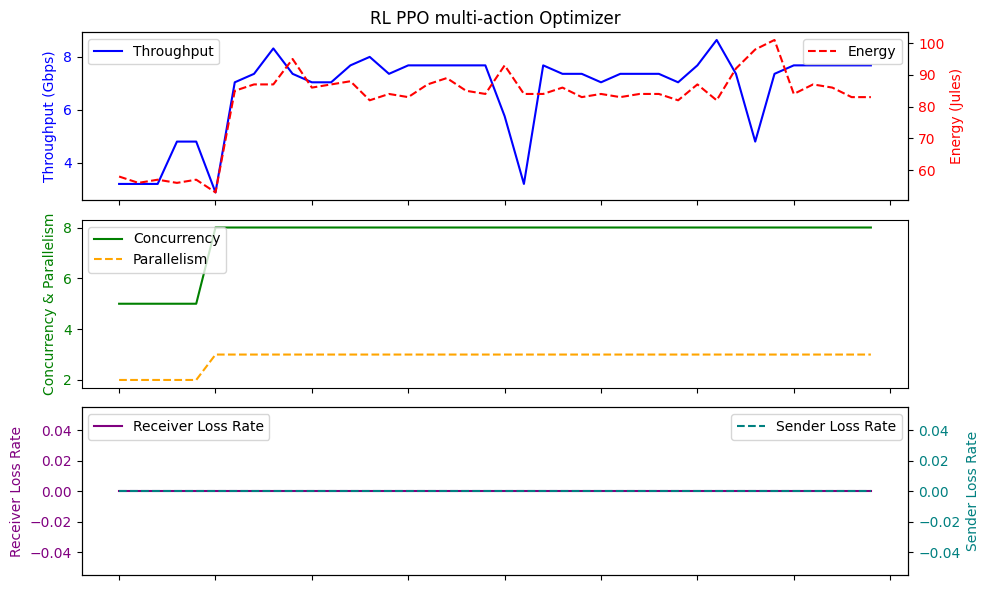

Average Throughput: 6.736
Total Energy: 3276.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:00:10.985387776    6.044444       0.0   3.955556   
min       2024-02-18 07:35:40.278586    2.560000       0.0   2.000000   
25%    2024-02-18 12:21:18.471547904    5.440000       0.0   3.000000   
50%    2024-02-18 12:23:46.620922112    6.080000       0.0   4.000000   
75%    2024-02-18 12:28:46.977278976    7.680000       0.0   5.000000   
max       2024-02-19 06:19:43.462604    8.960000       0.0   7.000000   
std                              NaN    1.727599       0.0   1.205208   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.486667  79.822222   0.000260  
min    32.500000  47.000000   0.000000  
25%    32.700000  74.000000   0.000000  
50%    32.800000  84.000000   0.000000  
75%    33.400000  86.000000 

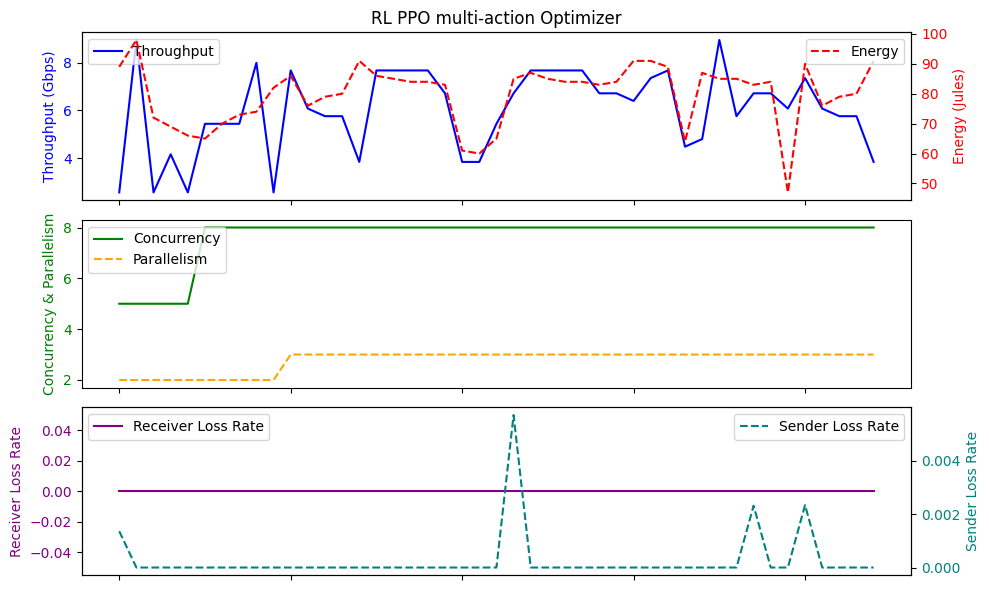

Average Throughput: 6.044444444444444
Total Energy: 3592.0
Total loss rate: 0.011718712901123779
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 20:10:44.022829056    7.152000       0.0   4.875000   
min       2024-02-18 00:55:03.352974    3.200000       0.0   3.000000   
25%    2024-02-18 11:30:32.110204416    6.320000       0.0   4.000000   
50%    2024-02-18 12:33:23.817272832    7.360000       0.0   5.000000   
75%    2024-02-19 06:43:41.232192256    7.680000       0.0   5.000000   
max       2024-02-19 15:54:12.025665   12.160000       0.0   9.000000   
std                              NaN    1.786174       0.0   1.284773   

           RTT     Energy  SenderLR  
count  40.0000  40.000000      40.0  
mean   33.0875  81.600000       0.0  
min    32.5000  55.000000       0.0  
25%    32.6750  79.750000       0.0  
50%    32.9000  84.000000       0.0  
75%    33.0250  8

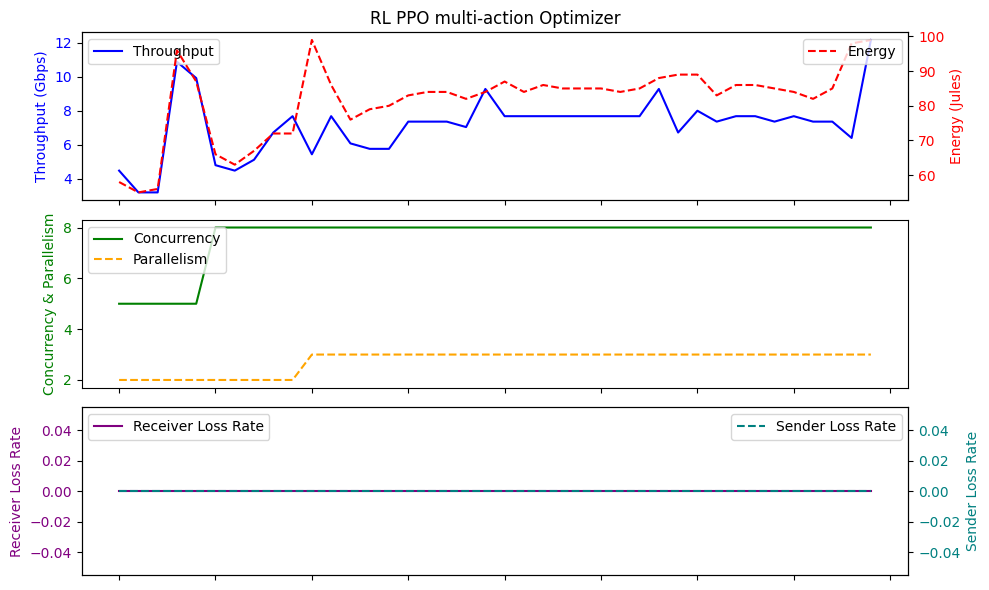

Average Throughput: 7.151999999999999
Total Energy: 3264.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 17:01:32.960316672    6.215111       0.0   4.088889   
min       2024-02-18 05:56:44.978303    0.640000       0.0   0.000000   
25%    2024-02-18 09:23:03.950619904    5.440000       0.0   4.000000   
50%    2024-02-18 12:21:41.586142976    7.040000       0.0   4.000000   
75%    2024-02-19 03:48:32.231792128    7.680000       0.0   5.000000   
max       2024-02-19 11:58:40.491884    8.000000       0.0   7.000000   
std                              NaN    1.828726       0.0   1.276042   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.106667   82.533333   0.000002  
min    32.500000   47.000000   0.000000  
25%    32.600000   80.000000   0.000000  
50%    32.800000   84.000000   0.000000  
75%    33.

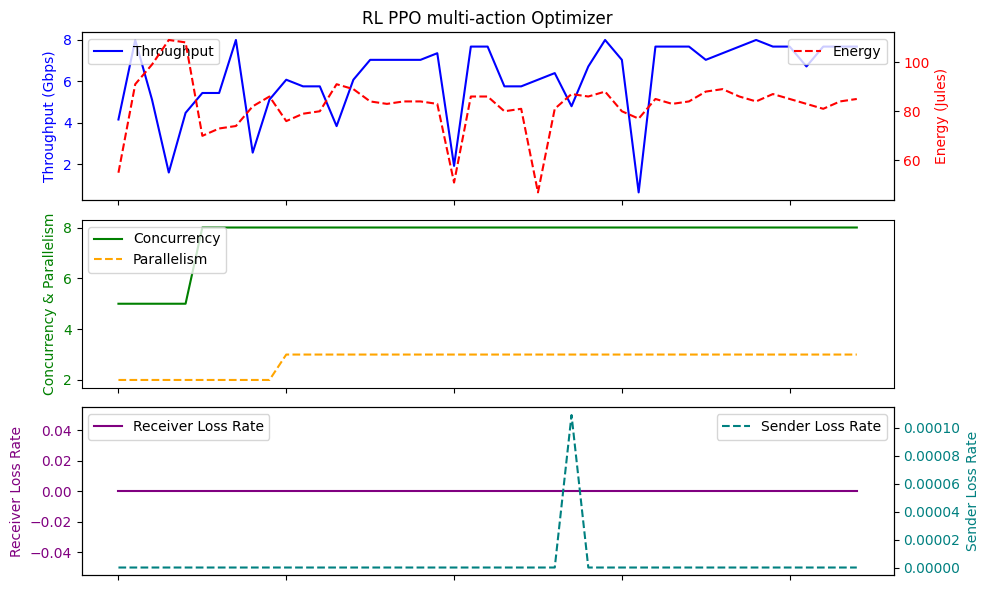

Average Throughput: 6.215111111111112
Total Energy: 3714.0
Total loss rate: 0.00010908694229300753
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 17:07:30.577867520    6.250667       0.0   4.044444   
min       2024-02-18 07:42:56.434430    0.960000       0.0   1.000000   
25%    2024-02-18 12:16:44.229666048    4.800000       0.0   4.000000   
50%    2024-02-18 12:20:26.380295936    7.360000       0.0   5.000000   
75%    2024-02-18 12:30:53.365389056    7.680000       0.0   5.000000   
max       2024-02-19 15:32:36.232769   10.240000       0.0   6.000000   
std                              NaN    2.322231       0.0   1.460939   

             RTT     Energy  SenderLR  
count  45.000000  45.000000      45.0  
mean   33.264444  77.622222       0.0  
min    32.500000  49.000000       0.0  
25%    32.600000  75.000000       0.0  
50%    32.700000  84.000000       0.0  
75%

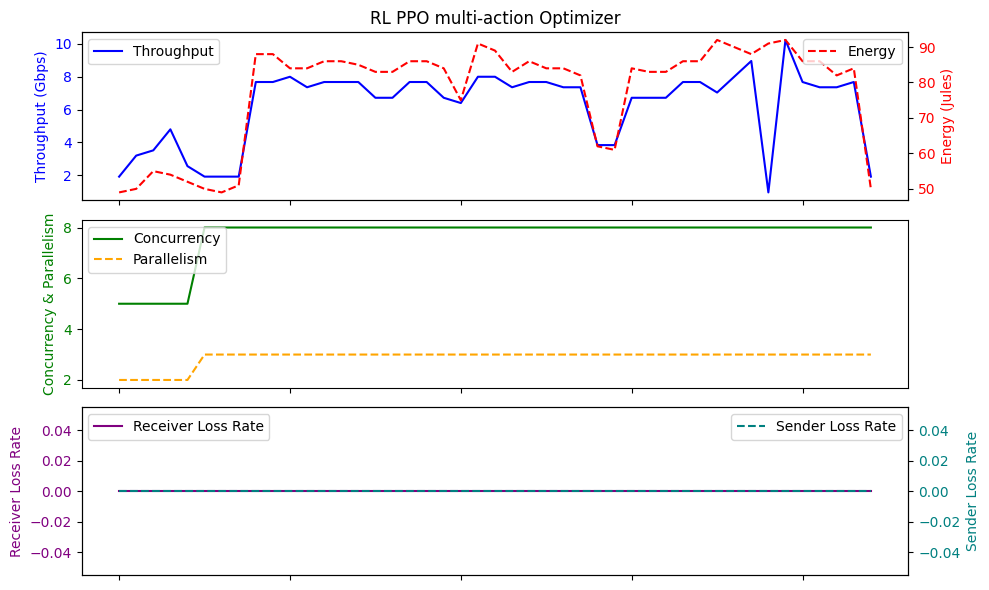

Average Throughput: 6.2506666666666675
Total Energy: 3493.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 21:49:59.911917312    6.229333       0.0   4.088889   
min       2024-02-18 04:14:17.904706    1.280000       0.0   1.000000   
25%    2024-02-18 12:21:40.587397888    4.800000       0.0   3.000000   
50%    2024-02-19 05:57:59.808557056    7.040000       0.0   4.000000   
75%    2024-02-19 05:58:02.802264064    7.680000       0.0   5.000000   
max       2024-02-19 12:29:19.270192   10.240000       0.0   6.000000   
std                              NaN    2.059875       0.0   1.164283   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   32.840000   83.111111   0.000390  
min    32.500000   55.000000   0.000000  
25%    32.700000   81.000000   0.000000  
50%    32.800000   86.000000   0.000000  
75%    32

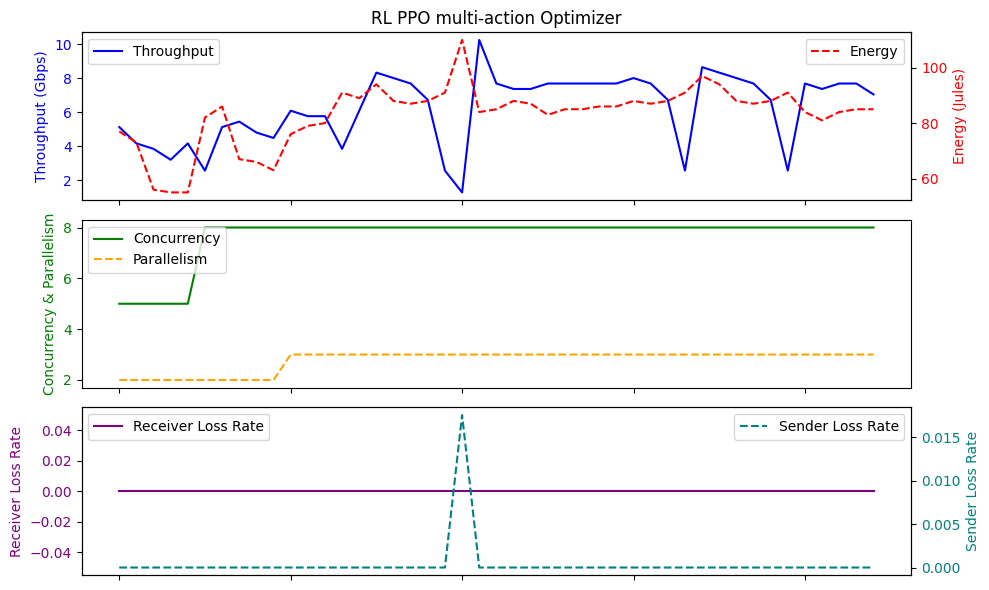

Average Throughput: 6.229333333333335
Total Energy: 3740.0
Total loss rate: 0.01754949557699099
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:52:31.126348032    6.442667       0.0   4.266667   
min       2024-02-18 07:35:42.278902    0.640000       0.0   0.000000   
25%    2024-02-18 08:57:04.672828928    5.440000       0.0   4.000000   
50%    2024-02-18 11:31:49.056700928    7.360000       0.0   5.000000   
75%    2024-02-18 12:31:18.543983104    7.680000       0.0   5.000000   
max       2024-02-19 17:13:37.138882   11.200000       0.0   9.000000   
std                              NaN    2.147276       0.0   1.436536   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.337778   82.800000   0.000151  
min    32.500000   49.000000   0.000000  
25%    32.600000   82.000000   0.000000  
50%    32.900000   85.000000   0.000

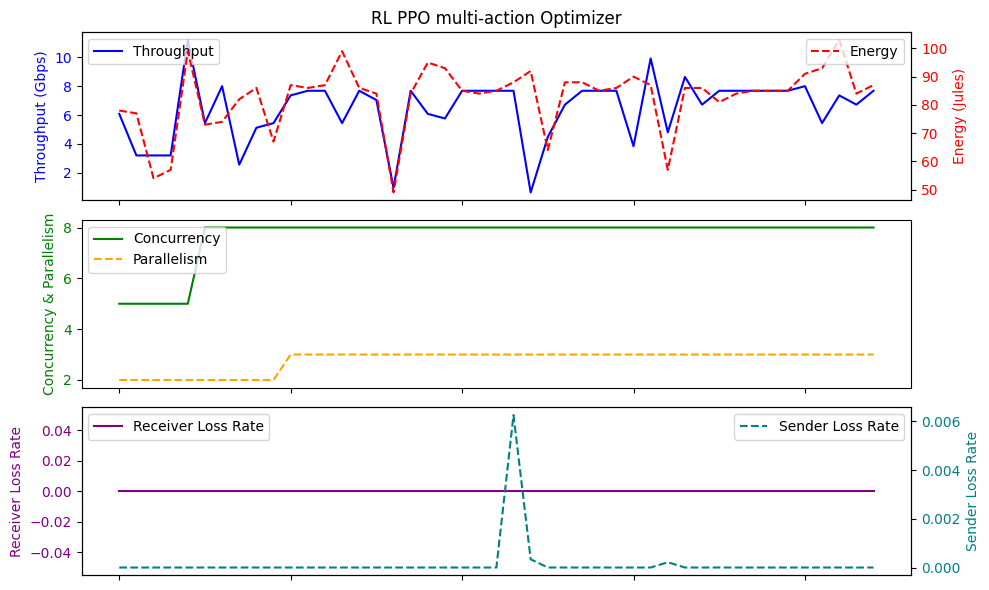

Average Throughput: 6.4426666666666685
Total Energy: 3726.0
Total loss rate: 0.006807959261883859
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 14:50:13.405692160    6.243556       0.0   4.133333   
min       2024-02-18 05:01:01.324563    2.560000       0.0   2.000000   
25%    2024-02-18 07:35:45.282934016    5.120000       0.0   4.000000   
50%    2024-02-18 12:17:07.341694976    6.720000       0.0   4.000000   
75%    2024-02-18 12:26:40.129416960    7.680000       0.0   5.000000   
max       2024-02-19 13:22:11.133534    8.000000       0.0   5.000000   
std                              NaN    1.537124       0.0   0.868646   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.000000  79.955556   0.000002  
min    32.500000  47.000000   0.000000  
25%    32.600000  80.000000   0.000000  
50%    32.900000  84.000000   0.000000 

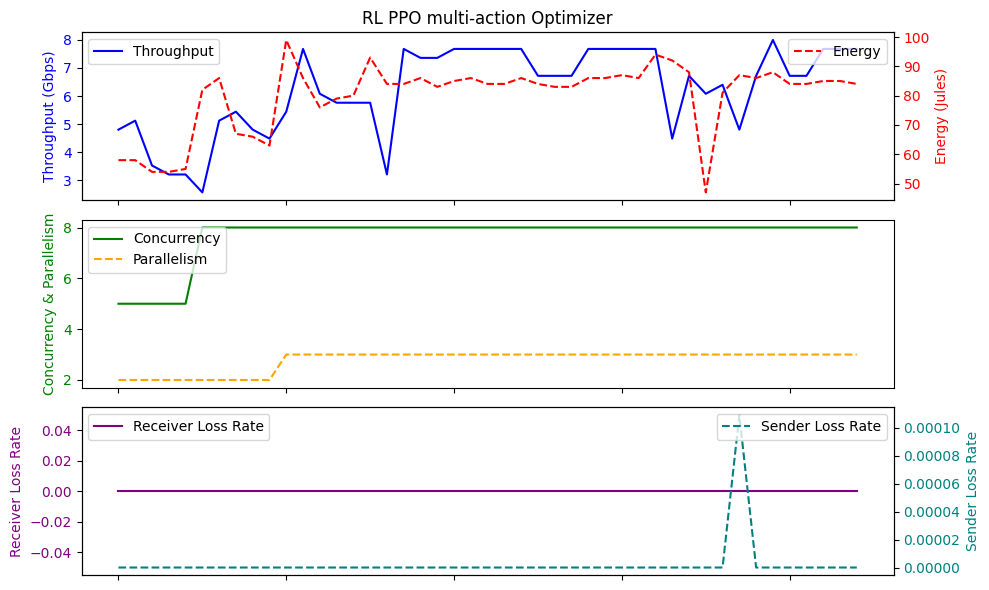

Average Throughput: 6.243555555555556
Total Energy: 3598.0
Total loss rate: 0.00010908694229300753
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 10:43:28.816476160    6.904000       0.0   4.575000   
min       2024-02-18 03:23:20.864925    3.200000       0.0   3.000000   
25%    2024-02-18 07:49:21.303594496    6.720000       0.0   4.000000   
50%    2024-02-18 12:24:52.095409408    7.360000       0.0   5.000000   
75%    2024-02-18 13:01:27.888667392    7.680000       0.0   5.000000   
max       2024-02-18 15:26:21.978359    9.280000       0.0   6.000000   
std                              NaN    1.417974       0.0   0.712075   

             RTT    Energy   SenderLR  
count  40.000000  40.00000  40.000000  
mean   33.745000  81.10000   0.000042  
min    32.500000  53.00000   0.000000  
25%    32.600000  83.00000   0.000000  
50%    32.900000  85.00000   0.000000  
75%

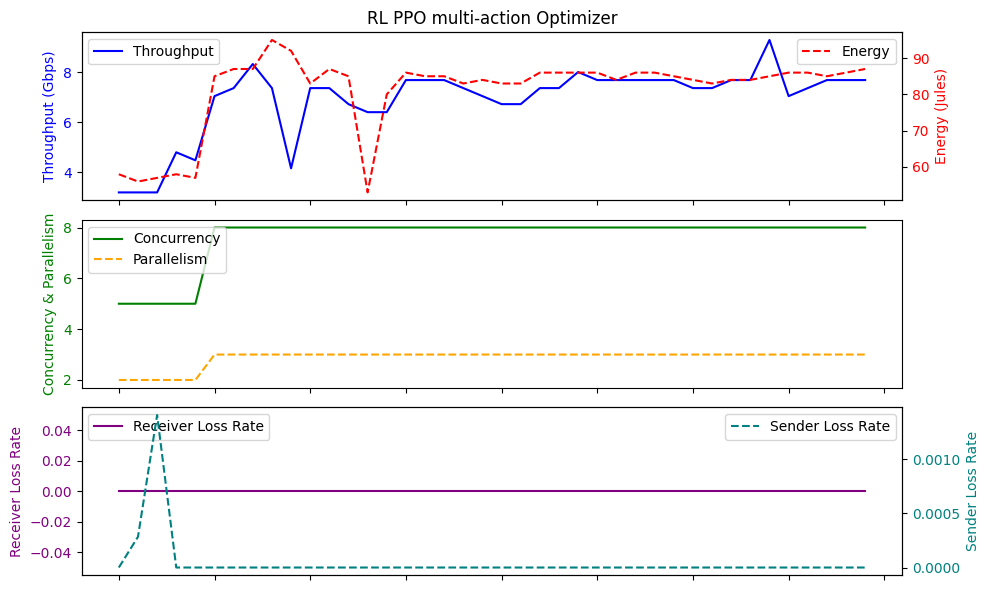

Average Throughput: 6.903999999999999
Total Energy: 3244.0
Total loss rate: 0.0016915273888249804
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 13:32:08.786016256    6.300444       0.0   4.177778   
min       2024-02-18 08:04:50.356503    0.960000       0.0   1.000000   
25%    2024-02-18 08:57:03.671507968    5.120000       0.0   4.000000   
50%    2024-02-18 12:38:53.509274880    7.040000       0.0   5.000000   
75%    2024-02-18 15:00:08.163706112    7.680000       0.0   5.000000   
max       2024-02-19 03:48:32.231792    7.680000       0.0   6.000000   
std                              NaN    1.739146       0.0   1.113734   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.288889   81.111111   0.000079  
min    32.500000   47.000000   0.000000  
25%    32.700000   81.000000   0.000000  
50%    32.800000   86.000000   0.0

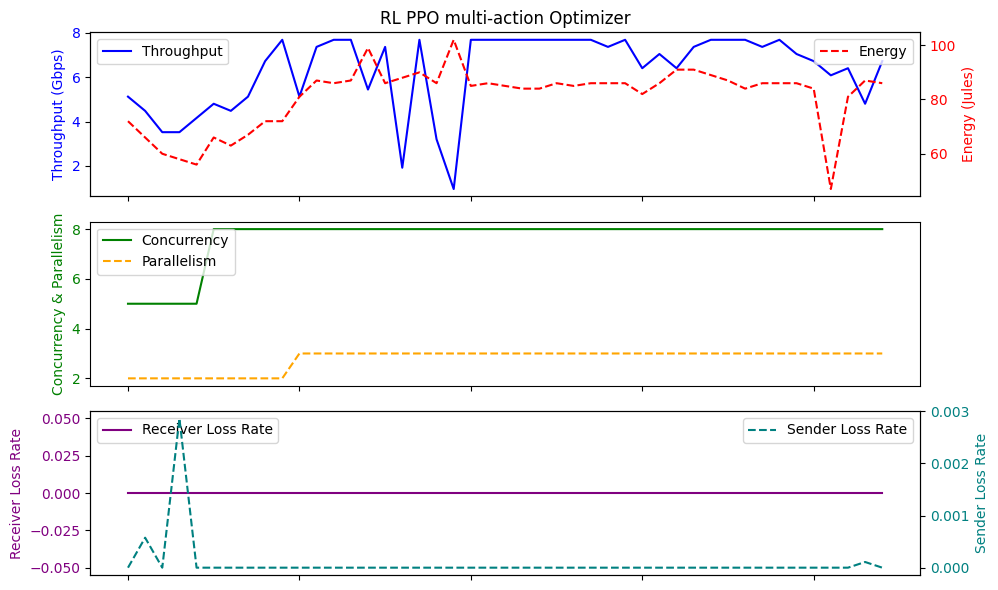

Average Throughput: 6.300444444444445
Total Energy: 3650.0
Total loss rate: 0.003545444290070805
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 17:12:11.945738752    6.496000       0.0   4.275000   
min       2024-02-18 07:35:39.275757    1.280000       0.0   1.000000   
25%    2024-02-18 08:40:55.637906176    5.360000       0.0   3.000000   
50%       2024-02-18 10:57:41.218784    7.360000       0.0   5.000000   
75%    2024-02-18 19:24:24.114908416    7.680000       0.0   5.000000   
max       2024-02-19 16:51:40.738367   12.800000       0.0   8.000000   
std                              NaN    2.250175       0.0   1.358497   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   33.490000  80.075000   0.000067  
min    32.500000  46.000000   0.000000  
25%    32.600000  73.750000   0.000000  
50%    32.850000  84.000000   0.000000  

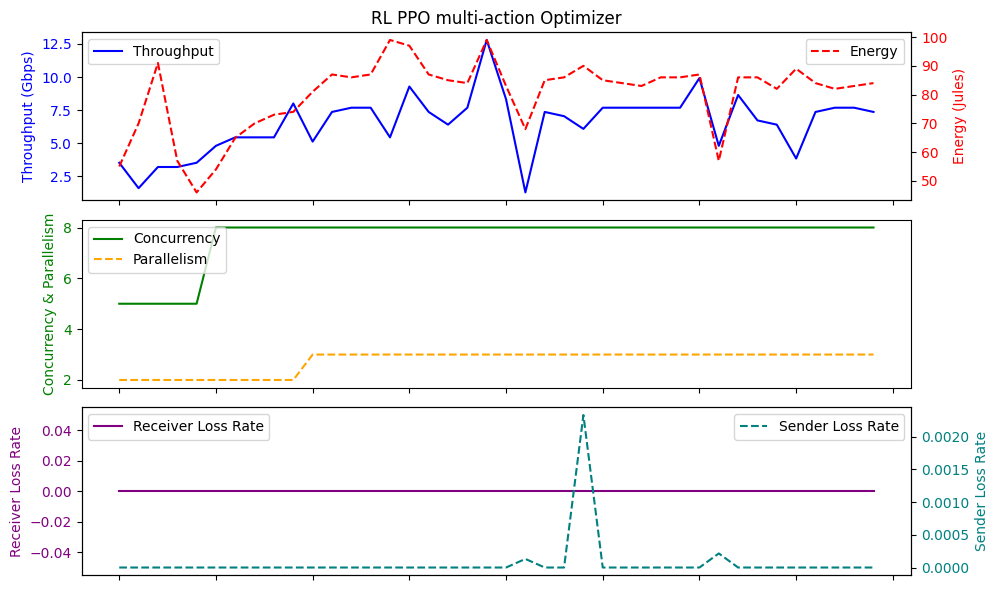

Average Throughput: 6.4959999999999996
Total Energy: 3203.0
Total loss rate: 0.002675567200155305
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 14:51:07.102775808    6.208000       0.0   4.088889   
min       2024-02-18 07:54:52.908126    1.280000       0.0   1.000000   
25%    2024-02-18 12:22:28.465788928    3.840000       0.0   3.000000   
50%    2024-02-18 12:32:11.139092992    7.680000       0.0   5.000000   
75%    2024-02-18 12:41:02.782714880    7.680000       0.0   5.000000   
max       2024-02-19 12:03:15.969616    7.680000       0.0   5.000000   
std                              NaN    2.194234       0.0   1.443201   

             RTT     Energy  SenderLR  
count  45.000000  45.000000      45.0  
mean   33.588889  78.777778       0.0  
min    32.500000  48.000000       0.0  
25%    32.700000  83.000000       0.0  
50%    32.800000  85.000000       0.0  
75% 

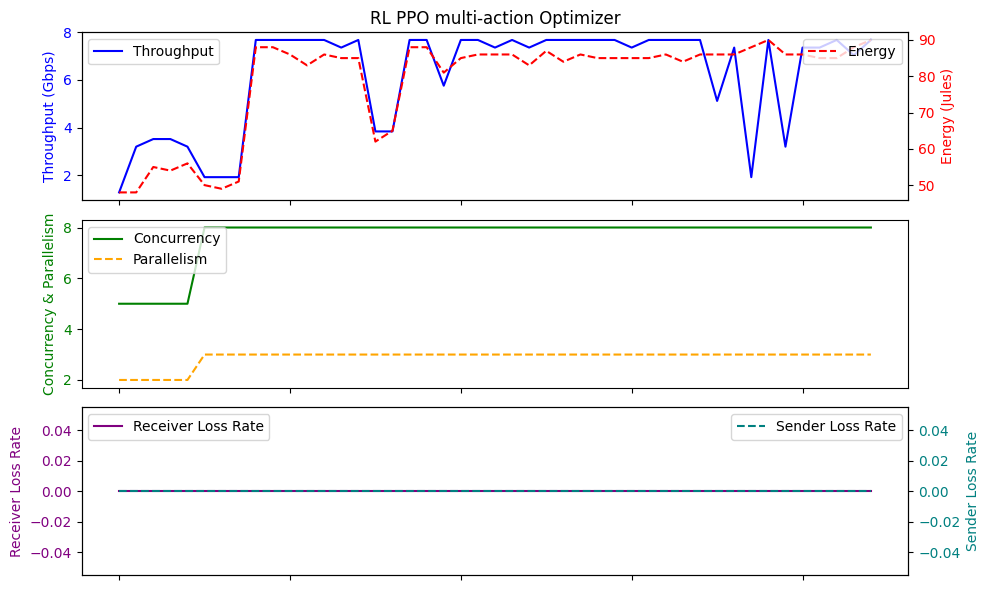

Average Throughput: 6.208000000000002
Total Energy: 3545.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 13:51:29.135834368    6.428444       0.0   4.177778   
min       2024-02-18 07:38:55.109323    2.240000       0.0   1.000000   
25%    2024-02-18 10:14:09.563385088    5.760000       0.0   4.000000   
50%    2024-02-18 12:29:14.728517888    7.360000       0.0   5.000000   
75%    2024-02-18 12:38:52.505156096    7.680000       0.0   5.000000   
max       2024-02-19 12:03:10.965443    9.280000       0.0   6.000000   
std                              NaN    1.776219       0.0   1.093137   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.557778  80.333333   0.000026  
min    32.500000  48.000000   0.000000  
25%    32.600000  80.000000   0.000000  
50%    33.000000  86.000000   0.000000  
75%    33.300000

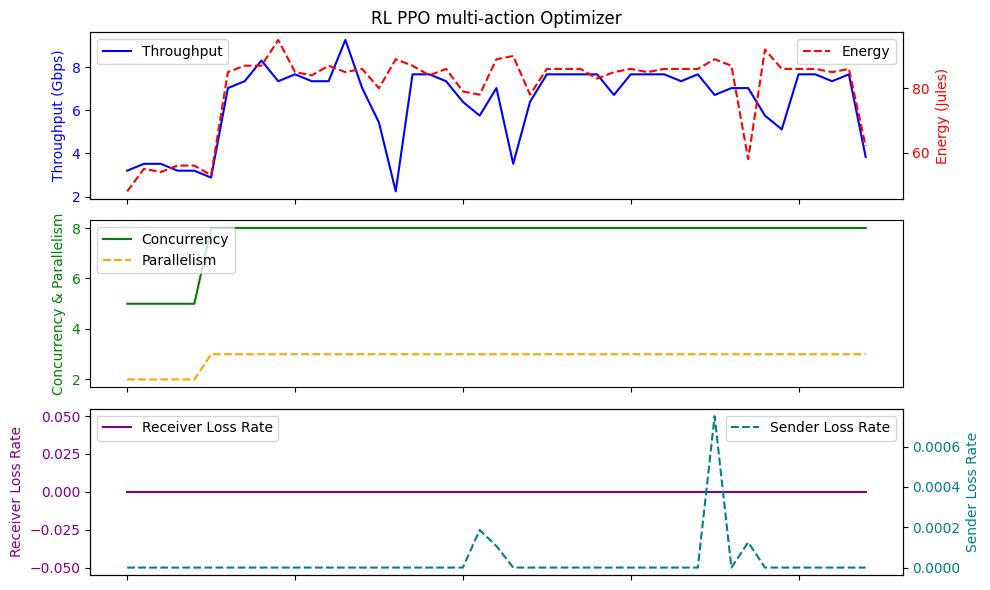

Average Throughput: 6.4284444444444455
Total Energy: 3615.0
Total loss rate: 0.0011695703909778208
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 13:05:20.783427584    6.408000       0.0   4.200000   
min       2024-02-18 03:44:21.829292    1.920000       0.0   1.000000   
25%    2024-02-18 06:41:26.782117376    4.640000       0.0   3.750000   
50%    2024-02-18 12:26:03.766458624    7.360000       0.0   5.000000   
75%    2024-02-18 12:28:54.922496256    7.680000       0.0   5.000000   
max       2024-02-19 15:58:46.436742    9.920000       0.0   6.000000   
std                              NaN    1.995753       0.0   1.264911   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.137500   80.025000   0.000675  
min    32.500000   48.000000   0.000000  
25%    32.700000   80.000000   0.000000  
50%    32.900000   85.000000   0.

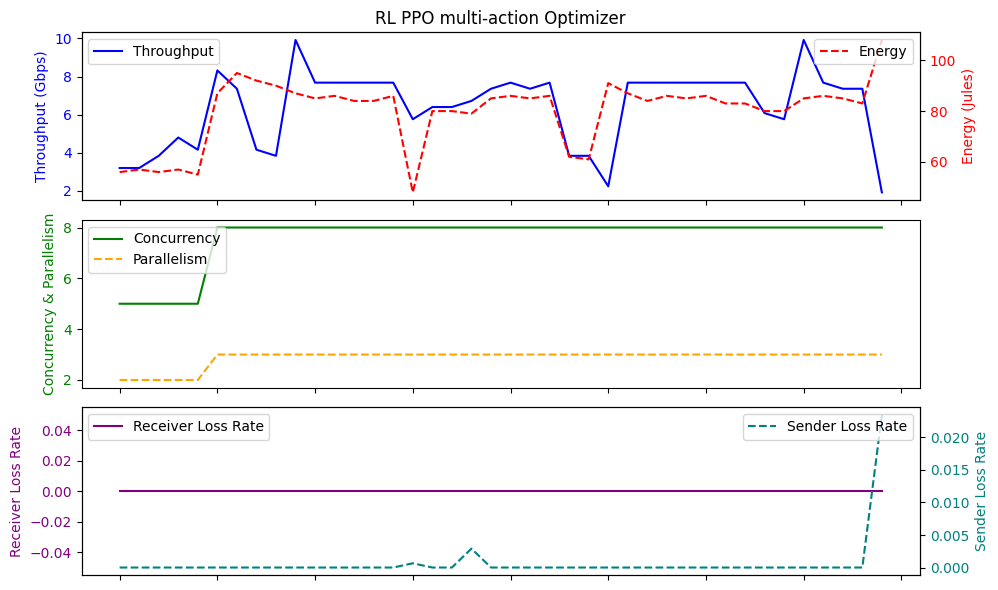

Average Throughput: 6.408000000000001
Total Energy: 3201.0
Total loss rate: 0.027000784840451573
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 13:37:54.290427648    6.193778       0.0   4.022222   
min       2024-02-18 03:48:49.788728    1.280000       0.0   1.000000   
25%    2024-02-18 12:20:25.378897920    5.440000       0.0   3.000000   
50%    2024-02-18 12:27:09.482216960    7.040000       0.0   4.000000   
75%    2024-02-18 12:32:59.240532992    7.680000       0.0   5.000000   
max       2024-02-19 12:29:19.270192   10.240000       0.0   6.000000   
std                              NaN    2.074012       0.0   1.322685   

            RTT      Energy   SenderLR  
count  45.00000   45.000000  45.000000  
mean   33.12000   79.133333   0.000455  
min    32.50000   49.000000   0.000000  
25%    32.70000   80.000000   0.000000  
50%    32.90000   83.000000   0.000000  

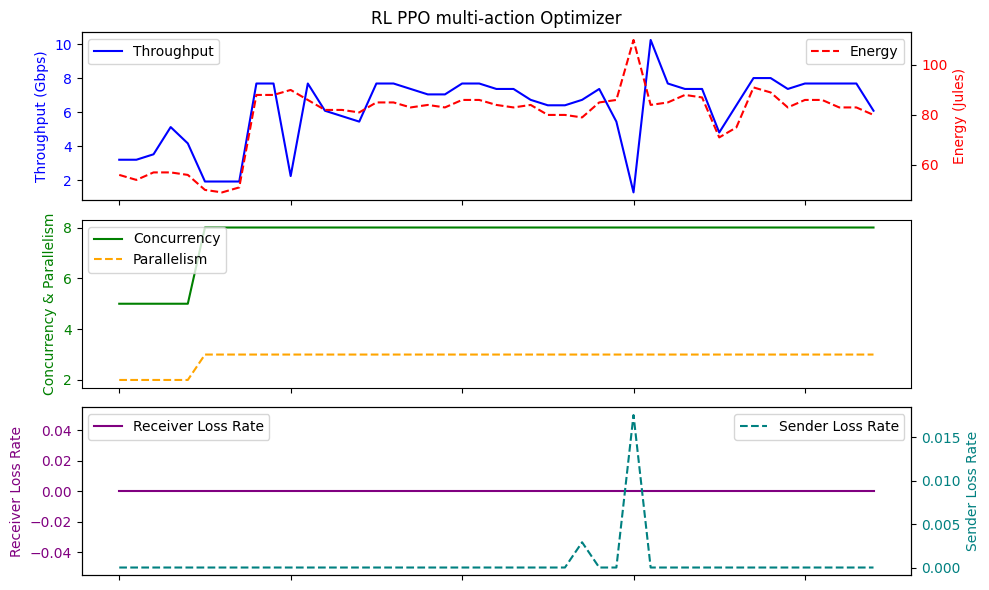

Average Throughput: 6.193777777777778
Total Energy: 3561.0
Total loss rate: 0.02045609398920738
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 16:11:45.282882560    5.944889       0.0   3.911111   
min       2024-02-18 02:32:36.956649    0.320000       0.0   0.000000   
25%    2024-02-18 08:53:15.396410112    4.800000       0.0   3.000000   
50%    2024-02-18 12:21:39.588250112    6.400000       0.0   4.000000   
75%    2024-02-18 12:37:41.257185024    7.680000       0.0   5.000000   
max       2024-02-19 17:18:21.456134    8.640000       0.0   6.000000   
std                              NaN    2.022119       0.0   1.276042   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.642222   80.777778   0.000022  
min    32.500000   47.000000   0.000000  
25%    32.600000   78.000000   0.000000  
50%    33.000000   85.000000   0.000

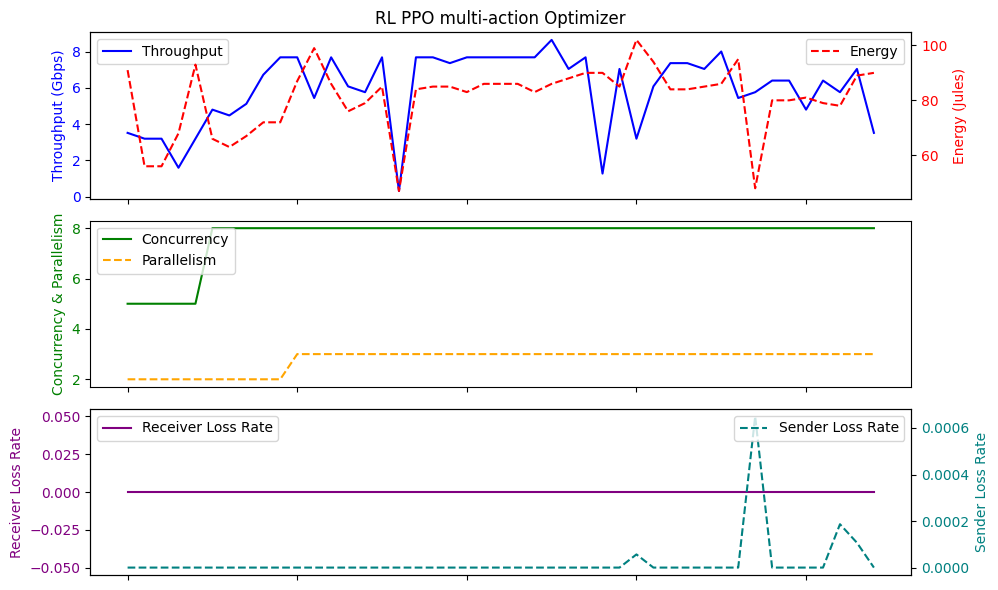

Average Throughput: 5.944888888888889
Total Energy: 3635.0
Total loss rate: 0.0009992410536529522
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 14:32:12.078630400    6.672000       0.0   4.475000   
min       2024-02-18 07:35:44.282707    2.560000       0.0   2.000000   
25%    2024-02-18 11:26:11.477527808    5.360000       0.0   4.000000   
50%    2024-02-18 12:22:44.109140480    7.680000       0.0   5.000000   
75%    2024-02-18 12:34:48.360869120    7.680000       0.0   5.000000   
max       2024-02-19 13:17:25.875146   10.560000       0.0   9.000000   
std                              NaN    1.721805       0.0   1.240089   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   32.930000  81.575000   0.000144  
min    32.500000  56.000000   0.000000  
25%    32.600000  82.000000   0.000000  
50%    32.800000  85.500000   0.000000 

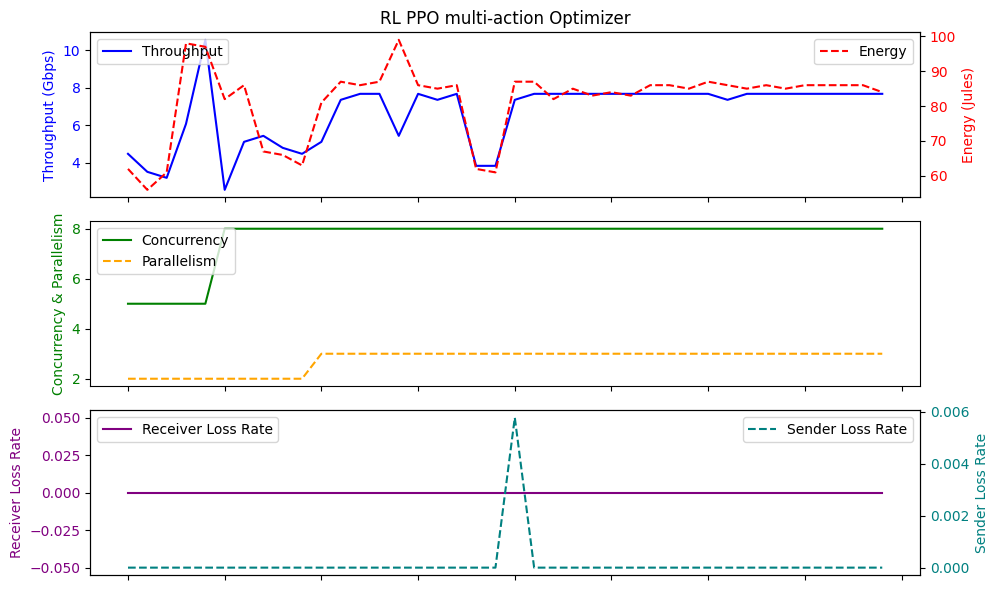

Average Throughput: 6.672
Total Energy: 3263.0
Total loss rate: 0.0057793028715911144
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:39:33.323252736    6.264889       0.0   4.066667   
min       2024-02-18 06:22:09.137350    1.600000       0.0   1.000000   
25%    2024-02-18 10:14:04.558445056    5.760000       0.0   4.000000   
50%    2024-02-18 12:17:30.810106112    6.720000       0.0   4.000000   
75%    2024-02-18 12:39:47.336514048    7.680000       0.0   5.000000   
max       2024-02-19 14:15:01.570917    9.920000       0.0   6.000000   
std                              NaN    1.777092       0.0   1.095445   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.182222  80.822222   0.000135  
min    32.500000  55.000000   0.000000  
25%    32.600000  76.000000   0.000000  
50%    32.900000  84.000000   0.000000  
75%    33.

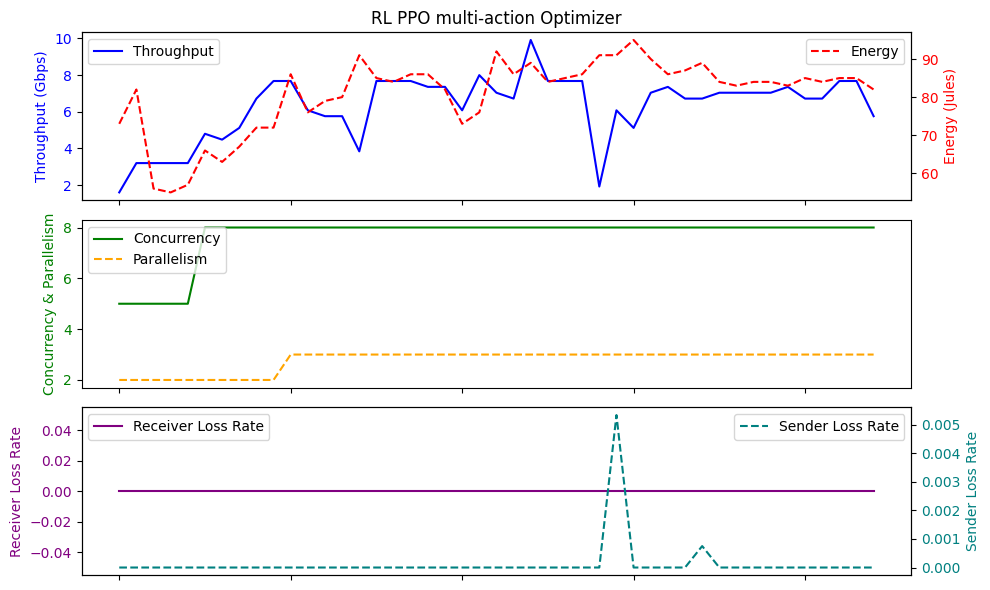

Average Throughput: 6.26488888888889
Total Energy: 3637.0
Total loss rate: 0.006092793801790878
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:16:28.889323776    6.001778       0.0   3.888889   
min       2024-02-18 07:35:58.905338    1.920000       0.0   1.000000   
25%    2024-02-18 10:14:09.563385088    4.480000       0.0   3.000000   
50%    2024-02-18 12:20:26.380295936    6.720000       0.0   4.000000   
75%    2024-02-18 12:30:57.368615936    7.680000       0.0   5.000000   
max       2024-02-19 07:16:48.693562   10.240000       0.0   6.000000   
std                              NaN    2.141367       0.0   1.335226   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.357778   78.888889   0.000068  
min    32.500000   49.000000   0.000000  
25%    32.600000   64.000000   0.000000  
50%    32.800000   85.000000   0.000

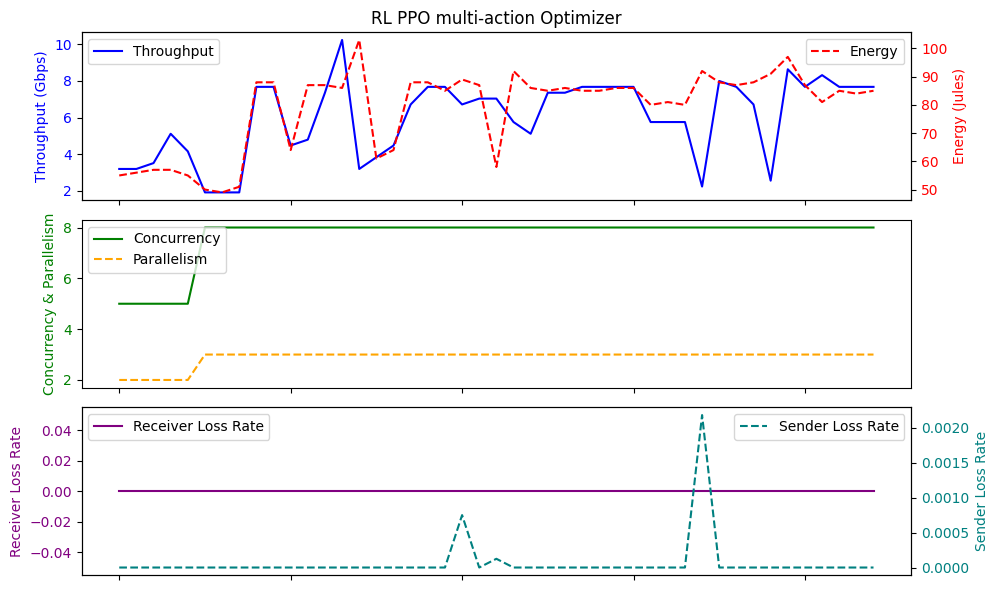

Average Throughput: 6.001777777777777
Total Energy: 3550.0
Total loss rate: 0.0030614324376520563
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 17:30:21.179401472    6.072889       0.0   3.888889   
min       2024-02-18 03:44:25.836201    1.920000       0.0   1.000000   
25%    2024-02-18 11:58:04.398013952    4.160000       0.0   3.000000   
50%    2024-02-18 12:21:15.468409088    6.720000       0.0   4.000000   
75%    2024-02-19 05:05:37.852167936    7.680000       0.0   5.000000   
max       2024-02-19 09:26:20.938732    9.920000       0.0   6.000000   
std                              NaN    2.067643       0.0   1.318095   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.317778   79.711111   0.000002  
min    32.500000   49.000000   0.000000  
25%    32.600000   74.000000   0.000000  
50%    32.800000   85.000000   0.0

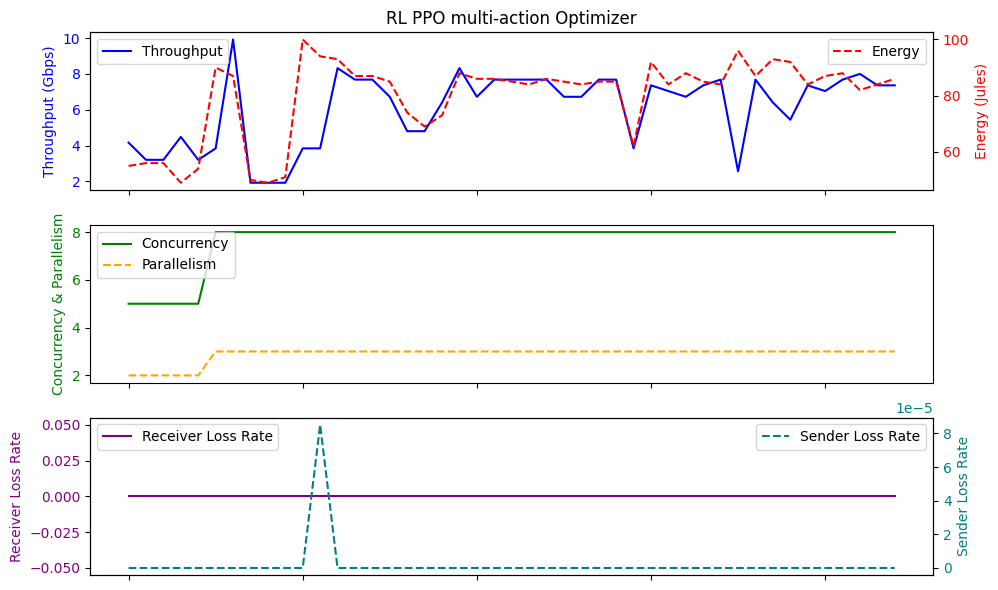

Average Throughput: 6.072888888888889
Total Energy: 3587.0
Total loss rate: 8.519580836622838e-05
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 16:13:30.042899712    6.215111       0.0   4.088889   
min       2024-02-18 07:35:40.278586    1.600000       0.0   1.000000   
25%    2024-02-18 08:57:03.671507968    5.440000       0.0   3.000000   
50%    2024-02-18 12:31:21.547147008    6.720000       0.0   4.000000   
75%    2024-02-18 14:34:00.565584896    7.680000       0.0   5.000000   
max       2024-02-19 10:45:30.766474    8.320000       0.0   6.000000   
std                              NaN    1.650813       0.0   1.040590   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.086667  81.088889   0.000239  
min    32.500000  56.000000   0.000000  
25%    32.600000  80.000000   0.000000  
50%    32.700000  84.000000   0.000000 

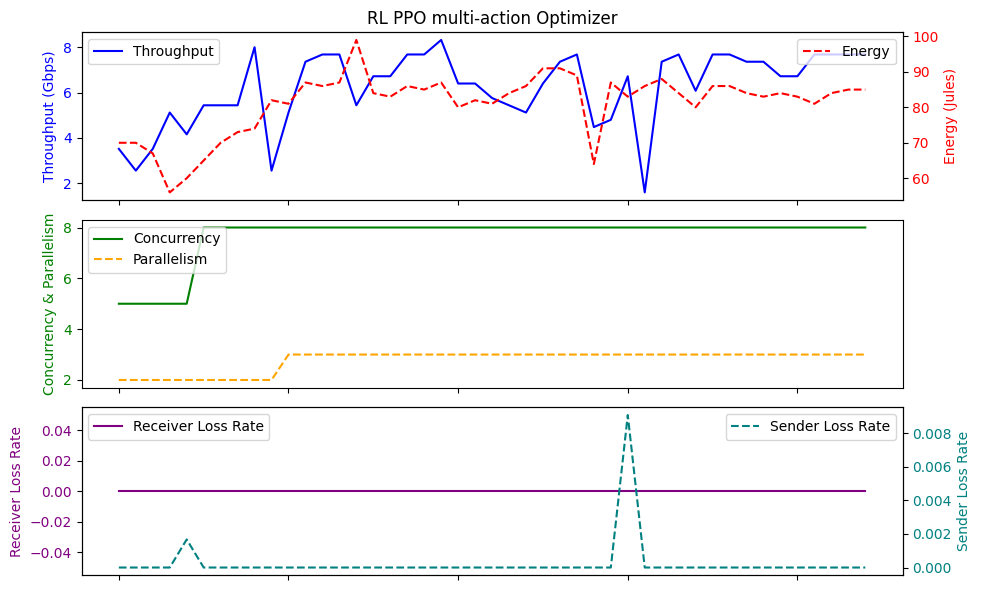

Average Throughput: 6.215111111111112
Total Energy: 3649.0
Total loss rate: 0.010739797465416534
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 19:30:04.548122368    6.378667       0.0   4.266667   
min       2024-02-18 05:05:28.592678    1.920000       0.0   1.000000   
25%    2024-02-18 08:53:14.394758912    5.120000       0.0   4.000000   
50%    2024-02-18 12:21:41.586142976    7.040000       0.0   5.000000   
75%    2024-02-19 12:03:12.968235008    7.360000       0.0   5.000000   
max       2024-02-19 16:51:41.740375   12.800000       0.0   8.000000   
std                              NaN    1.994203       0.0   1.268499   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.231111  81.911111   0.000049  
min    32.500000  56.000000   0.000000  
25%    32.600000  80.000000   0.000000  
50%    32.800000  85.000000   0.000000  

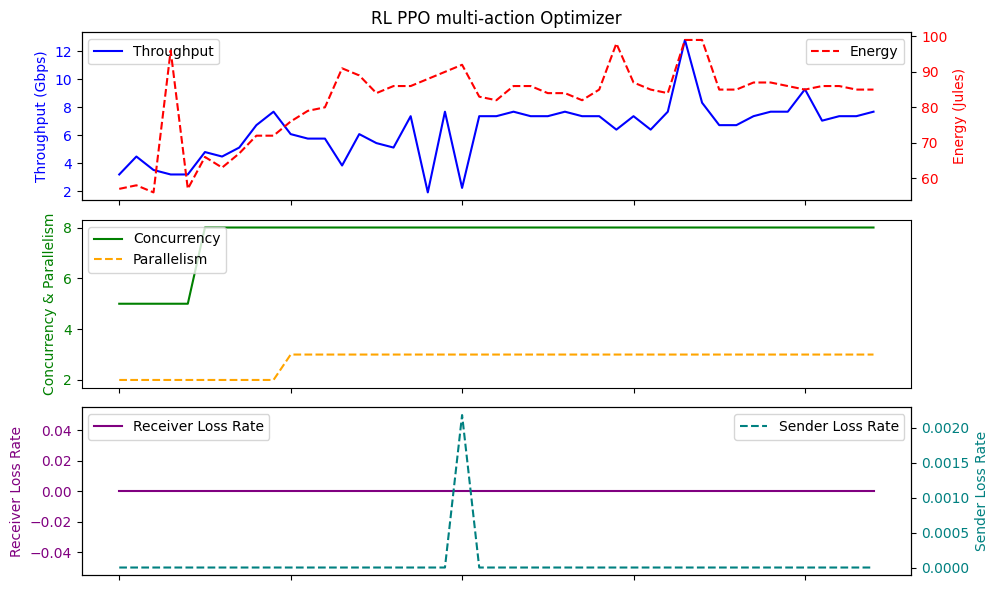

Average Throughput: 6.378666666666667
Total Energy: 3686.0
Total loss rate: 0.0021850453256838072
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 18:28:12.488172288    6.229333       0.0   4.044444   
min       2024-02-18 07:39:02.117491    0.640000       0.0   0.000000   
25%    2024-02-18 12:30:57.368615936    4.480000       0.0   3.000000   
50%    2024-02-18 12:36:46.010928896    7.360000       0.0   5.000000   
75%    2024-02-19 03:22:33.364491008    7.680000       0.0   5.000000   
max       2024-02-19 09:00:03.794495    9.920000       0.0   6.000000   
std                              NaN    2.192324       0.0   1.429487   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.020000  80.133333   0.000244  
min    32.500000  49.000000   0.000000  
25%    32.700000  82.000000   0.000000  
50%    32.900000  85.000000   0.000000 

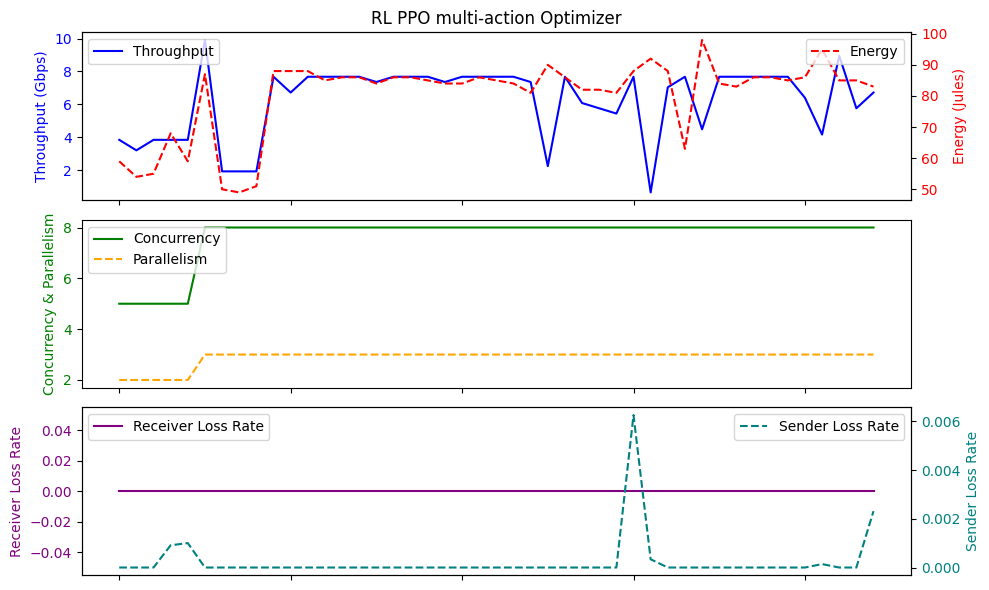

Average Throughput: 6.229333333333333
Total Energy: 3606.0
Total loss rate: 0.010962958572271364
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:47:56.900834816    6.506667       0.0   4.288889   
min       2024-02-18 02:32:38.959900    1.920000       0.0   1.000000   
25%    2024-02-18 07:41:17.803023872    7.360000       0.0   5.000000   
50%    2024-02-18 12:26:17.974558976    7.680000       0.0   5.000000   
75%    2024-02-18 12:41:01.775079936    7.680000       0.0   5.000000   
max       2024-02-19 13:48:46.477036    8.320000       0.0   5.000000   
std                              NaN    2.049000       0.0   1.358847   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.264444  78.844444   0.000040  
min    32.500000  49.000000   0.000000  
25%    32.700000  83.000000   0.000000  
50%    32.900000  85.000000   0.000000  

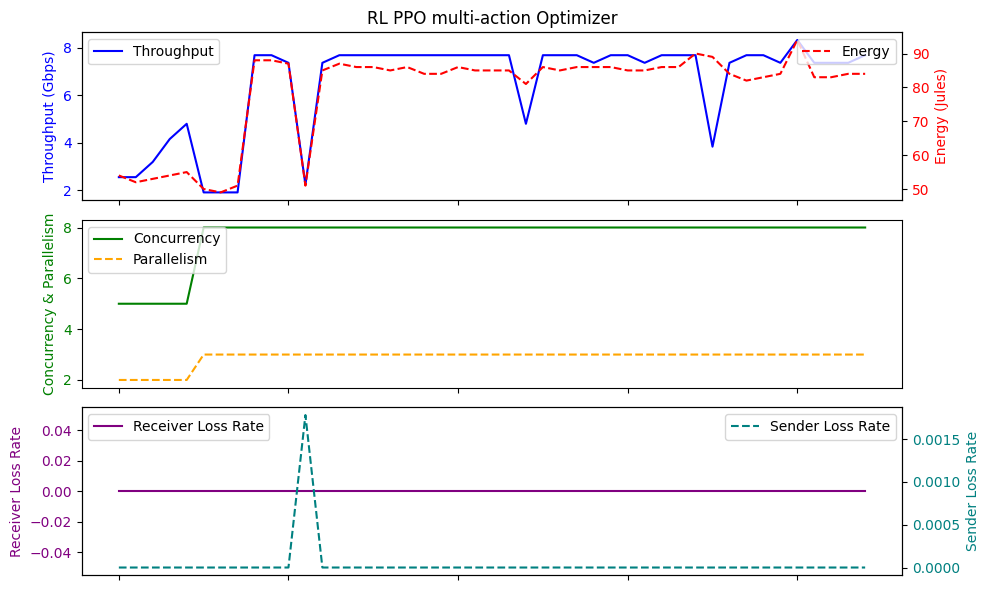

Average Throughput: 6.506666666666669
Total Energy: 3548.0
Total loss rate: 0.0017801437678014378
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 20:12:09.608017920    6.264889       0.0   4.088889   
min       2024-02-18 02:32:36.956649    0.320000       0.0   0.000000   
25%    2024-02-18 09:23:03.950619904    5.440000       0.0   3.000000   
50%    2024-02-18 12:32:11.139092992    7.360000       0.0   5.000000   
75%    2024-02-19 09:26:16.935207936    7.680000       0.0   5.000000   
max       2024-02-19 17:18:21.456134    8.320000       0.0   5.000000   
std                              NaN    2.029013       0.0   1.311180   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.328889   81.333333   0.000144  
min    32.500000   47.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.800000   85.000000   0.0

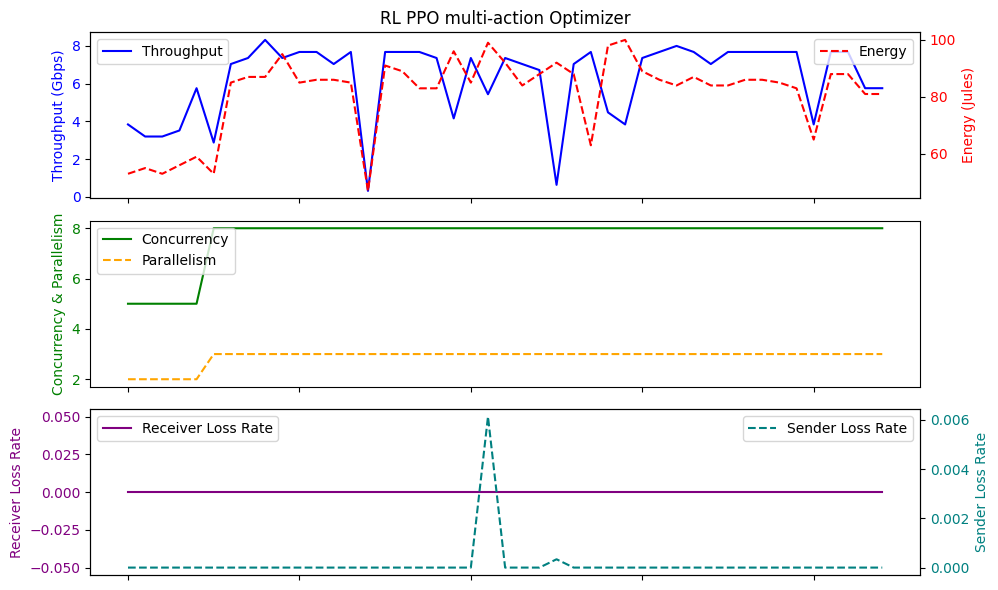

Average Throughput: 6.264888888888888
Total Energy: 3660.0
Total loss rate: 0.006468255069791619
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 19:13:57.115773696    6.424000       0.0   4.175000   
min       2024-02-18 05:56:46.981954    0.640000       0.0   0.000000   
25%    2024-02-18 07:38:29.330096640    6.160000       0.0   4.000000   
50%    2024-02-18 12:24:38.177690112    7.360000       0.0   5.000000   
75%    2024-02-19 08:08:07.602422016    7.680000       0.0   5.000000   
max       2024-02-19 15:32:42.251601    9.920000       0.0   6.000000   
std                              NaN    2.296589       0.0   1.465632   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   32.947500   78.300000   0.000415  
min    32.500000   48.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.700000   85.000000   0.00

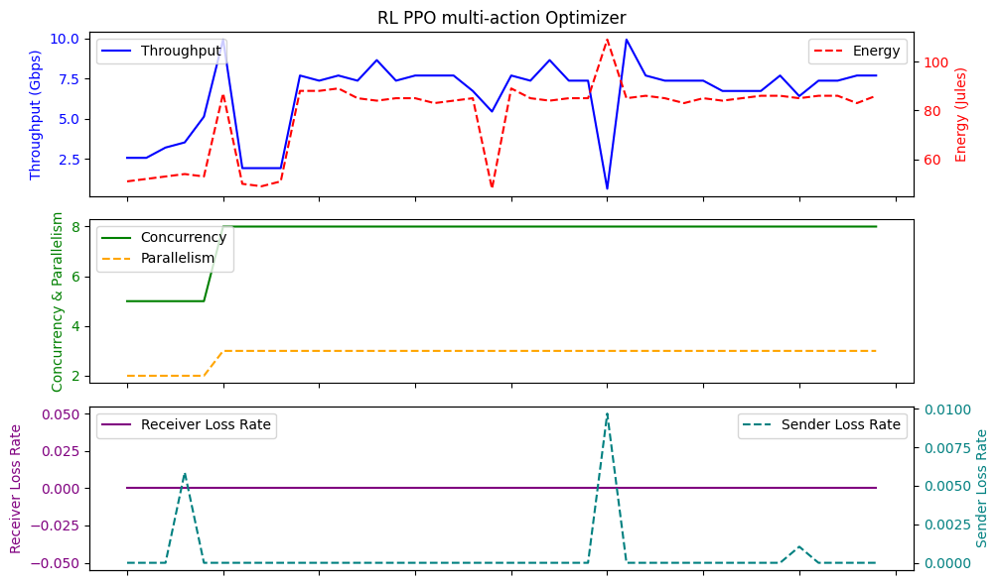

Average Throughput: 6.4239999999999995
Total Energy: 3132.0
Total loss rate: 0.01661206125517174
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:30:20.359958784    5.752889       0.0   3.733333   
min       2024-02-18 02:32:43.951232    0.640000       0.0   0.000000   
25%    2024-02-18 12:20:25.378897920    3.840000       0.0   3.000000   
50%    2024-02-18 13:16:16.326014976    7.040000       0.0   4.000000   
75%    2024-02-18 15:00:12.177843968    7.680000       0.0   5.000000   
max       2024-02-19 09:00:00.791902    8.320000       0.0   5.000000   
std                              NaN    2.506244       0.0   1.601136   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   34.068889   79.866667   0.000143  
min    32.500000   47.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.800000   84.000000   0.00

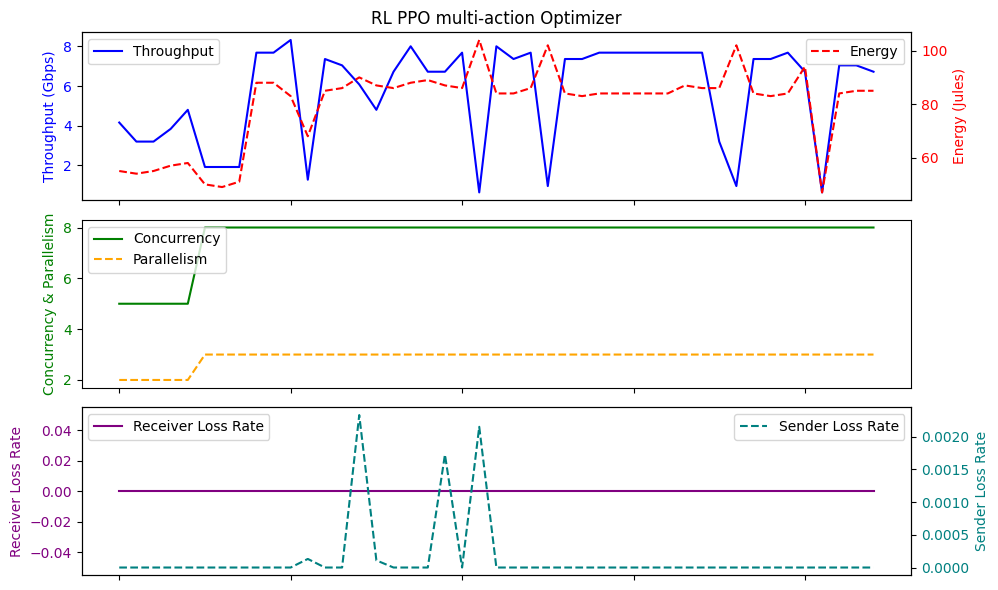

Average Throughput: 5.752888888888889
Total Energy: 3594.0
Total loss rate: 0.006444752675025506
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 15:39:06.693091072    6.300444       0.0   4.155556   
min       2024-02-18 07:35:45.282934    0.960000       0.0   1.000000   
25%    2024-02-18 12:15:04.835802880    5.120000       0.0   4.000000   
50%    2024-02-18 12:27:07.479195904    7.040000       0.0   4.000000   
75%    2024-02-18 13:11:54.193852928    7.680000       0.0   5.000000   
max       2024-02-19 07:42:24.201872    8.320000       0.0   5.000000   
std                              NaN    1.760426       0.0   1.043498   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.484444   80.377778   0.000016  
min    32.600000   49.000000   0.000000  
25%    32.700000   80.000000   0.000000  
50%    32.900000   85.000000   0.00

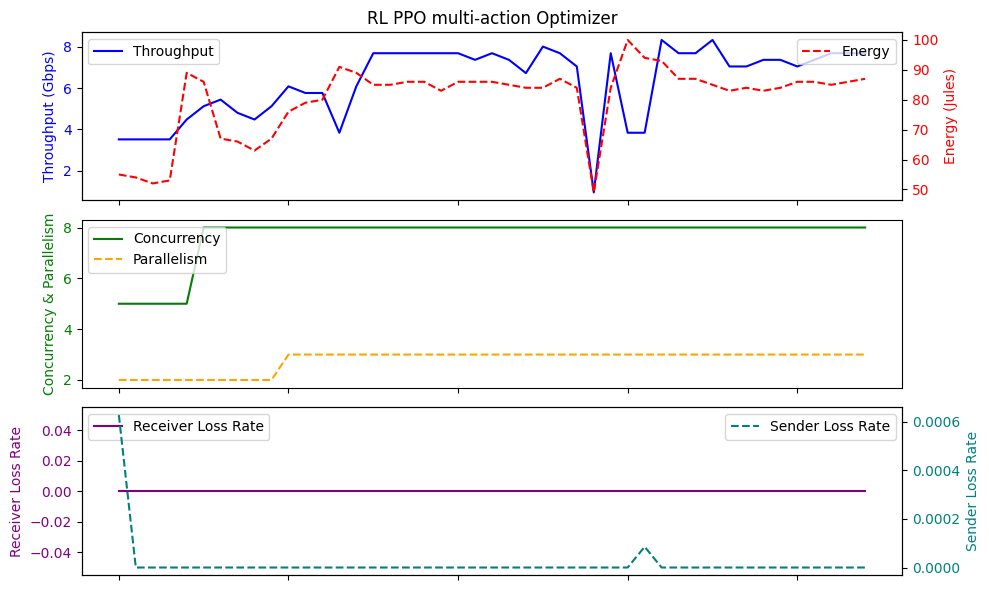

Average Throughput: 6.300444444444445
Total Energy: 3617.0
Total loss rate: 0.0007117451559376687
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 13:00:59.718097920    6.023111       0.0   3.911111   
min       2024-02-18 05:52:22.939988    1.920000       0.0   1.000000   
25%    2024-02-18 10:39:49.254291968    4.800000       0.0   3.000000   
50%    2024-02-18 12:22:31.469146112    7.040000       0.0   4.000000   
75%    2024-02-18 12:35:31.908572928    7.680000       0.0   5.000000   
max       2024-02-19 04:14:05.030204    8.320000       0.0   5.000000   
std                              NaN    1.950412       0.0   1.202691   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.491111  78.466667   0.000025  
min    32.500000  48.000000   0.000000  
25%    32.700000  74.000000   0.000000  
50%    33.000000  84.000000   0.000000 

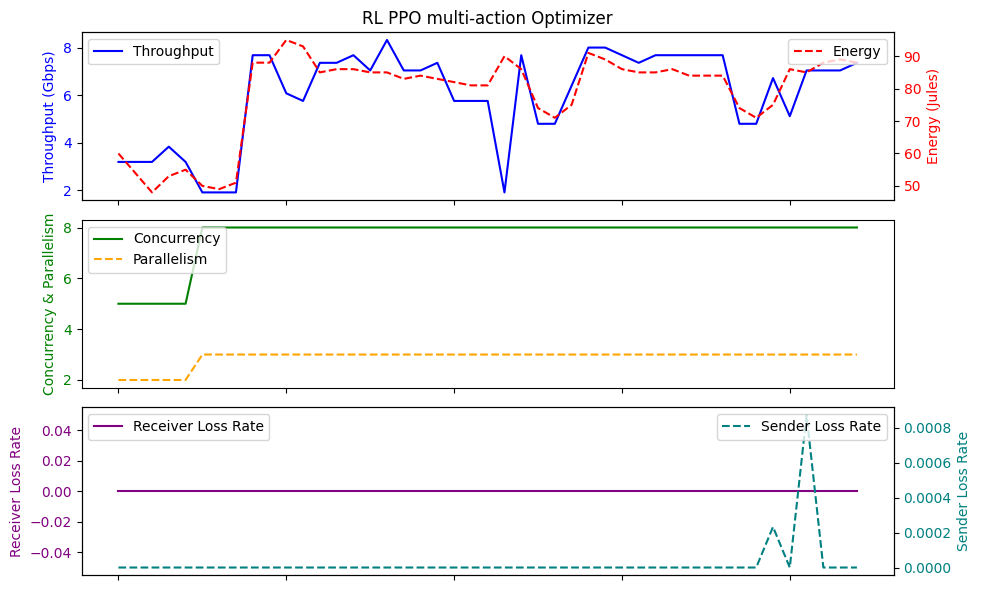

Average Throughput: 6.0231111111111115
Total Energy: 3531.0
Total loss rate: 0.0011058910223833616
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 16:42:22.006119168    6.378667       0.0   4.222222   
min       2024-02-18 02:57:57.701050    3.200000       0.0   2.000000   
25%    2024-02-18 08:30:53.554865920    5.440000       0.0   4.000000   
50%    2024-02-18 12:35:04.529145088    6.720000       0.0   4.000000   
75%    2024-02-18 14:33:58.563646976    7.680000       0.0   5.000000   
max       2024-02-19 16:47:09.983934   10.240000       0.0   6.000000   
std                              NaN    1.650688       0.0   0.974420   

             RTT      Energy  SenderLR  
count  45.000000   45.000000      45.0  
mean   33.020000   81.000000       0.0  
min    32.500000   53.000000       0.0  
25%    32.600000   78.000000       0.0  
50%    32.800000   84.000000       0.0

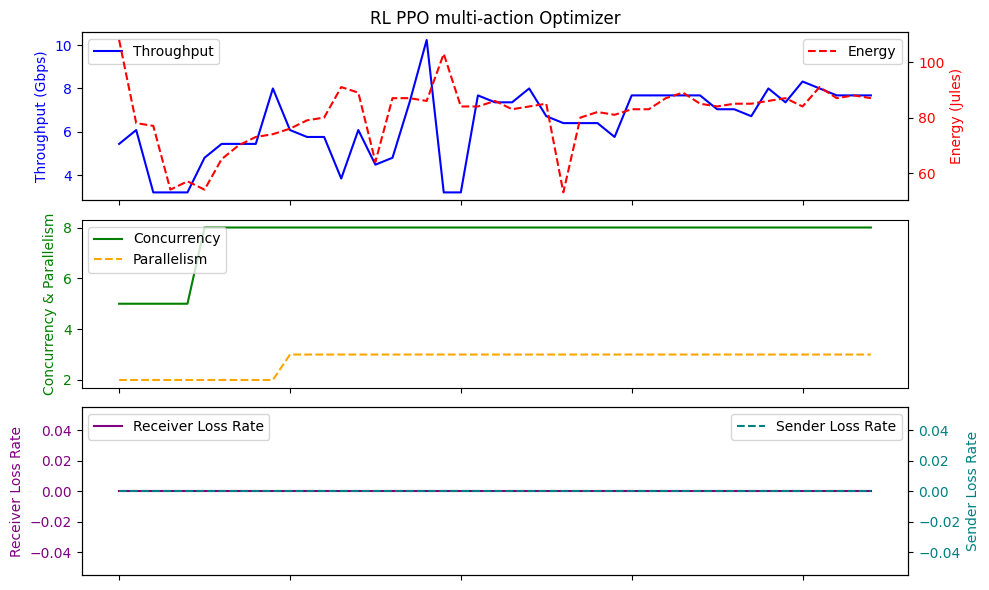

Average Throughput: 6.378666666666667
Total Energy: 3645.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 23:01:27.182259456    6.257778       0.0   4.022222   
min       2024-02-18 07:38:59.112851    0.320000       0.0   0.000000   
25%       2024-02-18 12:15:29.787264    4.160000       0.0   3.000000   
50%    2024-02-18 12:39:47.336514048    6.720000       0.0   4.000000   
75%    2024-02-19 14:14:54.571070976    7.680000       0.0   5.000000   
max       2024-02-19 16:51:43.741502   12.800000       0.0   8.000000   
std                              NaN    2.497003       0.0   1.544622   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.191111   82.444444   0.000138  
min    32.500000   48.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.900000   85.000000   0.000000  
75%    33.

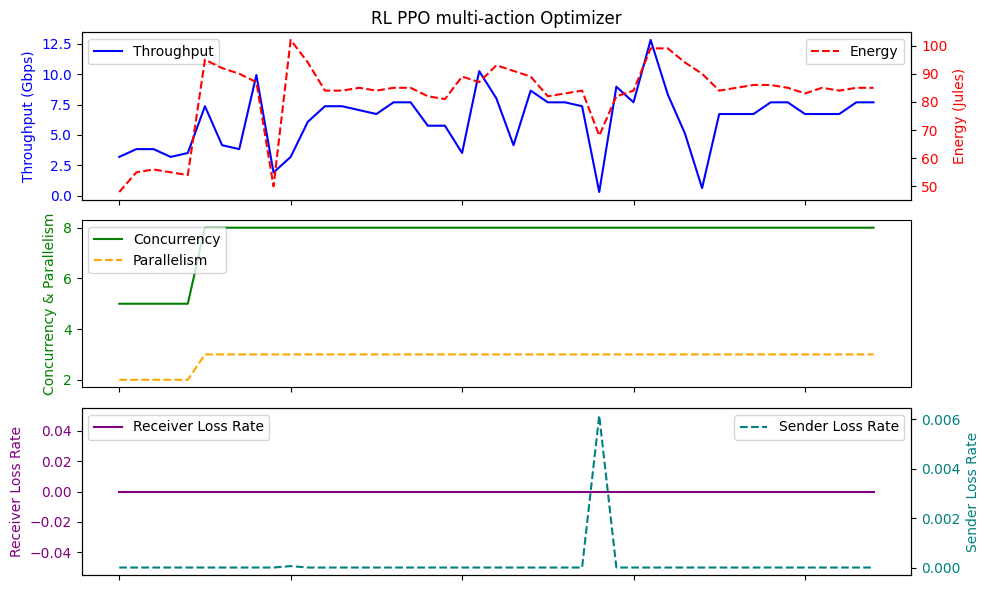

Average Throughput: 6.25777777777778
Total Energy: 3710.0
Total loss rate: 0.006199934588718591
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 14:26:28.442660608    6.101333       0.0   4.000000   
min       2024-02-18 05:31:14.515417    0.640000       0.0   0.000000   
25%    2024-02-18 08:30:58.559074048    4.800000       0.0   3.000000   
50%    2024-02-18 12:15:04.835802880    7.040000       0.0   4.000000   
75%    2024-02-18 12:32:08.134009088    7.680000       0.0   5.000000   
max       2024-02-19 09:52:41.260437   11.200000       0.0   7.000000   
std                              NaN    2.180402       0.0   1.414214   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.028889   79.844444   0.000021  
min    32.500000   46.000000   0.000000  
25%    32.600000   73.000000   0.000000  
50%    32.800000   84.000000   0.000

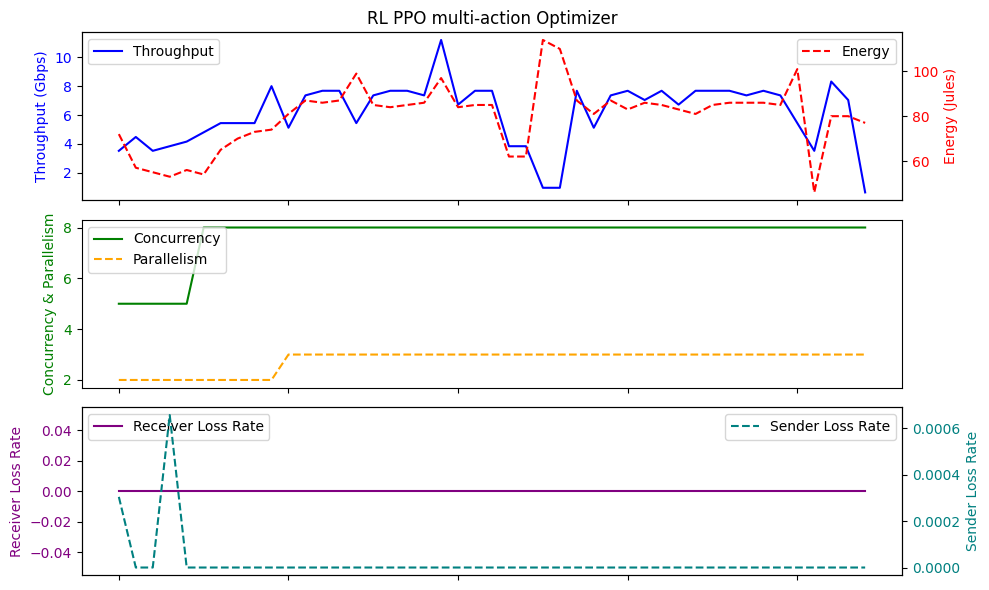

Average Throughput: 6.101333333333334
Total Energy: 3593.0
Total loss rate: 0.0009624466328731162
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 19:24:24.187485184    6.385778       0.0   4.266667   
min       2024-02-18 07:35:43.280827    0.960000       0.0   1.000000   
25%    2024-02-18 10:35:46.882479104    5.120000       0.0   3.000000   
50%    2024-02-18 12:40:38.468071936    7.360000       0.0   5.000000   
75%    2024-02-19 06:24:18.018103040    7.680000       0.0   5.000000   
max       2024-02-19 16:25:11.284180   10.560000       0.0   7.000000   
std                              NaN    2.153072       0.0   1.371794   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   32.980000   83.755556   0.000456  
min    32.500000   54.000000   0.000000  
25%    32.600000   82.000000   0.000000  
50%    32.700000   85.000000   0.0

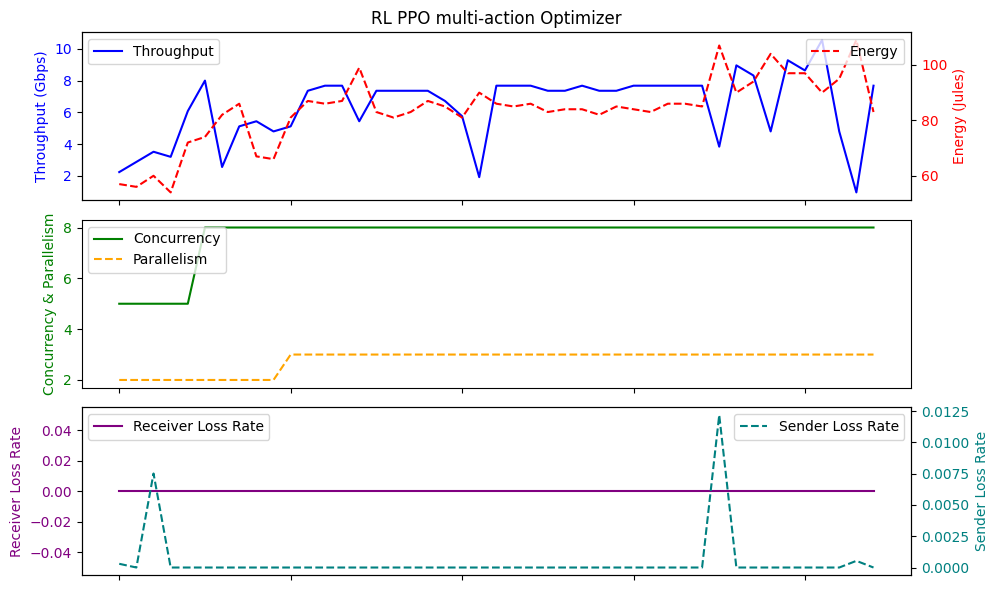

Average Throughput: 6.385777777777778
Total Energy: 3769.0
Total loss rate: 0.020521909674615396
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 17:28:08.319406336    6.307556       0.0   4.177778   
min       2024-02-18 05:05:27.590315    0.960000       0.0   1.000000   
25%    2024-02-18 07:38:57.109469952    5.120000       0.0   4.000000   
50%       2024-02-18 12:15:29.787264    7.040000       0.0   4.000000   
75%    2024-02-19 08:33:59.345285120    7.680000       0.0   5.000000   
max       2024-02-19 12:29:19.270192   10.240000       0.0   6.000000   
std                              NaN    1.938844       0.0   1.173357   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.591111   80.888889   0.000427  
min    32.500000   48.000000   0.000000  
25%    32.600000   79.000000   0.000000  
50%    32.700000   85.000000   0.00

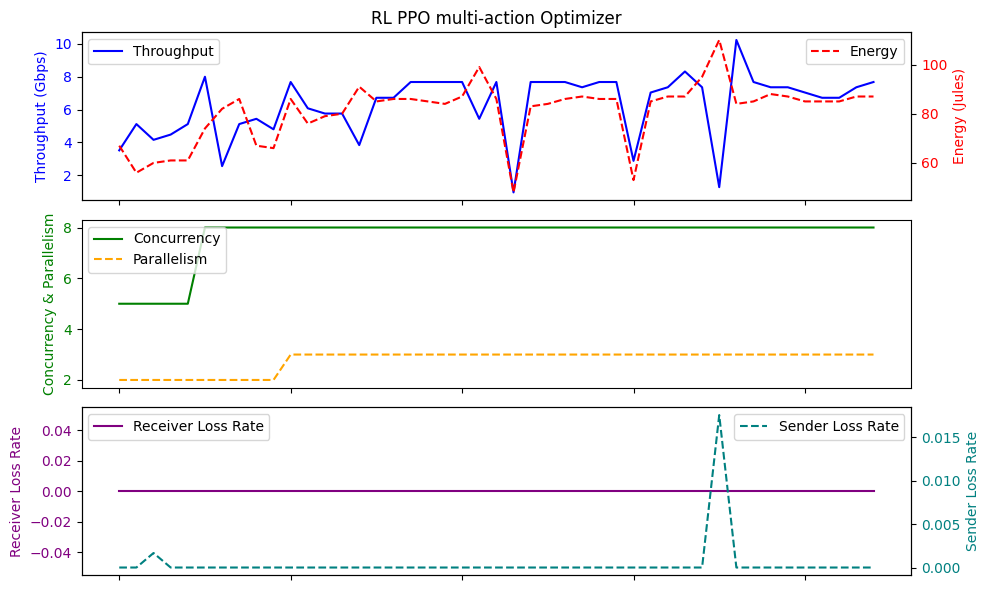

Average Throughput: 6.307555555555556
Total Energy: 3640.0
Total loss rate: 0.019218998257827028
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 11:47:00.566333184    6.480000       0.0   4.275000   
min       2024-02-18 07:35:40.278586    1.280000       0.0   1.000000   
25%    2024-02-18 11:26:49.841122304    5.440000       0.0   4.000000   
50%    2024-02-18 12:32:58.911312384    7.360000       0.0   5.000000   
75%    2024-02-18 13:11:48.431102720    7.680000       0.0   5.000000   
max       2024-02-18 14:07:53.764020    8.320000       0.0   6.000000   
std                              NaN    1.793801       0.0   1.061868   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   33.460000  80.025000   0.000109  
min    32.500000  54.000000   0.000000  
25%    32.600000  79.250000   0.000000  
50%    32.900000  84.000000   0.000000  

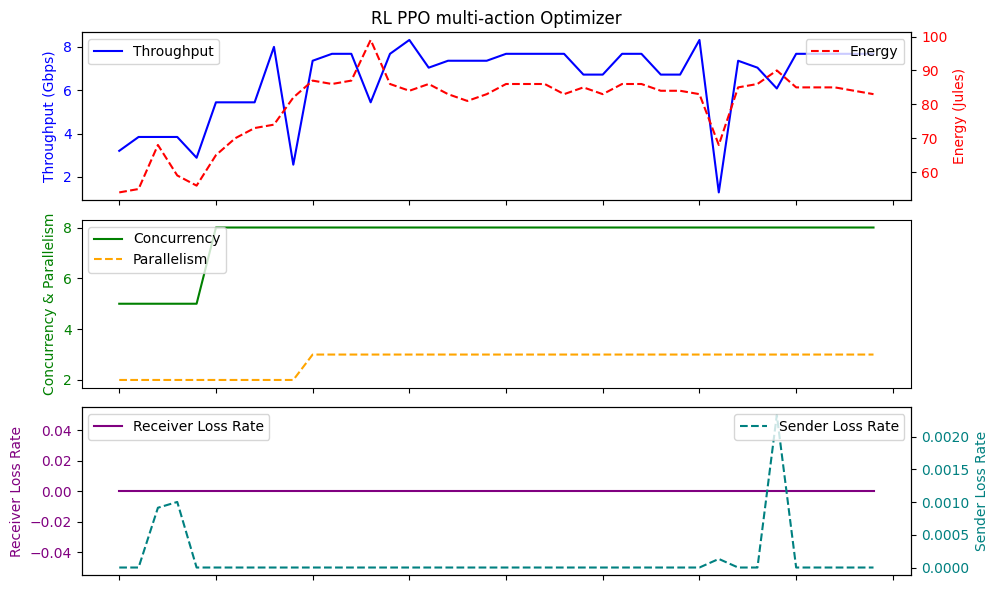

Average Throughput: 6.480000000000001
Total Energy: 3201.0
Total loss rate: 0.004375429023431202
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 10:08:50.121167360    6.616000       0.0   4.325000   
min       2024-02-18 03:23:18.861227    1.280000       0.0   1.000000   
25%    2024-02-18 07:40:44.880446720    6.720000       0.0   4.000000   
50%    2024-02-18 12:22:07.028252928    7.520000       0.0   5.000000   
75%    2024-02-18 12:32:40.229947392    7.680000       0.0   5.000000   
max       2024-02-18 12:36:47.013199    8.320000       0.0   5.000000   
std                              NaN    1.701614       0.0   0.971055   

             RTT     Energy  SenderLR  
count  40.000000  40.000000      40.0  
mean   33.325000  80.100000       0.0  
min    32.500000  47.000000       0.0  
25%    32.600000  83.000000       0.0  
50%    32.800000  84.500000       0.0  
75%  

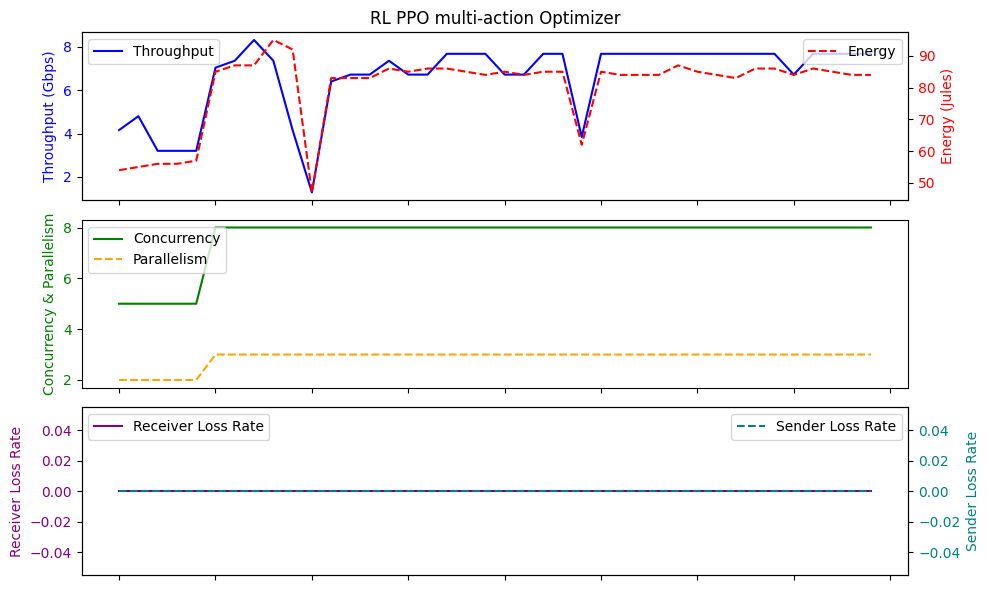

Average Throughput: 6.616
Total Energy: 3204.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 15:22:56.150102016    6.664000       0.0   4.375000   
min       2024-02-18 00:55:01.351404    1.920000       0.0   1.000000   
25%    2024-02-18 07:45:20.411484416    6.960000       0.0   4.000000   
50%    2024-02-18 12:23:25.721848576    7.680000       0.0   5.000000   
75%    2024-02-18 16:49:15.013579008    7.680000       0.0   5.000000   
max       2024-02-19 15:58:46.436742    9.920000       0.0   6.000000   
std                              NaN    2.085059       0.0   1.191584   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   32.997500   81.000000   0.000613  
min    32.500000   48.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.800000   85.000000   0.000000  
75%    33.100000   86.

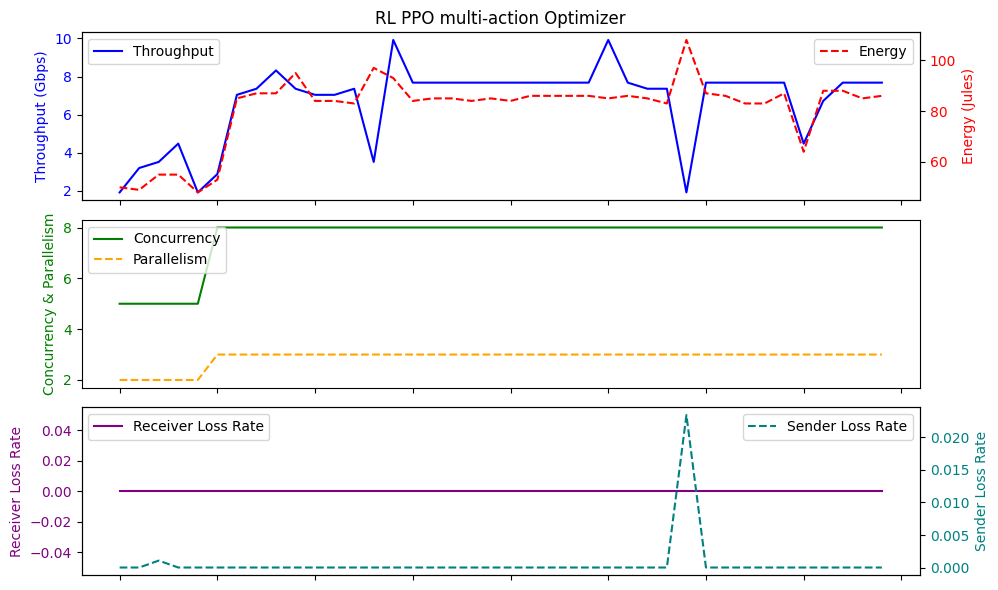

Average Throughput: 6.664
Total Energy: 3240.0
Total loss rate: 0.02450757182408031
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 01:06:38.849671424    6.768000       0.0   4.500000   
min       2024-02-18 07:35:39.275757    1.600000       0.0   1.000000   
25%    2024-02-18 11:43:44.614182144    5.440000       0.0   4.000000   
50%    2024-02-19 07:00:35.829212928    7.360000       0.0   5.000000   
75%    2024-02-19 10:31:51.819050240    7.680000       0.0   5.000000   
max       2024-02-19 14:40:46.290866   12.480000       0.0   8.000000   
std                              NaN    1.887659       0.0   1.240347   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.022500   82.875000   0.000303  
min    32.500000   54.000000   0.000000  
25%    32.600000   81.750000   0.000000  
50%    32.700000   85.000000   0.000000  
75%   

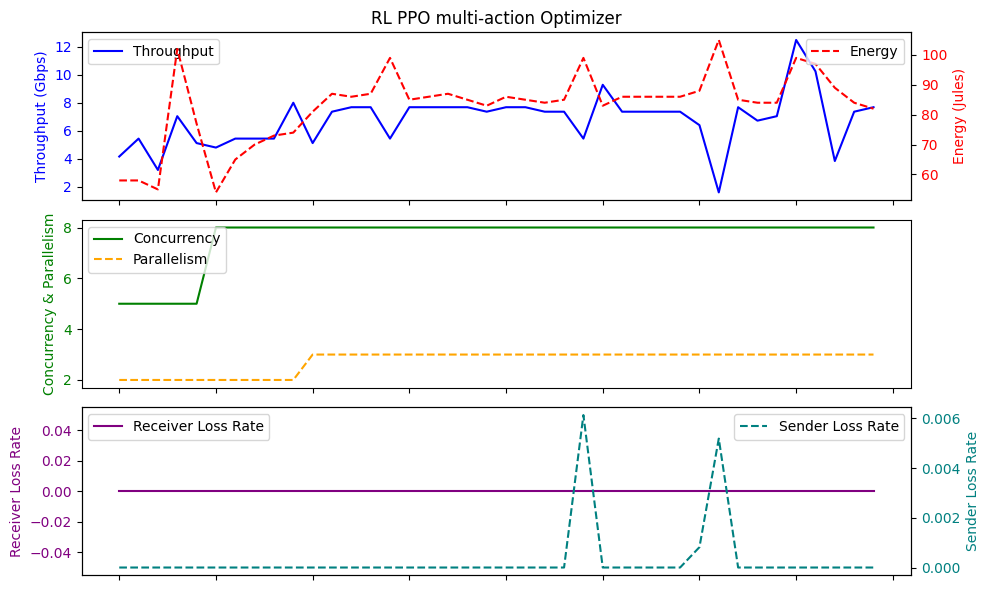

Average Throughput: 6.767999999999999
Total Energy: 3315.0
Total loss rate: 0.012132661434183793
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 20:18:12.745478912    6.408000       0.0   4.325000   
min       2024-02-18 08:53:13.392757    0.960000       0.0   0.000000   
25%    2024-02-18 12:33:00.656435200    5.360000       0.0   4.000000   
50%    2024-02-18 13:01:17.154236672    7.360000       0.0   5.000000   
75%    2024-02-19 06:24:29.427446272    7.680000       0.0   5.000000   
max       2024-02-19 14:40:45.290217    9.280000       0.0   6.000000   
std                              NaN    1.706391       0.0   1.118321   

            RTT     Energy   SenderLR  
count  40.00000  40.000000  40.000000  
mean   33.58250  78.925000   0.000313  
min    32.50000  48.000000   0.000000  
25%    32.70000  75.000000   0.000000  
50%    32.80000  84.000000   0.000000  
75%  

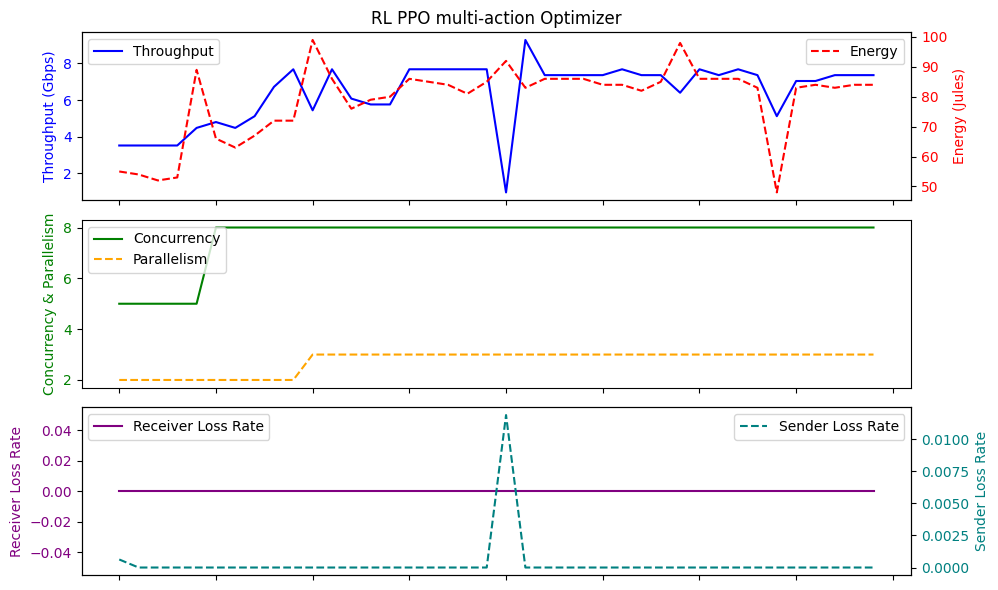

Average Throughput: 6.4079999999999995
Total Energy: 3157.0
Total loss rate: 0.01251391472672975
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 10:01:45.613775360    6.488000       0.0   4.275000   
min       2024-02-18 06:47:43.420506    2.240000       0.0   1.000000   
25%    2024-02-18 07:34:28.648553472    5.440000       0.0   4.000000   
50%    2024-02-18 10:01:27.927277056    7.360000       0.0   5.000000   
75%    2024-02-18 12:24:50.486651392    7.680000       0.0   5.000000   
max       2024-02-18 12:29:38.941937    8.640000       0.0   6.000000   
std                              NaN    1.697907       0.0   1.012423   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   33.370000  79.825000   0.000056  
min    32.500000  51.000000   0.000000  
25%    32.600000  79.750000   0.000000  
50%    32.800000  85.000000   0.000000  

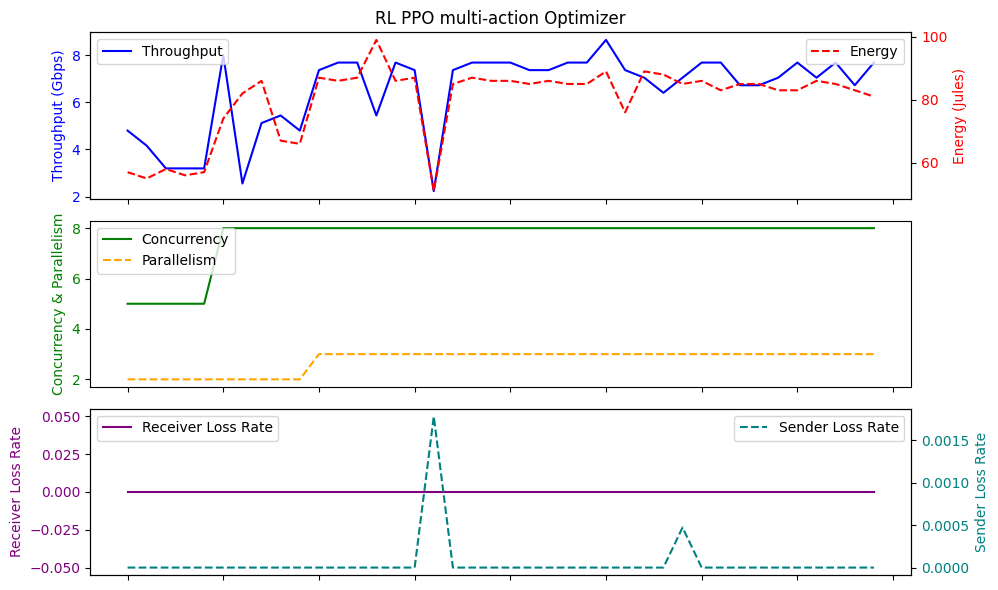

Average Throughput: 6.4879999999999995
Total Energy: 3193.0
Total loss rate: 0.0022523594314727757
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 11:12:14.935121664    6.542222       0.0   4.288889   
min       2024-02-18 05:05:33.593354    1.280000       0.0   1.000000   
25%    2024-02-18 07:44:59.888323072    6.080000       0.0   4.000000   
50%    2024-02-18 12:32:11.139092992    7.360000       0.0   5.000000   
75%    2024-02-18 13:16:21.333351936    7.680000       0.0   5.000000   
max       2024-02-18 15:26:21.978359    9.280000       0.0   6.000000   
std                              NaN    1.818602       0.0   1.079188   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   34.277778   81.044444   0.000058  
min    32.500000   51.000000   0.000000  
25%    32.600000   83.000000   0.000000  
50%    32.800000   85.000000   0.

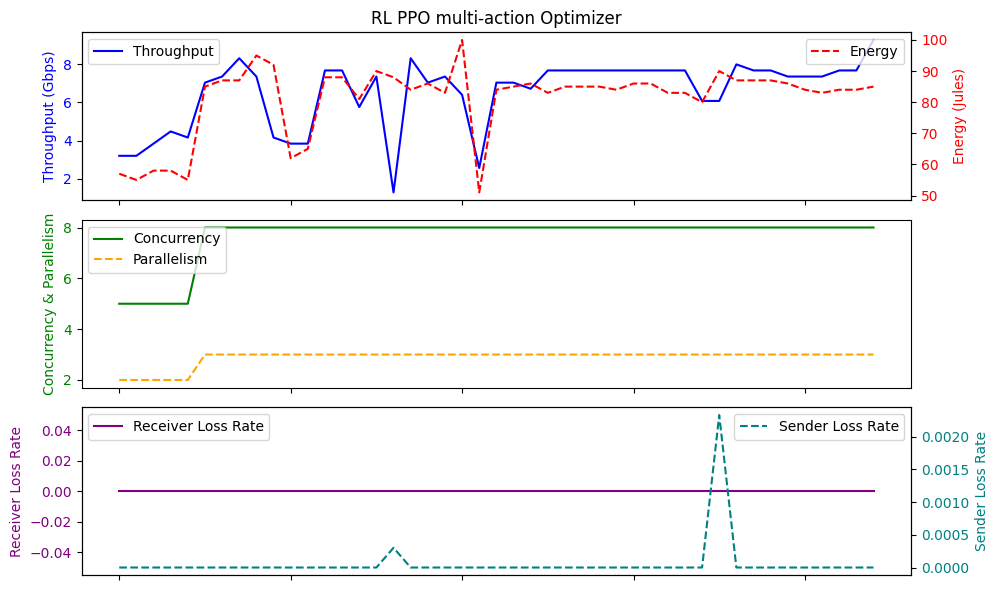

Average Throughput: 6.542222222222222
Total Energy: 3647.0
Total loss rate: 0.002630579896241365
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 18:58:16.544347648    6.407111       0.0   4.222222   
min       2024-02-18 07:38:55.109323    1.280000       0.0   1.000000   
25%    2024-02-18 12:24:09.601703936    5.760000       0.0   4.000000   
50%    2024-02-18 12:30:57.368615936    7.360000       0.0   5.000000   
75%    2024-02-19 09:52:48.273071104    7.680000       0.0   5.000000   
max       2024-02-19 12:29:21.276128    8.320000       0.0   5.000000   
std                              NaN    1.815955       0.0   1.084789   

             RTT     Energy   SenderLR  
count  45.000000  45.000000  45.000000  
mean   33.568889  80.711111   0.000293  
min    32.500000  46.000000   0.000000  
25%    32.600000  83.000000   0.000000  
50%    32.800000  85.000000   0.000000  

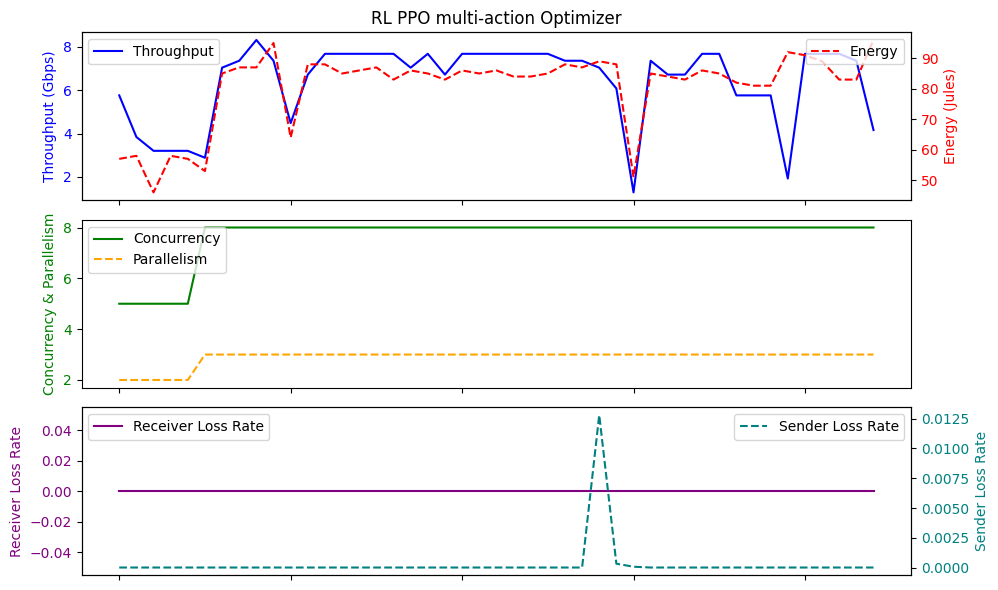

Average Throughput: 6.407111111111112
Total Energy: 3632.0
Total loss rate: 0.01319568312634735
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 11:10:12.806087168    6.424000       0.0   4.275000   
min       2024-02-18 08:52:53.396006    1.920000       0.0   1.000000   
25%    2024-02-18 08:56:06.352145664    5.360000       0.0   4.000000   
50%    2024-02-18 12:16:42.728446464    7.200000       0.0   5.000000   
75%    2024-02-18 12:21:34.721288960    7.680000       0.0   5.000000   
max       2024-02-18 13:16:20.331272    8.320000       0.0   7.000000   
std                              NaN    1.723081       0.0   1.176424   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   33.420000  78.700000   0.000058  
min    32.500000  49.000000   0.000000  
25%    32.600000  72.750000   0.000000  
50%    32.700000  84.000000   0.000000  


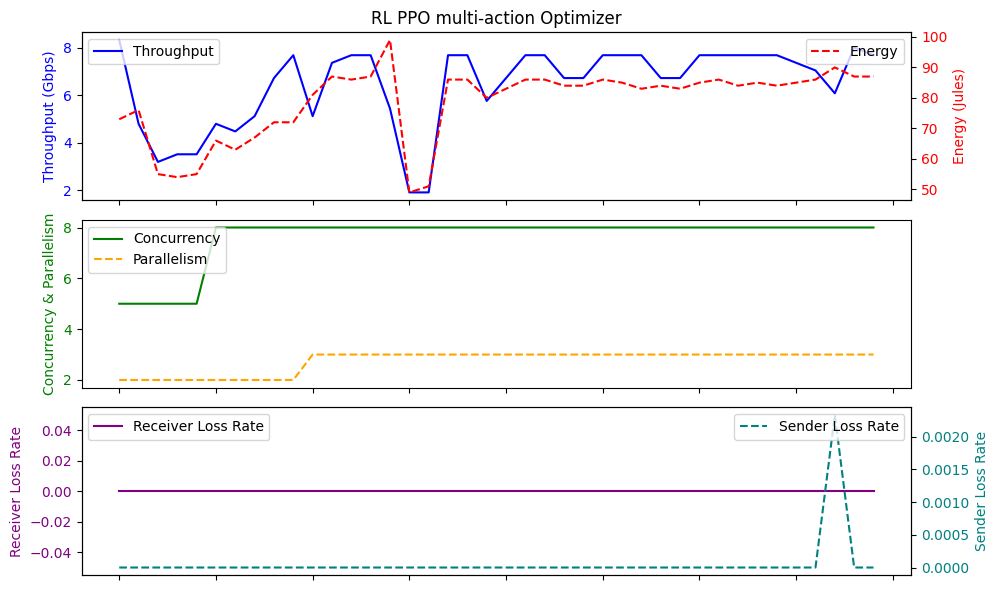

Average Throughput: 6.4239999999999995
Total Energy: 3148.0
Total loss rate: 0.0023292824074074075
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 13:05:48.665546752    6.552000       0.0   4.325000   
min       2024-02-18 07:35:39.275757    1.920000       0.0   1.000000   
25%    2024-02-18 09:51:50.959888896    5.440000       0.0   4.000000   
50%    2024-02-18 12:20:13.563734528    7.360000       0.0   5.000000   
75%    2024-02-18 12:26:10.350836480    7.680000       0.0   5.000000   
max       2024-02-19 04:14:05.030204    8.320000       0.0   6.000000   
std                              NaN    1.668267       0.0   0.997111   

             RTT     Energy  SenderLR  
count  40.000000  40.000000      40.0  
mean   33.052500  79.825000       0.0  
min    32.500000  50.000000       0.0  
25%    32.600000  76.500000       0.0  
50%    32.850000  84.000000       0.0  
75%

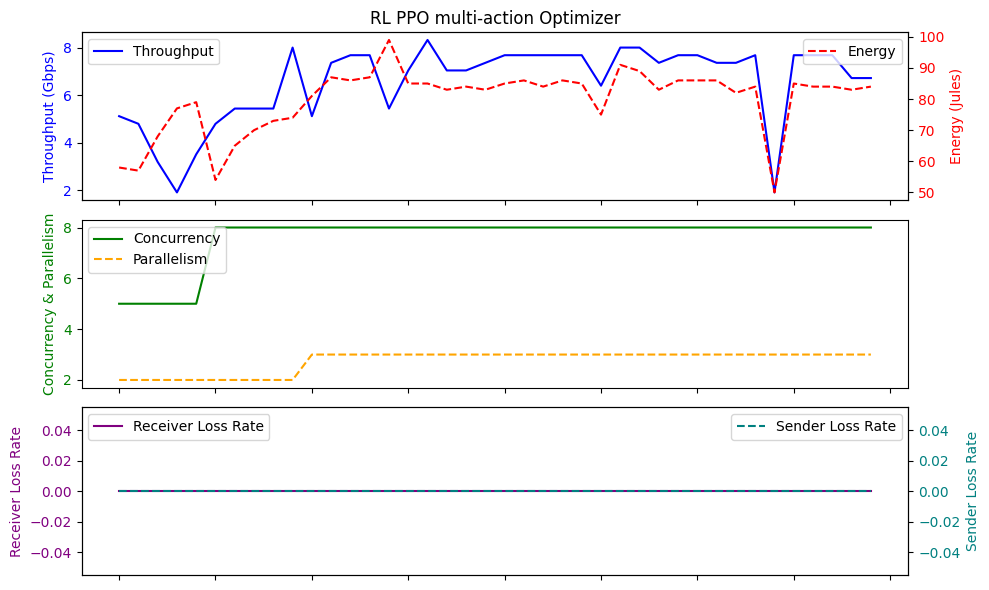

Average Throughput: 6.552
Total Energy: 3193.0
Total loss rate: 0.0
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 20:07:02.725317120    6.536000       0.0   4.350000   
min       2024-02-18 08:53:13.392757    0.320000       0.0   0.000000   
25%    2024-02-18 11:41:51.928274688    5.120000       0.0   4.000000   
50%       2024-02-18 13:50:35.970240    7.520000       0.0   5.000000   
75%    2024-02-19 08:00:36.114748416    7.680000       0.0   5.000000   
max       2024-02-19 14:14:57.574642    9.280000       0.0   8.000000   
std                              NaN    2.098865       0.0   1.528364   

             RTT     Energy   SenderLR  
count  40.000000  40.000000  40.000000  
mean   33.382500  80.925000   0.000318  
min    32.500000  55.000000   0.000000  
25%    32.600000  78.750000   0.000000  
50%    32.800000  84.000000   0.000000  
75%    33.225000  86.000000 

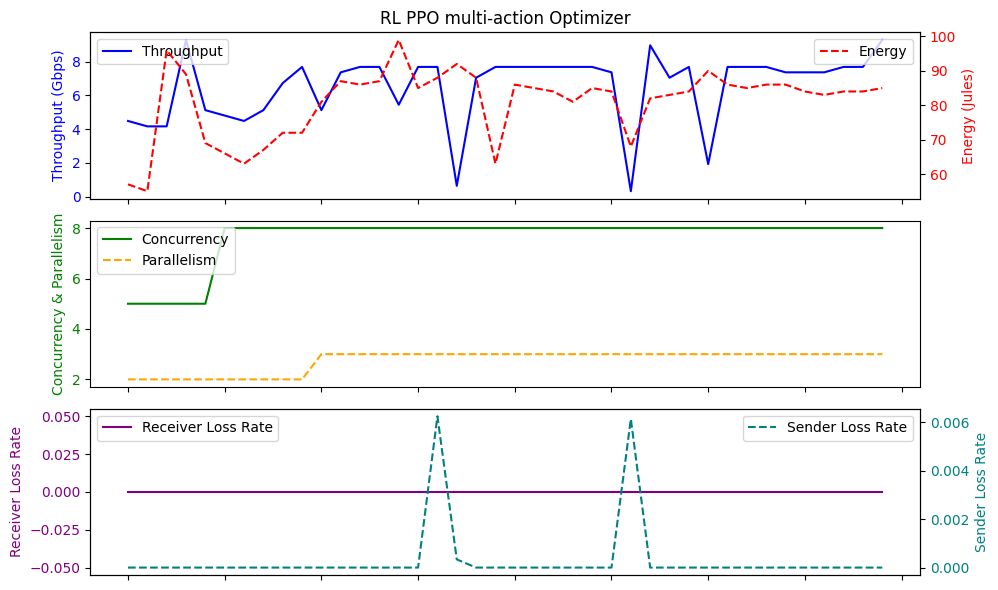

Average Throughput: 6.536
Total Energy: 3237.0
Total loss rate: 0.012736198469805969
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 13:58:01.574654464    6.421333       0.0   4.244444   
min       2024-02-18 03:48:50.791307    3.200000       0.0   2.000000   
25%    2024-02-18 08:57:06.673500928    4.800000       0.0   3.000000   
50%    2024-02-18 12:24:38.349011968    6.720000       0.0   4.000000   
75%    2024-02-18 12:35:32.909336064    7.680000       0.0   5.000000   
max       2024-02-19 16:47:03.965529   11.840000       0.0  10.000000   
std                              NaN    1.626543       0.0   1.264112   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.322222   79.822222   0.000070  
min    32.500000   56.000000   0.000000  
25%    32.700000   74.000000   0.000000  
50%    33.000000   84.000000   0.000000  
75%  

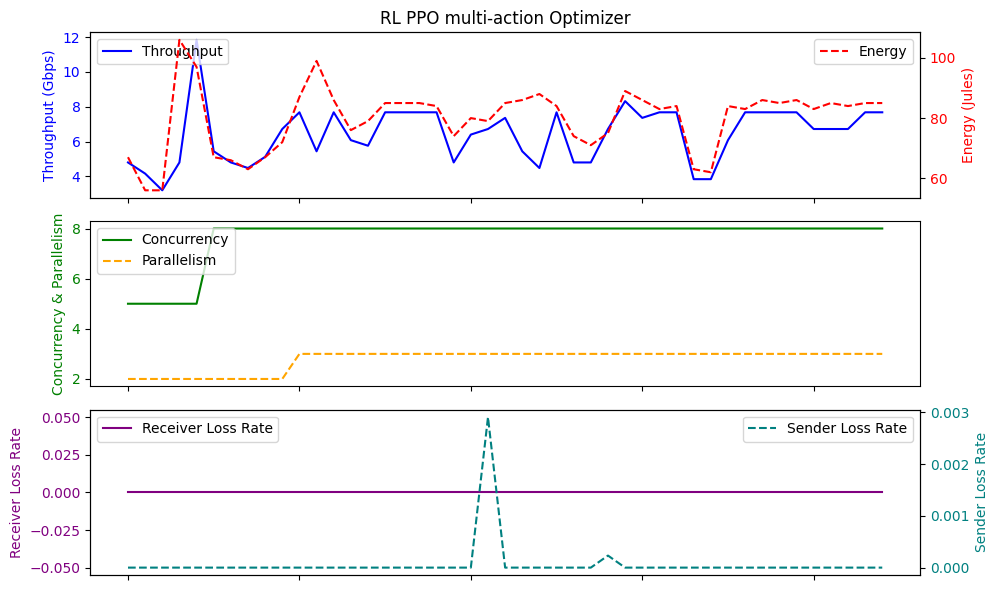

Average Throughput: 6.421333333333336
Total Energy: 3592.0
Total loss rate: 0.0031391963256762836
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 15:49:52.553921280    6.432000       0.0   4.150000   
min       2024-02-18 07:38:55.109323    1.280000       0.0   1.000000   
25%    2024-02-18 09:35:36.431603456    4.800000       0.0   3.750000   
50%    2024-02-18 12:25:40.844122368    7.360000       0.0   5.000000   
75%    2024-02-18 18:11:57.074872832    7.680000       0.0   5.000000   
max       2024-02-19 07:42:24.201872   11.520000       0.0   7.000000   
std                              NaN    2.134728       0.0   1.251666   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.410000   80.900000   0.000032  
min    32.500000   50.000000   0.000000  
25%    32.700000   81.000000   0.000000  
50%    33.000000   86.000000   0.0

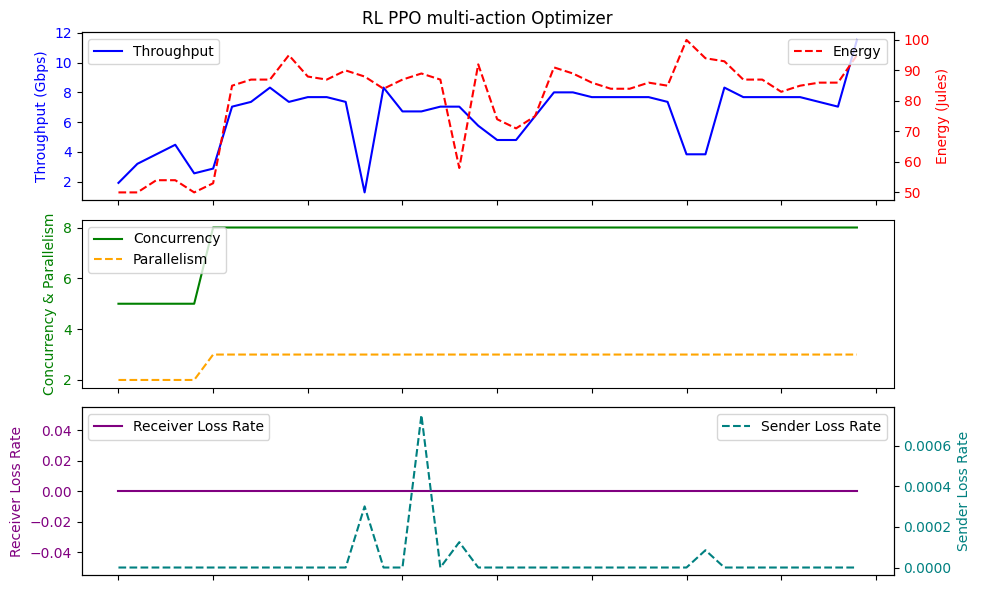

Average Throughput: 6.4319999999999995
Total Energy: 3236.0
Total loss rate: 0.001262880409168435
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 17:38:12.697912832    6.424000       0.0   4.250000   
min       2024-02-18 07:13:15.113920    1.280000       0.0   1.000000   
25%    2024-02-18 08:36:46.075802368    5.440000       0.0   3.750000   
50%    2024-02-18 12:40:56.574766848    6.720000       0.0   4.000000   
75%    2024-02-18 19:30:16.751403008    7.680000       0.0   5.000000   
max       2024-02-19 17:18:15.447395   14.400000       0.0   9.000000   
std                              NaN    2.244552       0.0   1.334935   

             RTT    Energy   SenderLR  
count  40.000000  40.00000  40.000000  
mean   33.335000  79.40000   0.000050  
min    32.500000  51.00000   0.000000  
25%    32.700000  73.75000   0.000000  
50%    32.850000  84.00000   0.000000  
75% 

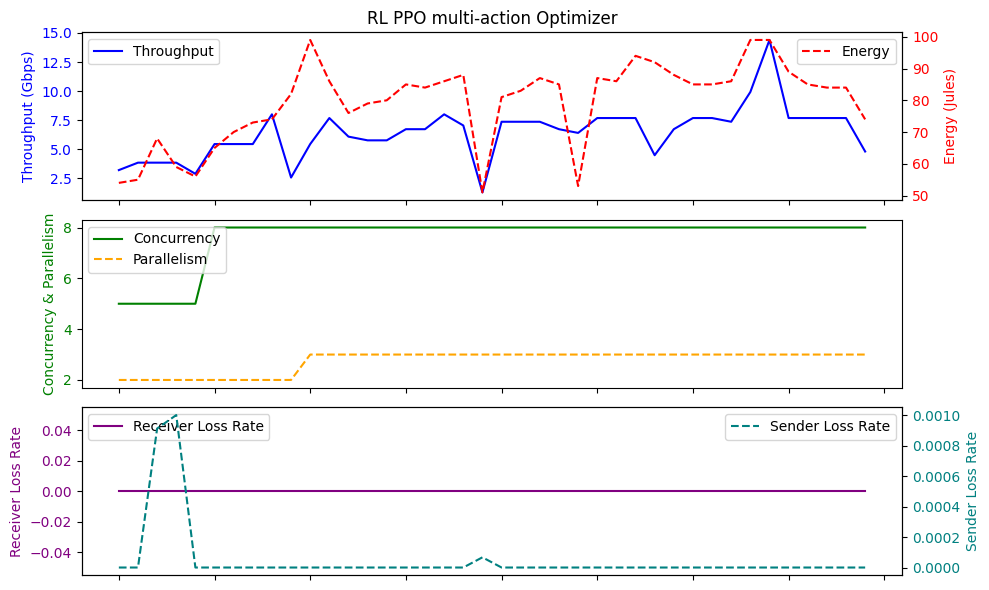

Average Throughput: 6.424000000000001
Total Energy: 3176.0
Total loss rate: 0.001981941628201387
                                Time  Throughput  LossRate      Score  \
count                             45   45.000000      45.0  45.000000   
mean   2024-02-18 16:05:03.238123776    6.371556       0.0   4.244444   
min       2024-02-18 07:35:41.278783    0.960000       0.0   1.000000   
25%    2024-02-18 08:57:06.673500928    5.440000       0.0   4.000000   
50%    2024-02-18 13:42:02.494270976    7.360000       0.0   5.000000   
75%       2024-02-18 15:26:23.983168    7.680000       0.0   5.000000   
max       2024-02-19 09:52:44.271776   11.520000       0.0   7.000000   
std                              NaN    2.277936       0.0   1.416711   

             RTT      Energy   SenderLR  
count  45.000000   45.000000  45.000000  
mean   33.411111   85.666667   0.000093  
min    32.500000   54.000000   0.000000  
25%    32.600000   82.000000   0.000000  
50%    32.700000   86.000000   0.00

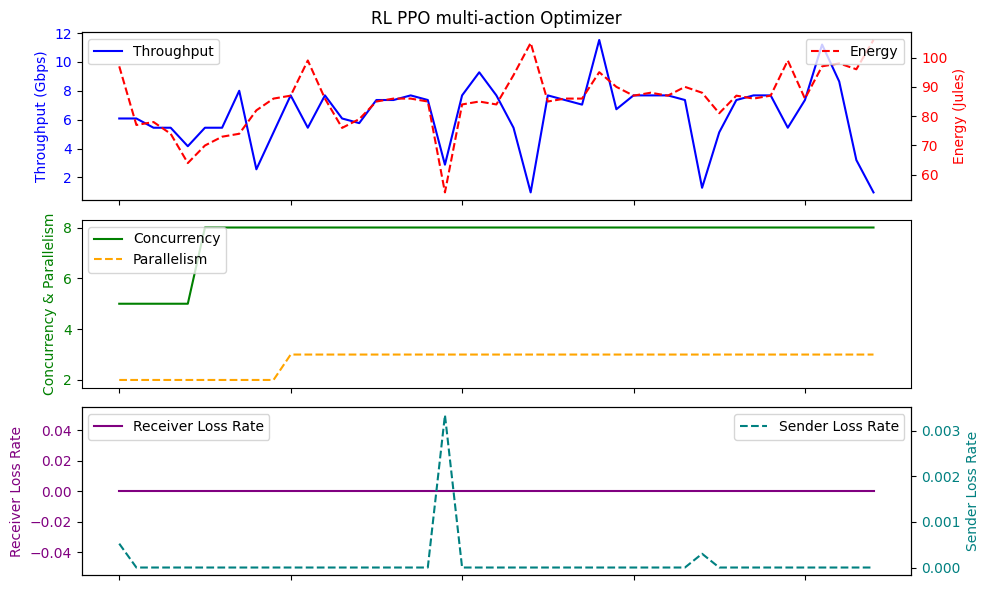

Average Throughput: 6.371555555555555
Total Energy: 3855.0
Total loss rate: 0.0041655416035776445
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-18 16:00:19.639808512    6.472000       0.0   4.300000   
min       2024-02-18 04:14:20.907895    1.920000       0.0   1.000000   
25%    2024-02-18 11:42:27.053443328    6.000000       0.0   4.000000   
50%    2024-02-18 12:29:01.688786944    7.360000       0.0   5.000000   
75%    2024-02-18 16:45:53.660388096    7.680000       0.0   5.000000   
max       2024-02-19 11:06:40.301023    8.000000       0.0   5.000000   
std                              NaN    1.904191       0.0   1.181047   

             RTT     Energy  SenderLR  
count  40.000000  40.000000      40.0  
mean   33.535000  79.175000       0.0  
min    32.600000  49.000000       0.0  
25%    32.600000  82.750000       0.0  
50%    32.800000  85.000000       0.0  
75% 

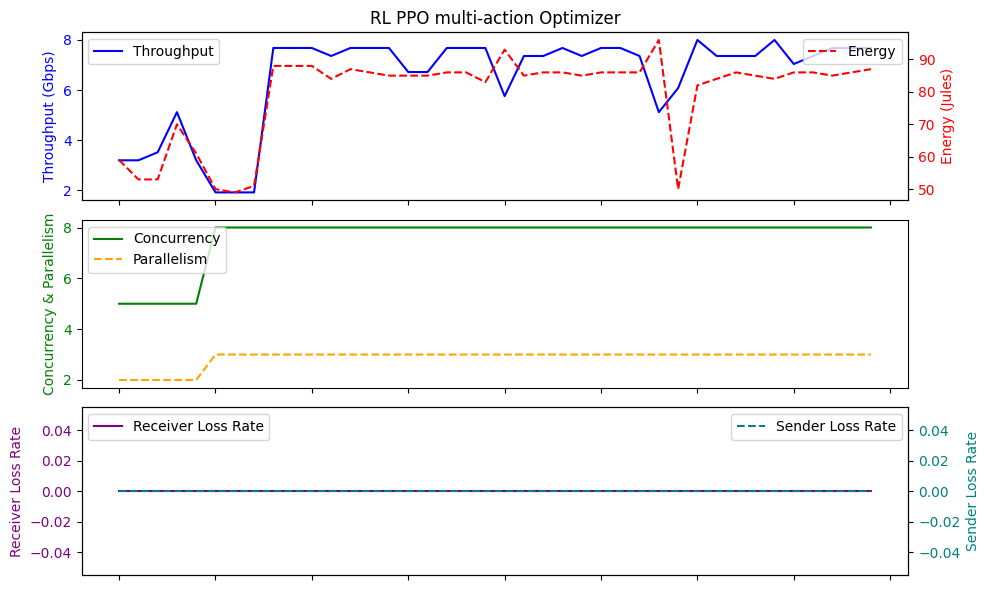

Average Throughput: 6.4719999999999995
Total Energy: 3167.0
Total loss rate: 0.0


In [18]:
num_of_run=50

rl_score_sla_throughput_list=[]
rl_score_sla_energy_list=[]
rl_score_sla_plr_list=[]


model = PPO.load("./ppo_multi_action_in_de_scoreSLA/ppo_best_model/best_model.zip")
for i in range(0,num_of_run):
    done = False
    episode_reward = 0
    env=transferClass_multi_action_increase_decrease_score_SLA(cluster_dictionary,initial_value_cluster_dictionary,'scoreSLA')
    action_list=[]
    reward_list=[]
    obs = env.reset()
    while not done:
        action, _ = model.predict(obs, deterministic=True)
        action_list.append(action)
    #     print("action: ",action)
        obs, reward, done, info = env.step(action)
    #     obs = obs.astype(np.float32)
    #     print("obs: ", obs,".... reward: ",reward)
        reward_list.append(reward)
        episode_reward += reward

    accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
    env.close()
    print(accumulator_df.describe())
    print(f"Episode reward: {episode_reward}")
    print(f"actions {action_list},   {len(action_list)}")
    print(f"rewards {reward_list},  {len(reward_list)}")
    rl_score_sla_throughput_list.append(accumulator_df['Throughput'].mean())
    rl_score_sla_energy_list.append(accumulator_df['Energy'].sum())
    rl_score_sla_plr_list.append(accumulator_df['SenderLR'].sum())
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6), sharex=True)

    df=accumulator_df.reset_index()
    # Top plot with Throughput and Energy
    ax1.plot( df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL PPO multi-action Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')


    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot( df['LossRate'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot( df['SenderLR'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
#     ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = accumulator_df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = accumulator_df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = accumulator_df['SenderLR'].sum()
    print("Total loss rate:", total_plr)

**Energy SLA**

In [19]:
class transferClass_multi_action_increase_decrease_energy_SLA(gym.Env):
    metadata = {"render_modes": ["human"], "render_fps": 30}
    def __init__(self,transaction_dfs,initial_dfs,optimizer,total_steps=20,min_values=[0.32, 0.0, 1, 1, -3081.0, 0.0, 44.0, 0.0],max_values = [19.2, 2.0, 8, 8, 16.0, 70.1, 120.0, 74.166],total_file_size=256):
        super().__init__()
        self.min_action=1
        self.max_action=8
        self.action_i_d_array=[1,4,0,-1,-4]

        self.transaction_dfs = transaction_dfs
        self.initial_dfs= initial_dfs

        self.action_space = spaces.MultiDiscrete([5, 5])  # example action space
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(40,), dtype=np.float32) # example observation space
        self.current_observation = np.zeros(40,) # initialize current observation

        self.energy_sla=100
        self.optimizer=optimizer
        self.old_action=None
        self.step_number=0
        self.total_steps=total_steps
        self.sampling_metric='Score'
        self.min_values=np.array(min_values)
        self.max_values=np.array(max_values)
        self.previous_reward=0
        self.obs_df=[]
        self.total_file_size= total_file_size
        self.current_download_size=0

    def reset(self):
        self.current_observation = np.zeros(40,) # initialize current observation
        self.old_action=None
        self.step_number=0
        self.previous_reward=0
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.obs_df=[]
        self.current_download_size=0
        return self.current_observation

    def step(self, action):
        # perform action using transfer_service
        action_1,action_2=action

        self.current_action_parallelism_value+=self.action_i_d_array[action_1]
        if self.current_action_parallelism_value<self.min_action:
            self.current_action_parallelism_value=self.min_action
        elif self.current_action_parallelism_value>self.max_action:
            self.current_action_parallelism_value=self.max_action

        self.current_action_concurrency_value+=self.action_i_d_array[action_2]
        if self.current_action_concurrency_value<self.min_action:
            self.current_action_concurrency_value=self.min_action
        elif self.current_action_concurrency_value>self.max_action:
            self.current_action_concurrency_value=self.max_action


        action_t=(self.current_action_parallelism_value,self.current_action_concurrency_value)
#         print(f"action_t {action_t}")

        if self.old_action==None:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            if energy_part_reward > self.energy_sla:
                energy_penalty=self.energy_sla-energy_part_reward
            else:
                energy_penalty=0                
            reward_=np.mean(t_array)+energy_penalty 
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        elif self.old_action==action_t:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            if energy_part_reward > self.energy_sla:
                energy_penalty=self.energy_sla-energy_part_reward
            else:
                energy_penalty=0                
            reward_=np.mean(t_array)+energy_penalty 
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        else:
            done=False
            key_name=(self.old_action, action_t)
            work_df=self.transaction_dfs[key_name]
            if work_df.empty:
                observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            else:
                observation_df=sample_row_and_neighbors(self.transaction_dfs[key_name],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)            
            if energy_part_reward > self.energy_sla:
                energy_penalty=self.energy_sla-energy_part_reward
            else:
                energy_penalty=0
            reward_=np.mean(t_array)+energy_penalty 
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_


        self.step_number+=1
        if self.current_download_size>=self.total_file_size:
            done=True
        observation = np.asarray(observation).astype(np.float32)
        self.current_observation=observation
        return self.current_observation, reward, done, {}

    def bayes_step(self,action):
        params = [1 if x<1 else int(np.round(x)) for x in action]
        self.current_action_array_index+=self.action_i_d_array[params[0]]
        if self.current_action_array_index<self.min_action:
            self.current_action_array_index=self.min_action
        elif self.current_action_array_index>self.max_action:
            self.current_action_array_index=self.max_action
        action_t=self.action_array[self.current_action_array_index]

        print("Bayes Step: ",action_t)
        obs,score_b,done_b,__=self.step(action_t)
        print("Bayes Step Score: ", score_b)
        return np.round(score_b * (-1))

    def render(self, mode="human"):
        pass

    def close(self):
        self.reset()


In [71]:
env=transferClass_multi_action_increase_decrease_energy_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energySLA')
total_scores=0
s = env.reset()
action_list=[]
reward_list=[]
done = False
while not done:
    a=env.action_space.sample()
    s_next, r, done, info = env.step(a)
    # print( len(s_next))
    action_list.append(a)
    reward_list.append(r)
    total_scores += r
    s = s_next
accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
env.close()
print(f"Total Reward: {total_scores}")
print(f"actions {action_list},   {len(action_list)}")
print(f"rewards {reward_list},  {len(reward_list)}")
print(accumulator_df)
print(f"Total downloaded {accumulator_df['Throughput'].sum()} Gb")
print(f"Download speed {accumulator_df['Throughput'].mean()} Gbps")

Total Reward: 6.336
actions [array([4, 0]), array([3, 2]), array([1, 2]), array([0, 3]), array([0, 4]), array([2, 3]), array([3, 3]), array([2, 3]), array([2, 3]), array([3, 1]), array([1, 2]), array([2, 2]), array([2, 2]), array([2, 3]), array([1, 3])],   15
rewards [0.64, 0.0, 1.6, -0.5760000000000001, 0.5760000000000001, 0.512, -0.96, 1.9200000000000004, -2.4320000000000004, 4.4159999999999995, 1.9840000000000018, -2.7520000000000016, 1.2160000000000002, 0.2560000000000002, -0.06400000000000006],  15
                          Time  Throughput  LossRate Parallelism Concurrency  \
452 2024-02-18 03:03:31.696569        0.64       0.0           1           2   
453 2024-02-18 03:03:32.698213        0.64       0.0           1           2   
454 2024-02-18 03:03:33.701884        0.64       0.0           1           2   
455 2024-02-18 03:03:54.088492        0.64       0.0           1           2   
456 2024-02-18 03:03:55.089982        0.64       0.0           1           2   
..         

In [ ]:
env=transferClass_multi_action_increase_decrease_energy_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energySLA')
evaluation_env=transferClass_multi_action_increase_decrease_energy_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energySLA')

policy_kwargs = dict(activation_fn=th.nn.ReLU,net_arch=[{'pi': [128, 128], 'vf': [128, 128]}])

run_string='multi_action_in_de_energySLA'
model = PPO("MlpPolicy", env=env, policy_kwargs=policy_kwargs, verbose=1,tensorboard_log=f"./ppo_tensorboard_{run_string}/",ent_coef=0.01)

eval_callback = EvalCallback(evaluation_env, best_model_save_path=f'./ppo_{run_string}/ppo_best_model/',
                               log_path=f'./ppo_{run_string}/ppo_logs/', eval_freq=1000,
                               deterministic=True, render=False)
# Callback for saving checkpoints every 1000 timesteps
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path=f'./ppo_{run_string}/ppo_checkpoints/',
                                           name_prefix=f'ppo_model_{run_string}')

# Combine both callbacks
callback = CallbackList([checkpoint_callback, eval_callback])
model.learn(total_timesteps=1000000, callback=callback)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to ./ppo_tensorboard_multi_action_in_de_energySLA/PPO_2


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/policies.py:484: UserWarning: As shared layers in the mlp_extractor are removed since SB3 v1.8.0, you should now pass directly a dictionary and not a list (net_arch=dict(pi=..., vf=...) instead of net_arch=[dict(pi=..., vf=...)])
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengt

Eval num_timesteps=1000, episode_reward=2.27 +/- 1.31
Episode length: 49.20 +/- 9.26
---------------------------------
| eval/              |          |
|    mean_ep_length  | 49.2     |
|    mean_reward     | 2.27     |
| time/              |          |
|    total_timesteps | 1000     |
---------------------------------
New best mean reward!


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=2000, episode_reward=1.04 +/- 0.28
Episode length: 56.40 +/- 4.54
---------------------------------
| eval/              |          |
|    mean_ep_length  | 56.4     |
|    mean_reward     | 1.04     |
| time/              |          |
|    total_timesteps | 2000     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    fps             | 251      |
|    iterations      | 1        |
|    time_elapsed    | 8        |
|    total_timesteps | 2048     |
---------------------------------
Eval num_timesteps=3000, episode_reward=6.54 +/- 1.40
Episode length: 8.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8.4          |
|    mean_reward          | 6.54         |
| time/                   |              |
|    total_timesteps      | 3000      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=4000, episode_reward=7.54 +/- 1.62
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 7.54     |
| time/              |          |
|    total_timesteps | 4000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    fps             | 245      |
|    iterations      | 2        |
|    time_elapsed    | 16       |
|    total_timesteps | 4096     |
---------------------------------
Eval num_timesteps=5000, episode_reward=5.49 +/- 4.93
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 5.49        |
| time/                   |             |
|    total_timesteps      | 5000        |
| train/                  |             |
|    approx_kl            | 0.010564286 |
|    clip_fraction        | 0.156       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.18       |
|    explained_variance   | 0.572       |
|    learning_rate        | 0.0003      |
|    los

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=6000, episode_reward=7.50 +/- 0.46
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.5      |
| time/              |          |
|    total_timesteps | 6000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 6.54     |
| time/              |          |
|    fps             | 246      |
|    iterations      | 3        |
|    time_elapsed    | 24       |
|    total_timesteps | 6144     |
---------------------------------
Eval num_timesteps=7000, episode_reward=7.55 +/- 0.45
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.55        |
| time/                   |             |
|    total_timesteps      | 7000        |
| train/                  |             |
|    approx_kl            | 0.013924374 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.14       |
|    explained_variance   | 0.702       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=8000, episode_reward=7.87 +/- 1.14
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.87     |
| time/              |          |
|    total_timesteps | 8000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 6.8      |
| time/              |          |
|    fps             | 245      |
|    iterations      | 4        |
|    time_elapsed    | 33       |
|    total_timesteps | 8192     |
---------------------------------
Eval num_timesteps=9000, episode_reward=7.72 +/- 1.31
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.72        |
| time/                   |             |
|    total_timesteps      | 9000        |
| train/                  |             |
|    approx_kl            | 0.011787007 |
|    clip_fraction        | 0.17        |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.09       |
|    explained_variance   | 0.734       |
|    learning_rate        | 0.0003      |
|    los

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=10000, episode_reward=6.00 +/- 1.86
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 6        |
| time/              |          |
|    total_timesteps | 10000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 7.25     |
| time/              |          |
|    fps             | 245      |
|    iterations      | 5        |
|    time_elapsed    | 41       |
|    total_timesteps | 10240    |
---------------------------------
Eval num_timesteps=11000, episode_reward=7.55 +/- 1.17
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 7.55        |
| time/                   |             |
|    total_timesteps      | 11000       |
| train/                  |             |
|    approx_kl            | 0.012446796 |
|    clip_fraction        | 0.16        |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.05       |
|    explained_variance   | 0.787       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=12000, episode_reward=6.78 +/- 1.29
Episode length: 7.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.8      |
|    mean_reward     | 6.78     |
| time/              |          |
|    total_timesteps | 12000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    fps             | 245      |
|    iterations      | 6        |
|    time_elapsed    | 49       |
|    total_timesteps | 12288    |
---------------------------------
Eval num_timesteps=13000, episode_reward=7.32 +/- 1.19
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 7.32        |
| time/                   |             |
|    total_timesteps      | 13000       |
| train/                  |             |
|    approx_kl            | 0.011098438 |
|    clip_fraction        | 0.135       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.99       |
|    explained_variance   | 0.765       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=14000, episode_reward=6.63 +/- 1.58
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 6.63     |
| time/              |          |
|    total_timesteps | 14000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    fps             | 245      |
|    iterations      | 7        |
|    time_elapsed    | 58       |
|    total_timesteps | 14336    |
---------------------------------
Eval num_timesteps=15000, episode_reward=8.59 +/- 1.80
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.59        |
| time/                   |             |
|    total_timesteps      | 15000       |
| train/                  |             |
|    approx_kl            | 0.010788183 |
|    clip_fraction        | 0.132       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.95       |
|    explained_variance   | 0.796       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=16000, episode_reward=6.73 +/- 1.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.73     |
| time/              |          |
|    total_timesteps | 16000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 7.52     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 8        |
|    time_elapsed    | 66       |
|    total_timesteps | 16384    |
---------------------------------
Eval num_timesteps=17000, episode_reward=8.45 +/- 1.18
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.45        |
| time/                   |             |
|    total_timesteps      | 17000       |
| train/                  |             |
|    approx_kl            | 0.008609468 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.95       |
|    explained_variance   | 0.816       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=18000, episode_reward=7.17 +/- 1.01
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.17     |
| time/              |          |
|    total_timesteps | 18000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 7.22     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 9        |
|    time_elapsed    | 75       |
|    total_timesteps | 18432    |
---------------------------------
Eval num_timesteps=19000, episode_reward=7.16 +/- 1.04
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.16        |
| time/                   |             |
|    total_timesteps      | 19000       |
| train/                  |             |
|    approx_kl            | 0.009642774 |
|    clip_fraction        | 0.0912      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.94       |
|    explained_variance   | 0.804       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=20000, episode_reward=7.97 +/- 1.05
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.97     |
| time/              |          |
|    total_timesteps | 20000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 7.51     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 10       |
|    time_elapsed    | 83       |
|    total_timesteps | 20480    |
---------------------------------
Eval num_timesteps=21000, episode_reward=8.31 +/- 1.18
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 8.31       |
| time/                   |            |
|    total_timesteps      | 21000      |
| train/                  |            |
|    approx_kl            | 0.00930197 |
|    clip_fraction        | 0.119      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.92      |
|    explained_variance   | 0.791      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.4        |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=22000, episode_reward=8.08 +/- 1.75
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.08     |
| time/              |          |
|    total_timesteps | 22000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 11       |
|    time_elapsed    | 92       |
|    total_timesteps | 22528    |
---------------------------------
Eval num_timesteps=23000, episode_reward=6.33 +/- 1.36
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 6.33         |
| time/                   |              |
|    total_timesteps      | 23000        |
| train/                  |              |
|    approx_kl            | 0.0077300323 |
|    clip_fraction        | 0.0893       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.89        |
|    explained_variance   | 0.817        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=24000, episode_reward=7.06 +/- 1.25
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.06     |
| time/              |          |
|    total_timesteps | 24000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.13     |
|    ep_rew_mean     | 7.33     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 12       |
|    time_elapsed    | 100      |
|    total_timesteps | 24576    |
---------------------------------
Eval num_timesteps=25000, episode_reward=8.17 +/- 1.52
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.17        |
| time/                   |             |
|    total_timesteps      | 25000       |
| train/                  |             |
|    approx_kl            | 0.009949658 |
|    clip_fraction        | 0.123       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.85       |
|    explained_variance   | 0.846       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=26000, episode_reward=6.32 +/- 2.38
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 6.32     |
| time/              |          |
|    total_timesteps | 26000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    fps             | 244      |
|    iterations      | 13       |
|    time_elapsed    | 108      |
|    total_timesteps | 26624    |
---------------------------------
Eval num_timesteps=27000, episode_reward=7.45 +/- 1.58
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.45         |
| time/                   |              |
|    total_timesteps      | 27000        |
| train/                  |              |
|    approx_kl            | 0.0078116367 |
|    clip_fraction        | 0.098        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.81        |
|    explained_variance   | 0.83         |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=28000, episode_reward=6.27 +/- 1.22
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 6.27     |
| time/              |          |
|    total_timesteps | 28000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 7.39     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 14       |
|    time_elapsed    | 117      |
|    total_timesteps | 28672    |
---------------------------------
Eval num_timesteps=29000, episode_reward=7.60 +/- 0.33
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 7.6         |
| time/                   |             |
|    total_timesteps      | 29000       |
| train/                  |             |
|    approx_kl            | 0.006304146 |
|    clip_fraction        | 0.0727      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.78       |
|    explained_variance   | 0.8         |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=30000, episode_reward=6.59 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.59     |
| time/              |          |
|    total_timesteps | 30000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 7.39     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 15       |
|    time_elapsed    | 125      |
|    total_timesteps | 30720    |
---------------------------------
Eval num_timesteps=31000, episode_reward=8.79 +/- 0.79
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.79         |
| time/                   |              |
|    total_timesteps      | 31000        |
| train/                  |              |
|    approx_kl            | 0.0124687925 |
|    clip_fraction        | 0.119        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.76        |
|    explained_variance   | 0.788        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=32000, episode_reward=7.16 +/- 1.65
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.16     |
| time/              |          |
|    total_timesteps | 32000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    fps             | 244      |
|    iterations      | 16       |
|    time_elapsed    | 134      |
|    total_timesteps | 32768    |
---------------------------------
Eval num_timesteps=33000, episode_reward=7.56 +/- 1.26
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.56        |
| time/                   |             |
|    total_timesteps      | 33000       |
| train/                  |             |
|    approx_kl            | 0.009671751 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.73       |
|    explained_variance   | 0.811       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=34000, episode_reward=7.15 +/- 1.33
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.15     |
| time/              |          |
|    total_timesteps | 34000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 7.33     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 17       |
|    time_elapsed    | 142      |
|    total_timesteps | 34816    |
---------------------------------
Eval num_timesteps=35000, episode_reward=7.14 +/- 0.83
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.14        |
| time/                   |             |
|    total_timesteps      | 35000       |
| train/                  |             |
|    approx_kl            | 0.009430695 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.7        |
|    explained_variance   | 0.831       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=36000, episode_reward=5.89 +/- 0.77
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 5.89     |
| time/              |          |
|    total_timesteps | 36000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 7.44     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 18       |
|    time_elapsed    | 150      |
|    total_timesteps | 36864    |
---------------------------------
Eval num_timesteps=37000, episode_reward=7.92 +/- 0.61
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.92        |
| time/                   |             |
|    total_timesteps      | 37000       |
| train/                  |             |
|    approx_kl            | 0.009413278 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.69       |
|    explained_variance   | 0.842       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=38000, episode_reward=7.33 +/- 1.97
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.33     |
| time/              |          |
|    total_timesteps | 38000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    fps             | 244      |
|    iterations      | 19       |
|    time_elapsed    | 159      |
|    total_timesteps | 38912    |
---------------------------------
Eval num_timesteps=39000, episode_reward=8.11 +/- 1.27
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.11        |
| time/                   |             |
|    total_timesteps      | 39000       |
| train/                  |             |
|    approx_kl            | 0.010778172 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.64       |
|    explained_variance   | 0.819       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=40000, episode_reward=7.51 +/- 1.27
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.51     |
| time/              |          |
|    total_timesteps | 40000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 20       |
|    time_elapsed    | 167      |
|    total_timesteps | 40960    |
---------------------------------
Eval num_timesteps=41000, episode_reward=7.96 +/- 0.23
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.96       |
| time/                   |            |
|    total_timesteps      | 41000      |
| train/                  |            |
|    approx_kl            | 0.01079293 |
|    clip_fraction        | 0.146      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.61      |
|    explained_variance   | 0.824      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.594      |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=42000, episode_reward=8.40 +/- 0.32
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 42000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=43000, episode_reward=8.73 +/- 0.61
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 43000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 21       |
|    time_elapsed    | 176      |
|    total_timesteps | 43008    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=44000, episode_reward=8.33 +/- 0.71
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.33        |
| time/                   |             |
|    total_timesteps      | 44000       |
| train/                  |             |
|    approx_kl            | 0.009458868 |
|    clip_fraction        | 0.126       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.58       |
|    explained_variance   | 0.84        |
|    learning_rate        | 0.0003      |
|    loss                 | 0.66        |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.00817    |
|    value_loss           | 1.7         |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=45000, episode_reward=8.27 +/- 1.09
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 45000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 22       |
|    time_elapsed    | 184      |
|    total_timesteps | 45056    |
---------------------------------
Eval num_timesteps=46000, episode_reward=8.75 +/- 0.71
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.75        |
| time/                   |             |
|    total_timesteps      | 46000       |
| train/                  |             |
|    approx_kl            | 0.011433186 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.54       |
|    explained_variance   | 0.841       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=47000, episode_reward=8.55 +/- 0.46
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 47000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 23       |
|    time_elapsed    | 192      |
|    total_timesteps | 47104    |
---------------------------------
Eval num_timesteps=48000, episode_reward=7.62 +/- 1.22
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.62        |
| time/                   |             |
|    total_timesteps      | 48000       |
| train/                  |             |
|    approx_kl            | 0.012329595 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.5        |
|    explained_variance   | 0.798       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=49000, episode_reward=8.12 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.12     |
| time/              |          |
|    total_timesteps | 49000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 24       |
|    time_elapsed    | 201      |
|    total_timesteps | 49152    |
---------------------------------
Eval num_timesteps=50000, episode_reward=7.83 +/- 0.98
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.83        |
| time/                   |             |
|    total_timesteps      | 50000       |
| train/                  |             |
|    approx_kl            | 0.009159845 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.5        |
|    explained_variance   | 0.821       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=51000, episode_reward=8.73 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 51000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 7.34     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 25       |
|    time_elapsed    | 209      |
|    total_timesteps | 51200    |
---------------------------------
Eval num_timesteps=52000, episode_reward=7.23 +/- 1.25
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.23         |
| time/                   |              |
|    total_timesteps      | 52000        |
| train/                  |              |
|    approx_kl            | 0.0091817975 |
|    clip_fraction        | 0.116        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.49        |
|    explained_variance   | 0.856        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=53000, episode_reward=8.78 +/- 0.61
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 53000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 7.51     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 26       |
|    time_elapsed    | 217      |
|    total_timesteps | 53248    |
---------------------------------
Eval num_timesteps=54000, episode_reward=6.66 +/- 2.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.66        |
| time/                   |             |
|    total_timesteps      | 54000       |
| train/                  |             |
|    approx_kl            | 0.011245777 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.45       |
|    explained_variance   | 0.821       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=55000, episode_reward=8.72 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 55000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 27       |
|    time_elapsed    | 226      |
|    total_timesteps | 55296    |
---------------------------------
Eval num_timesteps=56000, episode_reward=8.81 +/- 0.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.81        |
| time/                   |             |
|    total_timesteps      | 56000       |
| train/                  |             |
|    approx_kl            | 0.011152025 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.38       |
|    explained_variance   | 0.826       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=57000, episode_reward=8.51 +/- 0.81
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 57000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    fps             | 244      |
|    iterations      | 28       |
|    time_elapsed    | 234      |
|    total_timesteps | 57344    |
---------------------------------
Eval num_timesteps=58000, episode_reward=7.77 +/- 2.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.77        |
| time/                   |             |
|    total_timesteps      | 58000       |
| train/                  |             |
|    approx_kl            | 0.009931417 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.41       |
|    explained_variance   | 0.839       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=59000, episode_reward=7.74 +/- 0.96
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.74     |
| time/              |          |
|    total_timesteps | 59000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    fps             | 243      |
|    iterations      | 29       |
|    time_elapsed    | 243      |
|    total_timesteps | 59392    |
---------------------------------
Eval num_timesteps=60000, episode_reward=8.64 +/- 0.78
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 60000       |
| train/                  |             |
|    approx_kl            | 0.011374604 |
|    clip_fraction        | 0.148       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.35       |
|    explained_variance   | 0.858       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=61000, episode_reward=8.63 +/- 0.74
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 61000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 30       |
|    time_elapsed    | 251      |
|    total_timesteps | 61440    |
---------------------------------
Eval num_timesteps=62000, episode_reward=7.92 +/- 0.74
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.92        |
| time/                   |             |
|    total_timesteps      | 62000       |
| train/                  |             |
|    approx_kl            | 0.009163896 |
|    clip_fraction        | 0.126       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.31       |
|    explained_variance   | 0.871       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=63000, episode_reward=8.55 +/- 1.18
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 63000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 31       |
|    time_elapsed    | 260      |
|    total_timesteps | 63488    |
---------------------------------
Eval num_timesteps=64000, episode_reward=8.52 +/- 0.37
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.52        |
| time/                   |             |
|    total_timesteps      | 64000       |
| train/                  |             |
|    approx_kl            | 0.012948864 |
|    clip_fraction        | 0.123       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.3        |
|    explained_variance   | 0.856       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=65000, episode_reward=9.19 +/- 0.54
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 65000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 32       |
|    time_elapsed    | 268      |
|    total_timesteps | 65536    |
---------------------------------
Eval num_timesteps=66000, episode_reward=7.77 +/- 0.83
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.77        |
| time/                   |             |
|    total_timesteps      | 66000       |
| train/                  |             |
|    approx_kl            | 0.008152718 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.24       |
|    explained_variance   | 0.851       |
|    learning_rate        | 0.0003      |
|    lo

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=67000, episode_reward=8.15 +/- 0.78
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.15     |
| time/              |          |
|    total_timesteps | 67000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.62     |
|    ep_rew_mean     | 7.88     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 33       |
|    time_elapsed    | 277      |
|    total_timesteps | 67584    |
---------------------------------
Eval num_timesteps=68000, episode_reward=8.15 +/- 0.52
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 68000       |
| train/                  |             |
|    approx_kl            | 0.014054634 |
|    clip_fraction        | 0.139       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.22       |
|    explained_variance   | 0.879       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=69000, episode_reward=8.50 +/- 0.62
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 69000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.76     |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 34       |
|    time_elapsed    | 285      |
|    total_timesteps | 69632    |
---------------------------------
Eval num_timesteps=70000, episode_reward=9.04 +/- 0.85
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 70000       |
| train/                  |             |
|    approx_kl            | 0.006634288 |
|    clip_fraction        | 0.0889      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.24       |
|    explained_variance   | 0.817       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=71000, episode_reward=8.91 +/- 0.55
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 71000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 35       |
|    time_elapsed    | 294      |
|    total_timesteps | 71680    |
---------------------------------
Eval num_timesteps=72000, episode_reward=9.12 +/- 0.31
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 72000       |
| train/                  |             |
|    approx_kl            | 0.013933303 |
|    clip_fraction        | 0.134       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.19       |
|    explained_variance   | 0.838       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=73000, episode_reward=8.37 +/- 0.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 73000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 36       |
|    time_elapsed    | 302      |
|    total_timesteps | 73728    |
---------------------------------
Eval num_timesteps=74000, episode_reward=8.36 +/- 0.73
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.36        |
| time/                   |             |
|    total_timesteps      | 74000       |
| train/                  |             |
|    approx_kl            | 0.014710963 |
|    clip_fraction        | 0.187       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.19       |
|    explained_variance   | 0.882       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=75000, episode_reward=8.33 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 75000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 7.66     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 37       |
|    time_elapsed    | 311      |
|    total_timesteps | 75776    |
---------------------------------
Eval num_timesteps=76000, episode_reward=7.96 +/- 0.94
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 7.96       |
| time/                   |            |
|    total_timesteps      | 76000      |
| train/                  |            |
|    approx_kl            | 0.01092278 |
|    clip_fraction        | 0.119      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.19      |
|    explained_variance   | 0.871      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.95       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=77000, episode_reward=7.92 +/- 0.15
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.92     |
| time/              |          |
|    total_timesteps | 77000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 38       |
|    time_elapsed    | 319      |
|    total_timesteps | 77824    |
---------------------------------
Eval num_timesteps=78000, episode_reward=8.66 +/- 0.61
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.66        |
| time/                   |             |
|    total_timesteps      | 78000       |
| train/                  |             |
|    approx_kl            | 0.011156682 |
|    clip_fraction        | 0.136       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.11       |
|    explained_variance   | 0.891       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=79000, episode_reward=8.53 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 79000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 39       |
|    time_elapsed    | 328      |
|    total_timesteps | 79872    |
---------------------------------
Eval num_timesteps=80000, episode_reward=8.03 +/- 0.46
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.03        |
| time/                   |             |
|    total_timesteps      | 80000       |
| train/                  |             |
|    approx_kl            | 0.011787845 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.09       |
|    explained_variance   | 0.889       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=81000, episode_reward=7.55 +/- 1.16
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 81000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 40       |
|    time_elapsed    | 336      |
|    total_timesteps | 81920    |
---------------------------------
Eval num_timesteps=82000, episode_reward=8.19 +/- 0.44
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.19        |
| time/                   |             |
|    total_timesteps      | 82000       |
| train/                  |             |
|    approx_kl            | 0.013456551 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.01       |
|    explained_variance   | 0.897       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=83000, episode_reward=8.22 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.22     |
| time/              |          |
|    total_timesteps | 83000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 41       |
|    time_elapsed    | 345      |
|    total_timesteps | 83968    |
---------------------------------
Eval num_timesteps=84000, episode_reward=8.50 +/- 0.62
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.5         |
| time/                   |             |
|    total_timesteps      | 84000       |
| train/                  |             |
|    approx_kl            | 0.008615978 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.03       |
|    explained_variance   | 0.883       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=85000, episode_reward=8.55 +/- 0.59
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 85000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=86000, episode_reward=8.27 +/- 0.75
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 86000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 42       |
|    time_elapsed    | 353      |
|    total_timesteps | 86016    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=87000, episode_reward=7.95 +/- 0.23
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.95        |
| time/                   |             |
|    total_timesteps      | 87000       |
| train/                  |             |
|    approx_kl            | 0.013704915 |
|    clip_fraction        | 0.151       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.99       |
|    explained_variance   | 0.892       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.426       |
|    n_updates            | 420         |
|    policy_gradient_loss | -0.0104     |
|    value_loss           | 1.03        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=88000, episode_reward=8.47 +/- 0.63
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 88000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 43       |
|    time_elapsed    | 362      |
|    total_timesteps | 88064    |
---------------------------------
Eval num_timesteps=89000, episode_reward=8.06 +/- 0.27
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.06       |
| time/                   |            |
|    total_timesteps      | 89000      |
| train/                  |            |
|    approx_kl            | 0.00831147 |
|    clip_fraction        | 0.134      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2         |
|    explained_variance   | 0.895      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.43       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=90000, episode_reward=8.26 +/- 0.55
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.26     |
| time/              |          |
|    total_timesteps | 90000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 44       |
|    time_elapsed    | 370      |
|    total_timesteps | 90112    |
---------------------------------
Eval num_timesteps=91000, episode_reward=7.79 +/- 0.94
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.79        |
| time/                   |             |
|    total_timesteps      | 91000       |
| train/                  |             |
|    approx_kl            | 0.010031394 |
|    clip_fraction        | 0.0982      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.94       |
|    explained_variance   | 0.847       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=92000, episode_reward=8.23 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 92000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.55     |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 45       |
|    time_elapsed    | 378      |
|    total_timesteps | 92160    |
---------------------------------
Eval num_timesteps=93000, episode_reward=7.94 +/- 0.30
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.94        |
| time/                   |             |
|    total_timesteps      | 93000       |
| train/                  |             |
|    approx_kl            | 0.007023436 |
|    clip_fraction        | 0.0957      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.97       |
|    explained_variance   | 0.883       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=94000, episode_reward=7.93 +/- 0.93
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.93     |
| time/              |          |
|    total_timesteps | 94000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 7.8      |
| time/              |          |
|    fps             | 243      |
|    iterations      | 46       |
|    time_elapsed    | 387      |
|    total_timesteps | 94208    |
---------------------------------
Eval num_timesteps=95000, episode_reward=8.20 +/- 0.10
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.2          |
| time/                   |              |
|    total_timesteps      | 95000        |
| train/                  |              |
|    approx_kl            | 0.0094329715 |
|    clip_fraction        | 0.0968       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.92        |
|    explained_variance   | 0.879        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=96000, episode_reward=8.33 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 96000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 47       |
|    time_elapsed    | 395      |
|    total_timesteps | 96256    |
---------------------------------
Eval num_timesteps=97000, episode_reward=8.11 +/- 0.55
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.11         |
| time/                   |              |
|    total_timesteps      | 97000        |
| train/                  |              |
|    approx_kl            | 0.0063928645 |
|    clip_fraction        | 0.0972       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.89        |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=98000, episode_reward=7.60 +/- 0.72
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.6      |
| time/              |          |
|    total_timesteps | 98000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.38     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 48       |
|    time_elapsed    | 404      |
|    total_timesteps | 98304    |
---------------------------------
Eval num_timesteps=99000, episode_reward=8.22 +/- 0.80
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.22       |
| time/                   |            |
|    total_timesteps      | 99000      |
| train/                  |            |
|    approx_kl            | 0.01628403 |
|    clip_fraction        | 0.137      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.9       |
|    explained_variance   | 0.9        |
|    learning_rate        | 0.0003     |
|    loss                 | 0.48       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=100000, episode_reward=8.19 +/- 0.44
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.19     |
| time/              |          |
|    total_timesteps | 100000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 8.11     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 49       |
|    time_elapsed    | 412      |
|    total_timesteps | 100352   |
---------------------------------
Eval num_timesteps=101000, episode_reward=8.14 +/- 0.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.14        |
| time/                   |             |
|    total_timesteps      | 101000      |
| train/                  |             |
|    approx_kl            | 0.013491156 |
|    clip_fraction        | 0.147       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.9        |
|    explained_variance   | 0.895       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=102000, episode_reward=8.14 +/- 0.81
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.14     |
| time/              |          |
|    total_timesteps | 102000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 50       |
|    time_elapsed    | 421      |
|    total_timesteps | 102400   |
---------------------------------
Eval num_timesteps=103000, episode_reward=8.43 +/- 1.15
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 103000      |
| train/                  |             |
|    approx_kl            | 0.010820327 |
|    clip_fraction        | 0.128       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.85       |
|    explained_variance   | 0.873       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=104000, episode_reward=8.23 +/- 0.05
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 104000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 51       |
|    time_elapsed    | 429      |
|    total_timesteps | 104448   |
---------------------------------
Eval num_timesteps=105000, episode_reward=8.41 +/- 0.53
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.41        |
| time/                   |             |
|    total_timesteps      | 105000      |
| train/                  |             |
|    approx_kl            | 0.014009091 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.81       |
|    explained_variance   | 0.872       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=106000, episode_reward=7.43 +/- 1.39
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.43     |
| time/              |          |
|    total_timesteps | 106000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 7.88     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 52       |
|    time_elapsed    | 437      |
|    total_timesteps | 106496   |
---------------------------------
Eval num_timesteps=107000, episode_reward=8.42 +/- 0.94
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.42        |
| time/                   |             |
|    total_timesteps      | 107000      |
| train/                  |             |
|    approx_kl            | 0.008001878 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.79       |
|    explained_variance   | 0.89        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=108000, episode_reward=8.46 +/- 0.62
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 108000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 53       |
|    time_elapsed    | 446      |
|    total_timesteps | 108544   |
---------------------------------
Eval num_timesteps=109000, episode_reward=8.33 +/- 0.64
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.33        |
| time/                   |             |
|    total_timesteps      | 109000      |
| train/                  |             |
|    approx_kl            | 0.012213707 |
|    clip_fraction        | 0.144       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.78       |
|    explained_variance   | 0.9         |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=110000, episode_reward=8.13 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.13     |
| time/              |          |
|    total_timesteps | 110000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.25     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 54       |
|    time_elapsed    | 454      |
|    total_timesteps | 110592   |
---------------------------------
Eval num_timesteps=111000, episode_reward=8.42 +/- 0.42
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.42       |
| time/                   |            |
|    total_timesteps      | 111000     |
| train/                  |            |
|    approx_kl            | 0.00907318 |
|    clip_fraction        | 0.105      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.83      |
|    explained_variance   | 0.901      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.431      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=112000, episode_reward=8.81 +/- 0.71
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 112000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 55       |
|    time_elapsed    | 463      |
|    total_timesteps | 112640   |
---------------------------------
Eval num_timesteps=113000, episode_reward=8.42 +/- 0.74
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.42       |
| time/                   |            |
|    total_timesteps      | 113000     |
| train/                  |            |
|    approx_kl            | 0.01270199 |
|    clip_fraction        | 0.142      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.8       |
|    explained_variance   | 0.869      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.32       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=114000, episode_reward=8.79 +/- 0.57
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 114000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.05     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 56       |
|    time_elapsed    | 471      |
|    total_timesteps | 114688   |
---------------------------------
Eval num_timesteps=115000, episode_reward=8.26 +/- 0.66
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.26         |
| time/                   |              |
|    total_timesteps      | 115000       |
| train/                  |              |
|    approx_kl            | 0.0061300853 |
|    clip_fraction        | 0.102        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.78        |
|    explained_variance   | 0.857        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=116000, episode_reward=8.83 +/- 0.71
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 116000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 7.77     |
| time/              |          |
|    fps             | 243      |
|    iterations      | 57       |
|    time_elapsed    | 480      |
|    total_timesteps | 116736   |
---------------------------------
Eval num_timesteps=117000, episode_reward=7.19 +/- 1.36
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.19        |
| time/                   |             |
|    total_timesteps      | 117000      |
| train/                  |             |
|    approx_kl            | 0.013024528 |
|    clip_fraction        | 0.145       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.83       |
|    explained_variance   | 0.879       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=118000, episode_reward=7.74 +/- 0.90
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.74     |
| time/              |          |
|    total_timesteps | 118000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 58       |
|    time_elapsed    | 488      |
|    total_timesteps | 118784   |
---------------------------------
Eval num_timesteps=119000, episode_reward=8.20 +/- 0.48
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.2        |
| time/                   |            |
|    total_timesteps      | 119000     |
| train/                  |            |
|    approx_kl            | 0.01211815 |
|    clip_fraction        | 0.129      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.74      |
|    explained_variance   | 0.882      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.566      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=120000, episode_reward=8.33 +/- 1.32
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 120000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.44     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 59       |
|    time_elapsed    | 497      |
|    total_timesteps | 120832   |
---------------------------------
Eval num_timesteps=121000, episode_reward=8.15 +/- 0.42
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 121000      |
| train/                  |             |
|    approx_kl            | 0.008563714 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.71       |
|    explained_variance   | 0.88        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=122000, episode_reward=8.74 +/- 0.56
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 122000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.14     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 60       |
|    time_elapsed    | 505      |
|    total_timesteps | 122880   |
---------------------------------
Eval num_timesteps=123000, episode_reward=7.64 +/- 0.75
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 7.64         |
| time/                   |              |
|    total_timesteps      | 123000       |
| train/                  |              |
|    approx_kl            | 0.0078030475 |
|    clip_fraction        | 0.108        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.65        |
|    explained_variance   | 0.9          |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=124000, episode_reward=8.23 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 124000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 61       |
|    time_elapsed    | 514      |
|    total_timesteps | 124928   |
---------------------------------
Eval num_timesteps=125000, episode_reward=8.31 +/- 0.10
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.31        |
| time/                   |             |
|    total_timesteps      | 125000      |
| train/                  |             |
|    approx_kl            | 0.012582454 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=126000, episode_reward=8.04 +/- 0.32
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.04     |
| time/              |          |
|    total_timesteps | 126000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 62       |
|    time_elapsed    | 522      |
|    total_timesteps | 126976   |
---------------------------------
Eval num_timesteps=127000, episode_reward=8.08 +/- 0.30
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.08        |
| time/                   |             |
|    total_timesteps      | 127000      |
| train/                  |             |
|    approx_kl            | 0.008683625 |
|    clip_fraction        | 0.0967      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.59       |
|    explained_variance   | 0.902       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=128000, episode_reward=8.13 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.13     |
| time/              |          |
|    total_timesteps | 128000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=129000, episode_reward=7.82 +/- 0.27
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 129000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 7.92     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 63       |
|    time_elapsed    | 531      |
|    total_timesteps | 129024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=130000, episode_reward=8.12 +/- 0.30
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.12        |
| time/                   |             |
|    total_timesteps      | 130000      |
| train/                  |             |
|    approx_kl            | 0.008017843 |
|    clip_fraction        | 0.082       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.51       |
|    explained_variance   | 0.893       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.441       |
|    n_updates            | 630         |
|    policy_gradient_loss | -0.00506    |
|    value_loss           | 1.05        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=131000, episode_reward=8.55 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 131000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 64       |
|    time_elapsed    | 540      |
|    total_timesteps | 131072   |
---------------------------------
Eval num_timesteps=132000, episode_reward=8.92 +/- 0.75
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.92        |
| time/                   |             |
|    total_timesteps      | 132000      |
| train/                  |             |
|    approx_kl            | 0.013414007 |
|    clip_fraction        | 0.122       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.56       |
|    explained_variance   | 0.895       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=133000, episode_reward=8.26 +/- 0.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.26     |
| time/              |          |
|    total_timesteps | 133000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 65       |
|    time_elapsed    | 548      |
|    total_timesteps | 133120   |
---------------------------------
Eval num_timesteps=134000, episode_reward=8.01 +/- 0.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.01        |
| time/                   |             |
|    total_timesteps      | 134000      |
| train/                  |             |
|    approx_kl            | 0.006598872 |
|    clip_fraction        | 0.0853      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.53       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=135000, episode_reward=8.54 +/- 0.64
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 135000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.25     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 66       |
|    time_elapsed    | 557      |
|    total_timesteps | 135168   |
---------------------------------
Eval num_timesteps=136000, episode_reward=8.08 +/- 0.25
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.08         |
| time/                   |              |
|    total_timesteps      | 136000       |
| train/                  |              |
|    approx_kl            | 0.0075315665 |
|    clip_fraction        | 0.0996       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.5         |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=137000, episode_reward=8.01 +/- 0.26
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.01     |
| time/              |          |
|    total_timesteps | 137000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 67       |
|    time_elapsed    | 565      |
|    total_timesteps | 137216   |
---------------------------------
Eval num_timesteps=138000, episode_reward=8.44 +/- 0.78
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.44        |
| time/                   |             |
|    total_timesteps      | 138000      |
| train/                  |             |
|    approx_kl            | 0.009517777 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.49       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=139000, episode_reward=7.97 +/- 0.20
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.97     |
| time/              |          |
|    total_timesteps | 139000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 68       |
|    time_elapsed    | 574      |
|    total_timesteps | 139264   |
---------------------------------
Eval num_timesteps=140000, episode_reward=8.09 +/- 0.96
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.09        |
| time/                   |             |
|    total_timesteps      | 140000      |
| train/                  |             |
|    approx_kl            | 0.007139287 |
|    clip_fraction        | 0.0774      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.43       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=141000, episode_reward=8.24 +/- 0.78
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 141000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 69       |
|    time_elapsed    | 582      |
|    total_timesteps | 141312   |
---------------------------------
Eval num_timesteps=142000, episode_reward=7.97 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.97        |
| time/                   |             |
|    total_timesteps      | 142000      |
| train/                  |             |
|    approx_kl            | 0.007997247 |
|    clip_fraction        | 0.0878      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=143000, episode_reward=8.44 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.44     |
| time/              |          |
|    total_timesteps | 143000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 70       |
|    time_elapsed    | 591      |
|    total_timesteps | 143360   |
---------------------------------
Eval num_timesteps=144000, episode_reward=8.27 +/- 0.36
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.27        |
| time/                   |             |
|    total_timesteps      | 144000      |
| train/                  |             |
|    approx_kl            | 0.007707596 |
|    clip_fraction        | 0.085       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.41       |
|    explained_variance   | 0.9         |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=145000, episode_reward=8.41 +/- 0.84
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.41     |
| time/              |          |
|    total_timesteps | 145000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 71       |
|    time_elapsed    | 599      |
|    total_timesteps | 145408   |
---------------------------------
Eval num_timesteps=146000, episode_reward=8.35 +/- 0.47
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.35        |
| time/                   |             |
|    total_timesteps      | 146000      |
| train/                  |             |
|    approx_kl            | 0.009489202 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=147000, episode_reward=8.28 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 147000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.1      |
| time/              |          |
|    fps             | 242      |
|    iterations      | 72       |
|    time_elapsed    | 607      |
|    total_timesteps | 147456   |
---------------------------------
Eval num_timesteps=148000, episode_reward=8.15 +/- 0.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 148000      |
| train/                  |             |
|    approx_kl            | 0.010562485 |
|    clip_fraction        | 0.102       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=149000, episode_reward=8.42 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 149000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 73       |
|    time_elapsed    | 616      |
|    total_timesteps | 149504   |
---------------------------------
Eval num_timesteps=150000, episode_reward=8.86 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.86        |
| time/                   |             |
|    total_timesteps      | 150000      |
| train/                  |             |
|    approx_kl            | 0.009833777 |
|    clip_fraction        | 0.134       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.27       |
|    explained_variance   | 0.941       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=151000, episode_reward=8.05 +/- 0.10
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.05     |
| time/              |          |
|    total_timesteps | 151000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 74       |
|    time_elapsed    | 624      |
|    total_timesteps | 151552   |
---------------------------------
Eval num_timesteps=152000, episode_reward=8.52 +/- 0.75
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.52        |
| time/                   |             |
|    total_timesteps      | 152000      |
| train/                  |             |
|    approx_kl            | 0.012831481 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.19       |
|    explained_variance   | 0.943       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=153000, episode_reward=8.61 +/- 0.40
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 153000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.13     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 75       |
|    time_elapsed    | 633      |
|    total_timesteps | 153600   |
---------------------------------
Eval num_timesteps=154000, episode_reward=8.36 +/- 0.26
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.36        |
| time/                   |             |
|    total_timesteps      | 154000      |
| train/                  |             |
|    approx_kl            | 0.008257059 |
|    clip_fraction        | 0.0922      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.2        |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=155000, episode_reward=8.48 +/- 0.40
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.48     |
| time/              |          |
|    total_timesteps | 155000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 76       |
|    time_elapsed    | 641      |
|    total_timesteps | 155648   |
---------------------------------
Eval num_timesteps=156000, episode_reward=8.33 +/- 0.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.33        |
| time/                   |             |
|    total_timesteps      | 156000      |
| train/                  |             |
|    approx_kl            | 0.007921724 |
|    clip_fraction        | 0.0911      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=157000, episode_reward=8.23 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 157000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 77       |
|    time_elapsed    | 650      |
|    total_timesteps | 157696   |
---------------------------------
Eval num_timesteps=158000, episode_reward=8.15 +/- 0.88
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 158000      |
| train/                  |             |
|    approx_kl            | 0.010178887 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=159000, episode_reward=8.28 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 159000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    fps             | 242      |
|    iterations      | 78       |
|    time_elapsed    | 658      |
|    total_timesteps | 159744   |
---------------------------------
Eval num_timesteps=160000, episode_reward=7.82 +/- 0.75
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.82        |
| time/                   |             |
|    total_timesteps      | 160000      |
| train/                  |             |
|    approx_kl            | 0.012039568 |
|    clip_fraction        | 0.0752      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.16       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=161000, episode_reward=8.42 +/- 0.52
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 161000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 79       |
|    time_elapsed    | 667      |
|    total_timesteps | 161792   |
---------------------------------
Eval num_timesteps=162000, episode_reward=8.56 +/- 0.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 162000      |
| train/                  |             |
|    approx_kl            | 0.010309592 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.12       |
|    explained_variance   | 0.902       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=163000, episode_reward=8.69 +/- 0.61
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 163000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 80       |
|    time_elapsed    | 675      |
|    total_timesteps | 163840   |
---------------------------------
Eval num_timesteps=164000, episode_reward=8.06 +/- 0.32
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.06         |
| time/                   |              |
|    total_timesteps      | 164000       |
| train/                  |              |
|    approx_kl            | 0.0076082516 |
|    clip_fraction        | 0.117        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.07        |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=165000, episode_reward=8.45 +/- 0.32
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 165000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 81       |
|    time_elapsed    | 684      |
|    total_timesteps | 165888   |
---------------------------------
Eval num_timesteps=166000, episode_reward=8.64 +/- 0.75
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 166000      |
| train/                  |             |
|    approx_kl            | 0.009085419 |
|    clip_fraction        | 0.0875      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.951       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=167000, episode_reward=8.43 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 167000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 82       |
|    time_elapsed    | 692      |
|    total_timesteps | 167936   |
---------------------------------
Eval num_timesteps=168000, episode_reward=8.38 +/- 0.51
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.38        |
| time/                   |             |
|    total_timesteps      | 168000      |
| train/                  |             |
|    approx_kl            | 0.008881604 |
|    clip_fraction        | 0.09        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.05       |
|    explained_variance   | 0.954       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=169000, episode_reward=8.83 +/- 0.55
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 169000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 83       |
|    time_elapsed    | 701      |
|    total_timesteps | 169984   |
---------------------------------
Eval num_timesteps=170000, episode_reward=8.47 +/- 0.55
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.47        |
| time/                   |             |
|    total_timesteps      | 170000      |
| train/                  |             |
|    approx_kl            | 0.007465684 |
|    clip_fraction        | 0.109       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.982      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=171000, episode_reward=8.87 +/- 0.61
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 171000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=172000, episode_reward=8.19 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.19     |
| time/              |          |
|    total_timesteps | 172000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 84       |
|    time_elapsed    | 710      |
|    total_timesteps | 172032   |
---------------------------------
Eval num_timesteps=173000, episode_reward=8.43 +/- 0.43
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 173000      |
| train/                  |             |
|    approx_kl            | 0.010886576 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1          |
|    explained_variance   | 0.953       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=174000, episode_reward=8.82 +/- 0.54
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 174000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 85       |
|    time_elapsed    | 718      |
|    total_timesteps | 174080   |
---------------------------------
Eval num_timesteps=175000, episode_reward=8.26 +/- 0.32
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.26        |
| time/                   |             |
|    total_timesteps      | 175000      |
| train/                  |             |
|    approx_kl            | 0.006188226 |
|    clip_fraction        | 0.0604      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.994      |
|    explained_variance   | 0.951       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=176000, episode_reward=8.88 +/- 0.50
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 176000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 86       |
|    time_elapsed    | 727      |
|    total_timesteps | 176128   |
---------------------------------
Eval num_timesteps=177000, episode_reward=8.40 +/- 0.32
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.4          |
| time/                   |              |
|    total_timesteps      | 177000       |
| train/                  |              |
|    approx_kl            | 0.0069805933 |
|    clip_fraction        | 0.0798       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.928       |
|    explained_variance   | 0.942        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=178000, episode_reward=7.95 +/- 0.17
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.95     |
| time/              |          |
|    total_timesteps | 178000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 87       |
|    time_elapsed    | 735      |
|    total_timesteps | 178176   |
---------------------------------
Eval num_timesteps=179000, episode_reward=8.42 +/- 0.42
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.42        |
| time/                   |             |
|    total_timesteps      | 179000      |
| train/                  |             |
|    approx_kl            | 0.008782544 |
|    clip_fraction        | 0.0533      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.866      |
|    explained_variance   | 0.945       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=180000, episode_reward=8.48 +/- 0.39
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.48     |
| time/              |          |
|    total_timesteps | 180000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    fps             | 242      |
|    iterations      | 88       |
|    time_elapsed    | 744      |
|    total_timesteps | 180224   |
---------------------------------
Eval num_timesteps=181000, episode_reward=7.95 +/- 0.17
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 7.95         |
| time/                   |              |
|    total_timesteps      | 181000       |
| train/                  |              |
|    approx_kl            | 0.0062270416 |
|    clip_fraction        | 0.0738       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.906       |
|    explained_variance   | 0.91         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=182000, episode_reward=7.97 +/- 0.20
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.97     |
| time/              |          |
|    total_timesteps | 182000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 89       |
|    time_elapsed    | 752      |
|    total_timesteps | 182272   |
---------------------------------
Eval num_timesteps=183000, episode_reward=8.63 +/- 0.69
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 183000      |
| train/                  |             |
|    approx_kl            | 0.009421926 |
|    clip_fraction        | 0.0497      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.933      |
|    explained_variance   | 0.961       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=184000, episode_reward=8.28 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 184000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 90       |
|    time_elapsed    | 761      |
|    total_timesteps | 184320   |
---------------------------------
Eval num_timesteps=185000, episode_reward=8.31 +/- 0.10
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.31         |
| time/                   |              |
|    total_timesteps      | 185000       |
| train/                  |              |
|    approx_kl            | 0.0062603634 |
|    clip_fraction        | 0.076        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.912       |
|    explained_variance   | 0.954        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=186000, episode_reward=8.56 +/- 1.31
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 186000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 91       |
|    time_elapsed    | 769      |
|    total_timesteps | 186368   |
---------------------------------
Eval num_timesteps=187000, episode_reward=8.84 +/- 0.72
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.84        |
| time/                   |             |
|    total_timesteps      | 187000      |
| train/                  |             |
|    approx_kl            | 0.009437667 |
|    clip_fraction        | 0.0843      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.936      |
|    explained_variance   | 0.955       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=188000, episode_reward=8.32 +/- 0.58
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 188000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 92       |
|    time_elapsed    | 778      |
|    total_timesteps | 188416   |
---------------------------------
Eval num_timesteps=189000, episode_reward=8.06 +/- 0.51
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.06        |
| time/                   |             |
|    total_timesteps      | 189000      |
| train/                  |             |
|    approx_kl            | 0.006838506 |
|    clip_fraction        | 0.077       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.922      |
|    explained_variance   | 0.951       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=190000, episode_reward=8.20 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.2      |
| time/              |          |
|    total_timesteps | 190000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 93       |
|    time_elapsed    | 786      |
|    total_timesteps | 190464   |
---------------------------------
Eval num_timesteps=191000, episode_reward=8.48 +/- 0.45
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.48         |
| time/                   |              |
|    total_timesteps      | 191000       |
| train/                  |              |
|    approx_kl            | 0.0061710486 |
|    clip_fraction        | 0.0753       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.901       |
|    explained_variance   | 0.963        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=192000, episode_reward=8.73 +/- 0.71
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 192000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 94       |
|    time_elapsed    | 795      |
|    total_timesteps | 192512   |
---------------------------------
Eval num_timesteps=193000, episode_reward=8.02 +/- 1.01
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 8.02         |
| time/                   |              |
|    total_timesteps      | 193000       |
| train/                  |              |
|    approx_kl            | 0.0071350597 |
|    clip_fraction        | 0.0875       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.857       |
|    explained_variance   | 0.961        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=194000, episode_reward=8.24 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 194000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 95       |
|    time_elapsed    | 804      |
|    total_timesteps | 194560   |
---------------------------------
Eval num_timesteps=195000, episode_reward=8.34 +/- 0.52
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.34        |
| time/                   |             |
|    total_timesteps      | 195000      |
| train/                  |             |
|    approx_kl            | 0.008115925 |
|    clip_fraction        | 0.0627      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.854      |
|    explained_variance   | 0.899       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=196000, episode_reward=8.32 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 196000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 96       |
|    time_elapsed    | 812      |
|    total_timesteps | 196608   |
---------------------------------
Eval num_timesteps=197000, episode_reward=8.45 +/- 0.51
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.45        |
| time/                   |             |
|    total_timesteps      | 197000      |
| train/                  |             |
|    approx_kl            | 0.008331779 |
|    clip_fraction        | 0.0983      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.862      |
|    explained_variance   | 0.967       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=198000, episode_reward=8.51 +/- 0.92
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 198000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 97       |
|    time_elapsed    | 821      |
|    total_timesteps | 198656   |
---------------------------------
Eval num_timesteps=199000, episode_reward=9.10 +/- 0.75
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 199000      |
| train/                  |             |
|    approx_kl            | 0.012007378 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.834      |
|    explained_variance   | 0.942       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=200000, episode_reward=7.82 +/- 0.91
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 200000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 98       |
|    time_elapsed    | 829      |
|    total_timesteps | 200704   |
---------------------------------
Eval num_timesteps=201000, episode_reward=8.59 +/- 0.56
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 8.59        |
| time/                   |             |
|    total_timesteps      | 201000      |
| train/                  |             |
|    approx_kl            | 0.008368814 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.865      |
|    explained_variance   | 0.958       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=202000, episode_reward=8.29 +/- 0.63
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.29     |
| time/              |          |
|    total_timesteps | 202000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    fps             | 242      |
|    iterations      | 99       |
|    time_elapsed    | 837      |
|    total_timesteps | 202752   |
---------------------------------
Eval num_timesteps=203000, episode_reward=8.40 +/- 0.72
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.4         |
| time/                   |             |
|    total_timesteps      | 203000      |
| train/                  |             |
|    approx_kl            | 0.008519569 |
|    clip_fraction        | 0.0764      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.874      |
|    explained_variance   | 0.959       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=204000, episode_reward=8.10 +/- 1.00
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.1      |
| time/              |          |
|    total_timesteps | 204000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 100      |
|    time_elapsed    | 846      |
|    total_timesteps | 204800   |
---------------------------------
Eval num_timesteps=205000, episode_reward=7.96 +/- 0.98
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.96        |
| time/                   |             |
|    total_timesteps      | 205000      |
| train/                  |             |
|    approx_kl            | 0.007677986 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.877      |
|    explained_variance   | 0.95        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=206000, episode_reward=8.31 +/- 0.43
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.31     |
| time/              |          |
|    total_timesteps | 206000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 101      |
|    time_elapsed    | 855      |
|    total_timesteps | 206848   |
---------------------------------
Eval num_timesteps=207000, episode_reward=8.60 +/- 0.39
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.6         |
| time/                   |             |
|    total_timesteps      | 207000      |
| train/                  |             |
|    approx_kl            | 0.006123496 |
|    clip_fraction        | 0.0865      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.832      |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=208000, episode_reward=8.32 +/- 0.93
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 208000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 102      |
|    time_elapsed    | 863      |
|    total_timesteps | 208896   |
---------------------------------
Eval num_timesteps=209000, episode_reward=8.91 +/- 0.66
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.91         |
| time/                   |              |
|    total_timesteps      | 209000       |
| train/                  |              |
|    approx_kl            | 0.0083437385 |
|    clip_fraction        | 0.0947       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.842       |
|    explained_variance   | 0.957        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=210000, episode_reward=8.71 +/- 0.22
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 210000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 103      |
|    time_elapsed    | 872      |
|    total_timesteps | 210944   |
---------------------------------
Eval num_timesteps=211000, episode_reward=8.47 +/- 0.54
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.47        |
| time/                   |             |
|    total_timesteps      | 211000      |
| train/                  |             |
|    approx_kl            | 0.008024232 |
|    clip_fraction        | 0.0902      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.812      |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=212000, episode_reward=8.51 +/- 0.49
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 212000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 104      |
|    time_elapsed    | 880      |
|    total_timesteps | 212992   |
---------------------------------
Eval num_timesteps=213000, episode_reward=8.10 +/- 0.98
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.1         |
| time/                   |             |
|    total_timesteps      | 213000      |
| train/                  |             |
|    approx_kl            | 0.009623405 |
|    clip_fraction        | 0.0924      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.802      |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=214000, episode_reward=8.34 +/- 1.33
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.34     |
| time/              |          |
|    total_timesteps | 214000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=215000, episode_reward=8.83 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 215000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 105      |
|    time_elapsed    | 889      |
|    total_timesteps | 215040   |
---------------------------------
Eval num_timesteps=216000, episode_reward=8.36 +/- 0.17
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.36        |
| time/                   |             |
|    total_timesteps      | 216000      |
| train/                  |             |
|    approx_kl            | 0.011972367 |
|    clip_fraction        | 0.0945      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.793      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=217000, episode_reward=8.76 +/- 0.60
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 217000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 106      |
|    time_elapsed    | 898      |
|    total_timesteps | 217088   |
---------------------------------
Eval num_timesteps=218000, episode_reward=8.49 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.49        |
| time/                   |             |
|    total_timesteps      | 218000      |
| train/                  |             |
|    approx_kl            | 0.007768674 |
|    clip_fraction        | 0.0952      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.733      |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=219000, episode_reward=8.97 +/- 0.84
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.97     |
| time/              |          |
|    total_timesteps | 219000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 107      |
|    time_elapsed    | 906      |
|    total_timesteps | 219136   |
---------------------------------
Eval num_timesteps=220000, episode_reward=8.74 +/- 0.75
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.74        |
| time/                   |             |
|    total_timesteps      | 220000      |
| train/                  |             |
|    approx_kl            | 0.011004314 |
|    clip_fraction        | 0.0861      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.708      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=221000, episode_reward=8.69 +/- 0.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 221000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 108      |
|    time_elapsed    | 915      |
|    total_timesteps | 221184   |
---------------------------------
Eval num_timesteps=222000, episode_reward=8.84 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.84        |
| time/                   |             |
|    total_timesteps      | 222000      |
| train/                  |             |
|    approx_kl            | 0.007380777 |
|    clip_fraction        | 0.0827      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.659      |
|    explained_variance   | 0.95        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=223000, episode_reward=8.46 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 223000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 109      |
|    time_elapsed    | 923      |
|    total_timesteps | 223232   |
---------------------------------
Eval num_timesteps=224000, episode_reward=8.54 +/- 0.22
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.54        |
| time/                   |             |
|    total_timesteps      | 224000      |
| train/                  |             |
|    approx_kl            | 0.006257595 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.645      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=225000, episode_reward=8.84 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 225000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.84     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 110      |
|    time_elapsed    | 932      |
|    total_timesteps | 225280   |
---------------------------------
Eval num_timesteps=226000, episode_reward=8.83 +/- 0.95
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 226000      |
| train/                  |             |
|    approx_kl            | 0.008678003 |
|    clip_fraction        | 0.0936      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.642      |
|    explained_variance   | 0.957       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=227000, episode_reward=8.10 +/- 0.98
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.1      |
| time/              |          |
|    total_timesteps | 227000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 111      |
|    time_elapsed    | 940      |
|    total_timesteps | 227328   |
---------------------------------
Eval num_timesteps=228000, episode_reward=8.43 +/- 0.48
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 228000      |
| train/                  |             |
|    approx_kl            | 0.005100576 |
|    clip_fraction        | 0.0586      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.635      |
|    explained_variance   | 0.955       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=229000, episode_reward=7.62 +/- 1.19
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 7.62     |
| time/              |          |
|    total_timesteps | 229000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 112      |
|    time_elapsed    | 949      |
|    total_timesteps | 229376   |
---------------------------------
Eval num_timesteps=230000, episode_reward=8.64 +/- 0.27
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 230000      |
| train/                  |             |
|    approx_kl            | 0.012800867 |
|    clip_fraction        | 0.084       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.615      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=231000, episode_reward=8.84 +/- 0.06
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 231000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 113      |
|    time_elapsed    | 957      |
|    total_timesteps | 231424   |
---------------------------------
Eval num_timesteps=232000, episode_reward=8.56 +/- 0.47
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 232000      |
| train/                  |             |
|    approx_kl            | 0.012725938 |
|    clip_fraction        | 0.0613      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.62       |
|    explained_variance   | 0.944       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=233000, episode_reward=7.99 +/- 0.94
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 233000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 114      |
|    time_elapsed    | 966      |
|    total_timesteps | 233472   |
---------------------------------
Eval num_timesteps=234000, episode_reward=8.88 +/- 0.25
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.88         |
| time/                   |              |
|    total_timesteps      | 234000       |
| train/                  |              |
|    approx_kl            | 0.0067849234 |
|    clip_fraction        | 0.071        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.585       |
|    explained_variance   | 0.957        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=235000, episode_reward=8.68 +/- 1.10
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 235000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 115      |
|    time_elapsed    | 974      |
|    total_timesteps | 235520   |
---------------------------------
Eval num_timesteps=236000, episode_reward=8.06 +/- 0.98
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 8.06         |
| time/                   |              |
|    total_timesteps      | 236000       |
| train/                  |              |
|    approx_kl            | 0.0065523726 |
|    clip_fraction        | 0.0741       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.559       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=237000, episode_reward=8.32 +/- 1.32
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 237000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 116      |
|    time_elapsed    | 983      |
|    total_timesteps | 237568   |
---------------------------------
Eval num_timesteps=238000, episode_reward=8.06 +/- 1.10
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.06        |
| time/                   |             |
|    total_timesteps      | 238000      |
| train/                  |             |
|    approx_kl            | 0.008446135 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.586      |
|    explained_variance   | 0.944       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=239000, episode_reward=9.29 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.29     |
| time/              |          |
|    total_timesteps | 239000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 117      |
|    time_elapsed    | 991      |
|    total_timesteps | 239616   |
---------------------------------
Eval num_timesteps=240000, episode_reward=7.95 +/- 0.98
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.95        |
| time/                   |             |
|    total_timesteps      | 240000      |
| train/                  |             |
|    approx_kl            | 0.009383828 |
|    clip_fraction        | 0.0708      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.583      |
|    explained_variance   | 0.95        |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=241000, episode_reward=8.67 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 241000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 118      |
|    time_elapsed    | 1000     |
|    total_timesteps | 241664   |
---------------------------------
Eval num_timesteps=242000, episode_reward=8.72 +/- 0.65
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.72        |
| time/                   |             |
|    total_timesteps      | 242000      |
| train/                  |             |
|    approx_kl            | 0.012151383 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.577      |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=243000, episode_reward=9.08 +/- 0.95
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 243000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 119      |
|    time_elapsed    | 1008     |
|    total_timesteps | 243712   |
---------------------------------
Eval num_timesteps=244000, episode_reward=9.01 +/- 1.48
Episode length: 6.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.6        |
|    mean_reward          | 9.01       |
| time/                   |            |
|    total_timesteps      | 244000     |
| train/                  |            |
|    approx_kl            | 0.00582492 |
|    clip_fraction        | 0.0907     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.556     |
|    explained_variance   | 0.927      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.154      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=245000, episode_reward=8.92 +/- 0.69
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 245000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 120      |
|    time_elapsed    | 1016     |
|    total_timesteps | 245760   |
---------------------------------
Eval num_timesteps=246000, episode_reward=8.62 +/- 0.25
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.62         |
| time/                   |              |
|    total_timesteps      | 246000       |
| train/                  |              |
|    approx_kl            | 0.0097653195 |
|    clip_fraction        | 0.0883       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.578       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=247000, episode_reward=8.62 +/- 0.67
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.62     |
| time/              |          |
|    total_timesteps | 247000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 121      |
|    time_elapsed    | 1025     |
|    total_timesteps | 247808   |
---------------------------------
Eval num_timesteps=248000, episode_reward=8.37 +/- 1.20
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.37        |
| time/                   |             |
|    total_timesteps      | 248000      |
| train/                  |             |
|    approx_kl            | 0.021350615 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.559      |
|    explained_variance   | 0.947       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=249000, episode_reward=8.75 +/- 0.80
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.75     |
| time/              |          |
|    total_timesteps | 249000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 122      |
|    time_elapsed    | 1033     |
|    total_timesteps | 249856   |
---------------------------------
Eval num_timesteps=250000, episode_reward=8.77 +/- 0.20
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 250000      |
| train/                  |             |
|    approx_kl            | 0.014194663 |
|    clip_fraction        | 0.0913      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.57       |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=251000, episode_reward=8.78 +/- 0.72
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 251000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 123      |
|    time_elapsed    | 1042     |
|    total_timesteps | 251904   |
---------------------------------
Eval num_timesteps=252000, episode_reward=8.90 +/- 0.54
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 252000      |
| train/                  |             |
|    approx_kl            | 0.013908105 |
|    clip_fraction        | 0.0857      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.56       |
|    explained_variance   | 0.895       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=253000, episode_reward=9.40 +/- 0.87
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 253000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 124      |
|    time_elapsed    | 1050     |
|    total_timesteps | 253952   |
---------------------------------
Eval num_timesteps=254000, episode_reward=8.41 +/- 1.54
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.41         |
| time/                   |              |
|    total_timesteps      | 254000       |
| train/                  |              |
|    approx_kl            | 0.0074428986 |
|    clip_fraction        | 0.091        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.53        |
|    explained_variance   | 0.955        |
|    learning_rate        | 0.0003  

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=255000, episode_reward=8.82 +/- 0.07
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 255000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=256000, episode_reward=8.80 +/- 0.83
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 256000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 125      |
|    time_elapsed    | 1059     |
|    total_timesteps | 256000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=257000, episode_reward=9.33 +/- 0.85
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.33        |
| time/                   |             |
|    total_timesteps      | 257000      |
| train/                  |             |
|    approx_kl            | 0.010552142 |
|    clip_fraction        | 0.0906      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.536      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.211       |
|    n_updates            | 1250        |
|    policy_gradient_loss | -0.00227    |
|    value_loss           | 0.77        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=258000, episode_reward=8.81 +/- 0.84
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 258000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 126      |
|    time_elapsed    | 1067     |
|    total_timesteps | 258048   |
---------------------------------
Eval num_timesteps=259000, episode_reward=9.05 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.05        |
| time/                   |             |
|    total_timesteps      | 259000      |
| train/                  |             |
|    approx_kl            | 0.012852753 |
|    clip_fraction        | 0.0821      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.526      |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=260000, episode_reward=7.97 +/- 1.01
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.97     |
| time/              |          |
|    total_timesteps | 260000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 127      |
|    time_elapsed    | 1076     |
|    total_timesteps | 260096   |
---------------------------------
Eval num_timesteps=261000, episode_reward=8.87 +/- 0.85
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.87         |
| time/                   |              |
|    total_timesteps      | 261000       |
| train/                  |              |
|    approx_kl            | 0.0066738194 |
|    clip_fraction        | 0.0935       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.537       |
|    explained_variance   | 0.892        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=262000, episode_reward=8.96 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.96     |
| time/              |          |
|    total_timesteps | 262000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 128      |
|    time_elapsed    | 1085     |
|    total_timesteps | 262144   |
---------------------------------
Eval num_timesteps=263000, episode_reward=8.86 +/- 0.46
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.86        |
| time/                   |             |
|    total_timesteps      | 263000      |
| train/                  |             |
|    approx_kl            | 0.011458846 |
|    clip_fraction        | 0.0759      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.525      |
|    explained_variance   | 0.89        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=264000, episode_reward=9.17 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 264000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 129      |
|    time_elapsed    | 1093     |
|    total_timesteps | 264192   |
---------------------------------
Eval num_timesteps=265000, episode_reward=8.43 +/- 1.17
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 265000      |
| train/                  |             |
|    approx_kl            | 0.009081261 |
|    clip_fraction        | 0.0926      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.523      |
|    explained_variance   | 0.946       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=266000, episode_reward=8.37 +/- 1.26
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 266000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.85     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 130      |
|    time_elapsed    | 1102     |
|    total_timesteps | 266240   |
---------------------------------
Eval num_timesteps=267000, episode_reward=8.45 +/- 0.52
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.45        |
| time/                   |             |
|    total_timesteps      | 267000      |
| train/                  |             |
|    approx_kl            | 0.015155608 |
|    clip_fraction        | 0.0872      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.504      |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=268000, episode_reward=9.47 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 268000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 131      |
|    time_elapsed    | 1110     |
|    total_timesteps | 268288   |
---------------------------------
Eval num_timesteps=269000, episode_reward=7.73 +/- 1.56
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.73        |
| time/                   |             |
|    total_timesteps      | 269000      |
| train/                  |             |
|    approx_kl            | 0.008121671 |
|    clip_fraction        | 0.0825      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.491      |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=270000, episode_reward=9.05 +/- 0.86
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 270000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.83     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 132      |
|    time_elapsed    | 1119     |
|    total_timesteps | 270336   |
---------------------------------
Eval num_timesteps=271000, episode_reward=8.81 +/- 0.79
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.81        |
| time/                   |             |
|    total_timesteps      | 271000      |
| train/                  |             |
|    approx_kl            | 0.016721223 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.499      |
|    explained_variance   | 0.961       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=272000, episode_reward=8.80 +/- 0.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 272000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 133      |
|    time_elapsed    | 1127     |
|    total_timesteps | 272384   |
---------------------------------
Eval num_timesteps=273000, episode_reward=9.11 +/- 0.50
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.11        |
| time/                   |             |
|    total_timesteps      | 273000      |
| train/                  |             |
|    approx_kl            | 0.008719569 |
|    clip_fraction        | 0.0658      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.527      |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=274000, episode_reward=8.33 +/- 0.56
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 274000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.53     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 134      |
|    time_elapsed    | 1135     |
|    total_timesteps | 274432   |
---------------------------------
Eval num_timesteps=275000, episode_reward=8.28 +/- 1.40
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.28         |
| time/                   |              |
|    total_timesteps      | 275000       |
| train/                  |              |
|    approx_kl            | 0.0129279755 |
|    clip_fraction        | 0.0889       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.525       |
|    explained_variance   | 0.887        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=276000, episode_reward=8.55 +/- 0.81
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 276000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 135      |
|    time_elapsed    | 1144     |
|    total_timesteps | 276480   |
---------------------------------
Eval num_timesteps=277000, episode_reward=8.98 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.98        |
| time/                   |             |
|    total_timesteps      | 277000      |
| train/                  |             |
|    approx_kl            | 0.008037268 |
|    clip_fraction        | 0.076       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.499      |
|    explained_variance   | 0.894       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=278000, episode_reward=8.20 +/- 1.02
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.2      |
| time/              |          |
|    total_timesteps | 278000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 136      |
|    time_elapsed    | 1152     |
|    total_timesteps | 278528   |
---------------------------------
Eval num_timesteps=279000, episode_reward=9.36 +/- 0.62
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.36         |
| time/                   |              |
|    total_timesteps      | 279000       |
| train/                  |              |
|    approx_kl            | 0.0074497694 |
|    clip_fraction        | 0.0828       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.49        |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=280000, episode_reward=9.04 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 280000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 137      |
|    time_elapsed    | 1161     |
|    total_timesteps | 280576   |
---------------------------------
Eval num_timesteps=281000, episode_reward=7.57 +/- 1.70
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.57        |
| time/                   |             |
|    total_timesteps      | 281000      |
| train/                  |             |
|    approx_kl            | 0.008174903 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.5        |
|    explained_variance   | 0.865       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=282000, episode_reward=8.65 +/- 0.36
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.65     |
| time/              |          |
|    total_timesteps | 282000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 138      |
|    time_elapsed    | 1169     |
|    total_timesteps | 282624   |
---------------------------------
Eval num_timesteps=283000, episode_reward=8.74 +/- 0.25
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.74        |
| time/                   |             |
|    total_timesteps      | 283000      |
| train/                  |             |
|    approx_kl            | 0.008835895 |
|    clip_fraction        | 0.0923      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.479      |
|    explained_variance   | 0.965       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:58:51.868360960    8.000000       0.0   3.114286   
min       2024-02-19 07:22:06.232747    0.320000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.920000       0.0   2.000000   
50%    2024-02-19 13:08:42.474106112    8.640000       0.0   3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0   5.000000   
max       2024-02-19 17:05:36.989199   15.360000       0.0   5.000000   
std                              NaN    3.785496       0.0   1.640865   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.937143   94.142857   0.000890  
min    32.500000   80.000000   0.000000  
25%    32.700000   87.000000   0.000000  
50%    33.000000   95.000000   0.000000  
75%    33.500000   99.000000   0.000000  
max    49.500000  109.000000   0.012031  
std   

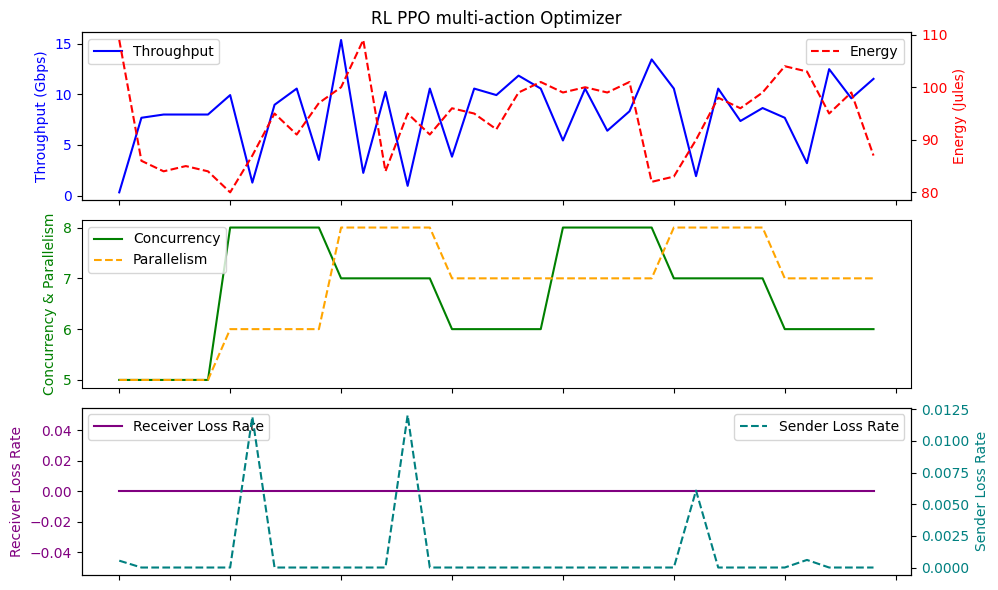

Average Throughput: 8.000000000000002
Total Energy: 3295.0
Total loss rate: 0.031147883540049805
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:01:36.531570432    7.771429       0.0   2.971429   
min       2024-02-18 05:36:28.339321    0.960000       0.0  -1.000000   
25%    2024-02-19 05:48:06.429282048    4.000000       0.0   2.000000   
50%    2024-02-19 13:05:39.104641024    8.000000       0.0   3.000000   
75%    2024-02-19 13:11:57.385806080   10.080000       0.0   5.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    3.960898       0.0   1.688816   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.097143   94.685714   0.001916  
min    32.500000   46.000000   0.000000  
25%    32.650000   93.500000   0.000000  
50%    32.900000   98.000000   0.00

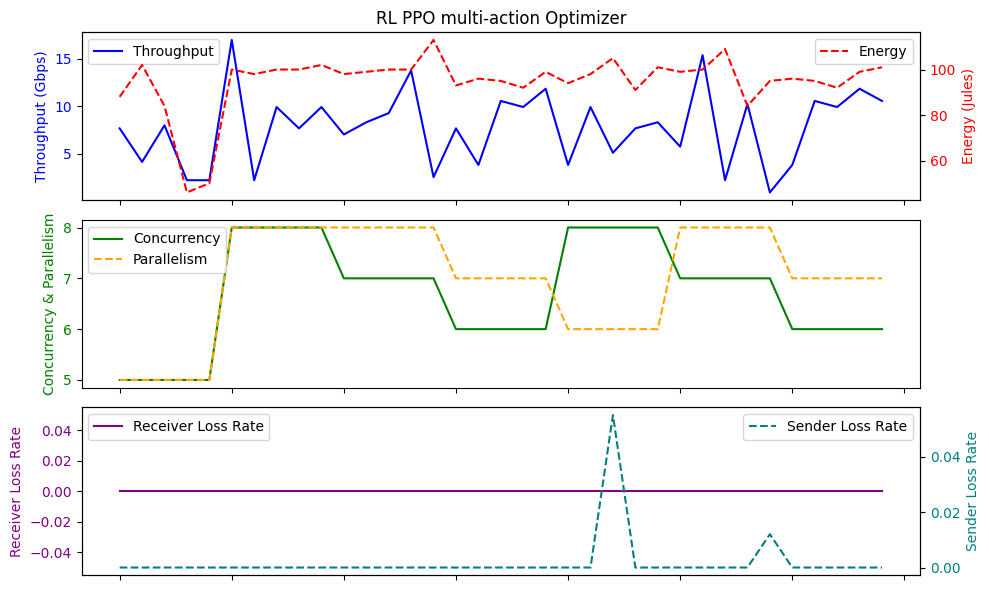

Average Throughput: 7.771428571428571
Total Energy: 3314.0
Total loss rate: 0.06704322308464873
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:24:18.766628096    8.018286       0.0   3.200000   
min       2024-02-19 05:25:25.602577    0.960000       0.0  -1.000000   
25%    2024-02-19 10:25:05.993165056    6.240000       0.0   2.500000   
50%    2024-02-19 13:05:41.105501952    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416   10.560000       0.0   4.500000   
max       2024-02-19 17:04:22.551735   15.360000       0.0   5.000000   
std                              NaN    3.230856       0.0   1.641377   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.320000   93.857143   0.002828  
min    32.500000   80.000000   0.000000  
25%    32.700000   89.000000   0.000000  
50%    33.000000   95.000000   0.000

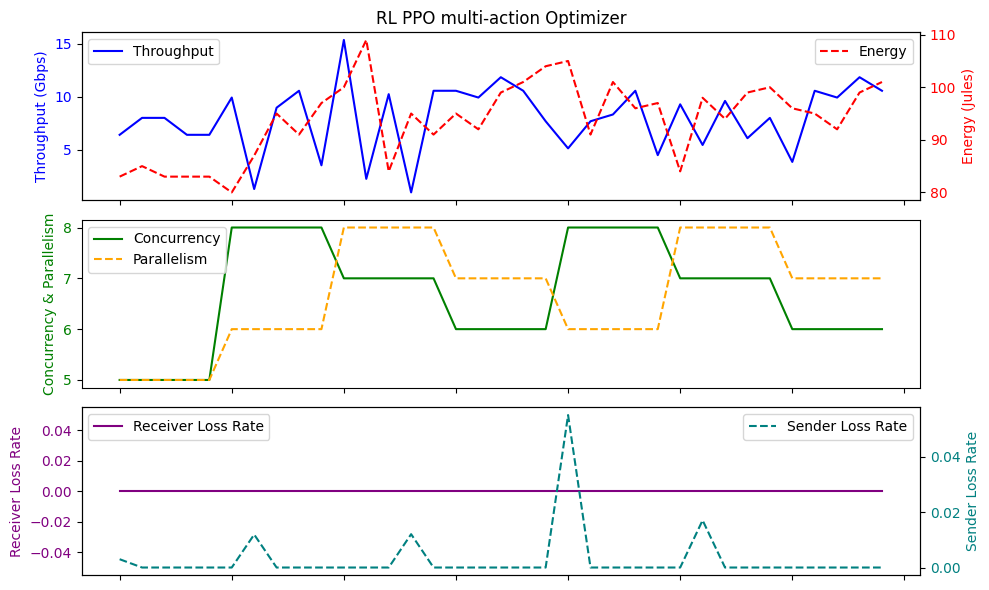

Average Throughput: 8.018285714285714
Total Energy: 3285.0
Total loss rate: 0.0989805502677072
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:12:52.403398144    8.118857       0.0   3.085714   
min       2024-02-18 09:53:47.453747    0.320000       0.0   0.000000   
25%    2024-02-19 10:31:51.974809856    3.040000       0.0   1.000000   
50%    2024-02-19 13:11:57.385806080    9.920000       0.0   4.000000   
75%    2024-02-19 17:14:15.175938048   11.040000       0.0   4.500000   
max       2024-02-19 17:34:54.087974   15.360000       0.0   5.000000   
std                              NaN    4.567934       0.0   1.771862   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.537143   96.200000   0.000755  
min    32.500000   82.000000   0.000000  
25%    32.800000   92.000000   0.000000  
50%    33.100000   98.000000   0.0000

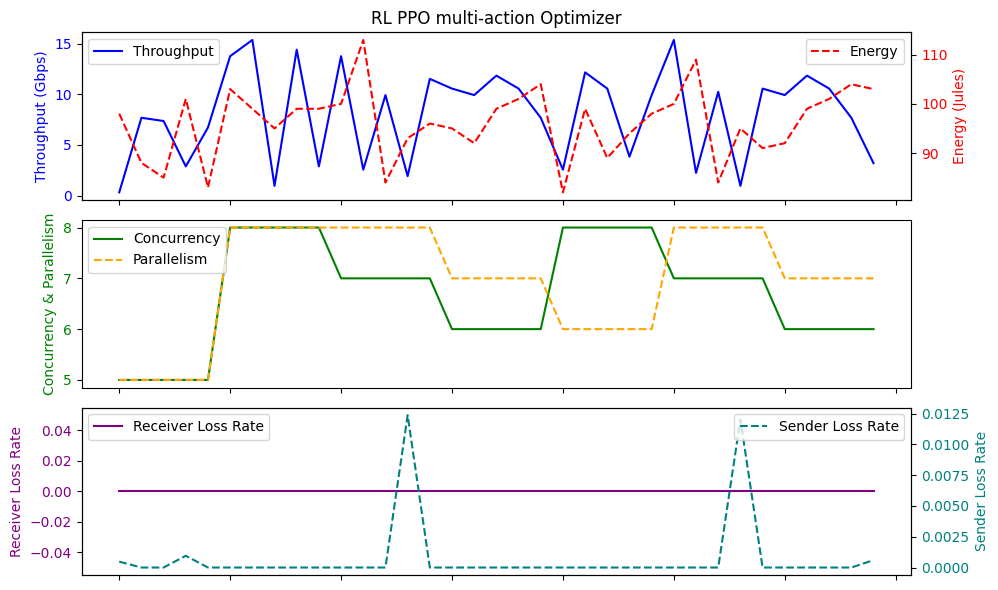

Average Throughput: 8.118857142857143
Total Energy: 3367.0
Total loss rate: 0.026436622005513447
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:14:25.150225408    7.990857       0.0   3.257143   
min       2024-02-19 05:39:07.687462    2.560000       0.0   1.000000   
25%    2024-02-19 05:41:22.756942848    6.080000       0.0   2.500000   
50%    2024-02-19 13:11:54.358995968    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416    9.920000       0.0   4.000000   
max       2024-02-19 17:04:20.554680   11.840000       0.0   5.000000   
std                              NaN    2.486577       0.0   1.268228   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.774286   93.142857   0.000974  
min    32.500000   84.000000   0.000000  
25%    32.900000   87.500000   0.000000  
50%    33.600000   94.000000   0.00

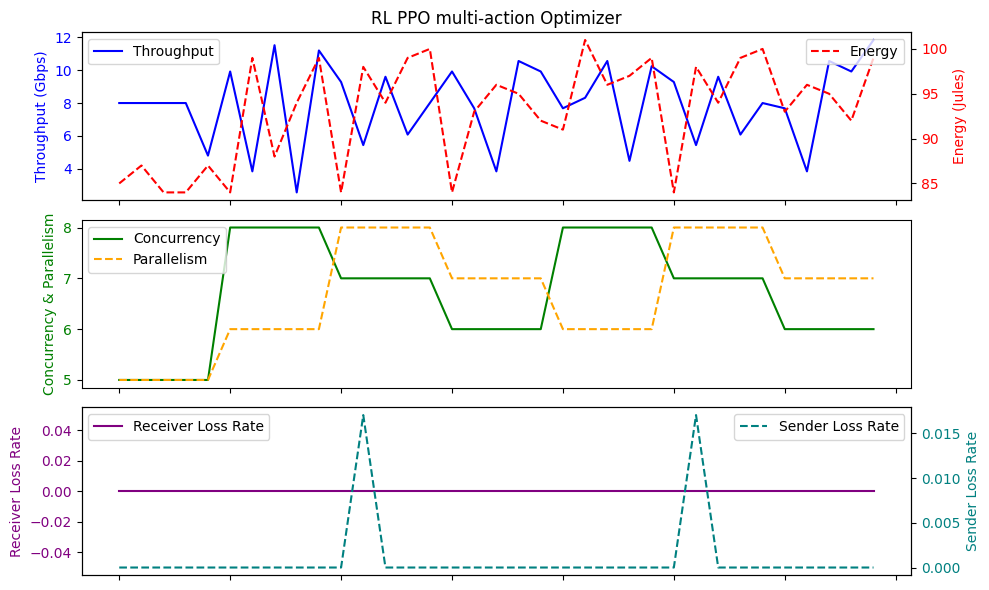

Average Throughput: 7.990857142857143
Total Energy: 3260.0
Total loss rate: 0.03408623911543263
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:07:22.254368768    7.963429       0.0   3.028571   
min       2024-02-18 09:53:51.454697    0.960000       0.0   0.000000   
25%    2024-02-19 13:05:42.607046400    5.280000       0.0   2.000000   
50%    2024-02-19 13:11:55.349267968    8.000000       0.0   3.000000   
75%    2024-02-19 16:52:05.022334720   10.080000       0.0   4.000000   
max       2024-02-19 17:34:48.081663   15.360000       0.0   5.000000   
std                              NaN    3.389914       0.0   1.271537   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.100000   93.542857   0.000728  
min    32.500000   53.000000   0.000000  
25%    32.700000   92.000000   0.000000  
50%    32.900000   96.000000   0.000

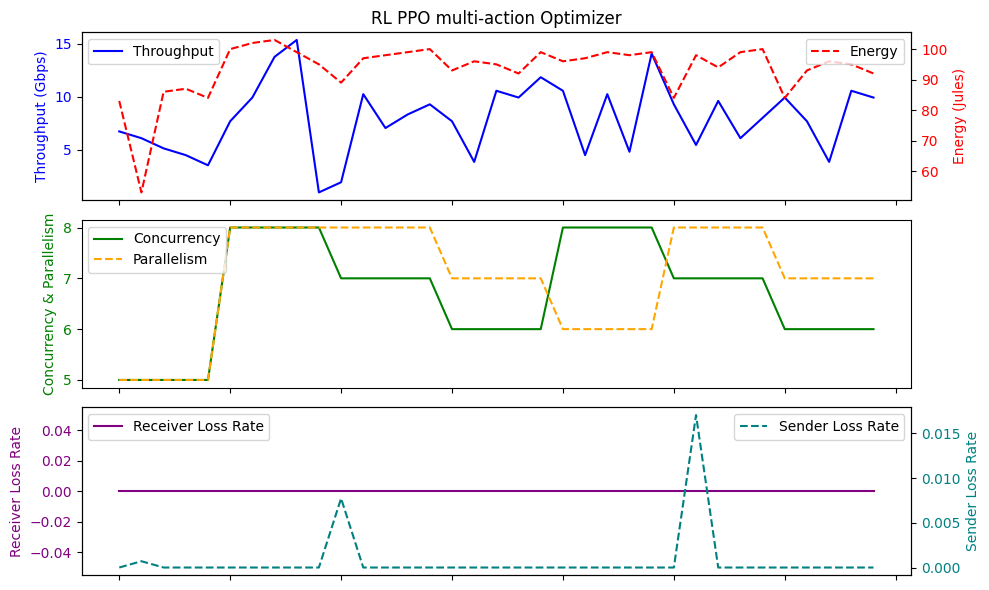

Average Throughput: 7.963428571428572
Total Energy: 3274.0
Total loss rate: 0.025471289867714814
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:33:04.470699264    7.817143       0.0   3.142857   
min       2024-02-19 10:25:02.487378    1.280000       0.0   0.000000   
25%    2024-02-19 10:31:52.981631488    5.600000       0.0   2.000000   
50%    2024-02-19 13:11:53.354853120    8.640000       0.0   3.000000   
75%    2024-02-19 17:02:10.919774464    9.920000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    3.017163       0.0   1.517406   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.280000   92.285714   0.001331  
min    32.500000   80.000000   0.000000  
25%    32.900000   87.000000   0.000000  
50%    33.100000   93.000000   0.00

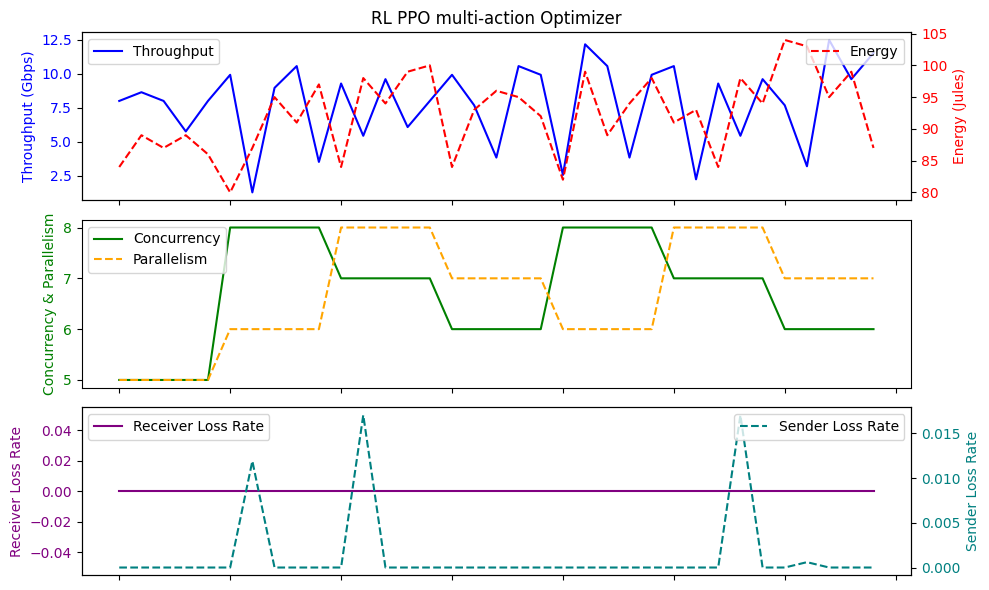

Average Throughput: 7.817142857142856
Total Energy: 3230.0
Total loss rate: 0.046586682126918785
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:51:28.315768576    7.689143       0.0   3.057143   
min       2024-02-19 05:41:23.257360    0.640000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    4.960000       0.0   2.000000   
50%    2024-02-19 10:35:23.574913024    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   10.400000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.859157       0.0   1.696759   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.725714   94.057143   0.001063  
min    32.500000   80.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.000000   95.000000   0.00

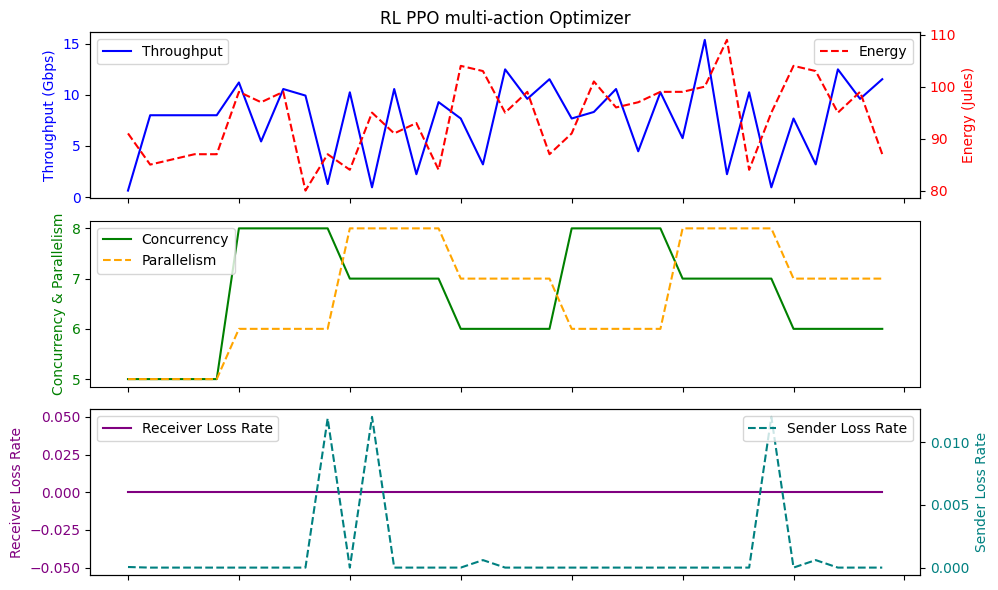

Average Throughput: 7.6891428571428575
Total Energy: 3292.0
Total loss rate: 0.03720813124465522
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:29:52.818955520    7.835429       0.0   3.085714   
min       2024-02-19 06:29:48.822753    0.640000       0.0  -1.000000   
25%    2024-02-19 10:25:05.993165056    6.240000       0.0   2.500000   
50%    2024-02-19 13:05:41.105501952    8.960000       0.0   3.000000   
75%    2024-02-19 15:07:03.399310592   10.080000       0.0   4.000000   
max       2024-02-19 17:04:22.551735   11.840000       0.0   7.000000   
std                              NaN    3.147208       0.0   1.755184   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.577143   93.771429   0.002743  
min    32.500000   80.000000   0.000000  
25%    32.700000   91.000000   0.000000  
50%    33.000000   95.000000   0.00

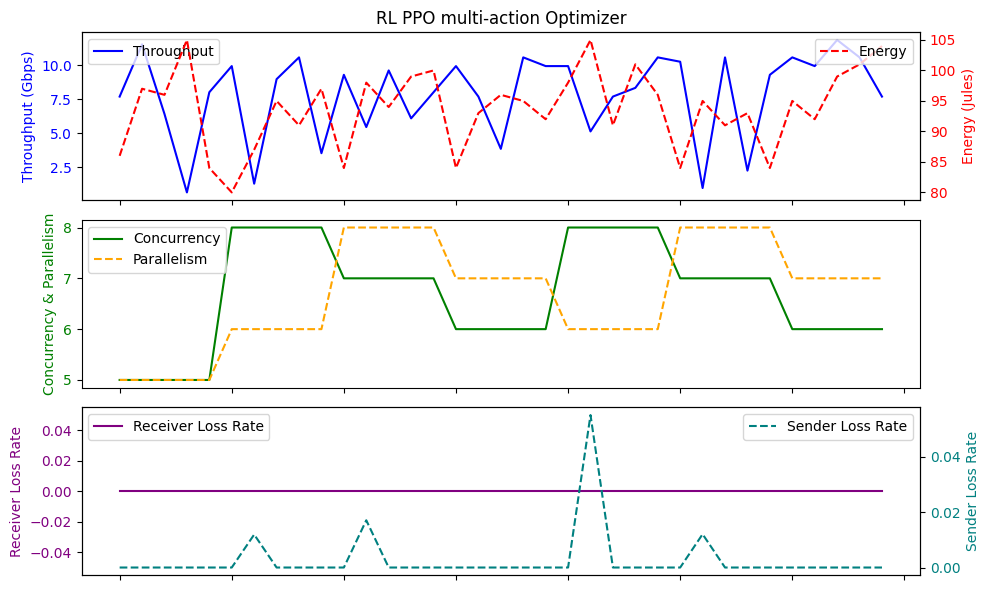

Average Throughput: 7.835428571428571
Total Energy: 3282.0
Total loss rate: 0.09598793827855542
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:35:26.327531520    8.045714       0.0   3.142857   
min       2024-02-19 05:41:19.255238    0.960000       0.0  -1.000000   
25%    2024-02-19 10:35:22.075270144    5.760000       0.0   2.000000   
50%    2024-02-19 13:05:40.103326976    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:10.919774464   10.400000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.350928       0.0   1.629559   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.094286   93.971429   0.002420  
min    32.500000   72.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.000000   95.000000   0.000

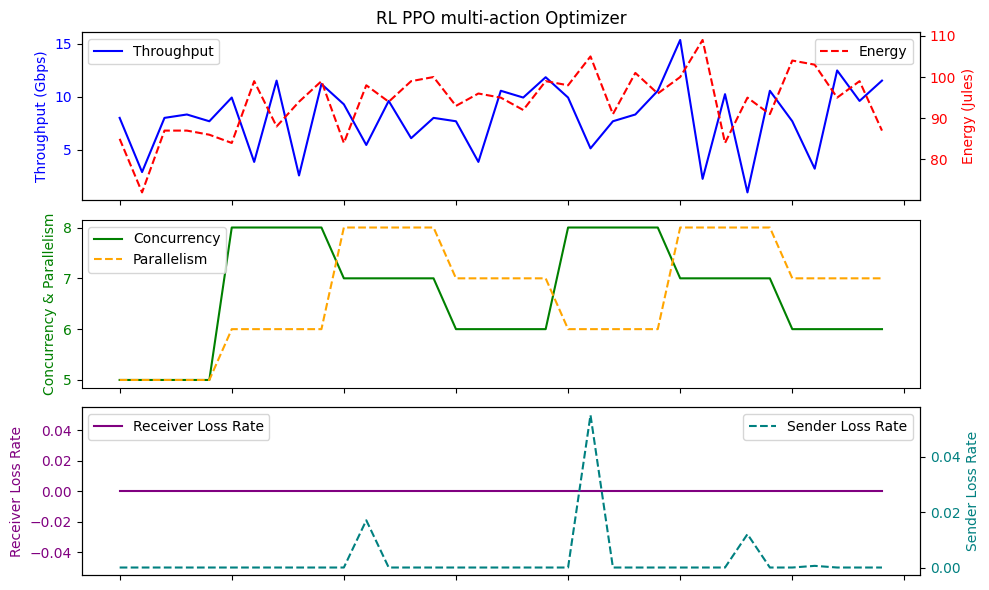

Average Throughput: 8.045714285714286
Total Energy: 3289.0
Total loss rate: 0.08468519001766081
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:44:33.123749888    7.817143       0.0   3.142857   
min       2024-02-19 05:41:20.260860    0.960000       0.0   0.000000   
25%    2024-02-19 05:46:16.094843136    5.120000       0.0   2.000000   
50%    2024-02-19 13:05:42.108088064    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416   10.560000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   14.080000       0.0   5.000000   
std                              NaN    3.561920       0.0   1.611409   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.574286   93.771429   0.001192  
min    32.500000   84.000000   0.000000  
25%    32.850000   87.500000   0.000000  
50%    33.100000   95.000000   0.000

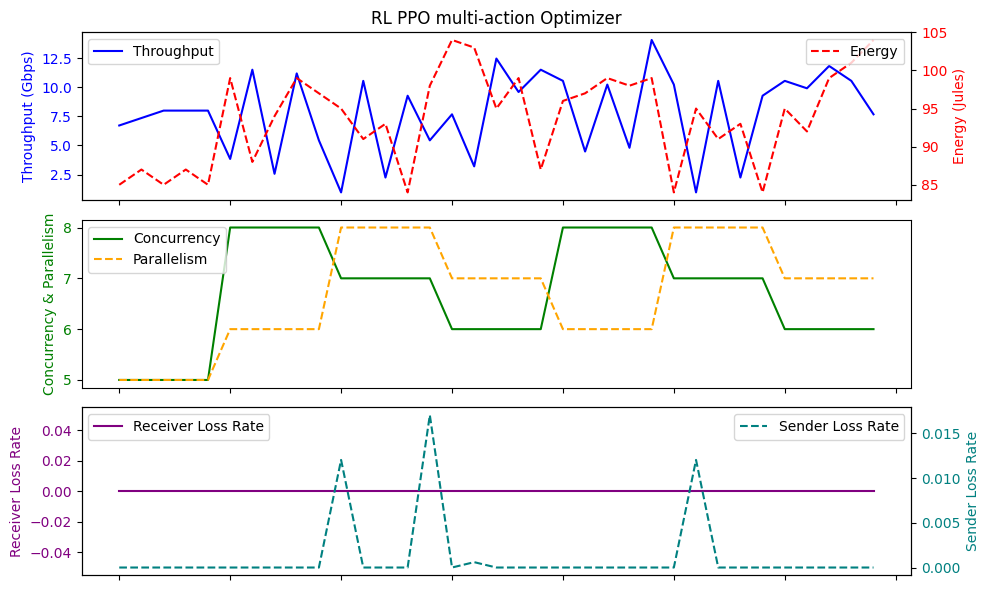

Average Throughput: 7.817142857142858
Total Energy: 3282.0
Total loss rate: 0.04170363395988336
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:54:21.813406464    7.945143       0.0   3.114286   
min       2024-02-18 12:03:26.827282    0.960000       0.0  -1.000000   
25%    2024-02-19 05:41:24.758566400    5.280000       0.0   2.000000   
50%    2024-02-19 10:35:22.579120128    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   10.720000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   7.000000   
std                              NaN    3.919557       0.0   1.794951   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.122857   95.657143   0.002293  
min    32.500000   77.000000   0.000000  
25%    32.800000   91.000000   0.000000  
50%    33.000000   96.000000   0.000

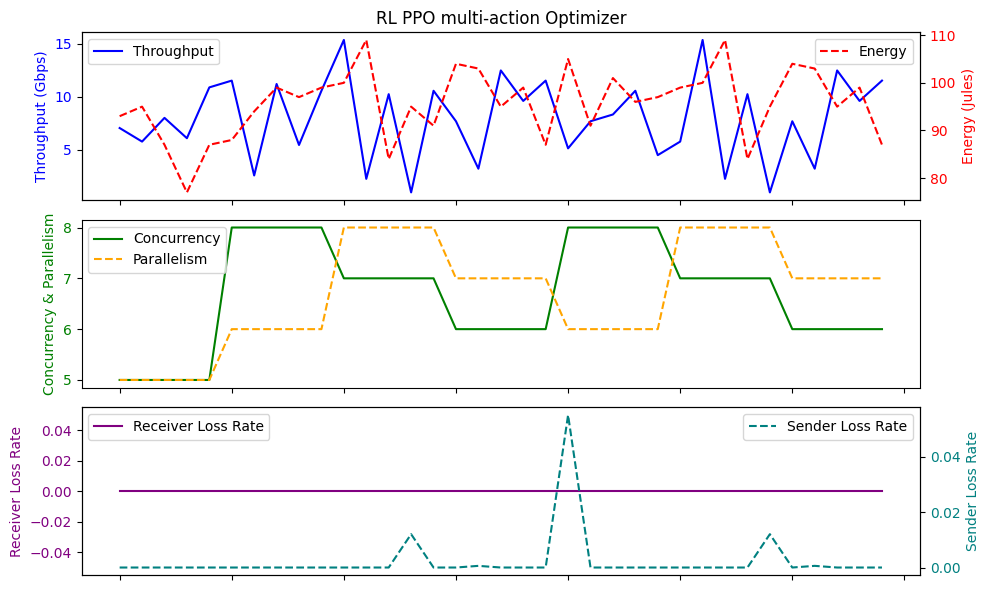

Average Throughput: 7.945142857142859
Total Energy: 3348.0
Total loss rate: 0.0802717513486759
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:42:54.871037184    8.210286       0.0   3.371429   
min       2024-02-19 05:41:23.257360    1.280000       0.0   0.000000   
25%    2024-02-19 13:05:43.606345472    5.440000       0.0   2.000000   
50%    2024-02-19 13:11:57.385806080    9.280000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416   10.560000       0.0   5.000000   
max       2024-02-19 17:04:21.558569   14.080000       0.0   6.000000   
std                              NaN    3.018817       0.0   1.476994   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.260000   93.400000   0.001314  
min    32.500000   80.000000   0.000000  
25%    32.700000   90.000000   0.000000  
50%    33.000000   95.000000   0.0000

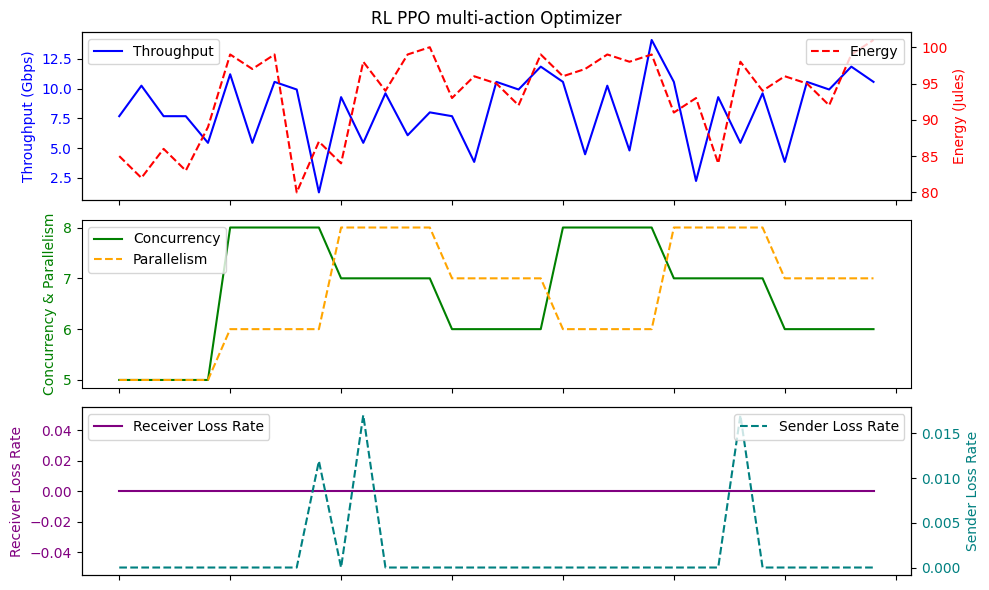

Average Throughput: 8.210285714285714
Total Energy: 3269.0
Total loss rate: 0.04598783475162301
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:25:59.182753792    7.917714       0.0   3.200000   
min       2024-02-19 05:26:38.008479    2.240000       0.0   1.000000   
25%    2024-02-19 05:41:22.756942848    5.440000       0.0   2.000000   
50%    2024-02-19 13:05:45.109462016    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920   10.400000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    3.059841       0.0   1.471294   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.505714   93.057143   0.000991  
min    32.500000   56.000000   0.000000  
25%    32.900000   87.500000   0.000000  
50%    33.600000   95.000000   0.000

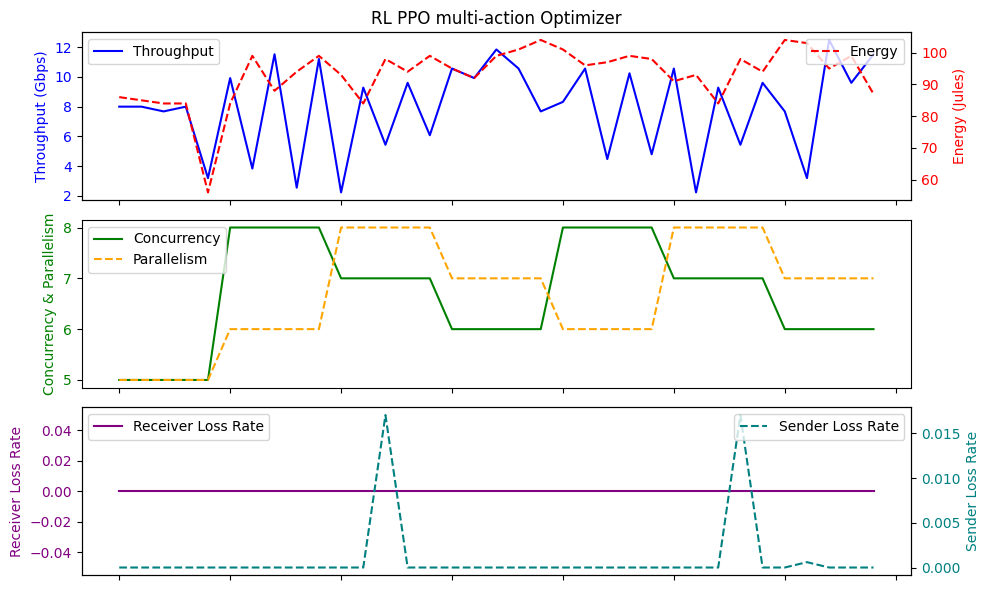

Average Throughput: 7.917714285714286
Total Energy: 3257.0
Total loss rate: 0.034685086490728406
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:33:24.216174592    8.009143       0.0   3.200000   
min       2024-02-18 02:37:49.648835    0.960000       0.0   0.000000   
25%    2024-02-19 10:35:19.074384128    5.760000       0.0   2.500000   
50%    2024-02-19 13:11:56.355003904    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:22.055152128   10.400000       0.0   4.000000   
max       2024-02-19 17:23:51.434219   15.360000       0.0   5.000000   
std                              NaN    3.282224       0.0   1.389033   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.354286   93.428571   0.000884  
min    32.500000   46.000000   0.000000  
25%    32.800000   88.000000   0.000000  
50%    33.100000   96.000000   0.00

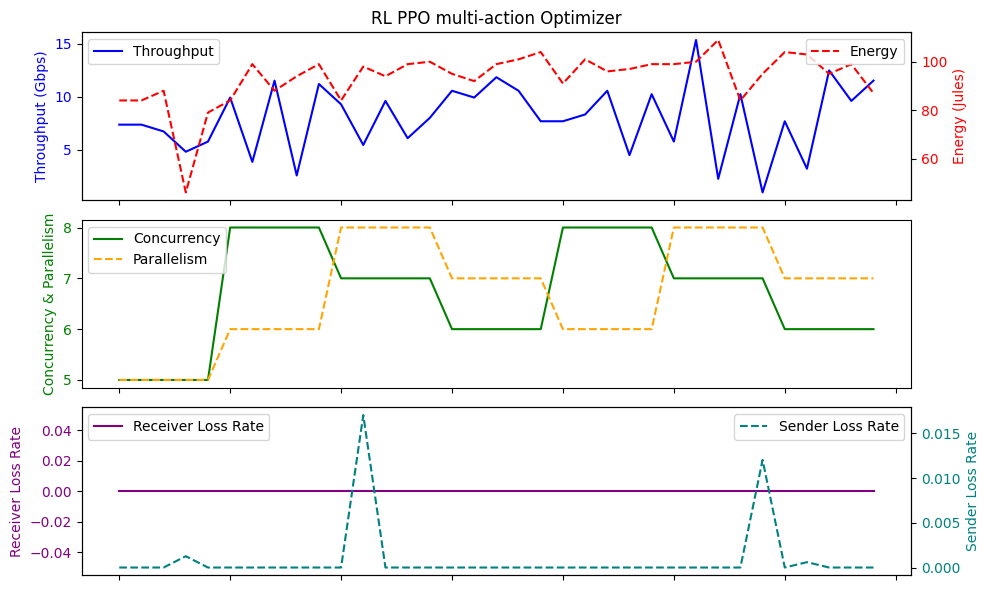

Average Throughput: 8.009142857142857
Total Energy: 3270.0
Total loss rate: 0.03093804579215234
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:43:12.718716160    8.201143       0.0   3.228571   
min       2024-02-19 05:30:21.087835    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    5.920000       0.0   2.000000   
50%    2024-02-19 13:08:42.474106112    9.920000       0.0   3.000000   
75%    2024-02-19 15:34:37.231425024   10.560000       0.0   5.000000   
max       2024-02-19 17:05:34.987932   15.360000       0.0   5.000000   
std                              NaN    3.637885       0.0   1.591997   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.711429   94.314286   0.001013  
min    32.500000   81.000000   0.000000  
25%    32.750000   87.500000   0.000000  
50%    33.100000   95.000000   0.000

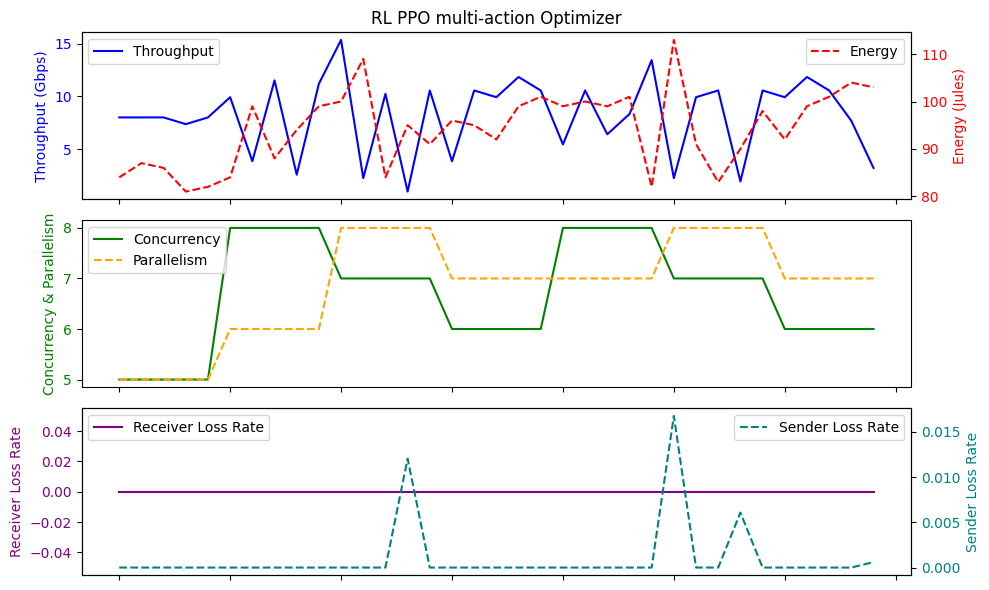

Average Throughput: 8.201142857142857
Total Energy: 3301.0
Total loss rate: 0.03545705727702551
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:51:18.256285184    7.817143       0.0   3.142857   
min       2024-02-19 05:31:37.455807    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    5.600000       0.0   2.000000   
50%    2024-02-19 13:05:42.108088064    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:10.919774464   10.240000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.370771       0.0   1.437785   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.531429   93.371429   0.001006  
min    32.500000   57.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.100000   95.000000   0.000

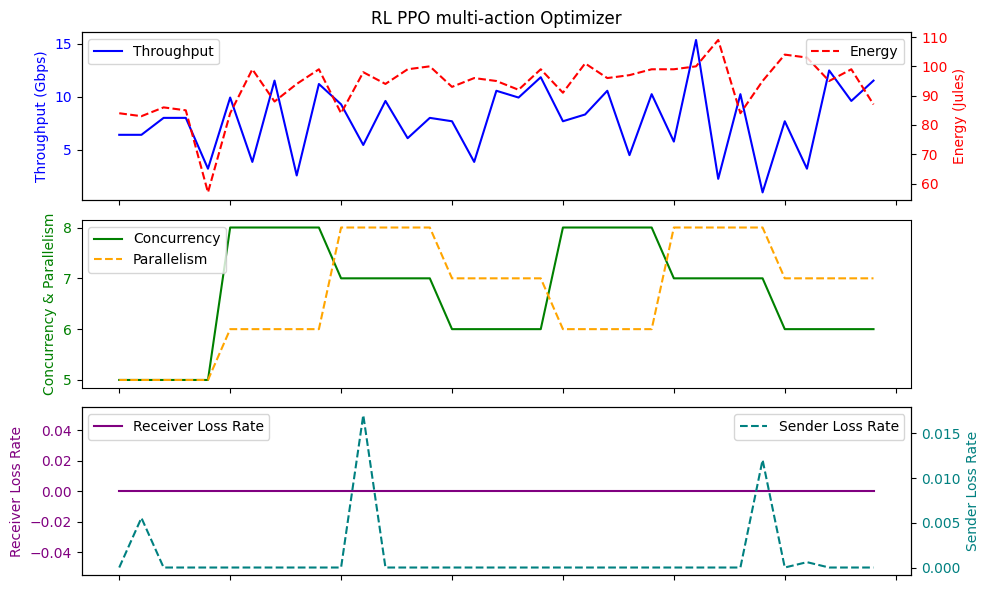

Average Throughput: 7.817142857142856
Total Energy: 3268.0
Total loss rate: 0.035222381001405775
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:18:37.341381888    7.908571       0.0   3.142857   
min       2024-02-19 05:36:38.090671    0.960000       0.0  -1.000000   
25%    2024-02-19 05:41:24.758566400    5.760000       0.0   2.000000   
50%    2024-02-19 13:05:41.105501952    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:12.922888960   10.240000       0.0   5.000000   
max       2024-02-19 17:04:25.555316   12.480000       0.0   5.000000   
std                              NaN    2.923150       0.0   1.682835   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.351429   94.857143   0.002907  
min    32.500000   84.000000   0.000000  
25%    32.900000   91.000000   0.000000  
50%    33.000000   95.000000   0.00

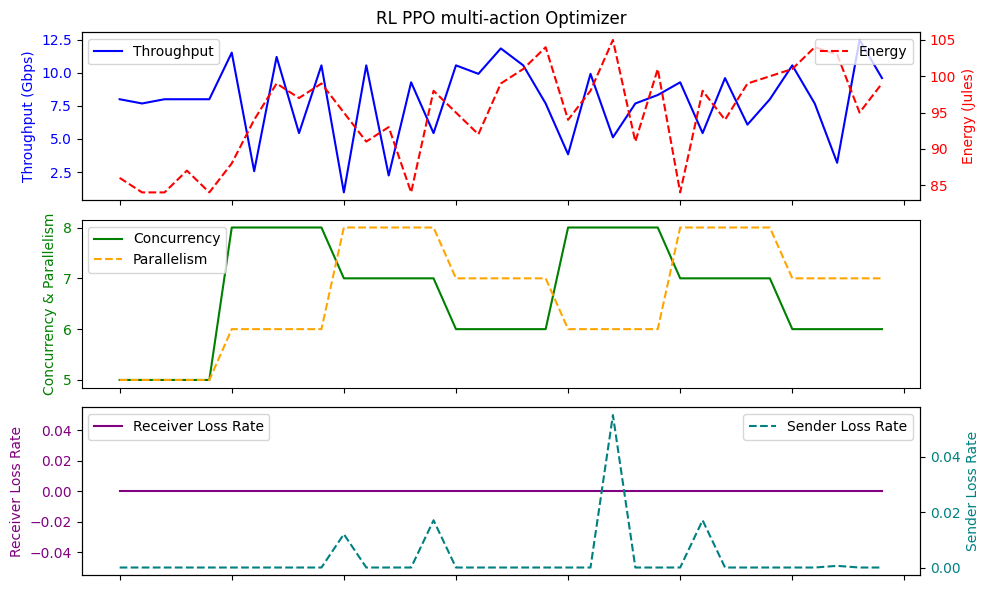

Average Throughput: 7.908571428571429
Total Energy: 3320.0
Total loss rate: 0.10172830957537712
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:55:34.996470528    7.890286       0.0   3.171429   
min       2024-02-19 05:27:53.457496    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    5.120000       0.0   2.000000   
50%    2024-02-19 10:35:21.571419904    8.000000       0.0   3.000000   
75%    2024-02-19 13:11:56.355003904   10.400000       0.0   4.000000   
max       2024-02-19 17:04:20.554680   15.360000       0.0   5.000000   
std                              NaN    3.411322       0.0   1.464998   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.451429   92.285714   0.000831  
min    32.500000   71.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.100000   94.000000   0.000

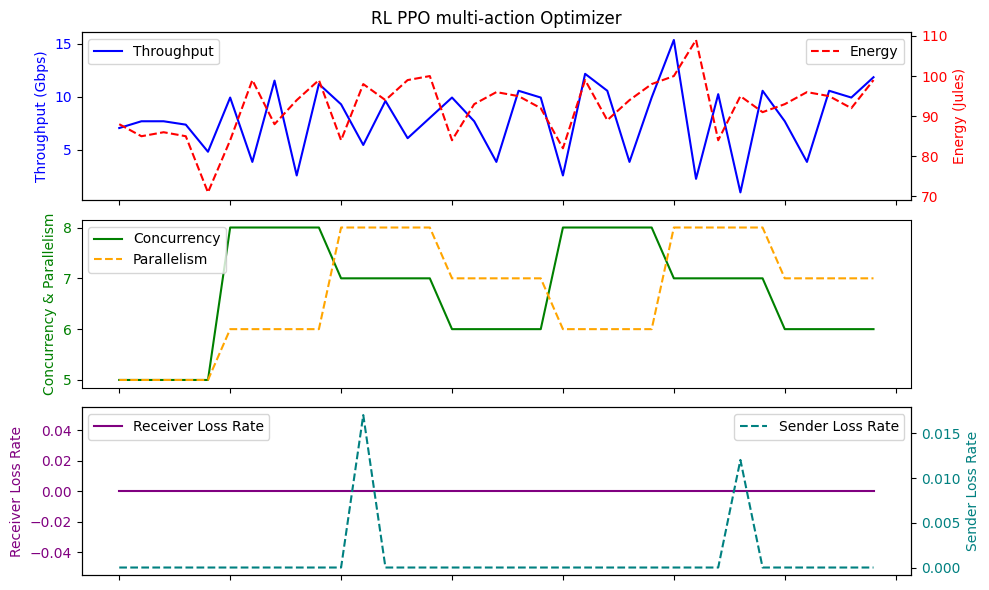

Average Throughput: 7.890285714285714
Total Energy: 3230.0
Total loss rate: 0.02907395307115195
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:31:17.262551808    8.210286       0.0   3.400000   
min       2024-02-19 05:30:49.099644    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:24.758566400    5.600000       0.0   2.000000   
50%    2024-02-19 13:05:44.106685952    8.000000       0.0   4.000000   
75%    2024-02-19 13:11:57.385806080   10.560000       0.0   5.000000   
max       2024-02-19 17:04:21.558569   15.360000       0.0   5.000000   
std                              NaN    3.387400       0.0   1.479268   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.348571   94.800000   0.000831  
min    32.500000   83.000000   0.000000  
25%    32.700000   92.000000   0.000000  
50%    33.000000   96.000000   0.000

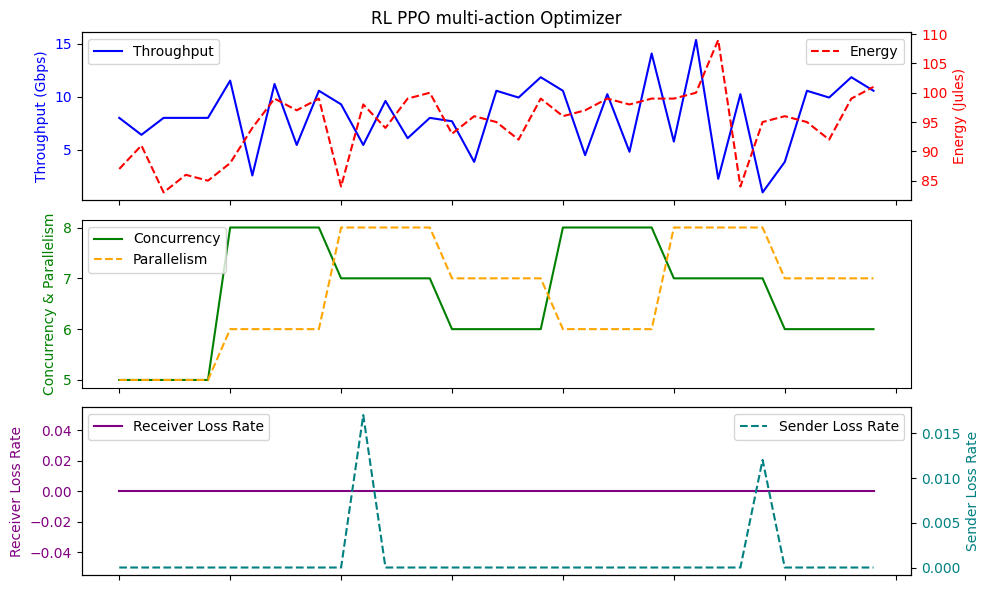

Average Throughput: 8.210285714285714
Total Energy: 3318.0
Total loss rate: 0.02907395307115195
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:11:34.100566016    7.835429       0.0   3.114286   
min       2024-02-19 05:41:23.257360    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    5.120000       0.0   2.000000   
50%    2024-02-19 10:35:23.574913024    9.280000       0.0   3.000000   
75%    2024-02-19 17:02:12.922888960   10.560000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   6.000000   
std                              NaN    3.419636       0.0   1.548651   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.520000   92.000000   0.001193  
min    32.500000   60.000000   0.000000  
25%    32.900000   87.000000   0.000000  
50%    33.100000   95.000000   0.000

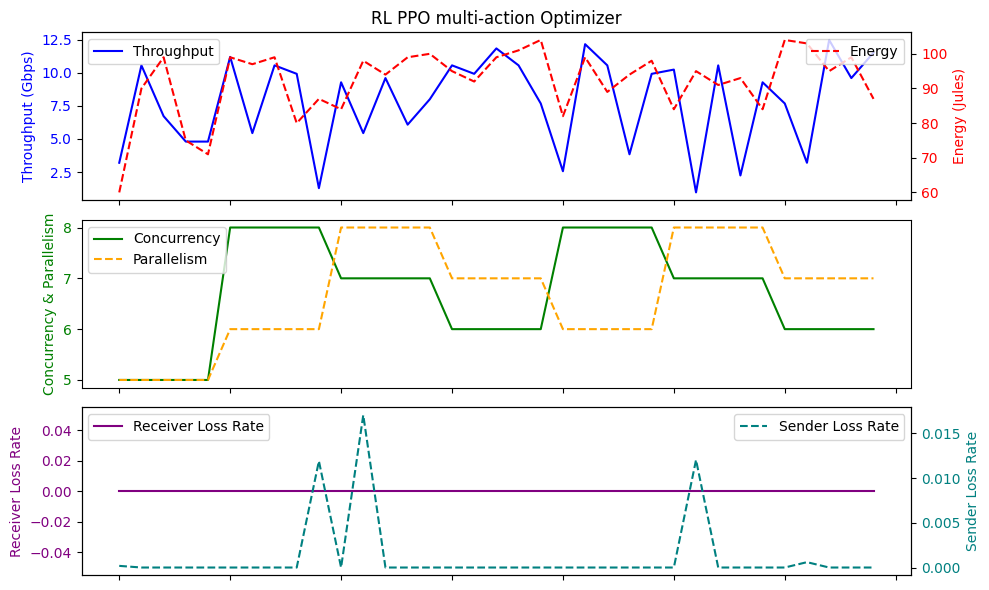

Average Throughput: 7.83542857142857
Total Energy: 3220.0
Total loss rate: 0.04175845931743279
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:45:20.904629248    8.192000       0.0   3.342857   
min       2024-02-19 05:41:23.257360    0.640000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    6.240000       0.0   2.500000   
50%    2024-02-19 13:11:55.349267968    9.280000       0.0   3.000000   
75%    2024-02-19 17:02:10.919774464   10.560000       0.0   4.500000   
max       2024-02-19 17:04:22.551735   11.840000       0.0   7.000000   
std                              NaN    3.018076       0.0   1.589355   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.691429   94.942857   0.001314  
min    32.500000   80.000000   0.000000  
25%    32.700000   92.000000   0.000000  
50%    33.100000   96.000000   0.0000

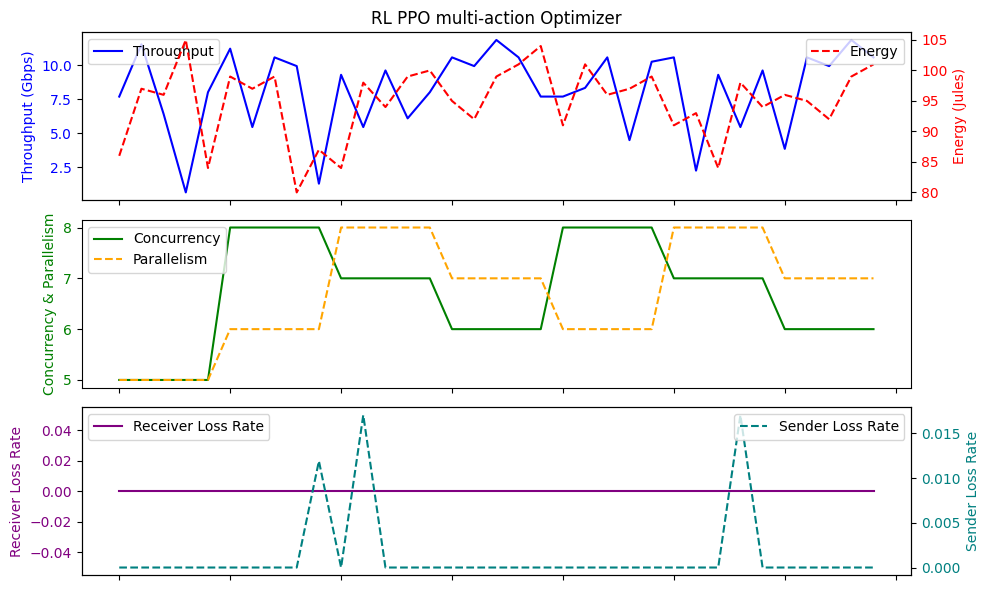

Average Throughput: 8.192
Total Energy: 3323.0
Total loss rate: 0.04598783475162301
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:36:01.285309952    7.488000       0.0   2.971429   
min       2024-02-19 05:41:19.255238    0.320000       0.0  -1.000000   
25%    2024-02-19 09:58:15.546761472    4.800000       0.0   1.500000   
50%    2024-02-19 13:05:41.105501952    7.680000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920   10.400000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    3.429159       0.0   1.740279   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.222857   94.285714   0.002420  
min    32.500000   82.000000   0.000000  
25%    32.800000   89.500000   0.000000  
50%    33.100000   95.000000   0.000000  
75%   

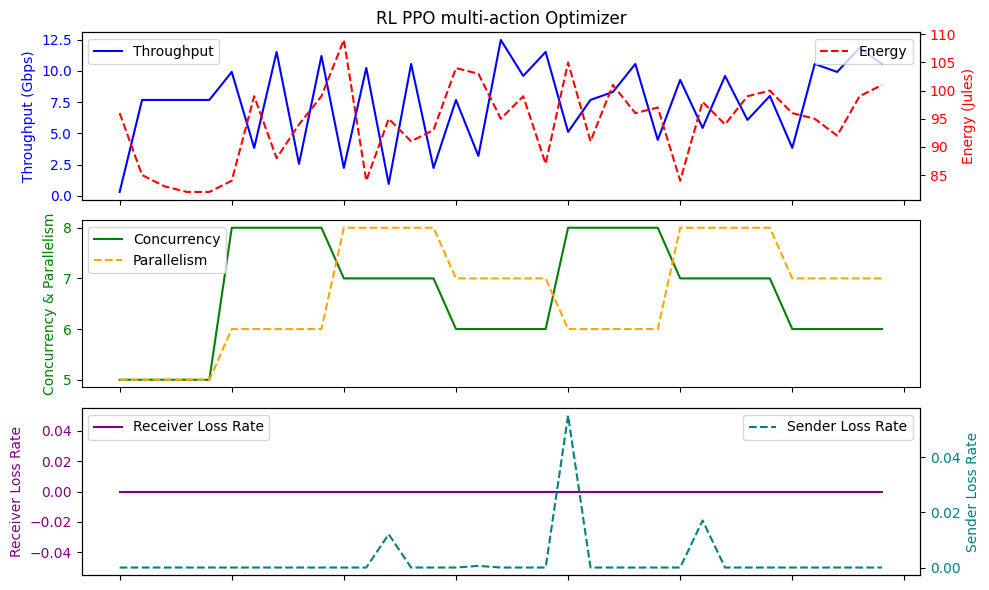

Average Throughput: 7.4879999999999995
Total Energy: 3300.0
Total loss rate: 0.08468519001766082
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:38:24.830237440    7.570286       0.0   2.942857   
min       2024-02-19 10:25:02.487378    0.960000       0.0  -1.000000   
25%    2024-02-19 10:35:19.074384128    4.640000       0.0   2.000000   
50%    2024-02-19 11:42:35.235727104    8.320000       0.0   3.000000   
75%    2024-02-19 13:11:56.355003904    9.920000       0.0   4.000000   
max       2024-02-19 17:04:20.554680   15.360000       0.0   5.000000   
std                              NaN    3.463889       0.0   1.643935   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.408571   93.742857   0.002743  
min    32.500000   80.000000   0.000000  
25%    32.800000   91.000000   0.000000  
50%    33.100000   95.000000   0.00

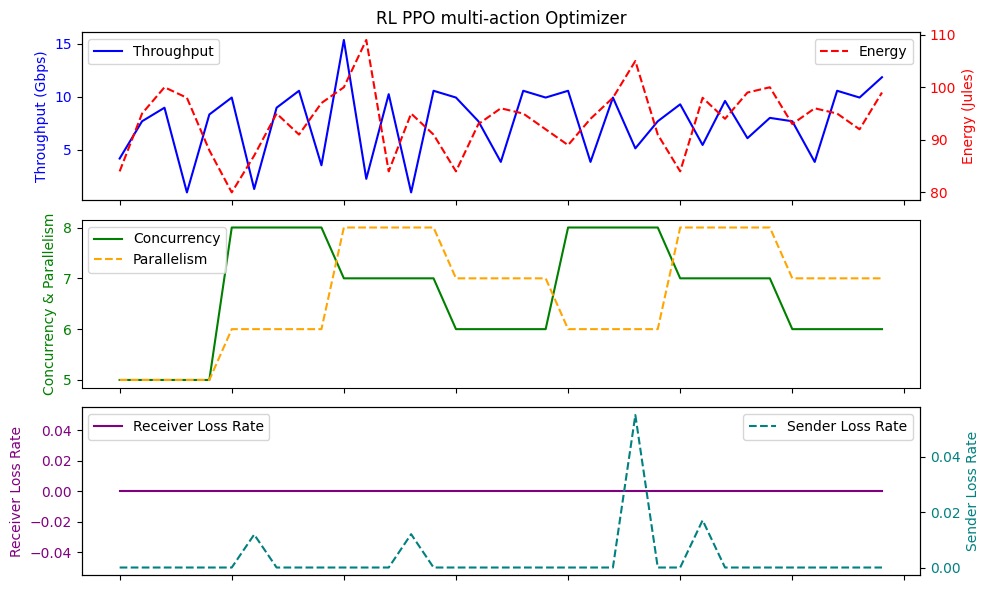

Average Throughput: 7.570285714285713
Total Energy: 3281.0
Total loss rate: 0.09598793827855542
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 07:56:44.079331840    7.256000       0.0   2.725000   
min       2024-02-18 07:18:33.442351    0.960000       0.0  -1.000000   
25%    2024-02-19 09:19:13.677898752    3.840000       0.0   1.000000   
50%    2024-02-19 10:35:22.075270144    8.480000       0.0   3.000000   
75%    2024-02-19 13:11:53.605888768   10.320000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   12.160000       0.0   5.000000   
std                              NaN    3.675368       0.0   1.797256   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   34.760000   94.150000   0.003432  
min    32.500000   84.000000   0.000000  
25%    32.900000   90.500000   0.000000  
50%    33.450000   94.000000   0.000

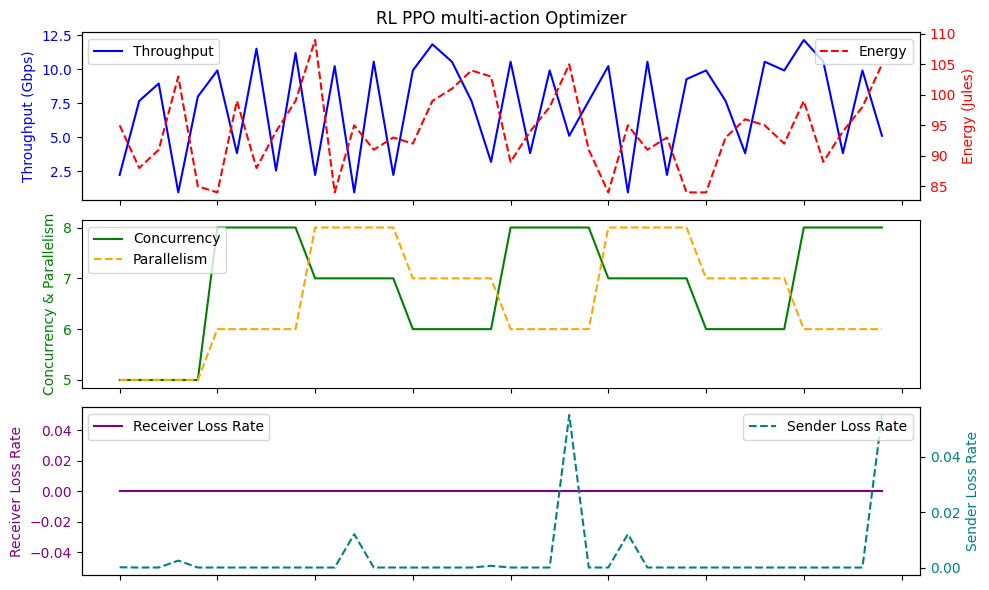

Average Throughput: 7.256
Total Energy: 3766.0
Total loss rate: 0.13727004744733703
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:16:01.116802560    8.265143       0.0   3.285714   
min       2024-02-19 04:44:43.243756    1.280000       0.0  -1.000000   
25%    2024-02-19 10:25:03.992217344    7.680000       0.0   3.000000   
50%    2024-02-19 17:02:09.412815104    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:13.423297024    9.920000       0.0   5.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    2.412811       0.0   1.563770   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.408571   94.257143   0.002903  
min    32.500000   80.000000   0.000000  
25%    32.850000   87.000000   0.000000  
50%    33.000000   96.000000   0.000000  
75%   

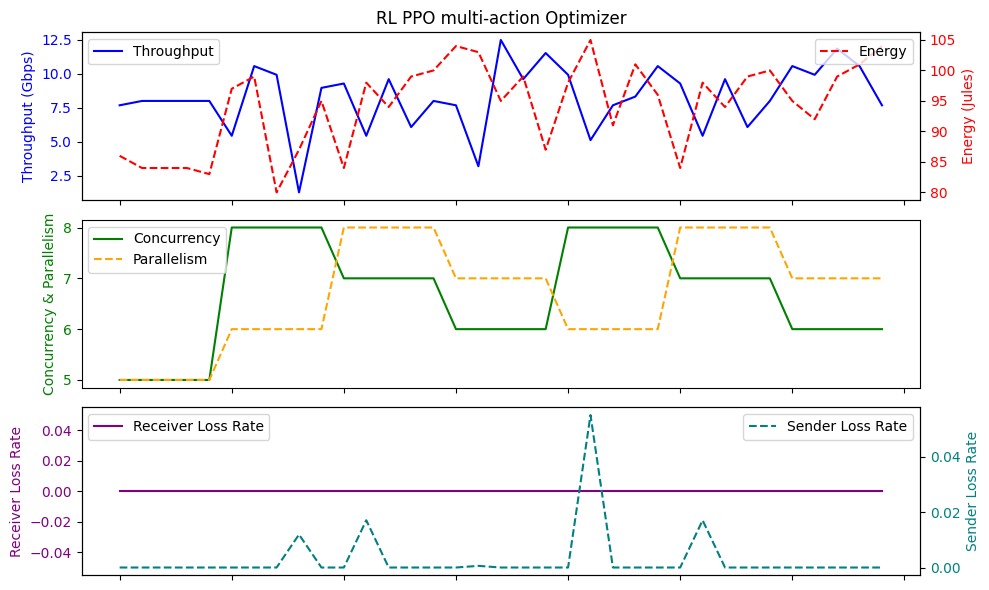

Average Throughput: 8.265142857142857
Total Energy: 3299.0
Total loss rate: 0.10159907169813188
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:51:25.274419968    7.817143       0.0   3.228571   
min       2024-02-19 05:41:23.257360    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    5.600000       0.0   2.000000   
50%    2024-02-19 13:05:41.105501952    8.000000       0.0   3.000000   
75%    2024-02-19 15:07:03.399310592   10.240000       0.0   5.000000   
max       2024-02-19 17:04:23.552343   15.360000       0.0   5.000000   
std                              NaN    3.344759       0.0   1.573414   

             RTT     Energy   SenderLR  
count  35.000000   35.00000  35.000000  
mean   34.920000   94.40000   0.001188  
min    32.500000   80.00000   0.000000  
25%    32.700000   89.00000   0.000000  
50%    33.100000   96.00000   0.000000  


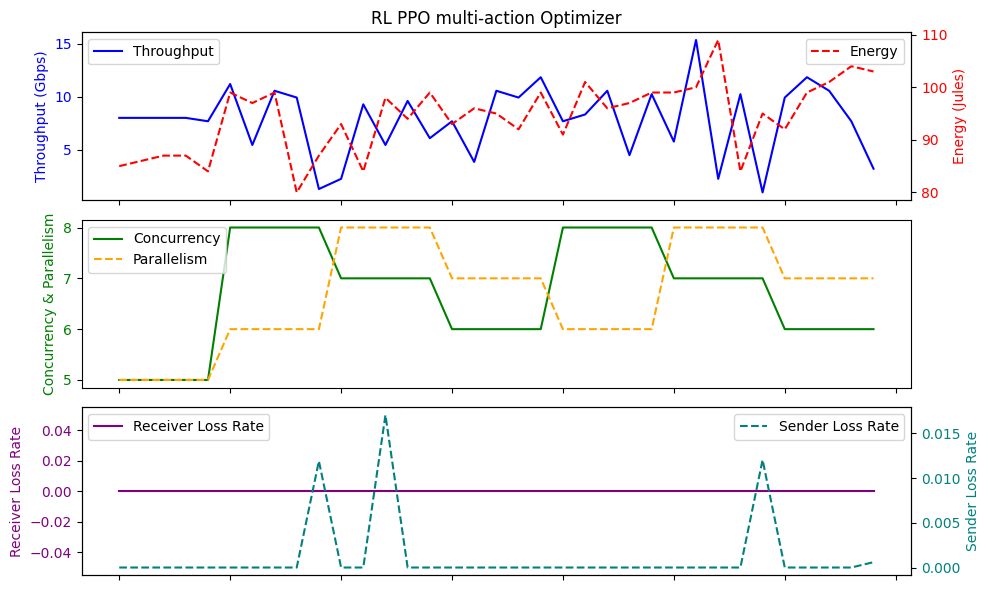

Average Throughput: 7.817142857142856
Total Energy: 3304.0
Total loss rate: 0.0415743960826381
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:21:37.486546432    7.890286       0.0   3.085714   
min       2024-02-18 05:36:26.336761    2.560000       0.0  -1.000000   
25%    2024-02-19 05:41:22.756942848    5.760000       0.0   2.000000   
50%    2024-02-19 17:02:09.412815104    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:13.423297024    9.920000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   11.840000       0.0   5.000000   
std                              NaN    2.707451       0.0   1.578745   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.862857   95.314286   0.002580  
min    32.500000   84.000000   0.000000  
25%    32.900000   90.000000   0.000000  
50%    33.600000   98.000000   0.0000

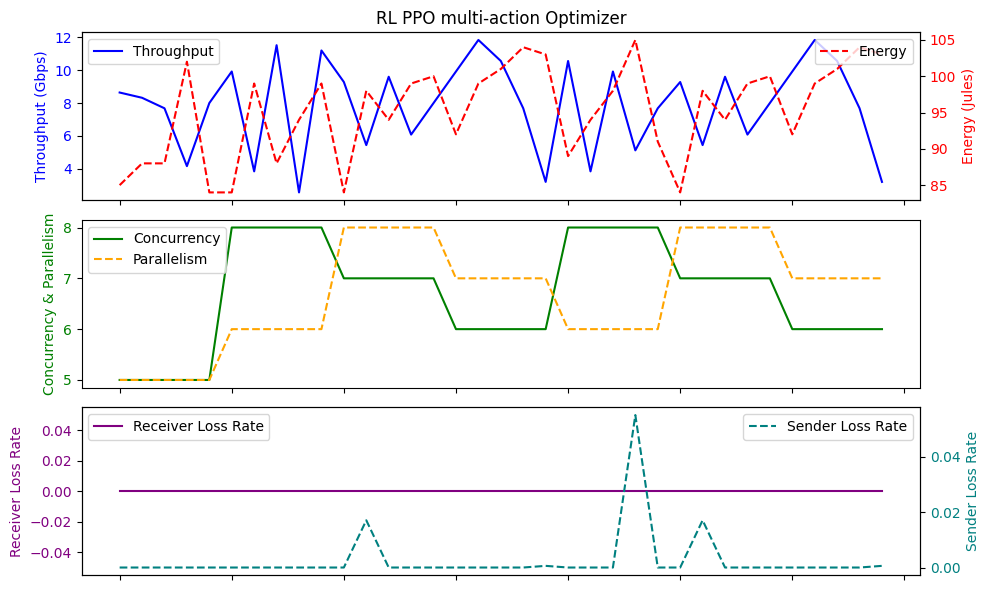

Average Throughput: 7.890285714285714
Total Energy: 3336.0
Total loss rate: 0.09029632343723727
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:35:37.263814912    7.862857       0.0   3.200000   
min       2024-02-19 05:41:19.255238    0.960000       0.0   0.000000   
25%    2024-02-19 05:45:01.972587520    5.760000       0.0   2.000000   
50%    2024-02-19 10:35:23.574913024    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416   10.080000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    3.195560       0.0   1.549193   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.645714   92.057143   0.000848  
min    32.700000   82.000000   0.000000  
25%    32.900000   85.000000   0.000000  
50%    33.200000   93.000000   0.000

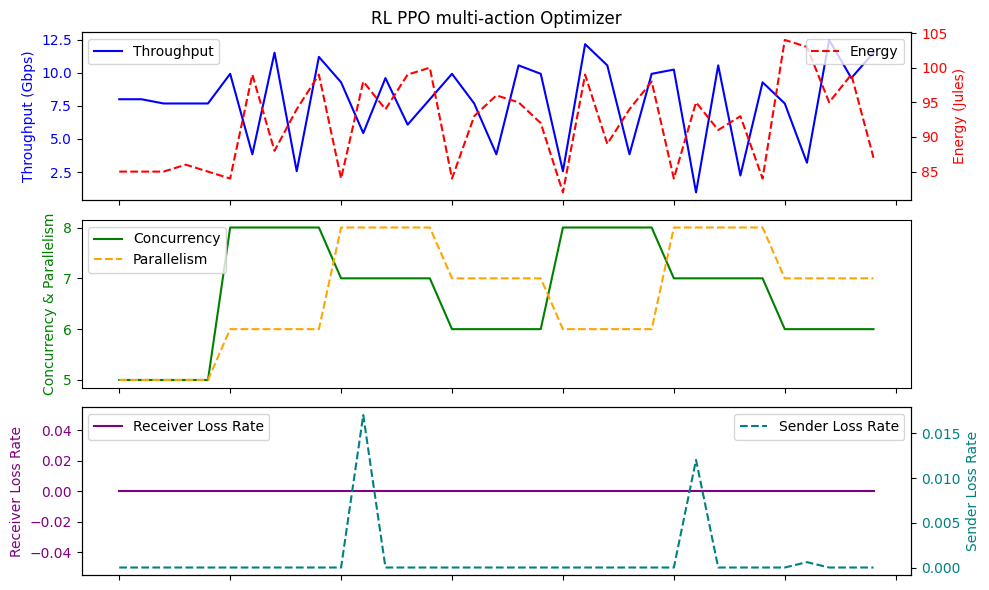

Average Throughput: 7.862857142857142
Total Energy: 3222.0
Total loss rate: 0.02967280044644772
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:13:51.239366656    7.771429       0.0   3.085714   
min       2024-02-19 05:41:19.255238    0.320000       0.0   0.000000   
25%    2024-02-19 07:47:37.738765056    4.640000       0.0   1.000000   
50%    2024-02-19 10:35:19.578454016    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   10.400000       0.0   5.000000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.767609       0.0   1.704172   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.917143   94.628571   0.000880  
min    32.500000   82.000000   0.000000  
25%    32.900000   87.000000   0.000000  
50%    33.100000   95.000000   0.000

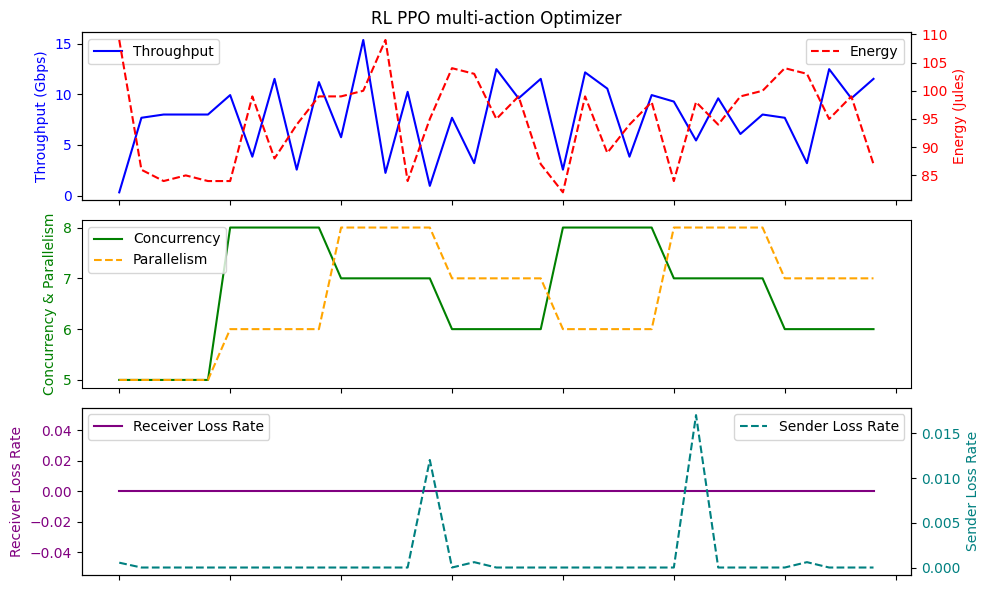

Average Throughput: 7.771428571428571
Total Energy: 3312.0
Total loss rate: 0.03081345818811526
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:00:46.100138496    7.771429       0.0   3.057143   
min       2024-02-18 07:44:17.826984    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:03.992217344    5.440000       0.0   2.000000   
50%    2024-02-19 13:05:40.103326976    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:10.919774464   10.400000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   15.360000       0.0   5.000000   
std                              NaN    3.455731       0.0   1.474147   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   35.000000   94.257143   0.001205  
min    32.500000   58.000000   0.000000  
25%    32.800000   91.000000   0.000000  
50%    33.100000   95.000000   0.000

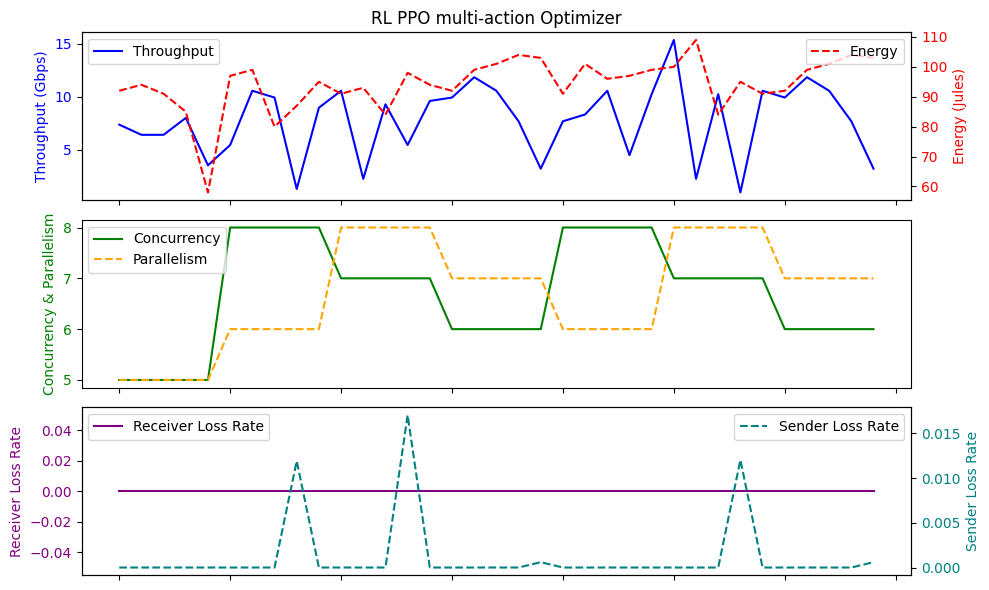

Average Throughput: 7.771428571428571
Total Energy: 3299.0
Total loss rate: 0.04217324345793387
                                Time  Throughput  LossRate     Score  \
count                             35   35.000000      35.0  35.00000   
mean   2024-02-19 12:07:48.489348608    7.524571       0.0   3.00000   
min       2024-02-19 05:41:19.255238    0.960000       0.0   0.00000   
25%    2024-02-19 08:13:24.169158912    4.160000       0.0   1.00000   
50%    2024-02-19 10:35:24.569976064    7.680000       0.0   3.00000   
75%    2024-02-19 17:04:21.056624384   10.560000       0.0   4.50000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.00000   
std                              NaN    3.850473       0.0   1.66274   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.877143   94.914286   0.001214  
min    32.500000   81.000000   0.000000  
25%    32.800000   89.500000   0.000000  
50%    33.000000   96.000000   0.000000  
75%

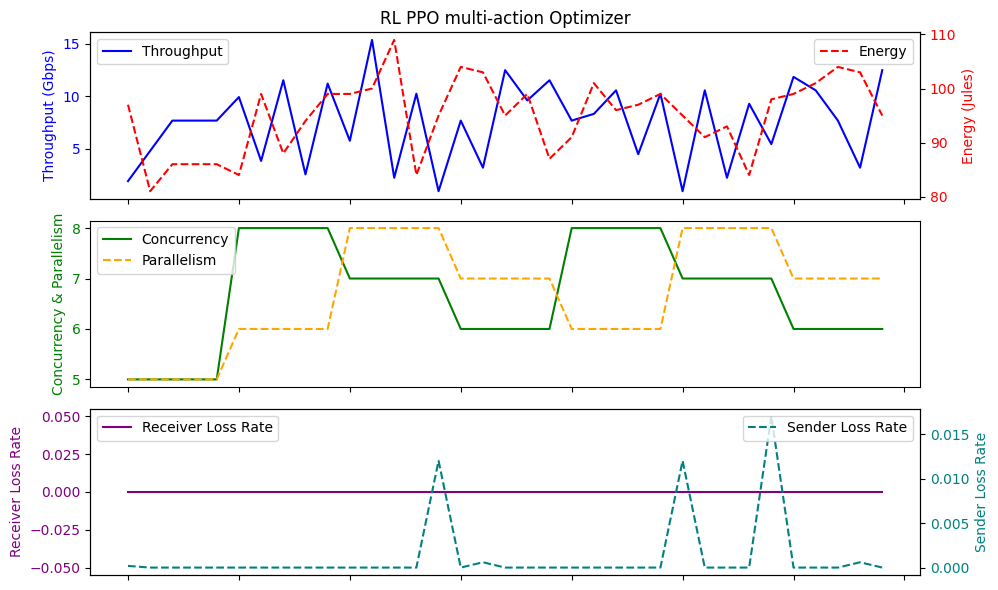

Average Throughput: 7.524571428571429
Total Energy: 3322.0
Total loss rate: 0.04248960852765391
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:52:52.987300096    7.634286       0.0   3.057143   
min       2024-02-19 08:13:23.671186    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    4.640000       0.0   1.000000   
50%    2024-02-19 10:35:19.578454016    8.000000       0.0   3.000000   
75%    2024-02-19 17:03:16.988988672   10.080000       0.0   5.000000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.660217       0.0   1.696759   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.137143   94.285714   0.001205  
min    32.500000   80.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.000000   95.000000   0.000

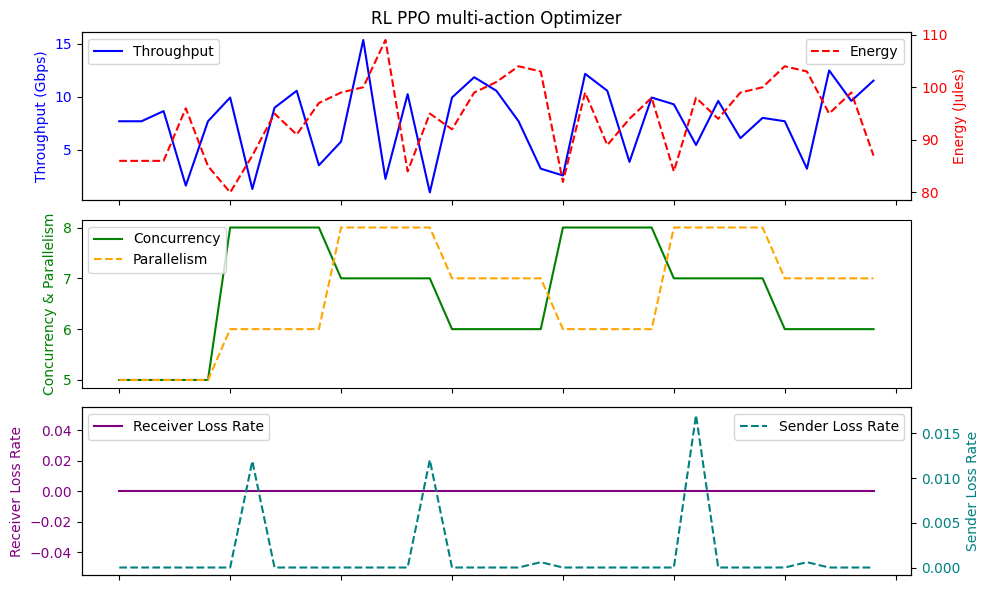

Average Throughput: 7.634285714285714
Total Energy: 3300.0
Total loss rate: 0.04217324345793387
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:10:40.473157376    7.972571       0.0   3.142857   
min       2024-02-19 05:27:31.568407    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    5.760000       0.0   2.000000   
50%    2024-02-19 13:05:42.108088064    8.000000       0.0   3.000000   
75%    2024-02-19 17:03:16.988988672   10.400000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.378879       0.0   1.458098   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.571429   94.914286   0.000868  
min    32.500000   84.000000   0.000000  
25%    32.800000   88.000000   0.000000  
50%    33.100000   96.000000   0.000

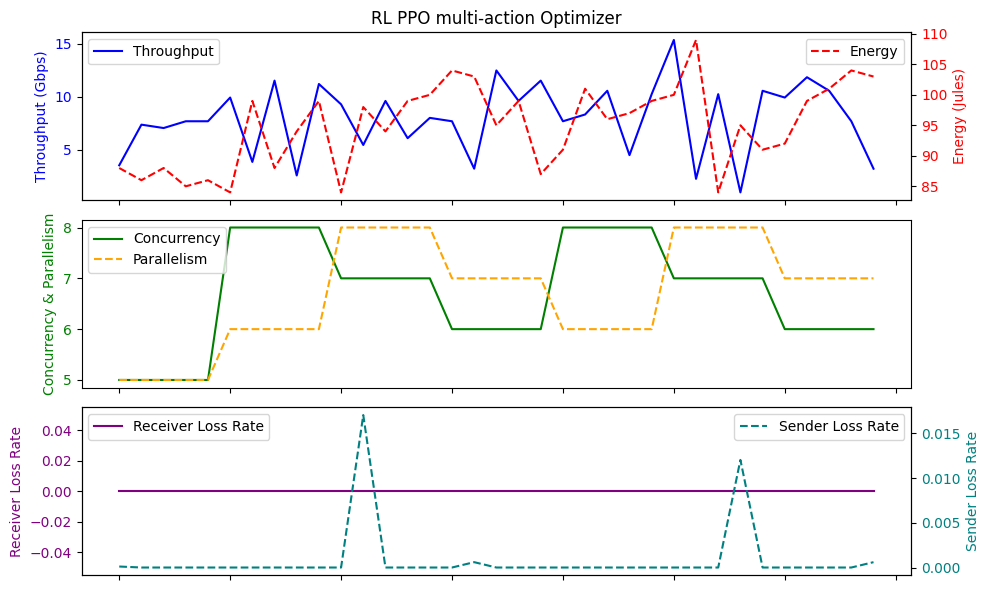

Average Throughput: 7.972571428571429
Total Energy: 3322.0
Total loss rate: 0.030382846597497924
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 14:25:14.703028224    7.753143       0.0   3.085714   
min       2024-02-19 10:25:02.487378    1.280000       0.0   0.000000   
25%    2024-02-19 11:16:35.879876864    5.440000       0.0   2.000000   
50%    2024-02-19 17:02:09.412815104    8.000000       0.0   3.000000   
75%    2024-02-19 17:03:16.988988672    9.920000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   14.080000       0.0   5.000000   
std                              NaN    3.165066       0.0   1.502379   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.220000   93.857143   0.001348  
min    32.500000   72.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.000000   96.000000   0.00

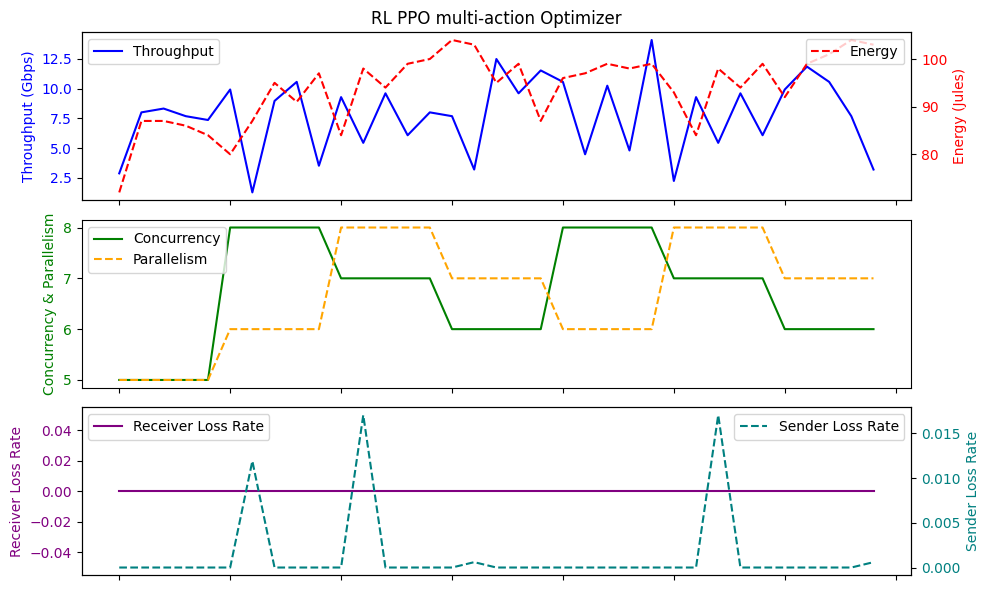

Average Throughput: 7.753142857142858
Total Energy: 3285.0
Total loss rate: 0.04718552950221456
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:21:54.292254208    8.201143       0.0   3.257143   
min       2024-02-19 05:37:28.132718    1.920000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    5.920000       0.0   2.000000   
50%    2024-02-19 14:01:44.074888960    9.280000       0.0   4.000000   
75%    2024-02-19 17:03:15.990565632   10.560000       0.0   5.000000   
max       2024-02-19 17:05:33.979979   13.440000       0.0   5.000000   
std                              NaN    3.509791       0.0   1.578213   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.402857   93.600000   0.001156  
min    32.500000   82.000000   0.000000  
25%    32.900000   86.500000   0.000000  
50%    33.200000   94.000000   0.000

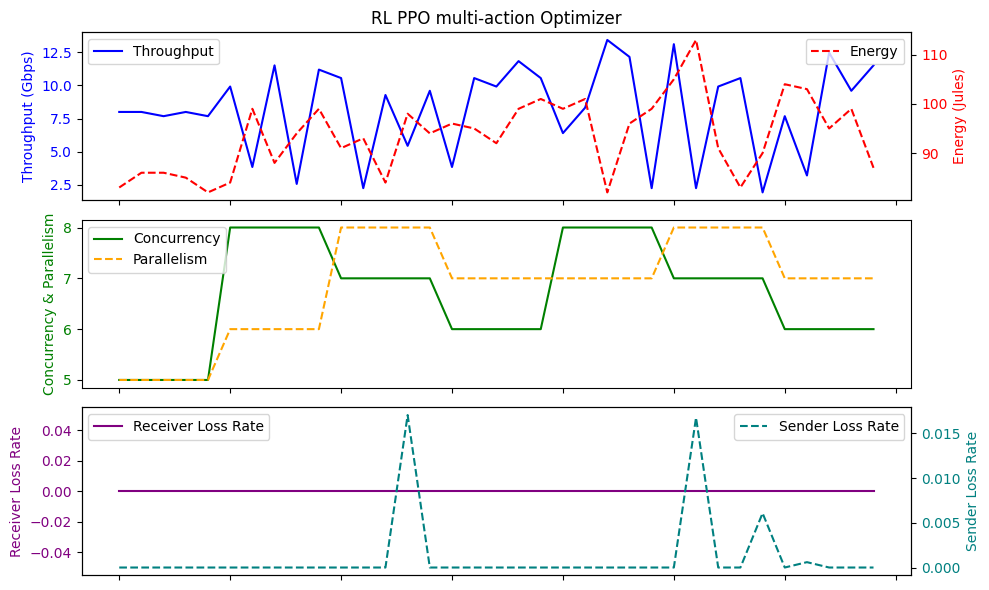

Average Throughput: 8.201142857142857
Total Energy: 3276.0
Total loss rate: 0.040469343321306195
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:28:13.964205568    7.990857       0.0   3.228571   
min       2024-02-19 05:41:21.255366    0.960000       0.0   0.000000   
25%    2024-02-19 10:35:23.077016576    6.720000       0.0   3.000000   
50%    2024-02-19 13:01:03.324370944    9.280000       0.0   3.000000   
75%    2024-02-19 15:07:03.399310592   10.560000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   11.840000       0.0   5.000000   
std                              NaN    3.277633       0.0   1.456945   

            RTT      Energy   SenderLR  
count  35.00000   35.000000  35.000000  
mean   34.72000   94.257143   0.000705  
min    32.50000   84.000000   0.000000  
25%    32.75000   91.000000   0.000000  
50%    33.10000   95.000000   0.000000  

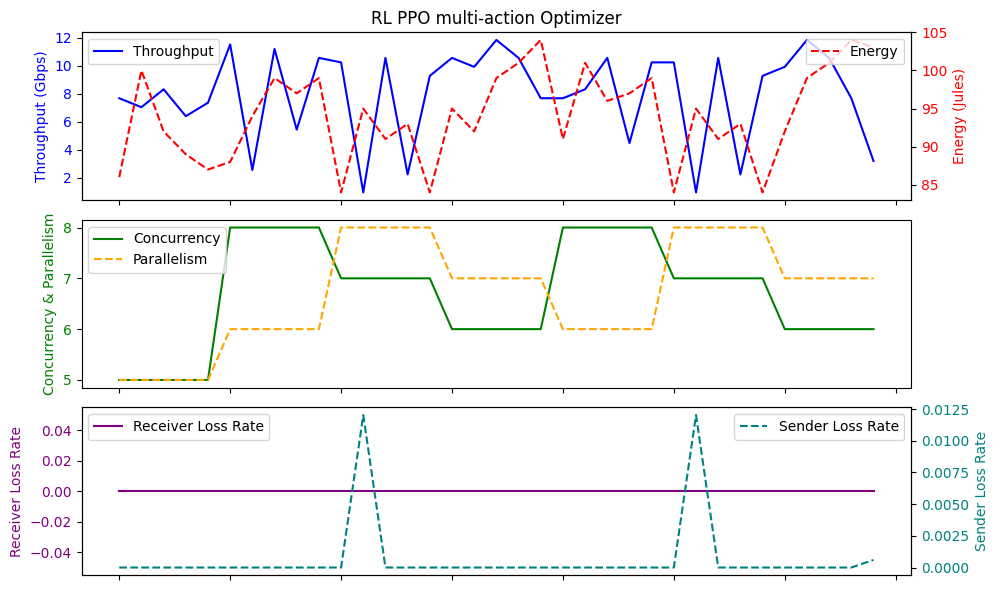

Average Throughput: 7.990857142857143
Total Energy: 3299.0
Total loss rate: 0.024660514402167037
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:23:59.885083136    7.488000       0.0   2.828571   
min       2024-02-18 14:38:54.413668    0.960000       0.0  -1.000000   
25%    2024-02-19 05:41:22.756942848    4.160000       0.0   1.000000   
50%    2024-02-19 10:35:23.574913024    8.960000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   10.400000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    3.596348       0.0   1.617655   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.900000   93.685714   0.002305  
min    32.800000   84.000000   0.000000  
25%    32.900000   88.500000   0.000000  
50%    33.100000   94.000000   0.00

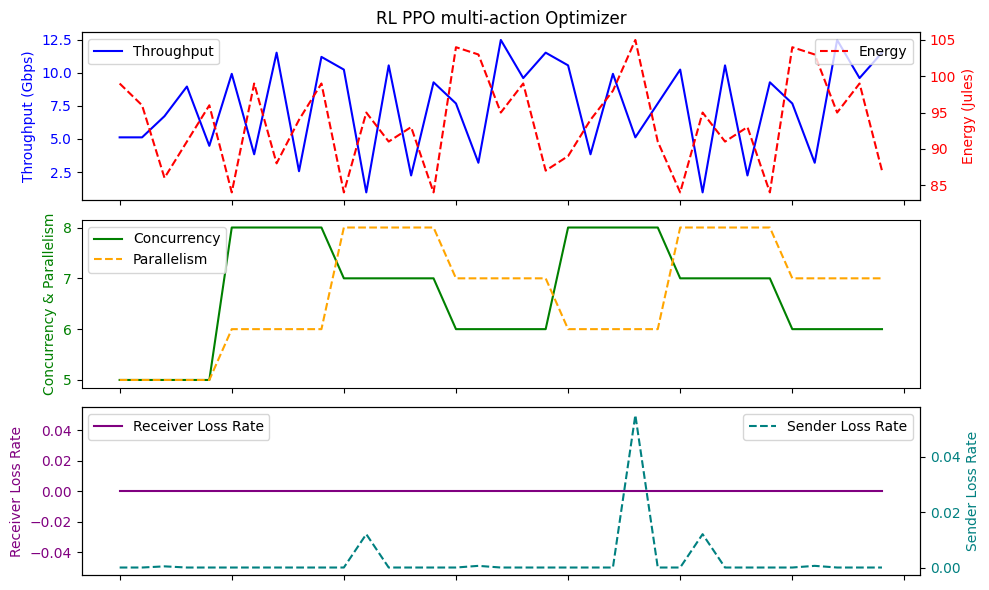

Average Throughput: 7.4879999999999995
Total Energy: 3279.0
Total loss rate: 0.08068911101927323
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:20:32.389786112    8.118857       0.0   3.314286   
min       2024-02-19 05:46:39.681489    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    6.080000       0.0   2.500000   
50%    2024-02-19 17:02:09.412815104    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:13.423297024   10.240000       0.0   5.000000   
max       2024-02-19 17:04:24.559545   12.480000       0.0   5.000000   
std                              NaN    2.871712       0.0   1.548651   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.717143   93.914286   0.001331  
min    32.500000   80.000000   0.000000  
25%    32.900000   88.000000   0.000000  
50%    33.100000   95.000000   0.00

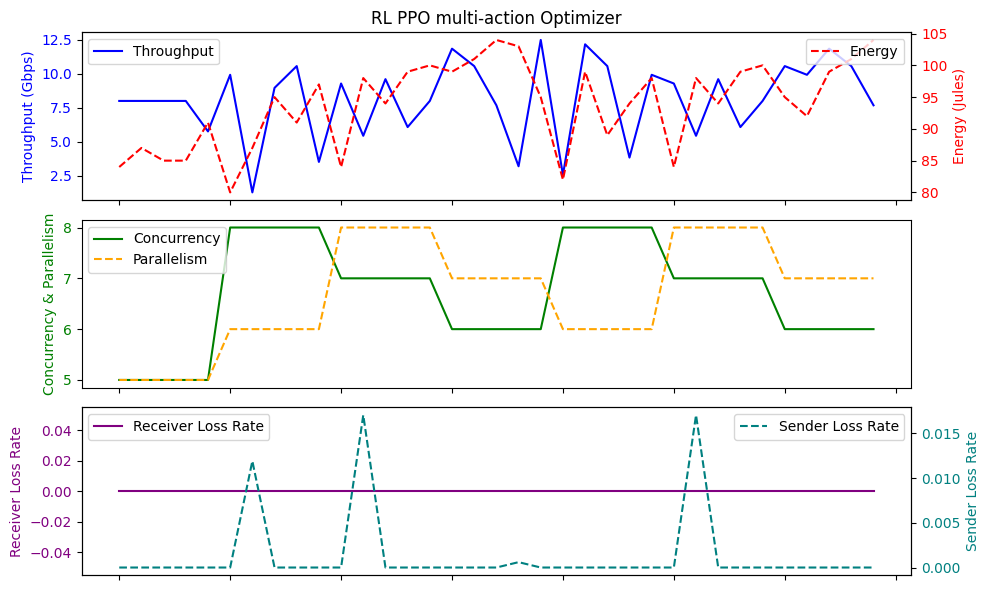

Average Throughput: 8.118857142857143
Total Energy: 3287.0
Total loss rate: 0.046586682126918785
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:22:42.778986496    7.853714       0.0   3.171429   
min       2024-02-18 05:10:45.730893    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:03.992217344    5.600000       0.0   2.000000   
50%    2024-02-19 10:35:23.574913024    8.960000       0.0   3.000000   
75%    2024-02-19 17:02:09.412815104   10.400000       0.0   4.000000   
max       2024-02-19 17:04:22.551735   12.160000       0.0   5.000000   
std                              NaN    3.210658       0.0   1.504615   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.417143   92.314286   0.001262  
min    32.500000   75.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.100000   94.000000   0.00

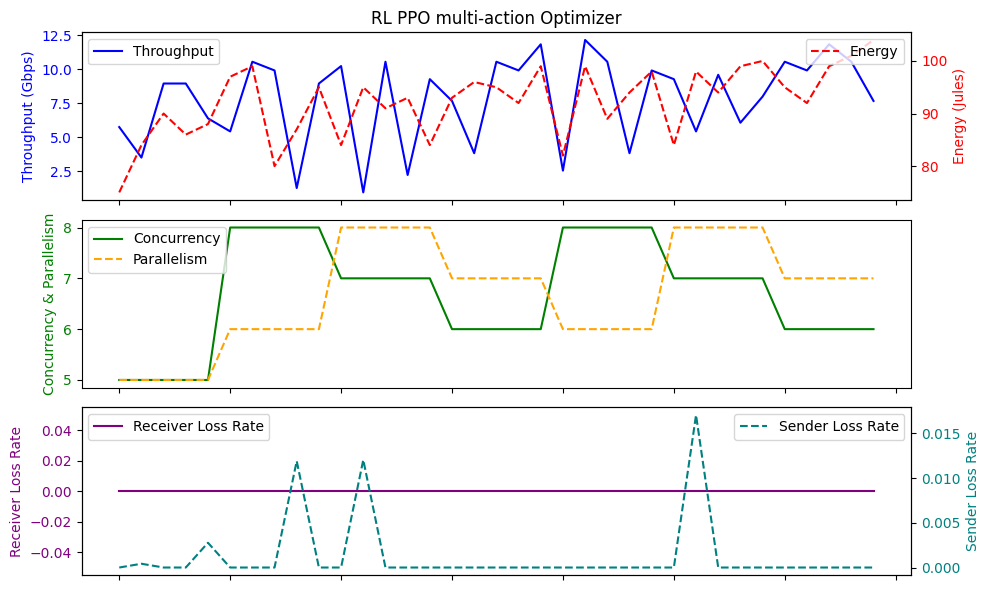

Average Throughput: 7.853714285714285
Total Energy: 3231.0
Total loss rate: 0.04416533382197534
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:20:47.154691072    7.780571       0.0   3.085714   
min       2024-02-18 08:36:21.549310    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:23.758746112    4.960000       0.0   2.000000   
50%    2024-02-19 13:05:44.106685952    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:21.056624384   10.560000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   14.080000       0.0   6.000000   
std                              NaN    3.525789       0.0   1.578745   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.840000   94.314286   0.000870  
min    32.500000   80.000000   0.000000  
25%    32.800000   89.500000   0.000000  
50%    33.000000   95.000000   0.000

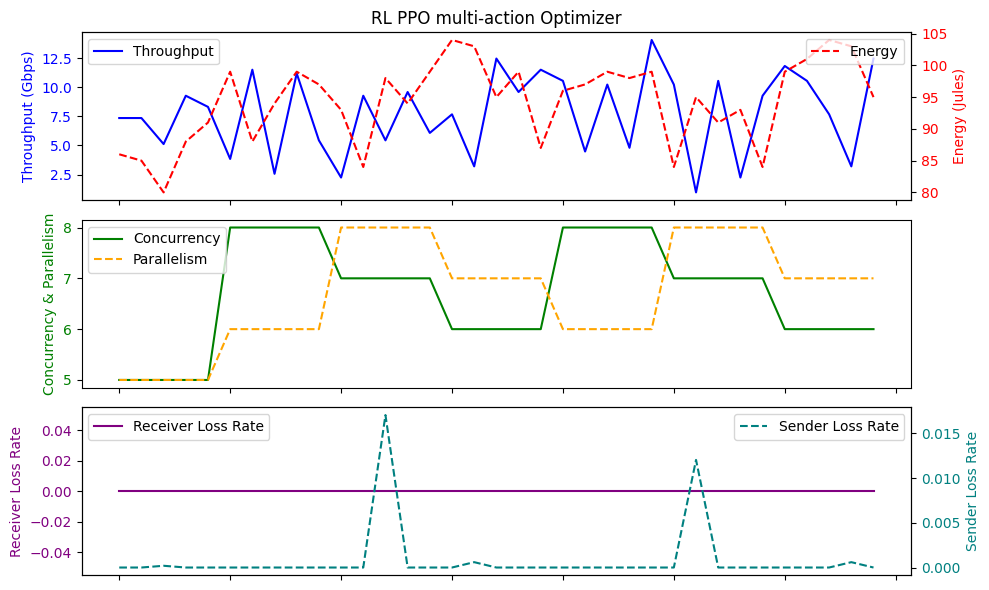

Average Throughput: 7.78057142857143
Total Energy: 3301.0
Total loss rate: 0.030466909109240634
                                Time  Throughput  LossRate      Score  \
count                             35     35.0000      35.0  35.000000   
mean   2024-02-19 12:03:02.559645696      8.0000       0.0   3.257143   
min       2024-02-19 05:41:23.257360      1.2800       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608      5.7600       0.0   2.000000   
50%    2024-02-19 13:11:53.354853120      8.0000       0.0   3.000000   
75%    2024-02-19 13:11:57.385806080      9.9200       0.0   4.000000   
max       2024-02-19 17:02:13.423297     14.0800       0.0   5.000000   
std                              NaN      2.8368       0.0   1.357828   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.351429   92.542857   0.001314  
min    32.500000   80.000000   0.000000  
25%    32.900000   87.000000   0.000000  
50%    33.400000   94.000000   0.000

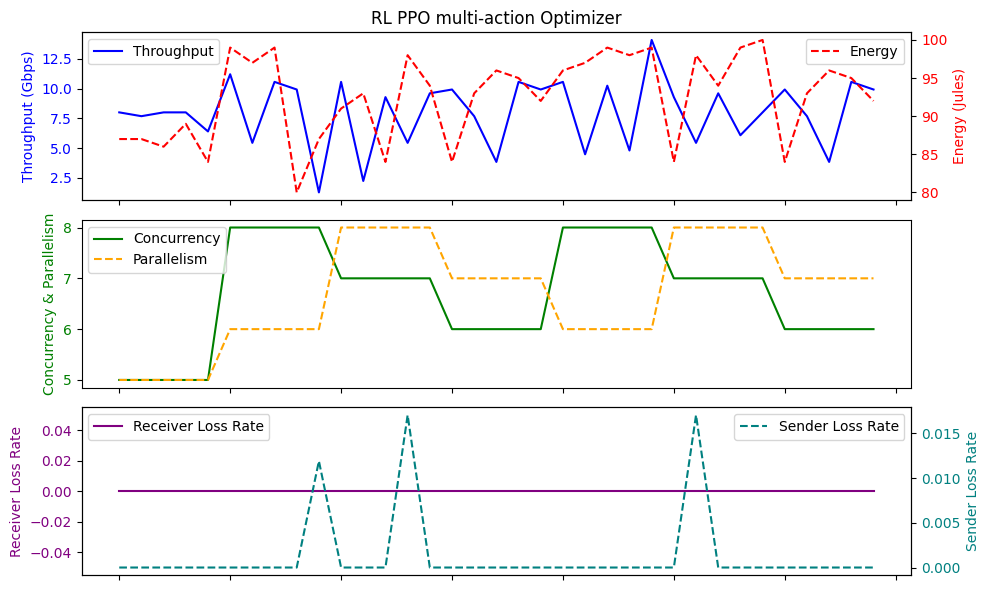

Average Throughput: 8.0
Total Energy: 3239.0
Total loss rate: 0.04598783475162301
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:05:42.961640192    8.301714       0.0   3.057143   
min       2024-02-19 05:48:05.946644    0.960000       0.0   0.000000   
25%    2024-02-19 13:10:19.414340864    5.120000       0.0   2.000000   
50%    2024-02-19 14:01:48.089768960    9.920000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.560000       0.0   4.000000   
max       2024-02-19 17:24:07.795264   15.360000       0.0   5.000000   
std                              NaN    3.907596       0.0   1.513524   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.642857   97.371429   0.000851  
min    32.500000   82.000000   0.000000  
25%    32.700000   95.000000   0.000000  
50%    33.000000   99.000000   0.000000  
75%    3

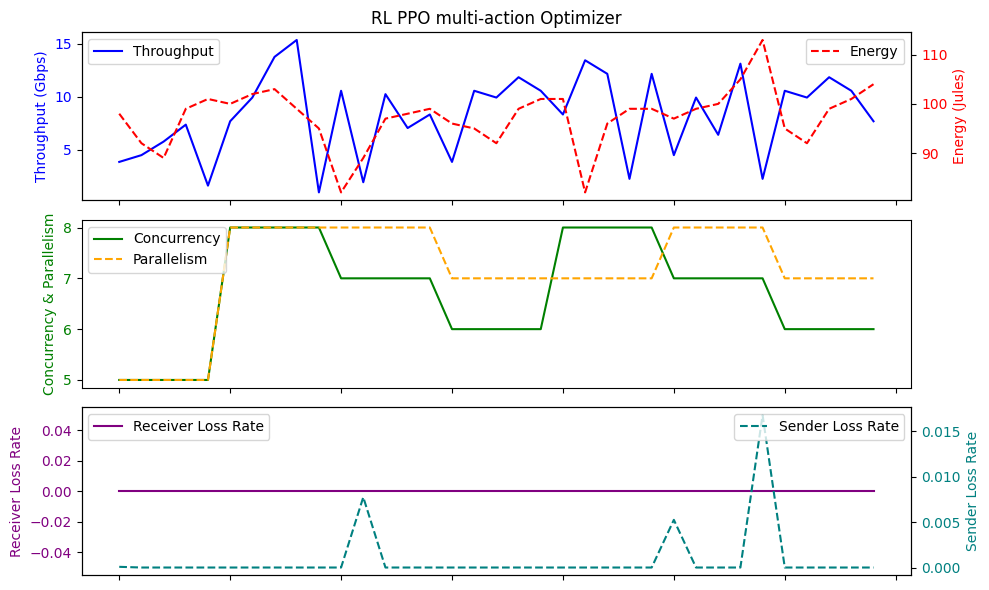

Average Throughput: 8.301714285714286
Total Energy: 3408.0
Total loss rate: 0.029792390813927913
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 14:21:25.999713024    7.643429       0.0   3.057143   
min       2024-02-19 10:25:02.487378    0.960000       0.0   0.000000   
25%    2024-02-19 10:31:52.981631488    5.440000       0.0   1.000000   
50%    2024-02-19 15:12:02.189478912    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:22.055152128   10.080000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   6.000000   
std                              NaN    3.346097       0.0   1.696759   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.645714   93.457143   0.001692  
min    32.500000   80.000000   0.000000  
25%    32.850000   88.000000   0.000000  
50%    33.000000   95.000000   0.00

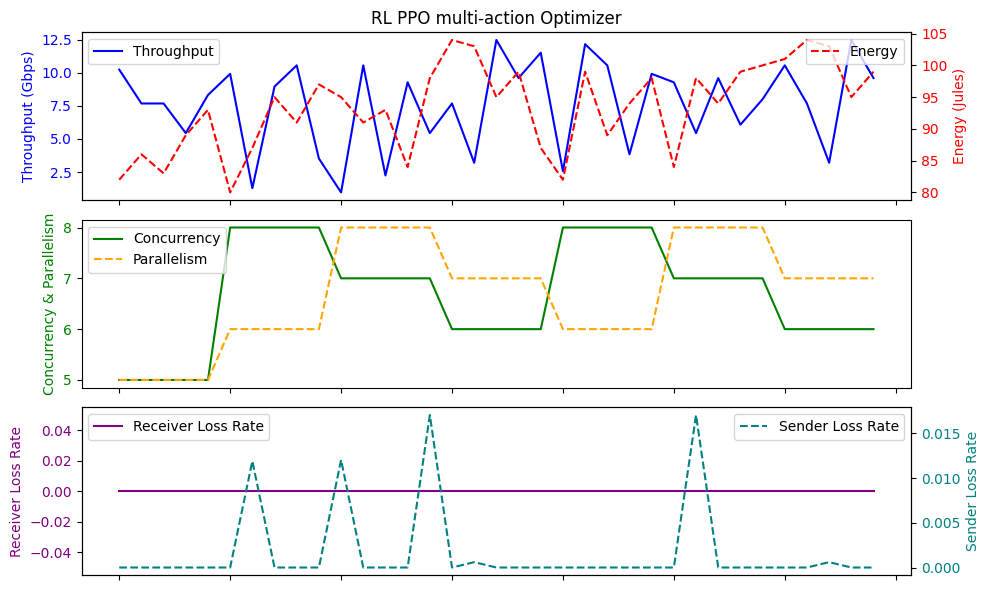

Average Throughput: 7.643428571428572
Total Energy: 3271.0
Total loss rate: 0.05921636301565019
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:08:00.493685760    7.689143       0.0   3.142857   
min       2024-02-19 05:34:09.251332    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.760000       0.0   2.000000   
50%    2024-02-19 10:35:23.574913024    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:09.412815104    9.920000       0.0   4.500000   
max       2024-02-19 17:04:23.552343   12.160000       0.0   5.000000   
std                              NaN    3.151143       0.0   1.593052   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.774286   92.142857   0.001188  
min    32.500000   80.000000   0.000000  
25%    32.900000   87.000000   0.000000  
50%    33.100000   93.000000   0.000

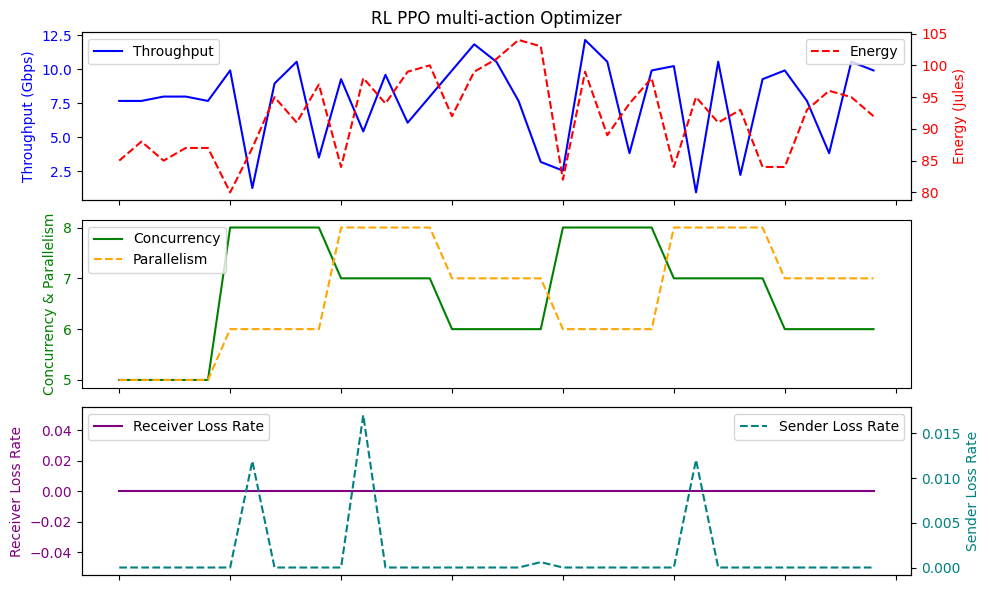

Average Throughput: 7.6891428571428575
Total Energy: 3225.0
Total loss rate: 0.041574396082638104
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:16:21.860828672    7.835429       0.0   3.142857   
min       2024-02-18 08:10:14.187464    2.240000       0.0   1.000000   
25%    2024-02-19 05:41:22.756942848    5.760000       0.0   2.000000   
50%    2024-02-19 13:11:56.355003904    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920    9.920000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   12.160000       0.0   5.000000   
std                              NaN    2.976042       0.0   1.478132   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.854286   93.542857   0.001118  
min    32.500000   66.000000   0.000000  
25%    32.900000   89.500000   0.000000  
50%    33.600000   94.000000   0.0

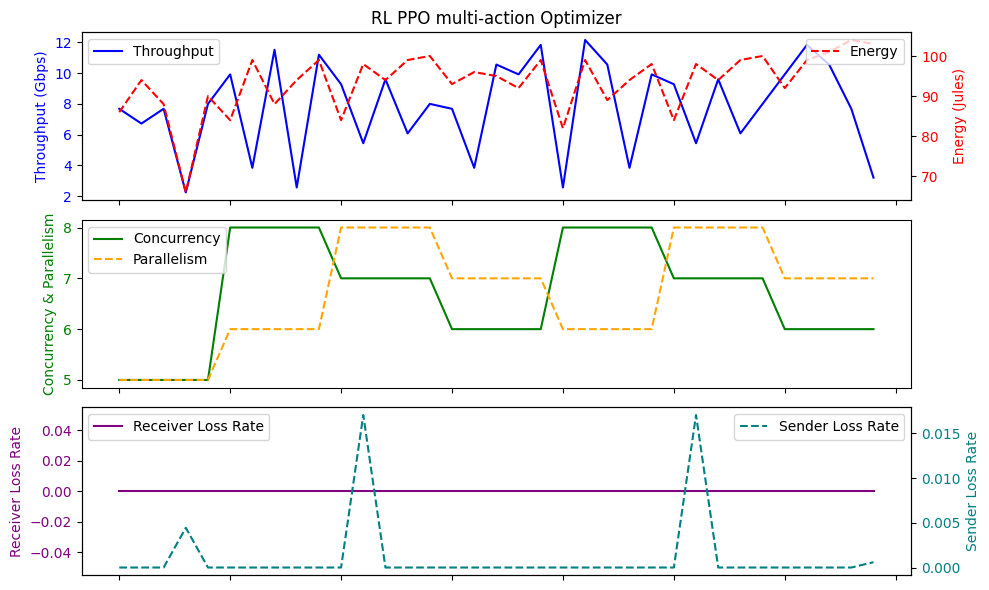

Average Throughput: 7.83542857142857
Total Energy: 3274.0
Total loss rate: 0.039126631539011164
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:08:47.159440896    8.155429       0.0   2.885714   
min       2024-02-19 05:39:08.691687    2.240000       0.0  -8.000000   
25%    2024-02-19 05:41:22.756942848    5.920000       0.0   2.000000   
50%    2024-02-19 13:11:56.355003904    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416   10.560000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   13.440000       0.0   5.000000   
std                              NaN    3.037147       0.0   2.348609   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.234286   94.228571   0.004515  
min    32.500000   82.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.000000   96.000000   0.000

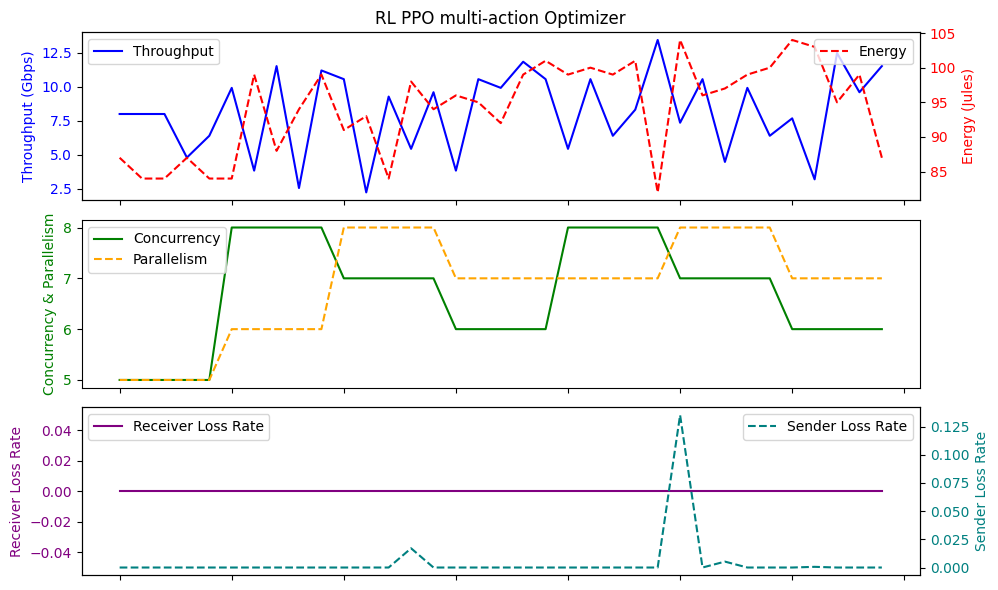

Average Throughput: 8.15542857142857
Total Energy: 3298.0
Total loss rate: 0.15803904864576565
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:52:56.358365184    7.314286       0.0   2.971429   
min       2024-02-19 05:27:53.457496    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:03.992217344    5.120000       0.0   2.000000   
50%    2024-02-19 13:05:44.106685952    7.680000       0.0   3.000000   
75%    2024-02-19 13:11:56.870405120    9.920000       0.0   4.000000   
max       2024-02-19 17:04:20.554680   11.840000       0.0   5.000000   
std                              NaN    3.025992       0.0   1.424279   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.354286   92.228571   0.001658  
min    32.500000   71.000000   0.000000  
25%    32.750000   87.500000   0.000000  
50%    32.900000   94.000000   0.0000

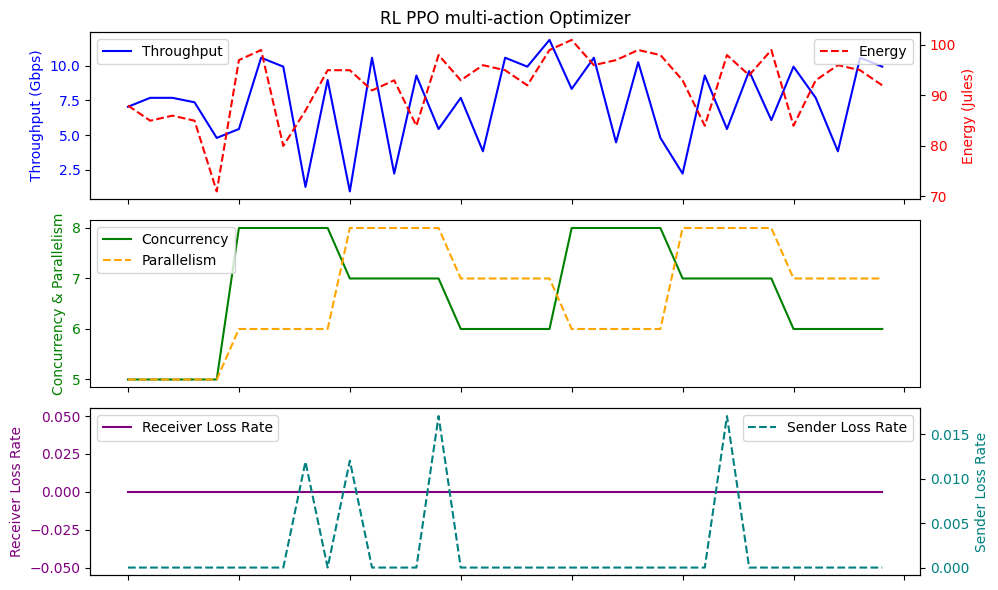

Average Throughput: 7.314285714285714
Total Energy: 3228.0
Total loss rate: 0.05801866826505864
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:42:46.321971456    7.643429       0.0   3.114286   
min       2024-02-19 05:46:17.589910    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.760000       0.0   2.000000   
50%    2024-02-19 13:05:44.106685952    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:09.912956416    9.920000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   11.840000       0.0   5.000000   
std                              NaN    2.907861       0.0   1.529541   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.808571   93.057143   0.001675  
min    32.500000   80.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.100000   94.000000   0.000

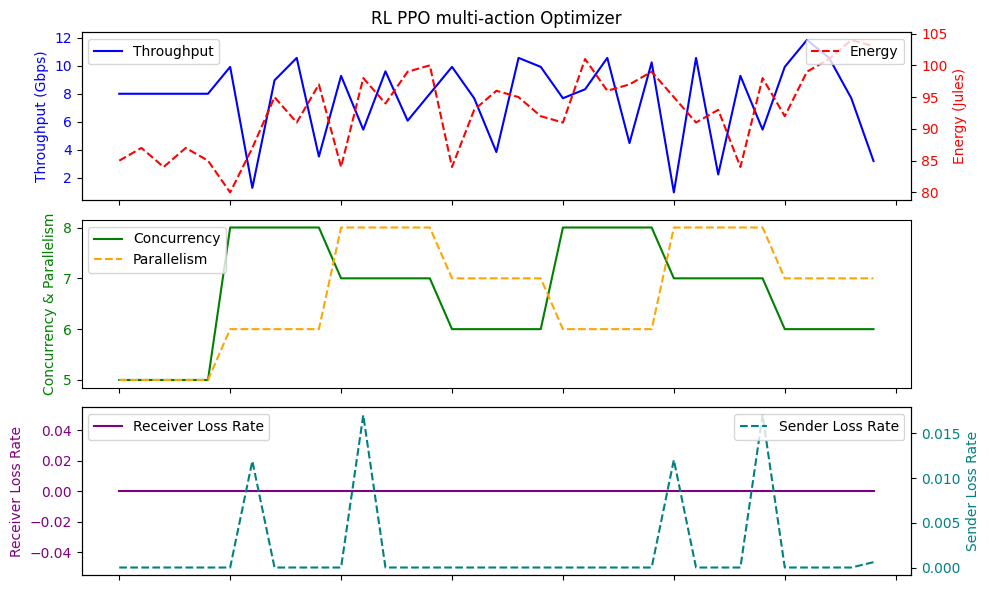

Average Throughput: 7.643428571428572
Total Energy: 3257.0
Total loss rate: 0.05861751564035442
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:49:55.460015360    7.771429       0.0   3.114286   
min       2024-02-19 05:41:23.257360    0.320000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    5.760000       0.0   2.000000   
50%    2024-02-19 13:11:56.355003904    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920    9.920000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   12.160000       0.0   6.000000   
std                              NaN    3.119526       0.0   1.567528   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.628571   94.571429   0.001392  
min    32.500000   80.000000   0.000000  
25%    32.900000   90.000000   0.000000  
50%    33.100000   96.000000   0.000

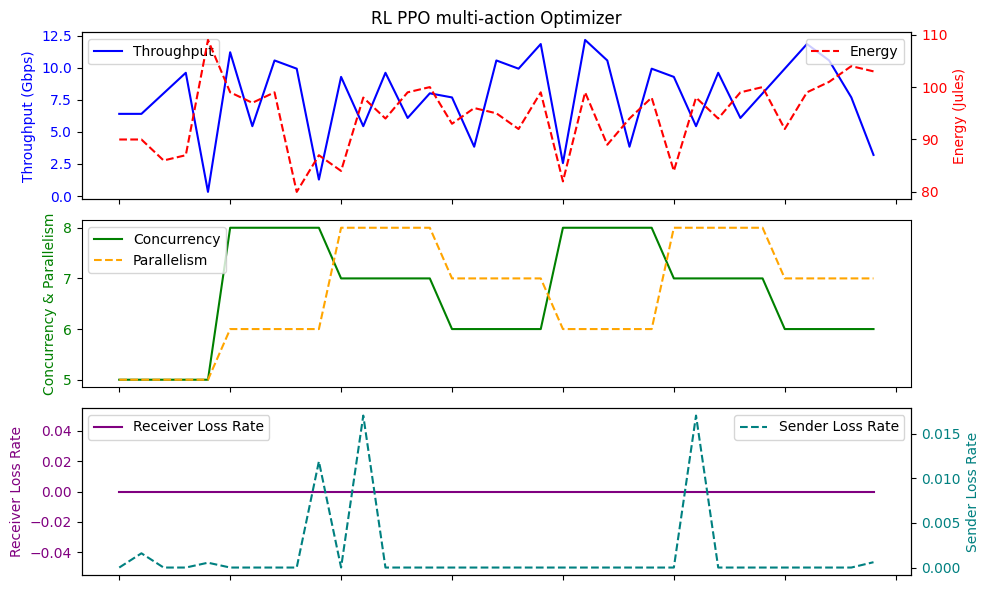

Average Throughput: 7.771428571428571
Total Energy: 3310.0
Total loss rate: 0.04872479888588369


In [20]:
num_of_run=50

rl_energy_sla_throughput_list=[]
rl_energy_sla_energy_list=[]
rl_energy_sla_plr_list=[]


model = PPO.load("./ppo_multi_action_in_de_energySLA/ppo_best_model/best_model.zip")
for i in range(0,num_of_run):
    done = False
    episode_reward = 0
    env=transferClass_multi_action_increase_decrease_energy_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energySLA')
    action_list=[]
    reward_list=[]
    obs = env.reset()
    while not done:
        action, _ = model.predict(obs, deterministic=True)
        action_list.append(action)
    #     print("action: ",action)
        obs, reward, done, info = env.step(action)
    #     obs = obs.astype(np.float32)
    #     print("obs: ", obs,".... reward: ",reward)
        reward_list.append(reward)
        episode_reward += reward

    accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
    env.close()
    print(accumulator_df.describe())
    print(f"Episode reward: {episode_reward}")
    print(f"actions {action_list},   {len(action_list)}")
    print(f"rewards {reward_list},  {len(reward_list)}")
    rl_energy_sla_throughput_list.append(accumulator_df['Throughput'].mean())
    rl_energy_sla_energy_list.append(accumulator_df['Energy'].sum())
    rl_energy_sla_plr_list.append(accumulator_df['SenderLR'].sum())
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6), sharex=True)

    df=accumulator_df.reset_index()
    # Top plot with Throughput and Energy
    ax1.plot( df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL PPO multi-action Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')


    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot( df['LossRate'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot( df['SenderLR'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
#     ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = accumulator_df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = accumulator_df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = accumulator_df['SenderLR'].sum()
    print("Total loss rate:", total_plr)

**Throughput SLA**

In [21]:
class transferClass_multi_action_increase_decrease_throughput_SLA(gym.Env):
    metadata = {"render_modes": ["human"], "render_fps": 30}
    def __init__(self,transaction_dfs,initial_dfs,optimizer,total_steps=20,min_values=[0.32, 0.0, 1, 1, -3081.0, 0.0, 44.0, 0.0],max_values = [19.2, 2.0, 8, 8, 16.0, 70.1, 120.0, 74.166],total_file_size=256):
        super().__init__()
        self.min_action=1
        self.max_action=8
        self.action_i_d_array=[1,4,0,-1,-4]

        self.transaction_dfs = transaction_dfs
        self.initial_dfs= initial_dfs

        self.action_space = spaces.MultiDiscrete([5, 5])  # example action space
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(40,), dtype=np.float32) # example observation space
        self.current_observation = np.zeros(40,) # initialize current observation

        self.base_energy=44
        self.throughput_sla=8
        self.optimizer=optimizer
        self.old_action=None
        self.step_number=0
        self.total_steps=total_steps
        self.sampling_metric='Score'
        self.min_values=np.array(min_values)
        self.max_values=np.array(max_values)
        self.previous_reward=0
        self.obs_df=[]
        self.total_file_size= total_file_size
        self.current_download_size=0

    def reset(self):
        self.current_observation = np.zeros(40,) # initialize current observation
        self.old_action=None
        self.step_number=0
        self.previous_reward=0
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.obs_df=[]
        self.current_download_size=0
        return self.current_observation

    def step(self, action):
        # perform action using transfer_service
        action_1,action_2=action

        self.current_action_parallelism_value+=self.action_i_d_array[action_1]
        if self.current_action_parallelism_value<self.min_action:
            self.current_action_parallelism_value=self.min_action
        elif self.current_action_parallelism_value>self.max_action:
            self.current_action_parallelism_value=self.max_action

        self.current_action_concurrency_value+=self.action_i_d_array[action_2]
        if self.current_action_concurrency_value<self.min_action:
            self.current_action_concurrency_value=self.min_action
        elif self.current_action_concurrency_value>self.max_action:
            self.current_action_concurrency_value=self.max_action


        action_t=(self.current_action_parallelism_value,self.current_action_concurrency_value)
#         print(f"action_t {action_t}")

        if self.old_action==None:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            energy_reward_component=20/(np.abs(self.base_energy-energy_part_reward))
            if throughput_part_reward < self.throughput_sla:
                throughput_penalty=(throughput_part_reward-self.throughput_sla)*10
            else:
                throughput_penalty=0                
            reward_=np.mean(t_array)+energy_reward_component+throughput_penalty
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        elif self.old_action==action_t:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            energy_reward_component=20/(np.abs(self.base_energy-energy_part_reward))
            if throughput_part_reward < self.throughput_sla:
                throughput_penalty=(throughput_part_reward-self.throughput_sla)*10
            else:
                throughput_penalty=0                
            reward_=np.mean(t_array)+energy_reward_component+throughput_penalty
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_
            
        else:
            done=False
            key_name=(self.old_action, action_t)
            work_df=self.transaction_dfs[key_name]
            if work_df.empty:
                observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            else:
                observation_df=sample_row_and_neighbors(self.transaction_dfs[key_name],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            energy_reward_component=20/(np.abs(self.base_energy-energy_part_reward))
            if throughput_part_reward < self.throughput_sla:
                throughput_penalty=(throughput_part_reward-self.throughput_sla)*10
            else:
                throughput_penalty=0                
            reward_=np.mean(t_array)+energy_reward_component+throughput_penalty
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        self.step_number+=1
        if self.current_download_size>=self.total_file_size:
            done=True
        observation = np.asarray(observation).astype(np.float32)
        self.current_observation=observation
        return self.current_observation, reward, done, {}

    def bayes_step(self,action):
        params = [1 if x<1 else int(np.round(x)) for x in action]
        self.current_action_array_index+=self.action_i_d_array[params[0]]
        if self.current_action_array_index<self.min_action:
            self.current_action_array_index=self.min_action
        elif self.current_action_array_index>self.max_action:
            self.current_action_array_index=self.max_action
        action_t=self.action_array[self.current_action_array_index]

        print("Bayes Step: ",action_t)
        obs,score_b,done_b,__=self.step(action_t)
        print("Bayes Step Score: ", score_b)
        return np.round(score_b * (-1))

    def render(self, mode="human"):
        pass

    def close(self):
        self.reset()


In [76]:
env=transferClass_multi_action_increase_decrease_throughput_SLA(cluster_dictionary,initial_value_cluster_dictionary,'throughputSLA')
total_scores=0
s = env.reset()
action_list=[]
reward_list=[]
done = False
while not done:
    a=env.action_space.sample()
    s_next, r, done, info = env.step(a)
    # print( len(s_next))
    action_list.append(a)
    reward_list.append(r)
    total_scores += r
    s = s_next
accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
env.close()
print(f"Total Reward: {total_scores}")
print(f"actions {action_list},   {len(action_list)}")
print(f"rewards {reward_list},  {len(reward_list)}")
print(accumulator_df)
print(f"Total downloaded {accumulator_df['Throughput'].sum()} Gb")
print(f"Download speed {accumulator_df['Throughput'].mean()} Gbps")

Total Reward: -23.822202247191022
actions [array([4, 4]), array([4, 4]), array([2, 0]), array([4, 2]), array([2, 0]), array([2, 3]), array([3, 0]), array([4, 0]), array([3, 4]), array([1, 3]), array([0, 1]), array([1, 4]), array([2, 0]), array([3, 0]), array([0, 2]), array([2, 0]), array([1, 0]), array([3, 0])],   18
rewards [-55.775999999999996, -10.703999999999994, 0.6628571428571348, 26.08147899159664, -22.046336134453796, -2.399333333333331, 0.9913333333333298, 2.4483529411764806, -5.738352941176458, 9.525333333333322, 59.78349615975424, -48.83992859218666, 13.360054851311467, 8.75724032621898, 13.344519517898915, -0.02011910510220538, 12.65893542366554, -25.911734162084635],  18
                           Time  Throughput  LossRate Parallelism Concurrency  \
1101 2024-02-17 23:45:44.429411        0.32       0.0           1           1   
1102 2024-02-17 23:45:45.431969        0.64       0.0           1           1   
1103 2024-02-17 23:45:46.431221        0.32       0.0           

In [77]:
env=transferClass_multi_action_increase_decrease_throughput_SLA(cluster_dictionary,initial_value_cluster_dictionary,'throughputSLA')
evaluation_env=transferClass_multi_action_increase_decrease_throughput_SLA(cluster_dictionary,initial_value_cluster_dictionary,'throughputSLA')

policy_kwargs = dict(activation_fn=th.nn.ReLU,net_arch=[{'pi': [128, 128], 'vf': [128, 128]}])

run_string='multi_action_in_de_throughputSLA'
model = PPO("MlpPolicy", env=env, policy_kwargs=policy_kwargs, verbose=1,tensorboard_log=f"./ppo_tensorboard_{run_string}/",ent_coef=0.01)

eval_callback = EvalCallback(evaluation_env, best_model_save_path=f'./ppo_{run_string}/ppo_best_model/',
                               log_path=f'./ppo_{run_string}/ppo_logs/', eval_freq=1000,
                               deterministic=True, render=False)
# Callback for saving checkpoints every 1000 timesteps
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path=f'./ppo_{run_string}/ppo_checkpoints/',
                                           name_prefix=f'ppo_model_{run_string}')

# Combine both callbacks
callback = CallbackList([checkpoint_callback, eval_callback])
model.learn(total_timesteps=1000000, callback=callback)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to ./ppo_tensorboard_multi_action_in_de_throughputSLA/PPO_1


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/policies.py:484: UserWarning: As shared layers in the mlp_extractor are removed since SB3 v1.8.0, you should now pass directly a dictionary and not a list (net_arch=dict(pi=..., vf=...) instead of net_arch=[dict(pi=..., vf=...)])
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengt

Eval num_timesteps=1000, episode_reward=-60.51 +/- 8.51
Episode length: 105.60 +/- 26.62
---------------------------------
| eval/              |          |
|    mean_ep_length  | 106      |
|    mean_reward     | -60.5    |
| time/              |          |
|    total_timesteps | 1000     |
---------------------------------
New best mean reward!


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=2000, episode_reward=-66.74 +/- 1.93
Episode length: 117.80 +/- 4.96
---------------------------------
| eval/              |          |
|    mean_ep_length  | 118      |
|    mean_reward     | -66.7    |
| time/              |          |
|    total_timesteps | 2000     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | -16.9    |
| time/              |          |
|    fps             | 195      |
|    iterations      | 1        |
|    time_elapsed    | 10       |
|    total_timesteps | 2048     |
---------------------------------
Eval num_timesteps=3000, episode_reward=-3.39 +/- 11.65
Episode length: 7.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.8         |
|    mean_reward          | -3.39       |
| time/                   |             |
|    total_timesteps      | 3000      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=4000, episode_reward=7.02 +/- 2.69
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.02     |
| time/              |          |
|    total_timesteps | 4000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | -8.75    |
| time/              |          |
|    fps             | 217      |
|    iterations      | 2        |
|    time_elapsed    | 18       |
|    total_timesteps | 4096     |
---------------------------------
Eval num_timesteps=5000, episode_reward=4.17 +/- 6.38
Episode length: 7.20 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 4.17        |
| time/                   |             |
|    total_timesteps      | 5000        |
| train/                  |             |
|    approx_kl            | 0.011228756 |
|    clip_fraction        | 0.174       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.19       |
|    explained_variance   | 0.587       |
|    learning_rate        | 0.0003      |
|    los

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=6000, episode_reward=-3.87 +/- 10.59
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | -3.87    |
| time/              |          |
|    total_timesteps | 6000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | -5.45    |
| time/              |          |
|    fps             | 226      |
|    iterations      | 3        |
|    time_elapsed    | 27       |
|    total_timesteps | 6144     |
---------------------------------
Eval num_timesteps=7000, episode_reward=3.29 +/- 9.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 3.29        |
| time/                   |             |
|    total_timesteps      | 7000        |
| train/                  |             |
|    approx_kl            | 0.008765171 |
|    clip_fraction        | 0.122       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.15       |
|    explained_variance   | 0.741       |
|    learning_rate        | 0.0003      |
|    loss                 | 68

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=8000, episode_reward=7.71 +/- 4.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.71     |
| time/              |          |
|    total_timesteps | 8000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | -2.21    |
| time/              |          |
|    fps             | 229      |
|    iterations      | 4        |
|    time_elapsed    | 35       |
|    total_timesteps | 8192     |
---------------------------------
Eval num_timesteps=9000, episode_reward=3.97 +/- 3.59
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 3.97        |
| time/                   |             |
|    total_timesteps      | 9000        |
| train/                  |             |
|    approx_kl            | 0.014181469 |
|    clip_fraction        | 0.2         |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.11       |
|    explained_variance   | 0.832       |
|    learning_rate        | 0.0003      |
|    los

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=10000, episode_reward=5.80 +/- 2.77
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 5.8      |
| time/              |          |
|    total_timesteps | 10000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | -2.29    |
| time/              |          |
|    fps             | 232      |
|    iterations      | 5        |
|    time_elapsed    | 43       |
|    total_timesteps | 10240    |
---------------------------------
Eval num_timesteps=11000, episode_reward=-3.84 +/- 11.18
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | -3.84       |
| time/                   |             |
|    total_timesteps      | 11000       |
| train/                  |             |
|    approx_kl            | 0.012639258 |
|    clip_fraction        | 0.163       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.04       |
|    explained_variance   | 0.815       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=12000, episode_reward=4.41 +/- 4.91
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 4.41     |
| time/              |          |
|    total_timesteps | 12000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | -0.822   |
| time/              |          |
|    fps             | 233      |
|    iterations      | 6        |
|    time_elapsed    | 52       |
|    total_timesteps | 12288    |
---------------------------------
Eval num_timesteps=13000, episode_reward=-0.52 +/- 7.54
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | -0.518      |
| time/                   |             |
|    total_timesteps      | 13000       |
| train/                  |             |
|    approx_kl            | 0.011463756 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.98       |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=14000, episode_reward=4.57 +/- 6.55
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 4.57     |
| time/              |          |
|    total_timesteps | 14000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.73     |
|    ep_rew_mean     | 1.26     |
| time/              |          |
|    fps             | 235      |
|    iterations      | 7        |
|    time_elapsed    | 60       |
|    total_timesteps | 14336    |
---------------------------------
Eval num_timesteps=15000, episode_reward=0.97 +/- 9.32
Episode length: 7.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.4        |
|    mean_reward          | 0.972      |
| time/                   |            |
|    total_timesteps      | 15000      |
| train/                  |            |
|    approx_kl            | 0.00842951 |
|    clip_fraction        | 0.109      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.92      |
|    explained_variance   | 0.866      |
|    learning_rate        | 0.0003     |
|    loss                 | 36.3       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=16000, episode_reward=8.33 +/- 4.03
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 16000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.7      |
|    ep_rew_mean     | 1.72     |
| time/              |          |
|    fps             | 235      |
|    iterations      | 8        |
|    time_elapsed    | 69       |
|    total_timesteps | 16384    |
---------------------------------
Eval num_timesteps=17000, episode_reward=4.99 +/- 5.59
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 4.99        |
| time/                   |             |
|    total_timesteps      | 17000       |
| train/                  |             |
|    approx_kl            | 0.009929526 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.86       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    lo

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=18000, episode_reward=-0.75 +/- 10.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | -0.755   |
| time/              |          |
|    total_timesteps | 18000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.46     |
|    ep_rew_mean     | 1.78     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 9        |
|    time_elapsed    | 77       |
|    total_timesteps | 18432    |
---------------------------------
Eval num_timesteps=19000, episode_reward=4.92 +/- 5.38
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 4.92       |
| time/                   |            |
|    total_timesteps      | 19000      |
| train/                  |            |
|    approx_kl            | 0.00864375 |
|    clip_fraction        | 0.104      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.81      |
|    explained_variance   | 0.884      |
|    learning_rate        | 0.0003     |
|    loss                 | 59.5       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=20000, episode_reward=-7.48 +/- 10.34
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | -7.48    |
| time/              |          |
|    total_timesteps | 20000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 1.82     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 10       |
|    time_elapsed    | 86       |
|    total_timesteps | 20480    |
---------------------------------
Eval num_timesteps=21000, episode_reward=-0.07 +/- 5.90
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | -0.073      |
| time/                   |             |
|    total_timesteps      | 21000       |
| train/                  |             |
|    approx_kl            | 0.010702313 |
|    clip_fraction        | 0.155       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.79       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=22000, episode_reward=5.09 +/- 4.41
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 5.09     |
| time/              |          |
|    total_timesteps | 22000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 2.18     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 11       |
|    time_elapsed    | 94       |
|    total_timesteps | 22528    |
---------------------------------
Eval num_timesteps=23000, episode_reward=-3.52 +/- 8.12
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | -3.52       |
| time/                   |             |
|    total_timesteps      | 23000       |
| train/                  |             |
|    approx_kl            | 0.010536509 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.76       |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=24000, episode_reward=-3.95 +/- 10.29
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | -3.95    |
| time/              |          |
|    total_timesteps | 24000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 2.94     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 12       |
|    time_elapsed    | 103      |
|    total_timesteps | 24576    |
---------------------------------
Eval num_timesteps=25000, episode_reward=7.11 +/- 3.25
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.11         |
| time/                   |              |
|    total_timesteps      | 25000        |
| train/                  |              |
|    approx_kl            | 0.0090712765 |
|    clip_fraction        | 0.0825       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.72        |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=26000, episode_reward=4.98 +/- 3.05
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 4.98     |
| time/              |          |
|    total_timesteps | 26000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 3.78     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 13       |
|    time_elapsed    | 111      |
|    total_timesteps | 26624    |
---------------------------------
Eval num_timesteps=27000, episode_reward=3.16 +/- 3.96
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 3.16        |
| time/                   |             |
|    total_timesteps      | 27000       |
| train/                  |             |
|    approx_kl            | 0.009671362 |
|    clip_fraction        | 0.0872      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.68       |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=28000, episode_reward=1.34 +/- 12.53
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 1.34     |
| time/              |          |
|    total_timesteps | 28000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 1.91     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 14       |
|    time_elapsed    | 120      |
|    total_timesteps | 28672    |
---------------------------------
Eval num_timesteps=29000, episode_reward=8.71 +/- 2.29
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.71        |
| time/                   |             |
|    total_timesteps      | 29000       |
| train/                  |             |
|    approx_kl            | 0.007957644 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.66       |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=30000, episode_reward=1.91 +/- 10.82
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 1.91     |
| time/              |          |
|    total_timesteps | 30000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 3.3      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 15       |
|    time_elapsed    | 128      |
|    total_timesteps | 30720    |
---------------------------------
Eval num_timesteps=31000, episode_reward=8.31 +/- 2.25
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.31        |
| time/                   |             |
|    total_timesteps      | 31000       |
| train/                  |             |
|    approx_kl            | 0.008546763 |
|    clip_fraction        | 0.0908      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.65       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=32000, episode_reward=1.89 +/- 10.78
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 1.89     |
| time/              |          |
|    total_timesteps | 32000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 3.99     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 16       |
|    time_elapsed    | 137      |
|    total_timesteps | 32768    |
---------------------------------
Eval num_timesteps=33000, episode_reward=2.74 +/- 11.19
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 2.74        |
| time/                   |             |
|    total_timesteps      | 33000       |
| train/                  |             |
|    approx_kl            | 0.010395158 |
|    clip_fraction        | 0.135       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.61       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=34000, episode_reward=1.10 +/- 10.45
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 1.1      |
| time/              |          |
|    total_timesteps | 34000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 17       |
|    time_elapsed    | 145      |
|    total_timesteps | 34816    |
---------------------------------
Eval num_timesteps=35000, episode_reward=7.93 +/- 2.36
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.93        |
| time/                   |             |
|    total_timesteps      | 35000       |
| train/                  |             |
|    approx_kl            | 0.009511119 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.55       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=36000, episode_reward=1.18 +/- 10.38
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 1.18     |
| time/              |          |
|    total_timesteps | 36000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 4.6      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 18       |
|    time_elapsed    | 153      |
|    total_timesteps | 36864    |
---------------------------------
Eval num_timesteps=37000, episode_reward=3.74 +/- 4.48
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 3.74         |
| time/                   |              |
|    total_timesteps      | 37000        |
| train/                  |              |
|    approx_kl            | 0.0075863004 |
|    clip_fraction        | 0.0896       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.5         |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=38000, episode_reward=2.41 +/- 10.91
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 2.41     |
| time/              |          |
|    total_timesteps | 38000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 4.38     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 19       |
|    time_elapsed    | 162      |
|    total_timesteps | 38912    |
---------------------------------
Eval num_timesteps=39000, episode_reward=8.43 +/- 1.17
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 39000       |
| train/                  |             |
|    approx_kl            | 0.008383677 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.49       |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=40000, episode_reward=9.26 +/- 0.74
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 40000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 5.19     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 20       |
|    time_elapsed    | 170      |
|    total_timesteps | 40960    |
---------------------------------
Eval num_timesteps=41000, episode_reward=0.30 +/- 10.07
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 0.3         |
| time/                   |             |
|    total_timesteps      | 41000       |
| train/                  |             |
|    approx_kl            | 0.012299282 |
|    clip_fraction        | 0.114       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.45       |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=42000, episode_reward=6.05 +/- 2.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.05     |
| time/              |          |
|    total_timesteps | 42000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=43000, episode_reward=7.05 +/- 4.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.05     |
| time/              |          |
|    total_timesteps | 43000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.97     |
|    ep_rew_mean     | 4.48     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 21       |
|    time_elapsed    | 179      |
|    total_timesteps | 43008    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=44000, episode_reward=8.68 +/- 2.27
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 44000       |
| train/                  |             |
|    approx_kl            | 0.007038056 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.45       |
|    explained_variance   | 0.889       |
|    learning_rate        | 0.0003      |
|    loss                 | 24.4        |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.00489    |
|    value_loss           | 51.6        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=45000, episode_reward=-1.82 +/- 10.98
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | -1.82    |
| time/              |          |
|    total_timesteps | 45000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 5        |
| time/              |          |
|    fps             | 239      |
|    iterations      | 22       |
|    time_elapsed    | 188      |
|    total_timesteps | 45056    |
---------------------------------
Eval num_timesteps=46000, episode_reward=2.47 +/- 11.10
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 2.47        |
| time/                   |             |
|    total_timesteps      | 46000       |
| train/                  |             |
|    approx_kl            | 0.009798373 |
|    clip_fraction        | 0.0816      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.41       |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=47000, episode_reward=5.86 +/- 2.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 5.86     |
| time/              |          |
|    total_timesteps | 47000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 4.15     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 23       |
|    time_elapsed    | 196      |
|    total_timesteps | 47104    |
---------------------------------
Eval num_timesteps=48000, episode_reward=2.31 +/- 11.09
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 2.31        |
| time/                   |             |
|    total_timesteps      | 48000       |
| train/                  |             |
|    approx_kl            | 0.008386732 |
|    clip_fraction        | 0.132       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.33       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=49000, episode_reward=6.24 +/- 2.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.24     |
| time/              |          |
|    total_timesteps | 49000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 5.12     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 24       |
|    time_elapsed    | 205      |
|    total_timesteps | 49152    |
---------------------------------
Eval num_timesteps=50000, episode_reward=5.25 +/- 3.82
Episode length: 7.00 +/- 0.63
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 5.25       |
| time/                   |            |
|    total_timesteps      | 50000      |
| train/                  |            |
|    approx_kl            | 0.00922575 |
|    clip_fraction        | 0.116      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.25      |
|    explained_variance   | 0.907      |
|    learning_rate        | 0.0003     |
|    loss                 | 15.4       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=51000, episode_reward=4.37 +/- 4.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 4.37     |
| time/              |          |
|    total_timesteps | 51000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 25       |
|    time_elapsed    | 213      |
|    total_timesteps | 51200    |
---------------------------------
Eval num_timesteps=52000, episode_reward=0.03 +/- 9.91
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 0.0287     |
| time/                   |            |
|    total_timesteps      | 52000      |
| train/                  |            |
|    approx_kl            | 0.00978864 |
|    clip_fraction        | 0.125      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.25      |
|    explained_variance   | 0.938      |
|    learning_rate        | 0.0003     |
|    loss                 | 19.1       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=53000, episode_reward=-0.63 +/- 9.45
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | -0.628   |
| time/              |          |
|    total_timesteps | 53000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 4.11     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 26       |
|    time_elapsed    | 221      |
|    total_timesteps | 53248    |
---------------------------------
Eval num_timesteps=54000, episode_reward=-5.87 +/- 12.88
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | -5.87       |
| time/                   |             |
|    total_timesteps      | 54000       |
| train/                  |             |
|    approx_kl            | 0.007973186 |
|    clip_fraction        | 0.0876      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.19       |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=55000, episode_reward=2.34 +/- 10.87
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 2.34     |
| time/              |          |
|    total_timesteps | 55000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.91     |
|    ep_rew_mean     | 3.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 27       |
|    time_elapsed    | 230      |
|    total_timesteps | 55296    |
---------------------------------
Eval num_timesteps=56000, episode_reward=8.85 +/- 0.35
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.85         |
| time/                   |              |
|    total_timesteps      | 56000        |
| train/                  |              |
|    approx_kl            | 0.0104747545 |
|    clip_fraction        | 0.0886       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.18        |
|    explained_variance   | 0.903        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=57000, episode_reward=8.93 +/- 0.60
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 57000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 3.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 28       |
|    time_elapsed    | 238      |
|    total_timesteps | 57344    |
---------------------------------
Eval num_timesteps=58000, episode_reward=8.58 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 58000       |
| train/                  |             |
|    approx_kl            | 0.012270933 |
|    clip_fraction        | 0.128       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.16       |
|    explained_variance   | 0.893       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=59000, episode_reward=8.04 +/- 1.97
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.04     |
| time/              |          |
|    total_timesteps | 59000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 4.17     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 29       |
|    time_elapsed    | 247      |
|    total_timesteps | 59392    |
---------------------------------
Eval num_timesteps=60000, episode_reward=6.71 +/- 2.39
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 6.71        |
| time/                   |             |
|    total_timesteps      | 60000       |
| train/                  |             |
|    approx_kl            | 0.013956251 |
|    clip_fraction        | 0.132       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.14       |
|    explained_variance   | 0.897       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=61000, episode_reward=9.31 +/- 0.63
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.31     |
| time/              |          |
|    total_timesteps | 61000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 30       |
|    time_elapsed    | 256      |
|    total_timesteps | 61440    |
---------------------------------
Eval num_timesteps=62000, episode_reward=8.75 +/- 0.40
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.75        |
| time/                   |             |
|    total_timesteps      | 62000       |
| train/                  |             |
|    approx_kl            | 0.009247404 |
|    clip_fraction        | 0.135       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.11       |
|    explained_variance   | 0.898       |
|    learning_rate        | 0.0003      |
|    lo

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=63000, episode_reward=9.27 +/- 0.44
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 63000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 3.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 31       |
|    time_elapsed    | 264      |
|    total_timesteps | 63488    |
---------------------------------
Eval num_timesteps=64000, episode_reward=7.16 +/- 2.56
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.16         |
| time/                   |              |
|    total_timesteps      | 64000        |
| train/                  |              |
|    approx_kl            | 0.0097975945 |
|    clip_fraction        | 0.128        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.09        |
|    explained_variance   | 0.857        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=65000, episode_reward=6.21 +/- 5.27
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 6.21     |
| time/              |          |
|    total_timesteps | 65000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 5.51     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 32       |
|    time_elapsed    | 272      |
|    total_timesteps | 65536    |
---------------------------------
Eval num_timesteps=66000, episode_reward=8.01 +/- 2.37
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.01        |
| time/                   |             |
|    total_timesteps      | 66000       |
| train/                  |             |
|    approx_kl            | 0.010286892 |
|    clip_fraction        | 0.0974      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.03       |
|    explained_variance   | 0.876       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=67000, episode_reward=8.72 +/- 0.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 67000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 6.61     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 33       |
|    time_elapsed    | 281      |
|    total_timesteps | 67584    |
---------------------------------
Eval num_timesteps=68000, episode_reward=6.51 +/- 3.69
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.51        |
| time/                   |             |
|    total_timesteps      | 68000       |
| train/                  |             |
|    approx_kl            | 0.008633193 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.99       |
|    explained_variance   | 0.885       |
|    learning_rate        | 0.0003      |
|    loss                 | 5

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=69000, episode_reward=4.60 +/- 7.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 4.6      |
| time/              |          |
|    total_timesteps | 69000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 34       |
|    time_elapsed    | 289      |
|    total_timesteps | 69632    |
---------------------------------
Eval num_timesteps=70000, episode_reward=9.12 +/- 0.67
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 70000       |
| train/                  |             |
|    approx_kl            | 0.019565519 |
|    clip_fraction        | 0.157       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.92       |
|    explained_variance   | 0.896       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=71000, episode_reward=7.62 +/- 2.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.62     |
| time/              |          |
|    total_timesteps | 71000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 4.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 35       |
|    time_elapsed    | 298      |
|    total_timesteps | 71680    |
---------------------------------
Eval num_timesteps=72000, episode_reward=6.67 +/- 2.35
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 6.67        |
| time/                   |             |
|    total_timesteps      | 72000       |
| train/                  |             |
|    approx_kl            | 0.007197975 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.88       |
|    explained_variance   | 0.863       |
|    learning_rate        | 0.0003      |
|    loss                 | 2

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=73000, episode_reward=6.69 +/- 3.38
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 6.69     |
| time/              |          |
|    total_timesteps | 73000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.48     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 36       |
|    time_elapsed    | 306      |
|    total_timesteps | 73728    |
---------------------------------
Eval num_timesteps=74000, episode_reward=7.34 +/- 2.67
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.34        |
| time/                   |             |
|    total_timesteps      | 74000       |
| train/                  |             |
|    approx_kl            | 0.008000867 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.82       |
|    explained_variance   | 0.893       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=75000, episode_reward=5.03 +/- 7.49
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 5.03     |
| time/              |          |
|    total_timesteps | 75000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 5.34     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 37       |
|    time_elapsed    | 315      |
|    total_timesteps | 75776    |
---------------------------------
Eval num_timesteps=76000, episode_reward=9.15 +/- 0.45
Episode length: 6.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.6        |
|    mean_reward          | 9.15       |
| time/                   |            |
|    total_timesteps      | 76000      |
| train/                  |            |
|    approx_kl            | 0.00807955 |
|    clip_fraction        | 0.0885     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.83      |
|    explained_variance   | 0.84       |
|    learning_rate        | 0.0003     |
|    loss                 | 23         |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=77000, episode_reward=7.51 +/- 1.84
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.51     |
| time/              |          |
|    total_timesteps | 77000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 38       |
|    time_elapsed    | 323      |
|    total_timesteps | 77824    |
---------------------------------
Eval num_timesteps=78000, episode_reward=7.46 +/- 2.02
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.46        |
| time/                   |             |
|    total_timesteps      | 78000       |
| train/                  |             |
|    approx_kl            | 0.011216184 |
|    clip_fraction        | 0.164       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.8        |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 8

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=79000, episode_reward=8.44 +/- 1.81
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.44     |
| time/              |          |
|    total_timesteps | 79000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 39       |
|    time_elapsed    | 332      |
|    total_timesteps | 79872    |
---------------------------------
Eval num_timesteps=80000, episode_reward=7.83 +/- 2.29
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 7.83       |
| time/                   |            |
|    total_timesteps      | 80000      |
| train/                  |            |
|    approx_kl            | 0.01164264 |
|    clip_fraction        | 0.0922     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.82      |
|    explained_variance   | 0.846      |
|    learning_rate        | 0.0003     |
|    loss                 | 13.1       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=81000, episode_reward=8.87 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 81000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 40       |
|    time_elapsed    | 340      |
|    total_timesteps | 81920    |
---------------------------------
Eval num_timesteps=82000, episode_reward=8.49 +/- 0.45
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.49        |
| time/                   |             |
|    total_timesteps      | 82000       |
| train/                  |             |
|    approx_kl            | 0.010190023 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.74       |
|    explained_variance   | 0.853       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=83000, episode_reward=8.91 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 83000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 6.39     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 41       |
|    time_elapsed    | 349      |
|    total_timesteps | 83968    |
---------------------------------
Eval num_timesteps=84000, episode_reward=1.59 +/- 7.46
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 1.59        |
| time/                   |             |
|    total_timesteps      | 84000       |
| train/                  |             |
|    approx_kl            | 0.008524472 |
|    clip_fraction        | 0.0958      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.852       |
|    learning_rate        | 0.0003      |
|    loss                 | 9

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=85000, episode_reward=8.80 +/- 0.37
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 85000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=86000, episode_reward=9.16 +/- 0.87
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 86000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 4.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 42       |
|    time_elapsed    | 357      |
|    total_timesteps | 86016    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=87000, episode_reward=8.56 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 87000       |
| train/                  |             |
|    approx_kl            | 0.009134663 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.816       |
|    learning_rate        | 0.0003      |
|    loss                 | 18.2        |
|    n_updates            | 420         |
|    policy_gradient_loss | -0.00282    |
|    value_loss           | 36.4        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=88000, episode_reward=9.06 +/- 0.64
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 88000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 6.53     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 43       |
|    time_elapsed    | 366      |
|    total_timesteps | 88064    |
---------------------------------
Eval num_timesteps=89000, episode_reward=5.50 +/- 7.74
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 5.5         |
| time/                   |             |
|    total_timesteps      | 89000       |
| train/                  |             |
|    approx_kl            | 0.010573717 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.66       |
|    explained_variance   | 0.883       |
|    learning_rate        | 0.0003      |
|    loss                 | 9

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=90000, episode_reward=7.91 +/- 2.30
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.91     |
| time/              |          |
|    total_timesteps | 90000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 5.48     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 44       |
|    time_elapsed    | 375      |
|    total_timesteps | 90112    |
---------------------------------
Eval num_timesteps=91000, episode_reward=7.45 +/- 2.36
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.45        |
| time/                   |             |
|    total_timesteps      | 91000       |
| train/                  |             |
|    approx_kl            | 0.008164889 |
|    clip_fraction        | 0.0986      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.805       |
|    learning_rate        | 0.0003      |
|    loss                 | 9

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=92000, episode_reward=7.46 +/- 2.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.46     |
| time/              |          |
|    total_timesteps | 92000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 5.99     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 45       |
|    time_elapsed    | 383      |
|    total_timesteps | 92160    |
---------------------------------
Eval num_timesteps=93000, episode_reward=8.58 +/- 0.51
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 93000       |
| train/                  |             |
|    approx_kl            | 0.008972757 |
|    clip_fraction        | 0.0754      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.828       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=94000, episode_reward=8.89 +/- 0.34
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 94000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 6.42     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 46       |
|    time_elapsed    | 392      |
|    total_timesteps | 94208    |
---------------------------------
Eval num_timesteps=95000, episode_reward=6.43 +/- 3.08
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 6.43        |
| time/                   |             |
|    total_timesteps      | 95000       |
| train/                  |             |
|    approx_kl            | 0.010289669 |
|    clip_fraction        | 0.093       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.801       |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=96000, episode_reward=9.06 +/- 0.64
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 96000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 5.97     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 47       |
|    time_elapsed    | 401      |
|    total_timesteps | 96256    |
---------------------------------
Eval num_timesteps=97000, episode_reward=8.87 +/- 0.74
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.87         |
| time/                   |              |
|    total_timesteps      | 97000        |
| train/                  |              |
|    approx_kl            | 0.0074725403 |
|    clip_fraction        | 0.0949       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.68        |
|    explained_variance   | 0.802        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=98000, episode_reward=7.48 +/- 2.39
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.48     |
| time/              |          |
|    total_timesteps | 98000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 48       |
|    time_elapsed    | 409      |
|    total_timesteps | 98304    |
---------------------------------
Eval num_timesteps=99000, episode_reward=8.68 +/- 0.43
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 99000       |
| train/                  |             |
|    approx_kl            | 0.011609094 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.79        |
|    learning_rate        | 0.0003      |
|    loss                 | 1

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=100000, episode_reward=9.05 +/- 0.84
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 100000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 5.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 49       |
|    time_elapsed    | 418      |
|    total_timesteps | 100352   |
---------------------------------
Eval num_timesteps=101000, episode_reward=8.99 +/- 0.68
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 101000      |
| train/                  |             |
|    approx_kl            | 0.009487912 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.74       |
|    explained_variance   | 0.834       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=102000, episode_reward=7.39 +/- 2.04
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.39     |
| time/              |          |
|    total_timesteps | 102000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 5.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 50       |
|    time_elapsed    | 426      |
|    total_timesteps | 102400   |
---------------------------------
Eval num_timesteps=103000, episode_reward=7.61 +/- 2.09
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.61        |
| time/                   |             |
|    total_timesteps      | 103000      |
| train/                  |             |
|    approx_kl            | 0.010612196 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.75       |
|    explained_variance   | 0.815       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=104000, episode_reward=7.67 +/- 2.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.67     |
| time/              |          |
|    total_timesteps | 104000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 5.83     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 51       |
|    time_elapsed    | 435      |
|    total_timesteps | 104448   |
---------------------------------
Eval num_timesteps=105000, episode_reward=8.05 +/- 2.03
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 8.05        |
| time/                   |             |
|    total_timesteps      | 105000      |
| train/                  |             |
|    approx_kl            | 0.007841247 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.74       |
|    explained_variance   | 0.846       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=106000, episode_reward=6.00 +/- 2.88
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 6        |
| time/              |          |
|    total_timesteps | 106000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 5.45     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 52       |
|    time_elapsed    | 443      |
|    total_timesteps | 106496   |
---------------------------------
Eval num_timesteps=107000, episode_reward=8.83 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 107000      |
| train/                  |             |
|    approx_kl            | 0.009332763 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.78       |
|    explained_variance   | 0.806       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=108000, episode_reward=7.50 +/- 2.04
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.5      |
| time/              |          |
|    total_timesteps | 108000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 53       |
|    time_elapsed    | 452      |
|    total_timesteps | 108544   |
---------------------------------
Eval num_timesteps=109000, episode_reward=9.23 +/- 0.54
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.23        |
| time/                   |             |
|    total_timesteps      | 109000      |
| train/                  |             |
|    approx_kl            | 0.017222919 |
|    clip_fraction        | 0.13        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.72       |
|    explained_variance   | 0.864       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=110000, episode_reward=9.02 +/- 0.48
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 110000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 5.4      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 54       |
|    time_elapsed    | 460      |
|    total_timesteps | 110592   |
---------------------------------
Eval num_timesteps=111000, episode_reward=6.91 +/- 2.86
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.91        |
| time/                   |             |
|    total_timesteps      | 111000      |
| train/                  |             |
|    approx_kl            | 0.007783286 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.829       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=112000, episode_reward=8.51 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 112000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 5.51     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 55       |
|    time_elapsed    | 469      |
|    total_timesteps | 112640   |
---------------------------------
Eval num_timesteps=113000, episode_reward=8.63 +/- 0.67
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 113000      |
| train/                  |             |
|    approx_kl            | 0.010140963 |
|    clip_fraction        | 0.109       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=114000, episode_reward=8.88 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 114000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 4.67     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 56       |
|    time_elapsed    | 477      |
|    total_timesteps | 114688   |
---------------------------------
Eval num_timesteps=115000, episode_reward=8.84 +/- 0.36
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.84        |
| time/                   |             |
|    total_timesteps      | 115000      |
| train/                  |             |
|    approx_kl            | 0.009004779 |
|    clip_fraction        | 0.0933      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.55       |
|    explained_variance   | 0.782       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=116000, episode_reward=8.63 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 116000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 57       |
|    time_elapsed    | 485      |
|    total_timesteps | 116736   |
---------------------------------
Eval num_timesteps=117000, episode_reward=8.60 +/- 0.58
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.6          |
| time/                   |              |
|    total_timesteps      | 117000       |
| train/                  |              |
|    approx_kl            | 0.0074603157 |
|    clip_fraction        | 0.136        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.53        |
|    explained_variance   | 0.802        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=118000, episode_reward=6.89 +/- 1.95
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 6.89     |
| time/              |          |
|    total_timesteps | 118000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 6.24     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 58       |
|    time_elapsed    | 494      |
|    total_timesteps | 118784   |
---------------------------------
Eval num_timesteps=119000, episode_reward=7.23 +/- 2.96
Episode length: 6.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.6        |
|    mean_reward          | 7.23       |
| time/                   |            |
|    total_timesteps      | 119000     |
| train/                  |            |
|    approx_kl            | 0.00894798 |
|    clip_fraction        | 0.103      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.51      |
|    explained_variance   | 0.834      |
|    learning_rate        | 0.0003     |
|    loss                 | 20.6       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=120000, episode_reward=7.54 +/- 2.06
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.54     |
| time/              |          |
|    total_timesteps | 120000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 59       |
|    time_elapsed    | 502      |
|    total_timesteps | 120832   |
---------------------------------
Eval num_timesteps=121000, episode_reward=8.23 +/- 1.81
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.23        |
| time/                   |             |
|    total_timesteps      | 121000      |
| train/                  |             |
|    approx_kl            | 0.012151654 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.52       |
|    explained_variance   | 0.839       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=122000, episode_reward=7.48 +/- 3.09
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.48     |
| time/              |          |
|    total_timesteps | 122000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 60       |
|    time_elapsed    | 511      |
|    total_timesteps | 122880   |
---------------------------------
Eval num_timesteps=123000, episode_reward=8.43 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 123000      |
| train/                  |             |
|    approx_kl            | 0.011356556 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.47       |
|    explained_variance   | 0.84        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=124000, episode_reward=8.70 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.7      |
| time/              |          |
|    total_timesteps | 124000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 5.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 61       |
|    time_elapsed    | 519      |
|    total_timesteps | 124928   |
---------------------------------
Eval num_timesteps=125000, episode_reward=8.89 +/- 0.61
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.89         |
| time/                   |              |
|    total_timesteps      | 125000       |
| train/                  |              |
|    approx_kl            | 0.0072787628 |
|    clip_fraction        | 0.101        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.43        |
|    explained_variance   | 0.813        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=126000, episode_reward=7.41 +/- 2.72
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.41     |
| time/              |          |
|    total_timesteps | 126000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 5.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 62       |
|    time_elapsed    | 528      |
|    total_timesteps | 126976   |
---------------------------------
Eval num_timesteps=127000, episode_reward=9.12 +/- 0.67
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.12         |
| time/                   |              |
|    total_timesteps      | 127000       |
| train/                  |              |
|    approx_kl            | 0.0074729444 |
|    clip_fraction        | 0.133        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.37        |
|    explained_variance   | 0.825        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=128000, episode_reward=8.99 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 128000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=129000, episode_reward=8.94 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 129000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 63       |
|    time_elapsed    | 536      |
|    total_timesteps | 129024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=130000, episode_reward=8.93 +/- 0.72
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.93        |
| time/                   |             |
|    total_timesteps      | 130000      |
| train/                  |             |
|    approx_kl            | 0.007470287 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.35       |
|    explained_variance   | 0.848       |
|    learning_rate        | 0.0003      |
|    loss                 | 10.9        |
|    n_updates            | 630         |
|    policy_gradient_loss | -0.0053     |
|    value_loss           | 21.5        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=131000, episode_reward=8.65 +/- 0.44
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.65     |
| time/              |          |
|    total_timesteps | 131000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 64       |
|    time_elapsed    | 545      |
|    total_timesteps | 131072   |
---------------------------------
Eval num_timesteps=132000, episode_reward=6.17 +/- 2.84
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 6.17        |
| time/                   |             |
|    total_timesteps      | 132000      |
| train/                  |             |
|    approx_kl            | 0.007618922 |
|    clip_fraction        | 0.0912      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.31       |
|    explained_variance   | 0.758       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=133000, episode_reward=7.80 +/- 2.21
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.8      |
| time/              |          |
|    total_timesteps | 133000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 65       |
|    time_elapsed    | 553      |
|    total_timesteps | 133120   |
---------------------------------
Eval num_timesteps=134000, episode_reward=8.25 +/- 2.07
Episode length: 7.20 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.25        |
| time/                   |             |
|    total_timesteps      | 134000      |
| train/                  |             |
|    approx_kl            | 0.010262025 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.35       |
|    explained_variance   | 0.837       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=135000, episode_reward=7.79 +/- 2.21
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.79     |
| time/              |          |
|    total_timesteps | 135000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 6.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 66       |
|    time_elapsed    | 562      |
|    total_timesteps | 135168   |
---------------------------------
Eval num_timesteps=136000, episode_reward=7.68 +/- 2.88
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.68         |
| time/                   |              |
|    total_timesteps      | 136000       |
| train/                  |              |
|    approx_kl            | 0.0114764385 |
|    clip_fraction        | 0.0978       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.31        |
|    explained_variance   | 0.771        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=137000, episode_reward=7.19 +/- 2.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.19     |
| time/              |          |
|    total_timesteps | 137000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7        |
| time/              |          |
|    fps             | 240      |
|    iterations      | 67       |
|    time_elapsed    | 570      |
|    total_timesteps | 137216   |
---------------------------------
Eval num_timesteps=138000, episode_reward=7.82 +/- 1.86
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.82        |
| time/                   |             |
|    total_timesteps      | 138000      |
| train/                  |             |
|    approx_kl            | 0.008900108 |
|    clip_fraction        | 0.0904      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.28       |
|    explained_variance   | 0.878       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=139000, episode_reward=9.13 +/- 0.39
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 139000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 68       |
|    time_elapsed    | 579      |
|    total_timesteps | 139264   |
---------------------------------
Eval num_timesteps=140000, episode_reward=8.77 +/- 0.39
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 140000      |
| train/                  |             |
|    approx_kl            | 0.007640777 |
|    clip_fraction        | 0.0894      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | 0.793       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=141000, episode_reward=7.44 +/- 2.01
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.44     |
| time/              |          |
|    total_timesteps | 141000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 69       |
|    time_elapsed    | 587      |
|    total_timesteps | 141312   |
---------------------------------
Eval num_timesteps=142000, episode_reward=7.75 +/- 2.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.75        |
| time/                   |             |
|    total_timesteps      | 142000      |
| train/                  |             |
|    approx_kl            | 0.009710411 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.21       |
|    explained_variance   | 0.85        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=143000, episode_reward=8.68 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 143000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 70       |
|    time_elapsed    | 596      |
|    total_timesteps | 143360   |
---------------------------------
Eval num_timesteps=144000, episode_reward=7.67 +/- 1.41
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.67       |
| time/                   |            |
|    total_timesteps      | 144000     |
| train/                  |            |
|    approx_kl            | 0.01608508 |
|    clip_fraction        | 0.123      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.15      |
|    explained_variance   | 0.857      |
|    learning_rate        | 0.0003     |
|    loss                 | 15.8       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=145000, episode_reward=9.37 +/- 0.69
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 145000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 71       |
|    time_elapsed    | 604      |
|    total_timesteps | 145408   |
---------------------------------
Eval num_timesteps=146000, episode_reward=8.53 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 146000      |
| train/                  |             |
|    approx_kl            | 0.009716728 |
|    clip_fraction        | 0.117       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.09       |
|    explained_variance   | 0.861       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=147000, episode_reward=8.83 +/- 0.47
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 147000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 72       |
|    time_elapsed    | 613      |
|    total_timesteps | 147456   |
---------------------------------
Eval num_timesteps=148000, episode_reward=8.13 +/- 1.69
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.13        |
| time/                   |             |
|    total_timesteps      | 148000      |
| train/                  |             |
|    approx_kl            | 0.008961048 |
|    clip_fraction        | 0.0806      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.997      |
|    explained_variance   | 0.836       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=149000, episode_reward=7.82 +/- 2.23
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 149000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 7.19     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 73       |
|    time_elapsed    | 621      |
|    total_timesteps | 149504   |
---------------------------------
Eval num_timesteps=150000, episode_reward=8.53 +/- 0.53
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 150000      |
| train/                  |             |
|    approx_kl            | 0.006368177 |
|    clip_fraction        | 0.0841      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.936      |
|    explained_variance   | 0.858       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=151000, episode_reward=8.79 +/- 0.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 151000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 74       |
|    time_elapsed    | 630      |
|    total_timesteps | 151552   |
---------------------------------
Eval num_timesteps=152000, episode_reward=7.64 +/- 2.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.64        |
| time/                   |             |
|    total_timesteps      | 152000      |
| train/                  |             |
|    approx_kl            | 0.008131769 |
|    clip_fraction        | 0.0887      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.906      |
|    explained_variance   | 0.899       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=153000, episode_reward=7.36 +/- 2.68
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.36     |
| time/              |          |
|    total_timesteps | 153000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 6.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 75       |
|    time_elapsed    | 638      |
|    total_timesteps | 153600   |
---------------------------------
Eval num_timesteps=154000, episode_reward=7.92 +/- 2.65
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 7.92         |
| time/                   |              |
|    total_timesteps      | 154000       |
| train/                  |              |
|    approx_kl            | 0.0077195796 |
|    clip_fraction        | 0.108        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.864       |
|    explained_variance   | 0.865        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=155000, episode_reward=8.84 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 155000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 7.22     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 76       |
|    time_elapsed    | 647      |
|    total_timesteps | 155648   |
---------------------------------
Eval num_timesteps=156000, episode_reward=9.18 +/- 0.42
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 156000      |
| train/                  |             |
|    approx_kl            | 0.005049576 |
|    clip_fraction        | 0.0481      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.834      |
|    explained_variance   | 0.883       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=157000, episode_reward=7.55 +/- 2.06
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 157000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 77       |
|    time_elapsed    | 655      |
|    total_timesteps | 157696   |
---------------------------------
Eval num_timesteps=158000, episode_reward=8.77 +/- 0.50
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.77         |
| time/                   |              |
|    total_timesteps      | 158000       |
| train/                  |              |
|    approx_kl            | 0.0027877064 |
|    clip_fraction        | 0.0393       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.81        |
|    explained_variance   | 0.877        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=159000, episode_reward=5.92 +/- 2.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 5.92     |
| time/              |          |
|    total_timesteps | 159000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 78       |
|    time_elapsed    | 664      |
|    total_timesteps | 159744   |
---------------------------------
Eval num_timesteps=160000, episode_reward=8.65 +/- 0.32
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.65         |
| time/                   |              |
|    total_timesteps      | 160000       |
| train/                  |              |
|    approx_kl            | 0.0072635002 |
|    clip_fraction        | 0.0927       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.793       |
|    explained_variance   | 0.898        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=161000, episode_reward=7.53 +/- 2.05
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.53     |
| time/              |          |
|    total_timesteps | 161000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 79       |
|    time_elapsed    | 672      |
|    total_timesteps | 161792   |
---------------------------------
Eval num_timesteps=162000, episode_reward=7.50 +/- 2.04
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.5         |
| time/                   |             |
|    total_timesteps      | 162000      |
| train/                  |             |
|    approx_kl            | 0.003791207 |
|    clip_fraction        | 0.0812      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.785      |
|    explained_variance   | 0.888       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=163000, episode_reward=9.01 +/- 0.56
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 163000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 80       |
|    time_elapsed    | 680      |
|    total_timesteps | 163840   |
---------------------------------
Eval num_timesteps=164000, episode_reward=8.81 +/- 0.38
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.81        |
| time/                   |             |
|    total_timesteps      | 164000      |
| train/                  |             |
|    approx_kl            | 0.008885675 |
|    clip_fraction        | 0.0746      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.731      |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=165000, episode_reward=7.88 +/- 2.33
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.88     |
| time/              |          |
|    total_timesteps | 165000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 81       |
|    time_elapsed    | 689      |
|    total_timesteps | 165888   |
---------------------------------
Eval num_timesteps=166000, episode_reward=7.47 +/- 2.02
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.47        |
| time/                   |             |
|    total_timesteps      | 166000      |
| train/                  |             |
|    approx_kl            | 0.007235159 |
|    clip_fraction        | 0.0499      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.733      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=167000, episode_reward=8.71 +/- 0.41
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 167000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 82       |
|    time_elapsed    | 698      |
|    total_timesteps | 167936   |
---------------------------------
Eval num_timesteps=168000, episode_reward=8.52 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.52         |
| time/                   |              |
|    total_timesteps      | 168000       |
| train/                  |              |
|    approx_kl            | 0.0057059415 |
|    clip_fraction        | 0.0544       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.69        |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=169000, episode_reward=7.92 +/- 1.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.92     |
| time/              |          |
|    total_timesteps | 169000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 83       |
|    time_elapsed    | 706      |
|    total_timesteps | 169984   |
---------------------------------
Eval num_timesteps=170000, episode_reward=8.41 +/- 0.41
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.41        |
| time/                   |             |
|    total_timesteps      | 170000      |
| train/                  |             |
|    approx_kl            | 0.013653144 |
|    clip_fraction        | 0.0642      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.707      |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=171000, episode_reward=7.78 +/- 2.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.78     |
| time/              |          |
|    total_timesteps | 171000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=172000, episode_reward=8.74 +/- 0.40
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 172000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 7.31     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 84       |
|    time_elapsed    | 715      |
|    total_timesteps | 172032   |
---------------------------------
Eval num_timesteps=173000, episode_reward=7.58 +/- 2.10
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.58         |
| time/                   |              |
|    total_timesteps      | 173000       |
| train/                  |              |
|    approx_kl            | 0.0091304155 |
|    clip_fraction        | 0.034        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.629       |
|    explained_variance   | 0.9          |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=174000, episode_reward=7.56 +/- 2.09
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.56     |
| time/              |          |
|    total_timesteps | 174000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 85       |
|    time_elapsed    | 724      |
|    total_timesteps | 174080   |
---------------------------------
Eval num_timesteps=175000, episode_reward=8.56 +/- 0.12
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.56         |
| time/                   |              |
|    total_timesteps      | 175000       |
| train/                  |              |
|    approx_kl            | 0.0032937962 |
|    clip_fraction        | 0.0476       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.583       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=176000, episode_reward=8.69 +/- 0.65
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 176000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 86       |
|    time_elapsed    | 732      |
|    total_timesteps | 176128   |
---------------------------------
Eval num_timesteps=177000, episode_reward=8.77 +/- 0.39
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.77         |
| time/                   |              |
|    total_timesteps      | 177000       |
| train/                  |              |
|    approx_kl            | 0.0069033382 |
|    clip_fraction        | 0.0888       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.631       |
|    explained_variance   | 0.96         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=178000, episode_reward=6.73 +/- 2.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.73     |
| time/              |          |
|    total_timesteps | 178000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 87       |
|    time_elapsed    | 741      |
|    total_timesteps | 178176   |
---------------------------------
Eval num_timesteps=179000, episode_reward=7.51 +/- 2.05
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.51        |
| time/                   |             |
|    total_timesteps      | 179000      |
| train/                  |             |
|    approx_kl            | 0.013880013 |
|    clip_fraction        | 0.0535      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.658      |
|    explained_variance   | 0.892       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=180000, episode_reward=7.92 +/- 1.59
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.92     |
| time/              |          |
|    total_timesteps | 180000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 7.52     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 88       |
|    time_elapsed    | 749      |
|    total_timesteps | 180224   |
---------------------------------
Eval num_timesteps=181000, episode_reward=8.77 +/- 0.67
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.77       |
| time/                   |            |
|    total_timesteps      | 181000     |
| train/                  |            |
|    approx_kl            | 0.00818117 |
|    clip_fraction        | 0.0976     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.649     |
|    explained_variance   | 0.874      |
|    learning_rate        | 0.0003     |
|    loss                 | 6.97       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=182000, episode_reward=7.46 +/- 2.06
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.46     |
| time/              |          |
|    total_timesteps | 182000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 89       |
|    time_elapsed    | 758      |
|    total_timesteps | 182272   |
---------------------------------
Eval num_timesteps=183000, episode_reward=7.67 +/- 2.16
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 7.67         |
| time/                   |              |
|    total_timesteps      | 183000       |
| train/                  |              |
|    approx_kl            | 0.0076390645 |
|    clip_fraction        | 0.0809       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.691       |
|    explained_variance   | 0.968        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=184000, episode_reward=8.91 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 184000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 90       |
|    time_elapsed    | 767      |
|    total_timesteps | 184320   |
---------------------------------
Eval num_timesteps=185000, episode_reward=8.55 +/- 0.59
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.55        |
| time/                   |             |
|    total_timesteps      | 185000      |
| train/                  |             |
|    approx_kl            | 0.015309349 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.707      |
|    explained_variance   | 0.945       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=186000, episode_reward=8.58 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 186000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 91       |
|    time_elapsed    | 775      |
|    total_timesteps | 186368   |
---------------------------------
Eval num_timesteps=187000, episode_reward=7.90 +/- 2.26
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.9          |
| time/                   |              |
|    total_timesteps      | 187000       |
| train/                  |              |
|    approx_kl            | 0.0035113464 |
|    clip_fraction        | 0.0375       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.767       |
|    explained_variance   | 0.938        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=188000, episode_reward=8.82 +/- 0.37
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 188000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 92       |
|    time_elapsed    | 784      |
|    total_timesteps | 188416   |
---------------------------------
Eval num_timesteps=189000, episode_reward=8.97 +/- 0.45
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.97         |
| time/                   |              |
|    total_timesteps      | 189000       |
| train/                  |              |
|    approx_kl            | 0.0029190201 |
|    clip_fraction        | 0.0501       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.729       |
|    explained_variance   | 0.956        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=190000, episode_reward=8.99 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 190000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 93       |
|    time_elapsed    | 792      |
|    total_timesteps | 190464   |
---------------------------------
Eval num_timesteps=191000, episode_reward=8.17 +/- 1.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.17        |
| time/                   |             |
|    total_timesteps      | 191000      |
| train/                  |             |
|    approx_kl            | 0.007989306 |
|    clip_fraction        | 0.0361      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.796      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=192000, episode_reward=7.49 +/- 2.03
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.49     |
| time/              |          |
|    total_timesteps | 192000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 94       |
|    time_elapsed    | 800      |
|    total_timesteps | 192512   |
---------------------------------
Eval num_timesteps=193000, episode_reward=7.93 +/- 2.33
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 7.93         |
| time/                   |              |
|    total_timesteps      | 193000       |
| train/                  |              |
|    approx_kl            | 0.0060247104 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.838       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=194000, episode_reward=9.17 +/- 0.61
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 194000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 95       |
|    time_elapsed    | 809      |
|    total_timesteps | 194560   |
---------------------------------
Eval num_timesteps=195000, episode_reward=7.67 +/- 1.75
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.67        |
| time/                   |             |
|    total_timesteps      | 195000      |
| train/                  |             |
|    approx_kl            | 0.009164447 |
|    clip_fraction        | 0.0833      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.902      |
|    explained_variance   | 0.896       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=196000, episode_reward=7.82 +/- 1.86
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 196000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 6.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 96       |
|    time_elapsed    | 817      |
|    total_timesteps | 196608   |
---------------------------------
Eval num_timesteps=197000, episode_reward=6.61 +/- 2.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.61        |
| time/                   |             |
|    total_timesteps      | 197000      |
| train/                  |             |
|    approx_kl            | 0.011714753 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.9        |
|    explained_variance   | 0.867       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=198000, episode_reward=6.63 +/- 2.63
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.63     |
| time/              |          |
|    total_timesteps | 198000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 97       |
|    time_elapsed    | 826      |
|    total_timesteps | 198656   |
---------------------------------
Eval num_timesteps=199000, episode_reward=6.57 +/- 3.52
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 6.57        |
| time/                   |             |
|    total_timesteps      | 199000      |
| train/                  |             |
|    approx_kl            | 0.009823103 |
|    clip_fraction        | 0.0892      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.896      |
|    explained_variance   | 0.879       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=200000, episode_reward=9.25 +/- 0.60
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 200000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 98       |
|    time_elapsed    | 834      |
|    total_timesteps | 200704   |
---------------------------------
Eval num_timesteps=201000, episode_reward=7.53 +/- 2.13
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.53        |
| time/                   |             |
|    total_timesteps      | 201000      |
| train/                  |             |
|    approx_kl            | 0.008004858 |
|    clip_fraction        | 0.0993      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.839      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=202000, episode_reward=8.70 +/- 0.30
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.7      |
| time/              |          |
|    total_timesteps | 202000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 99       |
|    time_elapsed    | 842      |
|    total_timesteps | 202752   |
---------------------------------
Eval num_timesteps=203000, episode_reward=6.81 +/- 2.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.81        |
| time/                   |             |
|    total_timesteps      | 203000      |
| train/                  |             |
|    approx_kl            | 0.005407955 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.816      |
|    explained_variance   | 0.901       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=204000, episode_reward=7.44 +/- 2.01
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.44     |
| time/              |          |
|    total_timesteps | 204000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 100      |
|    time_elapsed    | 851      |
|    total_timesteps | 204800   |
---------------------------------
Eval num_timesteps=205000, episode_reward=8.76 +/- 0.38
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.76        |
| time/                   |             |
|    total_timesteps      | 205000      |
| train/                  |             |
|    approx_kl            | 0.004353233 |
|    clip_fraction        | 0.0769      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.833      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=206000, episode_reward=8.07 +/- 2.38
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.07     |
| time/              |          |
|    total_timesteps | 206000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.8      |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 101      |
|    time_elapsed    | 859      |
|    total_timesteps | 206848   |
---------------------------------
Eval num_timesteps=207000, episode_reward=8.82 +/- 0.47
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.82        |
| time/                   |             |
|    total_timesteps      | 207000      |
| train/                  |             |
|    approx_kl            | 0.005390816 |
|    clip_fraction        | 0.069       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.829      |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=208000, episode_reward=8.20 +/- 1.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.2      |
| time/              |          |
|    total_timesteps | 208000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 102      |
|    time_elapsed    | 868      |
|    total_timesteps | 208896   |
---------------------------------
Eval num_timesteps=209000, episode_reward=8.66 +/- 0.33
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.66         |
| time/                   |              |
|    total_timesteps      | 209000       |
| train/                  |              |
|    approx_kl            | 0.0052687945 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.823       |
|    explained_variance   | 0.863        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=210000, episode_reward=7.84 +/- 2.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.84     |
| time/              |          |
|    total_timesteps | 210000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.92     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 103      |
|    time_elapsed    | 876      |
|    total_timesteps | 210944   |
---------------------------------
Eval num_timesteps=211000, episode_reward=7.82 +/- 1.84
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.82        |
| time/                   |             |
|    total_timesteps      | 211000      |
| train/                  |             |
|    approx_kl            | 0.004442683 |
|    clip_fraction        | 0.0734      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.853      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=212000, episode_reward=7.77 +/- 1.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.77     |
| time/              |          |
|    total_timesteps | 212000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.14     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 104      |
|    time_elapsed    | 885      |
|    total_timesteps | 212992   |
---------------------------------
Eval num_timesteps=213000, episode_reward=5.82 +/- 2.33
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 5.82        |
| time/                   |             |
|    total_timesteps      | 213000      |
| train/                  |             |
|    approx_kl            | 0.007831296 |
|    clip_fraction        | 0.0779      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.839      |
|    explained_variance   | 0.885       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=214000, episode_reward=6.55 +/- 2.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.55     |
| time/              |          |
|    total_timesteps | 214000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=215000, episode_reward=7.85 +/- 2.57
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.85     |
| time/              |          |
|    total_timesteps | 215000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 105      |
|    time_elapsed    | 893      |
|    total_timesteps | 215040   |
---------------------------------
Eval num_timesteps=216000, episode_reward=7.37 +/- 2.69
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.37         |
| time/                   |              |
|    total_timesteps      | 216000       |
| train/                  |              |
|    approx_kl            | 0.0076158755 |
|    clip_fraction        | 0.101        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.813       |
|    explained_variance   | 0.937        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=217000, episode_reward=8.87 +/- 0.44
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 217000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 106      |
|    time_elapsed    | 901      |
|    total_timesteps | 217088   |
---------------------------------
Eval num_timesteps=218000, episode_reward=9.11 +/- 0.59
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.11        |
| time/                   |             |
|    total_timesteps      | 218000      |
| train/                  |             |
|    approx_kl            | 0.004766672 |
|    clip_fraction        | 0.0941      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.806      |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=219000, episode_reward=8.45 +/- 0.42
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 219000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 107      |
|    time_elapsed    | 910      |
|    total_timesteps | 219136   |
---------------------------------
Eval num_timesteps=220000, episode_reward=8.81 +/- 0.67
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.81        |
| time/                   |             |
|    total_timesteps      | 220000      |
| train/                  |             |
|    approx_kl            | 0.008253812 |
|    clip_fraction        | 0.0739      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.833      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=221000, episode_reward=8.91 +/- 0.68
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 221000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 7.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 108      |
|    time_elapsed    | 918      |
|    total_timesteps | 221184   |
---------------------------------
Eval num_timesteps=222000, episode_reward=8.48 +/- 0.14
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.48         |
| time/                   |              |
|    total_timesteps      | 222000       |
| train/                  |              |
|    approx_kl            | 0.0061452505 |
|    clip_fraction        | 0.0536       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.81        |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=223000, episode_reward=8.93 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 223000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 7.52     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 109      |
|    time_elapsed    | 927      |
|    total_timesteps | 223232   |
---------------------------------
Eval num_timesteps=224000, episode_reward=7.90 +/- 1.87
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 7.9          |
| time/                   |              |
|    total_timesteps      | 224000       |
| train/                  |              |
|    approx_kl            | 0.0068192882 |
|    clip_fraction        | 0.0764       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.769       |
|    explained_variance   | 0.937        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=225000, episode_reward=8.47 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 225000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 110      |
|    time_elapsed    | 935      |
|    total_timesteps | 225280   |
---------------------------------
Eval num_timesteps=226000, episode_reward=8.94 +/- 0.48
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.94         |
| time/                   |              |
|    total_timesteps      | 226000       |
| train/                  |              |
|    approx_kl            | 0.0062615676 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.763       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=227000, episode_reward=9.00 +/- 0.57
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9        |
| time/              |          |
|    total_timesteps | 227000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 111      |
|    time_elapsed    | 944      |
|    total_timesteps | 227328   |
---------------------------------
Eval num_timesteps=228000, episode_reward=8.14 +/- 1.72
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.14         |
| time/                   |              |
|    total_timesteps      | 228000       |
| train/                  |              |
|    approx_kl            | 0.0071523627 |
|    clip_fraction        | 0.0743       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.798       |
|    explained_variance   | 0.962        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=229000, episode_reward=8.99 +/- 0.56
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 229000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 112      |
|    time_elapsed    | 952      |
|    total_timesteps | 229376   |
---------------------------------
Eval num_timesteps=230000, episode_reward=6.74 +/- 2.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.74        |
| time/                   |             |
|    total_timesteps      | 230000      |
| train/                  |             |
|    approx_kl            | 0.015336284 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.719      |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=231000, episode_reward=6.78 +/- 2.46
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 6.78     |
| time/              |          |
|    total_timesteps | 231000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    fps             | 240      |
|    iterations      | 113      |
|    time_elapsed    | 961      |
|    total_timesteps | 231424   |
---------------------------------
Eval num_timesteps=232000, episode_reward=7.06 +/- 2.68
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.06        |
| time/                   |             |
|    total_timesteps      | 232000      |
| train/                  |             |
|    approx_kl            | 0.009372763 |
|    clip_fraction        | 0.0526      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.693      |
|    explained_variance   | 0.96        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=233000, episode_reward=7.71 +/- 2.16
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.71     |
| time/              |          |
|    total_timesteps | 233000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 114      |
|    time_elapsed    | 969      |
|    total_timesteps | 233472   |
---------------------------------
Eval num_timesteps=234000, episode_reward=7.76 +/- 2.20
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.76         |
| time/                   |              |
|    total_timesteps      | 234000       |
| train/                  |              |
|    approx_kl            | 0.0069148913 |
|    clip_fraction        | 0.0438       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.722       |
|    explained_variance   | 0.896        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=235000, episode_reward=8.56 +/- 0.61
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 235000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 115      |
|    time_elapsed    | 978      |
|    total_timesteps | 235520   |
---------------------------------
Eval num_timesteps=236000, episode_reward=6.91 +/- 2.33
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 6.91         |
| time/                   |              |
|    total_timesteps      | 236000       |
| train/                  |              |
|    approx_kl            | 0.0050454186 |
|    clip_fraction        | 0.0579       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.777       |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=237000, episode_reward=8.72 +/- 0.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 237000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.05     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 116      |
|    time_elapsed    | 986      |
|    total_timesteps | 237568   |
---------------------------------
Eval num_timesteps=238000, episode_reward=7.50 +/- 2.04
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.5         |
| time/                   |             |
|    total_timesteps      | 238000      |
| train/                  |             |
|    approx_kl            | 0.003334558 |
|    clip_fraction        | 0.0585      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.769      |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=239000, episode_reward=8.79 +/- 0.77
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 239000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 117      |
|    time_elapsed    | 995      |
|    total_timesteps | 239616   |
---------------------------------
Eval num_timesteps=240000, episode_reward=8.43 +/- 0.12
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.43         |
| time/                   |              |
|    total_timesteps      | 240000       |
| train/                  |              |
|    approx_kl            | 0.0035322777 |
|    clip_fraction        | 0.038        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.788       |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=241000, episode_reward=8.90 +/- 0.62
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.9      |
| time/              |          |
|    total_timesteps | 241000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 118      |
|    time_elapsed    | 1003     |
|    total_timesteps | 241664   |
---------------------------------
Eval num_timesteps=242000, episode_reward=8.83 +/- 0.65
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 242000      |
| train/                  |             |
|    approx_kl            | 0.005223577 |
|    clip_fraction        | 0.0525      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=243000, episode_reward=8.05 +/- 1.64
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.05     |
| time/              |          |
|    total_timesteps | 243000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 119      |
|    time_elapsed    | 1012     |
|    total_timesteps | 243712   |
---------------------------------
Eval num_timesteps=244000, episode_reward=7.80 +/- 1.48
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.8         |
| time/                   |             |
|    total_timesteps      | 244000      |
| train/                  |             |
|    approx_kl            | 0.016181992 |
|    clip_fraction        | 0.0687      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.816      |
|    explained_variance   | 0.947       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=245000, episode_reward=6.28 +/- 2.62
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 6.28     |
| time/              |          |
|    total_timesteps | 245000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 120      |
|    time_elapsed    | 1020     |
|    total_timesteps | 245760   |
---------------------------------
Eval num_timesteps=246000, episode_reward=8.69 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.69        |
| time/                   |             |
|    total_timesteps      | 246000      |
| train/                  |             |
|    approx_kl            | 0.008720618 |
|    clip_fraction        | 0.0899      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.804      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=247000, episode_reward=8.25 +/- 0.29
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.25     |
| time/              |          |
|    total_timesteps | 247000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 121      |
|    time_elapsed    | 1028     |
|    total_timesteps | 247808   |
---------------------------------
Eval num_timesteps=248000, episode_reward=7.23 +/- 2.26
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.23        |
| time/                   |             |
|    total_timesteps      | 248000      |
| train/                  |             |
|    approx_kl            | 0.007847055 |
|    clip_fraction        | 0.0692      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.809      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=249000, episode_reward=8.00 +/- 1.95
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 249000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.85     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 122      |
|    time_elapsed    | 1037     |
|    total_timesteps | 249856   |
---------------------------------
Eval num_timesteps=250000, episode_reward=6.78 +/- 2.46
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 6.78         |
| time/                   |              |
|    total_timesteps      | 250000       |
| train/                  |              |
|    approx_kl            | 0.0071694283 |
|    clip_fraction        | 0.0882       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.803       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=251000, episode_reward=6.90 +/- 2.84
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.9      |
| time/              |          |
|    total_timesteps | 251000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 123      |
|    time_elapsed    | 1045     |
|    total_timesteps | 251904   |
---------------------------------
Eval num_timesteps=252000, episode_reward=9.08 +/- 0.43
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 252000      |
| train/                  |             |
|    approx_kl            | 0.007262356 |
|    clip_fraction        | 0.0728      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.814      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=253000, episode_reward=9.12 +/- 0.67
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 253000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 124      |
|    time_elapsed    | 1053     |
|    total_timesteps | 253952   |
---------------------------------
Eval num_timesteps=254000, episode_reward=7.46 +/- 2.02
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.46        |
| time/                   |             |
|    total_timesteps      | 254000      |
| train/                  |             |
|    approx_kl            | 0.018551359 |
|    clip_fraction        | 0.0779      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.816      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=255000, episode_reward=8.83 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 255000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=256000, episode_reward=8.02 +/- 1.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.02     |
| time/              |          |
|    total_timesteps | 256000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 125      |
|    time_elapsed    | 1062     |
|    total_timesteps | 256000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=257000, episode_reward=9.04 +/- 0.58
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 257000      |
| train/                  |             |
|    approx_kl            | 0.009752637 |
|    clip_fraction        | 0.0686      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.771      |
|    explained_variance   | 0.956       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.907       |
|    n_updates            | 1250        |
|    policy_gradient_loss | -0.00576    |
|    value_loss           | 3.2         |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=258000, episode_reward=8.22 +/- 1.73
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.22     |
| time/              |          |
|    total_timesteps | 258000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 126      |
|    time_elapsed    | 1070     |
|    total_timesteps | 258048   |
---------------------------------
Eval num_timesteps=259000, episode_reward=7.90 +/- 2.26
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.9         |
| time/                   |             |
|    total_timesteps      | 259000      |
| train/                  |             |
|    approx_kl            | 0.014509777 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.785      |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=260000, episode_reward=7.99 +/- 1.69
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 260000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 127      |
|    time_elapsed    | 1079     |
|    total_timesteps | 260096   |
---------------------------------
Eval num_timesteps=261000, episode_reward=7.88 +/- 2.27
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.88        |
| time/                   |             |
|    total_timesteps      | 261000      |
| train/                  |             |
|    approx_kl            | 0.009731929 |
|    clip_fraction        | 0.0636      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.771      |
|    explained_variance   | 0.887       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=262000, episode_reward=7.46 +/- 2.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.46     |
| time/              |          |
|    total_timesteps | 262000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 128      |
|    time_elapsed    | 1087     |
|    total_timesteps | 262144   |
---------------------------------
Eval num_timesteps=263000, episode_reward=8.71 +/- 0.42
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.71        |
| time/                   |             |
|    total_timesteps      | 263000      |
| train/                  |             |
|    approx_kl            | 0.017289747 |
|    clip_fraction        | 0.113       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.828      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=264000, episode_reward=8.83 +/- 0.65
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 264000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 129      |
|    time_elapsed    | 1096     |
|    total_timesteps | 264192   |
---------------------------------
Eval num_timesteps=265000, episode_reward=8.73 +/- 0.40
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.73        |
| time/                   |             |
|    total_timesteps      | 265000      |
| train/                  |             |
|    approx_kl            | 0.006818262 |
|    clip_fraction        | 0.0935      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.834      |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=266000, episode_reward=8.78 +/- 0.40
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 266000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 130      |
|    time_elapsed    | 1105     |
|    total_timesteps | 266240   |
---------------------------------
Eval num_timesteps=267000, episode_reward=8.90 +/- 0.62
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 267000      |
| train/                  |             |
|    approx_kl            | 0.009493679 |
|    clip_fraction        | 0.0765      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.829      |
|    explained_variance   | 0.835       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=268000, episode_reward=6.00 +/- 2.30
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 6        |
| time/              |          |
|    total_timesteps | 268000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 131      |
|    time_elapsed    | 1113     |
|    total_timesteps | 268288   |
---------------------------------
Eval num_timesteps=269000, episode_reward=8.48 +/- 0.14
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.48        |
| time/                   |             |
|    total_timesteps      | 269000      |
| train/                  |             |
|    approx_kl            | 0.008581504 |
|    clip_fraction        | 0.0813      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.809      |
|    explained_variance   | 0.965       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=270000, episode_reward=8.89 +/- 0.42
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 270000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 132      |
|    time_elapsed    | 1122     |
|    total_timesteps | 270336   |
---------------------------------
Eval num_timesteps=271000, episode_reward=8.66 +/- 0.33
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.66         |
| time/                   |              |
|    total_timesteps      | 271000       |
| train/                  |              |
|    approx_kl            | 0.0056032417 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.822       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=272000, episode_reward=9.36 +/- 0.46
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 272000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 133      |
|    time_elapsed    | 1130     |
|    total_timesteps | 272384   |
---------------------------------
Eval num_timesteps=273000, episode_reward=7.67 +/- 2.16
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.67         |
| time/                   |              |
|    total_timesteps      | 273000       |
| train/                  |              |
|    approx_kl            | 0.0055228164 |
|    clip_fraction        | 0.09         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.832       |
|    explained_variance   | 0.937        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=274000, episode_reward=8.66 +/- 0.20
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 274000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 134      |
|    time_elapsed    | 1139     |
|    total_timesteps | 274432   |
---------------------------------
Eval num_timesteps=275000, episode_reward=7.90 +/- 2.26
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.9          |
| time/                   |              |
|    total_timesteps      | 275000       |
| train/                  |              |
|    approx_kl            | 0.0059859157 |
|    clip_fraction        | 0.1          |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.819       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=276000, episode_reward=8.77 +/- 0.67
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 276000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 135      |
|    time_elapsed    | 1147     |
|    total_timesteps | 276480   |
---------------------------------
Eval num_timesteps=277000, episode_reward=8.51 +/- 2.18
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.51        |
| time/                   |             |
|    total_timesteps      | 277000      |
| train/                  |             |
|    approx_kl            | 0.011227856 |
|    clip_fraction        | 0.0913      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explained_variance   | 0.942       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=278000, episode_reward=9.07 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 278000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 7.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 136      |
|    time_elapsed    | 1156     |
|    total_timesteps | 278528   |
---------------------------------
Eval num_timesteps=279000, episode_reward=8.99 +/- 0.68
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 279000      |
| train/                  |             |
|    approx_kl            | 0.009856811 |
|    clip_fraction        | 0.0865      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.789      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=280000, episode_reward=8.73 +/- 0.40
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 280000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 137      |
|    time_elapsed    | 1165     |
|    total_timesteps | 280576   |
---------------------------------
Eval num_timesteps=281000, episode_reward=5.12 +/- 5.01
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 5.12         |
| time/                   |              |
|    total_timesteps      | 281000       |
| train/                  |              |
|    approx_kl            | 0.0071871337 |
|    clip_fraction        | 0.0744       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.785       |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=282000, episode_reward=8.05 +/- 2.01
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.05     |
| time/              |          |
|    total_timesteps | 282000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 7.4      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 138      |
|    time_elapsed    | 1173     |
|    total_timesteps | 282624   |
---------------------------------
Eval num_timesteps=283000, episode_reward=8.07 +/- 2.34
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.07         |
| time/                   |              |
|    total_timesteps      | 283000       |
| train/                  |              |
|    approx_kl            | 0.0064893914 |
|    clip_fraction        | 0.0516       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.776       |
|    explained_variance   | 0.914        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=284000, episode_reward=8.57 +/- 0.11
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 284000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 139      |
|    time_elapsed    | 1182     |
|    total_timesteps | 284672   |
---------------------------------
Eval num_timesteps=285000, episode_reward=8.77 +/- 0.50
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 285000      |
| train/                  |             |
|    approx_kl            | 0.013216154 |
|    clip_fraction        | 0.113       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.77       |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=286000, episode_reward=8.82 +/- 0.32
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 286000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 140      |
|    time_elapsed    | 1190     |
|    total_timesteps | 286720   |
---------------------------------
Eval num_timesteps=287000, episode_reward=7.91 +/- 1.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.91        |
| time/                   |             |
|    total_timesteps      | 287000      |
| train/                  |             |
|    approx_kl            | 0.004334024 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.73       |
|    explained_variance   | 0.957       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=288000, episode_reward=7.61 +/- 1.76
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.61     |
| time/              |          |
|    total_timesteps | 288000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 141      |
|    time_elapsed    | 1199     |
|    total_timesteps | 288768   |
---------------------------------
Eval num_timesteps=289000, episode_reward=8.98 +/- 0.39
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.98         |
| time/                   |              |
|    total_timesteps      | 289000       |
| train/                  |              |
|    approx_kl            | 0.0062614605 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.758       |
|    explained_variance   | 0.899        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=290000, episode_reward=8.06 +/- 2.36
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.06     |
| time/              |          |
|    total_timesteps | 290000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 142      |
|    time_elapsed    | 1208     |
|    total_timesteps | 290816   |
---------------------------------
Eval num_timesteps=291000, episode_reward=6.65 +/- 2.43
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 6.65        |
| time/                   |             |
|    total_timesteps      | 291000      |
| train/                  |             |
|    approx_kl            | 0.025742542 |
|    clip_fraction        | 0.0802      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.77       |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=292000, episode_reward=4.95 +/- 7.44
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 4.95     |
| time/              |          |
|    total_timesteps | 292000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 7.16     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 143      |
|    time_elapsed    | 1216     |
|    total_timesteps | 292864   |
---------------------------------
Eval num_timesteps=293000, episode_reward=7.75 +/- 2.19
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.75        |
| time/                   |             |
|    total_timesteps      | 293000      |
| train/                  |             |
|    approx_kl            | 0.020205043 |
|    clip_fraction        | 0.0774      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.803      |
|    explained_variance   | 0.856       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=294000, episode_reward=7.78 +/- 1.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.78     |
| time/              |          |
|    total_timesteps | 294000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 144      |
|    time_elapsed    | 1224     |
|    total_timesteps | 294912   |
---------------------------------
Eval num_timesteps=295000, episode_reward=7.74 +/- 2.19
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.74        |
| time/                   |             |
|    total_timesteps      | 295000      |
| train/                  |             |
|    approx_kl            | 0.017743455 |
|    clip_fraction        | 0.141       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.821      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=296000, episode_reward=8.18 +/- 1.72
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.18     |
| time/              |          |
|    total_timesteps | 296000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 145      |
|    time_elapsed    | 1233     |
|    total_timesteps | 296960   |
---------------------------------
Eval num_timesteps=297000, episode_reward=7.99 +/- 2.00
Episode length: 6.60 +/- 0.49
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 6.6       |
|    mean_reward          | 7.99      |
| time/                   |           |
|    total_timesteps      | 297000    |
| train/                  |           |
|    approx_kl            | 0.0178311 |
|    clip_fraction        | 0.102     |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.785    |
|    explained_variance   | 0.895     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.35      |
|    n_updates

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=298000, episode_reward=8.71 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 298000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=299000, episode_reward=6.79 +/- 2.81
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 6.79     |
| time/              |          |
|    total_timesteps | 299000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 146      |
|    time_elapsed    | 1241     |
|    total_timesteps | 299008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=300000, episode_reward=8.66 +/- 0.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.66        |
| time/                   |             |
|    total_timesteps      | 300000      |
| train/                  |             |
|    approx_kl            | 0.009997653 |
|    clip_fraction        | 0.0858      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.785      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.76        |
|    n_updates            | 1460        |
|    policy_gradient_loss | -0.002      |
|    value_loss           | 5.47        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=301000, episode_reward=4.08 +/- 7.23
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 4.08     |
| time/              |          |
|    total_timesteps | 301000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    fps             | 240      |
|    iterations      | 147      |
|    time_elapsed    | 1250     |
|    total_timesteps | 301056   |
---------------------------------
Eval num_timesteps=302000, episode_reward=7.74 +/- 2.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.74         |
| time/                   |              |
|    total_timesteps      | 302000       |
| train/                  |              |
|    approx_kl            | 0.0053627677 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.798       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=303000, episode_reward=8.66 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 303000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 148      |
|    time_elapsed    | 1258     |
|    total_timesteps | 303104   |
---------------------------------
Eval num_timesteps=304000, episode_reward=7.87 +/- 1.88
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.87        |
| time/                   |             |
|    total_timesteps      | 304000      |
| train/                  |             |
|    approx_kl            | 0.011801574 |
|    clip_fraction        | 0.0856      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.83       |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=305000, episode_reward=9.23 +/- 0.54
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.23     |
| time/              |          |
|    total_timesteps | 305000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.84     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 149      |
|    time_elapsed    | 1267     |
|    total_timesteps | 305152   |
---------------------------------
Eval num_timesteps=306000, episode_reward=9.05 +/- 0.60
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.05         |
| time/                   |              |
|    total_timesteps      | 306000       |
| train/                  |              |
|    approx_kl            | 0.0061266012 |
|    clip_fraction        | 0.058        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.802       |
|    explained_variance   | 0.883        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=307000, episode_reward=9.17 +/- 0.61
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 307000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 150      |
|    time_elapsed    | 1275     |
|    total_timesteps | 307200   |
---------------------------------
Eval num_timesteps=308000, episode_reward=7.00 +/- 2.33
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7           |
| time/                   |             |
|    total_timesteps      | 308000      |
| train/                  |             |
|    approx_kl            | 0.010054918 |
|    clip_fraction        | 0.0583      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.77       |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=309000, episode_reward=8.77 +/- 0.39
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 309000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 151      |
|    time_elapsed    | 1284     |
|    total_timesteps | 309248   |
---------------------------------
Eval num_timesteps=310000, episode_reward=8.01 +/- 2.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.01        |
| time/                   |             |
|    total_timesteps      | 310000      |
| train/                  |             |
|    approx_kl            | 0.009318353 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.771      |
|    explained_variance   | 0.887       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=311000, episode_reward=8.93 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 311000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 152      |
|    time_elapsed    | 1292     |
|    total_timesteps | 311296   |
---------------------------------
Eval num_timesteps=312000, episode_reward=7.76 +/- 1.84
Episode length: 7.00 +/- 0.63
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.76       |
| time/                   |            |
|    total_timesteps      | 312000     |
| train/                  |            |
|    approx_kl            | 0.00999571 |
|    clip_fraction        | 0.0962     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.782     |
|    explained_variance   | 0.92       |
|    learning_rate        | 0.0003     |
|    loss                 | 4.15       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=313000, episode_reward=9.33 +/- 0.51
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.33     |
| time/              |          |
|    total_timesteps | 313000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 153      |
|    time_elapsed    | 1301     |
|    total_timesteps | 313344   |
---------------------------------
Eval num_timesteps=314000, episode_reward=8.81 +/- 0.38
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.81        |
| time/                   |             |
|    total_timesteps      | 314000      |
| train/                  |             |
|    approx_kl            | 0.008330844 |
|    clip_fraction        | 0.0603      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.772      |
|    explained_variance   | 0.969       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=315000, episode_reward=8.80 +/- 0.68
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 315000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 154      |
|    time_elapsed    | 1310     |
|    total_timesteps | 315392   |
---------------------------------
Eval num_timesteps=316000, episode_reward=8.77 +/- 0.39
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 316000      |
| train/                  |             |
|    approx_kl            | 0.005321433 |
|    clip_fraction        | 0.0413      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.781      |
|    explained_variance   | 0.955       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=317000, episode_reward=6.43 +/- 2.47
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 6.43     |
| time/              |          |
|    total_timesteps | 317000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 155      |
|    time_elapsed    | 1319     |
|    total_timesteps | 317440   |
---------------------------------
Eval num_timesteps=318000, episode_reward=8.94 +/- 0.73
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.94        |
| time/                   |             |
|    total_timesteps      | 318000      |
| train/                  |             |
|    approx_kl            | 0.009226128 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.736      |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=319000, episode_reward=8.63 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 319000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 156      |
|    time_elapsed    | 1328     |
|    total_timesteps | 319488   |
---------------------------------
Eval num_timesteps=320000, episode_reward=9.29 +/- 0.78
Episode length: 6.80 +/- 0.75
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 9.29       |
| time/                   |            |
|    total_timesteps      | 320000     |
| train/                  |            |
|    approx_kl            | 0.00805461 |
|    clip_fraction        | 0.043      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.739     |
|    explained_variance   | 0.91       |
|    learning_rate        | 0.0003     |
|    loss                 | 1.16       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=321000, episode_reward=8.88 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 321000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 157      |
|    time_elapsed    | 1336     |
|    total_timesteps | 321536   |
---------------------------------
Eval num_timesteps=322000, episode_reward=7.61 +/- 1.80
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.61        |
| time/                   |             |
|    total_timesteps      | 322000      |
| train/                  |             |
|    approx_kl            | 0.009319563 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=323000, episode_reward=8.60 +/- 0.59
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.6      |
| time/              |          |
|    total_timesteps | 323000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 158      |
|    time_elapsed    | 1345     |
|    total_timesteps | 323584   |
---------------------------------
Eval num_timesteps=324000, episode_reward=6.49 +/- 2.57
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 6.49         |
| time/                   |              |
|    total_timesteps      | 324000       |
| train/                  |              |
|    approx_kl            | 0.0068952674 |
|    clip_fraction        | 0.056        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.818       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=325000, episode_reward=8.93 +/- 0.46
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 325000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 159      |
|    time_elapsed    | 1354     |
|    total_timesteps | 325632   |
---------------------------------
Eval num_timesteps=326000, episode_reward=8.45 +/- 0.42
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.45        |
| time/                   |             |
|    total_timesteps      | 326000      |
| train/                  |             |
|    approx_kl            | 0.010025342 |
|    clip_fraction        | 0.0933      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.834      |
|    explained_variance   | 0.89        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=327000, episode_reward=9.01 +/- 0.62
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 327000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 160      |
|    time_elapsed    | 1362     |
|    total_timesteps | 327680   |
---------------------------------
Eval num_timesteps=328000, episode_reward=7.71 +/- 2.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.71        |
| time/                   |             |
|    total_timesteps      | 328000      |
| train/                  |             |
|    approx_kl            | 0.010380115 |
|    clip_fraction        | 0.0846      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.813      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=329000, episode_reward=8.74 +/- 0.40
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 329000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 161      |
|    time_elapsed    | 1371     |
|    total_timesteps | 329728   |
---------------------------------
Eval num_timesteps=330000, episode_reward=8.87 +/- 0.51
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.87        |
| time/                   |             |
|    total_timesteps      | 330000      |
| train/                  |             |
|    approx_kl            | 0.012949775 |
|    clip_fraction        | 0.0588      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.835      |
|    explained_variance   | 0.945       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=331000, episode_reward=8.63 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 331000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 162      |
|    time_elapsed    | 1380     |
|    total_timesteps | 331776   |
---------------------------------
Eval num_timesteps=332000, episode_reward=8.70 +/- 0.45
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.7         |
| time/                   |             |
|    total_timesteps      | 332000      |
| train/                  |             |
|    approx_kl            | 0.009153554 |
|    clip_fraction        | 0.0731      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.825      |
|    explained_variance   | 0.959       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=333000, episode_reward=8.68 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 333000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 163      |
|    time_elapsed    | 1388     |
|    total_timesteps | 333824   |
---------------------------------
Eval num_timesteps=334000, episode_reward=7.77 +/- 2.19
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 7.77         |
| time/                   |              |
|    total_timesteps      | 334000       |
| train/                  |              |
|    approx_kl            | 0.0104817515 |
|    clip_fraction        | 0.0716       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.815       |
|    explained_variance   | 0.904        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=335000, episode_reward=7.55 +/- 2.06
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 335000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 7.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 164      |
|    time_elapsed    | 1397     |
|    total_timesteps | 335872   |
---------------------------------
Eval num_timesteps=336000, episode_reward=7.75 +/- 2.19
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.75       |
| time/                   |            |
|    total_timesteps      | 336000     |
| train/                  |            |
|    approx_kl            | 0.06265495 |
|    clip_fraction        | 0.0893     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.797     |
|    explained_variance   | 0.846      |
|    learning_rate        | 0.0003     |
|    loss                 | 9.38       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=337000, episode_reward=8.95 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 337000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 165      |
|    time_elapsed    | 1405     |
|    total_timesteps | 337920   |
---------------------------------
Eval num_timesteps=338000, episode_reward=8.95 +/- 0.54
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.95        |
| time/                   |             |
|    total_timesteps      | 338000      |
| train/                  |             |
|    approx_kl            | 0.008815073 |
|    clip_fraction        | 0.0874      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.756      |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=339000, episode_reward=8.57 +/- 0.35
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 339000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 166      |
|    time_elapsed    | 1414     |
|    total_timesteps | 339968   |
---------------------------------
Eval num_timesteps=340000, episode_reward=8.75 +/- 0.42
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.75        |
| time/                   |             |
|    total_timesteps      | 340000      |
| train/                  |             |
|    approx_kl            | 0.009147249 |
|    clip_fraction        | 0.0733      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.741      |
|    explained_variance   | 0.958       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=341000, episode_reward=7.61 +/- 2.14
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.61     |
| time/              |          |
|    total_timesteps | 341000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=342000, episode_reward=8.60 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.6      |
| time/              |          |
|    total_timesteps | 342000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 167      |
|    time_elapsed    | 1423     |
|    total_timesteps | 342016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=343000, episode_reward=9.34 +/- 0.72
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.34        |
| time/                   |             |
|    total_timesteps      | 343000      |
| train/                  |             |
|    approx_kl            | 0.008006129 |
|    clip_fraction        | 0.0623      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.739      |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    loss                 | 10.3        |
|    n_updates            | 1670        |
|    policy_gradient_loss | -0.00228    |
|    value_loss           | 7.95        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=344000, episode_reward=7.55 +/- 1.69
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 344000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 168      |
|    time_elapsed    | 1431     |
|    total_timesteps | 344064   |
---------------------------------
Eval num_timesteps=345000, episode_reward=8.48 +/- 0.14
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.48        |
| time/                   |             |
|    total_timesteps      | 345000      |
| train/                  |             |
|    approx_kl            | 0.008397589 |
|    clip_fraction        | 0.0783      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.704      |
|    explained_variance   | 0.973       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=346000, episode_reward=7.79 +/- 2.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.79     |
| time/              |          |
|    total_timesteps | 346000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 169      |
|    time_elapsed    | 1440     |
|    total_timesteps | 346112   |
---------------------------------
Eval num_timesteps=347000, episode_reward=8.56 +/- 0.12
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.56         |
| time/                   |              |
|    total_timesteps      | 347000       |
| train/                  |              |
|    approx_kl            | 0.0039667115 |
|    clip_fraction        | 0.0233       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.689       |
|    explained_variance   | 0.906        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=348000, episode_reward=7.67 +/- 2.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.67     |
| time/              |          |
|    total_timesteps | 348000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    fps             | 240      |
|    iterations      | 170      |
|    time_elapsed    | 1449     |
|    total_timesteps | 348160   |
---------------------------------
Eval num_timesteps=349000, episode_reward=6.83 +/- 2.24
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 6.83         |
| time/                   |              |
|    total_timesteps      | 349000       |
| train/                  |              |
|    approx_kl            | 0.0063148034 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.722       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=350000, episode_reward=9.06 +/- 0.64
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 350000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 171      |
|    time_elapsed    | 1457     |
|    total_timesteps | 350208   |
---------------------------------
Eval num_timesteps=351000, episode_reward=7.94 +/- 2.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.94        |
| time/                   |             |
|    total_timesteps      | 351000      |
| train/                  |             |
|    approx_kl            | 0.004687471 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.676      |
|    explained_variance   | 0.963       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=352000, episode_reward=9.16 +/- 0.34
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 352000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 7.61     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 172      |
|    time_elapsed    | 1466     |
|    total_timesteps | 352256   |
---------------------------------
Eval num_timesteps=353000, episode_reward=8.63 +/- 0.33
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.63         |
| time/                   |              |
|    total_timesteps      | 353000       |
| train/                  |              |
|    approx_kl            | 0.0082724625 |
|    clip_fraction        | 0.0684       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.725       |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=354000, episode_reward=9.17 +/- 0.76
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 354000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 173      |
|    time_elapsed    | 1474     |
|    total_timesteps | 354304   |
---------------------------------
Eval num_timesteps=355000, episode_reward=8.97 +/- 0.64
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.97       |
| time/                   |            |
|    total_timesteps      | 355000     |
| train/                  |            |
|    approx_kl            | 0.08456029 |
|    clip_fraction        | 0.111      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.68      |
|    explained_variance   | 0.864      |
|    learning_rate        | 0.0003     |
|    loss                 | 4.35       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=356000, episode_reward=7.55 +/- 2.06
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 356000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 174      |
|    time_elapsed    | 1483     |
|    total_timesteps | 356352   |
---------------------------------
Eval num_timesteps=357000, episode_reward=8.02 +/- 2.35
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.02        |
| time/                   |             |
|    total_timesteps      | 357000      |
| train/                  |             |
|    approx_kl            | 0.010931173 |
|    clip_fraction        | 0.0893      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.732      |
|    explained_variance   | 0.944       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=358000, episode_reward=7.81 +/- 1.81
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.81     |
| time/              |          |
|    total_timesteps | 358000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 175      |
|    time_elapsed    | 1491     |
|    total_timesteps | 358400   |
---------------------------------
Eval num_timesteps=359000, episode_reward=7.79 +/- 1.81
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.79        |
| time/                   |             |
|    total_timesteps      | 359000      |
| train/                  |             |
|    approx_kl            | 0.009113308 |
|    clip_fraction        | 0.0867      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.732      |
|    explained_variance   | 0.947       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=360000, episode_reward=6.91 +/- 2.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.91     |
| time/              |          |
|    total_timesteps | 360000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 176      |
|    time_elapsed    | 1500     |
|    total_timesteps | 360448   |
---------------------------------
Eval num_timesteps=361000, episode_reward=8.34 +/- 0.36
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.34        |
| time/                   |             |
|    total_timesteps      | 361000      |
| train/                  |             |
|    approx_kl            | 0.007357423 |
|    clip_fraction        | 0.0665      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.655      |
|    explained_variance   | 0.95        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=362000, episode_reward=4.85 +/- 7.39
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 4.85     |
| time/              |          |
|    total_timesteps | 362000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.14     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 177      |
|    time_elapsed    | 1508     |
|    total_timesteps | 362496   |
---------------------------------
Eval num_timesteps=363000, episode_reward=5.03 +/- 7.51
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 5.03        |
| time/                   |             |
|    total_timesteps      | 363000      |
| train/                  |             |
|    approx_kl            | 0.006707226 |
|    clip_fraction        | 0.0663      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.686      |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=364000, episode_reward=7.96 +/- 1.94
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.96     |
| time/              |          |
|    total_timesteps | 364000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 178      |
|    time_elapsed    | 1517     |
|    total_timesteps | 364544   |
---------------------------------
Eval num_timesteps=365000, episode_reward=9.06 +/- 0.57
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 365000      |
| train/                  |             |
|    approx_kl            | 0.007334471 |
|    clip_fraction        | 0.0806      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.73       |
|    explained_variance   | 0.958       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=366000, episode_reward=7.99 +/- 1.93
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 366000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 179      |
|    time_elapsed    | 1525     |
|    total_timesteps | 366592   |
---------------------------------
Eval num_timesteps=367000, episode_reward=7.55 +/- 2.06
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.55        |
| time/                   |             |
|    total_timesteps      | 367000      |
| train/                  |             |
|    approx_kl            | 0.010152808 |
|    clip_fraction        | 0.0554      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.757      |
|    explained_variance   | 0.909       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=368000, episode_reward=7.98 +/- 1.94
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.98     |
| time/              |          |
|    total_timesteps | 368000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 180      |
|    time_elapsed    | 1534     |
|    total_timesteps | 368640   |
---------------------------------
Eval num_timesteps=369000, episode_reward=7.77 +/- 2.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.77        |
| time/                   |             |
|    total_timesteps      | 369000      |
| train/                  |             |
|    approx_kl            | 0.011135265 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.765      |
|    explained_variance   | 0.953       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=370000, episode_reward=8.75 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.75     |
| time/              |          |
|    total_timesteps | 370000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 181      |
|    time_elapsed    | 1542     |
|    total_timesteps | 370688   |
---------------------------------
Eval num_timesteps=371000, episode_reward=9.00 +/- 0.69
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9           |
| time/                   |             |
|    total_timesteps      | 371000      |
| train/                  |             |
|    approx_kl            | 0.008125916 |
|    clip_fraction        | 0.0787      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.728      |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=372000, episode_reward=7.99 +/- 2.37
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 372000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 182      |
|    time_elapsed    | 1551     |
|    total_timesteps | 372736   |
---------------------------------
Eval num_timesteps=373000, episode_reward=9.05 +/- 0.60
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.05        |
| time/                   |             |
|    total_timesteps      | 373000      |
| train/                  |             |
|    approx_kl            | 0.005857218 |
|    clip_fraction        | 0.079       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.687      |
|    explained_variance   | 0.95        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=374000, episode_reward=5.71 +/- 2.28
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 5.71     |
| time/              |          |
|    total_timesteps | 374000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 183      |
|    time_elapsed    | 1559     |
|    total_timesteps | 374784   |
---------------------------------
Eval num_timesteps=375000, episode_reward=7.74 +/- 1.80
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 7.74         |
| time/                   |              |
|    total_timesteps      | 375000       |
| train/                  |              |
|    approx_kl            | 0.0052052937 |
|    clip_fraction        | 0.0455       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.68        |
|    explained_variance   | 0.942        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=376000, episode_reward=8.94 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 376000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 184      |
|    time_elapsed    | 1568     |
|    total_timesteps | 376832   |
---------------------------------
Eval num_timesteps=377000, episode_reward=7.59 +/- 2.08
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 7.59         |
| time/                   |              |
|    total_timesteps      | 377000       |
| train/                  |              |
|    approx_kl            | 0.0043058232 |
|    clip_fraction        | 0.0678       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.689       |
|    explained_variance   | 0.943        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=378000, episode_reward=8.76 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 378000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 185      |
|    time_elapsed    | 1576     |
|    total_timesteps | 378880   |
---------------------------------
Eval num_timesteps=379000, episode_reward=7.55 +/- 2.06
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.55        |
| time/                   |             |
|    total_timesteps      | 379000      |
| train/                  |             |
|    approx_kl            | 0.007843949 |
|    clip_fraction        | 0.0889      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.713      |
|    explained_variance   | 0.947       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=380000, episode_reward=8.65 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.65     |
| time/              |          |
|    total_timesteps | 380000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 186      |
|    time_elapsed    | 1585     |
|    total_timesteps | 380928   |
---------------------------------
Eval num_timesteps=381000, episode_reward=8.43 +/- 0.07
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.43         |
| time/                   |              |
|    total_timesteps      | 381000       |
| train/                  |              |
|    approx_kl            | 0.0076929936 |
|    clip_fraction        | 0.0587       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.728       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=382000, episode_reward=8.51 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 382000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 187      |
|    time_elapsed    | 1593     |
|    total_timesteps | 382976   |
---------------------------------
Eval num_timesteps=383000, episode_reward=8.93 +/- 0.41
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.93         |
| time/                   |              |
|    total_timesteps      | 383000       |
| train/                  |              |
|    approx_kl            | 0.0030774681 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.729       |
|    explained_variance   | 0.896        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=384000, episode_reward=8.88 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 384000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=385000, episode_reward=8.89 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 385000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 188      |
|    time_elapsed    | 1602     |
|    total_timesteps | 385024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=386000, episode_reward=6.51 +/- 2.52
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 6.51         |
| time/                   |              |
|    total_timesteps      | 386000       |
| train/                  |              |
|    approx_kl            | 0.0065838452 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.679       |
|    explained_variance   | 0.952        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.319        |
|    n_updates            | 1880         |
|    policy_gradient_loss | -0.00151     |
|    value_loss           | 3.39         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=387000, episode_reward=8.46 +/- 0.12
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 387000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 189      |
|    time_elapsed    | 1611     |
|    total_timesteps | 387072   |
---------------------------------
Eval num_timesteps=388000, episode_reward=7.48 +/- 2.04
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.48       |
| time/                   |            |
|    total_timesteps      | 388000     |
| train/                  |            |
|    approx_kl            | 0.00882141 |
|    clip_fraction        | 0.0909     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.732     |
|    explained_variance   | 0.929      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.875      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=389000, episode_reward=6.66 +/- 2.95
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 6.66     |
| time/              |          |
|    total_timesteps | 389000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 8.11     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 190      |
|    time_elapsed    | 1619     |
|    total_timesteps | 389120   |
---------------------------------
Eval num_timesteps=390000, episode_reward=6.96 +/- 2.38
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 6.96        |
| time/                   |             |
|    total_timesteps      | 390000      |
| train/                  |             |
|    approx_kl            | 0.012825393 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.752      |
|    explained_variance   | 0.973       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=391000, episode_reward=9.05 +/- 0.46
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 391000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 191      |
|    time_elapsed    | 1628     |
|    total_timesteps | 391168   |
---------------------------------
Eval num_timesteps=392000, episode_reward=8.54 +/- 0.14
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.54        |
| time/                   |             |
|    total_timesteps      | 392000      |
| train/                  |             |
|    approx_kl            | 0.004778051 |
|    clip_fraction        | 0.074       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.749      |
|    explained_variance   | 0.866       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=393000, episode_reward=8.64 +/- 0.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.64     |
| time/              |          |
|    total_timesteps | 393000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 192      |
|    time_elapsed    | 1636     |
|    total_timesteps | 393216   |
---------------------------------
Eval num_timesteps=394000, episode_reward=9.12 +/- 0.60
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.12         |
| time/                   |              |
|    total_timesteps      | 394000       |
| train/                  |              |
|    approx_kl            | 0.0076433355 |
|    clip_fraction        | 0.066        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.809       |
|    explained_variance   | 0.961        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=395000, episode_reward=3.78 +/- 7.13
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 3.78     |
| time/              |          |
|    total_timesteps | 395000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 193      |
|    time_elapsed    | 1645     |
|    total_timesteps | 395264   |
---------------------------------
Eval num_timesteps=396000, episode_reward=7.44 +/- 2.01
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.44        |
| time/                   |             |
|    total_timesteps      | 396000      |
| train/                  |             |
|    approx_kl            | 0.005980848 |
|    clip_fraction        | 0.0786      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.857      |
|    explained_variance   | 0.874       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=397000, episode_reward=7.55 +/- 2.06
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.55     |
| time/              |          |
|    total_timesteps | 397000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 194      |
|    time_elapsed    | 1653     |
|    total_timesteps | 397312   |
---------------------------------
Eval num_timesteps=398000, episode_reward=9.22 +/- 0.67
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.22        |
| time/                   |             |
|    total_timesteps      | 398000      |
| train/                  |             |
|    approx_kl            | 0.006877769 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.82       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=399000, episode_reward=9.06 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 399000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 195      |
|    time_elapsed    | 1662     |
|    total_timesteps | 399360   |
---------------------------------
Eval num_timesteps=400000, episode_reward=9.47 +/- 0.74
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 400000      |
| train/                  |             |
|    approx_kl            | 0.013229261 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.872      |
|    explained_variance   | 0.961       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=401000, episode_reward=9.30 +/- 0.56
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.3      |
| time/              |          |
|    total_timesteps | 401000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 196      |
|    time_elapsed    | 1671     |
|    total_timesteps | 401408   |
---------------------------------
Eval num_timesteps=402000, episode_reward=9.52 +/- 0.47
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.52        |
| time/                   |             |
|    total_timesteps      | 402000      |
| train/                  |             |
|    approx_kl            | 0.009013628 |
|    clip_fraction        | 0.0822      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.854      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=403000, episode_reward=8.74 +/- 0.40
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 403000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 197      |
|    time_elapsed    | 1679     |
|    total_timesteps | 403456   |
---------------------------------
Eval num_timesteps=404000, episode_reward=8.90 +/- 0.42
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 404000      |
| train/                  |             |
|    approx_kl            | 0.017036099 |
|    clip_fraction        | 0.0905      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.896      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=405000, episode_reward=9.01 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 405000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 198      |
|    time_elapsed    | 1688     |
|    total_timesteps | 405504   |
---------------------------------
Eval num_timesteps=406000, episode_reward=6.91 +/- 2.56
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 6.91         |
| time/                   |              |
|    total_timesteps      | 406000       |
| train/                  |              |
|    approx_kl            | 0.0074635874 |
|    clip_fraction        | 0.102        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.883       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=407000, episode_reward=7.57 +/- 2.13
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.57     |
| time/              |          |
|    total_timesteps | 407000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.98     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 199      |
|    time_elapsed    | 1696     |
|    total_timesteps | 407552   |
---------------------------------
Eval num_timesteps=408000, episode_reward=8.20 +/- 1.68
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.2          |
| time/                   |              |
|    total_timesteps      | 408000       |
| train/                  |              |
|    approx_kl            | 0.0052220304 |
|    clip_fraction        | 0.045        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.874       |
|    explained_variance   | 0.904        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=409000, episode_reward=2.12 +/- 14.83
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 2.12     |
| time/              |          |
|    total_timesteps | 409000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 200      |
|    time_elapsed    | 1705     |
|    total_timesteps | 409600   |
---------------------------------
Eval num_timesteps=410000, episode_reward=8.87 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.87        |
| time/                   |             |
|    total_timesteps      | 410000      |
| train/                  |             |
|    approx_kl            | 0.007577979 |
|    clip_fraction        | 0.102       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.868      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=411000, episode_reward=7.78 +/- 2.21
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.78     |
| time/              |          |
|    total_timesteps | 411000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 201      |
|    time_elapsed    | 1714     |
|    total_timesteps | 411648   |
---------------------------------
Eval num_timesteps=412000, episode_reward=9.22 +/- 0.31
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.22         |
| time/                   |              |
|    total_timesteps      | 412000       |
| train/                  |              |
|    approx_kl            | 0.0042490587 |
|    clip_fraction        | 0.0808       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.856       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=413000, episode_reward=9.18 +/- 0.51
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.18     |
| time/              |          |
|    total_timesteps | 413000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 202      |
|    time_elapsed    | 1722     |
|    total_timesteps | 413696   |
---------------------------------
Eval num_timesteps=414000, episode_reward=8.42 +/- 2.20
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.42       |
| time/                   |            |
|    total_timesteps      | 414000     |
| train/                  |            |
|    approx_kl            | 0.00819539 |
|    clip_fraction        | 0.0706     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.838     |
|    explained_variance   | 0.899      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.8        |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=415000, episode_reward=8.94 +/- 0.47
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 415000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 203      |
|    time_elapsed    | 1731     |
|    total_timesteps | 415744   |
---------------------------------
Eval num_timesteps=416000, episode_reward=7.06 +/- 3.84
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.06        |
| time/                   |             |
|    total_timesteps      | 416000      |
| train/                  |             |
|    approx_kl            | 0.014882574 |
|    clip_fraction        | 0.0899      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.864      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=417000, episode_reward=7.75 +/- 2.25
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 7.75     |
| time/              |          |
|    total_timesteps | 417000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 7.31     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 204      |
|    time_elapsed    | 1739     |
|    total_timesteps | 417792   |
---------------------------------
Eval num_timesteps=418000, episode_reward=8.61 +/- 1.17
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.61        |
| time/                   |             |
|    total_timesteps      | 418000      |
| train/                  |             |
|    approx_kl            | 0.008336063 |
|    clip_fraction        | 0.0643      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.882      |
|    explained_variance   | 0.884       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=419000, episode_reward=8.08 +/- 1.46
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.08     |
| time/              |          |
|    total_timesteps | 419000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 205      |
|    time_elapsed    | 1748     |
|    total_timesteps | 419840   |
---------------------------------
Eval num_timesteps=420000, episode_reward=8.99 +/- 0.37
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 420000      |
| train/                  |             |
|    approx_kl            | 0.010349339 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.842      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=421000, episode_reward=8.73 +/- 1.36
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 421000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 206      |
|    time_elapsed    | 1757     |
|    total_timesteps | 421888   |
---------------------------------
Eval num_timesteps=422000, episode_reward=9.65 +/- 0.49
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.65         |
| time/                   |              |
|    total_timesteps      | 422000       |
| train/                  |              |
|    approx_kl            | 0.0075683678 |
|    clip_fraction        | 0.0943       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.806       |
|    explained_variance   | 0.871        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=423000, episode_reward=9.17 +/- 0.10
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 423000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 207      |
|    time_elapsed    | 1765     |
|    total_timesteps | 423936   |
---------------------------------
Eval num_timesteps=424000, episode_reward=8.42 +/- 1.44
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.42        |
| time/                   |             |
|    total_timesteps      | 424000      |
| train/                  |             |
|    approx_kl            | 0.010059618 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.769      |
|    explained_variance   | 0.884       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=425000, episode_reward=9.20 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 425000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 208      |
|    time_elapsed    | 1774     |
|    total_timesteps | 425984   |
---------------------------------
Eval num_timesteps=426000, episode_reward=9.34 +/- 0.24
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.34       |
| time/                   |            |
|    total_timesteps      | 426000     |
| train/                  |            |
|    approx_kl            | 0.01854368 |
|    clip_fraction        | 0.107      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.738     |
|    explained_variance   | 0.969      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.857      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=427000, episode_reward=9.05 +/- 0.27
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 427000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=428000, episode_reward=7.56 +/- 2.02
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.56     |
| time/              |          |
|    total_timesteps | 428000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 7.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 209      |
|    time_elapsed    | 1783     |
|    total_timesteps | 428032   |
---------------------------------
Eval num_timesteps=429000, episode_reward=6.91 +/- 4.54
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 6.91        |
| time/                   |             |
|    total_timesteps      | 429000      |
| train/                  |             |
|    approx_kl            | 0.007420348 |
|    clip_fraction        | 0.0821      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.726      |
|    explained_variance   | 0.9         |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=430000, episode_reward=7.81 +/- 1.57
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.81     |
| time/              |          |
|    total_timesteps | 430000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 210      |
|    time_elapsed    | 1791     |
|    total_timesteps | 430080   |
---------------------------------
Eval num_timesteps=431000, episode_reward=9.21 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 431000      |
| train/                  |             |
|    approx_kl            | 0.010215377 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.709      |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=432000, episode_reward=9.41 +/- 0.58
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 432000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 211      |
|    time_elapsed    | 1800     |
|    total_timesteps | 432128   |
---------------------------------
Eval num_timesteps=433000, episode_reward=6.93 +/- 4.55
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 6.93        |
| time/                   |             |
|    total_timesteps      | 433000      |
| train/                  |             |
|    approx_kl            | 0.012417541 |
|    clip_fraction        | 0.0973      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.681      |
|    explained_variance   | 0.949       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=434000, episode_reward=9.09 +/- 0.42
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.09     |
| time/              |          |
|    total_timesteps | 434000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 212      |
|    time_elapsed    | 1809     |
|    total_timesteps | 434176   |
---------------------------------
Eval num_timesteps=435000, episode_reward=9.16 +/- 0.70
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 435000      |
| train/                  |             |
|    approx_kl            | 0.016150765 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.626      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=436000, episode_reward=9.17 +/- 0.19
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 436000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 213      |
|    time_elapsed    | 1818     |
|    total_timesteps | 436224   |
---------------------------------
Eval num_timesteps=437000, episode_reward=9.30 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.3         |
| time/                   |             |
|    total_timesteps      | 437000      |
| train/                  |             |
|    approx_kl            | 0.008820929 |
|    clip_fraction        | 0.102       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.594      |
|    explained_variance   | 0.944       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=438000, episode_reward=9.22 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 438000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 214      |
|    time_elapsed    | 1826     |
|    total_timesteps | 438272   |
---------------------------------
Eval num_timesteps=439000, episode_reward=9.44 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 439000      |
| train/                  |             |
|    approx_kl            | 0.008858036 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.595      |
|    explained_variance   | 0.899       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=440000, episode_reward=8.63 +/- 1.19
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 440000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 215      |
|    time_elapsed    | 1835     |
|    total_timesteps | 440320   |
---------------------------------
Eval num_timesteps=441000, episode_reward=9.60 +/- 0.48
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 441000      |
| train/                  |             |
|    approx_kl            | 0.013771925 |
|    clip_fraction        | 0.126       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.61       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=442000, episode_reward=8.57 +/- 1.16
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 442000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 216      |
|    time_elapsed    | 1844     |
|    total_timesteps | 442368   |
---------------------------------
Eval num_timesteps=443000, episode_reward=8.74 +/- 1.25
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.74        |
| time/                   |             |
|    total_timesteps      | 443000      |
| train/                  |             |
|    approx_kl            | 0.009143537 |
|    clip_fraction        | 0.113       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.592      |
|    explained_variance   | 0.953       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=444000, episode_reward=9.51 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 444000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 217      |
|    time_elapsed    | 1853     |
|    total_timesteps | 444416   |
---------------------------------
Eval num_timesteps=445000, episode_reward=9.12 +/- 0.19
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 445000      |
| train/                  |             |
|    approx_kl            | 0.014841784 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.595      |
|    explained_variance   | 0.833       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=446000, episode_reward=9.27 +/- 0.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 446000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 218      |
|    time_elapsed    | 1861     |
|    total_timesteps | 446464   |
---------------------------------
Eval num_timesteps=447000, episode_reward=8.70 +/- 1.21
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.7        |
| time/                   |            |
|    total_timesteps      | 447000     |
| train/                  |            |
|    approx_kl            | 0.01108124 |
|    clip_fraction        | 0.107      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.533     |
|    explained_variance   | 0.916      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.3        |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=448000, episode_reward=8.61 +/- 1.16
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 448000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    fps             | 239      |
|    iterations      | 219      |
|    time_elapsed    | 1870     |
|    total_timesteps | 448512   |
---------------------------------
Eval num_timesteps=449000, episode_reward=9.60 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 449000      |
| train/                  |             |
|    approx_kl            | 0.008019942 |
|    clip_fraction        | 0.0706      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.473      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=450000, episode_reward=9.18 +/- 0.34
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.18     |
| time/              |          |
|    total_timesteps | 450000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 220      |
|    time_elapsed    | 1879     |
|    total_timesteps | 450560   |
---------------------------------
Eval num_timesteps=451000, episode_reward=7.96 +/- 1.68
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.96        |
| time/                   |             |
|    total_timesteps      | 451000      |
| train/                  |             |
|    approx_kl            | 0.023991399 |
|    clip_fraction        | 0.0949      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.464      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=452000, episode_reward=8.96 +/- 1.41
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.96     |
| time/              |          |
|    total_timesteps | 452000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 221      |
|    time_elapsed    | 1888     |
|    total_timesteps | 452608   |
---------------------------------
Eval num_timesteps=453000, episode_reward=7.83 +/- 1.59
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 7.83         |
| time/                   |              |
|    total_timesteps      | 453000       |
| train/                  |              |
|    approx_kl            | 0.0083162915 |
|    clip_fraction        | 0.0799       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.458       |
|    explained_variance   | 0.963        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=454000, episode_reward=8.47 +/- 1.10
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 454000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 222      |
|    time_elapsed    | 1896     |
|    total_timesteps | 454656   |
---------------------------------
Eval num_timesteps=455000, episode_reward=9.40 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.4         |
| time/                   |             |
|    total_timesteps      | 455000      |
| train/                  |             |
|    approx_kl            | 0.014120253 |
|    clip_fraction        | 0.0871      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.406      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=456000, episode_reward=3.98 +/- 5.20
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 3.98     |
| time/              |          |
|    total_timesteps | 456000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 223      |
|    time_elapsed    | 1905     |
|    total_timesteps | 456704   |
---------------------------------
Eval num_timesteps=457000, episode_reward=6.79 +/- 4.48
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 6.79        |
| time/                   |             |
|    total_timesteps      | 457000      |
| train/                  |             |
|    approx_kl            | 0.009308383 |
|    clip_fraction        | 0.0996      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.407      |
|    explained_variance   | 0.972       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=458000, episode_reward=9.57 +/- 0.77
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.57     |
| time/              |          |
|    total_timesteps | 458000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 224      |
|    time_elapsed    | 1914     |
|    total_timesteps | 458752   |
---------------------------------
Eval num_timesteps=459000, episode_reward=7.84 +/- 1.59
Episode length: 6.60 +/- 0.49
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 6.6       |
|    mean_reward          | 7.84      |
| time/                   |           |
|    total_timesteps      | 459000    |
| train/                  |           |
|    approx_kl            | 0.0054622 |
|    clip_fraction        | 0.0975    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.435    |
|    explained_variance   | 0.95      |
|    learning_rate        | 0.0003    |
|    loss                 | 0.282     |
|    n_updates

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=460000, episode_reward=9.61 +/- 0.45
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.61     |
| time/              |          |
|    total_timesteps | 460000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.53     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 225      |
|    time_elapsed    | 1923     |
|    total_timesteps | 460800   |
---------------------------------
Eval num_timesteps=461000, episode_reward=9.19 +/- 0.10
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 461000      |
| train/                  |             |
|    approx_kl            | 0.012305372 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.406      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=462000, episode_reward=9.40 +/- 0.28
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 462000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 226      |
|    time_elapsed    | 1931     |
|    total_timesteps | 462848   |
---------------------------------
Eval num_timesteps=463000, episode_reward=8.46 +/- 1.47
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.46        |
| time/                   |             |
|    total_timesteps      | 463000      |
| train/                  |             |
|    approx_kl            | 0.012359625 |
|    clip_fraction        | 0.0753      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.389      |
|    explained_variance   | 0.975       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=464000, episode_reward=9.50 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.5      |
| time/              |          |
|    total_timesteps | 464000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 227      |
|    time_elapsed    | 1940     |
|    total_timesteps | 464896   |
---------------------------------
Eval num_timesteps=465000, episode_reward=9.73 +/- 0.64
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.73       |
| time/                   |            |
|    total_timesteps      | 465000     |
| train/                  |            |
|    approx_kl            | 0.01620087 |
|    clip_fraction        | 0.0763     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.341     |
|    explained_variance   | 0.967      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.63       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=466000, episode_reward=8.72 +/- 1.68
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 466000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 228      |
|    time_elapsed    | 1949     |
|    total_timesteps | 466944   |
---------------------------------
Eval num_timesteps=467000, episode_reward=9.16 +/- 0.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 467000      |
| train/                  |             |
|    approx_kl            | 0.010423198 |
|    clip_fraction        | 0.0875      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.969       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=468000, episode_reward=9.34 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.34     |
| time/              |          |
|    total_timesteps | 468000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 229      |
|    time_elapsed    | 1957     |
|    total_timesteps | 468992   |
---------------------------------
Eval num_timesteps=469000, episode_reward=7.22 +/- 3.67
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.22        |
| time/                   |             |
|    total_timesteps      | 469000      |
| train/                  |             |
|    approx_kl            | 0.012689312 |
|    clip_fraction        | 0.0771      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.959       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=470000, episode_reward=8.67 +/- 1.66
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 470000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=471000, episode_reward=9.61 +/- 0.45
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.61     |
| time/              |          |
|    total_timesteps | 471000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 230      |
|    time_elapsed    | 1966     |
|    total_timesteps | 471040   |
---------------------------------
Eval num_timesteps=472000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 472000      |
| train/                  |             |
|    approx_kl            | 0.005710423 |
|    clip_fraction        | 0.0957      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.971       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=473000, episode_reward=8.38 +/- 1.43
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.38     |
| time/              |          |
|    total_timesteps | 473000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 231      |
|    time_elapsed    | 1975     |
|    total_timesteps | 473088   |
---------------------------------
Eval num_timesteps=474000, episode_reward=9.20 +/- 0.05
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.2         |
| time/                   |             |
|    total_timesteps      | 474000      |
| train/                  |             |
|    approx_kl            | 0.011857417 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.967       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=475000, episode_reward=9.53 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.53     |
| time/              |          |
|    total_timesteps | 475000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 232      |
|    time_elapsed    | 1984     |
|    total_timesteps | 475136   |
---------------------------------
Eval num_timesteps=476000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.12       |
| time/                   |            |
|    total_timesteps      | 476000     |
| train/                  |            |
|    approx_kl            | 0.01462158 |
|    clip_fraction        | 0.127      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.319     |
|    explained_variance   | 0.957      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.653      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=477000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 477000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 233      |
|    time_elapsed    | 1992     |
|    total_timesteps | 477184   |
---------------------------------
Eval num_timesteps=478000, episode_reward=9.26 +/- 0.16
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.26        |
| time/                   |             |
|    total_timesteps      | 478000      |
| train/                  |             |
|    approx_kl            | 0.008377701 |
|    clip_fraction        | 0.0495      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.266      |
|    explained_variance   | 0.975       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=479000, episode_reward=9.92 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.92     |
| time/              |          |
|    total_timesteps | 479000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 234      |
|    time_elapsed    | 2001     |
|    total_timesteps | 479232   |
---------------------------------
Eval num_timesteps=480000, episode_reward=9.30 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.3         |
| time/                   |             |
|    total_timesteps      | 480000      |
| train/                  |             |
|    approx_kl            | 0.008317883 |
|    clip_fraction        | 0.0721      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.218      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=481000, episode_reward=8.94 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 481000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 235      |
|    time_elapsed    | 2010     |
|    total_timesteps | 481280   |
---------------------------------
Eval num_timesteps=482000, episode_reward=9.60 +/- 0.47
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.6        |
| time/                   |            |
|    total_timesteps      | 482000     |
| train/                  |            |
|    approx_kl            | 0.00564974 |
|    clip_fraction        | 0.0523     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.195     |
|    explained_variance   | 0.926      |
|    learning_rate        | 0.0003     |
|    loss                 | 5.32       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=483000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 483000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 236      |
|    time_elapsed    | 2019     |
|    total_timesteps | 483328   |
---------------------------------
Eval num_timesteps=484000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.46        |
| time/                   |             |
|    total_timesteps      | 484000      |
| train/                  |             |
|    approx_kl            | 0.002878746 |
|    clip_fraction        | 0.0514      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=485000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 485000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 237      |
|    time_elapsed    | 2027     |
|    total_timesteps | 485376   |
---------------------------------
Eval num_timesteps=486000, episode_reward=9.21 +/- 0.11
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 486000      |
| train/                  |             |
|    approx_kl            | 0.020953853 |
|    clip_fraction        | 0.0435      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.171      |
|    explained_variance   | 0.983       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=487000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 487000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 238      |
|    time_elapsed    | 2036     |
|    total_timesteps | 487424   |
---------------------------------
Eval num_timesteps=488000, episode_reward=9.40 +/- 0.57
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.4          |
| time/                   |              |
|    total_timesteps      | 488000       |
| train/                  |              |
|    approx_kl            | 0.0034586424 |
|    clip_fraction        | 0.03         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.156       |
|    explained_variance   | 0.984        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=489000, episode_reward=9.51 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 489000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 239      |
|    time_elapsed    | 2045     |
|    total_timesteps | 489472   |
---------------------------------
Eval num_timesteps=490000, episode_reward=9.12 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 490000      |
| train/                  |             |
|    approx_kl            | 0.008857474 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.135      |
|    explained_variance   | 0.985       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=491000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.46     |
| time/              |          |
|    total_timesteps | 491000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 240      |
|    time_elapsed    | 2054     |
|    total_timesteps | 491520   |
---------------------------------
Eval num_timesteps=492000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.42         |
| time/                   |              |
|    total_timesteps      | 492000       |
| train/                  |              |
|    approx_kl            | 0.0060828095 |
|    clip_fraction        | 0.039        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.158       |
|    explained_variance   | 0.982        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=493000, episode_reward=9.42 +/- 0.55
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 493000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 241      |
|    time_elapsed    | 2062     |
|    total_timesteps | 493568   |
---------------------------------
Eval num_timesteps=494000, episode_reward=9.80 +/- 0.56
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.8          |
| time/                   |              |
|    total_timesteps      | 494000       |
| train/                  |              |
|    approx_kl            | 0.0019990965 |
|    clip_fraction        | 0.0198       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.112       |
|    explained_variance   | 0.96         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=495000, episode_reward=9.27 +/- 0.00
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 495000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 242      |
|    time_elapsed    | 2071     |
|    total_timesteps | 495616   |
---------------------------------
Eval num_timesteps=496000, episode_reward=9.23 +/- 0.15
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.23         |
| time/                   |              |
|    total_timesteps      | 496000       |
| train/                  |              |
|    approx_kl            | 0.0031996493 |
|    clip_fraction        | 0.0271       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.109       |
|    explained_variance   | 0.993        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=497000, episode_reward=9.42 +/- 0.63
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 497000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 243      |
|    time_elapsed    | 2080     |
|    total_timesteps | 497664   |
---------------------------------
Eval num_timesteps=498000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 498000      |
| train/                  |             |
|    approx_kl            | 0.007374227 |
|    clip_fraction        | 0.0449      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.969       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=499000, episode_reward=9.20 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 499000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 244      |
|    time_elapsed    | 2089     |
|    total_timesteps | 499712   |
---------------------------------
Eval num_timesteps=500000, episode_reward=9.12 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 500000      |
| train/                  |             |
|    approx_kl            | 0.002369171 |
|    clip_fraction        | 0.0343      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.12       |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=501000, episode_reward=9.32 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 501000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 245      |
|    time_elapsed    | 2097     |
|    total_timesteps | 501760   |
---------------------------------
Eval num_timesteps=502000, episode_reward=9.01 +/- 0.28
Episode length: 7.00 +/- 0.00
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 7         |
|    mean_reward          | 9.01      |
| time/                   |           |
|    total_timesteps      | 502000    |
| train/                  |           |
|    approx_kl            | 0.0143415 |
|    clip_fraction        | 0.0496    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.135    |
|    explained_variance   | 0.99      |
|    learning_rate        | 0.0003    |
|    loss                 | 0.381     |
|    n_updates

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=503000, episode_reward=9.32 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 503000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 246      |
|    time_elapsed    | 2106     |
|    total_timesteps | 503808   |
---------------------------------
Eval num_timesteps=504000, episode_reward=9.16 +/- 0.13
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.16       |
| time/                   |            |
|    total_timesteps      | 504000     |
| train/                  |            |
|    approx_kl            | 0.00314406 |
|    clip_fraction        | 0.0479     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.103     |
|    explained_variance   | 0.989      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.236      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=505000, episode_reward=8.32 +/- 2.49
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 505000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.47     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 247      |
|    time_elapsed    | 2115     |
|    total_timesteps | 505856   |
---------------------------------
Eval num_timesteps=506000, episode_reward=9.60 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 506000      |
| train/                  |             |
|    approx_kl            | 0.005752841 |
|    clip_fraction        | 0.0501      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.136      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=507000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 507000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 248      |
|    time_elapsed    | 2123     |
|    total_timesteps | 507904   |
---------------------------------
Eval num_timesteps=508000, episode_reward=9.73 +/- 0.61
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.73        |
| time/                   |             |
|    total_timesteps      | 508000      |
| train/                  |             |
|    approx_kl            | 0.015734794 |
|    clip_fraction        | 0.0595      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.167      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=509000, episode_reward=9.68 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.68     |
| time/              |          |
|    total_timesteps | 509000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 249      |
|    time_elapsed    | 2132     |
|    total_timesteps | 509952   |
---------------------------------
Eval num_timesteps=510000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.21       |
| time/                   |            |
|    total_timesteps      | 510000     |
| train/                  |            |
|    approx_kl            | 0.01287743 |
|    clip_fraction        | 0.0574     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.167     |
|    explained_variance   | 0.943      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.809      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=511000, episode_reward=9.37 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 511000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=512000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.46     |
| time/              |          |
|    total_timesteps | 512000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 250      |
|    time_elapsed    | 2141     |
|    total_timesteps | 512000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=513000, episode_reward=8.79 +/- 1.36
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.79        |
| time/                   |             |
|    total_timesteps      | 513000      |
| train/                  |             |
|    approx_kl            | 0.019494345 |
|    clip_fraction        | 0.0494      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.151      |
|    explained_variance   | 0.96        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69        |
|    n_updates            | 2500        |
|    policy_gradient_loss | 0.000168    |
|    value_loss           | 2.92        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=514000, episode_reward=9.24 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 514000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 251      |
|    time_elapsed    | 2150     |
|    total_timesteps | 514048   |
---------------------------------
Eval num_timesteps=515000, episode_reward=9.34 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.34        |
| time/                   |             |
|    total_timesteps      | 515000      |
| train/                  |             |
|    approx_kl            | 0.021535268 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.189      |
|    explained_variance   | 0.968       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=516000, episode_reward=9.28 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 516000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 252      |
|    time_elapsed    | 2158     |
|    total_timesteps | 516096   |
---------------------------------
Eval num_timesteps=517000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.14        |
| time/                   |             |
|    total_timesteps      | 517000      |
| train/                  |             |
|    approx_kl            | 0.008097612 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.175      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=518000, episode_reward=9.25 +/- 0.04
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 518000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 253      |
|    time_elapsed    | 2167     |
|    total_timesteps | 518144   |
---------------------------------
Eval num_timesteps=519000, episode_reward=9.26 +/- 0.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.26        |
| time/                   |             |
|    total_timesteps      | 519000      |
| train/                  |             |
|    approx_kl            | 0.012326163 |
|    clip_fraction        | 0.0776      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=520000, episode_reward=9.21 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 520000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 254      |
|    time_elapsed    | 2175     |
|    total_timesteps | 520192   |
---------------------------------
Eval num_timesteps=521000, episode_reward=9.03 +/- 0.21
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.03        |
| time/                   |             |
|    total_timesteps      | 521000      |
| train/                  |             |
|    approx_kl            | 0.014045857 |
|    clip_fraction        | 0.0711      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.176      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=522000, episode_reward=9.02 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 522000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 255      |
|    time_elapsed    | 2184     |
|    total_timesteps | 522240   |
---------------------------------
Eval num_timesteps=541000, episode_reward=9.49 +/- 0.50
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.49         |
| time/                   |              |
|    total_timesteps      | 541000       |
| train/                  |              |
|    approx_kl            | 0.0076139467 |
|    clip_fraction        | 0.0514       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.194       |
|    explained_variance   | 0.996        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=542000, episode_reward=9.89 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.89     |
| time/              |          |
|    total_timesteps | 542000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 265      |
|    time_elapsed    | 2271     |
|    total_timesteps | 542720   |
---------------------------------
Eval num_timesteps=543000, episode_reward=9.25 +/- 0.63
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.25         |
| time/                   |              |
|    total_timesteps      | 543000       |
| train/                  |              |
|    approx_kl            | 0.0053266594 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.202       |
|    explained_variance   | 0.995        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=544000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 544000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 266      |
|    time_elapsed    | 2280     |
|    total_timesteps | 544768   |
---------------------------------
Eval num_timesteps=545000, episode_reward=9.18 +/- 0.40
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.18         |
| time/                   |              |
|    total_timesteps      | 545000       |
| train/                  |              |
|    approx_kl            | 0.0064732824 |
|    clip_fraction        | 0.0768       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.972        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=546000, episode_reward=8.49 +/- 1.12
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.49     |
| time/              |          |
|    total_timesteps | 546000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 267      |
|    time_elapsed    | 2288     |
|    total_timesteps | 546816   |
---------------------------------
Eval num_timesteps=547000, episode_reward=9.15 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 547000      |
| train/                  |             |
|    approx_kl            | 0.014672515 |
|    clip_fraction        | 0.0916      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.242      |
|    explained_variance   | 0.981       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=548000, episode_reward=9.41 +/- 0.54
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 548000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 268      |
|    time_elapsed    | 2296     |
|    total_timesteps | 548864   |
---------------------------------
Eval num_timesteps=549000, episode_reward=9.08 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 549000      |
| train/                  |             |
|    approx_kl            | 0.005224012 |
|    clip_fraction        | 0.0651      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.25       |
|    explained_variance   | 0.968       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=550000, episode_reward=9.47 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 550000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 269      |
|    time_elapsed    | 2305     |
|    total_timesteps | 550912   |
---------------------------------
Eval num_timesteps=551000, episode_reward=9.60 +/- 0.50
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 551000      |
| train/                  |             |
|    approx_kl            | 0.013522536 |
|    clip_fraction        | 0.0596      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.232      |
|    explained_variance   | 0.974       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=552000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.46     |
| time/              |          |
|    total_timesteps | 552000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 270      |
|    time_elapsed    | 2313     |
|    total_timesteps | 552960   |
---------------------------------
Eval num_timesteps=553000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 553000      |
| train/                  |             |
|    approx_kl            | 0.012729278 |
|    clip_fraction        | 0.0606      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=554000, episode_reward=8.99 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 554000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=555000, episode_reward=9.05 +/- 0.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 555000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 271      |
|    time_elapsed    | 2322     |
|    total_timesteps | 555008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=556000, episode_reward=8.67 +/- 1.19
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 8.67        |
| time/                   |             |
|    total_timesteps      | 556000      |
| train/                  |             |
|    approx_kl            | 0.010724751 |
|    clip_fraction        | 0.0788      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.48        |
|    n_updates            | 2710        |
|    policy_gradient_loss | 0.00135     |
|    value_loss           | 1.33        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=557000, episode_reward=9.97 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.97     |
| time/              |          |
|    total_timesteps | 557000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 272      |
|    time_elapsed    | 2330     |
|    total_timesteps | 557056   |
---------------------------------
Eval num_timesteps=558000, episode_reward=9.32 +/- 0.60
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.32        |
| time/                   |             |
|    total_timesteps      | 558000      |
| train/                  |             |
|    approx_kl            | 0.013038633 |
|    clip_fraction        | 0.146       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.904       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=559000, episode_reward=8.94 +/- 1.40
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 559000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 273      |
|    time_elapsed    | 2339     |
|    total_timesteps | 559104   |
---------------------------------
Eval num_timesteps=560000, episode_reward=9.75 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.75        |
| time/                   |             |
|    total_timesteps      | 560000      |
| train/                  |             |
|    approx_kl            | 0.018037373 |
|    clip_fraction        | 0.0999      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=561000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 561000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 274      |
|    time_elapsed    | 2347     |
|    total_timesteps | 561152   |
---------------------------------
Eval num_timesteps=562000, episode_reward=8.21 +/- 1.69
Episode length: 6.60 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.6        |
|    mean_reward          | 8.21       |
| time/                   |            |
|    total_timesteps      | 562000     |
| train/                  |            |
|    approx_kl            | 0.04021132 |
|    clip_fraction        | 0.0876     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.286     |
|    explained_variance   | 0.972      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.95       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=563000, episode_reward=9.41 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 563000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 275      |
|    time_elapsed    | 2356     |
|    total_timesteps | 563200   |
---------------------------------
Eval num_timesteps=564000, episode_reward=8.98 +/- 0.16
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.98        |
| time/                   |             |
|    total_timesteps      | 564000      |
| train/                  |             |
|    approx_kl            | 0.033103425 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=565000, episode_reward=9.26 +/- 0.25
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 565000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 276      |
|    time_elapsed    | 2364     |
|    total_timesteps | 565248   |
---------------------------------
Eval num_timesteps=566000, episode_reward=9.78 +/- 0.39
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.78        |
| time/                   |             |
|    total_timesteps      | 566000      |
| train/                  |             |
|    approx_kl            | 0.007114987 |
|    clip_fraction        | 0.0911      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.984       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=567000, episode_reward=9.40 +/- 0.63
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 567000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 277      |
|    time_elapsed    | 2372     |
|    total_timesteps | 567296   |
---------------------------------
Eval num_timesteps=568000, episode_reward=9.18 +/- 0.34
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 568000      |
| train/                  |             |
|    approx_kl            | 0.017284503 |
|    clip_fraction        | 0.0873      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=569000, episode_reward=9.99 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.99     |
| time/              |          |
|    total_timesteps | 569000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 278      |
|    time_elapsed    | 2381     |
|    total_timesteps | 569344   |
---------------------------------
Eval num_timesteps=570000, episode_reward=9.23 +/- 1.55
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.23        |
| time/                   |             |
|    total_timesteps      | 570000      |
| train/                  |             |
|    approx_kl            | 0.017590404 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.968       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=571000, episode_reward=9.49 +/- 0.57
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 571000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 279      |
|    time_elapsed    | 2389     |
|    total_timesteps | 571392   |
---------------------------------
Eval num_timesteps=572000, episode_reward=9.69 +/- 0.44
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.69         |
| time/                   |              |
|    total_timesteps      | 572000       |
| train/                  |              |
|    approx_kl            | 0.0076309172 |
|    clip_fraction        | 0.0757       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.994        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=573000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 573000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 280      |
|    time_elapsed    | 2398     |
|    total_timesteps | 573440   |
---------------------------------
Eval num_timesteps=574000, episode_reward=9.57 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.57        |
| time/                   |             |
|    total_timesteps      | 574000      |
| train/                  |             |
|    approx_kl            | 0.011025056 |
|    clip_fraction        | 0.0897      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.971       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=575000, episode_reward=9.02 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 575000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 281      |
|    time_elapsed    | 2407     |
|    total_timesteps | 575488   |
---------------------------------
Eval num_timesteps=576000, episode_reward=9.79 +/- 0.61
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.79        |
| time/                   |             |
|    total_timesteps      | 576000      |
| train/                  |             |
|    approx_kl            | 0.004715074 |
|    clip_fraction        | 0.0531      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.239      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=577000, episode_reward=9.43 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 577000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 282      |
|    time_elapsed    | 2415     |
|    total_timesteps | 577536   |
---------------------------------
Eval num_timesteps=578000, episode_reward=9.39 +/- 0.64
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.39         |
| time/                   |              |
|    total_timesteps      | 578000       |
| train/                  |              |
|    approx_kl            | 0.0052882545 |
|    clip_fraction        | 0.0725       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.992        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=579000, episode_reward=8.89 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 579000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 283      |
|    time_elapsed    | 2424     |
|    total_timesteps | 579584   |
---------------------------------
Eval num_timesteps=580000, episode_reward=8.57 +/- 1.53
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.57        |
| time/                   |             |
|    total_timesteps      | 580000      |
| train/                  |             |
|    approx_kl            | 0.009721692 |
|    clip_fraction        | 0.0649      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.249      |
|    explained_variance   | 0.965       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=581000, episode_reward=9.70 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 581000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 284      |
|    time_elapsed    | 2433     |
|    total_timesteps | 581632   |
---------------------------------
Eval num_timesteps=582000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.18         |
| time/                   |              |
|    total_timesteps      | 582000       |
| train/                  |              |
|    approx_kl            | 0.0064824764 |
|    clip_fraction        | 0.0493       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.216       |
|    explained_variance   | 0.985        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=583000, episode_reward=9.47 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 583000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 285      |
|    time_elapsed    | 2441     |
|    total_timesteps | 583680   |
---------------------------------
Eval num_timesteps=584000, episode_reward=8.99 +/- 0.23
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 584000      |
| train/                  |             |
|    approx_kl            | 0.008235706 |
|    clip_fraction        | 0.071       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.206      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=585000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 585000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 286      |
|    time_elapsed    | 2450     |
|    total_timesteps | 585728   |
---------------------------------
Eval num_timesteps=586000, episode_reward=9.26 +/- 0.16
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.26        |
| time/                   |             |
|    total_timesteps      | 586000      |
| train/                  |             |
|    approx_kl            | 0.011725482 |
|    clip_fraction        | 0.0694      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.228      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=587000, episode_reward=9.54 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.54     |
| time/              |          |
|    total_timesteps | 587000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 287      |
|    time_elapsed    | 2459     |
|    total_timesteps | 587776   |
---------------------------------
Eval num_timesteps=588000, episode_reward=9.06 +/- 0.22
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 588000      |
| train/                  |             |
|    approx_kl            | 0.008598832 |
|    clip_fraction        | 0.0792      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.216      |
|    explained_variance   | 0.953       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=589000, episode_reward=9.26 +/- 0.25
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 589000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 288      |
|    time_elapsed    | 2467     |
|    total_timesteps | 589824   |
---------------------------------
Eval num_timesteps=590000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 590000      |
| train/                  |             |
|    approx_kl            | 0.005420791 |
|    clip_fraction        | 0.0394      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.187      |
|    explained_variance   | 0.961       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=591000, episode_reward=9.51 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 591000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 289      |
|    time_elapsed    | 2476     |
|    total_timesteps | 591872   |
---------------------------------
Eval num_timesteps=592000, episode_reward=9.13 +/- 0.32
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.13         |
| time/                   |              |
|    total_timesteps      | 592000       |
| train/                  |              |
|    approx_kl            | 0.0059543583 |
|    clip_fraction        | 0.0465       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.204       |
|    explained_variance   | 0.97         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=593000, episode_reward=9.58 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 593000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.13     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 290      |
|    time_elapsed    | 2484     |
|    total_timesteps | 593920   |
---------------------------------
Eval num_timesteps=594000, episode_reward=9.28 +/- 0.24
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.28         |
| time/                   |              |
|    total_timesteps      | 594000       |
| train/                  |              |
|    approx_kl            | 0.0079778135 |
|    clip_fraction        | 0.0768       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.22        |
|    explained_variance   | 0.948        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=595000, episode_reward=9.08 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 595000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 291      |
|    time_elapsed    | 2493     |
|    total_timesteps | 595968   |
---------------------------------
Eval num_timesteps=596000, episode_reward=9.23 +/- 0.08
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.23        |
| time/                   |             |
|    total_timesteps      | 596000      |
| train/                  |             |
|    approx_kl            | 0.020590872 |
|    clip_fraction        | 0.0625      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.207      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=597000, episode_reward=9.31 +/- 0.41
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.31     |
| time/              |          |
|    total_timesteps | 597000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=598000, episode_reward=9.62 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.62     |
| time/              |          |
|    total_timesteps | 598000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 292      |
|    time_elapsed    | 2502     |
|    total_timesteps | 598016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=599000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.36       |
| time/                   |            |
|    total_timesteps      | 599000     |
| train/                  |            |
|    approx_kl            | 0.01293913 |
|    clip_fraction        | 0.0618     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.184     |
|    explained_variance   | 0.975      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.866      |
|    n_updates            | 2920       |
|    policy_gradient_loss | 0.00148    |
|    value_loss           | 1.49       |
----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=600000, episode_reward=9.06 +/- 0.21
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 600000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 293      |
|    time_elapsed    | 2510     |
|    total_timesteps | 600064   |
---------------------------------
Eval num_timesteps=601000, episode_reward=9.27 +/- 0.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.27        |
| time/                   |             |
|    total_timesteps      | 601000      |
| train/                  |             |
|    approx_kl            | 0.006296964 |
|    clip_fraction        | 0.0562      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.207      |
|    explained_variance   | 0.991       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=602000, episode_reward=9.80 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.8      |
| time/              |          |
|    total_timesteps | 602000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 294      |
|    time_elapsed    | 2519     |
|    total_timesteps | 602112   |
---------------------------------
Eval num_timesteps=603000, episode_reward=9.11 +/- 0.07
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.11         |
| time/                   |              |
|    total_timesteps      | 603000       |
| train/                  |              |
|    approx_kl            | 0.0066122278 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.22        |
|    explained_variance   | 0.984        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=604000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 604000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 295      |
|    time_elapsed    | 2528     |
|    total_timesteps | 604160   |
---------------------------------
Eval num_timesteps=605000, episode_reward=9.70 +/- 0.65
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.7         |
| time/                   |             |
|    total_timesteps      | 605000      |
| train/                  |             |
|    approx_kl            | 0.006947183 |
|    clip_fraction        | 0.0703      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.227      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=606000, episode_reward=9.97 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.97     |
| time/              |          |
|    total_timesteps | 606000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 296      |
|    time_elapsed    | 2536     |
|    total_timesteps | 606208   |
---------------------------------
Eval num_timesteps=607000, episode_reward=8.59 +/- 1.54
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.59         |
| time/                   |              |
|    total_timesteps      | 607000       |
| train/                  |              |
|    approx_kl            | 0.0043763323 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=608000, episode_reward=9.75 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.75     |
| time/              |          |
|    total_timesteps | 608000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 297      |
|    time_elapsed    | 2545     |
|    total_timesteps | 608256   |
---------------------------------
Eval num_timesteps=609000, episode_reward=9.26 +/- 0.16
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.26        |
| time/                   |             |
|    total_timesteps      | 609000      |
| train/                  |             |
|    approx_kl            | 0.008568361 |
|    clip_fraction        | 0.0657      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.21       |
|    explained_variance   | 0.971       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=610000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 610000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 298      |
|    time_elapsed    | 2553     |
|    total_timesteps | 610304   |
---------------------------------
Eval num_timesteps=611000, episode_reward=9.16 +/- 0.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 611000      |
| train/                  |             |
|    approx_kl            | 0.015611797 |
|    clip_fraction        | 0.0636      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.204      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=612000, episode_reward=9.56 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.56     |
| time/              |          |
|    total_timesteps | 612000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.06     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 299      |
|    time_elapsed    | 2562     |
|    total_timesteps | 612352   |
---------------------------------
Eval num_timesteps=613000, episode_reward=9.65 +/- 0.69
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.65         |
| time/                   |              |
|    total_timesteps      | 613000       |
| train/                  |              |
|    approx_kl            | 0.0062683867 |
|    clip_fraction        | 0.0577       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.198       |
|    explained_variance   | 0.978        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=614000, episode_reward=9.32 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 614000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 300      |
|    time_elapsed    | 2571     |
|    total_timesteps | 614400   |
---------------------------------
Eval num_timesteps=615000, episode_reward=9.27 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.27         |
| time/                   |              |
|    total_timesteps      | 615000       |
| train/                  |              |
|    approx_kl            | 0.0082525825 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.18        |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=616000, episode_reward=9.49 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 616000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 301      |
|    time_elapsed    | 2579     |
|    total_timesteps | 616448   |
---------------------------------
Eval num_timesteps=617000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 617000      |
| train/                  |             |
|    approx_kl            | 0.010803662 |
|    clip_fraction        | 0.0549      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.165      |
|    explained_variance   | 0.988       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=618000, episode_reward=9.45 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.45     |
| time/              |          |
|    total_timesteps | 618000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 302      |
|    time_elapsed    | 2588     |
|    total_timesteps | 618496   |
---------------------------------
Eval num_timesteps=619000, episode_reward=9.07 +/- 0.18
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.07         |
| time/                   |              |
|    total_timesteps      | 619000       |
| train/                  |              |
|    approx_kl            | 0.0067048273 |
|    clip_fraction        | 0.0488       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.152       |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=620000, episode_reward=8.92 +/- 0.30
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 620000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 303      |
|    time_elapsed    | 2597     |
|    total_timesteps | 620544   |
---------------------------------
Eval num_timesteps=621000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 621000      |
| train/                  |             |
|    approx_kl            | 0.013217184 |
|    clip_fraction        | 0.0732      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.175      |
|    explained_variance   | 0.986       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=622000, episode_reward=9.61 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.61     |
| time/              |          |
|    total_timesteps | 622000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 304      |
|    time_elapsed    | 2605     |
|    total_timesteps | 622592   |
---------------------------------
Eval num_timesteps=623000, episode_reward=9.63 +/- 0.51
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.63        |
| time/                   |             |
|    total_timesteps      | 623000      |
| train/                  |             |
|    approx_kl            | 0.023553433 |
|    clip_fraction        | 0.0683      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.159      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=624000, episode_reward=9.00 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9        |
| time/              |          |
|    total_timesteps | 624000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 305      |
|    time_elapsed    | 2614     |
|    total_timesteps | 624640   |
---------------------------------
Eval num_timesteps=625000, episode_reward=9.66 +/- 0.68
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.66        |
| time/                   |             |
|    total_timesteps      | 625000      |
| train/                  |             |
|    approx_kl            | 0.009438219 |
|    clip_fraction        | 0.0634      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.194      |
|    explained_variance   | 0.985       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=626000, episode_reward=9.40 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 626000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 306      |
|    time_elapsed    | 2622     |
|    total_timesteps | 626688   |
---------------------------------
Eval num_timesteps=627000, episode_reward=9.47 +/- 0.82
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 627000      |
| train/                  |             |
|    approx_kl            | 0.009481768 |
|    clip_fraction        | 0.0848      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.225      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=628000, episode_reward=9.58 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 628000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 307      |
|    time_elapsed    | 2631     |
|    total_timesteps | 628736   |
---------------------------------
Eval num_timesteps=629000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.42       |
| time/                   |            |
|    total_timesteps      | 629000     |
| train/                  |            |
|    approx_kl            | 0.01585213 |
|    clip_fraction        | 0.0653     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.214     |
|    explained_variance   | 0.98       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.764      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=630000, episode_reward=9.22 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 630000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    fps             | 238      |
|    iterations      | 308      |
|    time_elapsed    | 2640     |
|    total_timesteps | 630784   |
---------------------------------
Eval num_timesteps=631000, episode_reward=9.62 +/- 0.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.62        |
| time/                   |             |
|    total_timesteps      | 631000      |
| train/                  |             |
|    approx_kl            | 0.013477774 |
|    clip_fraction        | 0.0678      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.204      |
|    explained_variance   | 0.981       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=632000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 632000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 309      |
|    time_elapsed    | 2648     |
|    total_timesteps | 632832   |
---------------------------------
Eval num_timesteps=633000, episode_reward=9.66 +/- 0.69
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.66        |
| time/                   |             |
|    total_timesteps      | 633000      |
| train/                  |             |
|    approx_kl            | 0.027574774 |
|    clip_fraction        | 0.0682      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.207      |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=634000, episode_reward=9.74 +/- 0.74
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.74     |
| time/              |          |
|    total_timesteps | 634000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 310      |
|    time_elapsed    | 2657     |
|    total_timesteps | 634880   |
---------------------------------
Eval num_timesteps=635000, episode_reward=9.82 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.82        |
| time/                   |             |
|    total_timesteps      | 635000      |
| train/                  |             |
|    approx_kl            | 0.011027932 |
|    clip_fraction        | 0.0869      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.254      |
|    explained_variance   | 0.952       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=636000, episode_reward=9.26 +/- 0.25
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 636000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 311      |
|    time_elapsed    | 2666     |
|    total_timesteps | 636928   |
---------------------------------
Eval num_timesteps=637000, episode_reward=9.25 +/- 0.04
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.25        |
| time/                   |             |
|    total_timesteps      | 637000      |
| train/                  |             |
|    approx_kl            | 0.021797493 |
|    clip_fraction        | 0.0891      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.259      |
|    explained_variance   | 0.955       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=638000, episode_reward=9.27 +/- 0.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 638000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 312      |
|    time_elapsed    | 2674     |
|    total_timesteps | 638976   |
---------------------------------
Eval num_timesteps=639000, episode_reward=9.36 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.36        |
| time/                   |             |
|    total_timesteps      | 639000      |
| train/                  |             |
|    approx_kl            | 0.019700395 |
|    clip_fraction        | 0.098       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.275      |
|    explained_variance   | 0.991       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=640000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 640000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=641000, episode_reward=9.54 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.54     |
| time/              |          |
|    total_timesteps | 641000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.06     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 313      |
|    time_elapsed    | 2683     |
|    total_timesteps | 641024   |
---------------------------------
Eval num_timesteps=642000, episode_reward=9.24 +/- 0.17
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 642000      |
| train/                  |             |
|    approx_kl            | 0.008169007 |
|    clip_fraction        | 0.0671      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.252      |
|    explained_variance   | 0.986       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=643000, episode_reward=9.27 +/- 0.00
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 643000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 314      |
|    time_elapsed    | 2692     |
|    total_timesteps | 643072   |
---------------------------------
Eval num_timesteps=644000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.19         |
| time/                   |              |
|    total_timesteps      | 644000       |
| train/                  |              |
|    approx_kl            | 0.0049233865 |
|    clip_fraction        | 0.07         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.988        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=645000, episode_reward=9.50 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.5      |
| time/              |          |
|    total_timesteps | 645000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 315      |
|    time_elapsed    | 2700     |
|    total_timesteps | 645120   |
---------------------------------
Eval num_timesteps=646000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 646000      |
| train/                  |             |
|    approx_kl            | 0.012812308 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.212      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=647000, episode_reward=8.95 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 647000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 316      |
|    time_elapsed    | 2709     |
|    total_timesteps | 647168   |
---------------------------------
Eval num_timesteps=648000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.44         |
| time/                   |              |
|    total_timesteps      | 648000       |
| train/                  |              |
|    approx_kl            | 0.0065177907 |
|    clip_fraction        | 0.046        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.208       |
|    explained_variance   | 0.994        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=649000, episode_reward=9.43 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 649000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.42     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 317      |
|    time_elapsed    | 2718     |
|    total_timesteps | 649216   |
---------------------------------
Eval num_timesteps=650000, episode_reward=9.45 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.45        |
| time/                   |             |
|    total_timesteps      | 650000      |
| train/                  |             |
|    approx_kl            | 0.004842288 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.192      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=651000, episode_reward=9.64 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.64     |
| time/              |          |
|    total_timesteps | 651000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 318      |
|    time_elapsed    | 2726     |
|    total_timesteps | 651264   |
---------------------------------
Eval num_timesteps=652000, episode_reward=9.47 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 652000      |
| train/                  |             |
|    approx_kl            | 0.004300849 |
|    clip_fraction        | 0.0395      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.187      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=653000, episode_reward=9.17 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 653000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 319      |
|    time_elapsed    | 2735     |
|    total_timesteps | 653312   |
---------------------------------
Eval num_timesteps=654000, episode_reward=9.31 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 654000      |
| train/                  |             |
|    approx_kl            | 0.004239756 |
|    clip_fraction        | 0.0414      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.179      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=655000, episode_reward=9.43 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 655000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 320      |
|    time_elapsed    | 2744     |
|    total_timesteps | 655360   |
---------------------------------
Eval num_timesteps=656000, episode_reward=9.40 +/- 0.25
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.4         |
| time/                   |             |
|    total_timesteps      | 656000      |
| train/                  |             |
|    approx_kl            | 0.005282418 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.178      |
|    explained_variance   | 0.978       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=657000, episode_reward=9.43 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 657000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 321      |
|    time_elapsed    | 2752     |
|    total_timesteps | 657408   |
---------------------------------
Eval num_timesteps=658000, episode_reward=9.31 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.31         |
| time/                   |              |
|    total_timesteps      | 658000       |
| train/                  |              |
|    approx_kl            | 0.0047828727 |
|    clip_fraction        | 0.0472       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.163       |
|    explained_variance   | 0.992        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=659000, episode_reward=9.57 +/- 0.77
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.57     |
| time/              |          |
|    total_timesteps | 659000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 322      |
|    time_elapsed    | 2761     |
|    total_timesteps | 659456   |
---------------------------------
Eval num_timesteps=660000, episode_reward=9.15 +/- 0.18
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.15         |
| time/                   |              |
|    total_timesteps      | 660000       |
| train/                  |              |
|    approx_kl            | 0.0075775622 |
|    clip_fraction        | 0.0376       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.183       |
|    explained_variance   | 0.947        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=661000, episode_reward=9.27 +/- 0.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 661000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 323      |
|    time_elapsed    | 2770     |
|    total_timesteps | 661504   |
---------------------------------
Eval num_timesteps=662000, episode_reward=9.24 +/- 0.17
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.24         |
| time/                   |              |
|    total_timesteps      | 662000       |
| train/                  |              |
|    approx_kl            | 0.0077724955 |
|    clip_fraction        | 0.054        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.164       |
|    explained_variance   | 0.995        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=663000, episode_reward=9.21 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 663000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 324      |
|    time_elapsed    | 2778     |
|    total_timesteps | 663552   |
---------------------------------
Eval num_timesteps=664000, episode_reward=9.17 +/- 0.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.17        |
| time/                   |             |
|    total_timesteps      | 664000      |
| train/                  |             |
|    approx_kl            | 0.021093793 |
|    clip_fraction        | 0.0934      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.203      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=665000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 665000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 325      |
|    time_elapsed    | 2787     |
|    total_timesteps | 665600   |
---------------------------------
Eval num_timesteps=666000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 666000      |
| train/                  |             |
|    approx_kl            | 0.007868656 |
|    clip_fraction        | 0.0698      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.239      |
|    explained_variance   | 0.986       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=667000, episode_reward=9.51 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 667000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 326      |
|    time_elapsed    | 2795     |
|    total_timesteps | 667648   |
---------------------------------
Eval num_timesteps=668000, episode_reward=9.23 +/- 0.05
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.23         |
| time/                   |              |
|    total_timesteps      | 668000       |
| train/                  |              |
|    approx_kl            | 0.0070628845 |
|    clip_fraction        | 0.0556       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.217       |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=669000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.18     |
| time/              |          |
|    total_timesteps | 669000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 327      |
|    time_elapsed    | 2804     |
|    total_timesteps | 669696   |
---------------------------------
Eval num_timesteps=670000, episode_reward=9.27 +/- 0.00
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.27        |
| time/                   |             |
|    total_timesteps      | 670000      |
| train/                  |             |
|    approx_kl            | 0.021022074 |
|    clip_fraction        | 0.0752      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.26       |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=671000, episode_reward=9.60 +/- 0.52
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.6      |
| time/              |          |
|    total_timesteps | 671000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 328      |
|    time_elapsed    | 2812     |
|    total_timesteps | 671744   |
---------------------------------
Eval num_timesteps=672000, episode_reward=9.62 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.62        |
| time/                   |             |
|    total_timesteps      | 672000      |
| train/                  |             |
|    approx_kl            | 0.010623321 |
|    clip_fraction        | 0.0549      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.231      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=673000, episode_reward=9.44 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 673000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 329      |
|    time_elapsed    | 2821     |
|    total_timesteps | 673792   |
---------------------------------
Eval num_timesteps=674000, episode_reward=9.28 +/- 0.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.28        |
| time/                   |             |
|    total_timesteps      | 674000      |
| train/                  |             |
|    approx_kl            | 0.010442257 |
|    clip_fraction        | 0.0575      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.217      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=675000, episode_reward=9.04 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 675000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 330      |
|    time_elapsed    | 2830     |
|    total_timesteps | 675840   |
---------------------------------
Eval num_timesteps=676000, episode_reward=9.57 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.57        |
| time/                   |             |
|    total_timesteps      | 676000      |
| train/                  |             |
|    approx_kl            | 0.010379272 |
|    clip_fraction        | 0.0504      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.17       |
|    explained_variance   | 0.991       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=677000, episode_reward=8.29 +/- 2.43
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.29     |
| time/              |          |
|    total_timesteps | 677000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 331      |
|    time_elapsed    | 2838     |
|    total_timesteps | 677888   |
---------------------------------
Eval num_timesteps=678000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.44         |
| time/                   |              |
|    total_timesteps      | 678000       |
| train/                  |              |
|    approx_kl            | 0.0035791164 |
|    clip_fraction        | 0.0429       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.193       |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=679000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 679000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 332      |
|    time_elapsed    | 2847     |
|    total_timesteps | 679936   |
---------------------------------
Eval num_timesteps=680000, episode_reward=9.03 +/- 0.21
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.03         |
| time/                   |              |
|    total_timesteps      | 680000       |
| train/                  |              |
|    approx_kl            | 0.0047353264 |
|    clip_fraction        | 0.0492       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.164       |
|    explained_variance   | 0.987        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=681000, episode_reward=9.15 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 681000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 333      |
|    time_elapsed    | 2856     |
|    total_timesteps | 681984   |
---------------------------------
Eval num_timesteps=682000, episode_reward=8.99 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.99         |
| time/                   |              |
|    total_timesteps      | 682000       |
| train/                  |              |
|    approx_kl            | 0.0056486526 |
|    clip_fraction        | 0.0335       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.153       |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=683000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 683000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=684000, episode_reward=9.50 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.5      |
| time/              |          |
|    total_timesteps | 684000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 334      |
|    time_elapsed    | 2864     |
|    total_timesteps | 684032   |
---------------------------------
Eval num_timesteps=685000, episode_reward=9.71 +/- 0.67
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.71        |
| time/                   |             |
|    total_timesteps      | 685000      |
| train/                  |             |
|    approx_kl            | 0.012531085 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.211      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=686000, episode_reward=9.45 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.45     |
| time/              |          |
|    total_timesteps | 686000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 335      |
|    time_elapsed    | 2873     |
|    total_timesteps | 686080   |
---------------------------------
Eval num_timesteps=687000, episode_reward=9.63 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.63        |
| time/                   |             |
|    total_timesteps      | 687000      |
| train/                  |             |
|    approx_kl            | 0.029687654 |
|    clip_fraction        | 0.143       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.186      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=688000, episode_reward=9.47 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 688000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 336      |
|    time_elapsed    | 2882     |
|    total_timesteps | 688128   |
---------------------------------
Eval num_timesteps=689000, episode_reward=9.21 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 689000      |
| train/                  |             |
|    approx_kl            | 0.009122165 |
|    clip_fraction        | 0.051       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.16       |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=690000, episode_reward=8.98 +/- 0.27
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.98     |
| time/              |          |
|    total_timesteps | 690000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 337      |
|    time_elapsed    | 2890     |
|    total_timesteps | 690176   |
---------------------------------
Eval num_timesteps=691000, episode_reward=9.17 +/- 0.35
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.17        |
| time/                   |             |
|    total_timesteps      | 691000      |
| train/                  |             |
|    approx_kl            | 0.007153872 |
|    clip_fraction        | 0.0372      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.147      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=692000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 692000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 338      |
|    time_elapsed    | 2899     |
|    total_timesteps | 692224   |
---------------------------------
Eval num_timesteps=693000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.18         |
| time/                   |              |
|    total_timesteps      | 693000       |
| train/                  |              |
|    approx_kl            | 0.0060553076 |
|    clip_fraction        | 0.0443       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.144       |
|    explained_variance   | 0.994        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=694000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 694000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 339      |
|    time_elapsed    | 2908     |
|    total_timesteps | 694272   |
---------------------------------
Eval num_timesteps=695000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.37        |
| time/                   |             |
|    total_timesteps      | 695000      |
| train/                  |             |
|    approx_kl            | 0.014972286 |
|    clip_fraction        | 0.0473      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.147      |
|    explained_variance   | 0.986       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=696000, episode_reward=9.40 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 696000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 340      |
|    time_elapsed    | 2916     |
|    total_timesteps | 696320   |
---------------------------------
Eval num_timesteps=697000, episode_reward=9.21 +/- 0.11
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 697000      |
| train/                  |             |
|    approx_kl            | 0.014555814 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.151      |
|    explained_variance   | 0.991       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=698000, episode_reward=9.17 +/- 0.35
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 698000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 341      |
|    time_elapsed    | 2925     |
|    total_timesteps | 698368   |
---------------------------------
Eval num_timesteps=699000, episode_reward=9.66 +/- 0.75
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.66        |
| time/                   |             |
|    total_timesteps      | 699000      |
| train/                  |             |
|    approx_kl            | 0.006751923 |
|    clip_fraction        | 0.0415      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.149      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=700000, episode_reward=9.44 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 700000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 342      |
|    time_elapsed    | 2934     |
|    total_timesteps | 700416   |
---------------------------------
Eval num_timesteps=701000, episode_reward=9.23 +/- 0.05
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.23         |
| time/                   |              |
|    total_timesteps      | 701000       |
| train/                  |              |
|    approx_kl            | 0.0035495956 |
|    clip_fraction        | 0.0389       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.132       |
|    explained_variance   | 0.992        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=702000, episode_reward=9.06 +/- 0.22
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 702000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 343      |
|    time_elapsed    | 2942     |
|    total_timesteps | 702464   |
---------------------------------
Eval num_timesteps=703000, episode_reward=9.79 +/- 0.61
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.79        |
| time/                   |             |
|    total_timesteps      | 703000      |
| train/                  |             |
|    approx_kl            | 0.020266969 |
|    clip_fraction        | 0.0426      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.147      |
|    explained_variance   | 0.997       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=704000, episode_reward=9.68 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.68     |
| time/              |          |
|    total_timesteps | 704000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 344      |
|    time_elapsed    | 2951     |
|    total_timesteps | 704512   |
---------------------------------
Eval num_timesteps=705000, episode_reward=9.17 +/- 0.45
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.17         |
| time/                   |              |
|    total_timesteps      | 705000       |
| train/                  |              |
|    approx_kl            | 0.0024685517 |
|    clip_fraction        | 0.0207       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.095       |
|    explained_variance   | 0.941        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=706000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 706000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 345      |
|    time_elapsed    | 2959     |
|    total_timesteps | 706560   |
---------------------------------
Eval num_timesteps=707000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 707000      |
| train/                  |             |
|    approx_kl            | 0.004596871 |
|    clip_fraction        | 0.0191      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0957     |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=708000, episode_reward=9.55 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.55     |
| time/              |          |
|    total_timesteps | 708000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 346      |
|    time_elapsed    | 2968     |
|    total_timesteps | 708608   |
---------------------------------
Eval num_timesteps=709000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.19         |
| time/                   |              |
|    total_timesteps      | 709000       |
| train/                  |              |
|    approx_kl            | 0.0031370143 |
|    clip_fraction        | 0.0242       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.108       |
|    explained_variance   | 0.992        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=710000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 710000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 347      |
|    time_elapsed    | 2977     |
|    total_timesteps | 710656   |
---------------------------------
Eval num_timesteps=711000, episode_reward=9.20 +/- 0.23
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.2         |
| time/                   |             |
|    total_timesteps      | 711000      |
| train/                  |             |
|    approx_kl            | 0.006279298 |
|    clip_fraction        | 0.0383      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.109      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=712000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.18     |
| time/              |          |
|    total_timesteps | 712000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 348      |
|    time_elapsed    | 2985     |
|    total_timesteps | 712704   |
---------------------------------
Eval num_timesteps=713000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 713000      |
| train/                  |             |
|    approx_kl            | 0.008184213 |
|    clip_fraction        | 0.0259      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.113      |
|    explained_variance   | 0.976       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=714000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 714000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 349      |
|    time_elapsed    | 2994     |
|    total_timesteps | 714752   |
---------------------------------
Eval num_timesteps=715000, episode_reward=9.63 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.63        |
| time/                   |             |
|    total_timesteps      | 715000      |
| train/                  |             |
|    approx_kl            | 0.020113684 |
|    clip_fraction        | 0.0432      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.123      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=716000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 716000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 350      |
|    time_elapsed    | 3003     |
|    total_timesteps | 716800   |
---------------------------------
Eval num_timesteps=717000, episode_reward=9.36 +/- 0.34
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.36         |
| time/                   |              |
|    total_timesteps      | 717000       |
| train/                  |              |
|    approx_kl            | 0.0071890494 |
|    clip_fraction        | 0.0418       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.132       |
|    explained_variance   | 0.985        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=718000, episode_reward=9.15 +/- 0.09
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 718000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 9.13     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 351      |
|    time_elapsed    | 3011     |
|    total_timesteps | 718848   |
---------------------------------
Eval num_timesteps=719000, episode_reward=9.40 +/- 0.25
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.4         |
| time/                   |             |
|    total_timesteps      | 719000      |
| train/                  |             |
|    approx_kl            | 0.010549221 |
|    clip_fraction        | 0.0343      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.127      |
|    explained_variance   | 0.976       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=720000, episode_reward=9.23 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.23     |
| time/              |          |
|    total_timesteps | 720000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 352      |
|    time_elapsed    | 3020     |
|    total_timesteps | 720896   |
---------------------------------
Eval num_timesteps=721000, episode_reward=9.12 +/- 0.35
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 721000      |
| train/                  |             |
|    approx_kl            | 0.026209585 |
|    clip_fraction        | 0.0375      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.122      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=722000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 722000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 353      |
|    time_elapsed    | 3029     |
|    total_timesteps | 722944   |
---------------------------------
Eval num_timesteps=723000, episode_reward=8.68 +/- 1.66
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 8.68         |
| time/                   |              |
|    total_timesteps      | 723000       |
| train/                  |              |
|    approx_kl            | 0.0052099386 |
|    clip_fraction        | 0.032        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.121       |
|    explained_variance   | 0.977        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=724000, episode_reward=9.12 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 724000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 354      |
|    time_elapsed    | 3037     |
|    total_timesteps | 724992   |
---------------------------------
Eval num_timesteps=725000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 725000      |
| train/                  |             |
|    approx_kl            | 0.019043796 |
|    clip_fraction        | 0.0502      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.112      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=726000, episode_reward=9.06 +/- 0.22
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 726000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=727000, episode_reward=9.16 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 727000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 355      |
|    time_elapsed    | 3046     |
|    total_timesteps | 727040   |
---------------------------------
Eval num_timesteps=728000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.19         |
| time/                   |              |
|    total_timesteps      | 728000       |
| train/                  |              |
|    approx_kl            | 0.0039639915 |
|    clip_fraction        | 0.0297       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0843      |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=729000, episode_reward=9.01 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 729000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 356      |
|    time_elapsed    | 3055     |
|    total_timesteps | 729088   |
---------------------------------
Eval num_timesteps=730000, episode_reward=9.31 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 730000      |
| train/                  |             |
|    approx_kl            | 0.002852928 |
|    clip_fraction        | 0.0276      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0878     |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=731000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 731000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 357      |
|    time_elapsed    | 3063     |
|    total_timesteps | 731136   |
---------------------------------
Eval num_timesteps=732000, episode_reward=9.51 +/- 0.48
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.51        |
| time/                   |             |
|    total_timesteps      | 732000      |
| train/                  |             |
|    approx_kl            | 0.006137436 |
|    clip_fraction        | 0.0354      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0808     |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=733000, episode_reward=9.28 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 733000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 358      |
|    time_elapsed    | 3072     |
|    total_timesteps | 733184   |
---------------------------------
Eval num_timesteps=734000, episode_reward=9.17 +/- 0.10
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.17        |
| time/                   |             |
|    total_timesteps      | 734000      |
| train/                  |             |
|    approx_kl            | 0.013111146 |
|    clip_fraction        | 0.0342      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0829     |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=735000, episode_reward=9.28 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 735000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 359      |
|    time_elapsed    | 3081     |
|    total_timesteps | 735232   |
---------------------------------
Eval num_timesteps=736000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.14         |
| time/                   |              |
|    total_timesteps      | 736000       |
| train/                  |              |
|    approx_kl            | 0.0021271198 |
|    clip_fraction        | 0.0286       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0812      |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=737000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.46     |
| time/              |          |
|    total_timesteps | 737000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 360      |
|    time_elapsed    | 3089     |
|    total_timesteps | 737280   |
---------------------------------
Eval num_timesteps=738000, episode_reward=9.28 +/- 0.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.28        |
| time/                   |             |
|    total_timesteps      | 738000      |
| train/                  |             |
|    approx_kl            | 0.015234395 |
|    clip_fraction        | 0.0419      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.107      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=739000, episode_reward=8.97 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.97     |
| time/              |          |
|    total_timesteps | 739000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 361      |
|    time_elapsed    | 3098     |
|    total_timesteps | 739328   |
---------------------------------
Eval num_timesteps=740000, episode_reward=9.40 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.4         |
| time/                   |             |
|    total_timesteps      | 740000      |
| train/                  |             |
|    approx_kl            | 0.018272499 |
|    clip_fraction        | 0.155       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.133      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=741000, episode_reward=9.76 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.76     |
| time/              |          |
|    total_timesteps | 741000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 362      |
|    time_elapsed    | 3106     |
|    total_timesteps | 741376   |
---------------------------------
Eval num_timesteps=742000, episode_reward=8.85 +/- 1.38
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.85       |
| time/                   |            |
|    total_timesteps      | 742000     |
| train/                  |            |
|    approx_kl            | 0.04437597 |
|    clip_fraction        | 0.0549     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.117     |
|    explained_variance   | 0.996      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.139      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=743000, episode_reward=9.37 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.37     |
| time/              |          |
|    total_timesteps | 743000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 363      |
|    time_elapsed    | 3115     |
|    total_timesteps | 743424   |
---------------------------------
Eval num_timesteps=744000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 744000      |
| train/                  |             |
|    approx_kl            | 0.009364111 |
|    clip_fraction        | 0.0469      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.133      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=745000, episode_reward=9.15 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 745000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 364      |
|    time_elapsed    | 3123     |
|    total_timesteps | 745472   |
---------------------------------
Eval num_timesteps=746000, episode_reward=9.73 +/- 0.61
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.73        |
| time/                   |             |
|    total_timesteps      | 746000      |
| train/                  |             |
|    approx_kl            | 0.008744676 |
|    clip_fraction        | 0.0495      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.128      |
|    explained_variance   | 0.988       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=747000, episode_reward=9.47 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 747000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 365      |
|    time_elapsed    | 3132     |
|    total_timesteps | 747520   |
---------------------------------
Eval num_timesteps=748000, episode_reward=10.24 +/- 0.48
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 10.2         |
| time/                   |              |
|    total_timesteps      | 748000       |
| train/                  |              |
|    approx_kl            | 0.0036230218 |
|    clip_fraction        | 0.0458       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.145       |
|    explained_variance   | 0.986        |
|    learning_rate        | 0.0003       |
|    loss     

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=749000, episode_reward=9.55 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.55     |
| time/              |          |
|    total_timesteps | 749000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 366      |
|    time_elapsed    | 3141     |
|    total_timesteps | 749568   |
---------------------------------
Eval num_timesteps=750000, episode_reward=9.29 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.29        |
| time/                   |             |
|    total_timesteps      | 750000      |
| train/                  |             |
|    approx_kl            | 0.003127243 |
|    clip_fraction        | 0.0441      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.158      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=751000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 751000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 367      |
|    time_elapsed    | 3150     |
|    total_timesteps | 751616   |
---------------------------------
Eval num_timesteps=752000, episode_reward=8.76 +/- 1.25
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.76        |
| time/                   |             |
|    total_timesteps      | 752000      |
| train/                  |             |
|    approx_kl            | 0.015511574 |
|    clip_fraction        | 0.0549      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.159      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=753000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 753000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 368      |
|    time_elapsed    | 3158     |
|    total_timesteps | 753664   |
---------------------------------
Eval num_timesteps=754000, episode_reward=9.46 +/- 0.52
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.46         |
| time/                   |              |
|    total_timesteps      | 754000       |
| train/                  |              |
|    approx_kl            | 0.0036760725 |
|    clip_fraction        | 0.0441       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.163       |
|    explained_variance   | 0.997        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=755000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 755000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 369      |
|    time_elapsed    | 3167     |
|    total_timesteps | 755712   |
---------------------------------
Eval num_timesteps=756000, episode_reward=8.92 +/- 1.39
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.92        |
| time/                   |             |
|    total_timesteps      | 756000      |
| train/                  |             |
|    approx_kl            | 0.017310502 |
|    clip_fraction        | 0.0484      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.153      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=757000, episode_reward=9.09 +/- 0.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.09     |
| time/              |          |
|    total_timesteps | 757000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 370      |
|    time_elapsed    | 3175     |
|    total_timesteps | 757760   |
---------------------------------
Eval num_timesteps=758000, episode_reward=9.08 +/- 0.23
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 758000      |
| train/                  |             |
|    approx_kl            | 0.014167119 |
|    clip_fraction        | 0.0461      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.139      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=759000, episode_reward=9.63 +/- 0.47
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.63     |
| time/              |          |
|    total_timesteps | 759000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 371      |
|    time_elapsed    | 3184     |
|    total_timesteps | 759808   |
---------------------------------
Eval num_timesteps=760000, episode_reward=8.77 +/- 1.25
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.77       |
| time/                   |            |
|    total_timesteps      | 760000     |
| train/                  |            |
|    approx_kl            | 0.00981286 |
|    clip_fraction        | 0.0609     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.163     |
|    explained_variance   | 0.994      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.072      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=761000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 761000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 372      |
|    time_elapsed    | 3192     |
|    total_timesteps | 761856   |
---------------------------------
Eval num_timesteps=762000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.12       |
| time/                   |            |
|    total_timesteps      | 762000     |
| train/                  |            |
|    approx_kl            | 0.02446369 |
|    clip_fraction        | 0.0936     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.245     |
|    explained_variance   | 0.991      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.0774     |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=763000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 763000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 373      |
|    time_elapsed    | 3201     |
|    total_timesteps | 763904   |
---------------------------------
Eval num_timesteps=764000, episode_reward=9.33 +/- 0.64
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.33        |
| time/                   |             |
|    total_timesteps      | 764000      |
| train/                  |             |
|    approx_kl            | 0.019033533 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.2        |
|    explained_variance   | 0.947       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=765000, episode_reward=9.36 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 765000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 374      |
|    time_elapsed    | 3209     |
|    total_timesteps | 765952   |
---------------------------------
Eval num_timesteps=766000, episode_reward=9.69 +/- 0.44
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.69       |
| time/                   |            |
|    total_timesteps      | 766000     |
| train/                  |            |
|    approx_kl            | 0.05654316 |
|    clip_fraction        | 0.058      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.172     |
|    explained_variance   | 0.986      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.135      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=767000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 767000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=768000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 768000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 375      |
|    time_elapsed    | 3218     |
|    total_timesteps | 768000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=769000, episode_reward=9.62 +/- 0.70
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.62       |
| time/                   |            |
|    total_timesteps      | 769000     |
| train/                  |            |
|    approx_kl            | 0.00816349 |
|    clip_fraction        | 0.0504     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.145     |
|    explained_variance   | 0.992      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.0435     |
|    n_updates            | 3750       |
|    policy_gradient_loss | 0.0015     |
|    value_loss           | 0.449      |
----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=770000, episode_reward=9.15 +/- 0.09
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 770000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.11     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 376      |
|    time_elapsed    | 3227     |
|    total_timesteps | 770048   |
---------------------------------
Eval num_timesteps=771000, episode_reward=9.15 +/- 0.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 771000      |
| train/                  |             |
|    approx_kl            | 0.007816199 |
|    clip_fraction        | 0.0426      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.14       |
|    explained_variance   | 0.979       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=772000, episode_reward=9.71 +/- 0.63
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.71     |
| time/              |          |
|    total_timesteps | 772000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 377      |
|    time_elapsed    | 3235     |
|    total_timesteps | 772096   |
---------------------------------
Eval num_timesteps=773000, episode_reward=9.51 +/- 0.57
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.51       |
| time/                   |            |
|    total_timesteps      | 773000     |
| train/                  |            |
|    approx_kl            | 0.02102089 |
|    clip_fraction        | 0.125      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.207     |
|    explained_variance   | 0.995      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.0618     |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=774000, episode_reward=9.51 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 774000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 378      |
|    time_elapsed    | 3244     |
|    total_timesteps | 774144   |
---------------------------------
Eval num_timesteps=775000, episode_reward=9.45 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.45        |
| time/                   |             |
|    total_timesteps      | 775000      |
| train/                  |             |
|    approx_kl            | 0.019710507 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.242      |
|    explained_variance   | 0.971       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=776000, episode_reward=9.13 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 776000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 379      |
|    time_elapsed    | 3253     |
|    total_timesteps | 776192   |
---------------------------------
Eval num_timesteps=777000, episode_reward=9.11 +/- 0.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.11        |
| time/                   |             |
|    total_timesteps      | 777000      |
| train/                  |             |
|    approx_kl            | 0.037844606 |
|    clip_fraction        | 0.0784      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.189      |
|    explained_variance   | 0.957       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=778000, episode_reward=9.01 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 778000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 380      |
|    time_elapsed    | 3261     |
|    total_timesteps | 778240   |
---------------------------------
Eval num_timesteps=779000, episode_reward=9.08 +/- 0.23
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 779000      |
| train/                  |             |
|    approx_kl            | 0.017710717 |
|    clip_fraction        | 0.0831      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.179      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=780000, episode_reward=9.07 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 780000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 381      |
|    time_elapsed    | 3270     |
|    total_timesteps | 780288   |
---------------------------------
Eval num_timesteps=781000, episode_reward=9.32 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.32        |
| time/                   |             |
|    total_timesteps      | 781000      |
| train/                  |             |
|    approx_kl            | 0.016144453 |
|    clip_fraction        | 0.0446      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.131      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=782000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 782000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 382      |
|    time_elapsed    | 3278     |
|    total_timesteps | 782336   |
---------------------------------
Eval num_timesteps=783000, episode_reward=9.36 +/- 0.66
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.36         |
| time/                   |              |
|    total_timesteps      | 783000       |
| train/                  |              |
|    approx_kl            | 0.0062165367 |
|    clip_fraction        | 0.0291       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.102       |
|    explained_variance   | 0.994        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=784000, episode_reward=9.36 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 784000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 383      |
|    time_elapsed    | 3287     |
|    total_timesteps | 784384   |
---------------------------------
Eval num_timesteps=785000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 785000      |
| train/                  |             |
|    approx_kl            | 0.007461772 |
|    clip_fraction        | 0.035       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0963     |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=786000, episode_reward=9.64 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.64     |
| time/              |          |
|    total_timesteps | 786000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 384      |
|    time_elapsed    | 3296     |
|    total_timesteps | 786432   |
---------------------------------
Eval num_timesteps=787000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.37         |
| time/                   |              |
|    total_timesteps      | 787000       |
| train/                  |              |
|    approx_kl            | 0.0072747516 |
|    clip_fraction        | 0.0277       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0824      |
|    explained_variance   | 0.98         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=788000, episode_reward=8.00 +/- 2.28
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 788000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 385      |
|    time_elapsed    | 3305     |
|    total_timesteps | 788480   |
---------------------------------
Eval num_timesteps=789000, episode_reward=9.22 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.22        |
| time/                   |             |
|    total_timesteps      | 789000      |
| train/                  |             |
|    approx_kl            | 0.012730753 |
|    clip_fraction        | 0.0384      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.103      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=790000, episode_reward=9.29 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.29     |
| time/              |          |
|    total_timesteps | 790000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 386      |
|    time_elapsed    | 3313     |
|    total_timesteps | 790528   |
---------------------------------
Eval num_timesteps=791000, episode_reward=9.68 +/- 0.66
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.68       |
| time/                   |            |
|    total_timesteps      | 791000     |
| train/                  |            |
|    approx_kl            | 0.01148257 |
|    clip_fraction        | 0.0397     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.108     |
|    explained_variance   | 0.995      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.106      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=792000, episode_reward=9.43 +/- 0.53
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 792000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 387      |
|    time_elapsed    | 3322     |
|    total_timesteps | 792576   |
---------------------------------
Eval num_timesteps=793000, episode_reward=9.51 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.51        |
| time/                   |             |
|    total_timesteps      | 793000      |
| train/                  |             |
|    approx_kl            | 0.006060812 |
|    clip_fraction        | 0.0343      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.102      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=794000, episode_reward=9.47 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 794000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 388      |
|    time_elapsed    | 3330     |
|    total_timesteps | 794624   |
---------------------------------
Eval num_timesteps=795000, episode_reward=9.51 +/- 0.48
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.51        |
| time/                   |             |
|    total_timesteps      | 795000      |
| train/                  |             |
|    approx_kl            | 0.007884342 |
|    clip_fraction        | 0.0488      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.113      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=796000, episode_reward=9.08 +/- 0.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 796000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 389      |
|    time_elapsed    | 3339     |
|    total_timesteps | 796672   |
---------------------------------
Eval num_timesteps=797000, episode_reward=9.55 +/- 0.50
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.55       |
| time/                   |            |
|    total_timesteps      | 797000     |
| train/                  |            |
|    approx_kl            | 0.00803812 |
|    clip_fraction        | 0.0469     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.117     |
|    explained_variance   | 0.991      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.353      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=798000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 798000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 390      |
|    time_elapsed    | 3347     |
|    total_timesteps | 798720   |
---------------------------------
Eval num_timesteps=799000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 799000      |
| train/                  |             |
|    approx_kl            | 0.025021736 |
|    clip_fraction        | 0.0339      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.0844     |
|    explained_variance   | 0.988       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=800000, episode_reward=8.92 +/- 0.15
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 800000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.13     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 391      |
|    time_elapsed    | 3356     |
|    total_timesteps | 800768   |
---------------------------------
Eval num_timesteps=801000, episode_reward=9.24 +/- 0.30
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 801000      |
| train/                  |             |
|    approx_kl            | 0.024300408 |
|    clip_fraction        | 0.0468      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.109      |
|    explained_variance   | 0.983       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=802000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 802000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 392      |
|    time_elapsed    | 3364     |
|    total_timesteps | 802816   |
---------------------------------
Eval num_timesteps=803000, episode_reward=9.36 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.36        |
| time/                   |             |
|    total_timesteps      | 803000      |
| train/                  |             |
|    approx_kl            | 0.008153498 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.128      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=804000, episode_reward=9.15 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 804000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 393      |
|    time_elapsed    | 3373     |
|    total_timesteps | 804864   |
---------------------------------
Eval num_timesteps=805000, episode_reward=9.10 +/- 0.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 805000      |
| train/                  |             |
|    approx_kl            | 0.011729365 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.132      |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=806000, episode_reward=9.23 +/- 0.05
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.23     |
| time/              |          |
|    total_timesteps | 806000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 394      |
|    time_elapsed    | 3381     |
|    total_timesteps | 806912   |
---------------------------------
Eval num_timesteps=807000, episode_reward=9.47 +/- 0.51
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 807000      |
| train/                  |             |
|    approx_kl            | 0.007125045 |
|    clip_fraction        | 0.0542      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.143      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=808000, episode_reward=9.13 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 808000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 395      |
|    time_elapsed    | 3390     |
|    total_timesteps | 808960   |
---------------------------------
Eval num_timesteps=809000, episode_reward=9.56 +/- 0.55
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.56        |
| time/                   |             |
|    total_timesteps      | 809000      |
| train/                  |             |
|    approx_kl            | 0.009051338 |
|    clip_fraction        | 0.0397      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.122      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=810000, episode_reward=9.22 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 810000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=811000, episode_reward=9.50 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.5      |
| time/              |          |
|    total_timesteps | 811000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 396      |
|    time_elapsed    | 3399     |
|    total_timesteps | 811008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=812000, episode_reward=9.15 +/- 0.11
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.15         |
| time/                   |              |
|    total_timesteps      | 812000       |
| train/                  |              |
|    approx_kl            | 0.0106234085 |
|    clip_fraction        | 0.0414       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.139       |
|    explained_variance   | 0.979        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13         |
|    n_updates            | 3960         |
|    policy_gradient_loss | 0.000664     |
|    value_loss           | 1.15         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=813000, episode_reward=9.27 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 813000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 397      |
|    time_elapsed    | 3408     |
|    total_timesteps | 813056   |
---------------------------------
Eval num_timesteps=814000, episode_reward=9.04 +/- 0.20
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 814000      |
| train/                  |             |
|    approx_kl            | 0.014801217 |
|    clip_fraction        | 0.0662      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.15       |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=815000, episode_reward=9.34 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.34     |
| time/              |          |
|    total_timesteps | 815000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 398      |
|    time_elapsed    | 3417     |
|    total_timesteps | 815104   |
---------------------------------
Eval num_timesteps=816000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 816000      |
| train/                  |             |
|    approx_kl            | 0.013254492 |
|    clip_fraction        | 0.0461      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=817000, episode_reward=9.64 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.64     |
| time/              |          |
|    total_timesteps | 817000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 399      |
|    time_elapsed    | 3425     |
|    total_timesteps | 817152   |
---------------------------------
Eval num_timesteps=818000, episode_reward=9.18 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.18         |
| time/                   |              |
|    total_timesteps      | 818000       |
| train/                  |              |
|    approx_kl            | 0.0060335933 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.147       |
|    explained_variance   | 0.997        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=819000, episode_reward=9.34 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.34     |
| time/              |          |
|    total_timesteps | 819000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 400      |
|    time_elapsed    | 3434     |
|    total_timesteps | 819200   |
---------------------------------
Eval num_timesteps=820000, episode_reward=9.55 +/- 0.52
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.55         |
| time/                   |              |
|    total_timesteps      | 820000       |
| train/                  |              |
|    approx_kl            | 0.0051979446 |
|    clip_fraction        | 0.0357       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.144       |
|    explained_variance   | 0.997        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=821000, episode_reward=8.69 +/- 1.66
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 821000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 401      |
|    time_elapsed    | 3443     |
|    total_timesteps | 821248   |
---------------------------------
Eval num_timesteps=822000, episode_reward=9.03 +/- 0.21
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.03        |
| time/                   |             |
|    total_timesteps      | 822000      |
| train/                  |             |
|    approx_kl            | 0.007336692 |
|    clip_fraction        | 0.0341      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.144      |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=823000, episode_reward=9.31 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.31     |
| time/              |          |
|    total_timesteps | 823000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.43     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 402      |
|    time_elapsed    | 3452     |
|    total_timesteps | 823296   |
---------------------------------
Eval num_timesteps=824000, episode_reward=9.10 +/- 0.10
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 824000      |
| train/                  |             |
|    approx_kl            | 0.020551898 |
|    clip_fraction        | 0.0423      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.153      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=825000, episode_reward=9.02 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 825000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 403      |
|    time_elapsed    | 3460     |
|    total_timesteps | 825344   |
---------------------------------
Eval num_timesteps=826000, episode_reward=9.40 +/- 0.28
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.4         |
| time/                   |             |
|    total_timesteps      | 826000      |
| train/                  |             |
|    approx_kl            | 0.019138936 |
|    clip_fraction        | 0.0613      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.198      |
|    explained_variance   | 0.968       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=827000, episode_reward=8.54 +/- 1.14
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 827000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 404      |
|    time_elapsed    | 3469     |
|    total_timesteps | 827392   |
---------------------------------
Eval num_timesteps=828000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 828000      |
| train/                  |             |
|    approx_kl            | 0.022193052 |
|    clip_fraction        | 0.0554      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.15       |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=829000, episode_reward=9.41 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 829000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.01     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 405      |
|    time_elapsed    | 3478     |
|    total_timesteps | 829440   |
---------------------------------
Eval num_timesteps=830000, episode_reward=9.31 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.31         |
| time/                   |              |
|    total_timesteps      | 830000       |
| train/                  |              |
|    approx_kl            | 0.0070428806 |
|    clip_fraction        | 0.0404       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.158       |
|    explained_variance   | 0.96         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=831000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 831000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 406      |
|    time_elapsed    | 3486     |
|    total_timesteps | 831488   |
---------------------------------
Eval num_timesteps=832000, episode_reward=9.53 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.53        |
| time/                   |             |
|    total_timesteps      | 832000      |
| train/                  |             |
|    approx_kl            | 0.010377519 |
|    clip_fraction        | 0.0476      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.13       |
|    explained_variance   | 0.988       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=833000, episode_reward=9.34 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.34     |
| time/              |          |
|    total_timesteps | 833000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 407      |
|    time_elapsed    | 3495     |
|    total_timesteps | 833536   |
---------------------------------
Eval num_timesteps=834000, episode_reward=9.21 +/- 0.27
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.21         |
| time/                   |              |
|    total_timesteps      | 834000       |
| train/                  |              |
|    approx_kl            | 0.0068554147 |
|    clip_fraction        | 0.0433       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.137       |
|    explained_variance   | 0.971        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=835000, episode_reward=9.27 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 835000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 408      |
|    time_elapsed    | 3504     |
|    total_timesteps | 835584   |
---------------------------------
Eval num_timesteps=836000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 836000      |
| train/                  |             |
|    approx_kl            | 0.004311379 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.142      |
|    explained_variance   | 0.985       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=837000, episode_reward=9.58 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 837000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 409      |
|    time_elapsed    | 3512     |
|    total_timesteps | 837632   |
---------------------------------
Eval num_timesteps=838000, episode_reward=9.49 +/- 0.50
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.49         |
| time/                   |              |
|    total_timesteps      | 838000       |
| train/                  |              |
|    approx_kl            | 0.0063531646 |
|    clip_fraction        | 0.0455       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.124       |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=839000, episode_reward=9.82 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.82     |
| time/              |          |
|    total_timesteps | 839000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 410      |
|    time_elapsed    | 3521     |
|    total_timesteps | 839680   |
---------------------------------
Eval num_timesteps=840000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.36         |
| time/                   |              |
|    total_timesteps      | 840000       |
| train/                  |              |
|    approx_kl            | 0.0063584484 |
|    clip_fraction        | 0.0287       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.102       |
|    explained_variance   | 0.996        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=841000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 841000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 411      |
|    time_elapsed    | 3529     |
|    total_timesteps | 841728   |
---------------------------------
Eval num_timesteps=842000, episode_reward=9.34 +/- 0.14
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.34         |
| time/                   |              |
|    total_timesteps      | 842000       |
| train/                  |              |
|    approx_kl            | 0.0069593717 |
|    clip_fraction        | 0.0358       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.118       |
|    explained_variance   | 0.981        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=843000, episode_reward=9.16 +/- 0.32
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 843000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 412      |
|    time_elapsed    | 3538     |
|    total_timesteps | 843776   |
---------------------------------
Eval num_timesteps=844000, episode_reward=9.13 +/- 0.23
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.13       |
| time/                   |            |
|    total_timesteps      | 844000     |
| train/                  |            |
|    approx_kl            | 0.00797242 |
|    clip_fraction        | 0.0399     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.108     |
|    explained_variance   | 0.966      |
|    learning_rate        | 0.0003     |
|    loss                 | 4.83       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=845000, episode_reward=9.53 +/- 0.81
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.53     |
| time/              |          |
|    total_timesteps | 845000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 413      |
|    time_elapsed    | 3547     |
|    total_timesteps | 845824   |
---------------------------------
Eval num_timesteps=846000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.19         |
| time/                   |              |
|    total_timesteps      | 846000       |
| train/                  |              |
|    approx_kl            | 0.0047578802 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.09        |
|    explained_variance   | 0.994        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=847000, episode_reward=9.08 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 847000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 414      |
|    time_elapsed    | 3555     |
|    total_timesteps | 847872   |
---------------------------------
Eval num_timesteps=848000, episode_reward=9.37 +/- 0.62
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.37         |
| time/                   |              |
|    total_timesteps      | 848000       |
| train/                  |              |
|    approx_kl            | 0.0148282405 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.114       |
|    explained_variance   | 0.984        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=849000, episode_reward=9.26 +/- 0.25
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 849000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 415      |
|    time_elapsed    | 3564     |
|    total_timesteps | 849920   |
---------------------------------
Eval num_timesteps=850000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.1          |
| time/                   |              |
|    total_timesteps      | 850000       |
| train/                  |              |
|    approx_kl            | 0.0077085258 |
|    clip_fraction        | 0.0361       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0968      |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=851000, episode_reward=9.70 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 851000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 416      |
|    time_elapsed    | 3572     |
|    total_timesteps | 851968   |
---------------------------------
Eval num_timesteps=852000, episode_reward=9.16 +/- 0.32
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 852000      |
| train/                  |             |
|    approx_kl            | 0.004210137 |
|    clip_fraction        | 0.0454      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.121      |
|    explained_variance   | 0.983       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=853000, episode_reward=9.13 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 853000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=854000, episode_reward=9.07 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 854000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 417      |
|    time_elapsed    | 3581     |
|    total_timesteps | 854016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=855000, episode_reward=9.17 +/- 0.24
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.17         |
| time/                   |              |
|    total_timesteps      | 855000       |
| train/                  |              |
|    approx_kl            | 0.0045702574 |
|    clip_fraction        | 0.0325       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.113       |
|    explained_variance   | 0.996        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.0904       |
|    n_updates            | 4170         |
|    policy_gradient_loss | -0.000826    |
|    value_loss           | 0.24         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=856000, episode_reward=8.95 +/- 0.14
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 856000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 418      |
|    time_elapsed    | 3590     |
|    total_timesteps | 856064   |
---------------------------------
Eval num_timesteps=857000, episode_reward=9.08 +/- 0.16
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 9.08       |
| time/                   |            |
|    total_timesteps      | 857000     |
| train/                  |            |
|    approx_kl            | 0.02290428 |
|    clip_fraction        | 0.0496     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.136     |
|    explained_variance   | 0.997      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.108      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=858000, episode_reward=9.50 +/- 0.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.5      |
| time/              |          |
|    total_timesteps | 858000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 419      |
|    time_elapsed    | 3599     |
|    total_timesteps | 858112   |
---------------------------------
Eval num_timesteps=859000, episode_reward=9.89 +/- 0.50
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.89         |
| time/                   |              |
|    total_timesteps      | 859000       |
| train/                  |              |
|    approx_kl            | 0.0029759072 |
|    clip_fraction        | 0.0378       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.116       |
|    explained_variance   | 0.982        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=860000, episode_reward=9.22 +/- 0.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 860000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 420      |
|    time_elapsed    | 3607     |
|    total_timesteps | 860160   |
---------------------------------
Eval num_timesteps=861000, episode_reward=9.23 +/- 0.65
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.23       |
| time/                   |            |
|    total_timesteps      | 861000     |
| train/                  |            |
|    approx_kl            | 0.02363922 |
|    clip_fraction        | 0.0589     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.16      |
|    explained_variance   | 0.987      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.414      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=862000, episode_reward=9.03 +/- 0.21
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 862000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 421      |
|    time_elapsed    | 3616     |
|    total_timesteps | 862208   |
---------------------------------
Eval num_timesteps=863000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 863000      |
| train/                  |             |
|    approx_kl            | 0.012088081 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.152      |
|    explained_variance   | 0.948       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=864000, episode_reward=9.36 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 864000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 422      |
|    time_elapsed    | 3625     |
|    total_timesteps | 864256   |
---------------------------------
Eval num_timesteps=865000, episode_reward=9.73 +/- 0.47
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.73        |
| time/                   |             |
|    total_timesteps      | 865000      |
| train/                  |             |
|    approx_kl            | 0.018009108 |
|    clip_fraction        | 0.0457      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.121      |
|    explained_variance   | 0.963       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=866000, episode_reward=9.01 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 866000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 423      |
|    time_elapsed    | 3634     |
|    total_timesteps | 866304   |
---------------------------------
Eval num_timesteps=867000, episode_reward=9.04 +/- 0.21
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 867000      |
| train/                  |             |
|    approx_kl            | 0.008728173 |
|    clip_fraction        | 0.0416      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.119      |
|    explained_variance   | 0.981       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=868000, episode_reward=9.84 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.84     |
| time/              |          |
|    total_timesteps | 868000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 424      |
|    time_elapsed    | 3642     |
|    total_timesteps | 868352   |
---------------------------------
Eval num_timesteps=869000, episode_reward=9.18 +/- 0.28
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 869000      |
| train/                  |             |
|    approx_kl            | 0.011337706 |
|    clip_fraction        | 0.0471      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.121      |
|    explained_variance   | 0.984       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=870000, episode_reward=9.16 +/- 0.09
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 870000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 425      |
|    time_elapsed    | 3651     |
|    total_timesteps | 870400   |
---------------------------------
Eval num_timesteps=871000, episode_reward=9.31 +/- 0.23
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 871000      |
| train/                  |             |
|    approx_kl            | 0.008749805 |
|    clip_fraction        | 0.0494      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.123      |
|    explained_variance   | 0.964       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=872000, episode_reward=9.60 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.6      |
| time/              |          |
|    total_timesteps | 872000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 426      |
|    time_elapsed    | 3660     |
|    total_timesteps | 872448   |
---------------------------------
Eval num_timesteps=873000, episode_reward=9.42 +/- 0.63
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.42       |
| time/                   |            |
|    total_timesteps      | 873000     |
| train/                  |            |
|    approx_kl            | 0.00825608 |
|    clip_fraction        | 0.0307     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.0949    |
|    explained_variance   | 0.984      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.484      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=874000, episode_reward=9.62 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.62     |
| time/              |          |
|    total_timesteps | 874000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 427      |
|    time_elapsed    | 3669     |
|    total_timesteps | 874496   |
---------------------------------
Eval num_timesteps=875000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.37        |
| time/                   |             |
|    total_timesteps      | 875000      |
| train/                  |             |
|    approx_kl            | 0.025558874 |
|    clip_fraction        | 0.076       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.129      |
|    explained_variance   | 0.981       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=876000, episode_reward=9.53 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.53     |
| time/              |          |
|    total_timesteps | 876000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 428      |
|    time_elapsed    | 3678     |
|    total_timesteps | 876544   |
---------------------------------
Eval num_timesteps=877000, episode_reward=9.71 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.71        |
| time/                   |             |
|    total_timesteps      | 877000      |
| train/                  |             |
|    approx_kl            | 0.015154719 |
|    clip_fraction        | 0.0801      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.145      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=878000, episode_reward=9.20 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 878000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 429      |
|    time_elapsed    | 3686     |
|    total_timesteps | 878592   |
---------------------------------
Eval num_timesteps=879000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 879000      |
| train/                  |             |
|    approx_kl            | 0.012458817 |
|    clip_fraction        | 0.0482      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.108      |
|    explained_variance   | 0.991       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=880000, episode_reward=9.32 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 880000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 430      |
|    time_elapsed    | 3695     |
|    total_timesteps | 880640   |
---------------------------------
Eval num_timesteps=881000, episode_reward=9.17 +/- 0.35
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.17         |
| time/                   |              |
|    total_timesteps      | 881000       |
| train/                  |              |
|    approx_kl            | 0.0037924894 |
|    clip_fraction        | 0.0295       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0955      |
|    explained_variance   | 0.984        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=882000, episode_reward=9.27 +/- 0.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 882000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 431      |
|    time_elapsed    | 3704     |
|    total_timesteps | 882688   |
---------------------------------
Eval num_timesteps=883000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 883000      |
| train/                  |             |
|    approx_kl            | 0.016405368 |
|    clip_fraction        | 0.0637      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.121      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=884000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 884000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 432      |
|    time_elapsed    | 3713     |
|    total_timesteps | 884736   |
---------------------------------
Eval num_timesteps=885000, episode_reward=9.32 +/- 0.22
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.32        |
| time/                   |             |
|    total_timesteps      | 885000      |
| train/                  |             |
|    approx_kl            | 0.010429017 |
|    clip_fraction        | 0.0699      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.183      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=886000, episode_reward=7.04 +/- 4.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.04     |
| time/              |          |
|    total_timesteps | 886000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 433      |
|    time_elapsed    | 3722     |
|    total_timesteps | 886784   |
---------------------------------
Eval num_timesteps=887000, episode_reward=9.34 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.34        |
| time/                   |             |
|    total_timesteps      | 887000      |
| train/                  |             |
|    approx_kl            | 0.071184196 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.143      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=888000, episode_reward=9.41 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 888000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 434      |
|    time_elapsed    | 3730     |
|    total_timesteps | 888832   |
---------------------------------
Eval num_timesteps=889000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 889000      |
| train/                  |             |
|    approx_kl            | 0.015032575 |
|    clip_fraction        | 0.0467      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.141      |
|    explained_variance   | 0.983       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=890000, episode_reward=9.70 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 890000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 435      |
|    time_elapsed    | 3739     |
|    total_timesteps | 890880   |
---------------------------------
Eval num_timesteps=891000, episode_reward=9.37 +/- 0.65
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.37        |
| time/                   |             |
|    total_timesteps      | 891000      |
| train/                  |             |
|    approx_kl            | 0.006433515 |
|    clip_fraction        | 0.032       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.112      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=892000, episode_reward=9.32 +/- 0.21
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 892000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 436      |
|    time_elapsed    | 3748     |
|    total_timesteps | 892928   |
---------------------------------
Eval num_timesteps=893000, episode_reward=9.45 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.45        |
| time/                   |             |
|    total_timesteps      | 893000      |
| train/                  |             |
|    approx_kl            | 0.025235448 |
|    clip_fraction        | 0.0441      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.109      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=894000, episode_reward=9.61 +/- 0.75
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.61     |
| time/              |          |
|    total_timesteps | 894000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.01     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 437      |
|    time_elapsed    | 3757     |
|    total_timesteps | 894976   |
---------------------------------
Eval num_timesteps=895000, episode_reward=9.75 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.75        |
| time/                   |             |
|    total_timesteps      | 895000      |
| train/                  |             |
|    approx_kl            | 0.009478474 |
|    clip_fraction        | 0.0318      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.118      |
|    explained_variance   | 0.977       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=896000, episode_reward=9.70 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 896000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=897000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 897000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 438      |
|    time_elapsed    | 3766     |
|    total_timesteps | 897024   |
---------------------------------
Eval num_timesteps=898000, episode_reward=9.15 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 898000      |
| train/                  |             |
|    approx_kl            | 0.008495234 |
|    clip_fraction        | 0.0586      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.166      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=899000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 899000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 439      |
|    time_elapsed    | 3775     |
|    total_timesteps | 899072   |
---------------------------------
Eval num_timesteps=900000, episode_reward=9.52 +/- 0.50
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.52         |
| time/                   |              |
|    total_timesteps      | 900000       |
| train/                  |              |
|    approx_kl            | 0.0058209547 |
|    clip_fraction        | 0.0428       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.132       |
|    explained_variance   | 0.997        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=901000, episode_reward=9.25 +/- 0.15
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 901000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 440      |
|    time_elapsed    | 3783     |
|    total_timesteps | 901120   |
---------------------------------
Eval num_timesteps=902000, episode_reward=9.58 +/- 0.49
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.58         |
| time/                   |              |
|    total_timesteps      | 902000       |
| train/                  |              |
|    approx_kl            | 0.0073388936 |
|    clip_fraction        | 0.0441       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.111       |
|    explained_variance   | 0.992        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=903000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 903000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 441      |
|    time_elapsed    | 3792     |
|    total_timesteps | 903168   |
---------------------------------
Eval num_timesteps=904000, episode_reward=9.71 +/- 0.67
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.71         |
| time/                   |              |
|    total_timesteps      | 904000       |
| train/                  |              |
|    approx_kl            | 0.0035593472 |
|    clip_fraction        | 0.0249       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.0996      |
|    explained_variance   | 0.996        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=905000, episode_reward=9.36 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 905000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 442      |
|    time_elapsed    | 3801     |
|    total_timesteps | 905216   |
---------------------------------
Eval num_timesteps=906000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 906000      |
| train/                  |             |
|    approx_kl            | 0.007741944 |
|    clip_fraction        | 0.0331      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.109      |
|    explained_variance   | 0.982       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=907000, episode_reward=9.15 +/- 0.24
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 907000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 443      |
|    time_elapsed    | 3809     |
|    total_timesteps | 907264   |
---------------------------------
Eval num_timesteps=908000, episode_reward=9.28 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.28        |
| time/                   |             |
|    total_timesteps      | 908000      |
| train/                  |             |
|    approx_kl            | 0.009455416 |
|    clip_fraction        | 0.042       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.108      |
|    explained_variance   | 0.995       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=909000, episode_reward=9.29 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.29     |
| time/              |          |
|    total_timesteps | 909000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 444      |
|    time_elapsed    | 3818     |
|    total_timesteps | 909312   |
---------------------------------
Eval num_timesteps=910000, episode_reward=9.43 +/- 0.53
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.43         |
| time/                   |              |
|    total_timesteps      | 910000       |
| train/                  |              |
|    approx_kl            | 0.0050670165 |
|    clip_fraction        | 0.0382       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.12        |
|    explained_variance   | 0.969        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=911000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 911000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 445      |
|    time_elapsed    | 3826     |
|    total_timesteps | 911360   |
---------------------------------
Eval num_timesteps=912000, episode_reward=9.39 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.39        |
| time/                   |             |
|    total_timesteps      | 912000      |
| train/                  |             |
|    approx_kl            | 0.004524609 |
|    clip_fraction        | 0.0307      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.109      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=913000, episode_reward=9.21 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 913000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 446      |
|    time_elapsed    | 3835     |
|    total_timesteps | 913408   |
---------------------------------
Eval num_timesteps=914000, episode_reward=9.18 +/- 0.66
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 914000      |
| train/                  |             |
|    approx_kl            | 0.009010102 |
|    clip_fraction        | 0.0327      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.128      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=915000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 915000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 447      |
|    time_elapsed    | 3844     |
|    total_timesteps | 915456   |
---------------------------------
Eval num_timesteps=916000, episode_reward=9.33 +/- 0.26
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.33         |
| time/                   |              |
|    total_timesteps      | 916000       |
| train/                  |              |
|    approx_kl            | 0.0058855275 |
|    clip_fraction        | 0.0397       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.121       |
|    explained_variance   | 0.993        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=917000, episode_reward=9.63 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.63     |
| time/              |          |
|    total_timesteps | 917000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 448      |
|    time_elapsed    | 3852     |
|    total_timesteps | 917504   |
---------------------------------
Eval num_timesteps=918000, episode_reward=9.22 +/- 0.17
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.22        |
| time/                   |             |
|    total_timesteps      | 918000      |
| train/                  |             |
|    approx_kl            | 0.006855211 |
|    clip_fraction        | 0.0422      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.125      |
|    explained_variance   | 0.98        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=919000, episode_reward=9.62 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.62     |
| time/              |          |
|    total_timesteps | 919000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 449      |
|    time_elapsed    | 3861     |
|    total_timesteps | 919552   |
---------------------------------
Eval num_timesteps=920000, episode_reward=9.27 +/- 0.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.27        |
| time/                   |             |
|    total_timesteps      | 920000      |
| train/                  |             |
|    approx_kl            | 0.020220418 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.153      |
|    explained_variance   | 0.989       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=921000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 921000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 450      |
|    time_elapsed    | 3870     |
|    total_timesteps | 921600   |
---------------------------------
Eval num_timesteps=922000, episode_reward=9.38 +/- 0.56
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.38       |
| time/                   |            |
|    total_timesteps      | 922000     |
| train/                  |            |
|    approx_kl            | 0.03846423 |
|    clip_fraction        | 0.153      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.18      |
|    explained_variance   | 0.989      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.27       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=923000, episode_reward=9.65 +/- 0.45
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.65     |
| time/              |          |
|    total_timesteps | 923000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 451      |
|    time_elapsed    | 3878     |
|    total_timesteps | 923648   |
---------------------------------
Eval num_timesteps=924000, episode_reward=9.14 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.14        |
| time/                   |             |
|    total_timesteps      | 924000      |
| train/                  |             |
|    approx_kl            | 0.018686667 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.147      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=925000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 925000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 452      |
|    time_elapsed    | 3887     |
|    total_timesteps | 925696   |
---------------------------------
Eval num_timesteps=926000, episode_reward=9.60 +/- 0.50
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 926000      |
| train/                  |             |
|    approx_kl            | 0.010495671 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.198      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=927000, episode_reward=9.49 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 927000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 453      |
|    time_elapsed    | 3896     |
|    total_timesteps | 927744   |
---------------------------------
Eval num_timesteps=928000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 928000      |
| train/                  |             |
|    approx_kl            | 0.014982642 |
|    clip_fraction        | 0.039       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.2        |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=929000, episode_reward=8.33 +/- 1.76
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 929000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 454      |
|    time_elapsed    | 3904     |
|    total_timesteps | 929792   |
---------------------------------
Eval num_timesteps=930000, episode_reward=9.04 +/- 0.20
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 930000      |
| train/                  |             |
|    approx_kl            | 0.020076245 |
|    clip_fraction        | 0.0672      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.199      |
|    explained_variance   | 0.959       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=931000, episode_reward=9.21 +/- 0.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 931000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 455      |
|    time_elapsed    | 3913     |
|    total_timesteps | 931840   |
---------------------------------
Eval num_timesteps=932000, episode_reward=9.45 +/- 0.55
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.45        |
| time/                   |             |
|    total_timesteps      | 932000      |
| train/                  |             |
|    approx_kl            | 0.008341222 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.176      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=933000, episode_reward=9.32 +/- 0.09
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 933000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 456      |
|    time_elapsed    | 3922     |
|    total_timesteps | 933888   |
---------------------------------
Eval num_timesteps=934000, episode_reward=9.55 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.55        |
| time/                   |             |
|    total_timesteps      | 934000      |
| train/                  |             |
|    approx_kl            | 0.008289834 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.184      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=935000, episode_reward=9.03 +/- 0.21
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 935000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 457      |
|    time_elapsed    | 3930     |
|    total_timesteps | 935936   |
---------------------------------
Eval num_timesteps=936000, episode_reward=9.31 +/- 0.31
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 936000      |
| train/                  |             |
|    approx_kl            | 0.053126432 |
|    clip_fraction        | 0.0619      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.164      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=937000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 937000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 458      |
|    time_elapsed    | 3939     |
|    total_timesteps | 937984   |
---------------------------------
Eval num_timesteps=938000, episode_reward=9.42 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 938000      |
| train/                  |             |
|    approx_kl            | 0.007933242 |
|    clip_fraction        | 0.0459      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.164      |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=939000, episode_reward=8.53 +/- 1.15
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 939000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=940000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 940000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 459      |
|    time_elapsed    | 3948     |
|    total_timesteps | 940032   |
---------------------------------
Eval num_timesteps=941000, episode_reward=9.42 +/- 0.56
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.42         |
| time/                   |              |
|    total_timesteps      | 941000       |
| train/                  |              |
|    approx_kl            | 0.0061667324 |
|    clip_fraction        | 0.0424       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.153       |
|    explained_variance   | 0.996        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=942000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 942000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 460      |
|    time_elapsed    | 3956     |
|    total_timesteps | 942080   |
---------------------------------
Eval num_timesteps=943000, episode_reward=9.13 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.13         |
| time/                   |              |
|    total_timesteps      | 943000       |
| train/                  |              |
|    approx_kl            | 0.0051051206 |
|    clip_fraction        | 0.0495       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.182       |
|    explained_variance   | 0.985        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=944000, episode_reward=9.19 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 944000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.43     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 461      |
|    time_elapsed    | 3965     |
|    total_timesteps | 944128   |
---------------------------------
Eval num_timesteps=945000, episode_reward=9.37 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.37        |
| time/                   |             |
|    total_timesteps      | 945000      |
| train/                  |             |
|    approx_kl            | 0.007104941 |
|    clip_fraction        | 0.0454      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.175      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=946000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 946000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 462      |
|    time_elapsed    | 3974     |
|    total_timesteps | 946176   |
---------------------------------
Eval num_timesteps=947000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 947000      |
| train/                  |             |
|    approx_kl            | 0.008415932 |
|    clip_fraction        | 0.048       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.189      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=948000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 948000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 463      |
|    time_elapsed    | 3982     |
|    total_timesteps | 948224   |
---------------------------------
Eval num_timesteps=949000, episode_reward=9.44 +/- 0.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 949000      |
| train/                  |             |
|    approx_kl            | 0.007818174 |
|    clip_fraction        | 0.0419      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.167      |
|    explained_variance   | 0.99        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=950000, episode_reward=9.54 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.54     |
| time/              |          |
|    total_timesteps | 950000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 464      |
|    time_elapsed    | 3991     |
|    total_timesteps | 950272   |
---------------------------------
Eval num_timesteps=951000, episode_reward=9.81 +/- 0.63
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.81         |
| time/                   |              |
|    total_timesteps      | 951000       |
| train/                  |              |
|    approx_kl            | 0.0067709927 |
|    clip_fraction        | 0.0464       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.171       |
|    explained_variance   | 0.995        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=952000, episode_reward=9.20 +/- 0.23
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 952000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 465      |
|    time_elapsed    | 3999     |
|    total_timesteps | 952320   |
---------------------------------
Eval num_timesteps=953000, episode_reward=9.17 +/- 0.12
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.17         |
| time/                   |              |
|    total_timesteps      | 953000       |
| train/                  |              |
|    approx_kl            | 0.0065020914 |
|    clip_fraction        | 0.0495       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.155       |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=954000, episode_reward=9.23 +/- 0.05
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.23     |
| time/              |          |
|    total_timesteps | 954000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 466      |
|    time_elapsed    | 4008     |
|    total_timesteps | 954368   |
---------------------------------
Eval num_timesteps=955000, episode_reward=9.46 +/- 0.54
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.46        |
| time/                   |             |
|    total_timesteps      | 955000      |
| train/                  |             |
|    approx_kl            | 0.004903783 |
|    clip_fraction        | 0.0394      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.152      |
|    explained_variance   | 0.997       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=956000, episode_reward=9.61 +/- 0.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.61     |
| time/              |          |
|    total_timesteps | 956000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 467      |
|    time_elapsed    | 4016     |
|    total_timesteps | 956416   |
---------------------------------
Eval num_timesteps=957000, episode_reward=9.15 +/- 0.09
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 957000      |
| train/                  |             |
|    approx_kl            | 0.008170351 |
|    clip_fraction        | 0.0597      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.183      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=958000, episode_reward=9.36 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 958000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 468      |
|    time_elapsed    | 4025     |
|    total_timesteps | 958464   |
---------------------------------
Eval num_timesteps=959000, episode_reward=9.25 +/- 0.27
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.25        |
| time/                   |             |
|    total_timesteps      | 959000      |
| train/                  |             |
|    approx_kl            | 0.014755094 |
|    clip_fraction        | 0.0619      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.194      |
|    explained_variance   | 0.987       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=960000, episode_reward=8.91 +/- 0.15
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 960000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 469      |
|    time_elapsed    | 4034     |
|    total_timesteps | 960512   |
---------------------------------
Eval num_timesteps=961000, episode_reward=9.15 +/- 0.09
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 961000      |
| train/                  |             |
|    approx_kl            | 0.013449171 |
|    clip_fraction        | 0.0737      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.209      |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=962000, episode_reward=9.36 +/- 0.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 962000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.08     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 470      |
|    time_elapsed    | 4042     |
|    total_timesteps | 962560   |
---------------------------------
Eval num_timesteps=963000, episode_reward=9.73 +/- 0.68
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.73        |
| time/                   |             |
|    total_timesteps      | 963000      |
| train/                  |             |
|    approx_kl            | 0.030252758 |
|    clip_fraction        | 0.0643      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.191      |
|    explained_variance   | 0.968       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=964000, episode_reward=9.35 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.35     |
| time/              |          |
|    total_timesteps | 964000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.11     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 471      |
|    time_elapsed    | 4051     |
|    total_timesteps | 964608   |
---------------------------------
Eval num_timesteps=965000, episode_reward=9.13 +/- 0.17
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.13        |
| time/                   |             |
|    total_timesteps      | 965000      |
| train/                  |             |
|    approx_kl            | 0.010258198 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.19       |
|    explained_variance   | 0.985       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=966000, episode_reward=9.32 +/- 0.22
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 966000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 472      |
|    time_elapsed    | 4060     |
|    total_timesteps | 966656   |
---------------------------------
Eval num_timesteps=967000, episode_reward=8.86 +/- 1.71
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.86         |
| time/                   |              |
|    total_timesteps      | 967000       |
| train/                  |              |
|    approx_kl            | 0.0066299364 |
|    clip_fraction        | 0.049        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.187       |
|    explained_variance   | 0.967        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=968000, episode_reward=9.63 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.63     |
| time/              |          |
|    total_timesteps | 968000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 473      |
|    time_elapsed    | 4068     |
|    total_timesteps | 968704   |
---------------------------------
Eval num_timesteps=969000, episode_reward=9.66 +/- 0.68
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.66       |
| time/                   |            |
|    total_timesteps      | 969000     |
| train/                  |            |
|    approx_kl            | 0.01834507 |
|    clip_fraction        | 0.0768     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.177     |
|    explained_variance   | 0.955      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.17       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=970000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 970000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 474      |
|    time_elapsed    | 4077     |
|    total_timesteps | 970752   |
---------------------------------
Eval num_timesteps=971000, episode_reward=9.12 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.12         |
| time/                   |              |
|    total_timesteps      | 971000       |
| train/                  |              |
|    approx_kl            | 0.0059981104 |
|    clip_fraction        | 0.0425       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.152       |
|    explained_variance   | 0.989        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=972000, episode_reward=8.74 +/- 2.72
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 972000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.08     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 475      |
|    time_elapsed    | 4085     |
|    total_timesteps | 972800   |
---------------------------------
Eval num_timesteps=973000, episode_reward=9.18 +/- 0.19
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.18         |
| time/                   |              |
|    total_timesteps      | 973000       |
| train/                  |              |
|    approx_kl            | 0.0030996962 |
|    clip_fraction        | 0.0471       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.172       |
|    explained_variance   | 0.991        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=974000, episode_reward=9.36 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.36     |
| time/              |          |
|    total_timesteps | 974000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 476      |
|    time_elapsed    | 4094     |
|    total_timesteps | 974848   |
---------------------------------
Eval num_timesteps=975000, episode_reward=9.02 +/- 0.13
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.02         |
| time/                   |              |
|    total_timesteps      | 975000       |
| train/                  |              |
|    approx_kl            | 0.0036614179 |
|    clip_fraction        | 0.0419       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.141       |
|    explained_variance   | 0.985        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=976000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 976000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 477      |
|    time_elapsed    | 4102     |
|    total_timesteps | 976896   |
---------------------------------
Eval num_timesteps=977000, episode_reward=9.08 +/- 0.16
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 977000      |
| train/                  |             |
|    approx_kl            | 0.017381843 |
|    clip_fraction        | 0.0631      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.182      |
|    explained_variance   | 0.993       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=978000, episode_reward=9.58 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 978000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 478      |
|    time_elapsed    | 4111     |
|    total_timesteps | 978944   |
---------------------------------
Eval num_timesteps=979000, episode_reward=9.13 +/- 0.28
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.13        |
| time/                   |             |
|    total_timesteps      | 979000      |
| train/                  |             |
|    approx_kl            | 0.012766684 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.208      |
|    explained_variance   | 0.971       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=980000, episode_reward=9.22 +/- 0.64
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 980000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 479      |
|    time_elapsed    | 4119     |
|    total_timesteps | 980992   |
---------------------------------
Eval num_timesteps=981000, episode_reward=9.55 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.55        |
| time/                   |             |
|    total_timesteps      | 981000      |
| train/                  |             |
|    approx_kl            | 0.015191532 |
|    clip_fraction        | 0.0704      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.172      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=982000, episode_reward=9.15 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 982000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=983000, episode_reward=9.19 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 983000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 480      |
|    time_elapsed    | 4128     |
|    total_timesteps | 983040   |
---------------------------------
Eval num_timesteps=984000, episode_reward=9.42 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 984000      |
| train/                  |             |
|    approx_kl            | 0.010354997 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.176      |
|    explained_variance   | 0.983       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=985000, episode_reward=9.40 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.4      |
| time/              |          |
|    total_timesteps | 985000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 481      |
|    time_elapsed    | 4137     |
|    total_timesteps | 985088   |
---------------------------------
Eval num_timesteps=986000, episode_reward=8.44 +/- 1.11
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.44       |
| time/                   |            |
|    total_timesteps      | 986000     |
| train/                  |            |
|    approx_kl            | 0.01724187 |
|    clip_fraction        | 0.0511     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.178     |
|    explained_variance   | 0.985      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.164      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=987000, episode_reward=9.41 +/- 0.26
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 987000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 482      |
|    time_elapsed    | 4145     |
|    total_timesteps | 987136   |
---------------------------------
Eval num_timesteps=988000, episode_reward=9.28 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.28        |
| time/                   |             |
|    total_timesteps      | 988000      |
| train/                  |             |
|    approx_kl            | 0.008483149 |
|    clip_fraction        | 0.0737      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.203      |
|    explained_variance   | 0.992       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=989000, episode_reward=9.21 +/- 0.31
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 989000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 483      |
|    time_elapsed    | 4154     |
|    total_timesteps | 989184   |
---------------------------------
Eval num_timesteps=990000, episode_reward=9.06 +/- 0.22
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 990000      |
| train/                  |             |
|    approx_kl            | 0.007843142 |
|    clip_fraction        | 0.0392      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.153      |
|    explained_variance   | 0.996       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=991000, episode_reward=9.47 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 991000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 484      |
|    time_elapsed    | 4162     |
|    total_timesteps | 991232   |
---------------------------------
Eval num_timesteps=992000, episode_reward=9.32 +/- 0.60
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.32       |
| time/                   |            |
|    total_timesteps      | 992000     |
| train/                  |            |
|    approx_kl            | 0.01979216 |
|    clip_fraction        | 0.0557     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.16      |
|    explained_variance   | 0.995      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.0472     |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=993000, episode_reward=9.34 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.34     |
| time/              |          |
|    total_timesteps | 993000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 485      |
|    time_elapsed    | 4171     |
|    total_timesteps | 993280   |
---------------------------------
Eval num_timesteps=994000, episode_reward=9.34 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.34        |
| time/                   |             |
|    total_timesteps      | 994000      |
| train/                  |             |
|    approx_kl            | 0.014774989 |
|    clip_fraction        | 0.0829      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.179      |
|    explained_variance   | 0.946       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=995000, episode_reward=9.17 +/- 0.35
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 995000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 486      |
|    time_elapsed    | 4180     |
|    total_timesteps | 995328   |
---------------------------------
Eval num_timesteps=996000, episode_reward=9.10 +/- 0.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 996000      |
| train/                  |             |
|    approx_kl            | 0.026090184 |
|    clip_fraction        | 0.0786      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.181      |
|    explained_variance   | 0.966       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=997000, episode_reward=9.51 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 997000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 487      |
|    time_elapsed    | 4189     |
|    total_timesteps | 997376   |
---------------------------------
Eval num_timesteps=998000, episode_reward=9.10 +/- 0.18
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 998000      |
| train/                  |             |
|    approx_kl            | 0.005102924 |
|    clip_fraction        | 0.0486      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.16       |
|    explained_variance   | 0.956       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=999000, episode_reward=9.47 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 999000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 488      |
|    time_elapsed    | 4198     |
|    total_timesteps | 999424   |
---------------------------------
Eval num_timesteps=1000000, episode_reward=9.49 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 1000000     |
| train/                  |             |
|    approx_kl            | 0.014840689 |
|    clip_fraction        | 0.0507      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.173      |
|    explained_variance   | 0.994       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=1001000, episode_reward=9.20 +/- 0.05
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 1001000  |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 489      |
|    time_elapsed    | 4206     |
|    total_timesteps | 1001472  |
---------------------------------


                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:26:10.460793856    7.844571       0.0   3.142857   
min       2024-02-19 05:41:20.260860    1.920000       0.0   0.000000   
25%    2024-02-19 05:47:58.413320448    5.440000       0.0   2.000000   
50%    2024-02-19 13:11:56.355003904    8.000000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920   10.560000       0.0   4.000000   
max       2024-02-19 17:05:34.987932   11.840000       0.0   5.000000   
std                              NaN    3.009253       0.0   1.437785   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.300000   94.685714   0.001139  
min    32.500000   83.000000   0.000000  
25%    32.700000   90.500000   0.000000  
50%    33.000000   96.000000   0.000000  
75%    33.750000   99.000000   0.000000  
max    49.500000  113.000000   0.017043  
std   

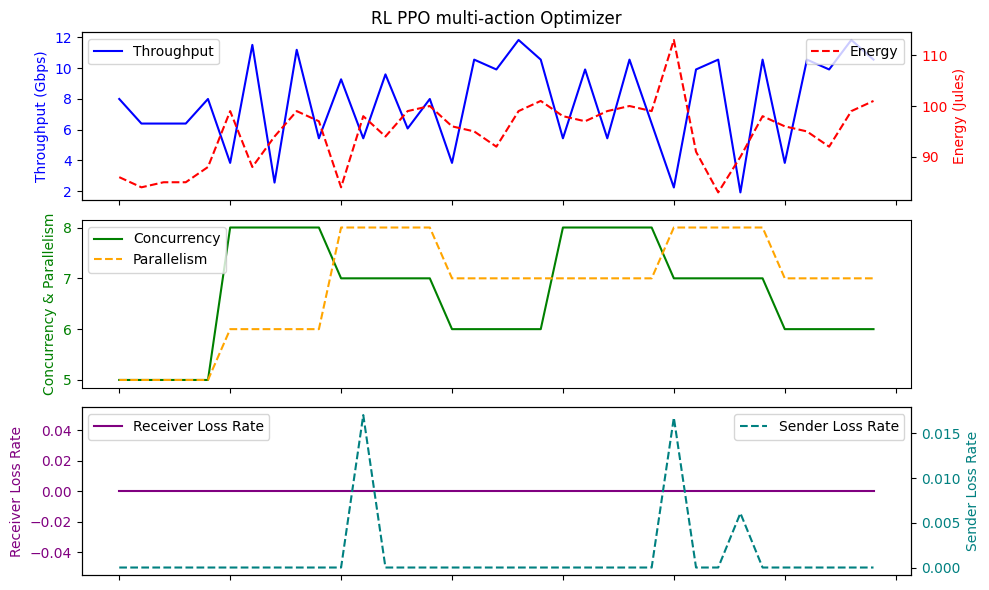

Average Throughput: 7.844571428571428
Total Energy: 3314.0
Total loss rate: 0.03987049594601042
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0   35.00000   
mean   2024-02-19 09:26:24.822846720    7.707429       0.0   -3.00000   
min       2024-02-18 12:03:21.819629    0.640000       0.0 -180.00000   
25%    2024-02-19 05:48:05.444521984    4.960000       0.0    2.00000   
50%    2024-02-19 13:11:55.349267968    8.000000       0.0    3.00000   
75%    2024-02-19 14:04:51.404734208    9.920000       0.0    4.00000   
max       2024-02-19 17:34:49.080551   16.960000       0.0    5.00000   
std                              NaN    3.766650       0.0   31.12404   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.337143   96.914286   0.075528  
min    32.500000   84.000000   0.000000  
25%    32.700000   95.000000   0.000000  
50%    33.000000   98.000000   0.000

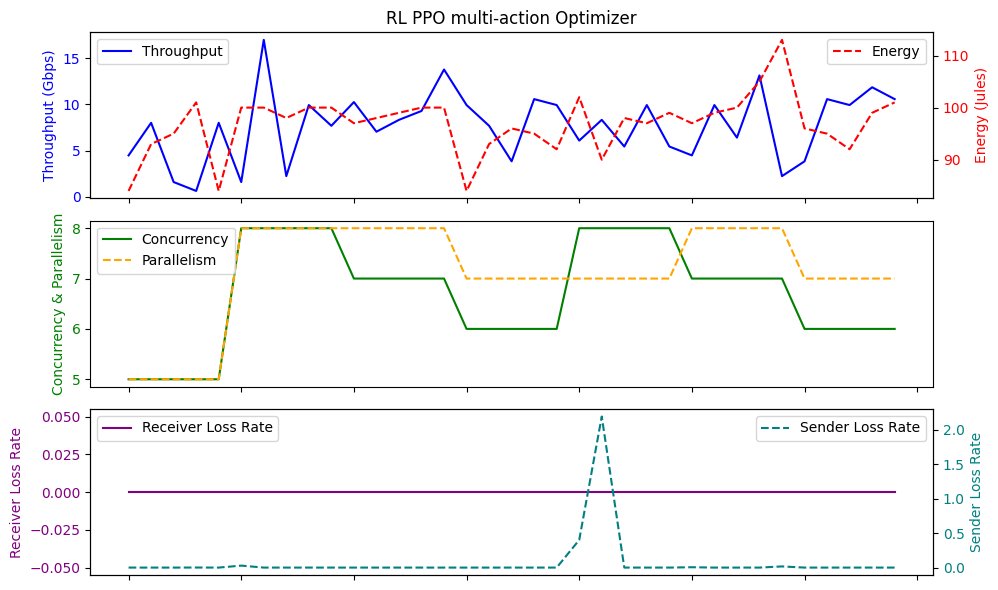

Average Throughput: 7.707428571428571
Total Energy: 3392.0
Total loss rate: 2.64346482857955
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:05:20.164897792    8.338286       0.0   3.028571   
min       2024-02-19 05:24:59.936231    2.240000       0.0  -8.000000   
25%    2024-02-19 05:41:24.758566400    6.400000       0.0   2.000000   
50%    2024-02-19 13:11:57.385806080    8.000000       0.0   3.000000   
75%       2024-02-19 14:04:50.417184   10.560000       0.0   4.000000   
max       2024-02-19 17:04:22.551735   13.440000       0.0   5.000000   
std                              NaN    2.709675       0.0   2.319809   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.448571   94.342857   0.004498  
min    32.500000   82.000000   0.000000  
25%    32.850000   90.000000   0.000000  
50%    33.200000   96.000000   0.000000

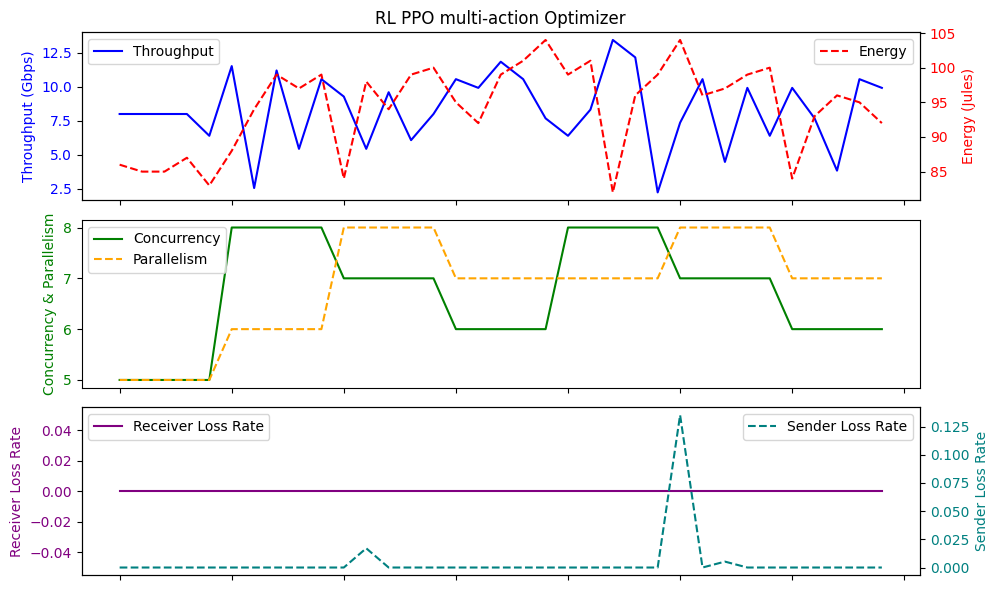

Average Throughput: 8.338285714285716
Total Energy: 3302.0
Total loss rate: 0.15744020127046987
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:49:42.026192128    7.945143       0.0   2.971429   
min       2024-02-18 06:01:59.014488    1.600000       0.0   0.000000   
25%    2024-02-19 05:48:05.444521984    4.320000       0.0   2.000000   
50%    2024-02-19 13:11:55.349267968    8.320000       0.0   3.000000   
75%    2024-02-19 15:23:27.270012160   10.560000       0.0   4.000000   
max       2024-02-19 17:34:52.092254   16.960000       0.0   5.000000   
std                              NaN    3.916482       0.0   1.424279   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.368571   92.914286   0.001472  
min    32.500000   50.000000   0.000000  
25%    32.850000   90.500000   0.000000  
50%    33.100000   96.000000   0.000

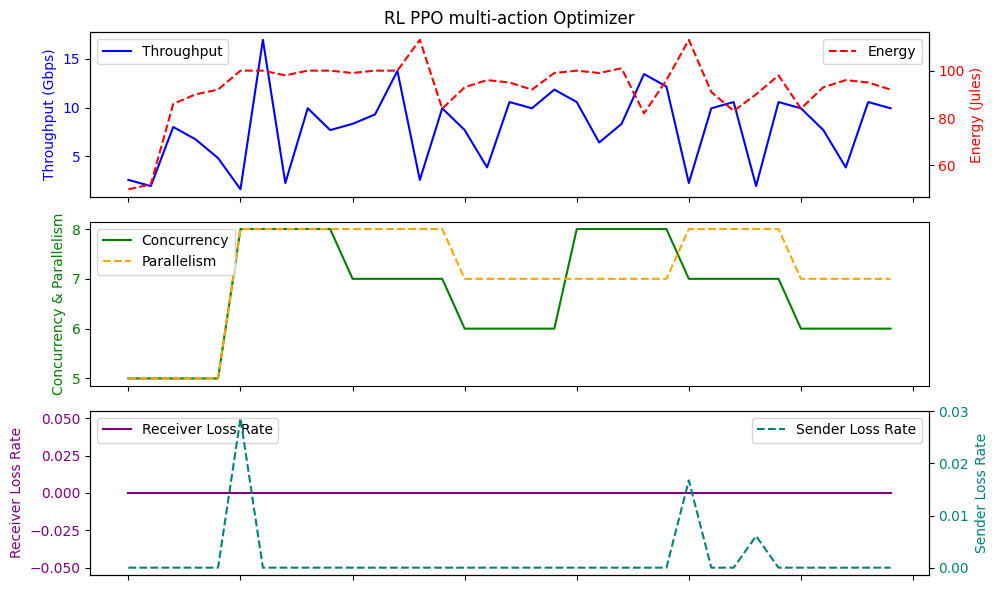

Average Throughput: 7.945142857142857
Total Energy: 3252.0
Total loss rate: 0.051506662716077733
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:56:17.724424192    8.274286       0.0   3.257143   
min       2024-02-18 11:37:12.795143    2.240000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    6.400000       0.0   2.500000   
50%    2024-02-19 13:11:57.385806080    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:11.924465920   10.240000       0.0   4.500000   
max       2024-02-19 17:04:23.552343   13.120000       0.0   5.000000   
std                              NaN    2.797396       0.0   1.421326   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.637143   96.200000   0.000985  
min    32.500000   84.000000   0.000000  
25%    32.700000   92.000000   0.000000  
50%    33.000000   99.000000   0.00

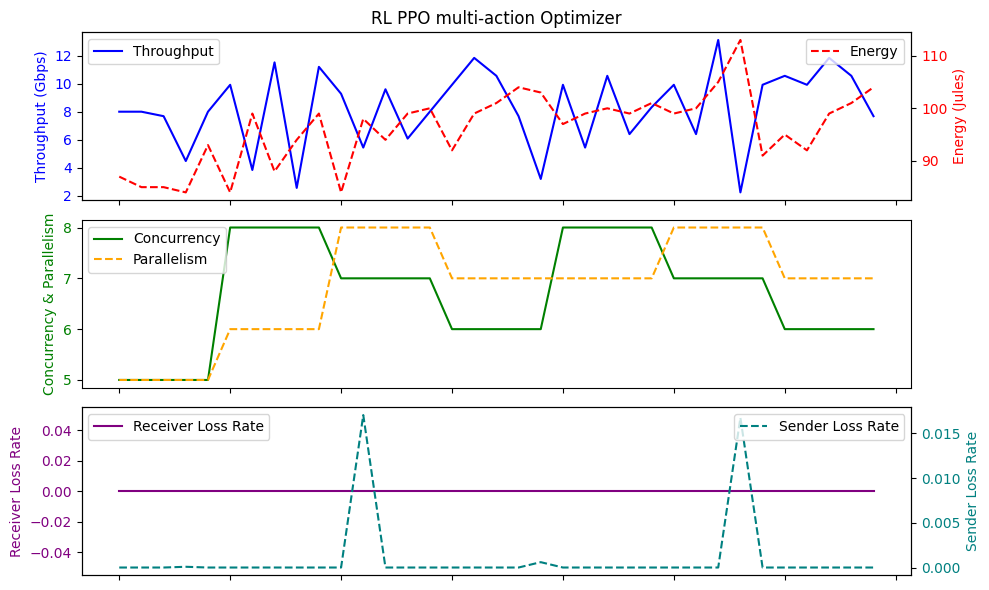

Average Throughput: 8.274285714285714
Total Energy: 3367.0
Total loss rate: 0.034476893096469334
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 11:46:38.496362752    7.698286       0.0   -2.857143   
min       2024-02-19 05:39:08.691687    0.960000       0.0 -180.000000   
25%    2024-02-19 05:41:22.756942848    5.440000       0.0    2.000000   
50%    2024-02-19 13:08:38.464976896    8.000000       0.0    3.000000   
75%    2024-02-19 17:04:23.052039168   10.080000       0.0    4.000000   
max       2024-02-19 17:05:36.989199   15.360000       0.0    5.000000   
std                              NaN    3.390066       0.0   31.145902   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.445714   93.628571   0.074587  
min    32.500000   83.000000   0.000000  
25%    32.850000   87.000000   0.000000  
50%    33.300000   95.0000

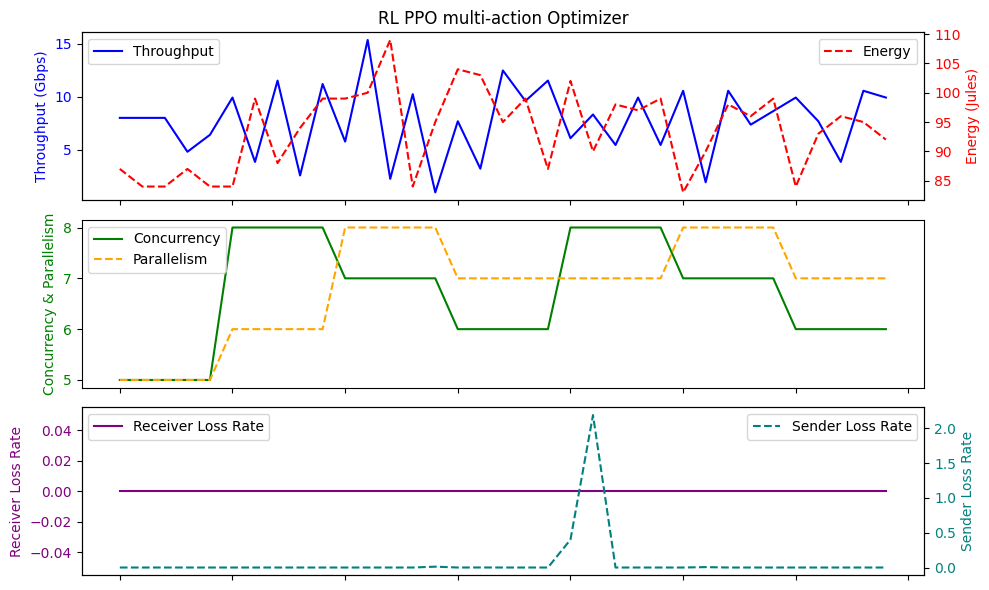

Average Throughput: 7.698285714285714
Total Energy: 3277.0
Total loss rate: 2.610550859109327
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:07:46.781896448    8.146286       0.0   3.171429   
min       2024-02-19 04:44:38.238159    0.320000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    6.400000       0.0   2.000000   
50%    2024-02-19 13:11:55.349267968    8.640000       0.0   3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0   4.500000   
max       2024-02-19 17:05:36.989199   15.360000       0.0   5.000000   
std                              NaN    3.940904       0.0   1.617655   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.917143   93.771429   0.000878  
min    32.500000   80.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.100000   96.000000   0.00000

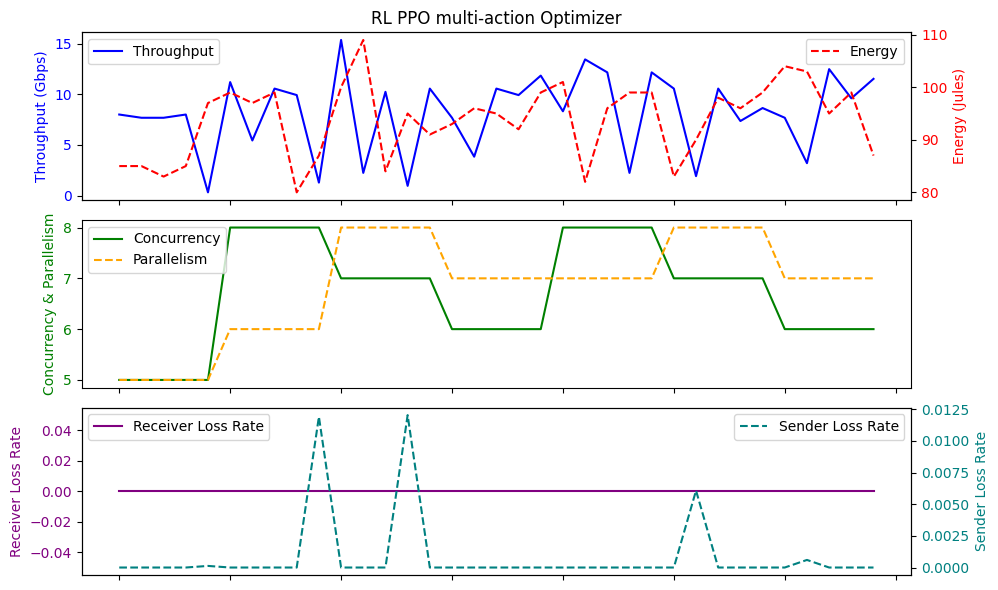

Average Throughput: 8.146285714285716
Total Energy: 3282.0
Total loss rate: 0.03073246568562388
                                Time  Throughput  LossRate     Score  \
count                             35   35.000000      35.0  35.00000   
mean   2024-02-19 13:39:51.468749568    7.698286       0.0   3.00000   
min       2024-02-19 10:25:02.487378    0.960000       0.0   0.00000   
25%    2024-02-19 10:50:45.500434432    4.640000       0.0   1.50000   
50%    2024-02-19 13:11:57.385806080    8.320000       0.0   3.00000   
75%    2024-02-19 17:04:20.554680064   10.560000       0.0   4.00000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   5.00000   
std                              NaN    3.642731       0.0   1.57181   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.368571   93.457143   0.001412  
min    32.500000   80.000000   0.000000  
25%    32.800000   88.500000   0.000000  
50%    33.000000   95.000000   0.000000  
75%

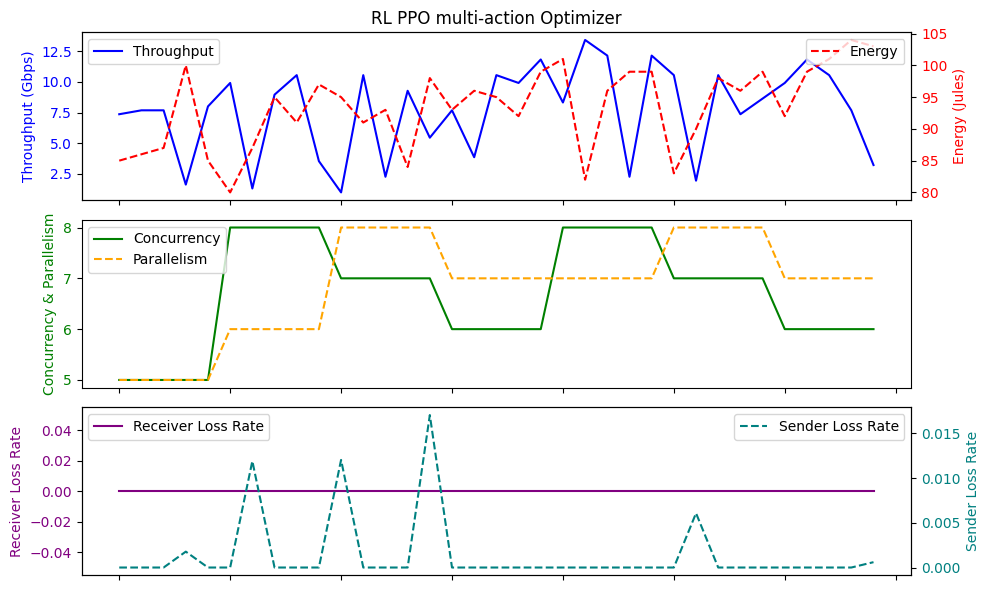

Average Throughput: 7.698285714285714
Total Energy: 3271.0
Total loss rate: 0.049425033892268294
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:09:34.551093248    7.661714       0.0   3.028571   
min       2024-02-19 05:39:08.691687    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.600000       0.0   2.000000   
50%    2024-02-19 13:11:53.354853120    8.320000       0.0   3.000000   
75%    2024-02-19 13:36:50.730347520   10.080000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   5.000000   
std                              NaN    3.331819       0.0   1.403477   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.448571   91.028571   0.000857  
min    32.500000   80.000000   0.000000  
25%    32.800000   84.000000   0.000000  
50%    33.100000   92.000000   0.00

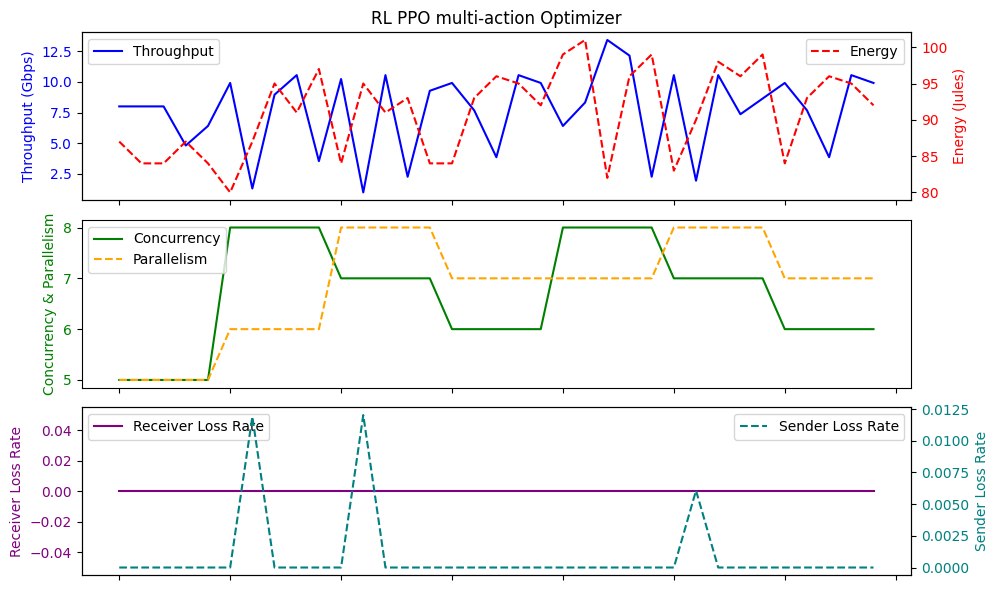

Average Throughput: 7.661714285714287
Total Energy: 3186.0
Total loss rate: 0.03000722579838226
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 12:06:22.821774080    7.442286       0.0   -3.257143   
min       2024-02-19 05:41:23.257360    0.320000       0.0 -180.000000   
25%    2024-02-19 10:25:02.987684608    5.440000       0.0    2.000000   
50%    2024-02-19 13:11:53.354853120    7.680000       0.0    3.000000   
75%    2024-02-19 13:38:22.147302400    9.920000       0.0    4.000000   
max       2024-02-19 17:02:12.422481   11.200000       0.0    5.000000   
std                              NaN    2.854098       0.0   31.122474   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.508571   93.371429   0.078891  
min    32.500000   80.000000   0.000000  
25%    32.800000   88.500000   0.000000  
50%    33.200000   95.00000

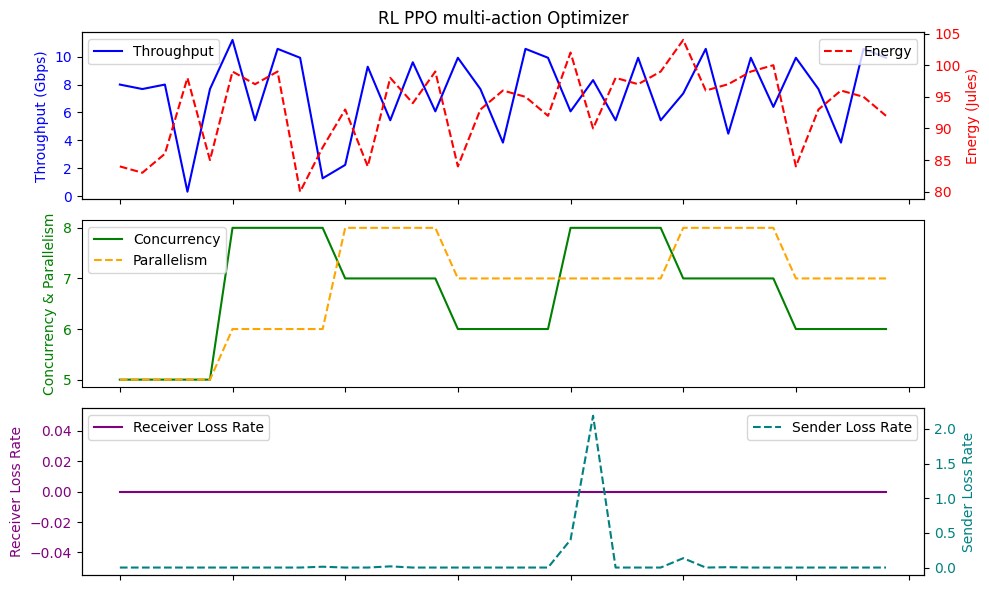

Average Throughput: 7.442285714285715
Total Energy: 3268.0
Total loss rate: 2.7611881784784993
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:34:06.290038528    7.963429       0.0   3.171429   
min       2024-02-18 10:19:22.754335    0.960000       0.0   0.000000   
25%    2024-02-19 09:36:01.316971008    4.800000       0.0   2.000000   
50%    2024-02-19 13:11:54.358995968    8.640000       0.0   3.000000   
75%    2024-02-19 13:21:54.513906432   10.720000       0.0   4.000000   
max       2024-02-19 17:24:08.825891   15.360000       0.0   7.000000   
std                              NaN    4.135145       0.0   1.580873   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.865714   96.542857   0.000507  
min    32.500000   84.000000   0.000000  
25%    32.800000   94.000000   0.000000  
50%    33.100000   99.000000   0.0000

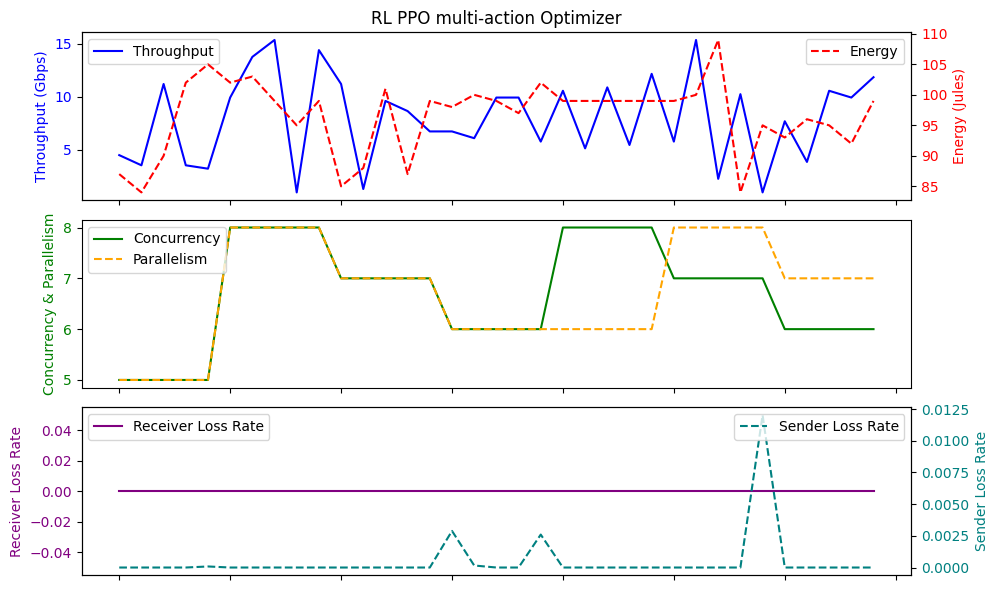

Average Throughput: 7.963428571428571
Total Energy: 3379.0
Total loss rate: 0.017759328339319747
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:21:41.961826048    8.219429       0.0   3.200000   
min       2024-02-19 05:41:19.255238    0.320000       0.0   0.000000   
25%    2024-02-19 07:47:40.741041408    6.880000       0.0   2.000000   
50%    2024-02-19 17:02:09.412815104    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0   4.500000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   5.000000   
std                              NaN    3.120684       0.0   1.471294   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.334286   94.314286   0.000678  
min    32.500000   82.000000   0.000000  
25%    32.900000   87.500000   0.000000  
50%    33.300000   98.000000   0.00

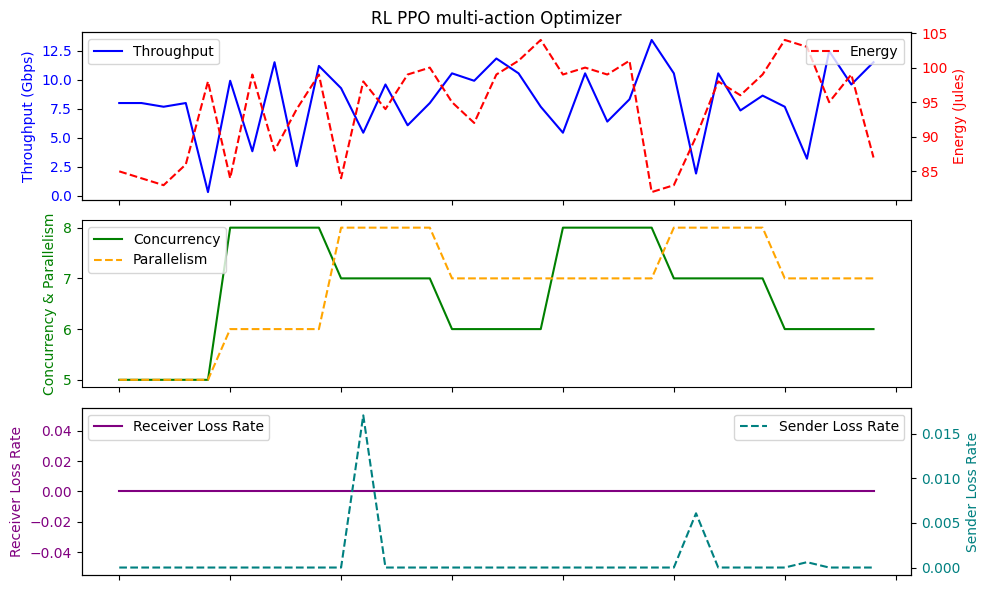

Average Throughput: 8.21942857142857
Total Energy: 3301.0
Total loss rate: 0.02371676358176834
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:25:47.877086464    7.945143       0.0   3.114286   
min       2024-02-19 05:41:20.260860    0.960000       0.0   0.000000   
25%    2024-02-19 08:13:25.169146112    5.120000       0.0   2.000000   
50%    2024-02-19 13:11:55.349267968    8.640000       0.0   3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   5.000000   
std                              NaN    3.517848       0.0   1.450587   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.100000   92.571429   0.000534  
min    32.600000   81.000000   0.000000  
25%    32.900000   86.000000   0.000000  
50%    33.200000   94.000000   0.0000

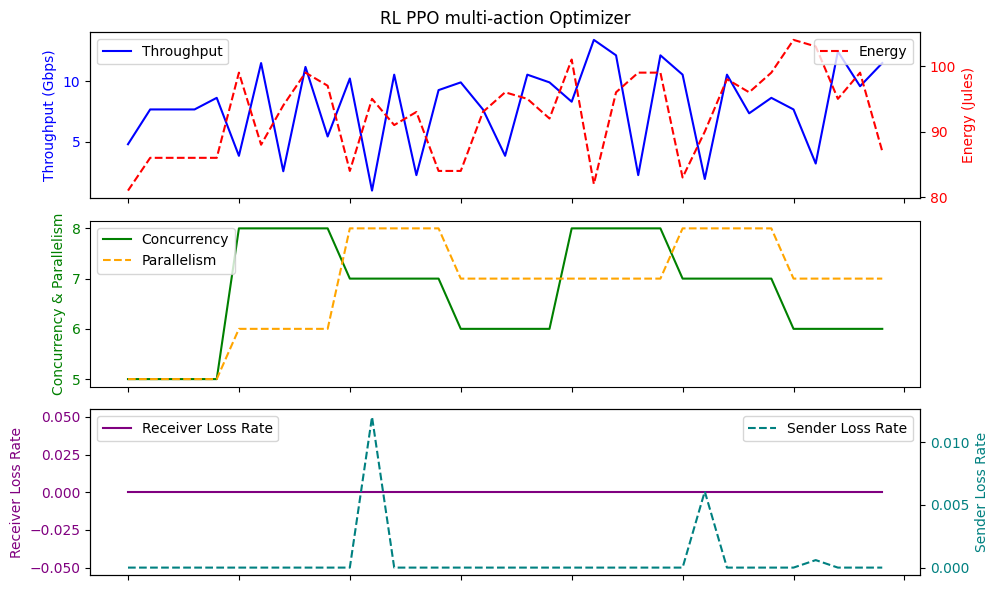

Average Throughput: 7.945142857142859
Total Energy: 3240.0
Total loss rate: 0.018704477537487656
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 10:35:18.216696320    8.091429       0.0   -2.057143   
min       2024-02-18 08:36:17.544637    1.280000       0.0 -180.000000   
25%    2024-02-19 10:25:05.993165056    7.360000       0.0    2.000000   
50%    2024-02-19 13:11:57.385806080    8.320000       0.0    3.000000   
75%    2024-02-19 17:04:21.558568960   10.240000       0.0    4.000000   
max       2024-02-19 17:05:36.989199   11.840000       0.0    5.000000   
std                              NaN    2.690298       0.0   30.992355   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.737143   94.171429   0.063614  
min    32.500000   80.000000   0.000000  
25%    32.700000   89.000000   0.000000  
50%    33.100000   96.0000

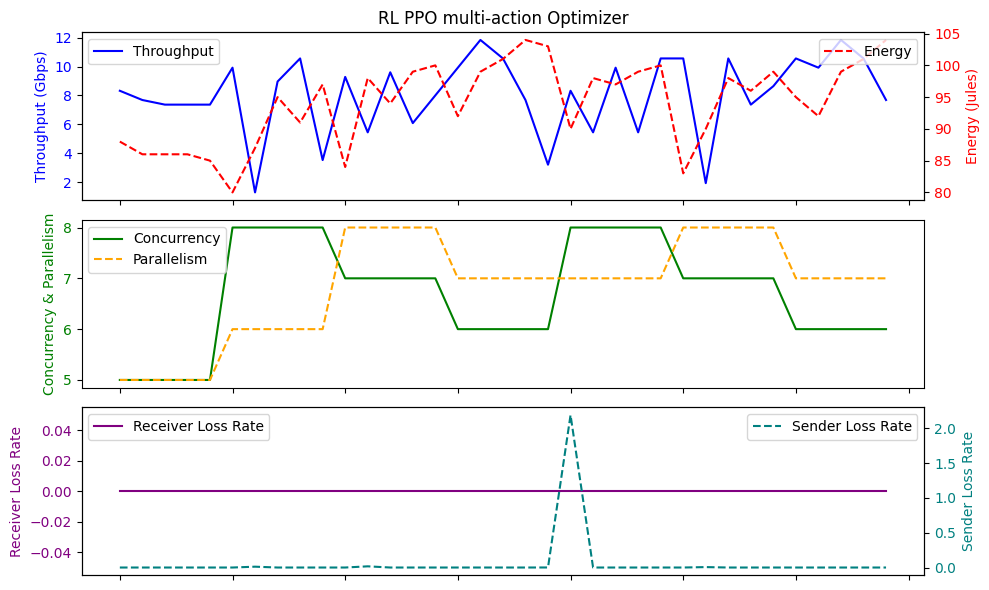

Average Throughput: 8.09142857142857
Total Energy: 3296.0
Total loss rate: 2.226490714815772
                                Time  Throughput  LossRate       Score  \
count                             40   40.000000      40.0   40.000000   
mean   2024-02-19 12:59:48.720697344    7.392000       0.0   -1.850000   
min       2024-02-19 05:48:00.921855    1.600000       0.0 -180.000000   
25%    2024-02-19 11:28:54.302042880    3.680000       0.0    1.000000   
50%    2024-02-19 13:11:55.852135936    7.680000       0.0    3.000000   
75%    2024-02-19 17:04:41.664126208   10.560000       0.0    4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0    5.000000   
std                              NaN    3.986142       0.0   28.925678   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.950000   96.375000   0.056019  
min    32.500000   82.000000   0.000000  
25%    32.775000   93.000000   0.000000  
50%    33.100000   98.000000  

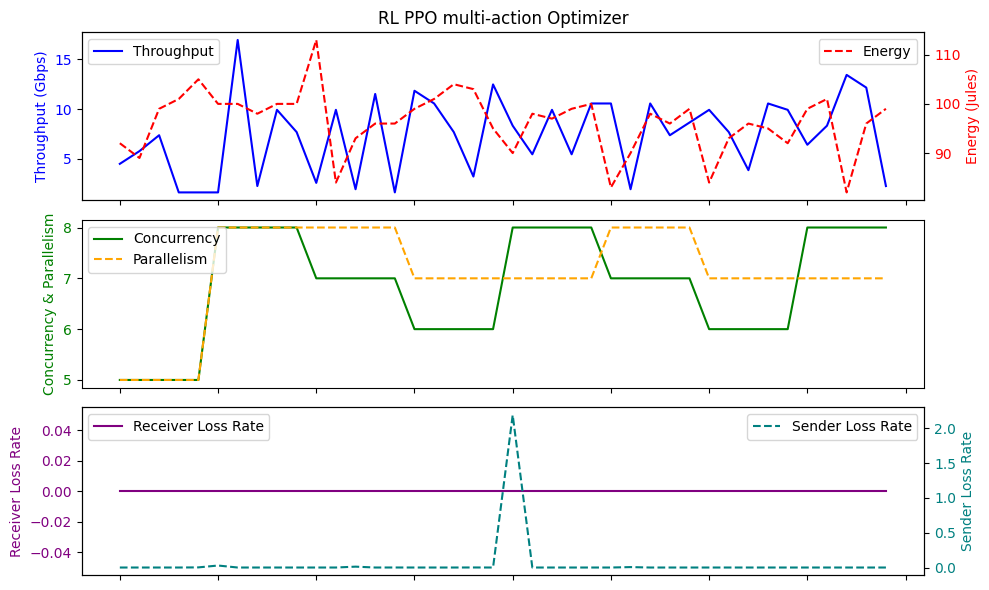

Average Throughput: 7.391999999999999
Total Energy: 3855.0
Total loss rate: 2.2407662639288435
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 12:25:04.583397376    7.835429       0.0   -2.771429   
min       2024-02-19 05:41:19.255238    0.960000       0.0 -180.000000   
25%    2024-02-19 05:45:02.969531392    5.760000       0.0    1.500000   
50%    2024-02-19 13:08:39.484028928    8.000000       0.0    3.000000   
75%    2024-02-19 17:04:22.551735040   10.560000       0.0    5.000000   
max       2024-02-19 17:05:36.989199   12.480000       0.0    5.000000   
std                              NaN    3.220987       0.0   31.167560   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.848571   93.971429   0.074604  
min    32.500000   83.000000   0.000000  
25%    32.850000   87.000000   0.000000  
50%    33.300000   95.000000

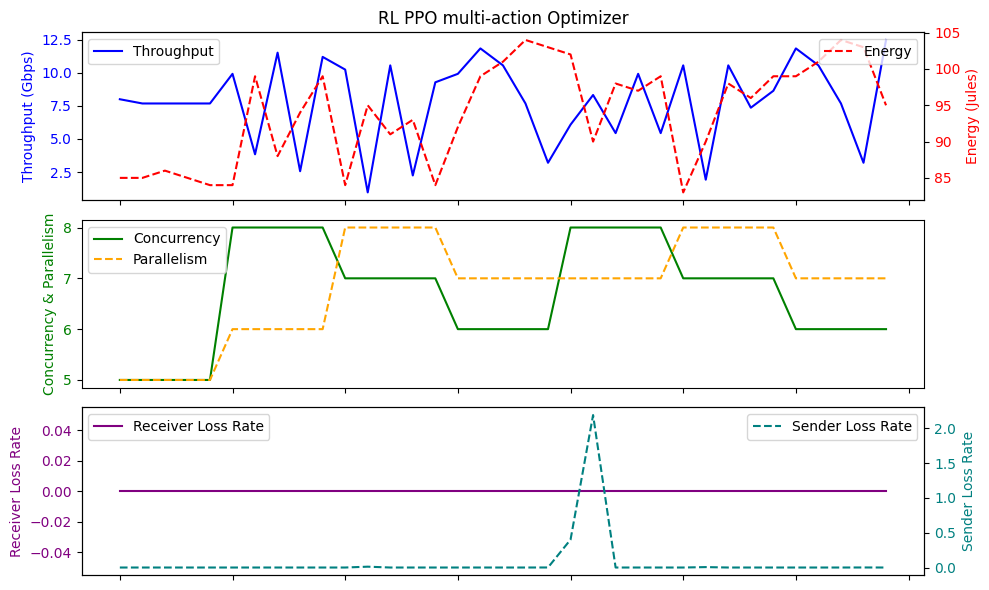

Average Throughput: 7.835428571428571
Total Energy: 3289.0
Total loss rate: 2.611149706484623
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:58:45.166758656    8.182857       0.0   3.142857   
min       2024-02-19 05:27:28.558535    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:03.992217344    6.240000       0.0   2.000000   
50%    2024-02-19 14:01:44.074888960    8.320000       0.0   3.000000   
75%    2024-02-19 17:02:12.922888960   10.560000       0.0   4.000000   
max       2024-02-19 17:05:33.979979   13.440000       0.0   5.000000   
std                              NaN    3.253469       0.0   1.437785   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.177143   93.885714   0.001499  
min    32.500000   80.000000   0.000000  
25%    32.850000   87.000000   0.000000  
50%    33.000000   95.000000   0.00000

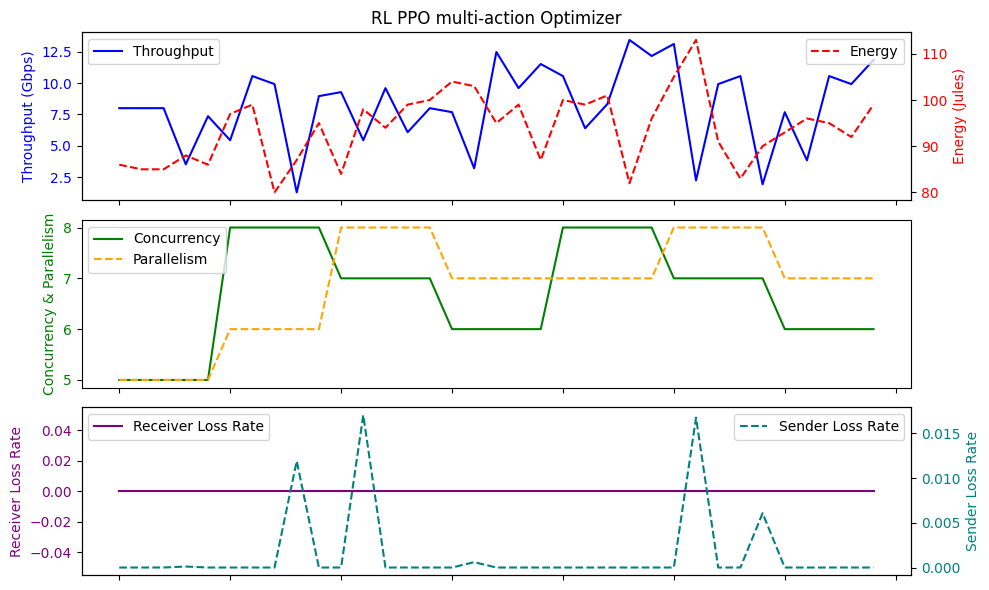

Average Throughput: 8.182857142857141
Total Energy: 3286.0
Total loss rate: 0.05248213773325101
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:55:39.868559616    7.625143       0.0   2.942857   
min       2024-02-19 05:26:40.001941    1.920000       0.0   1.000000   
25%    2024-02-19 05:41:22.756942848    5.440000       0.0   2.000000   
50%    2024-02-19 17:02:09.412815104    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:23.552343040   10.240000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   12.480000       0.0   5.000000   
std                              NaN    3.179687       0.0   1.370763   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.454286   92.000000   0.000695  
min    32.500000   56.000000   0.000000  
25%    32.850000   87.500000   0.000000  
50%    33.400000   97.000000   0.000

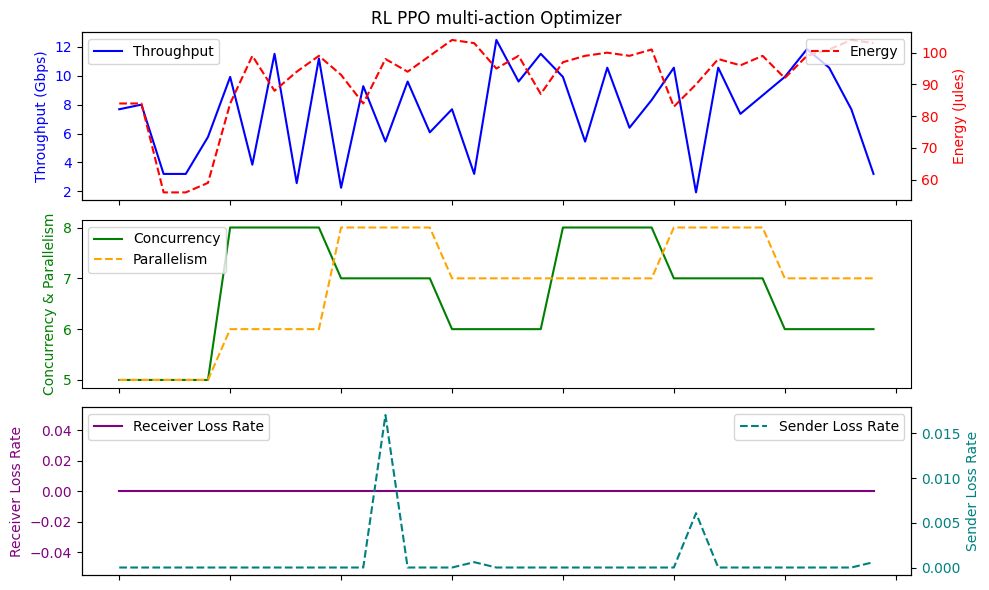

Average Throughput: 7.6251428571428574
Total Energy: 3220.0
Total loss rate: 0.02431561095706411
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 13:59:31.808472576    8.000000       0.0   -2.114286   
min       2024-02-19 05:41:19.255238    2.240000       0.0 -180.000000   
25%    2024-02-19 13:08:39.981717504    5.440000       0.0    2.000000   
50%    2024-02-19 14:04:51.905487104    8.640000       0.0    3.000000   
75%    2024-02-19 17:02:11.924465920   10.560000       0.0    4.000000   
max       2024-02-19 17:04:23.552343   13.120000       0.0    6.000000   
std                              NaN    3.108334       0.0   30.988396   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.777143   96.542857   0.063267  
min    32.500000   84.000000   0.000000  
25%    32.800000   93.500000   0.000000  
50%    33.400000   98.0000

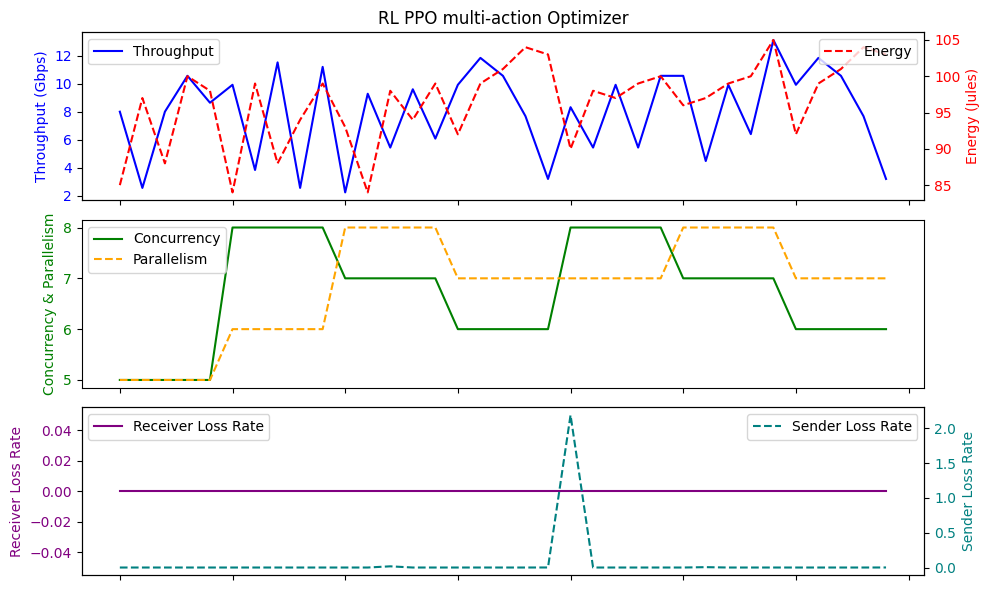

Average Throughput: 8.0
Total Energy: 3379.0
Total loss rate: 2.2143519493929658
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:47:28.812881664    8.155429       0.0   3.200000   
min       2024-02-19 05:41:19.255238    0.960000       0.0   0.000000   
25%    2024-02-19 10:24:47.775417088    5.120000       0.0   1.500000   
50%    2024-02-19 13:11:57.385806080    9.600000       0.0   3.000000   
75%    2024-02-19 17:04:21.056624384   10.880000       0.0   4.000000   
max       2024-02-19 17:05:33.979979   13.440000       0.0   8.000000   
std                              NaN    3.865306       0.0   1.778962   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.188571   94.228571   0.001013  
min    32.500000   82.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.000000   95.000000   0.000000  
75%    33

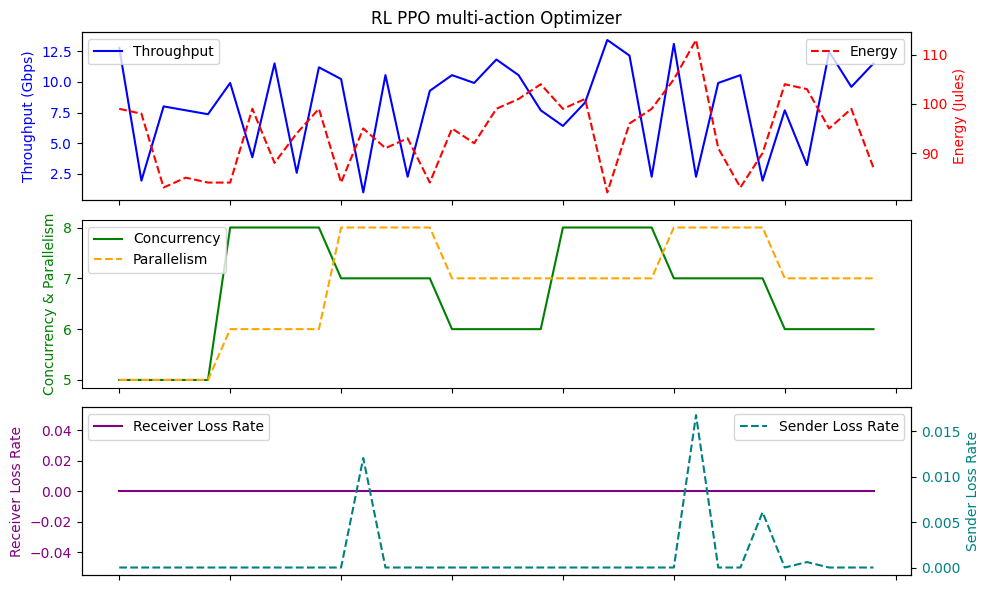

Average Throughput: 8.15542857142857
Total Energy: 3298.0
Total loss rate: 0.03545705727702551
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 11:52:41.698356736    7.835429       0.0   -2.085714   
min       2024-02-19 05:10:40.396917    0.960000       0.0 -180.000000   
25%    2024-02-19 05:41:23.758746112    5.440000       0.0    2.000000   
50%    2024-02-19 13:08:41.471494912    8.000000       0.0    3.000000   
75%    2024-02-19 17:02:09.912956416   10.560000       0.0    4.500000   
max       2024-02-19 17:05:36.989199   11.840000       0.0    5.000000   
std                              NaN    3.019244       0.0   30.992761   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.682857   93.400000   0.063601  
min    32.500000   83.000000   0.000000  
25%    32.950000   89.000000   0.000000  
50%    33.400000   95.000000

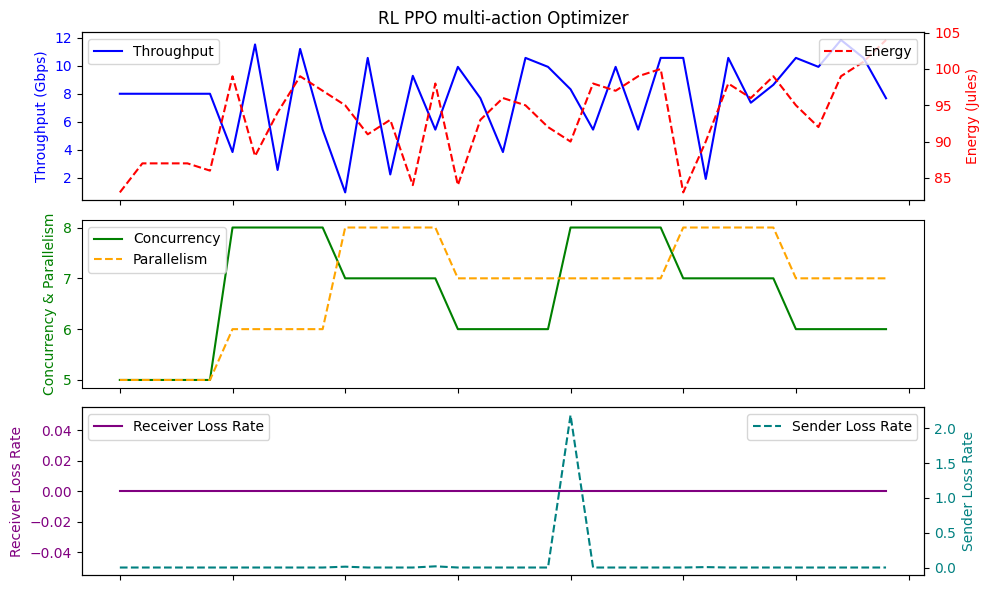

Average Throughput: 7.835428571428571
Total Energy: 3269.0
Total loss rate: 2.2260211053177215
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:15:09.814334464    8.045714       0.0   3.114286   
min       2024-02-19 05:31:13.992795    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    5.920000       0.0   2.000000   
50%    2024-02-19 13:11:57.385806080    8.320000       0.0   4.000000   
75%    2024-02-19 14:04:52.406666240   10.560000       0.0   4.000000   
max       2024-02-19 17:04:27.553372   13.440000       0.0   5.000000   
std                              NaN    3.409732       0.0   1.470723   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.231429   93.800000   0.001631  
min    32.500000   80.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.000000   95.000000   0.0000

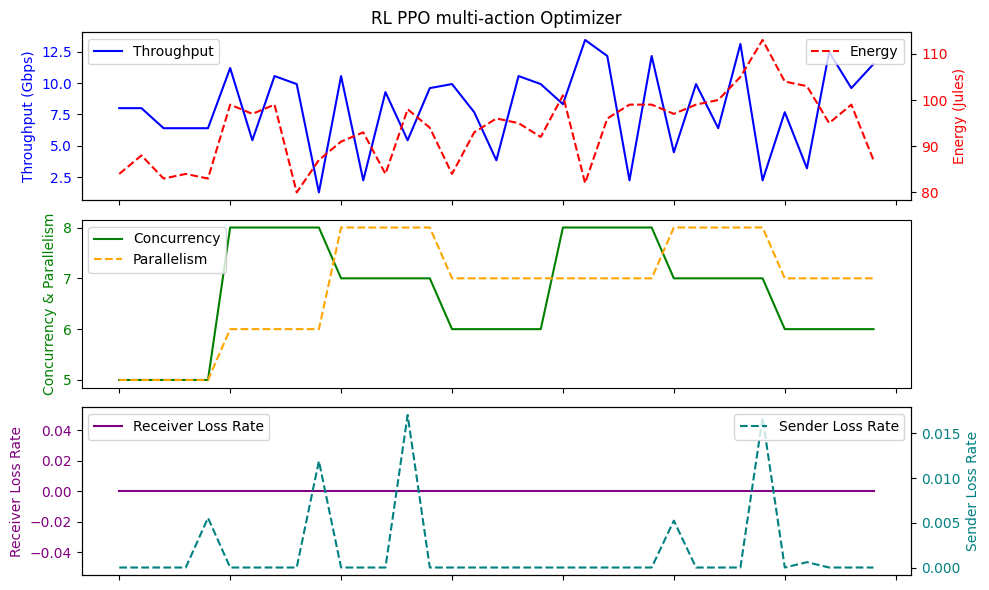

Average Throughput: 8.045714285714286
Total Energy: 3283.0
Total loss rate: 0.05708450235054292
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 13:03:29.526848256    7.707429       0.0   -3.171429   
min       2024-02-19 05:40:48.975511    1.280000       0.0 -180.000000   
25%    2024-02-19 10:25:05.993165056    6.080000       0.0    2.000000   
50%    2024-02-19 13:11:56.355003904    8.000000       0.0    3.000000   
75%    2024-02-19 17:02:10.919774464    9.920000       0.0    4.000000   
max       2024-02-19 17:04:25.555316   12.480000       0.0    5.000000   
std                              NaN    2.631211       0.0   31.136781   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.382857   94.457143   0.079047  
min    32.500000   80.000000   0.000000  
25%    32.700000   90.500000   0.000000  
50%    32.900000   96.00000

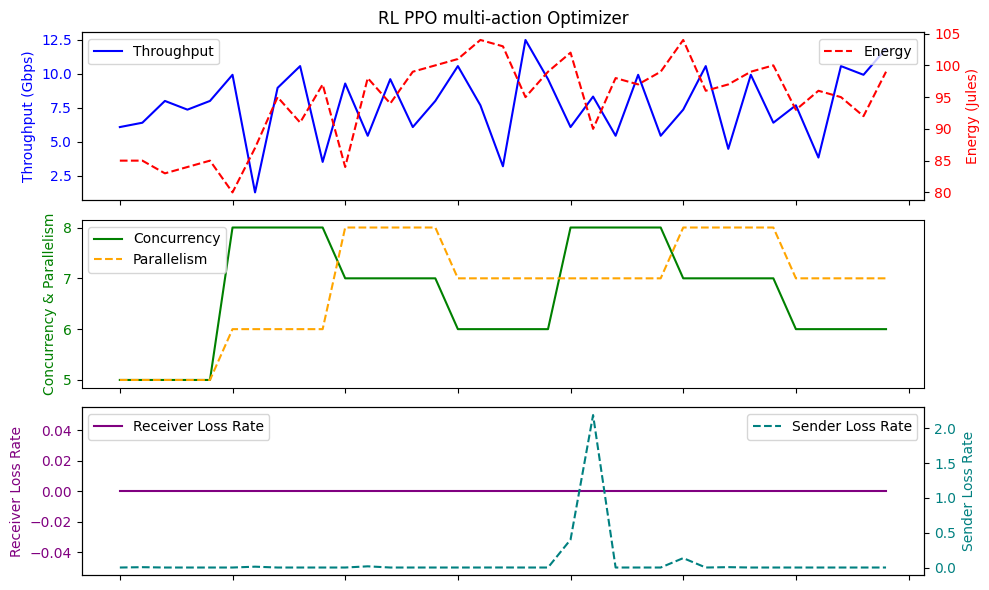

Average Throughput: 7.707428571428571
Total Energy: 3306.0
Total loss rate: 2.7666351509156337
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:17:14.953418496    7.972571       0.0   2.742857   
min       2024-02-18 11:11:00.803865    0.960000       0.0  -8.000000   
25%    2024-02-19 05:41:23.758746112    5.440000       0.0   1.500000   
50%    2024-02-19 13:08:42.474106112    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   10.560000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.649693       0.0   2.429510   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.634286   95.685714   0.004389  
min    32.500000   82.000000   0.000000  
25%    32.800000   89.500000   0.000000  
50%    33.000000   99.000000   0.0000

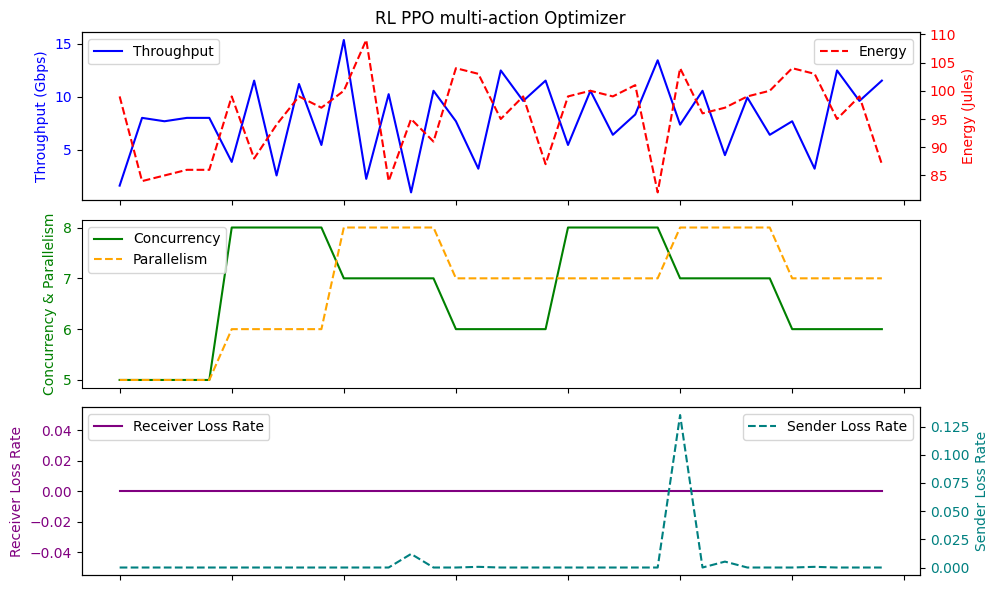

Average Throughput: 7.972571428571429
Total Energy: 3349.0
Total loss rate: 0.15362560997678074
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:46:49.273394176    7.945143       0.0   3.114286   
min       2024-02-18 12:55:34.967532    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    5.600000       0.0   2.000000   
50%    2024-02-19 13:11:54.358995968    8.000000       0.0   3.000000   
75%    2024-02-19 14:04:51.404734208   10.560000       0.0   4.000000   
max       2024-02-19 17:04:23.552343   13.120000       0.0   5.000000   
std                              NaN    2.997333       0.0   1.367080   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.542857   94.428571   0.000994  
min    32.500000   80.000000   0.000000  
25%    32.700000   91.500000   0.000000  
50%    32.900000   97.000000   0.000

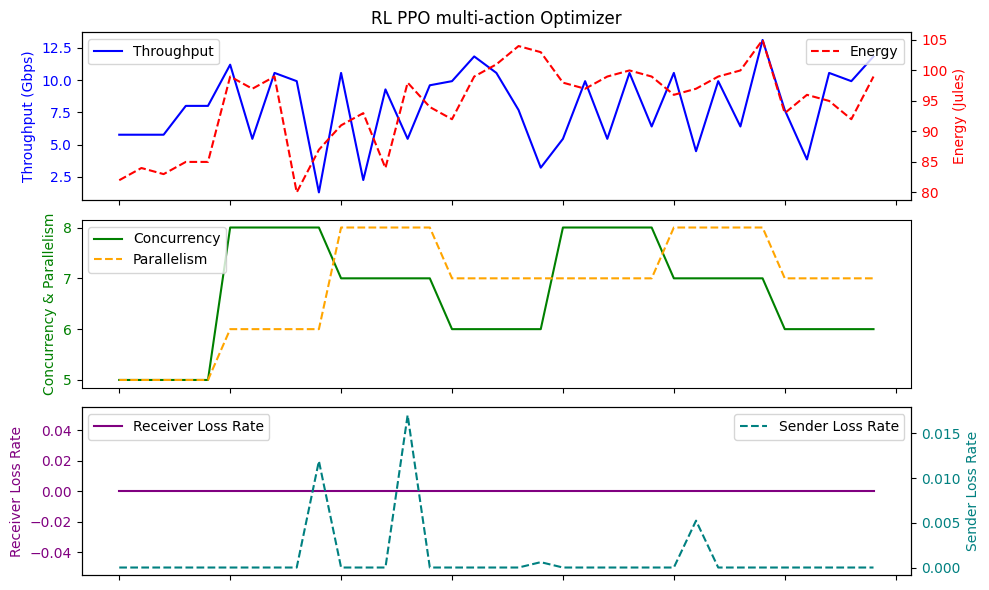

Average Throughput: 7.945142857142857
Total Energy: 3305.0
Total loss rate: 0.03478234205604701
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 11:55:56.009747712    7.524571       0.0   -2.942857   
min       2024-02-19 05:41:24.260132    0.640000       0.0 -180.000000   
25%    2024-02-19 10:25:03.992217344    5.440000       0.0    1.500000   
50%    2024-02-19 13:08:38.464976896    8.000000       0.0    3.000000   
75%    2024-02-19 14:04:52.406666240   10.080000       0.0    4.500000   
max       2024-02-19 17:05:33.979979   15.360000       0.0    5.000000   
std                              NaN    3.732916       0.0   31.140991   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.477143   94.828571   0.075407  
min    32.500000   80.000000   0.000000  
25%    32.700000   90.000000   0.000000  
50%    33.000000   95.00000

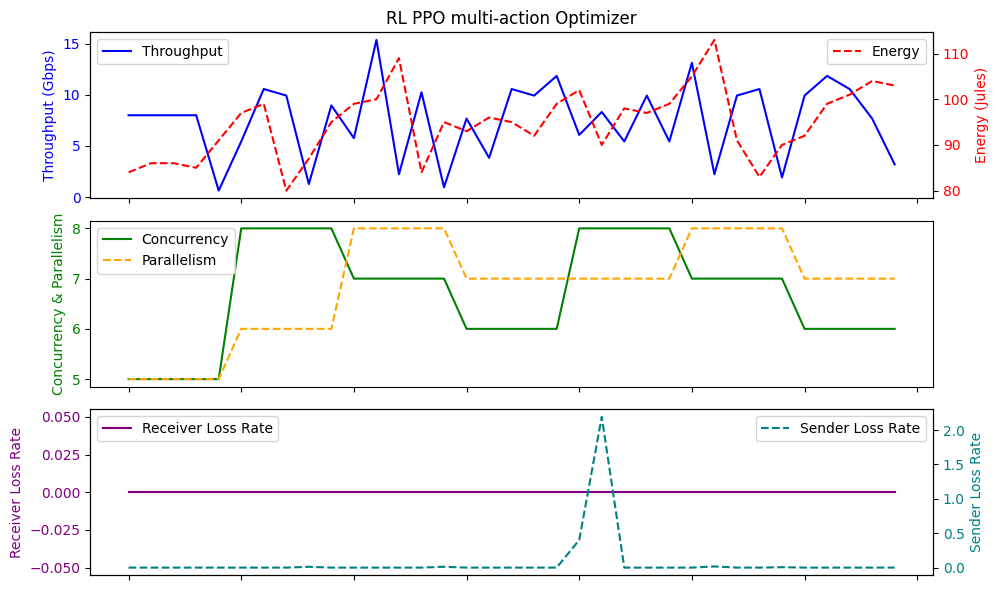

Average Throughput: 7.524571428571429
Total Energy: 3319.0
Total loss rate: 2.6392522083160572
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:14:06.047126272    7.725714       0.0   2.742857   
min       2024-02-19 05:35:23.552147    0.960000       0.0  -8.000000   
25%    2024-02-19 10:25:05.993165056    5.440000       0.0   2.000000   
50%    2024-02-19 13:08:40.479406080    7.680000       0.0   3.000000   
75%    2024-02-19 14:04:49.426578944   10.400000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   15.360000       0.0   5.000000   
std                              NaN    3.442258       0.0   2.429510   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.868571   94.200000   0.004712  
min    32.500000   57.000000   0.000000  
25%    32.700000   89.000000   0.000000  
50%    32.900000   97.000000   0.0000

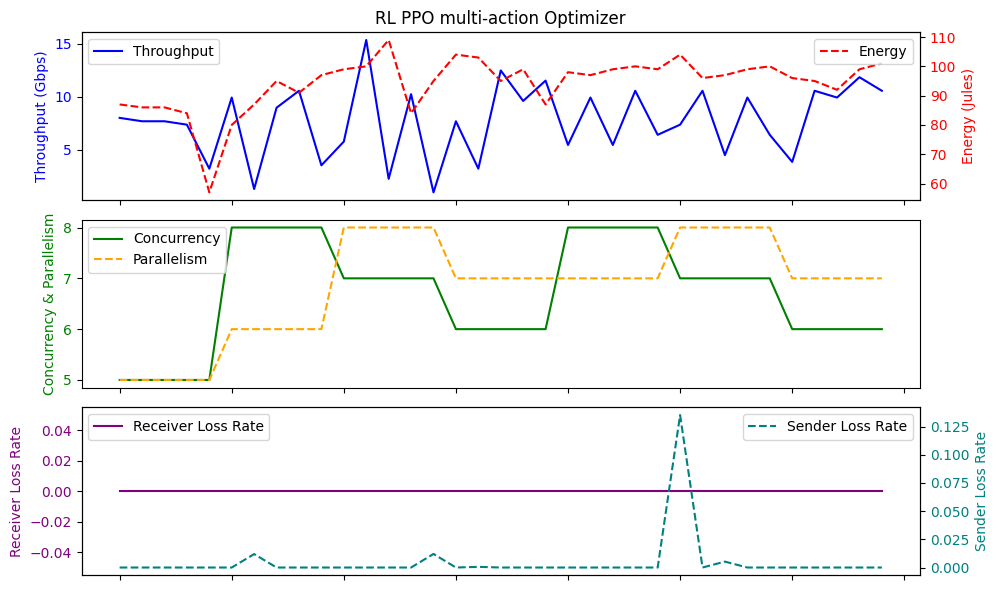

Average Throughput: 7.725714285714285
Total Energy: 3297.0
Total loss rate: 0.16492835823767535
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:39:41.859420928    8.365714       0.0   3.171429   
min       2024-02-19 05:41:24.260132    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:03.992217344    6.400000       0.0   2.000000   
50%    2024-02-19 13:08:43.479414016    9.600000       0.0   3.000000   
75%    2024-02-19 17:04:22.551735040   11.040000       0.0   4.000000   
max       2024-02-19 17:05:33.979979   15.360000       0.0   7.000000   
std                              NaN    3.881457       0.0   1.688816   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.762857   95.542857   0.002114  
min    32.500000   80.000000   0.000000  
25%    32.750000   90.500000   0.000000  
50%    33.000000   96.000000   0.000

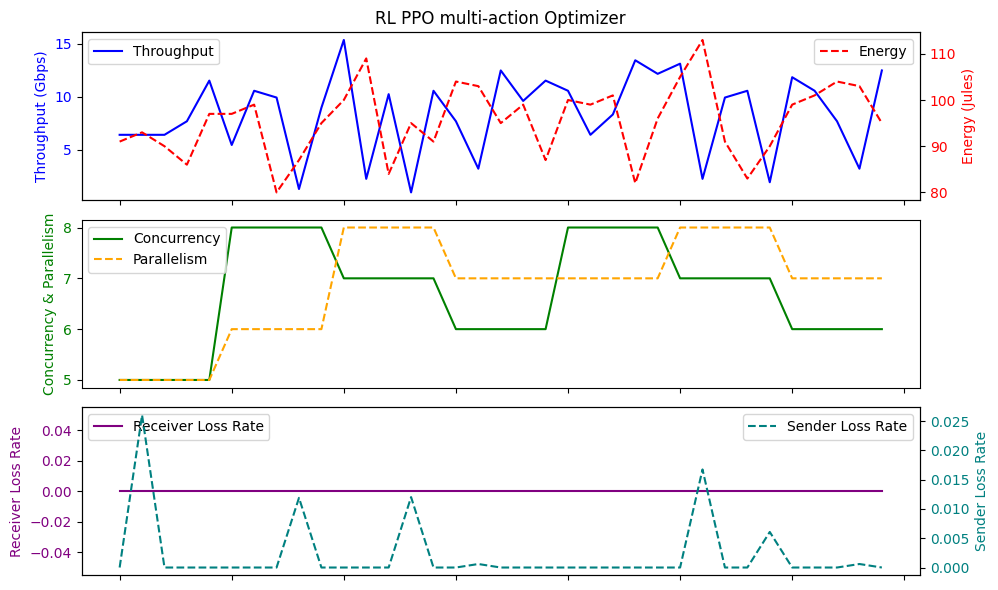

Average Throughput: 8.365714285714287
Total Energy: 3344.0
Total loss rate: 0.07399916695517832
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 12:38:29.919215872    7.506286       0.0   -3.285714   
min       2024-02-19 05:25:24.602203    0.960000       0.0 -180.000000   
25%    2024-02-19 10:25:03.992217344    5.440000       0.0    1.000000   
50%    2024-02-19 13:08:40.479406080    7.680000       0.0    3.000000   
75%    2024-02-19 17:04:22.551735040    9.920000       0.0    4.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0    5.000000   
std                              NaN    3.077508       0.0   31.118910   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.528571   94.114286   0.079355  
min    32.500000   80.000000   0.000000  
25%    32.700000   87.000000   0.000000  
50%    32.900000   96.00000

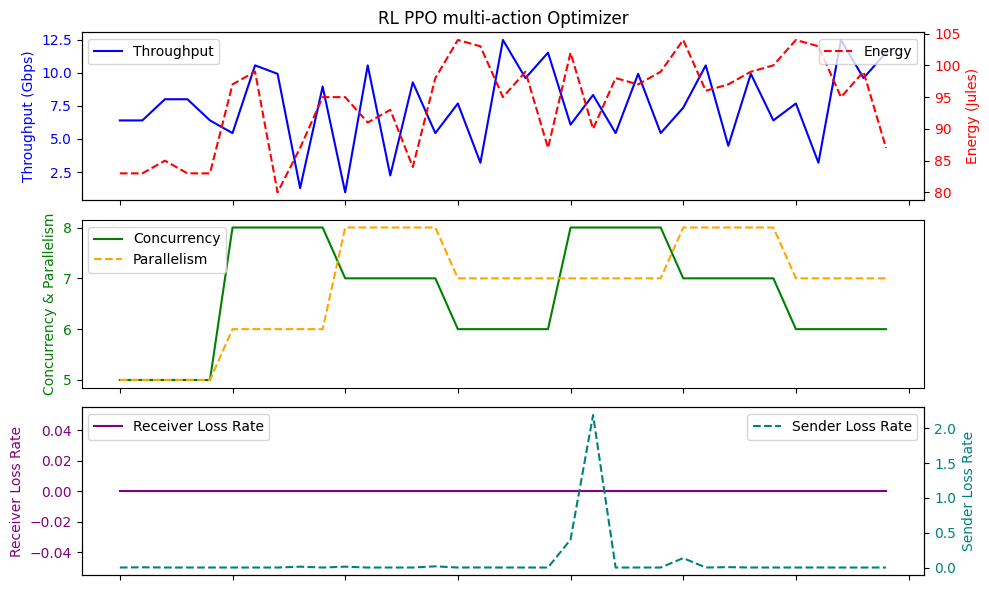

Average Throughput: 7.506285714285713
Total Energy: 3294.0
Total loss rate: 2.7774093187316784
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:52:20.083107840    7.762286       0.0   2.971429   
min       2024-02-18 09:02:28.330385    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.760000       0.0   2.000000   
50%    2024-02-19 17:02:10.413097984    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:23.552343040    9.920000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   12.480000       0.0   6.000000   
std                              NaN    3.036127       0.0   1.444782   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.254286   95.000000   0.001040  
min    32.500000   80.000000   0.000000  
25%    32.850000   90.500000   0.000000  
50%    33.000000   97.000000   0.0000

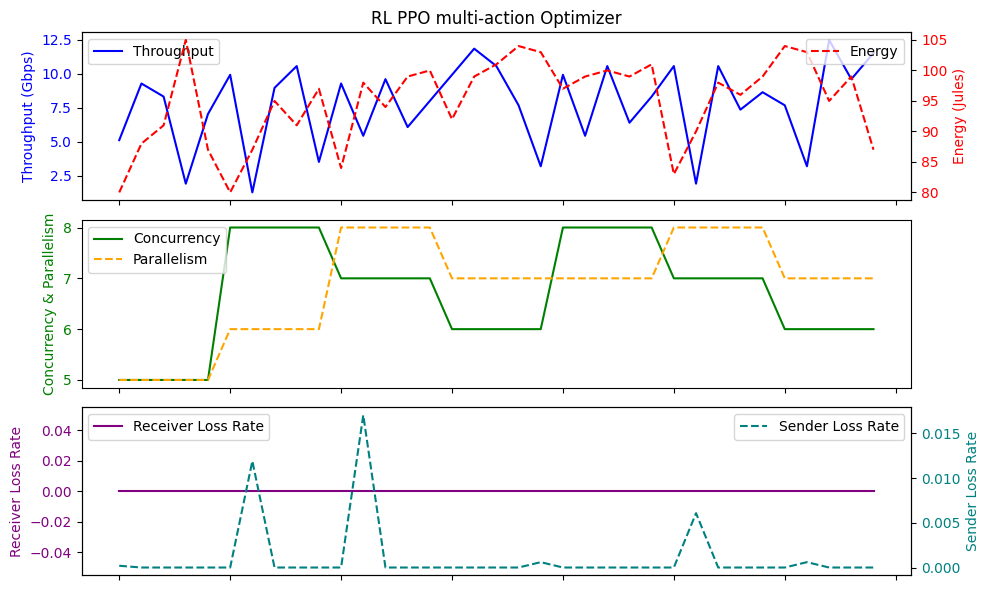

Average Throughput: 7.7622857142857145
Total Energy: 3325.0
Total loss rate: 0.03641246788075163
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 13:38:21.952421888    7.808000       0.0   -2.200000   
min       2024-02-19 05:31:37.455807    1.280000       0.0 -180.000000   
25%    2024-02-19 10:25:03.992217344    5.760000       0.0    2.000000   
50%    2024-02-19 17:02:11.426450944    8.000000       0.0    3.000000   
75%    2024-02-19 17:04:24.559545088    9.920000       0.0    4.000000   
max       2024-02-19 17:05:36.989199   12.480000       0.0    5.000000   
std                              NaN    2.915545       0.0   30.966585   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.128571   93.371429   0.063790  
min    32.500000   57.000000   0.000000  
25%    32.800000   87.000000   0.000000  
50%    33.000000   97.0000

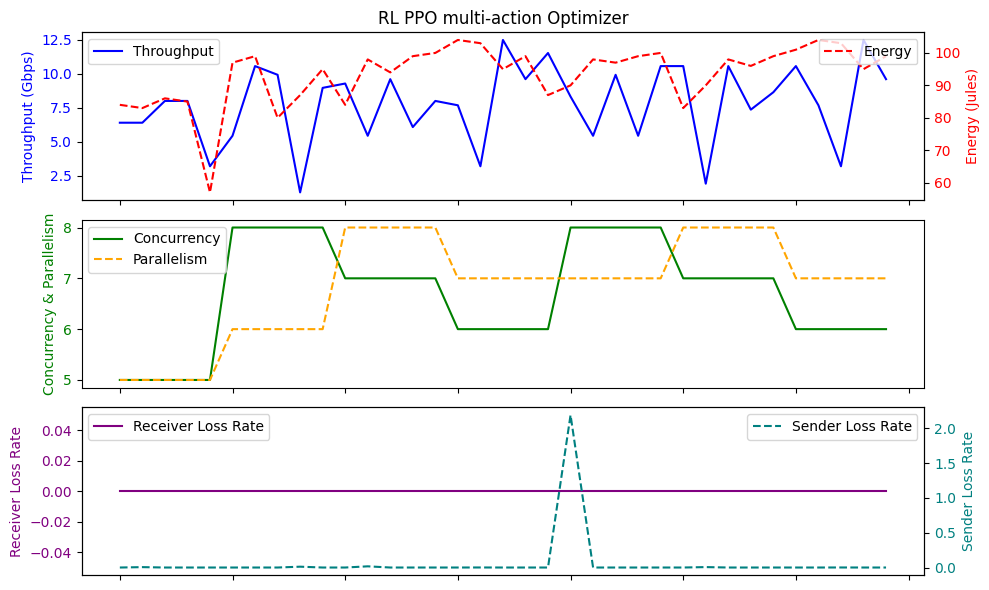

Average Throughput: 7.808000000000001
Total Energy: 3268.0
Total loss rate: 2.232639142746026
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:16:15.669285376    8.036571       0.0   3.142857   
min       2024-02-19 05:41:19.255238    1.920000       0.0   1.000000   
25%    2024-02-19 05:47:19.729296640    6.240000       0.0   2.000000   
50%    2024-02-19 17:02:11.426450944    8.000000       0.0   3.000000   
75%    2024-02-19 17:04:25.057430528   10.240000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   12.480000       0.0   5.000000   
std                              NaN    2.887073       0.0   1.396274   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.900000   94.485714   0.000695  
min    32.600000   83.000000   0.000000  
25%    32.900000   87.500000   0.000000  
50%    33.400000   97.000000   0.00000

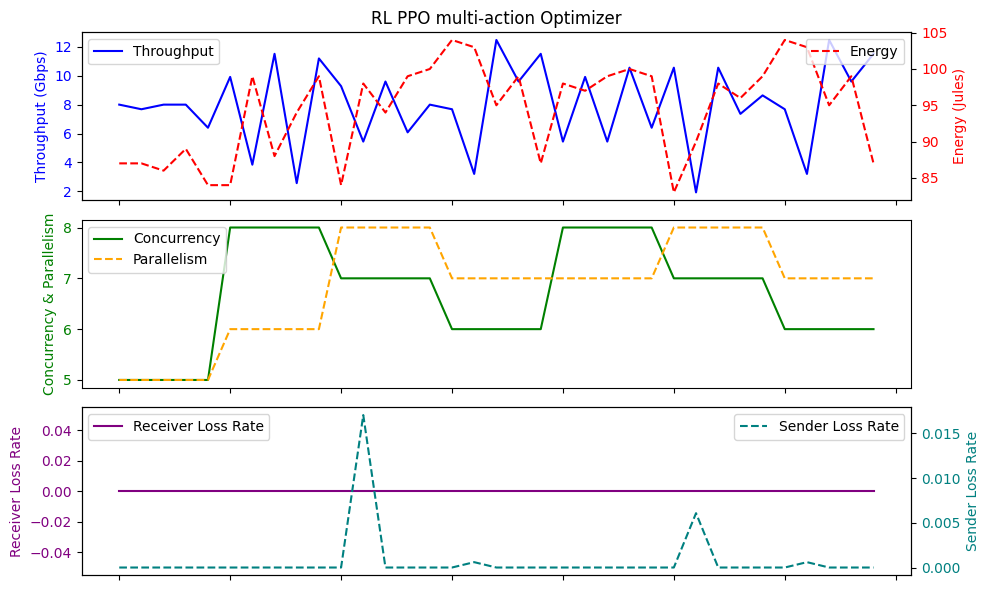

Average Throughput: 8.03657142857143
Total Energy: 3307.0
Total loss rate: 0.024315610957064113
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 12:49:03.504607744    8.091429       0.0   -3.000000   
min       2024-02-19 05:37:29.132348    2.560000       0.0 -180.000000   
25%    2024-02-19 05:41:24.758566400    6.080000       0.0    2.000000   
50%    2024-02-19 14:04:48.922770944    8.000000       0.0    3.000000   
75%    2024-02-19 17:04:21.056624384   10.240000       0.0    5.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0    5.000000   
std                              NaN    2.703698       0.0   31.175028   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.085714   95.657143   0.078585  
min    32.500000   82.000000   0.000000  
25%    32.800000   92.000000   0.000000  
50%    33.000000   98.00000

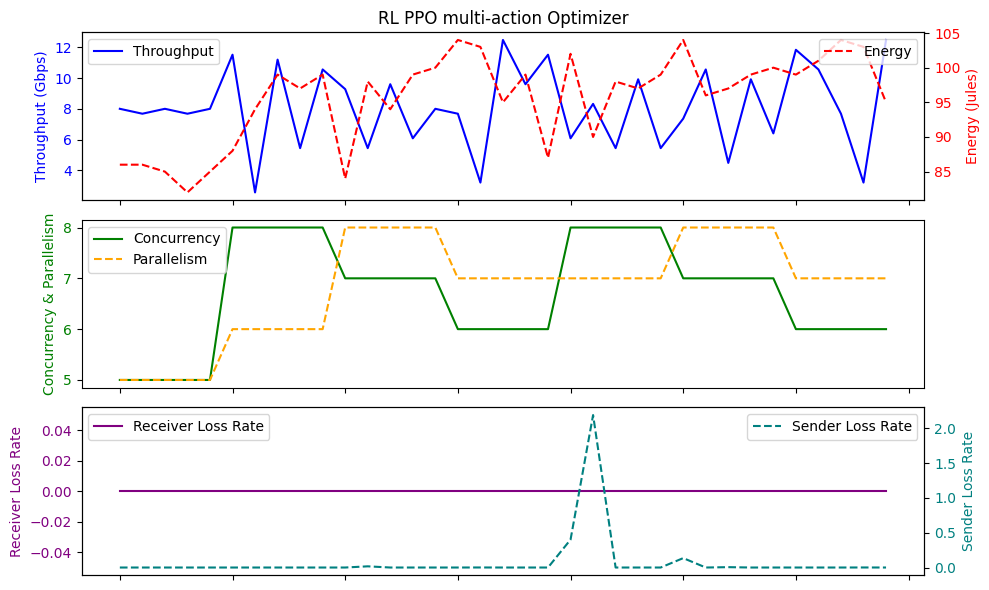

Average Throughput: 8.091428571428573
Total Energy: 3348.0
Total loss rate: 2.750484277592901
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 08:49:07.363322880    7.524571       0.0   -2.657143   
min       2024-02-18 07:18:36.445997    0.960000       0.0 -180.000000   
25%    2024-02-19 05:41:22.756942848    4.960000       0.0    1.000000   
50%    2024-02-19 13:08:40.479406080    8.000000       0.0    3.000000   
75%    2024-02-19 17:03:14.983747584   10.400000       0.0    4.000000   
max       2024-02-19 17:04:27.553372   12.480000       0.0    5.000000   
std                              NaN    3.425795       0.0   30.944868   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.485714   94.057143   0.067057  
min    32.500000   56.000000   0.000000  
25%    32.800000   89.000000   0.000000  
50%    33.200000   97.000000 

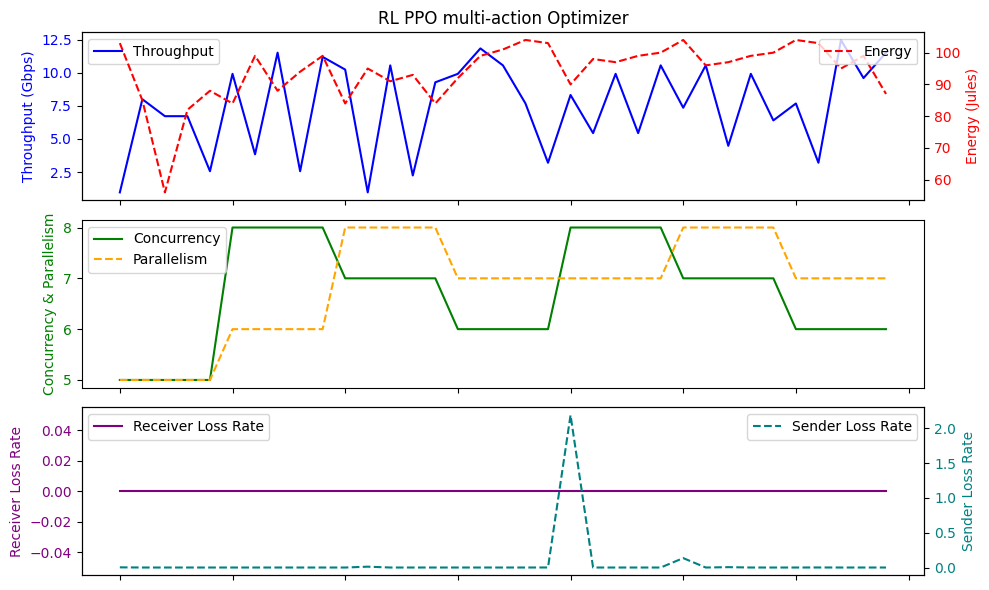

Average Throughput: 7.524571428571427
Total Energy: 3292.0
Total loss rate: 2.3469870163357225
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 08:33:58.888080640    7.762286       0.0   -2.828571   
min       2024-02-18 03:03:12.478646    1.920000       0.0 -180.000000   
25%    2024-02-19 05:41:24.758566400    5.440000       0.0    2.000000   
50%    2024-02-19 13:11:55.349267968    8.320000       0.0    3.000000   
75%    2024-02-19 17:02:11.924465920   10.240000       0.0    4.000000   
max       2024-02-19 17:05:36.989199   11.840000       0.0    5.000000   
std                              NaN    2.827594       0.0   31.142449   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   35.485714   93.600000   0.074713  
min    32.500000   72.000000   0.000000  
25%    32.850000   90.000000   0.000000  
50%    33.300000   95.000000

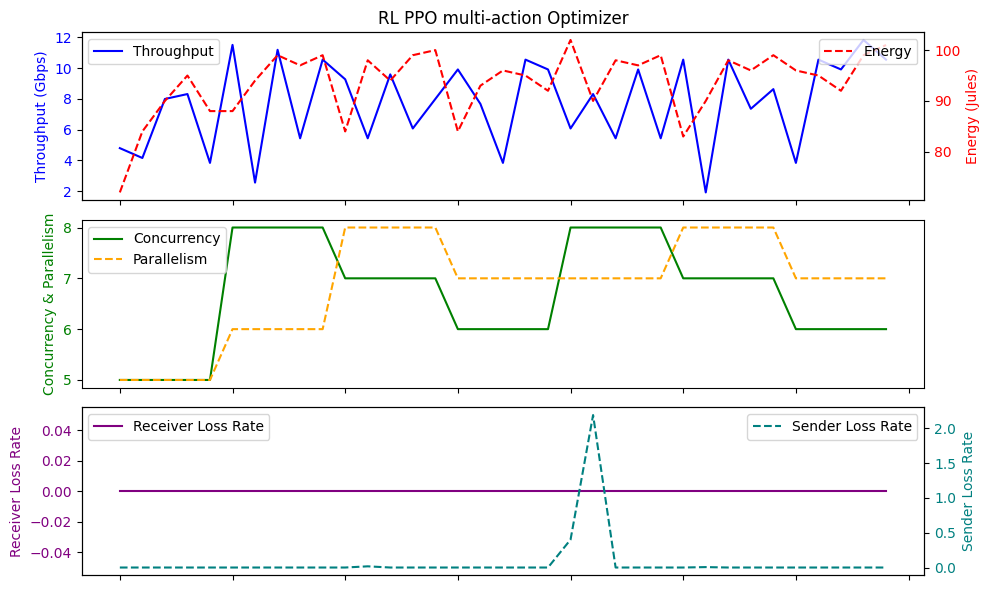

Average Throughput: 7.7622857142857145
Total Energy: 3276.0
Total loss rate: 2.614964297778312
                                Time  Throughput  LossRate       Score  \
count                             40   40.000000      40.0   40.000000   
mean   2024-02-19 13:11:06.945319424    7.536000       0.0   -2.375000   
min       2024-02-19 07:47:41.240528    0.320000       0.0 -180.000000   
25%    2024-02-19 10:32:49.305391104    4.560000       0.0    1.000000   
50%    2024-02-19 13:11:54.854131968    8.320000       0.0    3.000000   
75%    2024-02-19 14:49:12.784331264   10.080000       0.0    4.000000   
max       2024-02-19 17:05:33.979979   13.440000       0.0    5.000000   
std                              NaN    3.716969       0.0   29.108715   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   34.110000   93.750000   0.066110  
min    32.500000   80.000000   0.000000  
25%    32.875000   89.250000   0.000000  
50%    33.100000   95.000000

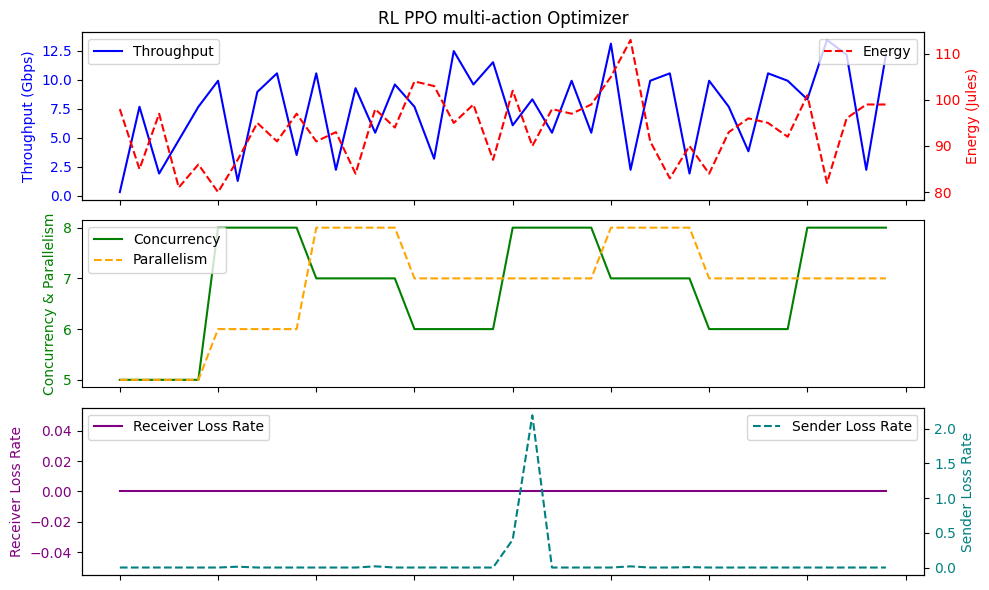

Average Throughput: 7.536
Total Energy: 3750.0
Total loss rate: 2.644404447721811
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:48:27.059066368    8.000000       0.0   3.085714   
min       2024-02-19 05:25:24.602203    0.960000       0.0   0.000000   
25%    2024-02-19 05:41:22.756942848    6.400000       0.0   2.500000   
50%    2024-02-19 13:11:53.354853120    9.280000       0.0   3.000000   
75%    2024-02-19 15:33:31.660492544   10.560000       0.0   4.000000   
max       2024-02-19 17:05:34.987932   13.440000       0.0   5.000000   
std                              NaN    3.470019       0.0   1.442454   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.017143   92.257143   0.001099  
min    32.500000   82.000000   0.000000  
25%    32.800000   84.000000   0.000000  
50%    33.100000   93.000000   0.000000  
75%    3

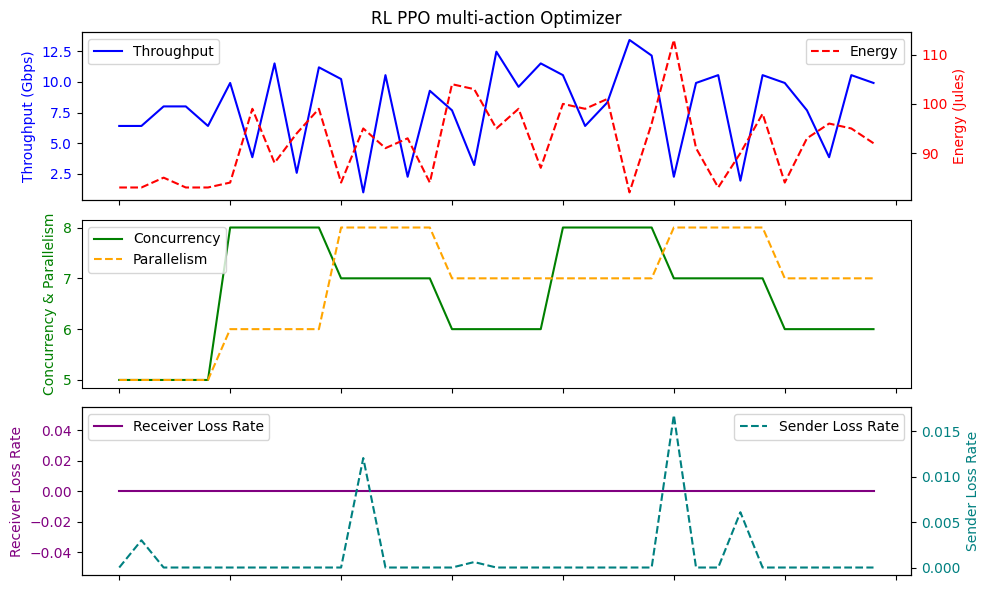

Average Throughput: 8.0
Total Energy: 3229.0
Total loss rate: 0.038449669266177294
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:33:42.574719744    8.164571       0.0   3.171429   
min       2024-02-19 05:41:23.257360    0.960000       0.0   0.000000   
25%    2024-02-19 10:25:02.987684608    6.400000       0.0   2.000000   
50%    2024-02-19 13:08:43.479414016    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:23.552343040   10.560000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   15.360000       0.0   5.000000   
std                              NaN    3.593979       0.0   1.484938   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.511429   94.542857   0.000892  
min    32.500000   80.000000   0.000000  
25%    32.750000   87.000000   0.000000  
50%    33.000000   97.000000   0.000000  
75%    

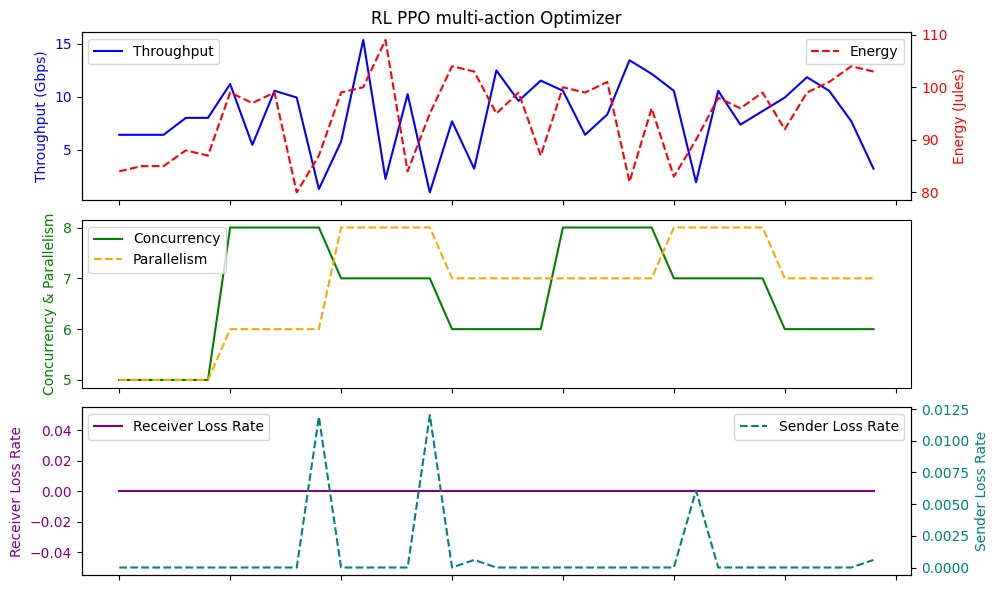

Average Throughput: 8.16457142857143
Total Energy: 3309.0
Total loss rate: 0.031204920548973804
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:08:12.373721856    7.926857       0.0   3.085714   
min       2024-02-19 03:53:25.304554    1.280000       0.0   0.000000   
25%    2024-02-19 10:25:05.993165056    5.760000       0.0   2.500000   
50%    2024-02-19 14:01:44.074888960    8.320000       0.0   3.000000   
75%    2024-02-19 17:03:16.988988672   10.240000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   5.000000   
std                              NaN    3.161258       0.0   1.336621   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.380000   91.857143   0.001034  
min    32.500000   64.000000   0.000000  
25%    32.700000   85.000000   0.000000  
50%    33.100000   95.000000   0.000

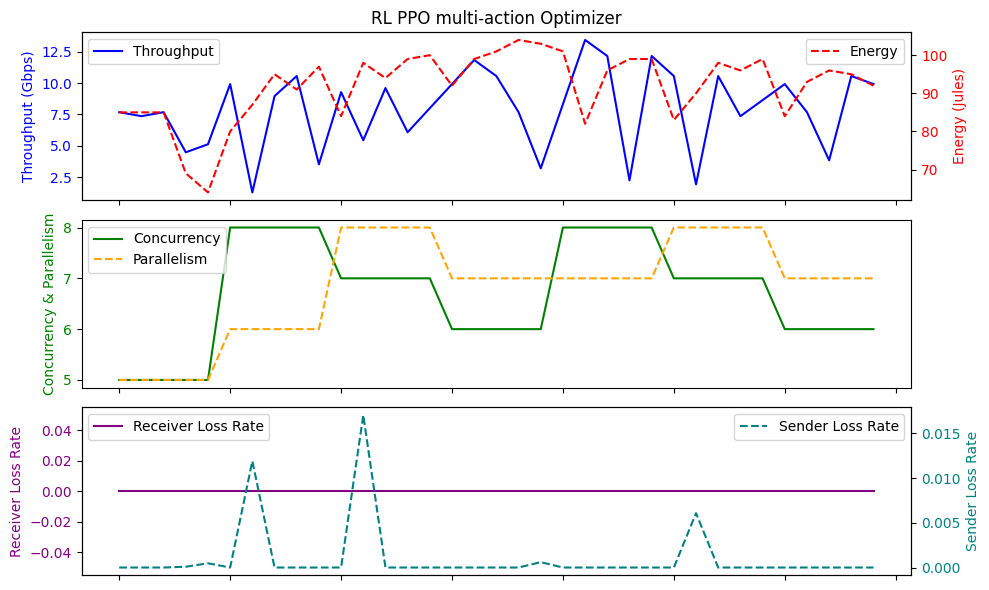

Average Throughput: 7.926857142857143
Total Energy: 3215.0
Total loss rate: 0.0361764562458095
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 09:35:43.472744192    8.228571       0.0   -1.971429   
min       2024-02-18 05:36:26.336761    1.920000       0.0 -180.000000   
25%    2024-02-19 05:41:22.756942848    6.720000       0.0    2.000000   
50%    2024-02-19 17:02:09.412815104    8.640000       0.0    3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0    4.500000   
max       2024-02-19 17:05:36.989199   12.480000       0.0    5.000000   
std                              NaN    2.793548       0.0   31.007101   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.425714   94.714286   0.063274  
min    32.500000   83.000000   0.000000  
25%    32.900000   89.000000   0.000000  
50%    33.400000   97.000000

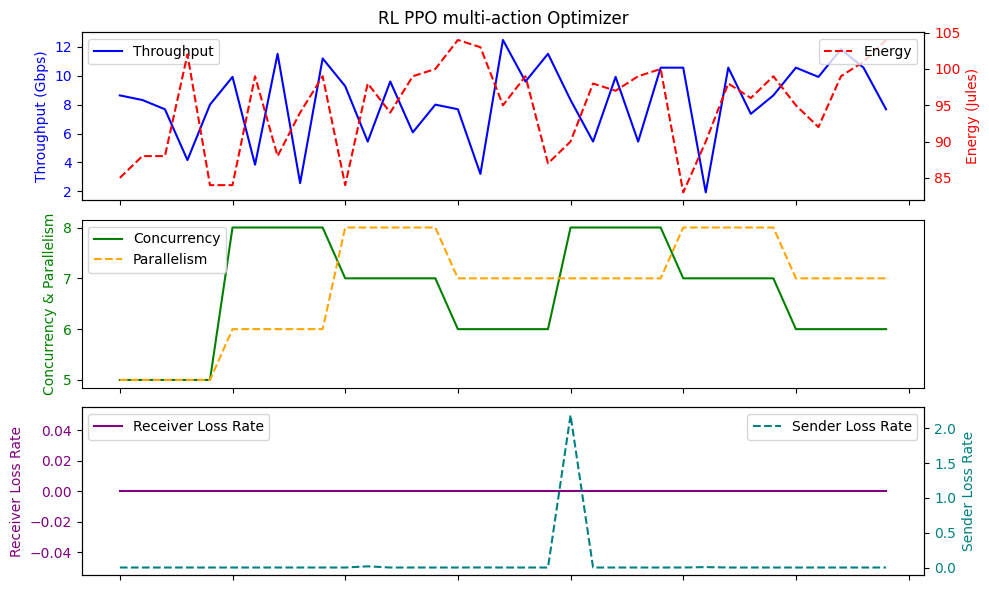

Average Throughput: 8.228571428571428
Total Energy: 3315.0
Total loss rate: 2.2145891191795815
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:04:06.722754816    8.448000       0.0   3.371429   
min       2024-02-18 11:37:07.787210    0.960000       0.0   0.000000   
25%    2024-02-19 08:03:13.872189440    6.080000       0.0   3.000000   
50%    2024-02-19 13:11:55.349267968    9.920000       0.0   4.000000   
75%    2024-02-19 14:03:19.997628160   10.560000       0.0   4.500000   
max       2024-02-19 17:05:33.979979   15.360000       0.0   5.000000   
std                              NaN    3.772106       0.0   1.516298   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.434286   94.371429   0.000996  
min    32.500000   77.000000   0.000000  
25%    32.700000   90.500000   0.000000  
50%    33.000000   95.000000   0.0000

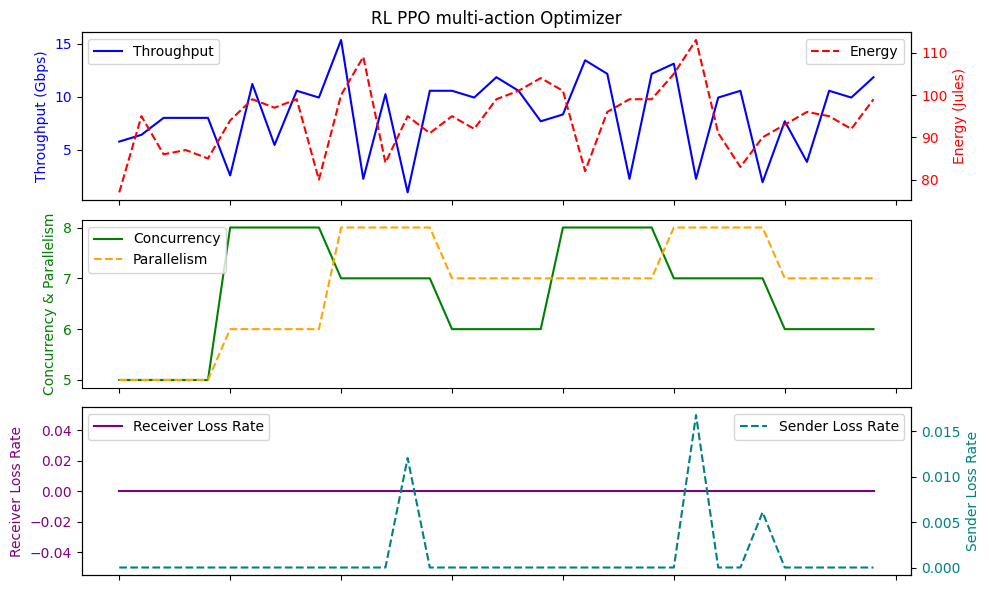

Average Throughput: 8.448
Total Energy: 3303.0
Total loss rate: 0.034858209901729734
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:38:49.053028352    7.689143       0.0   2.885714   
min       2024-02-18 03:03:10.476859    1.600000       0.0   0.000000   
25%    2024-02-19 05:48:05.444521984    3.680000       0.0   1.500000   
50%    2024-02-19 17:04:23.552343040    8.000000       0.0   3.000000   
75%    2024-02-19 17:05:33.478924032   11.040000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    4.153831       0.0   1.510189   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.648571   93.200000   0.001390  
min    32.600000   46.000000   0.000000  
25%    32.850000   88.500000   0.000000  
50%    33.000000   96.000000   0.000000  
75%  

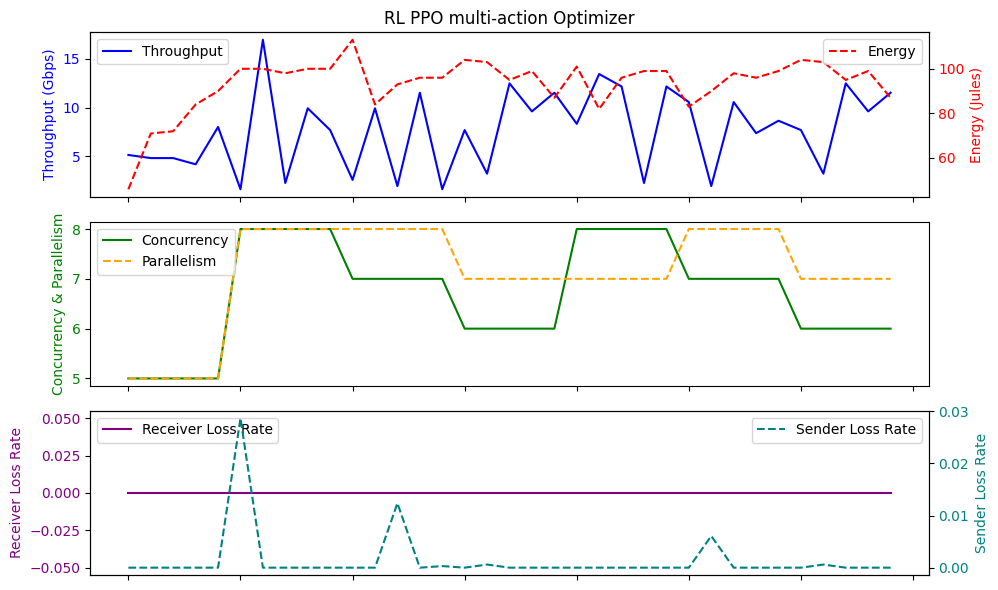

Average Throughput: 7.6891428571428575
Total Energy: 3262.0
Total loss rate: 0.04863265691999859
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 06:15:13.674864896    8.237714       0.0   3.257143   
min       2024-02-18 02:37:51.652108    0.960000       0.0   0.000000   
25%    2024-02-19 07:42:03.866985472    6.080000       0.0   2.000000   
50%    2024-02-19 09:39:15.926579968    9.600000       0.0   4.000000   
75%    2024-02-19 13:11:55.852135936   10.560000       0.0   4.000000   
max       2024-02-19 17:24:06.799533   15.360000       0.0   5.000000   
std                              NaN    3.873845       0.0   1.482106   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.137143   94.600000   0.000344  
min    32.500000   76.000000   0.000000  
25%    32.750000   89.000000   0.000000  
50%    33.000000   98.000000   0.00

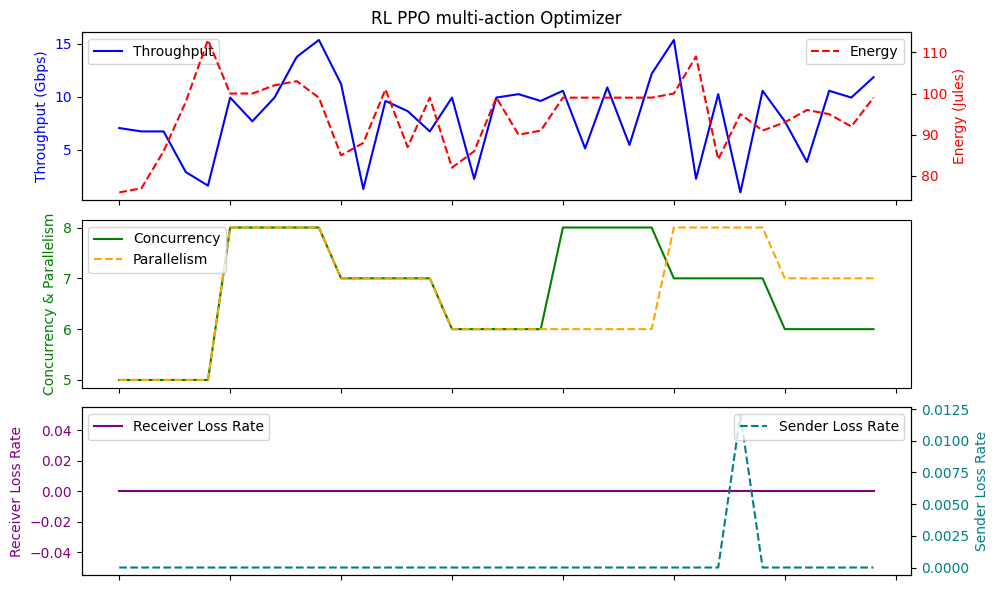

Average Throughput: 8.237714285714285
Total Energy: 3311.0
Total loss rate: 0.012030833513435632
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 14:13:50.294086656    8.274286       0.0   3.228571   
min       2024-02-19 05:41:21.255366    0.960000       0.0   0.000000   
25%    2024-02-19 11:52:04.024695040    6.400000       0.0   2.000000   
50%    2024-02-19 16:57:13.393968896    9.280000       0.0   3.000000   
75%    2024-02-19 17:04:24.055944192   10.880000       0.0   4.500000   
max       2024-02-19 17:05:36.989199   13.440000       0.0   6.000000   
std                              NaN    3.637105       0.0   1.554608   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.774286   95.000000   0.000552  
min    32.500000   82.000000   0.000000  
25%    32.900000   91.000000   0.000000  
50%    33.100000   96.000000   0.00

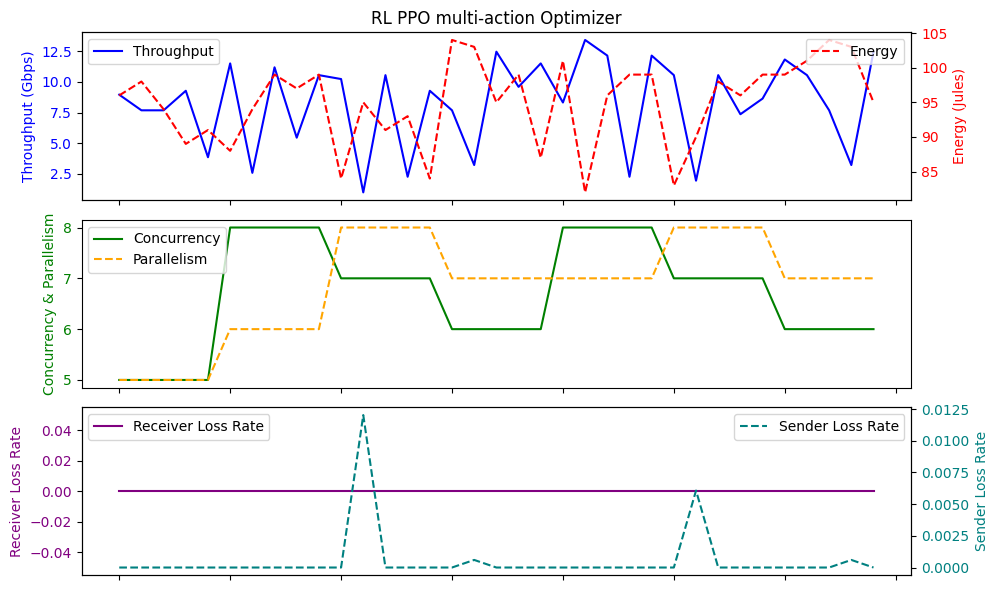

Average Throughput: 8.274285714285716
Total Energy: 3325.0
Total loss rate: 0.01930332491278343
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 12:49:13.259263488    8.009143       0.0   2.857143   
min       2024-02-19 05:41:21.255366    2.240000       0.0  -8.000000   
25%    2024-02-19 07:47:38.740028416    6.240000       0.0   2.000000   
50%    2024-02-19 14:04:46.908798976    8.000000       0.0   3.000000   
75%    2024-02-19 17:03:16.488580608   10.240000       0.0   4.500000   
max       2024-02-19 17:04:27.553372   12.480000       0.0   5.000000   
std                              NaN    2.789140       0.0   2.365722   

             RTT     Energy   SenderLR  
count  35.000000   35.00000  35.000000  
mean   34.265714   95.60000   0.004533  
min    32.500000   83.00000   0.000000  
25%    32.800000   92.50000   0.000000  
50%    33.000000   98.00000   0.000000  


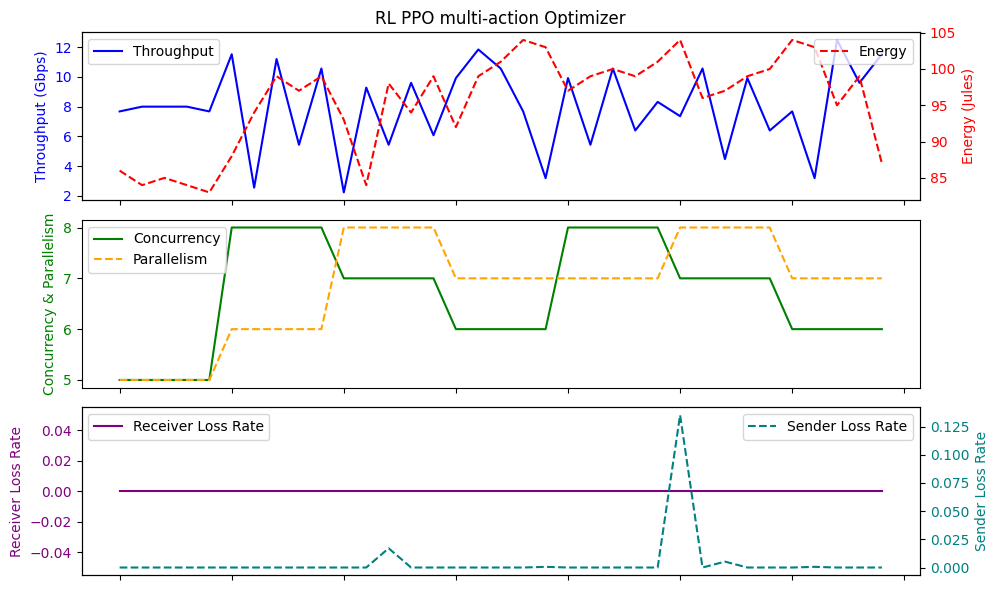

Average Throughput: 8.009142857142859
Total Energy: 3346.0
Total loss rate: 0.15863789602106143
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0   35.00000   
mean   2024-02-19 11:56:11.811986688    7.369143       0.0   -3.00000   
min       2024-02-19 05:23:45.181219    0.960000       0.0 -180.00000   
25%    2024-02-19 10:25:02.987684608    5.440000       0.0    2.00000   
50%    2024-02-19 13:08:40.479406080    8.000000       0.0    3.00000   
75%    2024-02-19 13:11:57.385806080    9.920000       0.0    4.00000   
max       2024-02-19 17:05:36.989199   11.840000       0.0    5.00000   
std                              NaN    3.182527       0.0   31.11837   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.297143   92.285714   0.075397  
min    32.500000   73.000000   0.000000  
25%    32.750000   88.500000   0.000000  
50%    33.100000   93.000000   0.000

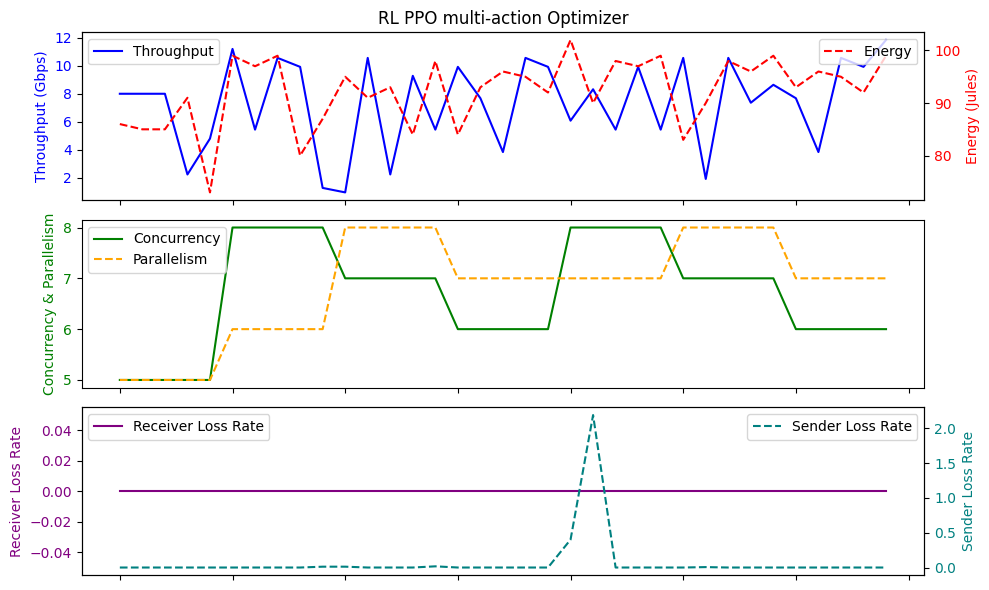

Average Throughput: 7.369142857142856
Total Energy: 3230.0
Total loss rate: 2.6388967269279378
                                Time  Throughput  LossRate       Score  \
count                             35   35.000000      35.0   35.000000   
mean   2024-02-19 13:15:04.862384384    7.926857       0.0   -2.228571   
min       2024-02-19 05:48:02.949587    1.280000       0.0 -180.000000   
25%    2024-02-19 11:42:31.733447680    4.800000       0.0    2.000000   
50%    2024-02-19 13:11:55.349267968    8.320000       0.0    3.000000   
75%    2024-02-19 17:04:22.055152128   10.240000       0.0    4.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0    5.000000   
std                              NaN    3.859625       0.0   30.968756   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.642857   96.228571   0.063619  
min    32.500000   83.000000   0.000000  
25%    32.700000   91.500000   0.000000  
50%    33.100000   97.000000

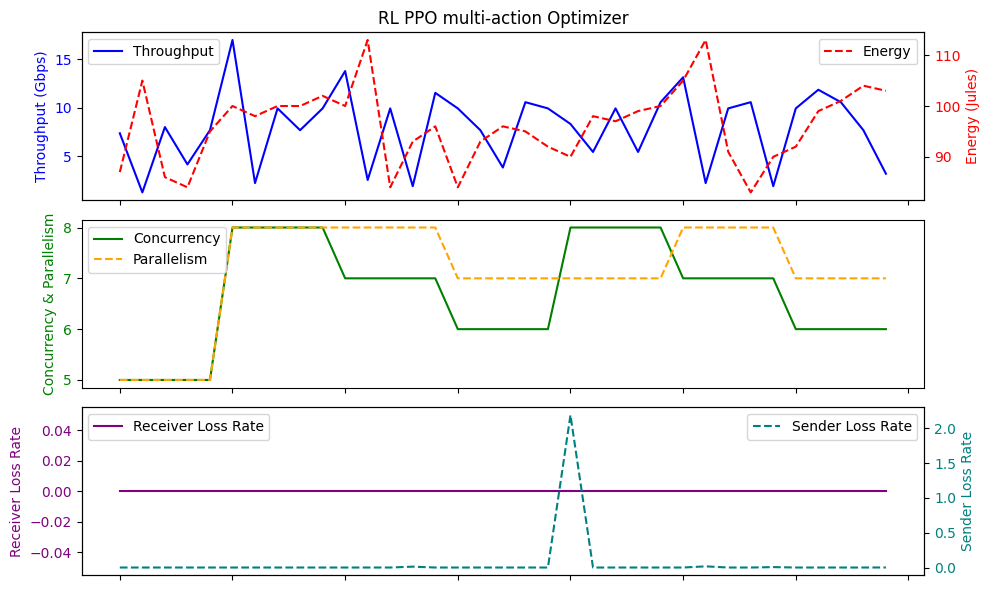

Average Throughput: 7.926857142857143
Total Energy: 3368.0
Total loss rate: 2.226673292793344
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:12:45.810938624    7.798857       0.0   2.971429   
min       2024-02-18 08:10:13.186061    1.920000       0.0   1.000000   
25%    2024-02-19 05:41:23.758746112    5.440000       0.0   2.000000   
50%    2024-02-19 13:11:54.358995968    7.680000       0.0   3.000000   
75%    2024-02-19 17:03:16.492509952   10.560000       0.0   4.000000   
max       2024-02-19 17:05:35.989410   13.440000       0.0   5.000000   
std                              NaN    3.182149       0.0   1.339133   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.351429   92.942857   0.000805  
min    32.600000   66.000000   0.000000  
25%    32.900000   89.000000   0.000000  
50%    33.400000   94.000000   0.00000

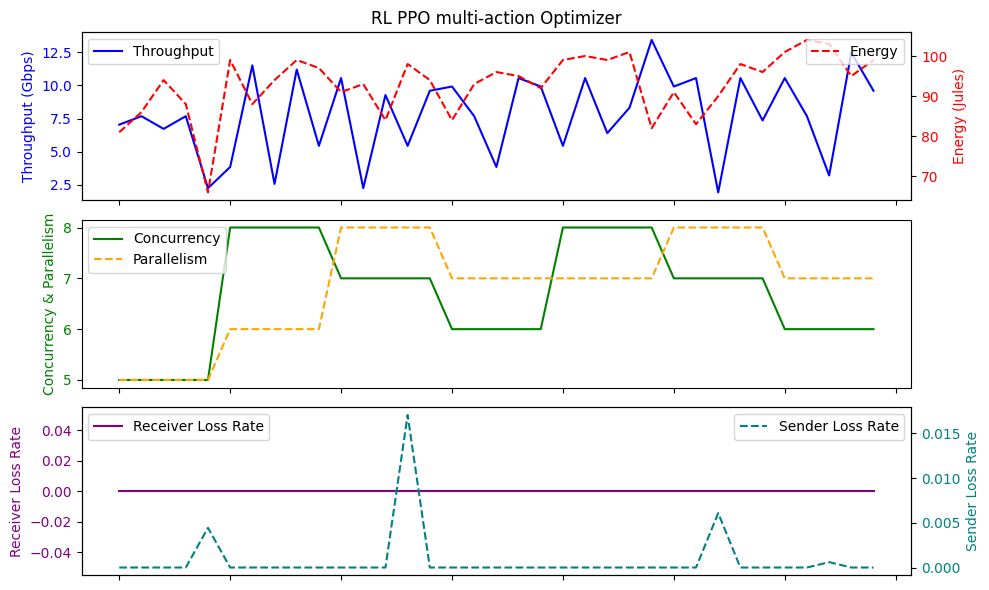

Average Throughput: 7.798857142857144
Total Energy: 3253.0
Total loss rate: 0.028158308630051098
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:05:09.651988224    8.292571       0.0   3.142857   
min       2024-02-18 06:01:59.014488    1.920000       0.0   1.000000   
25%    2024-02-19 05:48:06.429282048    6.560000       0.0   2.000000   
50%    2024-02-19 13:11:56.355003904    8.640000       0.0   3.000000   
75%    2024-02-19 17:04:21.056624384   10.560000       0.0   4.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    3.633980       0.0   1.286648   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.368571   93.342857   0.000174  
min    32.500000   50.000000   0.000000  
25%    32.750000   92.000000   0.000000  
50%    33.100000   96.000000   0.00

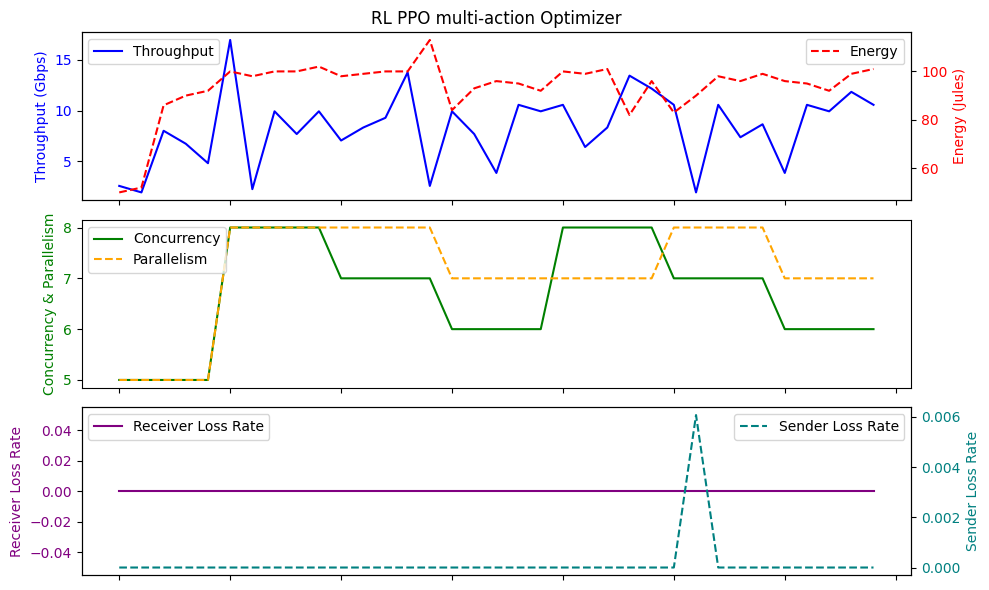

Average Throughput: 8.29257142857143
Total Energy: 3267.0
Total loss rate: 0.00607479664875625
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:25:50.899855872    8.128000       0.0   3.057143   
min       2024-02-18 05:10:50.735904    1.280000       0.0  -0.000000   
25%    2024-02-19 05:48:05.444521984    6.720000       0.0   2.000000   
50%    2024-02-19 14:01:47.109234944    8.320000       0.0   3.000000   
75%    2024-02-19 17:04:23.052039168   10.560000       0.0   4.000000   
max       2024-02-19 17:05:36.989199   16.960000       0.0   5.000000   
std                              NaN    3.851903       0.0   1.532834   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.202857   93.428571   0.001231  
min    32.500000   52.000000   0.000000  
25%    32.700000   88.500000   0.000000  
50%    33.000000   96.000000   0.0000

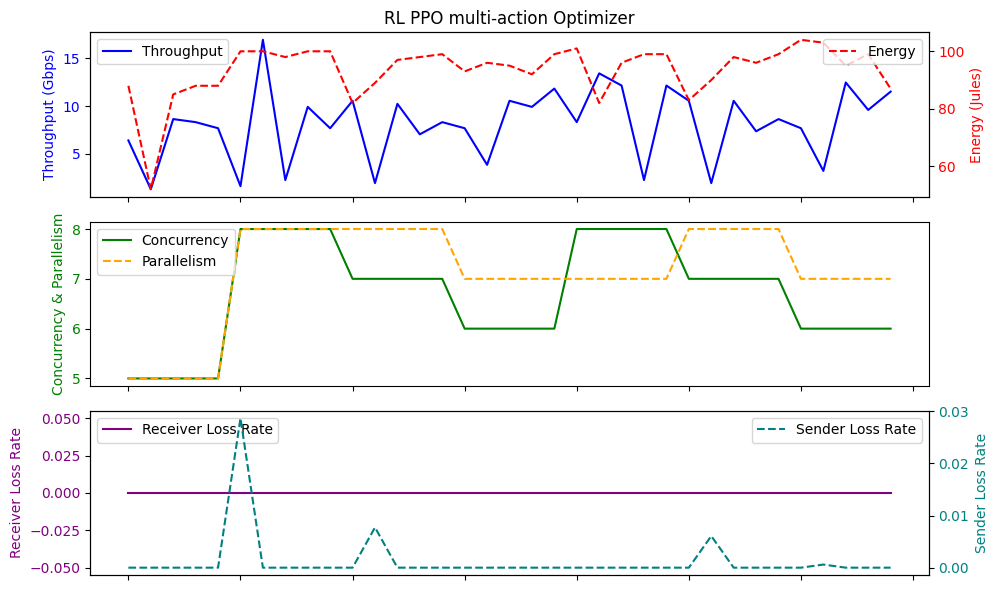

Average Throughput: 8.128
Total Energy: 3270.0
Total loss rate: 0.0430781684302395


In [22]:
num_of_run=50

rl_throughput_sla_throughput_list=[]
rl_throughput_sla_energy_list=[]
rl_throughput_sla_plr_list=[]


model = PPO.load("./ppo_multi_action_in_de_throughputSLA/ppo_best_model/best_model.zip")
for i in range(0,num_of_run):
    done = False
    episode_reward = 0
    env=transferClass_multi_action_increase_decrease_throughput_SLA(cluster_dictionary,initial_value_cluster_dictionary,'throughputSLA')
    action_list=[]
    reward_list=[]
    obs = env.reset()
    while not done:
        action, _ = model.predict(obs, deterministic=True)
        action_list.append(action)
    #     print("action: ",action)
        obs, reward, done, info = env.step(action)
    #     obs = obs.astype(np.float32)
    #     print("obs: ", obs,".... reward: ",reward)
        reward_list.append(reward)
        episode_reward += reward

    accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
    env.close()
    print(accumulator_df.describe())
    print(f"Episode reward: {episode_reward}")
    print(f"actions {action_list},   {len(action_list)}")
    print(f"rewards {reward_list},  {len(reward_list)}")
    rl_throughput_sla_throughput_list.append(accumulator_df['Throughput'].mean())
    rl_throughput_sla_energy_list.append(accumulator_df['Energy'].sum())
    rl_throughput_sla_plr_list.append(accumulator_df['SenderLR'].sum())
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6), sharex=True)

    df=accumulator_df.reset_index()
    # Top plot with Throughput and Energy
    ax1.plot( df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL PPO multi-action Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')


    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot( df['LossRate'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot( df['SenderLR'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
#     ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = accumulator_df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = accumulator_df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = accumulator_df['SenderLR'].sum()
    print("Total loss rate:", total_plr)

**EnergyEfficiency SLA**

In [14]:
class transferClass_multi_action_increase_decrease_energyEfficiency_SLA(gym.Env):
    metadata = {"render_modes": ["human"], "render_fps": 30}
    def __init__(self,transaction_dfs,initial_dfs,optimizer,total_steps=20,min_values=[0.32, 0.0, 1, 1, -3081.0, 0.0, 44.0, 0.0],max_values = [19.2, 2.0, 8, 8, 16.0, 70.1, 120.0, 74.166],total_file_size=256):
        super().__init__()
        self.min_action=1
        self.max_action=8
        self.action_i_d_array=[1,4,0,-1,-4]

        self.transaction_dfs = transaction_dfs
        self.initial_dfs= initial_dfs

        self.action_space = spaces.MultiDiscrete([5, 5])  # example action space
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(40,), dtype=np.float32) # example observation space
        self.current_observation = np.zeros(40,) # initialize current observation
        self.optimizer=optimizer
        self.old_action=None
        self.step_number=0
        self.total_steps=total_steps
        self.sampling_metric='Score'
        self.min_values=np.array(min_values)
        self.max_values=np.array(max_values)
        self.previous_reward=0
        self.obs_df=[]
        self.total_file_size= total_file_size
        self.current_download_size=0

    def reset(self):
        self.current_observation = np.zeros(40,) # initialize current observation
        self.old_action=None
        self.step_number=0
        self.previous_reward=0
        self.current_action_parallelism_value=1
        self.current_action_concurrency_value=1
        self.obs_df=[]
        self.current_download_size=0
        return self.current_observation

    def step(self, action):
        # perform action using transfer_service
        action_1,action_2=action

        self.current_action_parallelism_value+=self.action_i_d_array[action_1]
        if self.current_action_parallelism_value<self.min_action:
            self.current_action_parallelism_value=self.min_action
        elif self.current_action_parallelism_value>self.max_action:
            self.current_action_parallelism_value=self.max_action

        self.current_action_concurrency_value+=self.action_i_d_array[action_2]
        if self.current_action_concurrency_value<self.min_action:
            self.current_action_concurrency_value=self.min_action
        elif self.current_action_concurrency_value>self.max_action:
            self.current_action_concurrency_value=self.max_action


        action_t=(self.current_action_parallelism_value,self.current_action_concurrency_value)
#         print(f"action_t {action_t}")

        if self.old_action==None:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            reward_=(throughput_part_reward*100)/energy_part_reward
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        elif self.old_action==action_t:
            done=False
            observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            reward_=(throughput_part_reward*100)/energy_part_reward
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_
            
        else:
            done=False
            key_name=(self.old_action, action_t)
            work_df=self.transaction_dfs[key_name]
            if work_df.empty:
                observation_df=sample_row_and_neighbors(self.initial_dfs[action_t],self.sampling_metric)
            else:
                observation_df=sample_row_and_neighbors(self.transaction_dfs[key_name],self.sampling_metric)
            self.obs_df.append(observation_df)
            observation,result_array,e_array,t_array=normalize_and_flatten(observation_df,self.min_values,self.max_values)
            self.current_download_size+=np.sum(t_array)
            energy_part_reward=np.mean(e_array)
            throughput_part_reward=np.mean(t_array)
            reward_=(throughput_part_reward*100)/energy_part_reward
            self.old_action=action_t
            reward=reward_-self.previous_reward
            self.previous_reward=reward_

        self.step_number+=1
        if self.current_download_size>=self.total_file_size:
            done=True
        observation = np.asarray(observation).astype(np.float32)
        self.current_observation=observation
        return self.current_observation, reward, done, {}

    def bayes_step(self,action):
        params = [1 if x<1 else int(np.round(x)) for x in action]
        self.current_action_array_index+=self.action_i_d_array[params[0]]
        if self.current_action_array_index<self.min_action:
            self.current_action_array_index=self.min_action
        elif self.current_action_array_index>self.max_action:
            self.current_action_array_index=self.max_action
        action_t=self.action_array[self.current_action_array_index]

        print("Bayes Step: ",action_t)
        obs,score_b,done_b,__=self.step(action_t)
        print("Bayes Step Score: ", score_b)
        return np.round(score_b * (-1))

    def render(self, mode="human"):
        pass

    def close(self):
        self.reset()


In [15]:
env=transferClass_multi_action_increase_decrease_energyEfficiency_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energyEfficiencySLA')
total_scores=0
s = env.reset()
action_list=[]
reward_list=[]
done = False
while not done:
    a=env.action_space.sample()
    s_next, r, done, info = env.step(a)
    # print( len(s_next))
    action_list.append(a)
    reward_list.append(r)
    total_scores += r
    s = s_next
accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
env.close()
print(f"Total Reward: {total_scores}")
print(f"actions {action_list},   {len(action_list)}")
print(f"rewards {reward_list},  {len(reward_list)}")
print(accumulator_df)
print(f"Total downloaded {accumulator_df['Throughput'].sum()} Gb")
print(f"Download speed {accumulator_df['Throughput'].mean()} Gbps")

Total Reward: 8.533333333333333
actions [array([0, 1]), array([3, 3]), array([4, 0]), array([4, 2]), array([4, 1]), array([4, 1]), array([0, 2]), array([0, 4]), array([4, 1]), array([0, 4]), array([4, 3]), array([3, 0]), array([1, 0]), array([2, 3]), array([4, 1]), array([0, 2])],   16
rewards [6.496240601503759, -3.10032223415682, 0.4073603211776513, 0.33005464480874336, 1.7312084993359882, -0.43280751532614925, 3.1015990159901605, -1.0101545253863131, -3.3340878988561116, 0.9762634216177526, -2.3769725879700725, -0.22298089885673233, 5.397389853792563, -1.4627906976744196, 1.3873239436619729, 0.6460093896713603],  16
                          Time  Throughput  LossRate Parallelism Concurrency  \
577 2024-02-18 07:47:01.908344        2.56       0.0           2           5   
578 2024-02-18 07:47:02.909475        2.56       0.0           2           5   
579 2024-02-18 07:47:03.910409        3.20       0.0           2           5   
580 2024-02-18 07:47:04.915245        4.48       0.0 

In [16]:
env=transferClass_multi_action_increase_decrease_energyEfficiency_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energyEfficiencySLA')
evaluation_env=transferClass_multi_action_increase_decrease_energyEfficiency_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energyEfficiencySLA')

policy_kwargs = dict(activation_fn=th.nn.ReLU,net_arch=[{'pi': [128, 128], 'vf': [128, 128]}])

run_string='multi_action_in_de_energyEfficiencySLA'
model = PPO("MlpPolicy", env=env, policy_kwargs=policy_kwargs, verbose=1,tensorboard_log=f"./ppo_tensorboard_{run_string}/",ent_coef=0.01)

eval_callback = EvalCallback(evaluation_env, best_model_save_path=f'./ppo_{run_string}/ppo_best_model/',
                               log_path=f'./ppo_{run_string}/ppo_logs/', eval_freq=1000,
                               deterministic=True, render=False)
# Callback for saving checkpoints every 1000 timesteps
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path=f'./ppo_{run_string}/ppo_checkpoints/',
                                           name_prefix=f'ppo_model_{run_string}')

# Combine both callbacks
callback = CallbackList([checkpoint_callback, eval_callback])
model.learn(total_timesteps=1000000, callback=callback)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/policies.py:484: UserWarning: As shared layers in the mlp_extractor are removed since SB3 v1.8.0, you should now pass directly a dictionary and not a list (net_arch=dict(pi=..., vf=...) instead of net_arch=[dict(pi=..., vf=...)])
  warnings.warn(


Logging to ./ppo_tensorboard_multi_action_in_de_energyEfficiencySLA/PPO_1


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=1000, episode_reward=1.22 +/- 0.54
Episode length: 122.40 +/- 6.56
---------------------------------
| eval/              |          |
|    mean_ep_length  | 122      |
|    mean_reward     | 1.22     |
| time/              |          |
|    total_timesteps | 1000     |
---------------------------------
New best mean reward!


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=2000, episode_reward=0.78 +/- 0.11
Episode length: 123.80 +/- 5.27
---------------------------------
| eval/              |          |
|    mean_ep_length  | 124      |
|    mean_reward     | 0.781    |
| time/              |          |
|    total_timesteps | 2000     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 6.82     |
| time/              |          |
|    fps             | 190      |
|    iterations      | 1        |
|    time_elapsed    | 10       |
|    total_timesteps | 2048     |
---------------------------------
Eval num_timesteps=3000, episode_reward=8.51 +/- 0.57
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.51        |
| time/                   |             |
|    total_timesteps      | 3000        |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=4000, episode_reward=8.33 +/- 1.13
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 4000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    fps             | 213      |
|    iterations      | 2        |
|    time_elapsed    | 19       |
|    total_timesteps | 4096     |
---------------------------------
Eval num_timesteps=5000, episode_reward=7.77 +/- 1.41
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.77       |
| time/                   |            |
|    total_timesteps      | 5000       |
| train/                  |            |
|    approx_kl            | 0.01048835 |
|    clip_fraction        | 0.163      |
|    clip_range           | 0.2        |
|    entropy_loss         | -3.18      |
|    explained_variance   | 0.677      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.757      |
| 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=6000, episode_reward=8.06 +/- 0.86
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.06     |
| time/              |          |
|    total_timesteps | 6000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    fps             | 222      |
|    iterations      | 3        |
|    time_elapsed    | 27       |
|    total_timesteps | 6144     |
---------------------------------
Eval num_timesteps=7000, episode_reward=7.36 +/- 1.07
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 7.36        |
| time/                   |             |
|    total_timesteps      | 7000        |
| train/                  |             |
|    approx_kl            | 0.010667335 |
|    clip_fraction        | 0.152       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.14       |
|    explained_variance   | 0.866       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=8000, episode_reward=7.64 +/- 0.68
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.64     |
| time/              |          |
|    total_timesteps | 8000     |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    fps             | 228      |
|    iterations      | 4        |
|    time_elapsed    | 35       |
|    total_timesteps | 8192     |
---------------------------------
Eval num_timesteps=9000, episode_reward=7.16 +/- 0.84
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 7.16         |
| time/                   |              |
|    total_timesteps      | 9000         |
| train/                  |              |
|    approx_kl            | 0.0108472975 |
|    clip_fraction        | 0.15         |
|    clip_range           | 0.2          |
|    entropy_loss         | -3.11        |
|    explained_variance   | 0.859        |
|    learning_rate        | 0.0003       |
|    loss        

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=10000, episode_reward=7.89 +/- 0.82
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 7.89     |
| time/              |          |
|    total_timesteps | 10000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    fps             | 232      |
|    iterations      | 5        |
|    time_elapsed    | 44       |
|    total_timesteps | 10240    |
---------------------------------
Eval num_timesteps=11000, episode_reward=7.22 +/- 0.94
Episode length: 8.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 7.22         |
| time/                   |              |
|    total_timesteps      | 11000        |
| train/                  |              |
|    approx_kl            | 0.0128592085 |
|    clip_fraction        | 0.174        |
|    clip_range           | 0.2          |
|    entropy_loss         | -3.06        |
|    explained_variance   | 0.872        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=12000, episode_reward=8.57 +/- 0.65
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 12000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    fps             | 233      |
|    iterations      | 6        |
|    time_elapsed    | 52       |
|    total_timesteps | 12288    |
---------------------------------
Eval num_timesteps=13000, episode_reward=8.14 +/- 1.83
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 8.14        |
| time/                   |             |
|    total_timesteps      | 13000       |
| train/                  |             |
|    approx_kl            | 0.010010505 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -3.02       |
|    explained_variance   | 0.893       |
|    learning_rate        | 0.0003      |
|    lo

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=14000, episode_reward=8.50 +/- 1.34
Episode length: 8.20 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 14000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    fps             | 235      |
|    iterations      | 7        |
|    time_elapsed    | 60       |
|    total_timesteps | 14336    |
---------------------------------
Eval num_timesteps=15000, episode_reward=6.66 +/- 1.04
Episode length: 8.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.4         |
|    mean_reward          | 6.66        |
| time/                   |             |
|    total_timesteps      | 15000       |
| train/                  |             |
|    approx_kl            | 0.008404682 |
|    clip_fraction        | 0.11        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.99       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=16000, episode_reward=8.08 +/- 0.42
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 8.08     |
| time/              |          |
|    total_timesteps | 16000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.75     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    fps             | 233      |
|    iterations      | 8        |
|    time_elapsed    | 70       |
|    total_timesteps | 16384    |
---------------------------------
Eval num_timesteps=17000, episode_reward=8.12 +/- 1.14
Episode length: 8.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 8.12        |
| time/                   |             |
|    total_timesteps      | 17000       |
| train/                  |             |
|    approx_kl            | 0.009954821 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.95       |
|    explained_variance   | 0.906       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=18000, episode_reward=7.74 +/- 1.38
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 7.74     |
| time/              |          |
|    total_timesteps | 18000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 234      |
|    iterations      | 9        |
|    time_elapsed    | 78       |
|    total_timesteps | 18432    |
---------------------------------
Eval num_timesteps=19000, episode_reward=7.82 +/- 0.72
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 7.82        |
| time/                   |             |
|    total_timesteps      | 19000       |
| train/                  |             |
|    approx_kl            | 0.008627256 |
|    clip_fraction        | 0.0798      |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.9        |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=20000, episode_reward=7.44 +/- 1.78
Episode length: 8.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.4      |
|    mean_reward     | 7.44     |
| time/              |          |
|    total_timesteps | 20000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    fps             | 235      |
|    iterations      | 10       |
|    time_elapsed    | 87       |
|    total_timesteps | 20480    |
---------------------------------
Eval num_timesteps=21000, episode_reward=9.47 +/- 0.92
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 21000       |
| train/                  |             |
|    approx_kl            | 0.011082284 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.9        |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=22000, episode_reward=6.68 +/- 1.74
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 6.68     |
| time/              |          |
|    total_timesteps | 22000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.37     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 11       |
|    time_elapsed    | 95       |
|    total_timesteps | 22528    |
---------------------------------
Eval num_timesteps=23000, episode_reward=8.12 +/- 0.61
Episode length: 8.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 8            |
|    mean_reward          | 8.12         |
| time/                   |              |
|    total_timesteps      | 23000        |
| train/                  |              |
|    approx_kl            | 0.0075974106 |
|    clip_fraction        | 0.0999       |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.87        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=24000, episode_reward=8.54 +/- 1.03
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 24000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.34     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 12       |
|    time_elapsed    | 103      |
|    total_timesteps | 24576    |
---------------------------------
Eval num_timesteps=25000, episode_reward=7.25 +/- 0.42
Episode length: 8.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8.2         |
|    mean_reward          | 7.25        |
| time/                   |             |
|    total_timesteps      | 25000       |
| train/                  |             |
|    approx_kl            | 0.009610306 |
|    clip_fraction        | 0.12        |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.82       |
|    explained_variance   | 0.907       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=26000, episode_reward=7.94 +/- 1.08
Episode length: 8.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8        |
|    mean_reward     | 7.94     |
| time/              |          |
|    total_timesteps | 26000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.2      |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 13       |
|    time_elapsed    | 112      |
|    total_timesteps | 26624    |
---------------------------------
Eval num_timesteps=27000, episode_reward=8.13 +/- 0.46
Episode length: 8.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 8           |
|    mean_reward          | 8.13        |
| time/                   |             |
|    total_timesteps      | 27000       |
| train/                  |             |
|    approx_kl            | 0.009535427 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.78       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=28000, episode_reward=7.74 +/- 1.00
Episode length: 8.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 8.2      |
|    mean_reward     | 7.74     |
| time/              |          |
|    total_timesteps | 28000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 14       |
|    time_elapsed    | 120      |
|    total_timesteps | 28672    |
---------------------------------
Eval num_timesteps=29000, episode_reward=9.44 +/- 0.93
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.44       |
| time/                   |            |
|    total_timesteps      | 29000      |
| train/                  |            |
|    approx_kl            | 0.00884214 |
|    clip_fraction        | 0.096      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.75      |
|    explained_variance   | 0.901      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.36       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=30000, episode_reward=8.24 +/- 0.62
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 30000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 15       |
|    time_elapsed    | 128      |
|    total_timesteps | 30720    |
---------------------------------
Eval num_timesteps=31000, episode_reward=8.78 +/- 0.83
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.78        |
| time/                   |             |
|    total_timesteps      | 31000       |
| train/                  |             |
|    approx_kl            | 0.010387585 |
|    clip_fraction        | 0.128       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.78       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=32000, episode_reward=8.84 +/- 0.85
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 32000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 16       |
|    time_elapsed    | 136      |
|    total_timesteps | 32768    |
---------------------------------
Eval num_timesteps=33000, episode_reward=8.69 +/- 0.98
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.69        |
| time/                   |             |
|    total_timesteps      | 33000       |
| train/                  |             |
|    approx_kl            | 0.010483033 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.71       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=34000, episode_reward=8.85 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.85     |
| time/              |          |
|    total_timesteps | 34000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 17       |
|    time_elapsed    | 145      |
|    total_timesteps | 34816    |
---------------------------------
Eval num_timesteps=35000, episode_reward=7.83 +/- 1.30
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.83         |
| time/                   |              |
|    total_timesteps      | 35000        |
| train/                  |              |
|    approx_kl            | 0.0114237005 |
|    clip_fraction        | 0.137        |
|    clip_range           | 0.2          |
|    entropy_loss         | -2.7         |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss       

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=36000, episode_reward=8.74 +/- 1.10
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 36000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 18       |
|    time_elapsed    | 153      |
|    total_timesteps | 36864    |
---------------------------------
Eval num_timesteps=37000, episode_reward=7.97 +/- 1.40
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.97        |
| time/                   |             |
|    total_timesteps      | 37000       |
| train/                  |             |
|    approx_kl            | 0.010592287 |
|    clip_fraction        | 0.117       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.61       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=38000, episode_reward=8.11 +/- 1.31
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.11     |
| time/              |          |
|    total_timesteps | 38000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 19       |
|    time_elapsed    | 161      |
|    total_timesteps | 38912    |
---------------------------------
Eval num_timesteps=39000, episode_reward=8.89 +/- 1.25
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 8.89        |
| time/                   |             |
|    total_timesteps      | 39000       |
| train/                  |             |
|    approx_kl            | 0.008924473 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.59       |
|    explained_variance   | 0.897       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=40000, episode_reward=8.70 +/- 0.72
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.7      |
| time/              |          |
|    total_timesteps | 40000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 20       |
|    time_elapsed    | 170      |
|    total_timesteps | 40960    |
---------------------------------
Eval num_timesteps=41000, episode_reward=8.85 +/- 0.94
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.85        |
| time/                   |             |
|    total_timesteps      | 41000       |
| train/                  |             |
|    approx_kl            | 0.013937876 |
|    clip_fraction        | 0.176       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.56       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=42000, episode_reward=8.63 +/- 0.92
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 42000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(
/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=43000, episode_reward=8.29 +/- 0.37
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.29     |
| time/              |          |
|    total_timesteps | 43000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 21       |
|    time_elapsed    | 179      |
|    total_timesteps | 43008    |
---------------------------------
Eval num_timesteps=44000, episode_reward=8.26 +/- 0.27
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.26        |
| time/                   |             |
|    total_timesteps      | 44000       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=45000, episode_reward=7.68 +/- 0.99
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.68     |
| time/              |          |
|    total_timesteps | 45000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 22       |
|    time_elapsed    | 187      |
|    total_timesteps | 45056    |
---------------------------------
Eval num_timesteps=46000, episode_reward=9.19 +/- 0.82
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.19        |
| time/                   |             |
|    total_timesteps      | 46000       |
| train/                  |             |
|    approx_kl            | 0.009039849 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.44       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=47000, episode_reward=8.21 +/- 0.10
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.21     |
| time/              |          |
|    total_timesteps | 47000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 23       |
|    time_elapsed    | 196      |
|    total_timesteps | 47104    |
---------------------------------
Eval num_timesteps=48000, episode_reward=8.39 +/- 0.82
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.39        |
| time/                   |             |
|    total_timesteps      | 48000       |
| train/                  |             |
|    approx_kl            | 0.009581643 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.43       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=49000, episode_reward=8.65 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.65     |
| time/              |          |
|    total_timesteps | 49000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 8.13     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 24       |
|    time_elapsed    | 204      |
|    total_timesteps | 49152    |
---------------------------------
Eval num_timesteps=50000, episode_reward=8.35 +/- 1.00
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.35        |
| time/                   |             |
|    total_timesteps      | 50000       |
| train/                  |             |
|    approx_kl            | 0.011021845 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.45       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=51000, episode_reward=8.72 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 51000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 8.13     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 25       |
|    time_elapsed    | 213      |
|    total_timesteps | 51200    |
---------------------------------
Eval num_timesteps=52000, episode_reward=7.84 +/- 0.97
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.84        |
| time/                   |             |
|    total_timesteps      | 52000       |
| train/                  |             |
|    approx_kl            | 0.011378678 |
|    clip_fraction        | 0.134       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.46       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=53000, episode_reward=8.42 +/- 1.35
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 53000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 26       |
|    time_elapsed    | 223      |
|    total_timesteps | 53248    |
---------------------------------
Eval num_timesteps=54000, episode_reward=9.16 +/- 0.36
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 54000       |
| train/                  |             |
|    approx_kl            | 0.011162093 |
|    clip_fraction        | 0.127       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.4        |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=55000, episode_reward=8.45 +/- 0.83
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 55000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 27       |
|    time_elapsed    | 232      |
|    total_timesteps | 55296    |
---------------------------------
Eval num_timesteps=56000, episode_reward=8.08 +/- 0.89
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.08        |
| time/                   |             |
|    total_timesteps      | 56000       |
| train/                  |             |
|    approx_kl            | 0.008857198 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.38       |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=57000, episode_reward=8.86 +/- 0.76
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 57000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 28       |
|    time_elapsed    | 241      |
|    total_timesteps | 57344    |
---------------------------------
Eval num_timesteps=58000, episode_reward=8.40 +/- 0.83
Episode length: 6.80 +/- 0.40
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 6.8       |
|    mean_reward          | 8.4       |
| time/                   |           |
|    total_timesteps      | 58000     |
| train/                  |           |
|    approx_kl            | 0.0109601 |
|    clip_fraction        | 0.113     |
|    clip_range           | 0.2       |
|    entropy_loss         | -2.39     |
|    explained_variance   | 0.933     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.271     |
|    n_updates 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=59000, episode_reward=8.75 +/- 1.31
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.75     |
| time/              |          |
|    total_timesteps | 59000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 29       |
|    time_elapsed    | 250      |
|    total_timesteps | 59392    |
---------------------------------
Eval num_timesteps=60000, episode_reward=8.24 +/- 0.77
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.24        |
| time/                   |             |
|    total_timesteps      | 60000       |
| train/                  |             |
|    approx_kl            | 0.009005929 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.37       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=61000, episode_reward=7.36 +/- 1.58
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.36     |
| time/              |          |
|    total_timesteps | 61000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 30       |
|    time_elapsed    | 259      |
|    total_timesteps | 61440    |
---------------------------------
Eval num_timesteps=62000, episode_reward=8.27 +/- 1.46
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.27        |
| time/                   |             |
|    total_timesteps      | 62000       |
| train/                  |             |
|    approx_kl            | 0.008724936 |
|    clip_fraction        | 0.113       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.31       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=63000, episode_reward=7.42 +/- 0.89
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.42     |
| time/              |          |
|    total_timesteps | 63000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 236      |
|    iterations      | 31       |
|    time_elapsed    | 268      |
|    total_timesteps | 63488    |
---------------------------------
Eval num_timesteps=64000, episode_reward=8.83 +/- 0.86
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 64000       |
| train/                  |             |
|    approx_kl            | 0.010972088 |
|    clip_fraction        | 0.146       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.32       |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=65000, episode_reward=8.73 +/- 0.63
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 65000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    fps             | 237      |
|    iterations      | 32       |
|    time_elapsed    | 276      |
|    total_timesteps | 65536    |
---------------------------------
Eval num_timesteps=66000, episode_reward=8.15 +/- 0.31
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 66000       |
| train/                  |             |
|    approx_kl            | 0.010728847 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.32       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=67000, episode_reward=8.11 +/- 0.07
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.11     |
| time/              |          |
|    total_timesteps | 67000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 33       |
|    time_elapsed    | 284      |
|    total_timesteps | 67584    |
---------------------------------
Eval num_timesteps=68000, episode_reward=7.81 +/- 0.68
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.81        |
| time/                   |             |
|    total_timesteps      | 68000       |
| train/                  |             |
|    approx_kl            | 0.008555304 |
|    clip_fraction        | 0.118       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.34       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=69000, episode_reward=8.36 +/- 0.78
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.36     |
| time/              |          |
|    total_timesteps | 69000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 34       |
|    time_elapsed    | 292      |
|    total_timesteps | 69632    |
---------------------------------
Eval num_timesteps=70000, episode_reward=8.44 +/- 0.66
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.44        |
| time/                   |             |
|    total_timesteps      | 70000       |
| train/                  |             |
|    approx_kl            | 0.010688122 |
|    clip_fraction        | 0.145       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.27       |
|    explained_variance   | 0.908       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=71000, episode_reward=8.89 +/- 0.76
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 71000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 35       |
|    time_elapsed    | 301      |
|    total_timesteps | 71680    |
---------------------------------
Eval num_timesteps=72000, episode_reward=8.28 +/- 0.26
Episode length: 6.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.2         |
|    mean_reward          | 8.28        |
| time/                   |             |
|    total_timesteps      | 72000       |
| train/                  |             |
|    approx_kl            | 0.010683901 |
|    clip_fraction        | 0.114       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.23       |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=73000, episode_reward=8.24 +/- 0.96
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 73000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 36       |
|    time_elapsed    | 309      |
|    total_timesteps | 73728    |
---------------------------------
Eval num_timesteps=74000, episode_reward=8.44 +/- 1.44
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.44        |
| time/                   |             |
|    total_timesteps      | 74000       |
| train/                  |             |
|    approx_kl            | 0.010563565 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.19       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=75000, episode_reward=8.54 +/- 0.97
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 75000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.84     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 37       |
|    time_elapsed    | 318      |
|    total_timesteps | 75776    |
---------------------------------
Eval num_timesteps=76000, episode_reward=8.48 +/- 0.92
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.48       |
| time/                   |            |
|    total_timesteps      | 76000      |
| train/                  |            |
|    approx_kl            | 0.01063836 |
|    clip_fraction        | 0.107      |
|    clip_range           | 0.2        |
|    entropy_loss         | -2.14      |
|    explained_variance   | 0.92       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.34       |
|

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=77000, episode_reward=9.02 +/- 1.08
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 77000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    fps             | 237      |
|    iterations      | 38       |
|    time_elapsed    | 327      |
|    total_timesteps | 77824    |
---------------------------------
Eval num_timesteps=78000, episode_reward=8.66 +/- 0.75
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.66        |
| time/                   |             |
|    total_timesteps      | 78000       |
| train/                  |             |
|    approx_kl            | 0.012053322 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.13       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=79000, episode_reward=8.89 +/- 0.68
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 79000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 39       |
|    time_elapsed    | 336      |
|    total_timesteps | 79872    |
---------------------------------
Eval num_timesteps=80000, episode_reward=8.94 +/- 1.02
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.94        |
| time/                   |             |
|    total_timesteps      | 80000       |
| train/                  |             |
|    approx_kl            | 0.010170679 |
|    clip_fraction        | 0.138       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.1        |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=81000, episode_reward=8.36 +/- 0.44
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.36     |
| time/              |          |
|    total_timesteps | 81000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 40       |
|    time_elapsed    | 344      |
|    total_timesteps | 81920    |
---------------------------------
Eval num_timesteps=82000, episode_reward=8.21 +/- 0.13
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.21        |
| time/                   |             |
|    total_timesteps      | 82000       |
| train/                  |             |
|    approx_kl            | 0.009758128 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.09       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=83000, episode_reward=8.77 +/- 0.88
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 83000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 41       |
|    time_elapsed    | 353      |
|    total_timesteps | 83968    |
---------------------------------
Eval num_timesteps=84000, episode_reward=7.22 +/- 0.97
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.22        |
| time/                   |             |
|    total_timesteps      | 84000       |
| train/                  |             |
|    approx_kl            | 0.010846388 |
|    clip_fraction        | 0.138       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2          |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=85000, episode_reward=8.94 +/- 0.76
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 85000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=86000, episode_reward=7.45 +/- 1.26
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.45     |
| time/              |          |
|    total_timesteps | 86000    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 42       |
|    time_elapsed    | 361      |
|    total_timesteps | 86016    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=87000, episode_reward=8.80 +/- 0.94
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.8         |
| time/                   |             |
|    total_timesteps      | 87000       |
| train/                  |             |
|    approx_kl            | 0.008895241 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2.02       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.213       |
|    n_updates            | 420         |
|    policy_gradient_loss | -0.00616    |
|    value_loss           | 0.725       |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=88000, episode_reward=9.08 +/- 1.02
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 88000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 43       |
|    time_elapsed    | 370      |
|    total_timesteps | 88064    |
---------------------------------
Eval num_timesteps=89000, episode_reward=7.57 +/- 0.98
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.57        |
| time/                   |             |
|    total_timesteps      | 89000       |
| train/                  |             |
|    approx_kl            | 0.008494316 |
|    clip_fraction        | 0.102       |
|    clip_range           | 0.2         |
|    entropy_loss         | -2          |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=90000, episode_reward=7.99 +/- 0.24
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 90000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.5      |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 44       |
|    time_elapsed    | 378      |
|    total_timesteps | 90112    |
---------------------------------
Eval num_timesteps=91000, episode_reward=8.46 +/- 1.49
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.46        |
| time/                   |             |
|    total_timesteps      | 91000       |
| train/                  |             |
|    approx_kl            | 0.012338619 |
|    clip_fraction        | 0.0979      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.99       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=92000, episode_reward=8.62 +/- 0.81
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.62     |
| time/              |          |
|    total_timesteps | 92000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.45     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    fps             | 237      |
|    iterations      | 45       |
|    time_elapsed    | 387      |
|    total_timesteps | 92160    |
---------------------------------
Eval num_timesteps=93000, episode_reward=7.89 +/- 1.33
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.89        |
| time/                   |             |
|    total_timesteps      | 93000       |
| train/                  |             |
|    approx_kl            | 0.010864101 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.99       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=94000, episode_reward=9.60 +/- 0.33
Episode length: 6.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.2      |
|    mean_reward     | 9.6      |
| time/              |          |
|    total_timesteps | 94000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 46       |
|    time_elapsed    | 395      |
|    total_timesteps | 94208    |
---------------------------------
Eval num_timesteps=95000, episode_reward=7.81 +/- 1.20
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.81        |
| time/                   |             |
|    total_timesteps      | 95000       |
| train/                  |             |
|    approx_kl            | 0.011234084 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.97       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    lo

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=96000, episode_reward=8.04 +/- 1.70
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.04     |
| time/              |          |
|    total_timesteps | 96000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 47       |
|    time_elapsed    | 403      |
|    total_timesteps | 96256    |
---------------------------------
Eval num_timesteps=97000, episode_reward=7.72 +/- 1.02
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.72        |
| time/                   |             |
|    total_timesteps      | 97000       |
| train/                  |             |
|    approx_kl            | 0.013120038 |
|    clip_fraction        | 0.133       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.94       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=98000, episode_reward=7.74 +/- 1.30
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.74     |
| time/              |          |
|    total_timesteps | 98000    |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 48       |
|    time_elapsed    | 412      |
|    total_timesteps | 98304    |
---------------------------------
Eval num_timesteps=99000, episode_reward=8.35 +/- 0.79
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.35        |
| time/                   |             |
|    total_timesteps      | 99000       |
| train/                  |             |
|    approx_kl            | 0.012856102 |
|    clip_fraction        | 0.126       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.95       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 | 0

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=100000, episode_reward=8.74 +/- 0.99
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 100000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 49       |
|    time_elapsed    | 420      |
|    total_timesteps | 100352   |
---------------------------------
Eval num_timesteps=101000, episode_reward=8.21 +/- 0.86
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.21         |
| time/                   |              |
|    total_timesteps      | 101000       |
| train/                  |              |
|    approx_kl            | 0.0105177425 |
|    clip_fraction        | 0.138        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.96        |
|    explained_variance   | 0.919        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=102000, episode_reward=9.33 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.33     |
| time/              |          |
|    total_timesteps | 102000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 50       |
|    time_elapsed    | 428      |
|    total_timesteps | 102400   |
---------------------------------
Eval num_timesteps=103000, episode_reward=8.53 +/- 0.44
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 103000      |
| train/                  |             |
|    approx_kl            | 0.008768743 |
|    clip_fraction        | 0.0863      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.93       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=104000, episode_reward=7.47 +/- 1.43
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 7.47     |
| time/              |          |
|    total_timesteps | 104000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 51       |
|    time_elapsed    | 437      |
|    total_timesteps | 104448   |
---------------------------------
Eval num_timesteps=105000, episode_reward=7.57 +/- 0.95
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.57        |
| time/                   |             |
|    total_timesteps      | 105000      |
| train/                  |             |
|    approx_kl            | 0.008861216 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.92       |
|    explained_variance   | 0.94        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=106000, episode_reward=8.10 +/- 0.29
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.1      |
| time/              |          |
|    total_timesteps | 106000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 52       |
|    time_elapsed    | 445      |
|    total_timesteps | 106496   |
---------------------------------
Eval num_timesteps=107000, episode_reward=8.12 +/- 0.66
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.12         |
| time/                   |              |
|    total_timesteps      | 107000       |
| train/                  |              |
|    approx_kl            | 0.0103192115 |
|    clip_fraction        | 0.1          |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.95        |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=108000, episode_reward=8.45 +/- 0.82
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 108000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 53       |
|    time_elapsed    | 454      |
|    total_timesteps | 108544   |
---------------------------------
Eval num_timesteps=109000, episode_reward=8.02 +/- 0.81
Episode length: 6.60 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.6          |
|    mean_reward          | 8.02         |
| time/                   |              |
|    total_timesteps      | 109000       |
| train/                  |              |
|    approx_kl            | 0.0101928925 |
|    clip_fraction        | 0.129        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.93        |
|    explained_variance   | 0.913        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=110000, episode_reward=8.58 +/- 1.55
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 110000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 238      |
|    iterations      | 54       |
|    time_elapsed    | 463      |
|    total_timesteps | 110592   |
---------------------------------
Eval num_timesteps=111000, episode_reward=8.90 +/- 0.83
Episode length: 6.60 +/- 0.49
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 6.6       |
|    mean_reward          | 8.9       |
| time/                   |           |
|    total_timesteps      | 111000    |
| train/                  |           |
|    approx_kl            | 0.0081171 |
|    clip_fraction        | 0.093     |
|    clip_range           | 0.2       |
|    entropy_loss         | -1.96     |
|    explained_variance   | 0.911     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.397     |
|    n_updates

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=112000, episode_reward=7.99 +/- 1.46
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 112000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 55       |
|    time_elapsed    | 472      |
|    total_timesteps | 112640   |
---------------------------------
Eval num_timesteps=113000, episode_reward=7.96 +/- 0.27
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.96        |
| time/                   |             |
|    total_timesteps      | 113000      |
| train/                  |             |
|    approx_kl            | 0.010921116 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.98       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=114000, episode_reward=8.86 +/- 0.67
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 114000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 56       |
|    time_elapsed    | 480      |
|    total_timesteps | 114688   |
---------------------------------
Eval num_timesteps=115000, episode_reward=7.67 +/- 0.98
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.67        |
| time/                   |             |
|    total_timesteps      | 115000      |
| train/                  |             |
|    approx_kl            | 0.010080211 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.97       |
|    explained_variance   | 0.901       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=116000, episode_reward=7.78 +/- 1.38
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.78     |
| time/              |          |
|    total_timesteps | 116000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 57       |
|    time_elapsed    | 488      |
|    total_timesteps | 116736   |
---------------------------------
Eval num_timesteps=117000, episode_reward=9.33 +/- 0.64
Episode length: 6.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.4         |
|    mean_reward          | 9.33        |
| time/                   |             |
|    total_timesteps      | 117000      |
| train/                  |             |
|    approx_kl            | 0.010695256 |
|    clip_fraction        | 0.0973      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.98       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=118000, episode_reward=9.25 +/- 0.66
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 118000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    fps             | 238      |
|    iterations      | 58       |
|    time_elapsed    | 497      |
|    total_timesteps | 118784   |
---------------------------------
Eval num_timesteps=119000, episode_reward=8.20 +/- 0.82
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.2         |
| time/                   |             |
|    total_timesteps      | 119000      |
| train/                  |             |
|    approx_kl            | 0.014631595 |
|    clip_fraction        | 0.122       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.93       |
|    explained_variance   | 0.916       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=120000, episode_reward=8.56 +/- 0.80
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 120000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 59       |
|    time_elapsed    | 505      |
|    total_timesteps | 120832   |
---------------------------------
Eval num_timesteps=121000, episode_reward=7.89 +/- 1.15
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.89       |
| time/                   |            |
|    total_timesteps      | 121000     |
| train/                  |            |
|    approx_kl            | 0.01091254 |
|    clip_fraction        | 0.13       |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.9       |
|    explained_variance   | 0.929      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.253      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=122000, episode_reward=7.18 +/- 0.94
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.18     |
| time/              |          |
|    total_timesteps | 122000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 60       |
|    time_elapsed    | 513      |
|    total_timesteps | 122880   |
---------------------------------
Eval num_timesteps=123000, episode_reward=8.23 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.23        |
| time/                   |             |
|    total_timesteps      | 123000      |
| train/                  |             |
|    approx_kl            | 0.009314575 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.82       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=124000, episode_reward=7.82 +/- 1.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 124000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 61       |
|    time_elapsed    | 522      |
|    total_timesteps | 124928   |
---------------------------------
Eval num_timesteps=125000, episode_reward=8.34 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.34        |
| time/                   |             |
|    total_timesteps      | 125000      |
| train/                  |             |
|    approx_kl            | 0.008444065 |
|    clip_fraction        | 0.0951      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.81       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=126000, episode_reward=9.32 +/- 1.05
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 126000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.53     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 62       |
|    time_elapsed    | 530      |
|    total_timesteps | 126976   |
---------------------------------
Eval num_timesteps=127000, episode_reward=9.14 +/- 0.78
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 9.14        |
| time/                   |             |
|    total_timesteps      | 127000      |
| train/                  |             |
|    approx_kl            | 0.010153716 |
|    clip_fraction        | 0.113       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.81       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=128000, episode_reward=8.33 +/- 0.25
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 128000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=129000, episode_reward=7.05 +/- 1.74
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.05     |
| time/              |          |
|    total_timesteps | 129000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 63       |
|    time_elapsed    | 538      |
|    total_timesteps | 129024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=130000, episode_reward=8.76 +/- 0.90
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.76        |
| time/                   |             |
|    total_timesteps      | 130000      |
| train/                  |             |
|    approx_kl            | 0.010426298 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.8        |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.413       |
|    n_updates            | 630         |
|    policy_gradient_loss | -0.00877    |
|    value_loss           | 0.806       |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=131000, episode_reward=8.52 +/- 0.91
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.52     |
| time/              |          |
|    total_timesteps | 131000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.49     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 64       |
|    time_elapsed    | 547      |
|    total_timesteps | 131072   |
---------------------------------
Eval num_timesteps=132000, episode_reward=8.24 +/- 1.55
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.24         |
| time/                   |              |
|    total_timesteps      | 132000       |
| train/                  |              |
|    approx_kl            | 0.0083577065 |
|    clip_fraction        | 0.0944       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.72        |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=133000, episode_reward=9.01 +/- 1.11
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 133000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 65       |
|    time_elapsed    | 555      |
|    total_timesteps | 133120   |
---------------------------------
Eval num_timesteps=134000, episode_reward=7.99 +/- 1.34
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.99        |
| time/                   |             |
|    total_timesteps      | 134000      |
| train/                  |             |
|    approx_kl            | 0.010858715 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=135000, episode_reward=7.93 +/- 0.25
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.93     |
| time/              |          |
|    total_timesteps | 135000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 66       |
|    time_elapsed    | 563      |
|    total_timesteps | 135168   |
---------------------------------
Eval num_timesteps=136000, episode_reward=8.64 +/- 1.04
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 136000      |
| train/                  |             |
|    approx_kl            | 0.009901535 |
|    clip_fraction        | 0.0885      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=137000, episode_reward=8.59 +/- 0.44
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.59     |
| time/              |          |
|    total_timesteps | 137000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 67       |
|    time_elapsed    | 571      |
|    total_timesteps | 137216   |
---------------------------------
Eval num_timesteps=138000, episode_reward=8.15 +/- 1.39
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 138000      |
| train/                  |             |
|    approx_kl            | 0.008896995 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=139000, episode_reward=8.09 +/- 0.23
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.09     |
| time/              |          |
|    total_timesteps | 139000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 68       |
|    time_elapsed    | 580      |
|    total_timesteps | 139264   |
---------------------------------
Eval num_timesteps=140000, episode_reward=8.01 +/- 0.20
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.01        |
| time/                   |             |
|    total_timesteps      | 140000      |
| train/                  |             |
|    approx_kl            | 0.010895285 |
|    clip_fraction        | 0.0855      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.61       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=141000, episode_reward=8.58 +/- 0.83
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 141000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 69       |
|    time_elapsed    | 589      |
|    total_timesteps | 141312   |
---------------------------------
Eval num_timesteps=142000, episode_reward=8.80 +/- 0.82
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.8         |
| time/                   |             |
|    total_timesteps      | 142000      |
| train/                  |             |
|    approx_kl            | 0.011573041 |
|    clip_fraction        | 0.114       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.58       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=143000, episode_reward=8.80 +/- 0.86
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 143000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 70       |
|    time_elapsed    | 598      |
|    total_timesteps | 143360   |
---------------------------------
Eval num_timesteps=144000, episode_reward=7.91 +/- 1.35
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.91        |
| time/                   |             |
|    total_timesteps      | 144000      |
| train/                  |             |
|    approx_kl            | 0.011152606 |
|    clip_fraction        | 0.121       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.67       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=145000, episode_reward=8.86 +/- 0.83
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 145000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 71       |
|    time_elapsed    | 606      |
|    total_timesteps | 145408   |
---------------------------------
Eval num_timesteps=146000, episode_reward=8.47 +/- 0.65
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 8.47        |
| time/                   |             |
|    total_timesteps      | 146000      |
| train/                  |             |
|    approx_kl            | 0.008423314 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.62       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=147000, episode_reward=7.90 +/- 1.29
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 7.9      |
| time/              |          |
|    total_timesteps | 147000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 72       |
|    time_elapsed    | 615      |
|    total_timesteps | 147456   |
---------------------------------
Eval num_timesteps=148000, episode_reward=8.17 +/- 0.39
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.17        |
| time/                   |             |
|    total_timesteps      | 148000      |
| train/                  |             |
|    approx_kl            | 0.012687162 |
|    clip_fraction        | 0.139       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.58       |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=149000, episode_reward=8.14 +/- 0.07
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.14     |
| time/              |          |
|    total_timesteps | 149000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 73       |
|    time_elapsed    | 624      |
|    total_timesteps | 149504   |
---------------------------------
Eval num_timesteps=150000, episode_reward=8.23 +/- 0.50
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.23       |
| time/                   |            |
|    total_timesteps      | 150000     |
| train/                  |            |
|    approx_kl            | 0.01128806 |
|    clip_fraction        | 0.123      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.58      |
|    explained_variance   | 0.917      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.432      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=151000, episode_reward=8.67 +/- 1.78
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 151000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.46     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 74       |
|    time_elapsed    | 633      |
|    total_timesteps | 151552   |
---------------------------------
Eval num_timesteps=152000, episode_reward=7.72 +/- 1.01
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 7.72        |
| time/                   |             |
|    total_timesteps      | 152000      |
| train/                  |             |
|    approx_kl            | 0.008893841 |
|    clip_fraction        | 0.0985      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.59       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=153000, episode_reward=8.49 +/- 0.68
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.49     |
| time/              |          |
|    total_timesteps | 153000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 75       |
|    time_elapsed    | 641      |
|    total_timesteps | 153600   |
---------------------------------
Eval num_timesteps=154000, episode_reward=8.62 +/- 0.61
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.62        |
| time/                   |             |
|    total_timesteps      | 154000      |
| train/                  |             |
|    approx_kl            | 0.012722749 |
|    clip_fraction        | 0.124       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.59       |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=155000, episode_reward=8.30 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.3      |
| time/              |          |
|    total_timesteps | 155000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.38     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 76       |
|    time_elapsed    | 650      |
|    total_timesteps | 155648   |
---------------------------------
Eval num_timesteps=156000, episode_reward=7.92 +/- 1.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.92        |
| time/                   |             |
|    total_timesteps      | 156000      |
| train/                  |             |
|    approx_kl            | 0.008343887 |
|    clip_fraction        | 0.0896      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=157000, episode_reward=7.58 +/- 0.96
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.58     |
| time/              |          |
|    total_timesteps | 157000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 77       |
|    time_elapsed    | 658      |
|    total_timesteps | 157696   |
---------------------------------
Eval num_timesteps=158000, episode_reward=7.71 +/- 1.37
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.71        |
| time/                   |             |
|    total_timesteps      | 158000      |
| train/                  |             |
|    approx_kl            | 0.010368475 |
|    clip_fraction        | 0.0959      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=159000, episode_reward=8.16 +/- 1.37
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.16     |
| time/              |          |
|    total_timesteps | 159000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 78       |
|    time_elapsed    | 666      |
|    total_timesteps | 159744   |
---------------------------------
Eval num_timesteps=160000, episode_reward=8.08 +/- 0.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.08        |
| time/                   |             |
|    total_timesteps      | 160000      |
| train/                  |             |
|    approx_kl            | 0.011979083 |
|    clip_fraction        | 0.0918      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.67       |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=161000, episode_reward=7.91 +/- 1.33
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.91     |
| time/              |          |
|    total_timesteps | 161000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 79       |
|    time_elapsed    | 675      |
|    total_timesteps | 161792   |
---------------------------------
Eval num_timesteps=162000, episode_reward=8.15 +/- 0.06
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 162000      |
| train/                  |             |
|    approx_kl            | 0.011277678 |
|    clip_fraction        | 0.0851      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=163000, episode_reward=8.56 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 163000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 80       |
|    time_elapsed    | 683      |
|    total_timesteps | 163840   |
---------------------------------
Eval num_timesteps=164000, episode_reward=7.99 +/- 1.90
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.99        |
| time/                   |             |
|    total_timesteps      | 164000      |
| train/                  |             |
|    approx_kl            | 0.013980903 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=165000, episode_reward=7.89 +/- 1.33
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.89     |
| time/              |          |
|    total_timesteps | 165000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 81       |
|    time_elapsed    | 691      |
|    total_timesteps | 165888   |
---------------------------------
Eval num_timesteps=166000, episode_reward=7.44 +/- 0.89
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.44        |
| time/                   |             |
|    total_timesteps      | 166000      |
| train/                  |             |
|    approx_kl            | 0.010825186 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.66       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=167000, episode_reward=8.86 +/- 0.76
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 167000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 82       |
|    time_elapsed    | 700      |
|    total_timesteps | 167936   |
---------------------------------
Eval num_timesteps=168000, episode_reward=8.37 +/- 0.76
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.37        |
| time/                   |             |
|    total_timesteps      | 168000      |
| train/                  |             |
|    approx_kl            | 0.013304275 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.68       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=169000, episode_reward=7.68 +/- 1.89
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.68     |
| time/              |          |
|    total_timesteps | 169000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 83       |
|    time_elapsed    | 708      |
|    total_timesteps | 169984   |
---------------------------------
Eval num_timesteps=170000, episode_reward=8.41 +/- 0.75
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.41       |
| time/                   |            |
|    total_timesteps      | 170000     |
| train/                  |            |
|    approx_kl            | 0.01252494 |
|    clip_fraction        | 0.102      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.64      |
|    explained_variance   | 0.924      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.303      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=171000, episode_reward=8.83 +/- 0.95
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 171000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=172000, episode_reward=8.73 +/- 0.93
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.73     |
| time/              |          |
|    total_timesteps | 172000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.45     |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 84       |
|    time_elapsed    | 717      |
|    total_timesteps | 172032   |
---------------------------------
Eval num_timesteps=173000, episode_reward=8.31 +/- 0.83
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 8.31        |
| time/                   |             |
|    total_timesteps      | 173000      |
| train/                  |             |
|    approx_kl            | 0.009081224 |
|    clip_fraction        | 0.123       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.65       |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=174000, episode_reward=7.97 +/- 1.34
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.97     |
| time/              |          |
|    total_timesteps | 174000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 85       |
|    time_elapsed    | 725      |
|    total_timesteps | 174080   |
---------------------------------
Eval num_timesteps=175000, episode_reward=8.59 +/- 0.85
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.59        |
| time/                   |             |
|    total_timesteps      | 175000      |
| train/                  |             |
|    approx_kl            | 0.013412381 |
|    clip_fraction        | 0.139       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.7        |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=176000, episode_reward=8.20 +/- 1.40
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 8.2      |
| time/              |          |
|    total_timesteps | 176000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 86       |
|    time_elapsed    | 734      |
|    total_timesteps | 176128   |
---------------------------------
Eval num_timesteps=177000, episode_reward=8.61 +/- 0.63
Episode length: 7.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.4        |
|    mean_reward          | 8.61       |
| time/                   |            |
|    total_timesteps      | 177000     |
| train/                  |            |
|    approx_kl            | 0.00955491 |
|    clip_fraction        | 0.118      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.7       |
|    explained_variance   | 0.921      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.416      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=178000, episode_reward=8.18 +/- 1.56
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.18     |
| time/              |          |
|    total_timesteps | 178000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 87       |
|    time_elapsed    | 742      |
|    total_timesteps | 178176   |
---------------------------------
Eval num_timesteps=179000, episode_reward=8.50 +/- 0.87
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.5         |
| time/                   |             |
|    total_timesteps      | 179000      |
| train/                  |             |
|    approx_kl            | 0.011601948 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.66       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=180000, episode_reward=8.34 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.34     |
| time/              |          |
|    total_timesteps | 180000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 88       |
|    time_elapsed    | 750      |
|    total_timesteps | 180224   |
---------------------------------
Eval num_timesteps=181000, episode_reward=8.55 +/- 0.83
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.55        |
| time/                   |             |
|    total_timesteps      | 181000      |
| train/                  |             |
|    approx_kl            | 0.011906957 |
|    clip_fraction        | 0.131       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.69       |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=182000, episode_reward=8.95 +/- 0.55
Episode length: 6.80 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 182000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.38     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 89       |
|    time_elapsed    | 759      |
|    total_timesteps | 182272   |
---------------------------------
Eval num_timesteps=183000, episode_reward=8.11 +/- 1.65
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.11        |
| time/                   |             |
|    total_timesteps      | 183000      |
| train/                  |             |
|    approx_kl            | 0.007183575 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.71       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=184000, episode_reward=8.40 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 184000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 90       |
|    time_elapsed    | 767      |
|    total_timesteps | 184320   |
---------------------------------
Eval num_timesteps=185000, episode_reward=7.99 +/- 1.34
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.99        |
| time/                   |             |
|    total_timesteps      | 185000      |
| train/                  |             |
|    approx_kl            | 0.008992223 |
|    clip_fraction        | 0.0985      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.71       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=186000, episode_reward=8.09 +/- 0.85
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.09     |
| time/              |          |
|    total_timesteps | 186000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 91       |
|    time_elapsed    | 776      |
|    total_timesteps | 186368   |
---------------------------------
Eval num_timesteps=187000, episode_reward=9.04 +/- 0.96
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 187000      |
| train/                  |             |
|    approx_kl            | 0.012094287 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.63       |
|    explained_variance   | 0.914       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=188000, episode_reward=8.38 +/- 1.56
Episode length: 7.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.6      |
|    mean_reward     | 8.38     |
| time/              |          |
|    total_timesteps | 188000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 92       |
|    time_elapsed    | 784      |
|    total_timesteps | 188416   |
---------------------------------
Eval num_timesteps=189000, episode_reward=8.95 +/- 0.86
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.95        |
| time/                   |             |
|    total_timesteps      | 189000      |
| train/                  |             |
|    approx_kl            | 0.010407639 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=190000, episode_reward=9.16 +/- 0.69
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 190000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 93       |
|    time_elapsed    | 792      |
|    total_timesteps | 190464   |
---------------------------------
Eval num_timesteps=191000, episode_reward=7.81 +/- 1.36
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.81        |
| time/                   |             |
|    total_timesteps      | 191000      |
| train/                  |             |
|    approx_kl            | 0.008808259 |
|    clip_fraction        | 0.0903      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.62       |
|    explained_variance   | 0.911       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=192000, episode_reward=9.28 +/- 0.66
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 192000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 94       |
|    time_elapsed    | 801      |
|    total_timesteps | 192512   |
---------------------------------
Eval num_timesteps=193000, episode_reward=8.82 +/- 0.63
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.82        |
| time/                   |             |
|    total_timesteps      | 193000      |
| train/                  |             |
|    approx_kl            | 0.010113912 |
|    clip_fraction        | 0.11        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | 0.918       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=194000, episode_reward=8.96 +/- 0.99
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.96     |
| time/              |          |
|    total_timesteps | 194000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 95       |
|    time_elapsed    | 809      |
|    total_timesteps | 194560   |
---------------------------------
Eval num_timesteps=195000, episode_reward=9.06 +/- 1.31
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 195000      |
| train/                  |             |
|    approx_kl            | 0.008066451 |
|    clip_fraction        | 0.11        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=196000, episode_reward=8.70 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.7      |
| time/              |          |
|    total_timesteps | 196000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 96       |
|    time_elapsed    | 817      |
|    total_timesteps | 196608   |
---------------------------------
Eval num_timesteps=197000, episode_reward=9.23 +/- 0.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.23        |
| time/                   |             |
|    total_timesteps      | 197000      |
| train/                  |             |
|    approx_kl            | 0.010353817 |
|    clip_fraction        | 0.11        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=198000, episode_reward=8.66 +/- 1.02
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 198000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 97       |
|    time_elapsed    | 825      |
|    total_timesteps | 198656   |
---------------------------------
Eval num_timesteps=199000, episode_reward=7.91 +/- 0.32
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.91         |
| time/                   |              |
|    total_timesteps      | 199000       |
| train/                  |              |
|    approx_kl            | 0.0073262155 |
|    clip_fraction        | 0.0787       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.65        |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=200000, episode_reward=8.46 +/- 0.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 200000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 98       |
|    time_elapsed    | 834      |
|    total_timesteps | 200704   |
---------------------------------
Eval num_timesteps=201000, episode_reward=8.60 +/- 0.75
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.6        |
| time/                   |            |
|    total_timesteps      | 201000     |
| train/                  |            |
|    approx_kl            | 0.01099555 |
|    clip_fraction        | 0.129      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.63      |
|    explained_variance   | 0.911      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.314      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=202000, episode_reward=9.00 +/- 1.03
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9        |
| time/              |          |
|    total_timesteps | 202000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 99       |
|    time_elapsed    | 842      |
|    total_timesteps | 202752   |
---------------------------------
Eval num_timesteps=203000, episode_reward=9.02 +/- 0.62
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.02         |
| time/                   |              |
|    total_timesteps      | 203000       |
| train/                  |              |
|    approx_kl            | 0.0072596716 |
|    clip_fraction        | 0.0855       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.62        |
|    explained_variance   | 0.92         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=204000, episode_reward=9.49 +/- 0.34
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.49     |
| time/              |          |
|    total_timesteps | 204000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 100      |
|    time_elapsed    | 851      |
|    total_timesteps | 204800   |
---------------------------------
Eval num_timesteps=205000, episode_reward=8.97 +/- 0.81
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.97         |
| time/                   |              |
|    total_timesteps      | 205000       |
| train/                  |              |
|    approx_kl            | 0.0073596314 |
|    clip_fraction        | 0.0824       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.62        |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=206000, episode_reward=8.10 +/- 0.48
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.1      |
| time/              |          |
|    total_timesteps | 206000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 101      |
|    time_elapsed    | 859      |
|    total_timesteps | 206848   |
---------------------------------
Eval num_timesteps=207000, episode_reward=8.67 +/- 0.93
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.67       |
| time/                   |            |
|    total_timesteps      | 207000     |
| train/                  |            |
|    approx_kl            | 0.01101193 |
|    clip_fraction        | 0.0807     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.61      |
|    explained_variance   | 0.91       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.377      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=208000, episode_reward=9.35 +/- 0.48
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.35     |
| time/              |          |
|    total_timesteps | 208000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 102      |
|    time_elapsed    | 868      |
|    total_timesteps | 208896   |
---------------------------------
Eval num_timesteps=209000, episode_reward=9.36 +/- 0.69
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.36        |
| time/                   |             |
|    total_timesteps      | 209000      |
| train/                  |             |
|    approx_kl            | 0.009371636 |
|    clip_fraction        | 0.0933      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.91        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=210000, episode_reward=9.38 +/- 1.00
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.38     |
| time/              |          |
|    total_timesteps | 210000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 103      |
|    time_elapsed    | 876      |
|    total_timesteps | 210944   |
---------------------------------
Eval num_timesteps=211000, episode_reward=9.62 +/- 0.99
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.62        |
| time/                   |             |
|    total_timesteps      | 211000      |
| train/                  |             |
|    approx_kl            | 0.008652628 |
|    clip_fraction        | 0.111       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.62       |
|    explained_variance   | 0.912       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=212000, episode_reward=9.39 +/- 0.94
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.39     |
| time/              |          |
|    total_timesteps | 212000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 104      |
|    time_elapsed    | 885      |
|    total_timesteps | 212992   |
---------------------------------
Eval num_timesteps=213000, episode_reward=9.00 +/- 0.72
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9            |
| time/                   |              |
|    total_timesteps      | 213000       |
| train/                  |              |
|    approx_kl            | 0.0067695472 |
|    clip_fraction        | 0.0916       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.63        |
|    explained_variance   | 0.911        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=214000, episode_reward=8.44 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.44     |
| time/              |          |
|    total_timesteps | 214000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=215000, episode_reward=8.40 +/- 0.80
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 215000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 105      |
|    time_elapsed    | 893      |
|    total_timesteps | 215040   |
---------------------------------
Eval num_timesteps=216000, episode_reward=7.54 +/- 0.96
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 7.54       |
| time/                   |            |
|    total_timesteps      | 216000     |
| train/                  |            |
|    approx_kl            | 0.01283434 |
|    clip_fraction        | 0.12       |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.6       |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.296      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=217000, episode_reward=8.35 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.35     |
| time/              |          |
|    total_timesteps | 217000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 106      |
|    time_elapsed    | 902      |
|    total_timesteps | 217088   |
---------------------------------
Eval num_timesteps=218000, episode_reward=9.42 +/- 0.54
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 218000      |
| train/                  |             |
|    approx_kl            | 0.013804994 |
|    clip_fraction        | 0.117       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.63       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=219000, episode_reward=8.75 +/- 0.90
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.75     |
| time/              |          |
|    total_timesteps | 219000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.36     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 107      |
|    time_elapsed    | 910      |
|    total_timesteps | 219136   |
---------------------------------
Eval num_timesteps=220000, episode_reward=9.18 +/- 0.54
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.18        |
| time/                   |             |
|    total_timesteps      | 220000      |
| train/                  |             |
|    approx_kl            | 0.008918032 |
|    clip_fraction        | 0.0955      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.62       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=221000, episode_reward=8.55 +/- 0.47
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 221000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 108      |
|    time_elapsed    | 918      |
|    total_timesteps | 221184   |
---------------------------------
Eval num_timesteps=222000, episode_reward=9.47 +/- 0.93
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 222000      |
| train/                  |             |
|    approx_kl            | 0.014850302 |
|    clip_fraction        | 0.125       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.63       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=223000, episode_reward=7.90 +/- 0.33
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.9      |
| time/              |          |
|    total_timesteps | 223000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 109      |
|    time_elapsed    | 927      |
|    total_timesteps | 223232   |
---------------------------------
Eval num_timesteps=224000, episode_reward=8.83 +/- 0.62
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 224000      |
| train/                  |             |
|    approx_kl            | 0.010126095 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.62       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=225000, episode_reward=9.26 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 225000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.25     |
|    ep_rew_mean     | 8.53     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 110      |
|    time_elapsed    | 935      |
|    total_timesteps | 225280   |
---------------------------------
Eval num_timesteps=226000, episode_reward=8.28 +/- 1.24
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.28        |
| time/                   |             |
|    total_timesteps      | 226000      |
| train/                  |             |
|    approx_kl            | 0.008408968 |
|    clip_fraction        | 0.0991      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.64       |
|    explained_variance   | 0.903       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=227000, episode_reward=9.09 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.09     |
| time/              |          |
|    total_timesteps | 227000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 111      |
|    time_elapsed    | 943      |
|    total_timesteps | 227328   |
---------------------------------
Eval num_timesteps=228000, episode_reward=9.47 +/- 0.81
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.47        |
| time/                   |             |
|    total_timesteps      | 228000      |
| train/                  |             |
|    approx_kl            | 0.011283489 |
|    clip_fraction        | 0.132       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.57       |
|    explained_variance   | 0.913       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=229000, episode_reward=9.53 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.53     |
| time/              |          |
|    total_timesteps | 229000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 112      |
|    time_elapsed    | 952      |
|    total_timesteps | 229376   |
---------------------------------
Eval num_timesteps=230000, episode_reward=9.22 +/- 0.72
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.22         |
| time/                   |              |
|    total_timesteps      | 230000       |
| train/                  |              |
|    approx_kl            | 0.0076086232 |
|    clip_fraction        | 0.106        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.56        |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=231000, episode_reward=8.63 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 231000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 113      |
|    time_elapsed    | 960      |
|    total_timesteps | 231424   |
---------------------------------
Eval num_timesteps=232000, episode_reward=8.27 +/- 0.34
Episode length: 7.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.8          |
|    mean_reward          | 8.27         |
| time/                   |              |
|    total_timesteps      | 232000       |
| train/                  |              |
|    approx_kl            | 0.0133394785 |
|    clip_fraction        | 0.136        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.51        |
|    explained_variance   | 0.91         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=233000, episode_reward=8.43 +/- 0.94
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 233000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 114      |
|    time_elapsed    | 968      |
|    total_timesteps | 233472   |
---------------------------------
Eval num_timesteps=234000, episode_reward=8.99 +/- 0.76
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.99       |
| time/                   |            |
|    total_timesteps      | 234000     |
| train/                  |            |
|    approx_kl            | 0.01179602 |
|    clip_fraction        | 0.0978     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.47      |
|    explained_variance   | 0.918      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.436      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=235000, episode_reward=8.43 +/- 0.45
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 235000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 115      |
|    time_elapsed    | 977      |
|    total_timesteps | 235520   |
---------------------------------
Eval num_timesteps=236000, episode_reward=8.14 +/- 1.08
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.14        |
| time/                   |             |
|    total_timesteps      | 236000      |
| train/                  |             |
|    approx_kl            | 0.009860646 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.41       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=237000, episode_reward=9.07 +/- 0.71
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 237000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 116      |
|    time_elapsed    | 985      |
|    total_timesteps | 237568   |
---------------------------------
Eval num_timesteps=238000, episode_reward=8.16 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.16        |
| time/                   |             |
|    total_timesteps      | 238000      |
| train/                  |             |
|    approx_kl            | 0.011392547 |
|    clip_fraction        | 0.126       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.37       |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=239000, episode_reward=9.19 +/- 0.67
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 239000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 117      |
|    time_elapsed    | 994      |
|    total_timesteps | 239616   |
---------------------------------
Eval num_timesteps=240000, episode_reward=8.36 +/- 0.75
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.36        |
| time/                   |             |
|    total_timesteps      | 240000      |
| train/                  |             |
|    approx_kl            | 0.013869705 |
|    clip_fraction        | 0.139       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.33       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=241000, episode_reward=8.94 +/- 0.77
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 241000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 118      |
|    time_elapsed    | 1002     |
|    total_timesteps | 241664   |
---------------------------------
Eval num_timesteps=242000, episode_reward=9.02 +/- 0.99
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.02        |
| time/                   |             |
|    total_timesteps      | 242000      |
| train/                  |             |
|    approx_kl            | 0.009602758 |
|    clip_fraction        | 0.138       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.31       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=243000, episode_reward=8.46 +/- 0.80
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 243000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 119      |
|    time_elapsed    | 1010     |
|    total_timesteps | 243712   |
---------------------------------
Eval num_timesteps=244000, episode_reward=8.37 +/- 0.90
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.37        |
| time/                   |             |
|    total_timesteps      | 244000      |
| train/                  |             |
|    approx_kl            | 0.006639844 |
|    clip_fraction        | 0.0855      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.33       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=245000, episode_reward=8.79 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 245000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 120      |
|    time_elapsed    | 1019     |
|    total_timesteps | 245760   |
---------------------------------
Eval num_timesteps=246000, episode_reward=8.87 +/- 0.63
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.87        |
| time/                   |             |
|    total_timesteps      | 246000      |
| train/                  |             |
|    approx_kl            | 0.010000011 |
|    clip_fraction        | 0.0942      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.38       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=247000, episode_reward=9.41 +/- 0.50
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 247000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 121      |
|    time_elapsed    | 1027     |
|    total_timesteps | 247808   |
---------------------------------
Eval num_timesteps=248000, episode_reward=8.92 +/- 0.91
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.92        |
| time/                   |             |
|    total_timesteps      | 248000      |
| train/                  |             |
|    approx_kl            | 0.007968854 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.36       |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=249000, episode_reward=8.99 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 249000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.25     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 122      |
|    time_elapsed    | 1035     |
|    total_timesteps | 249856   |
---------------------------------
Eval num_timesteps=250000, episode_reward=8.08 +/- 1.42
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.08        |
| time/                   |             |
|    total_timesteps      | 250000      |
| train/                  |             |
|    approx_kl            | 0.008520631 |
|    clip_fraction        | 0.0909      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.33       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=251000, episode_reward=9.14 +/- 0.68
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 251000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 123      |
|    time_elapsed    | 1044     |
|    total_timesteps | 251904   |
---------------------------------
Eval num_timesteps=252000, episode_reward=8.53 +/- 0.80
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 252000      |
| train/                  |             |
|    approx_kl            | 0.007838076 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.3        |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=253000, episode_reward=7.56 +/- 0.52
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.56     |
| time/              |          |
|    total_timesteps | 253000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 124      |
|    time_elapsed    | 1052     |
|    total_timesteps | 253952   |
---------------------------------
Eval num_timesteps=254000, episode_reward=8.46 +/- 0.79
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.46        |
| time/                   |             |
|    total_timesteps      | 254000      |
| train/                  |             |
|    approx_kl            | 0.013756534 |
|    clip_fraction        | 0.117       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=255000, episode_reward=8.91 +/- 0.80
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 255000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=256000, episode_reward=9.25 +/- 0.51
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 256000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 125      |
|    time_elapsed    | 1061     |
|    total_timesteps | 256000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=257000, episode_reward=8.45 +/- 0.65
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.45        |
| time/                   |             |
|    total_timesteps      | 257000      |
| train/                  |             |
|    approx_kl            | 0.009000904 |
|    clip_fraction        | 0.0993      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.148       |
|    n_updates            | 1250        |
|    policy_gradient_loss | -0.0055     |
|    value_loss           | 0.65        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=258000, episode_reward=9.10 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.1      |
| time/              |          |
|    total_timesteps | 258000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 126      |
|    time_elapsed    | 1069     |
|    total_timesteps | 258048   |
---------------------------------
Eval num_timesteps=259000, episode_reward=8.43 +/- 0.59
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 259000      |
| train/                  |             |
|    approx_kl            | 0.011557914 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.23       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=260000, episode_reward=9.02 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.02     |
| time/              |          |
|    total_timesteps | 260000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 127      |
|    time_elapsed    | 1079     |
|    total_timesteps | 260096   |
---------------------------------
Eval num_timesteps=261000, episode_reward=8.78 +/- 1.11
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.78       |
| time/                   |            |
|    total_timesteps      | 261000     |
| train/                  |            |
|    approx_kl            | 0.00845418 |
|    clip_fraction        | 0.098      |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.18      |
|    explained_variance   | 0.92       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.259      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=262000, episode_reward=8.63 +/- 1.08
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 262000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.53     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 128      |
|    time_elapsed    | 1087     |
|    total_timesteps | 262144   |
---------------------------------
Eval num_timesteps=263000, episode_reward=9.32 +/- 0.46
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.32        |
| time/                   |             |
|    total_timesteps      | 263000      |
| train/                  |             |
|    approx_kl            | 0.013201894 |
|    clip_fraction        | 0.112       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=264000, episode_reward=8.11 +/- 0.70
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.11     |
| time/              |          |
|    total_timesteps | 264000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 129      |
|    time_elapsed    | 1096     |
|    total_timesteps | 264192   |
---------------------------------
Eval num_timesteps=265000, episode_reward=8.94 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.94        |
| time/                   |             |
|    total_timesteps      | 265000      |
| train/                  |             |
|    approx_kl            | 0.014589873 |
|    clip_fraction        | 0.122       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.14       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=266000, episode_reward=8.91 +/- 0.80
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 266000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 130      |
|    time_elapsed    | 1104     |
|    total_timesteps | 266240   |
---------------------------------
Eval num_timesteps=267000, episode_reward=9.05 +/- 0.74
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.05        |
| time/                   |             |
|    total_timesteps      | 267000      |
| train/                  |             |
|    approx_kl            | 0.010229452 |
|    clip_fraction        | 0.095       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.15       |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=268000, episode_reward=8.43 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 268000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 131      |
|    time_elapsed    | 1113     |
|    total_timesteps | 268288   |
---------------------------------
Eval num_timesteps=269000, episode_reward=8.47 +/- 0.90
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.47        |
| time/                   |             |
|    total_timesteps      | 269000      |
| train/                  |             |
|    approx_kl            | 0.007955001 |
|    clip_fraction        | 0.0879      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.13       |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=270000, episode_reward=9.58 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 270000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 132      |
|    time_elapsed    | 1121     |
|    total_timesteps | 270336   |
---------------------------------
Eval num_timesteps=271000, episode_reward=9.17 +/- 0.59
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.17         |
| time/                   |              |
|    total_timesteps      | 271000       |
| train/                  |              |
|    approx_kl            | 0.0073218974 |
|    clip_fraction        | 0.0708       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.12        |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=272000, episode_reward=8.41 +/- 0.82
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.41     |
| time/              |          |
|    total_timesteps | 272000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 133      |
|    time_elapsed    | 1129     |
|    total_timesteps | 272384   |
---------------------------------
Eval num_timesteps=273000, episode_reward=8.70 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.7         |
| time/                   |             |
|    total_timesteps      | 273000      |
| train/                  |             |
|    approx_kl            | 0.010548621 |
|    clip_fraction        | 0.0861      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=274000, episode_reward=7.66 +/- 1.25
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 7.66     |
| time/              |          |
|    total_timesteps | 274000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 134      |
|    time_elapsed    | 1138     |
|    total_timesteps | 274432   |
---------------------------------
Eval num_timesteps=275000, episode_reward=8.57 +/- 0.78
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.57       |
| time/                   |            |
|    total_timesteps      | 275000     |
| train/                  |            |
|    approx_kl            | 0.01249875 |
|    clip_fraction        | 0.0905     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.1       |
|    explained_variance   | 0.943      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.288      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=276000, episode_reward=8.72 +/- 0.66
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 276000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 135      |
|    time_elapsed    | 1146     |
|    total_timesteps | 276480   |
---------------------------------
Eval num_timesteps=277000, episode_reward=8.87 +/- 0.94
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.87        |
| time/                   |             |
|    total_timesteps      | 277000      |
| train/                  |             |
|    approx_kl            | 0.012423992 |
|    clip_fraction        | 0.0938      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.1        |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=278000, episode_reward=8.66 +/- 0.84
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 278000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 136      |
|    time_elapsed    | 1155     |
|    total_timesteps | 278528   |
---------------------------------
Eval num_timesteps=279000, episode_reward=9.21 +/- 0.83
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.21         |
| time/                   |              |
|    total_timesteps      | 279000       |
| train/                  |              |
|    approx_kl            | 0.0071296757 |
|    clip_fraction        | 0.0905       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.06        |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=280000, episode_reward=8.90 +/- 1.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.9      |
| time/              |          |
|    total_timesteps | 280000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 137      |
|    time_elapsed    | 1163     |
|    total_timesteps | 280576   |
---------------------------------
Eval num_timesteps=281000, episode_reward=8.87 +/- 0.92
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.87        |
| time/                   |             |
|    total_timesteps      | 281000      |
| train/                  |             |
|    approx_kl            | 0.005363207 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=282000, episode_reward=8.59 +/- 1.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.59     |
| time/              |          |
|    total_timesteps | 282000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 138      |
|    time_elapsed    | 1171     |
|    total_timesteps | 282624   |
---------------------------------
Eval num_timesteps=283000, episode_reward=8.53 +/- 0.75
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 283000      |
| train/                  |             |
|    approx_kl            | 0.008655589 |
|    clip_fraction        | 0.0851      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1          |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=284000, episode_reward=8.37 +/- 0.84
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 284000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 139      |
|    time_elapsed    | 1180     |
|    total_timesteps | 284672   |
---------------------------------
Eval num_timesteps=285000, episode_reward=8.83 +/- 0.61
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 285000      |
| train/                  |             |
|    approx_kl            | 0.006833868 |
|    clip_fraction        | 0.0819      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.997      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=286000, episode_reward=8.84 +/- 1.00
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 286000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 140      |
|    time_elapsed    | 1188     |
|    total_timesteps | 286720   |
---------------------------------
Eval num_timesteps=287000, episode_reward=9.42 +/- 0.57
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 9.42       |
| time/                   |            |
|    total_timesteps      | 287000     |
| train/                  |            |
|    approx_kl            | 0.00976962 |
|    clip_fraction        | 0.105      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.992     |
|    explained_variance   | 0.92       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.455      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=288000, episode_reward=8.56 +/- 0.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 288000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 141      |
|    time_elapsed    | 1197     |
|    total_timesteps | 288768   |
---------------------------------
Eval num_timesteps=289000, episode_reward=8.47 +/- 1.18
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.47         |
| time/                   |              |
|    total_timesteps      | 289000       |
| train/                  |              |
|    approx_kl            | 0.0071682935 |
|    clip_fraction        | 0.084        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1           |
|    explained_variance   | 0.912        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=290000, episode_reward=8.16 +/- 0.64
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.16     |
| time/              |          |
|    total_timesteps | 290000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 142      |
|    time_elapsed    | 1205     |
|    total_timesteps | 290816   |
---------------------------------
Eval num_timesteps=291000, episode_reward=8.11 +/- 0.97
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.11        |
| time/                   |             |
|    total_timesteps      | 291000      |
| train/                  |             |
|    approx_kl            | 0.007521335 |
|    clip_fraction        | 0.0944      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.995      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=292000, episode_reward=9.12 +/- 0.89
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 292000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 143      |
|    time_elapsed    | 1214     |
|    total_timesteps | 292864   |
---------------------------------
Eval num_timesteps=293000, episode_reward=8.55 +/- 1.09
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.55        |
| time/                   |             |
|    total_timesteps      | 293000      |
| train/                  |             |
|    approx_kl            | 0.006726425 |
|    clip_fraction        | 0.0739      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1          |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=294000, episode_reward=9.14 +/- 0.85
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 294000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 144      |
|    time_elapsed    | 1222     |
|    total_timesteps | 294912   |
---------------------------------
Eval num_timesteps=295000, episode_reward=8.54 +/- 0.86
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.54        |
| time/                   |             |
|    total_timesteps      | 295000      |
| train/                  |             |
|    approx_kl            | 0.009408703 |
|    clip_fraction        | 0.116       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.999      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=296000, episode_reward=8.71 +/- 0.61
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 296000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 145      |
|    time_elapsed    | 1230     |
|    total_timesteps | 296960   |
---------------------------------
Eval num_timesteps=297000, episode_reward=8.49 +/- 0.80
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 8.49        |
| time/                   |             |
|    total_timesteps      | 297000      |
| train/                  |             |
|    approx_kl            | 0.008001234 |
|    clip_fraction        | 0.0813      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=298000, episode_reward=8.34 +/- 0.85
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.34     |
| time/              |          |
|    total_timesteps | 298000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=299000, episode_reward=8.52 +/- 0.67
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.52     |
| time/              |          |
|    total_timesteps | 299000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 146      |
|    time_elapsed    | 1239     |
|    total_timesteps | 299008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=300000, episode_reward=9.39 +/- 0.71
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.39        |
| time/                   |             |
|    total_timesteps      | 300000      |
| train/                  |             |
|    approx_kl            | 0.008084284 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.02       |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.198       |
|    n_updates            | 1460        |
|    policy_gradient_loss | -0.0041     |
|    value_loss           | 0.59        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=301000, episode_reward=8.98 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.98     |
| time/              |          |
|    total_timesteps | 301000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 147      |
|    time_elapsed    | 1247     |
|    total_timesteps | 301056   |
---------------------------------
Eval num_timesteps=302000, episode_reward=8.69 +/- 0.73
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.69        |
| time/                   |             |
|    total_timesteps      | 302000      |
| train/                  |             |
|    approx_kl            | 0.009587191 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.04       |
|    explained_variance   | 0.941       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=303000, episode_reward=9.07 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 303000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 148      |
|    time_elapsed    | 1256     |
|    total_timesteps | 303104   |
---------------------------------
Eval num_timesteps=304000, episode_reward=9.00 +/- 0.99
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9           |
| time/                   |             |
|    total_timesteps      | 304000      |
| train/                  |             |
|    approx_kl            | 0.008679445 |
|    clip_fraction        | 0.0841      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=305000, episode_reward=8.55 +/- 1.10
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 305000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 149      |
|    time_elapsed    | 1264     |
|    total_timesteps | 305152   |
---------------------------------
Eval num_timesteps=306000, episode_reward=8.77 +/- 1.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 306000      |
| train/                  |             |
|    approx_kl            | 0.009197045 |
|    clip_fraction        | 0.0818      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=307000, episode_reward=9.47 +/- 0.92
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.47     |
| time/              |          |
|    total_timesteps | 307000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 150      |
|    time_elapsed    | 1273     |
|    total_timesteps | 307200   |
---------------------------------
Eval num_timesteps=308000, episode_reward=8.90 +/- 0.55
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 308000      |
| train/                  |             |
|    approx_kl            | 0.009603743 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.07       |
|    explained_variance   | 0.94        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=309000, episode_reward=9.07 +/- 1.13
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.07     |
| time/              |          |
|    total_timesteps | 309000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 151      |
|    time_elapsed    | 1281     |
|    total_timesteps | 309248   |
---------------------------------
Eval num_timesteps=310000, episode_reward=9.00 +/- 1.13
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9           |
| time/                   |             |
|    total_timesteps      | 310000      |
| train/                  |             |
|    approx_kl            | 0.010780979 |
|    clip_fraction        | 0.0976      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=311000, episode_reward=8.40 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 311000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 152      |
|    time_elapsed    | 1289     |
|    total_timesteps | 311296   |
---------------------------------
Eval num_timesteps=312000, episode_reward=8.88 +/- 0.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.88        |
| time/                   |             |
|    total_timesteps      | 312000      |
| train/                  |             |
|    approx_kl            | 0.012264738 |
|    clip_fraction        | 0.119       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.08       |
|    explained_variance   | 0.917       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=313000, episode_reward=9.15 +/- 0.54
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.15     |
| time/              |          |
|    total_timesteps | 313000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 153      |
|    time_elapsed    | 1298     |
|    total_timesteps | 313344   |
---------------------------------
Eval num_timesteps=314000, episode_reward=8.15 +/- 1.03
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 314000      |
| train/                  |             |
|    approx_kl            | 0.009364122 |
|    clip_fraction        | 0.0785      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.06       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=315000, episode_reward=9.30 +/- 0.81
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.3      |
| time/              |          |
|    total_timesteps | 315000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 154      |
|    time_elapsed    | 1306     |
|    total_timesteps | 315392   |
---------------------------------
Eval num_timesteps=316000, episode_reward=9.72 +/- 0.79
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.72        |
| time/                   |             |
|    total_timesteps      | 316000      |
| train/                  |             |
|    approx_kl            | 0.007144093 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=317000, episode_reward=8.68 +/- 0.48
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 317000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 155      |
|    time_elapsed    | 1315     |
|    total_timesteps | 317440   |
---------------------------------
Eval num_timesteps=318000, episode_reward=8.77 +/- 1.08
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 318000      |
| train/                  |             |
|    approx_kl            | 0.010141321 |
|    clip_fraction        | 0.0926      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.03       |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=319000, episode_reward=8.32 +/- 0.84
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 319000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 156      |
|    time_elapsed    | 1323     |
|    total_timesteps | 319488   |
---------------------------------
Eval num_timesteps=320000, episode_reward=8.37 +/- 0.61
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.37         |
| time/                   |              |
|    total_timesteps      | 320000       |
| train/                  |              |
|    approx_kl            | 0.0093267895 |
|    clip_fraction        | 0.0907       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.04        |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=321000, episode_reward=9.45 +/- 1.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.45     |
| time/              |          |
|    total_timesteps | 321000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 157      |
|    time_elapsed    | 1332     |
|    total_timesteps | 321536   |
---------------------------------
Eval num_timesteps=322000, episode_reward=8.64 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 322000      |
| train/                  |             |
|    approx_kl            | 0.007361345 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.01       |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=323000, episode_reward=8.54 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 323000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 158      |
|    time_elapsed    | 1340     |
|    total_timesteps | 323584   |
---------------------------------
Eval num_timesteps=324000, episode_reward=9.43 +/- 1.00
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.43        |
| time/                   |             |
|    total_timesteps      | 324000      |
| train/                  |             |
|    approx_kl            | 0.010231008 |
|    clip_fraction        | 0.0745      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.991      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=325000, episode_reward=8.82 +/- 0.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 325000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 159      |
|    time_elapsed    | 1348     |
|    total_timesteps | 325632   |
---------------------------------
Eval num_timesteps=326000, episode_reward=7.96 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 7.96        |
| time/                   |             |
|    total_timesteps      | 326000      |
| train/                  |             |
|    approx_kl            | 0.011489798 |
|    clip_fraction        | 0.0931      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.986      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=327000, episode_reward=8.85 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.85     |
| time/              |          |
|    total_timesteps | 327000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 160      |
|    time_elapsed    | 1357     |
|    total_timesteps | 327680   |
---------------------------------
Eval num_timesteps=328000, episode_reward=8.93 +/- 1.06
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.93        |
| time/                   |             |
|    total_timesteps      | 328000      |
| train/                  |             |
|    approx_kl            | 0.007952851 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.947      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=329000, episode_reward=9.32 +/- 0.57
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 329000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 161      |
|    time_elapsed    | 1365     |
|    total_timesteps | 329728   |
---------------------------------
Eval num_timesteps=330000, episode_reward=8.35 +/- 1.08
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.35        |
| time/                   |             |
|    total_timesteps      | 330000      |
| train/                  |             |
|    approx_kl            | 0.006402084 |
|    clip_fraction        | 0.0664      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.947      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=331000, episode_reward=7.81 +/- 0.93
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.81     |
| time/              |          |
|    total_timesteps | 331000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 162      |
|    time_elapsed    | 1374     |
|    total_timesteps | 331776   |
---------------------------------
Eval num_timesteps=332000, episode_reward=8.99 +/- 0.79
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.99         |
| time/                   |              |
|    total_timesteps      | 332000       |
| train/                  |              |
|    approx_kl            | 0.0069089434 |
|    clip_fraction        | 0.0702       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.955       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=333000, episode_reward=9.00 +/- 0.89
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9        |
| time/              |          |
|    total_timesteps | 333000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 163      |
|    time_elapsed    | 1382     |
|    total_timesteps | 333824   |
---------------------------------
Eval num_timesteps=334000, episode_reward=8.57 +/- 0.74
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.57         |
| time/                   |              |
|    total_timesteps      | 334000       |
| train/                  |              |
|    approx_kl            | 0.0066161714 |
|    clip_fraction        | 0.0913       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.918       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=335000, episode_reward=8.98 +/- 0.73
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.98     |
| time/              |          |
|    total_timesteps | 335000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 164      |
|    time_elapsed    | 1391     |
|    total_timesteps | 335872   |
---------------------------------
Eval num_timesteps=336000, episode_reward=7.35 +/- 0.98
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.35         |
| time/                   |              |
|    total_timesteps      | 336000       |
| train/                  |              |
|    approx_kl            | 0.0076052165 |
|    clip_fraction        | 0.0771       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.933       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=337000, episode_reward=8.72 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 337000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 165      |
|    time_elapsed    | 1399     |
|    total_timesteps | 337920   |
---------------------------------
Eval num_timesteps=338000, episode_reward=8.60 +/- 0.69
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.6         |
| time/                   |             |
|    total_timesteps      | 338000      |
| train/                  |             |
|    approx_kl            | 0.008477472 |
|    clip_fraction        | 0.0793      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.884      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=339000, episode_reward=8.81 +/- 0.97
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 339000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 166      |
|    time_elapsed    | 1407     |
|    total_timesteps | 339968   |
---------------------------------
Eval num_timesteps=340000, episode_reward=8.79 +/- 0.89
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.79        |
| time/                   |             |
|    total_timesteps      | 340000      |
| train/                  |             |
|    approx_kl            | 0.007851369 |
|    clip_fraction        | 0.0986      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.888      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=341000, episode_reward=9.24 +/- 0.89
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 341000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=342000, episode_reward=9.05 +/- 0.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 342000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 167      |
|    time_elapsed    | 1416     |
|    total_timesteps | 342016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=343000, episode_reward=9.37 +/- 1.11
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.37        |
| time/                   |             |
|    total_timesteps      | 343000      |
| train/                  |             |
|    approx_kl            | 0.008723821 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.903      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.299       |
|    n_updates            | 1670        |
|    policy_gradient_loss | -0.00251    |
|    value_loss           | 0.668       |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=344000, episode_reward=8.77 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 344000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 168      |
|    time_elapsed    | 1424     |
|    total_timesteps | 344064   |
---------------------------------
Eval num_timesteps=345000, episode_reward=8.91 +/- 0.88
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.91        |
| time/                   |             |
|    total_timesteps      | 345000      |
| train/                  |             |
|    approx_kl            | 0.012070454 |
|    clip_fraction        | 0.115       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.903      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=346000, episode_reward=9.12 +/- 0.71
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 346000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 169      |
|    time_elapsed    | 1433     |
|    total_timesteps | 346112   |
---------------------------------
Eval num_timesteps=347000, episode_reward=8.31 +/- 1.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.31        |
| time/                   |             |
|    total_timesteps      | 347000      |
| train/                  |             |
|    approx_kl            | 0.012239335 |
|    clip_fraction        | 0.102       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.933      |
|    explained_variance   | 0.941       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=348000, episode_reward=8.72 +/- 1.01
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 348000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 170      |
|    time_elapsed    | 1441     |
|    total_timesteps | 348160   |
---------------------------------
Eval num_timesteps=349000, episode_reward=8.63 +/- 1.02
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 349000      |
| train/                  |             |
|    approx_kl            | 0.012782944 |
|    clip_fraction        | 0.104       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.946      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=350000, episode_reward=8.76 +/- 1.17
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 350000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 171      |
|    time_elapsed    | 1449     |
|    total_timesteps | 350208   |
---------------------------------
Eval num_timesteps=351000, episode_reward=8.11 +/- 1.07
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.11        |
| time/                   |             |
|    total_timesteps      | 351000      |
| train/                  |             |
|    approx_kl            | 0.019428529 |
|    clip_fraction        | 0.103       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.956      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=352000, episode_reward=8.69 +/- 1.07
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 352000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 172      |
|    time_elapsed    | 1458     |
|    total_timesteps | 352256   |
---------------------------------
Eval num_timesteps=353000, episode_reward=8.15 +/- 0.64
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 353000      |
| train/                  |             |
|    approx_kl            | 0.011596882 |
|    clip_fraction        | 0.109       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.979      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=354000, episode_reward=8.23 +/- 0.61
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 354000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 173      |
|    time_elapsed    | 1466     |
|    total_timesteps | 354304   |
---------------------------------
Eval num_timesteps=355000, episode_reward=8.83 +/- 0.84
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 355000      |
| train/                  |             |
|    approx_kl            | 0.017819239 |
|    clip_fraction        | 0.0986      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.976      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=356000, episode_reward=8.74 +/- 1.12
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 356000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 174      |
|    time_elapsed    | 1474     |
|    total_timesteps | 356352   |
---------------------------------
Eval num_timesteps=357000, episode_reward=8.77 +/- 0.70
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 357000      |
| train/                  |             |
|    approx_kl            | 0.008508849 |
|    clip_fraction        | 0.0813      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1          |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=358000, episode_reward=9.26 +/- 0.90
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 358000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 175      |
|    time_elapsed    | 1483     |
|    total_timesteps | 358400   |
---------------------------------
Eval num_timesteps=359000, episode_reward=8.60 +/- 0.81
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.6          |
| time/                   |              |
|    total_timesteps      | 359000       |
| train/                  |              |
|    approx_kl            | 0.0076557375 |
|    clip_fraction        | 0.101        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.979       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=360000, episode_reward=9.04 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 360000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 176      |
|    time_elapsed    | 1491     |
|    total_timesteps | 360448   |
---------------------------------
Eval num_timesteps=361000, episode_reward=8.74 +/- 0.87
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.74        |
| time/                   |             |
|    total_timesteps      | 361000      |
| train/                  |             |
|    approx_kl            | 0.010221717 |
|    clip_fraction        | 0.0828      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.948      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=362000, episode_reward=8.33 +/- 0.52
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 362000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 177      |
|    time_elapsed    | 1500     |
|    total_timesteps | 362496   |
---------------------------------
Eval num_timesteps=363000, episode_reward=8.56 +/- 0.61
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 363000      |
| train/                  |             |
|    approx_kl            | 0.006462155 |
|    clip_fraction        | 0.0804      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.935      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=364000, episode_reward=9.38 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.38     |
| time/              |          |
|    total_timesteps | 364000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 178      |
|    time_elapsed    | 1508     |
|    total_timesteps | 364544   |
---------------------------------
Eval num_timesteps=365000, episode_reward=8.57 +/- 0.97
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.57        |
| time/                   |             |
|    total_timesteps      | 365000      |
| train/                  |             |
|    approx_kl            | 0.010210125 |
|    clip_fraction        | 0.0668      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.918      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=366000, episode_reward=8.22 +/- 0.82
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.22     |
| time/              |          |
|    total_timesteps | 366000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 179      |
|    time_elapsed    | 1517     |
|    total_timesteps | 366592   |
---------------------------------
Eval num_timesteps=367000, episode_reward=8.97 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.97        |
| time/                   |             |
|    total_timesteps      | 367000      |
| train/                  |             |
|    approx_kl            | 0.007842341 |
|    clip_fraction        | 0.0904      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.915      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=368000, episode_reward=8.59 +/- 0.40
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.59     |
| time/              |          |
|    total_timesteps | 368000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 180      |
|    time_elapsed    | 1525     |
|    total_timesteps | 368640   |
---------------------------------
Eval num_timesteps=369000, episode_reward=7.39 +/- 0.87
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 7.39        |
| time/                   |             |
|    total_timesteps      | 369000      |
| train/                  |             |
|    approx_kl            | 0.009097058 |
|    clip_fraction        | 0.0775      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.895      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=370000, episode_reward=9.68 +/- 0.28
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.68     |
| time/              |          |
|    total_timesteps | 370000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 181      |
|    time_elapsed    | 1533     |
|    total_timesteps | 370688   |
---------------------------------
Eval num_timesteps=371000, episode_reward=8.40 +/- 0.73
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.4          |
| time/                   |              |
|    total_timesteps      | 371000       |
| train/                  |              |
|    approx_kl            | 0.0049575614 |
|    clip_fraction        | 0.0691       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.888       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=372000, episode_reward=9.43 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 372000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 182      |
|    time_elapsed    | 1542     |
|    total_timesteps | 372736   |
---------------------------------
Eval num_timesteps=373000, episode_reward=9.49 +/- 0.91
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 373000      |
| train/                  |             |
|    approx_kl            | 0.008562095 |
|    clip_fraction        | 0.0885      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.928      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=374000, episode_reward=8.40 +/- 1.42
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 374000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 183      |
|    time_elapsed    | 1550     |
|    total_timesteps | 374784   |
---------------------------------
Eval num_timesteps=375000, episode_reward=8.58 +/- 0.83
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 375000      |
| train/                  |             |
|    approx_kl            | 0.008846298 |
|    clip_fraction        | 0.109       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.948      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=376000, episode_reward=9.17 +/- 1.14
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.17     |
| time/              |          |
|    total_timesteps | 376000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 184      |
|    time_elapsed    | 1559     |
|    total_timesteps | 376832   |
---------------------------------
Eval num_timesteps=377000, episode_reward=7.27 +/- 1.13
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.27         |
| time/                   |              |
|    total_timesteps      | 377000       |
| train/                  |              |
|    approx_kl            | 0.0098473895 |
|    clip_fraction        | 0.103        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.941       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=378000, episode_reward=9.06 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 378000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 185      |
|    time_elapsed    | 1567     |
|    total_timesteps | 378880   |
---------------------------------
Eval num_timesteps=379000, episode_reward=9.31 +/- 0.74
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 379000      |
| train/                  |             |
|    approx_kl            | 0.008007865 |
|    clip_fraction        | 0.0681      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.941      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=380000, episode_reward=9.51 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 380000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 186      |
|    time_elapsed    | 1575     |
|    total_timesteps | 380928   |
---------------------------------
Eval num_timesteps=381000, episode_reward=8.39 +/- 0.50
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.39        |
| time/                   |             |
|    total_timesteps      | 381000      |
| train/                  |             |
|    approx_kl            | 0.009266458 |
|    clip_fraction        | 0.0647      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.924      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=382000, episode_reward=9.22 +/- 1.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 382000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 187      |
|    time_elapsed    | 1584     |
|    total_timesteps | 382976   |
---------------------------------
Eval num_timesteps=383000, episode_reward=9.04 +/- 0.80
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.04        |
| time/                   |             |
|    total_timesteps      | 383000      |
| train/                  |             |
|    approx_kl            | 0.009808346 |
|    clip_fraction        | 0.0817      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.914      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=384000, episode_reward=8.87 +/- 0.87
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 384000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=385000, episode_reward=8.75 +/- 1.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.75     |
| time/              |          |
|    total_timesteps | 385000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 188      |
|    time_elapsed    | 1592     |
|    total_timesteps | 385024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=386000, episode_reward=8.18 +/- 1.45
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.18        |
| time/                   |             |
|    total_timesteps      | 386000      |
| train/                  |             |
|    approx_kl            | 0.009550678 |
|    clip_fraction        | 0.087       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.909      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.199       |
|    n_updates            | 1880        |
|    policy_gradient_loss | -0.00434    |
|    value_loss           | 0.658       |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=387000, episode_reward=8.79 +/- 0.80
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 387000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 189      |
|    time_elapsed    | 1600     |
|    total_timesteps | 387072   |
---------------------------------
Eval num_timesteps=388000, episode_reward=9.43 +/- 0.49
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.43        |
| time/                   |             |
|    total_timesteps      | 388000      |
| train/                  |             |
|    approx_kl            | 0.010211592 |
|    clip_fraction        | 0.0855      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.897      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=389000, episode_reward=8.00 +/- 0.99
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 389000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 190      |
|    time_elapsed    | 1609     |
|    total_timesteps | 389120   |
---------------------------------
Eval num_timesteps=390000, episode_reward=7.82 +/- 1.37
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.82         |
| time/                   |              |
|    total_timesteps      | 390000       |
| train/                  |              |
|    approx_kl            | 0.0071233967 |
|    clip_fraction        | 0.0746       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.893       |
|    explained_variance   | 0.936        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=391000, episode_reward=8.60 +/- 1.66
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.6      |
| time/              |          |
|    total_timesteps | 391000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 191      |
|    time_elapsed    | 1617     |
|    total_timesteps | 391168   |
---------------------------------
Eval num_timesteps=392000, episode_reward=8.33 +/- 0.57
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.33        |
| time/                   |             |
|    total_timesteps      | 392000      |
| train/                  |             |
|    approx_kl            | 0.005542754 |
|    clip_fraction        | 0.083       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.884      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=393000, episode_reward=9.41 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 393000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 192      |
|    time_elapsed    | 1626     |
|    total_timesteps | 393216   |
---------------------------------
Eval num_timesteps=394000, episode_reward=8.89 +/- 0.62
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.89        |
| time/                   |             |
|    total_timesteps      | 394000      |
| train/                  |             |
|    approx_kl            | 0.008113211 |
|    clip_fraction        | 0.069       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.886      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=395000, episode_reward=9.52 +/- 0.37
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.52     |
| time/              |          |
|    total_timesteps | 395000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 193      |
|    time_elapsed    | 1634     |
|    total_timesteps | 395264   |
---------------------------------
Eval num_timesteps=396000, episode_reward=8.55 +/- 0.94
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.55        |
| time/                   |             |
|    total_timesteps      | 396000      |
| train/                  |             |
|    approx_kl            | 0.008513343 |
|    clip_fraction        | 0.0644      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.904      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=397000, episode_reward=7.70 +/- 1.28
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.7      |
| time/              |          |
|    total_timesteps | 397000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 194      |
|    time_elapsed    | 1643     |
|    total_timesteps | 397312   |
---------------------------------
Eval num_timesteps=398000, episode_reward=8.40 +/- 0.72
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.4        |
| time/                   |            |
|    total_timesteps      | 398000     |
| train/                  |            |
|    approx_kl            | 0.00977505 |
|    clip_fraction        | 0.0883     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.911     |
|    explained_variance   | 0.93       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.362      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=399000, episode_reward=9.06 +/- 0.94
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.06     |
| time/              |          |
|    total_timesteps | 399000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 195      |
|    time_elapsed    | 1651     |
|    total_timesteps | 399360   |
---------------------------------
Eval num_timesteps=400000, episode_reward=8.26 +/- 1.35
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.26        |
| time/                   |             |
|    total_timesteps      | 400000      |
| train/                  |             |
|    approx_kl            | 0.010480646 |
|    clip_fraction        | 0.0797      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.925      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=401000, episode_reward=7.95 +/- 0.84
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.95     |
| time/              |          |
|    total_timesteps | 401000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 196      |
|    time_elapsed    | 1660     |
|    total_timesteps | 401408   |
---------------------------------
Eval num_timesteps=402000, episode_reward=8.63 +/- 1.02
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 402000      |
| train/                  |             |
|    approx_kl            | 0.006853804 |
|    clip_fraction        | 0.0843      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.923      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=403000, episode_reward=8.74 +/- 0.98
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 403000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 197      |
|    time_elapsed    | 1668     |
|    total_timesteps | 403456   |
---------------------------------
Eval num_timesteps=404000, episode_reward=8.88 +/- 0.96
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.88         |
| time/                   |              |
|    total_timesteps      | 404000       |
| train/                  |              |
|    approx_kl            | 0.0073534045 |
|    clip_fraction        | 0.0852       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.915       |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=405000, episode_reward=9.67 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.67     |
| time/              |          |
|    total_timesteps | 405000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 198      |
|    time_elapsed    | 1677     |
|    total_timesteps | 405504   |
---------------------------------
Eval num_timesteps=406000, episode_reward=8.78 +/- 0.98
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.78         |
| time/                   |              |
|    total_timesteps      | 406000       |
| train/                  |              |
|    approx_kl            | 0.0069940602 |
|    clip_fraction        | 0.0538       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.919       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=407000, episode_reward=9.03 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 407000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 199      |
|    time_elapsed    | 1687     |
|    total_timesteps | 407552   |
---------------------------------
Eval num_timesteps=408000, episode_reward=9.48 +/- 0.92
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.48        |
| time/                   |             |
|    total_timesteps      | 408000      |
| train/                  |             |
|    approx_kl            | 0.007892393 |
|    clip_fraction        | 0.0831      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.943      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=409000, episode_reward=7.82 +/- 1.10
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.82     |
| time/              |          |
|    total_timesteps | 409000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 200      |
|    time_elapsed    | 1697     |
|    total_timesteps | 409600   |
---------------------------------
Eval num_timesteps=410000, episode_reward=9.31 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 410000      |
| train/                  |             |
|    approx_kl            | 0.019753458 |
|    clip_fraction        | 0.0896      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.962      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=411000, episode_reward=8.80 +/- 0.82
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 411000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 201      |
|    time_elapsed    | 1706     |
|    total_timesteps | 411648   |
---------------------------------
Eval num_timesteps=412000, episode_reward=8.79 +/- 1.06
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.79        |
| time/                   |             |
|    total_timesteps      | 412000      |
| train/                  |             |
|    approx_kl            | 0.007165936 |
|    clip_fraction        | 0.0817      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.945      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=413000, episode_reward=8.44 +/- 1.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.44     |
| time/              |          |
|    total_timesteps | 413000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 202      |
|    time_elapsed    | 1714     |
|    total_timesteps | 413696   |
---------------------------------
Eval num_timesteps=414000, episode_reward=9.20 +/- 0.47
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.2         |
| time/                   |             |
|    total_timesteps      | 414000      |
| train/                  |             |
|    approx_kl            | 0.013962898 |
|    clip_fraction        | 0.0877      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.876      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=415000, episode_reward=7.84 +/- 1.04
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.84     |
| time/              |          |
|    total_timesteps | 415000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 203      |
|    time_elapsed    | 1723     |
|    total_timesteps | 415744   |
---------------------------------
Eval num_timesteps=416000, episode_reward=8.26 +/- 0.83
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.26        |
| time/                   |             |
|    total_timesteps      | 416000      |
| train/                  |             |
|    approx_kl            | 0.007986581 |
|    clip_fraction        | 0.0871      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.861      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=417000, episode_reward=9.12 +/- 0.93
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 417000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 204      |
|    time_elapsed    | 1731     |
|    total_timesteps | 417792   |
---------------------------------
Eval num_timesteps=418000, episode_reward=8.57 +/- 0.88
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.57         |
| time/                   |              |
|    total_timesteps      | 418000       |
| train/                  |              |
|    approx_kl            | 0.0066033653 |
|    clip_fraction        | 0.0754       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.877       |
|    explained_variance   | 0.926        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=419000, episode_reward=8.02 +/- 0.82
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.02     |
| time/              |          |
|    total_timesteps | 419000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 205      |
|    time_elapsed    | 1740     |
|    total_timesteps | 419840   |
---------------------------------
Eval num_timesteps=420000, episode_reward=8.68 +/- 0.95
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 420000      |
| train/                  |             |
|    approx_kl            | 0.008659398 |
|    clip_fraction        | 0.0849      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.873      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=421000, episode_reward=8.51 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 421000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 206      |
|    time_elapsed    | 1748     |
|    total_timesteps | 421888   |
---------------------------------
Eval num_timesteps=422000, episode_reward=8.56 +/- 0.58
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 422000      |
| train/                  |             |
|    approx_kl            | 0.008617321 |
|    clip_fraction        | 0.0688      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.841      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=423000, episode_reward=8.80 +/- 0.76
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 423000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 207      |
|    time_elapsed    | 1756     |
|    total_timesteps | 423936   |
---------------------------------
Eval num_timesteps=424000, episode_reward=9.25 +/- 0.76
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.25         |
| time/                   |              |
|    total_timesteps      | 424000       |
| train/                  |              |
|    approx_kl            | 0.0063785496 |
|    clip_fraction        | 0.0754       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.836       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=425000, episode_reward=9.14 +/- 1.10
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 425000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 208      |
|    time_elapsed    | 1765     |
|    total_timesteps | 425984   |
---------------------------------
Eval num_timesteps=426000, episode_reward=8.60 +/- 1.02
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.6          |
| time/                   |              |
|    total_timesteps      | 426000       |
| train/                  |              |
|    approx_kl            | 0.0074437517 |
|    clip_fraction        | 0.0768       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.841       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=427000, episode_reward=9.42 +/- 0.26
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 427000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=428000, episode_reward=8.53 +/- 0.76
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 428000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 209      |
|    time_elapsed    | 1773     |
|    total_timesteps | 428032   |
---------------------------------
Eval num_timesteps=429000, episode_reward=8.62 +/- 0.67
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.62        |
| time/                   |             |
|    total_timesteps      | 429000      |
| train/                  |             |
|    approx_kl            | 0.005336205 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.839      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=430000, episode_reward=8.62 +/- 1.03
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.62     |
| time/              |          |
|    total_timesteps | 430000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 210      |
|    time_elapsed    | 1781     |
|    total_timesteps | 430080   |
---------------------------------
Eval num_timesteps=431000, episode_reward=8.10 +/- 0.89
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.1          |
| time/                   |              |
|    total_timesteps      | 431000       |
| train/                  |              |
|    approx_kl            | 0.0087819025 |
|    clip_fraction        | 0.0656       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.836       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=432000, episode_reward=8.55 +/- 1.55
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.55     |
| time/              |          |
|    total_timesteps | 432000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 211      |
|    time_elapsed    | 1790     |
|    total_timesteps | 432128   |
---------------------------------
Eval num_timesteps=433000, episode_reward=9.58 +/- 0.66
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.58        |
| time/                   |             |
|    total_timesteps      | 433000      |
| train/                  |             |
|    approx_kl            | 0.007198711 |
|    clip_fraction        | 0.0744      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.838      |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=434000, episode_reward=7.95 +/- 1.19
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.95     |
| time/              |          |
|    total_timesteps | 434000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 212      |
|    time_elapsed    | 1798     |
|    total_timesteps | 434176   |
---------------------------------
Eval num_timesteps=435000, episode_reward=9.07 +/- 0.87
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.07        |
| time/                   |             |
|    total_timesteps      | 435000      |
| train/                  |             |
|    approx_kl            | 0.006985015 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=436000, episode_reward=8.56 +/- 1.07
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 436000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 213      |
|    time_elapsed    | 1807     |
|    total_timesteps | 436224   |
---------------------------------
Eval num_timesteps=437000, episode_reward=9.26 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.26        |
| time/                   |             |
|    total_timesteps      | 437000      |
| train/                  |             |
|    approx_kl            | 0.009114413 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.844      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=438000, episode_reward=8.76 +/- 0.92
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 438000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 214      |
|    time_elapsed    | 1816     |
|    total_timesteps | 438272   |
---------------------------------
Eval num_timesteps=439000, episode_reward=8.90 +/- 1.22
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 439000      |
| train/                  |             |
|    approx_kl            | 0.014903042 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=440000, episode_reward=9.70 +/- 0.87
Episode length: 6.60 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.6      |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 440000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 215      |
|    time_elapsed    | 1824     |
|    total_timesteps | 440320   |
---------------------------------
Eval num_timesteps=441000, episode_reward=7.92 +/- 0.70
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.92         |
| time/                   |              |
|    total_timesteps      | 441000       |
| train/                  |              |
|    approx_kl            | 0.0070707127 |
|    clip_fraction        | 0.0933       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.82        |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=442000, episode_reward=9.14 +/- 0.85
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 442000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 216      |
|    time_elapsed    | 1833     |
|    total_timesteps | 442368   |
---------------------------------
Eval num_timesteps=443000, episode_reward=8.22 +/- 1.58
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.22         |
| time/                   |              |
|    total_timesteps      | 443000       |
| train/                  |              |
|    approx_kl            | 0.0073920973 |
|    clip_fraction        | 0.0849       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.847       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=444000, episode_reward=8.71 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 444000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 217      |
|    time_elapsed    | 1841     |
|    total_timesteps | 444416   |
---------------------------------
Eval num_timesteps=445000, episode_reward=8.20 +/- 0.43
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.2         |
| time/                   |             |
|    total_timesteps      | 445000      |
| train/                  |             |
|    approx_kl            | 0.009817226 |
|    clip_fraction        | 0.0867      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.857      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=446000, episode_reward=7.92 +/- 1.34
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.92     |
| time/              |          |
|    total_timesteps | 446000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 218      |
|    time_elapsed    | 1850     |
|    total_timesteps | 446464   |
---------------------------------
Eval num_timesteps=447000, episode_reward=9.08 +/- 0.92
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 9.08       |
| time/                   |            |
|    total_timesteps      | 447000     |
| train/                  |            |
|    approx_kl            | 0.00693339 |
|    clip_fraction        | 0.0764     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.857     |
|    explained_variance   | 0.936      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.235      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=448000, episode_reward=8.54 +/- 1.10
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 448000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 219      |
|    time_elapsed    | 1858     |
|    total_timesteps | 448512   |
---------------------------------
Eval num_timesteps=449000, episode_reward=9.23 +/- 0.91
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 9.23        |
| time/                   |             |
|    total_timesteps      | 449000      |
| train/                  |             |
|    approx_kl            | 0.008841287 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.845      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=450000, episode_reward=9.04 +/- 0.84
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 450000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 220      |
|    time_elapsed    | 1867     |
|    total_timesteps | 450560   |
---------------------------------
Eval num_timesteps=451000, episode_reward=8.23 +/- 0.81
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.23         |
| time/                   |              |
|    total_timesteps      | 451000       |
| train/                  |              |
|    approx_kl            | 0.0073770266 |
|    clip_fraction        | 0.0926       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.828       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=452000, episode_reward=8.81 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 452000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 221      |
|    time_elapsed    | 1875     |
|    total_timesteps | 452608   |
---------------------------------
Eval num_timesteps=453000, episode_reward=9.48 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.48        |
| time/                   |             |
|    total_timesteps      | 453000      |
| train/                  |             |
|    approx_kl            | 0.007839126 |
|    clip_fraction        | 0.0882      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.82       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=454000, episode_reward=9.54 +/- 0.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.54     |
| time/              |          |
|    total_timesteps | 454000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 222      |
|    time_elapsed    | 1884     |
|    total_timesteps | 454656   |
---------------------------------
Eval num_timesteps=455000, episode_reward=8.53 +/- 0.30
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.53         |
| time/                   |              |
|    total_timesteps      | 455000       |
| train/                  |              |
|    approx_kl            | 0.0091132345 |
|    clip_fraction        | 0.0647       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.834       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=456000, episode_reward=8.28 +/- 0.90
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 456000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 223      |
|    time_elapsed    | 1892     |
|    total_timesteps | 456704   |
---------------------------------
Eval num_timesteps=457000, episode_reward=8.51 +/- 1.16
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.51        |
| time/                   |             |
|    total_timesteps      | 457000      |
| train/                  |             |
|    approx_kl            | 0.009757376 |
|    clip_fraction        | 0.0799      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.851      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=458000, episode_reward=9.14 +/- 0.73
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 458000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 224      |
|    time_elapsed    | 1901     |
|    total_timesteps | 458752   |
---------------------------------
Eval num_timesteps=459000, episode_reward=9.24 +/- 0.81
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 459000      |
| train/                  |             |
|    approx_kl            | 0.008575929 |
|    clip_fraction        | 0.0645      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.859      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=460000, episode_reward=8.92 +/- 1.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 460000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 225      |
|    time_elapsed    | 1909     |
|    total_timesteps | 460800   |
---------------------------------
Eval num_timesteps=461000, episode_reward=8.86 +/- 0.91
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.86         |
| time/                   |              |
|    total_timesteps      | 461000       |
| train/                  |              |
|    approx_kl            | 0.0057642097 |
|    clip_fraction        | 0.0574       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.841       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=462000, episode_reward=8.87 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 462000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 226      |
|    time_elapsed    | 1918     |
|    total_timesteps | 462848   |
---------------------------------
Eval num_timesteps=463000, episode_reward=8.69 +/- 0.63
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 8.69         |
| time/                   |              |
|    total_timesteps      | 463000       |
| train/                  |              |
|    approx_kl            | 0.0056397296 |
|    clip_fraction        | 0.0689       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.811       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=464000, episode_reward=8.00 +/- 0.40
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 464000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 227      |
|    time_elapsed    | 1926     |
|    total_timesteps | 464896   |
---------------------------------
Eval num_timesteps=465000, episode_reward=8.56 +/- 0.88
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.56        |
| time/                   |             |
|    total_timesteps      | 465000      |
| train/                  |             |
|    approx_kl            | 0.007940769 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.846      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=466000, episode_reward=8.95 +/- 0.80
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 466000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 228      |
|    time_elapsed    | 1935     |
|    total_timesteps | 466944   |
---------------------------------
Eval num_timesteps=467000, episode_reward=8.43 +/- 1.09
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 467000      |
| train/                  |             |
|    approx_kl            | 0.009079885 |
|    clip_fraction        | 0.088       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.87       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=468000, episode_reward=9.13 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 468000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 229      |
|    time_elapsed    | 1943     |
|    total_timesteps | 468992   |
---------------------------------
Eval num_timesteps=469000, episode_reward=8.90 +/- 0.63
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 469000      |
| train/                  |             |
|    approx_kl            | 0.011923414 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.841      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=470000, episode_reward=8.95 +/- 1.09
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 470000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=471000, episode_reward=8.87 +/- 0.82
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 471000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 230      |
|    time_elapsed    | 1952     |
|    total_timesteps | 471040   |
---------------------------------
Eval num_timesteps=472000, episode_reward=9.69 +/- 0.23
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.69         |
| time/                   |              |
|    total_timesteps      | 472000       |
| train/                  |              |
|    approx_kl            | 0.0069529694 |
|    clip_fraction        | 0.0729       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.793       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=473000, episode_reward=9.09 +/- 0.54
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.09     |
| time/              |          |
|    total_timesteps | 473000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 231      |
|    time_elapsed    | 1960     |
|    total_timesteps | 473088   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=474000, episode_reward=8.71 +/- 0.66
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.71         |
| time/                   |              |
|    total_timesteps      | 474000       |
| train/                  |              |
|    approx_kl            | 0.0062025385 |
|    clip_fraction        | 0.0705       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.829       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss                 | 0.321        |
|    n_updates            | 2310         |
|    policy_gradient_loss | -0.00385     |
|    value_loss           | 0.69         |
------------------------------------------
Eval num_timesteps=475000, episode_reward=9.02 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/             

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 232      |
|    time_elapsed    | 1969     |
|    total_timesteps | 475136   |
---------------------------------
Eval num_timesteps=476000, episode_reward=8.93 +/- 0.83
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.93        |
| time/                   |             |
|    total_timesteps      | 476000      |
| train/                  |             |
|    approx_kl            | 0.008066954 |
|    clip_fraction        | 0.0842      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.867      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=477000, episode_reward=9.09 +/- 0.71
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.09     |
| time/              |          |
|    total_timesteps | 477000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 233      |
|    time_elapsed    | 1979     |
|    total_timesteps | 477184   |
---------------------------------
Eval num_timesteps=478000, episode_reward=8.97 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.97        |
| time/                   |             |
|    total_timesteps      | 478000      |
| train/                  |             |
|    approx_kl            | 0.014252773 |
|    clip_fraction        | 0.109       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.871      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=479000, episode_reward=9.11 +/- 0.65
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.11     |
| time/              |          |
|    total_timesteps | 479000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 234      |
|    time_elapsed    | 1987     |
|    total_timesteps | 479232   |
---------------------------------
Eval num_timesteps=480000, episode_reward=8.18 +/- 1.06
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.18         |
| time/                   |              |
|    total_timesteps      | 480000       |
| train/                  |              |
|    approx_kl            | 0.0072099455 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.856       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=481000, episode_reward=8.97 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.97     |
| time/              |          |
|    total_timesteps | 481000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 235      |
|    time_elapsed    | 1996     |
|    total_timesteps | 481280   |
---------------------------------
Eval num_timesteps=482000, episode_reward=8.21 +/- 0.42
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.21         |
| time/                   |              |
|    total_timesteps      | 482000       |
| train/                  |              |
|    approx_kl            | 0.0064770486 |
|    clip_fraction        | 0.0873       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.841       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=483000, episode_reward=8.61 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 483000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 236      |
|    time_elapsed    | 2004     |
|    total_timesteps | 483328   |
---------------------------------
Eval num_timesteps=484000, episode_reward=9.34 +/- 0.65
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.34        |
| time/                   |             |
|    total_timesteps      | 484000      |
| train/                  |             |
|    approx_kl            | 0.008846279 |
|    clip_fraction        | 0.0801      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.846      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=485000, episode_reward=9.28 +/- 0.96
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 485000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 237      |
|    time_elapsed    | 2013     |
|    total_timesteps | 485376   |
---------------------------------
Eval num_timesteps=486000, episode_reward=8.28 +/- 0.57
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.28        |
| time/                   |             |
|    total_timesteps      | 486000      |
| train/                  |             |
|    approx_kl            | 0.008040683 |
|    clip_fraction        | 0.0703      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.838      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=487000, episode_reward=9.22 +/- 0.40
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.22     |
| time/              |          |
|    total_timesteps | 487000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 238      |
|    time_elapsed    | 2022     |
|    total_timesteps | 487424   |
---------------------------------
Eval num_timesteps=488000, episode_reward=8.21 +/- 1.01
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.21        |
| time/                   |             |
|    total_timesteps      | 488000      |
| train/                  |             |
|    approx_kl            | 0.020224195 |
|    clip_fraction        | 0.0985      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.851      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=489000, episode_reward=8.07 +/- 0.99
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.07     |
| time/              |          |
|    total_timesteps | 489000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 239      |
|    time_elapsed    | 2030     |
|    total_timesteps | 489472   |
---------------------------------
Eval num_timesteps=490000, episode_reward=9.43 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.43        |
| time/                   |             |
|    total_timesteps      | 490000      |
| train/                  |             |
|    approx_kl            | 0.010665987 |
|    clip_fraction        | 0.0959      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.861      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=491000, episode_reward=8.36 +/- 0.72
Episode length: 7.40 +/- 0.80
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.36     |
| time/              |          |
|    total_timesteps | 491000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 240      |
|    time_elapsed    | 2039     |
|    total_timesteps | 491520   |
---------------------------------
Eval num_timesteps=492000, episode_reward=8.32 +/- 0.91
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.32        |
| time/                   |             |
|    total_timesteps      | 492000      |
| train/                  |             |
|    approx_kl            | 0.011170431 |
|    clip_fraction        | 0.0922      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.867      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=493000, episode_reward=8.47 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 493000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 241      |
|    time_elapsed    | 2047     |
|    total_timesteps | 493568   |
---------------------------------
Eval num_timesteps=494000, episode_reward=8.90 +/- 1.29
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.9         |
| time/                   |             |
|    total_timesteps      | 494000      |
| train/                  |             |
|    approx_kl            | 0.014149375 |
|    clip_fraction        | 0.0917      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.896      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=495000, episode_reward=8.41 +/- 0.63
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.41     |
| time/              |          |
|    total_timesteps | 495000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 242      |
|    time_elapsed    | 2056     |
|    total_timesteps | 495616   |
---------------------------------
Eval num_timesteps=496000, episode_reward=7.83 +/- 0.60
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.83        |
| time/                   |             |
|    total_timesteps      | 496000      |
| train/                  |             |
|    approx_kl            | 0.012660587 |
|    clip_fraction        | 0.0959      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.901      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=497000, episode_reward=8.76 +/- 0.83
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 497000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 243      |
|    time_elapsed    | 2064     |
|    total_timesteps | 497664   |
---------------------------------
Eval num_timesteps=498000, episode_reward=8.10 +/- 0.24
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.1         |
| time/                   |             |
|    total_timesteps      | 498000      |
| train/                  |             |
|    approx_kl            | 0.011401832 |
|    clip_fraction        | 0.0861      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.897      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=499000, episode_reward=8.69 +/- 1.16
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 499000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 244      |
|    time_elapsed    | 2073     |
|    total_timesteps | 499712   |
---------------------------------
Eval num_timesteps=500000, episode_reward=8.48 +/- 0.75
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.48        |
| time/                   |             |
|    total_timesteps      | 500000      |
| train/                  |             |
|    approx_kl            | 0.010904622 |
|    clip_fraction        | 0.0766      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.856      |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=501000, episode_reward=8.59 +/- 0.63
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.59     |
| time/              |          |
|    total_timesteps | 501000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 245      |
|    time_elapsed    | 2082     |
|    total_timesteps | 501760   |
---------------------------------
Eval num_timesteps=502000, episode_reward=9.14 +/- 0.68
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.14        |
| time/                   |             |
|    total_timesteps      | 502000      |
| train/                  |             |
|    approx_kl            | 0.008666561 |
|    clip_fraction        | 0.0852      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.886      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=503000, episode_reward=8.60 +/- 1.46
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.6      |
| time/              |          |
|    total_timesteps | 503000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 246      |
|    time_elapsed    | 2090     |
|    total_timesteps | 503808   |
---------------------------------
Eval num_timesteps=504000, episode_reward=8.40 +/- 0.62
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.4         |
| time/                   |             |
|    total_timesteps      | 504000      |
| train/                  |             |
|    approx_kl            | 0.022583574 |
|    clip_fraction        | 0.0815      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.917      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=505000, episode_reward=9.42 +/- 0.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 505000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 247      |
|    time_elapsed    | 2099     |
|    total_timesteps | 505856   |
---------------------------------
Eval num_timesteps=506000, episode_reward=8.92 +/- 0.95
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.92         |
| time/                   |              |
|    total_timesteps      | 506000       |
| train/                  |              |
|    approx_kl            | 0.0069259144 |
|    clip_fraction        | 0.086        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.902       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=507000, episode_reward=8.46 +/- 0.82
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 507000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 248      |
|    time_elapsed    | 2107     |
|    total_timesteps | 507904   |
---------------------------------
Eval num_timesteps=508000, episode_reward=8.17 +/- 0.86
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.17        |
| time/                   |             |
|    total_timesteps      | 508000      |
| train/                  |             |
|    approx_kl            | 0.007787712 |
|    clip_fraction        | 0.0778      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.897      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=509000, episode_reward=8.37 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 509000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 249      |
|    time_elapsed    | 2116     |
|    total_timesteps | 509952   |
---------------------------------
Eval num_timesteps=510000, episode_reward=8.67 +/- 0.85
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.67        |
| time/                   |             |
|    total_timesteps      | 510000      |
| train/                  |             |
|    approx_kl            | 0.010509119 |
|    clip_fraction        | 0.0971      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.879      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=511000, episode_reward=8.47 +/- 0.85
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 511000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=512000, episode_reward=8.45 +/- 0.64
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 512000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 250      |
|    time_elapsed    | 2124     |
|    total_timesteps | 512000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=513000, episode_reward=8.24 +/- 0.80
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.24        |
| time/                   |             |
|    total_timesteps      | 513000      |
| train/                  |             |
|    approx_kl            | 0.008091876 |
|    clip_fraction        | 0.085       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.898      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.327       |
|    n_updates            | 2500        |
|    policy_gradient_loss | -0.00574    |
|    value_loss           | 0.72        |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=514000, episode_reward=8.19 +/- 0.11
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.19     |
| time/              |          |
|    total_timesteps | 514000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 241      |
|    iterations      | 251      |
|    time_elapsed    | 2132     |
|    total_timesteps | 514048   |
---------------------------------
Eval num_timesteps=515000, episode_reward=8.46 +/- 0.81
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.46        |
| time/                   |             |
|    total_timesteps      | 515000      |
| train/                  |             |
|    approx_kl            | 0.007527143 |
|    clip_fraction        | 0.0821      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.904      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=516000, episode_reward=8.27 +/- 0.97
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 516000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 252      |
|    time_elapsed    | 2141     |
|    total_timesteps | 516096   |
---------------------------------
Eval num_timesteps=517000, episode_reward=8.45 +/- 1.24
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.45         |
| time/                   |              |
|    total_timesteps      | 517000       |
| train/                  |              |
|    approx_kl            | 0.0072590965 |
|    clip_fraction        | 0.0673       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.924       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=518000, episode_reward=8.58 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 518000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 253      |
|    time_elapsed    | 2150     |
|    total_timesteps | 518144   |
---------------------------------
Eval num_timesteps=519000, episode_reward=8.58 +/- 1.46
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 519000      |
| train/                  |             |
|    approx_kl            | 0.005176423 |
|    clip_fraction        | 0.0637      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.868      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=520000, episode_reward=8.82 +/- 0.61
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 520000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 254      |
|    time_elapsed    | 2158     |
|    total_timesteps | 520192   |
---------------------------------
Eval num_timesteps=521000, episode_reward=8.77 +/- 0.74
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 521000      |
| train/                  |             |
|    approx_kl            | 0.006694312 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.893      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=522000, episode_reward=8.64 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.64     |
| time/              |          |
|    total_timesteps | 522000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 255      |
|    time_elapsed    | 2167     |
|    total_timesteps | 522240   |
---------------------------------
Eval num_timesteps=523000, episode_reward=9.56 +/- 0.73
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.56         |
| time/                   |              |
|    total_timesteps      | 523000       |
| train/                  |              |
|    approx_kl            | 0.0071660937 |
|    clip_fraction        | 0.0833       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.896       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=524000, episode_reward=8.28 +/- 0.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 524000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 256      |
|    time_elapsed    | 2175     |
|    total_timesteps | 524288   |
---------------------------------
Eval num_timesteps=525000, episode_reward=7.71 +/- 0.79
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.71        |
| time/                   |             |
|    total_timesteps      | 525000      |
| train/                  |             |
|    approx_kl            | 0.006835183 |
|    clip_fraction        | 0.0802      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.871      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=526000, episode_reward=8.45 +/- 1.48
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.45     |
| time/              |          |
|    total_timesteps | 526000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 257      |
|    time_elapsed    | 2184     |
|    total_timesteps | 526336   |
---------------------------------
Eval num_timesteps=527000, episode_reward=8.31 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.31        |
| time/                   |             |
|    total_timesteps      | 527000      |
| train/                  |             |
|    approx_kl            | 0.005808781 |
|    clip_fraction        | 0.0568      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.848      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=528000, episode_reward=8.82 +/- 1.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 528000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 258      |
|    time_elapsed    | 2192     |
|    total_timesteps | 528384   |
---------------------------------
Eval num_timesteps=529000, episode_reward=9.08 +/- 0.77
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 529000      |
| train/                  |             |
|    approx_kl            | 0.009816668 |
|    clip_fraction        | 0.0997      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.855      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=530000, episode_reward=9.24 +/- 0.94
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 530000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 259      |
|    time_elapsed    | 2200     |
|    total_timesteps | 530432   |
---------------------------------
Eval num_timesteps=531000, episode_reward=8.96 +/- 0.84
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.96        |
| time/                   |             |
|    total_timesteps      | 531000      |
| train/                  |             |
|    approx_kl            | 0.011445917 |
|    clip_fraction        | 0.0802      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.886      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=532000, episode_reward=8.63 +/- 1.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 532000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 260      |
|    time_elapsed    | 2209     |
|    total_timesteps | 532480   |
---------------------------------
Eval num_timesteps=533000, episode_reward=8.11 +/- 0.64
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.11        |
| time/                   |             |
|    total_timesteps      | 533000      |
| train/                  |             |
|    approx_kl            | 0.009360649 |
|    clip_fraction        | 0.0848      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.879      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=534000, episode_reward=9.30 +/- 0.92
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.3      |
| time/              |          |
|    total_timesteps | 534000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 261      |
|    time_elapsed    | 2217     |
|    total_timesteps | 534528   |
---------------------------------
Eval num_timesteps=535000, episode_reward=7.77 +/- 1.76
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 7.77        |
| time/                   |             |
|    total_timesteps      | 535000      |
| train/                  |             |
|    approx_kl            | 0.009168312 |
|    clip_fraction        | 0.0992      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.81       |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=536000, episode_reward=9.75 +/- 0.75
Episode length: 6.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.4      |
|    mean_reward     | 9.75     |
| time/              |          |
|    total_timesteps | 536000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 241      |
|    iterations      | 262      |
|    time_elapsed    | 2226     |
|    total_timesteps | 536576   |
---------------------------------
Eval num_timesteps=537000, episode_reward=8.02 +/- 0.70
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.02        |
| time/                   |             |
|    total_timesteps      | 537000      |
| train/                  |             |
|    approx_kl            | 0.006840211 |
|    clip_fraction        | 0.0754      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.827      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=538000, episode_reward=9.03 +/- 1.05
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 538000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 263      |
|    time_elapsed    | 2235     |
|    total_timesteps | 538624   |
---------------------------------
Eval num_timesteps=539000, episode_reward=7.98 +/- 0.29
Episode length: 6.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.6         |
|    mean_reward          | 7.98        |
| time/                   |             |
|    total_timesteps      | 539000      |
| train/                  |             |
|    approx_kl            | 0.009350961 |
|    clip_fraction        | 0.0783      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.855      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=540000, episode_reward=9.01 +/- 0.92
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 540000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 264      |
|    time_elapsed    | 2243     |
|    total_timesteps | 540672   |
---------------------------------
Eval num_timesteps=541000, episode_reward=8.60 +/- 0.77
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.6          |
| time/                   |              |
|    total_timesteps      | 541000       |
| train/                  |              |
|    approx_kl            | 0.0046610436 |
|    clip_fraction        | 0.0701       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.816       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=542000, episode_reward=8.30 +/- 0.88
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.3      |
| time/              |          |
|    total_timesteps | 542000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 265      |
|    time_elapsed    | 2251     |
|    total_timesteps | 542720   |
---------------------------------
Eval num_timesteps=543000, episode_reward=8.64 +/- 0.36
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 543000      |
| train/                  |             |
|    approx_kl            | 0.009452596 |
|    clip_fraction        | 0.089       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.789      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=544000, episode_reward=8.67 +/- 1.01
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 544000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 266      |
|    time_elapsed    | 2260     |
|    total_timesteps | 544768   |
---------------------------------
Eval num_timesteps=545000, episode_reward=8.83 +/- 0.84
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.83         |
| time/                   |              |
|    total_timesteps      | 545000       |
| train/                  |              |
|    approx_kl            | 0.0041902107 |
|    clip_fraction        | 0.0477       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.777       |
|    explained_variance   | 0.921        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=546000, episode_reward=8.56 +/- 0.58
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 546000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 267      |
|    time_elapsed    | 2269     |
|    total_timesteps | 546816   |
---------------------------------
Eval num_timesteps=547000, episode_reward=7.95 +/- 0.70
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 7.95         |
| time/                   |              |
|    total_timesteps      | 547000       |
| train/                  |              |
|    approx_kl            | 0.0057355035 |
|    clip_fraction        | 0.0603       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.738       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=548000, episode_reward=9.01 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 548000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 268      |
|    time_elapsed    | 2277     |
|    total_timesteps | 548864   |
---------------------------------
Eval num_timesteps=549000, episode_reward=8.69 +/- 0.66
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.69        |
| time/                   |             |
|    total_timesteps      | 549000      |
| train/                  |             |
|    approx_kl            | 0.005162311 |
|    clip_fraction        | 0.0494      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.727      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=550000, episode_reward=9.01 +/- 0.72
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 550000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 269      |
|    time_elapsed    | 2285     |
|    total_timesteps | 550912   |
---------------------------------
Eval num_timesteps=551000, episode_reward=9.30 +/- 0.53
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.3         |
| time/                   |             |
|    total_timesteps      | 551000      |
| train/                  |             |
|    approx_kl            | 0.007520867 |
|    clip_fraction        | 0.0755      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.686      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=552000, episode_reward=9.05 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 552000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 270      |
|    time_elapsed    | 2294     |
|    total_timesteps | 552960   |
---------------------------------
Eval num_timesteps=553000, episode_reward=8.68 +/- 1.28
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 553000      |
| train/                  |             |
|    approx_kl            | 0.004174326 |
|    clip_fraction        | 0.0638      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.718      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=554000, episode_reward=8.71 +/- 1.00
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 554000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=555000, episode_reward=8.89 +/- 0.91
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 555000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 271      |
|    time_elapsed    | 2303     |
|    total_timesteps | 555008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=556000, episode_reward=9.35 +/- 0.73
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.35         |
| time/                   |              |
|    total_timesteps      | 556000       |
| train/                  |              |
|    approx_kl            | 0.0076675033 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.705       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.287        |
|    n_updates            | 2710         |
|    policy_gradient_loss | -0.00473     |
|    value_loss           | 0.626        |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=557000, episode_reward=8.78 +/- 1.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 557000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 272      |
|    time_elapsed    | 2311     |
|    total_timesteps | 557056   |
---------------------------------
Eval num_timesteps=558000, episode_reward=8.15 +/- 1.03
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.15        |
| time/                   |             |
|    total_timesteps      | 558000      |
| train/                  |             |
|    approx_kl            | 0.009715409 |
|    clip_fraction        | 0.0724      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.712      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=559000, episode_reward=9.38 +/- 0.67
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.38     |
| time/              |          |
|    total_timesteps | 559000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 273      |
|    time_elapsed    | 2320     |
|    total_timesteps | 559104   |
---------------------------------
Eval num_timesteps=560000, episode_reward=8.95 +/- 0.93
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.95        |
| time/                   |             |
|    total_timesteps      | 560000      |
| train/                  |             |
|    approx_kl            | 0.008265356 |
|    clip_fraction        | 0.0601      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.732      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=561000, episode_reward=8.93 +/- 0.83
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 561000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 274      |
|    time_elapsed    | 2328     |
|    total_timesteps | 561152   |
---------------------------------
Eval num_timesteps=562000, episode_reward=9.28 +/- 0.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.28        |
| time/                   |             |
|    total_timesteps      | 562000      |
| train/                  |             |
|    approx_kl            | 0.004288275 |
|    clip_fraction        | 0.0546      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=563000, episode_reward=8.16 +/- 1.46
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.16     |
| time/              |          |
|    total_timesteps | 563000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 275      |
|    time_elapsed    | 2337     |
|    total_timesteps | 563200   |
---------------------------------
Eval num_timesteps=564000, episode_reward=8.37 +/- 0.03
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.37        |
| time/                   |             |
|    total_timesteps      | 564000      |
| train/                  |             |
|    approx_kl            | 0.008309806 |
|    clip_fraction        | 0.0537      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.751      |
|    explained_variance   | 0.941       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=565000, episode_reward=9.56 +/- 0.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.56     |
| time/              |          |
|    total_timesteps | 565000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 276      |
|    time_elapsed    | 2345     |
|    total_timesteps | 565248   |
---------------------------------
Eval num_timesteps=566000, episode_reward=8.99 +/- 0.91
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.99         |
| time/                   |              |
|    total_timesteps      | 566000       |
| train/                  |              |
|    approx_kl            | 0.0061816755 |
|    clip_fraction        | 0.0585       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.75        |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=567000, episode_reward=8.15 +/- 0.42
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.15     |
| time/              |          |
|    total_timesteps | 567000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 277      |
|    time_elapsed    | 2353     |
|    total_timesteps | 567296   |
---------------------------------
Eval num_timesteps=568000, episode_reward=8.68 +/- 1.06
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 568000      |
| train/                  |             |
|    approx_kl            | 0.008923431 |
|    clip_fraction        | 0.0798      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.781      |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=569000, episode_reward=9.16 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 569000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 278      |
|    time_elapsed    | 2363     |
|    total_timesteps | 569344   |
---------------------------------
Eval num_timesteps=570000, episode_reward=8.88 +/- 0.77
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.88         |
| time/                   |              |
|    total_timesteps      | 570000       |
| train/                  |              |
|    approx_kl            | 0.0073836506 |
|    clip_fraction        | 0.0619       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.806       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=571000, episode_reward=8.08 +/- 0.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.08     |
| time/              |          |
|    total_timesteps | 571000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 279      |
|    time_elapsed    | 2372     |
|    total_timesteps | 571392   |
---------------------------------
Eval num_timesteps=572000, episode_reward=9.04 +/- 0.78
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.04         |
| time/                   |              |
|    total_timesteps      | 572000       |
| train/                  |              |
|    approx_kl            | 0.0047956174 |
|    clip_fraction        | 0.077        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.828       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=573000, episode_reward=8.92 +/- 0.78
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 573000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 280      |
|    time_elapsed    | 2381     |
|    total_timesteps | 573440   |
---------------------------------
Eval num_timesteps=574000, episode_reward=8.71 +/- 1.07
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.71        |
| time/                   |             |
|    total_timesteps      | 574000      |
| train/                  |             |
|    approx_kl            | 0.008060256 |
|    clip_fraction        | 0.061       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=575000, episode_reward=9.90 +/- 0.10
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.9      |
| time/              |          |
|    total_timesteps | 575000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 281      |
|    time_elapsed    | 2389     |
|    total_timesteps | 575488   |
---------------------------------
Eval num_timesteps=576000, episode_reward=8.99 +/- 0.90
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 576000      |
| train/                  |             |
|    approx_kl            | 0.005646739 |
|    clip_fraction        | 0.0617      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.765      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    l

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=577000, episode_reward=8.39 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.39     |
| time/              |          |
|    total_timesteps | 577000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 282      |
|    time_elapsed    | 2398     |
|    total_timesteps | 577536   |
---------------------------------
Eval num_timesteps=578000, episode_reward=8.94 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.94        |
| time/                   |             |
|    total_timesteps      | 578000      |
| train/                  |             |
|    approx_kl            | 0.008631311 |
|    clip_fraction        | 0.0838      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.747      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=579000, episode_reward=9.13 +/- 0.78
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 579000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 283      |
|    time_elapsed    | 2406     |
|    total_timesteps | 579584   |
---------------------------------
Eval num_timesteps=580000, episode_reward=8.37 +/- 0.50
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 8.37       |
| time/                   |            |
|    total_timesteps      | 580000     |
| train/                  |            |
|    approx_kl            | 0.00875788 |
|    clip_fraction        | 0.071      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.758     |
|    explained_variance   | 0.936      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.252      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=581000, episode_reward=8.91 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.91     |
| time/              |          |
|    total_timesteps | 581000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 284      |
|    time_elapsed    | 2416     |
|    total_timesteps | 581632   |
---------------------------------
Eval num_timesteps=582000, episode_reward=9.05 +/- 0.69
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.05        |
| time/                   |             |
|    total_timesteps      | 582000      |
| train/                  |             |
|    approx_kl            | 0.006379622 |
|    clip_fraction        | 0.0604      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.765      |
|    explained_variance   | 0.94        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=583000, episode_reward=8.77 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 583000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 285      |
|    time_elapsed    | 2425     |
|    total_timesteps | 583680   |
---------------------------------
Eval num_timesteps=584000, episode_reward=8.28 +/- 0.87
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.28        |
| time/                   |             |
|    total_timesteps      | 584000      |
| train/                  |             |
|    approx_kl            | 0.004728246 |
|    clip_fraction        | 0.047       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.75       |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=585000, episode_reward=8.42 +/- 1.36
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 585000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 286      |
|    time_elapsed    | 2435     |
|    total_timesteps | 585728   |
---------------------------------
Eval num_timesteps=586000, episode_reward=9.61 +/- 0.80
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.61         |
| time/                   |              |
|    total_timesteps      | 586000       |
| train/                  |              |
|    approx_kl            | 0.0075934315 |
|    clip_fraction        | 0.0875       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.743       |
|    explained_variance   | 0.923        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=587000, episode_reward=8.21 +/- 0.90
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.21     |
| time/              |          |
|    total_timesteps | 587000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 287      |
|    time_elapsed    | 2445     |
|    total_timesteps | 587776   |
---------------------------------
Eval num_timesteps=588000, episode_reward=8.00 +/- 0.27
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8           |
| time/                   |             |
|    total_timesteps      | 588000      |
| train/                  |             |
|    approx_kl            | 0.004809443 |
|    clip_fraction        | 0.0489      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.728      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=589000, episode_reward=8.66 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 589000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 288      |
|    time_elapsed    | 2455     |
|    total_timesteps | 589824   |
---------------------------------
Eval num_timesteps=590000, episode_reward=8.31 +/- 0.50
Episode length: 6.80 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 6.8        |
|    mean_reward          | 8.31       |
| time/                   |            |
|    total_timesteps      | 590000     |
| train/                  |            |
|    approx_kl            | 0.01166431 |
|    clip_fraction        | 0.0768     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.754     |
|    explained_variance   | 0.928      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.332      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=591000, episode_reward=8.74 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 591000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 289      |
|    time_elapsed    | 2464     |
|    total_timesteps | 591872   |
---------------------------------
Eval num_timesteps=592000, episode_reward=8.63 +/- 0.64
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 592000      |
| train/                  |             |
|    approx_kl            | 0.012455044 |
|    clip_fraction        | 0.0702      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.77       |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=593000, episode_reward=9.11 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.11     |
| time/              |          |
|    total_timesteps | 593000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 290      |
|    time_elapsed    | 2472     |
|    total_timesteps | 593920   |
---------------------------------
Eval num_timesteps=594000, episode_reward=9.06 +/- 0.93
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 594000      |
| train/                  |             |
|    approx_kl            | 0.007872835 |
|    clip_fraction        | 0.0807      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.805      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=595000, episode_reward=8.96 +/- 0.60
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.96     |
| time/              |          |
|    total_timesteps | 595000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 291      |
|    time_elapsed    | 2481     |
|    total_timesteps | 595968   |
---------------------------------
Eval num_timesteps=596000, episode_reward=9.60 +/- 0.80
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.6         |
| time/                   |             |
|    total_timesteps      | 596000      |
| train/                  |             |
|    approx_kl            | 0.009316254 |
|    clip_fraction        | 0.0694      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.805      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=597000, episode_reward=9.20 +/- 0.81
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 597000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=598000, episode_reward=9.04 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 598000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 292      |
|    time_elapsed    | 2489     |
|    total_timesteps | 598016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=599000, episode_reward=8.61 +/- 1.12
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.61         |
| time/                   |              |
|    total_timesteps      | 599000       |
| train/                  |              |
|    approx_kl            | 0.0077480283 |
|    clip_fraction        | 0.0781       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.773       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.256        |
|    n_updates            | 2920         |
|    policy_gradient_loss | -0.00497     |
|    value_loss           | 0.67         |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=600000, episode_reward=8.52 +/- 1.05
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.52     |
| time/              |          |
|    total_timesteps | 600000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 293      |
|    time_elapsed    | 2498     |
|    total_timesteps | 600064   |
---------------------------------
Eval num_timesteps=601000, episode_reward=9.08 +/- 0.69
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 601000      |
| train/                  |             |
|    approx_kl            | 0.008145999 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.744      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=602000, episode_reward=8.27 +/- 0.90
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 602000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 294      |
|    time_elapsed    | 2506     |
|    total_timesteps | 602112   |
---------------------------------
Eval num_timesteps=603000, episode_reward=9.39 +/- 0.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.39        |
| time/                   |             |
|    total_timesteps      | 603000      |
| train/                  |             |
|    approx_kl            | 0.010337442 |
|    clip_fraction        | 0.0699      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.759      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=604000, episode_reward=9.11 +/- 0.87
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.11     |
| time/              |          |
|    total_timesteps | 604000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 295      |
|    time_elapsed    | 2515     |
|    total_timesteps | 604160   |
---------------------------------
Eval num_timesteps=605000, episode_reward=8.88 +/- 0.83
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.88        |
| time/                   |             |
|    total_timesteps      | 605000      |
| train/                  |             |
|    approx_kl            | 0.004087396 |
|    clip_fraction        | 0.0544      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.712      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=606000, episode_reward=8.94 +/- 0.67
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 606000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 296      |
|    time_elapsed    | 2523     |
|    total_timesteps | 606208   |
---------------------------------
Eval num_timesteps=607000, episode_reward=9.32 +/- 0.56
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.32         |
| time/                   |              |
|    total_timesteps      | 607000       |
| train/                  |              |
|    approx_kl            | 0.0083109895 |
|    clip_fraction        | 0.0575       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.645       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=608000, episode_reward=9.04 +/- 1.13
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 608000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 297      |
|    time_elapsed    | 2531     |
|    total_timesteps | 608256   |
---------------------------------
Eval num_timesteps=609000, episode_reward=8.04 +/- 1.42
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.04        |
| time/                   |             |
|    total_timesteps      | 609000      |
| train/                  |             |
|    approx_kl            | 0.010211622 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.65       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=610000, episode_reward=9.32 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 610000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 298      |
|    time_elapsed    | 2540     |
|    total_timesteps | 610304   |
---------------------------------
Eval num_timesteps=611000, episode_reward=8.68 +/- 1.04
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 611000      |
| train/                  |             |
|    approx_kl            | 0.008496216 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.629      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=612000, episode_reward=9.31 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.31     |
| time/              |          |
|    total_timesteps | 612000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 299      |
|    time_elapsed    | 2548     |
|    total_timesteps | 612352   |
---------------------------------
Eval num_timesteps=613000, episode_reward=8.45 +/- 0.73
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.45         |
| time/                   |              |
|    total_timesteps      | 613000       |
| train/                  |              |
|    approx_kl            | 0.0052962094 |
|    clip_fraction        | 0.0493       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.651       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=614000, episode_reward=8.77 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 614000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 300      |
|    time_elapsed    | 2557     |
|    total_timesteps | 614400   |
---------------------------------
Eval num_timesteps=615000, episode_reward=9.21 +/- 0.49
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 615000      |
| train/                  |             |
|    approx_kl            | 0.005234639 |
|    clip_fraction        | 0.0825      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.69       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=616000, episode_reward=8.42 +/- 1.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 616000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 301      |
|    time_elapsed    | 2565     |
|    total_timesteps | 616448   |
---------------------------------
Eval num_timesteps=617000, episode_reward=9.14 +/- 0.73
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 9.14        |
| time/                   |             |
|    total_timesteps      | 617000      |
| train/                  |             |
|    approx_kl            | 0.019498678 |
|    clip_fraction        | 0.0924      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.686      |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=618000, episode_reward=8.00 +/- 0.41
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 618000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 302      |
|    time_elapsed    | 2573     |
|    total_timesteps | 618496   |
---------------------------------
Eval num_timesteps=619000, episode_reward=7.50 +/- 1.19
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.5         |
| time/                   |             |
|    total_timesteps      | 619000      |
| train/                  |             |
|    approx_kl            | 0.008947365 |
|    clip_fraction        | 0.0839      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.75       |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=620000, episode_reward=8.93 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 620000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 303      |
|    time_elapsed    | 2582     |
|    total_timesteps | 620544   |
---------------------------------
Eval num_timesteps=621000, episode_reward=8.88 +/- 1.13
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.88        |
| time/                   |             |
|    total_timesteps      | 621000      |
| train/                  |             |
|    approx_kl            | 0.008449909 |
|    clip_fraction        | 0.0864      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.76       |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=622000, episode_reward=8.63 +/- 1.15
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 622000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 304      |
|    time_elapsed    | 2590     |
|    total_timesteps | 622592   |
---------------------------------
Eval num_timesteps=623000, episode_reward=9.10 +/- 0.79
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.1          |
| time/                   |              |
|    total_timesteps      | 623000       |
| train/                  |              |
|    approx_kl            | 0.0079391515 |
|    clip_fraction        | 0.0805       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.794       |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=624000, episode_reward=8.08 +/- 1.60
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.08     |
| time/              |          |
|    total_timesteps | 624000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 305      |
|    time_elapsed    | 2599     |
|    total_timesteps | 624640   |
---------------------------------
Eval num_timesteps=625000, episode_reward=8.95 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.95        |
| time/                   |             |
|    total_timesteps      | 625000      |
| train/                  |             |
|    approx_kl            | 0.009808344 |
|    clip_fraction        | 0.0899      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.822      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=626000, episode_reward=8.98 +/- 0.92
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.98     |
| time/              |          |
|    total_timesteps | 626000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 306      |
|    time_elapsed    | 2607     |
|    total_timesteps | 626688   |
---------------------------------
Eval num_timesteps=627000, episode_reward=8.60 +/- 0.40
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.6          |
| time/                   |              |
|    total_timesteps      | 627000       |
| train/                  |              |
|    approx_kl            | 0.0077970843 |
|    clip_fraction        | 0.0764       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.786       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=628000, episode_reward=8.80 +/- 1.29
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 628000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.25     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 307      |
|    time_elapsed    | 2616     |
|    total_timesteps | 628736   |
---------------------------------
Eval num_timesteps=629000, episode_reward=8.41 +/- 0.72
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.41         |
| time/                   |              |
|    total_timesteps      | 629000       |
| train/                  |              |
|    approx_kl            | 0.0064709173 |
|    clip_fraction        | 0.0877       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.773       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=630000, episode_reward=8.27 +/- 0.45
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 630000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 308      |
|    time_elapsed    | 2624     |
|    total_timesteps | 630784   |
---------------------------------
Eval num_timesteps=631000, episode_reward=8.76 +/- 0.82
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.76       |
| time/                   |            |
|    total_timesteps      | 631000     |
| train/                  |            |
|    approx_kl            | 0.00827245 |
|    clip_fraction        | 0.0716     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.764     |
|    explained_variance   | 0.932      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.306      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=632000, episode_reward=9.31 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.31     |
| time/              |          |
|    total_timesteps | 632000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.92     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 309      |
|    time_elapsed    | 2633     |
|    total_timesteps | 632832   |
---------------------------------
Eval num_timesteps=633000, episode_reward=9.59 +/- 0.86
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.59        |
| time/                   |             |
|    total_timesteps      | 633000      |
| train/                  |             |
|    approx_kl            | 0.009117199 |
|    clip_fraction        | 0.0869      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.762      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=634000, episode_reward=8.87 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 634000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 310      |
|    time_elapsed    | 2641     |
|    total_timesteps | 634880   |
---------------------------------
Eval num_timesteps=635000, episode_reward=9.25 +/- 1.19
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.25        |
| time/                   |             |
|    total_timesteps      | 635000      |
| train/                  |             |
|    approx_kl            | 0.007830249 |
|    clip_fraction        | 0.0768      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.8        |
|    explained_variance   | 0.944       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=636000, episode_reward=9.01 +/- 0.97
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 636000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 311      |
|    time_elapsed    | 2650     |
|    total_timesteps | 636928   |
---------------------------------
Eval num_timesteps=637000, episode_reward=8.77 +/- 1.17
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 637000      |
| train/                  |             |
|    approx_kl            | 0.005329772 |
|    clip_fraction        | 0.0613      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.764      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=638000, episode_reward=8.12 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.12     |
| time/              |          |
|    total_timesteps | 638000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 312      |
|    time_elapsed    | 2659     |
|    total_timesteps | 638976   |
---------------------------------
Eval num_timesteps=639000, episode_reward=8.70 +/- 0.97
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.7         |
| time/                   |             |
|    total_timesteps      | 639000      |
| train/                  |             |
|    approx_kl            | 0.008238833 |
|    clip_fraction        | 0.0785      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.731      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=640000, episode_reward=8.40 +/- 0.78
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.4      |
| time/              |          |
|    total_timesteps | 640000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=641000, episode_reward=8.94 +/- 0.91
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 641000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 313      |
|    time_elapsed    | 2669     |
|    total_timesteps | 641024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=642000, episode_reward=8.91 +/- 0.73
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 8.91       |
| time/                   |            |
|    total_timesteps      | 642000     |
| train/                  |            |
|    approx_kl            | 0.00700085 |
|    clip_fraction        | 0.0723     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.694     |
|    explained_variance   | 0.94       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |
|    n_updates            | 3130       |
|    policy_gradient_loss | -0.00347   |
|    value_loss           | 0.584      |
----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=643000, episode_reward=8.34 +/- 0.49
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.34     |
| time/              |          |
|    total_timesteps | 643000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 314      |
|    time_elapsed    | 2677     |
|    total_timesteps | 643072   |
---------------------------------
Eval num_timesteps=644000, episode_reward=9.24 +/- 0.61
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.24         |
| time/                   |              |
|    total_timesteps      | 644000       |
| train/                  |              |
|    approx_kl            | 0.0045000287 |
|    clip_fraction        | 0.0728       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.754       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=645000, episode_reward=9.65 +/- 0.19
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.65     |
| time/              |          |
|    total_timesteps | 645000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 315      |
|    time_elapsed    | 2686     |
|    total_timesteps | 645120   |
---------------------------------
Eval num_timesteps=646000, episode_reward=8.80 +/- 0.77
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.8         |
| time/                   |             |
|    total_timesteps      | 646000      |
| train/                  |             |
|    approx_kl            | 0.009212984 |
|    clip_fraction        | 0.0905      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.77       |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=647000, episode_reward=9.03 +/- 0.55
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 647000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 316      |
|    time_elapsed    | 2695     |
|    total_timesteps | 647168   |
---------------------------------
Eval num_timesteps=648000, episode_reward=9.43 +/- 0.58
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.43         |
| time/                   |              |
|    total_timesteps      | 648000       |
| train/                  |              |
|    approx_kl            | 0.0056885807 |
|    clip_fraction        | 0.0535       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.767       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=649000, episode_reward=8.76 +/- 0.64
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 649000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 317      |
|    time_elapsed    | 2703     |
|    total_timesteps | 649216   |
---------------------------------
Eval num_timesteps=650000, episode_reward=8.80 +/- 0.88
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.8         |
| time/                   |             |
|    total_timesteps      | 650000      |
| train/                  |             |
|    approx_kl            | 0.007480905 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.722      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=651000, episode_reward=8.23 +/- 0.91
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 651000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 318      |
|    time_elapsed    | 2711     |
|    total_timesteps | 651264   |
---------------------------------
Eval num_timesteps=652000, episode_reward=8.72 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.72        |
| time/                   |             |
|    total_timesteps      | 652000      |
| train/                  |             |
|    approx_kl            | 0.006920223 |
|    clip_fraction        | 0.0659      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=653000, episode_reward=9.12 +/- 0.98
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 653000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 319      |
|    time_elapsed    | 2720     |
|    total_timesteps | 653312   |
---------------------------------
Eval num_timesteps=654000, episode_reward=8.51 +/- 1.10
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.51        |
| time/                   |             |
|    total_timesteps      | 654000      |
| train/                  |             |
|    approx_kl            | 0.008662466 |
|    clip_fraction        | 0.0702      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=655000, episode_reward=8.62 +/- 0.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.62     |
| time/              |          |
|    total_timesteps | 655000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 320      |
|    time_elapsed    | 2729     |
|    total_timesteps | 655360   |
---------------------------------
Eval num_timesteps=656000, episode_reward=8.28 +/- 0.56
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.28         |
| time/                   |              |
|    total_timesteps      | 656000       |
| train/                  |              |
|    approx_kl            | 0.0057999706 |
|    clip_fraction        | 0.0625       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.7         |
|    explained_variance   | 0.941        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=657000, episode_reward=8.79 +/- 0.94
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 657000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 321      |
|    time_elapsed    | 2737     |
|    total_timesteps | 657408   |
---------------------------------
Eval num_timesteps=658000, episode_reward=9.35 +/- 0.65
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.35        |
| time/                   |             |
|    total_timesteps      | 658000      |
| train/                  |             |
|    approx_kl            | 0.007316903 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.745      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=659000, episode_reward=8.67 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 659000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 322      |
|    time_elapsed    | 2746     |
|    total_timesteps | 659456   |
---------------------------------
Eval num_timesteps=660000, episode_reward=8.18 +/- 0.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.18        |
| time/                   |             |
|    total_timesteps      | 660000      |
| train/                  |             |
|    approx_kl            | 0.007699075 |
|    clip_fraction        | 0.0713      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.794      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=661000, episode_reward=9.45 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.45     |
| time/              |          |
|    total_timesteps | 661000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 323      |
|    time_elapsed    | 2754     |
|    total_timesteps | 661504   |
---------------------------------
Eval num_timesteps=662000, episode_reward=8.23 +/- 1.48
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 8.23        |
| time/                   |             |
|    total_timesteps      | 662000      |
| train/                  |             |
|    approx_kl            | 0.009365683 |
|    clip_fraction        | 0.087       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.809      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=663000, episode_reward=8.48 +/- 0.90
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.48     |
| time/              |          |
|    total_timesteps | 663000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 324      |
|    time_elapsed    | 2763     |
|    total_timesteps | 663552   |
---------------------------------
Eval num_timesteps=664000, episode_reward=8.74 +/- 0.64
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.74         |
| time/                   |              |
|    total_timesteps      | 664000       |
| train/                  |              |
|    approx_kl            | 0.0076242625 |
|    clip_fraction        | 0.0706       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.854       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=665000, episode_reward=9.64 +/- 0.78
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.64     |
| time/              |          |
|    total_timesteps | 665000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 325      |
|    time_elapsed    | 2771     |
|    total_timesteps | 665600   |
---------------------------------
Eval num_timesteps=666000, episode_reward=8.56 +/- 1.56
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.56         |
| time/                   |              |
|    total_timesteps      | 666000       |
| train/                  |              |
|    approx_kl            | 0.0057822345 |
|    clip_fraction        | 0.067        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.875       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=667000, episode_reward=8.63 +/- 0.79
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 667000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 326      |
|    time_elapsed    | 2780     |
|    total_timesteps | 667648   |
---------------------------------
Eval num_timesteps=668000, episode_reward=9.00 +/- 0.74
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9            |
| time/                   |              |
|    total_timesteps      | 668000       |
| train/                  |              |
|    approx_kl            | 0.0071035624 |
|    clip_fraction        | 0.0745       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.874       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=669000, episode_reward=8.62 +/- 0.65
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.62     |
| time/              |          |
|    total_timesteps | 669000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 327      |
|    time_elapsed    | 2788     |
|    total_timesteps | 669696   |
---------------------------------
Eval num_timesteps=670000, episode_reward=8.75 +/- 0.87
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.75        |
| time/                   |             |
|    total_timesteps      | 670000      |
| train/                  |             |
|    approx_kl            | 0.006039342 |
|    clip_fraction        | 0.0688      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.859      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=671000, episode_reward=9.13 +/- 1.06
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.13     |
| time/              |          |
|    total_timesteps | 671000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 328      |
|    time_elapsed    | 2797     |
|    total_timesteps | 671744   |
---------------------------------
Eval num_timesteps=672000, episode_reward=8.83 +/- 0.63
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 672000      |
| train/                  |             |
|    approx_kl            | 0.009073682 |
|    clip_fraction        | 0.0774      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.862      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=673000, episode_reward=8.49 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.49     |
| time/              |          |
|    total_timesteps | 673000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 329      |
|    time_elapsed    | 2805     |
|    total_timesteps | 673792   |
---------------------------------
Eval num_timesteps=674000, episode_reward=8.43 +/- 0.80
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.43       |
| time/                   |            |
|    total_timesteps      | 674000     |
| train/                  |            |
|    approx_kl            | 0.00604273 |
|    clip_fraction        | 0.068      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.835     |
|    explained_variance   | 0.926      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.409      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=675000, episode_reward=8.01 +/- 1.04
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.01     |
| time/              |          |
|    total_timesteps | 675000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 330      |
|    time_elapsed    | 2814     |
|    total_timesteps | 675840   |
---------------------------------
Eval num_timesteps=676000, episode_reward=7.86 +/- 1.57
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.86        |
| time/                   |             |
|    total_timesteps      | 676000      |
| train/                  |             |
|    approx_kl            | 0.010592276 |
|    clip_fraction        | 0.0945      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.822      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=677000, episode_reward=8.58 +/- 0.41
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 677000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 331      |
|    time_elapsed    | 2822     |
|    total_timesteps | 677888   |
---------------------------------
Eval num_timesteps=678000, episode_reward=9.41 +/- 0.53
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.41         |
| time/                   |              |
|    total_timesteps      | 678000       |
| train/                  |              |
|    approx_kl            | 0.0067066597 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.794       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=679000, episode_reward=7.99 +/- 1.32
Episode length: 7.20 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.99     |
| time/              |          |
|    total_timesteps | 679000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 332      |
|    time_elapsed    | 2831     |
|    total_timesteps | 679936   |
---------------------------------
Eval num_timesteps=680000, episode_reward=9.01 +/- 0.95
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.01       |
| time/                   |            |
|    total_timesteps      | 680000     |
| train/                  |            |
|    approx_kl            | 0.00723193 |
|    clip_fraction        | 0.0684     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.792     |
|    explained_variance   | 0.934      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.237      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=681000, episode_reward=8.79 +/- 1.14
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 681000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 333      |
|    time_elapsed    | 2839     |
|    total_timesteps | 681984   |
---------------------------------
Eval num_timesteps=682000, episode_reward=9.21 +/- 1.19
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.21        |
| time/                   |             |
|    total_timesteps      | 682000      |
| train/                  |             |
|    approx_kl            | 0.006426129 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.766      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=683000, episode_reward=8.58 +/- 0.44
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.58     |
| time/              |          |
|    total_timesteps | 683000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=684000, episode_reward=8.37 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 684000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 334      |
|    time_elapsed    | 2848     |
|    total_timesteps | 684032   |
---------------------------------
Eval num_timesteps=685000, episode_reward=8.39 +/- 0.77
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.39        |
| time/                   |             |
|    total_timesteps      | 685000      |
| train/                  |             |
|    approx_kl            | 0.004700806 |
|    clip_fraction        | 0.0581      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.737      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=686000, episode_reward=9.24 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.24     |
| time/              |          |
|    total_timesteps | 686000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 335      |
|    time_elapsed    | 2856     |
|    total_timesteps | 686080   |
---------------------------------
Eval num_timesteps=687000, episode_reward=8.64 +/- 0.78
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.64         |
| time/                   |              |
|    total_timesteps      | 687000       |
| train/                  |              |
|    approx_kl            | 0.0076662977 |
|    clip_fraction        | 0.0741       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.75        |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=688000, episode_reward=8.33 +/- 1.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 688000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 336      |
|    time_elapsed    | 2865     |
|    total_timesteps | 688128   |
---------------------------------
Eval num_timesteps=689000, episode_reward=9.23 +/- 1.15
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.23       |
| time/                   |            |
|    total_timesteps      | 689000     |
| train/                  |            |
|    approx_kl            | 0.01576621 |
|    clip_fraction        | 0.0962     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.782     |
|    explained_variance   | 0.934      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.207      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=690000, episode_reward=8.86 +/- 0.93
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 690000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 337      |
|    time_elapsed    | 2873     |
|    total_timesteps | 690176   |
---------------------------------
Eval num_timesteps=691000, episode_reward=7.73 +/- 1.10
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 7.73        |
| time/                   |             |
|    total_timesteps      | 691000      |
| train/                  |             |
|    approx_kl            | 0.006208867 |
|    clip_fraction        | 0.0648      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.766      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=692000, episode_reward=8.93 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 692000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 338      |
|    time_elapsed    | 2882     |
|    total_timesteps | 692224   |
---------------------------------
Eval num_timesteps=693000, episode_reward=8.25 +/- 0.43
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.25        |
| time/                   |             |
|    total_timesteps      | 693000      |
| train/                  |             |
|    approx_kl            | 0.007585063 |
|    clip_fraction        | 0.0766      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=694000, episode_reward=8.06 +/- 0.87
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.06     |
| time/              |          |
|    total_timesteps | 694000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 339      |
|    time_elapsed    | 2890     |
|    total_timesteps | 694272   |
---------------------------------
Eval num_timesteps=695000, episode_reward=9.29 +/- 1.24
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.29        |
| time/                   |             |
|    total_timesteps      | 695000      |
| train/                  |             |
|    approx_kl            | 0.006946016 |
|    clip_fraction        | 0.071       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.831      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=696000, episode_reward=8.81 +/- 1.07
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 696000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 340      |
|    time_elapsed    | 2899     |
|    total_timesteps | 696320   |
---------------------------------
Eval num_timesteps=697000, episode_reward=9.15 +/- 0.73
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.15        |
| time/                   |             |
|    total_timesteps      | 697000      |
| train/                  |             |
|    approx_kl            | 0.008384616 |
|    clip_fraction        | 0.0743      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.919       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=698000, episode_reward=8.50 +/- 1.05
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 698000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 341      |
|    time_elapsed    | 2907     |
|    total_timesteps | 698368   |
---------------------------------
Eval num_timesteps=699000, episode_reward=8.34 +/- 1.00
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.34         |
| time/                   |              |
|    total_timesteps      | 699000       |
| train/                  |              |
|    approx_kl            | 0.0068878476 |
|    clip_fraction        | 0.0709       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.768       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=700000, episode_reward=8.44 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.44     |
| time/              |          |
|    total_timesteps | 700000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 342      |
|    time_elapsed    | 2916     |
|    total_timesteps | 700416   |
---------------------------------
Eval num_timesteps=701000, episode_reward=8.37 +/- 0.90
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.37         |
| time/                   |              |
|    total_timesteps      | 701000       |
| train/                  |              |
|    approx_kl            | 0.0075640427 |
|    clip_fraction        | 0.0697       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.771       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=702000, episode_reward=8.60 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.6      |
| time/              |          |
|    total_timesteps | 702000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 343      |
|    time_elapsed    | 2924     |
|    total_timesteps | 702464   |
---------------------------------
Eval num_timesteps=703000, episode_reward=9.50 +/- 0.56
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.5         |
| time/                   |             |
|    total_timesteps      | 703000      |
| train/                  |             |
|    approx_kl            | 0.005920494 |
|    clip_fraction        | 0.0738      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.806      |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=704000, episode_reward=9.38 +/- 0.69
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.38     |
| time/              |          |
|    total_timesteps | 704000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 344      |
|    time_elapsed    | 2933     |
|    total_timesteps | 704512   |
---------------------------------
Eval num_timesteps=705000, episode_reward=8.28 +/- 0.92
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.28       |
| time/                   |            |
|    total_timesteps      | 705000     |
| train/                  |            |
|    approx_kl            | 0.01202503 |
|    clip_fraction        | 0.0806     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.818     |
|    explained_variance   | 0.93       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.332      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=706000, episode_reward=9.08 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 706000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 345      |
|    time_elapsed    | 2942     |
|    total_timesteps | 706560   |
---------------------------------
Eval num_timesteps=707000, episode_reward=9.66 +/- 0.37
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.66        |
| time/                   |             |
|    total_timesteps      | 707000      |
| train/                  |             |
|    approx_kl            | 0.009338558 |
|    clip_fraction        | 0.0865      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=708000, episode_reward=7.96 +/- 0.53
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.96     |
| time/              |          |
|    total_timesteps | 708000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 346      |
|    time_elapsed    | 2950     |
|    total_timesteps | 708608   |
---------------------------------
Eval num_timesteps=709000, episode_reward=8.97 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.97        |
| time/                   |             |
|    total_timesteps      | 709000      |
| train/                  |             |
|    approx_kl            | 0.006437827 |
|    clip_fraction        | 0.0762      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.802      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=710000, episode_reward=7.95 +/- 0.57
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.95     |
| time/              |          |
|    total_timesteps | 710000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 347      |
|    time_elapsed    | 2959     |
|    total_timesteps | 710656   |
---------------------------------
Eval num_timesteps=711000, episode_reward=8.58 +/- 0.58
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 711000      |
| train/                  |             |
|    approx_kl            | 0.007810892 |
|    clip_fraction        | 0.073       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.797      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=712000, episode_reward=8.37 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.37     |
| time/              |          |
|    total_timesteps | 712000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 348      |
|    time_elapsed    | 2967     |
|    total_timesteps | 712704   |
---------------------------------
Eval num_timesteps=713000, episode_reward=8.85 +/- 0.82
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.85         |
| time/                   |              |
|    total_timesteps      | 713000       |
| train/                  |              |
|    approx_kl            | 0.0050850306 |
|    clip_fraction        | 0.071        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.804       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=714000, episode_reward=8.47 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 714000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 349      |
|    time_elapsed    | 2976     |
|    total_timesteps | 714752   |
---------------------------------
Eval num_timesteps=715000, episode_reward=8.77 +/- 1.33
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.77         |
| time/                   |              |
|    total_timesteps      | 715000       |
| train/                  |              |
|    approx_kl            | 0.0060364064 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.75        |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=716000, episode_reward=7.88 +/- 0.32
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 7.88     |
| time/              |          |
|    total_timesteps | 716000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 350      |
|    time_elapsed    | 2984     |
|    total_timesteps | 716800   |
---------------------------------
Eval num_timesteps=717000, episode_reward=8.50 +/- 0.39
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.5         |
| time/                   |             |
|    total_timesteps      | 717000      |
| train/                  |             |
|    approx_kl            | 0.008154763 |
|    clip_fraction        | 0.0745      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.755      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=718000, episode_reward=8.61 +/- 1.35
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 718000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 351      |
|    time_elapsed    | 2993     |
|    total_timesteps | 718848   |
---------------------------------
Eval num_timesteps=719000, episode_reward=8.61 +/- 0.78
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.61        |
| time/                   |             |
|    total_timesteps      | 719000      |
| train/                  |             |
|    approx_kl            | 0.007168683 |
|    clip_fraction        | 0.0749      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.73       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=720000, episode_reward=9.44 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 720000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 352      |
|    time_elapsed    | 3001     |
|    total_timesteps | 720896   |
---------------------------------
Eval num_timesteps=721000, episode_reward=9.88 +/- 0.50
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.88         |
| time/                   |              |
|    total_timesteps      | 721000       |
| train/                  |              |
|    approx_kl            | 0.0060471445 |
|    clip_fraction        | 0.0788       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.776       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=722000, episode_reward=8.70 +/- 1.03
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.7      |
| time/              |          |
|    total_timesteps | 722000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 353      |
|    time_elapsed    | 3010     |
|    total_timesteps | 722944   |
---------------------------------
Eval num_timesteps=723000, episode_reward=9.21 +/- 0.56
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.21         |
| time/                   |              |
|    total_timesteps      | 723000       |
| train/                  |              |
|    approx_kl            | 0.0053723166 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.757       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=724000, episode_reward=8.84 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.84     |
| time/              |          |
|    total_timesteps | 724000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 354      |
|    time_elapsed    | 3018     |
|    total_timesteps | 724992   |
---------------------------------
Eval num_timesteps=725000, episode_reward=9.40 +/- 0.65
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.4          |
| time/                   |              |
|    total_timesteps      | 725000       |
| train/                  |              |
|    approx_kl            | 0.0064562303 |
|    clip_fraction        | 0.0579       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.74        |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=726000, episode_reward=8.96 +/- 0.89
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.96     |
| time/              |          |
|    total_timesteps | 726000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=727000, episode_reward=9.20 +/- 0.64
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 9.2      |
| time/              |          |
|    total_timesteps | 727000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 355      |
|    time_elapsed    | 3027     |
|    total_timesteps | 727040   |
---------------------------------
Eval num_timesteps=728000, episode_reward=9.71 +/- 0.44
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.71         |
| time/                   |              |
|    total_timesteps      | 728000       |
| train/                  |              |
|    approx_kl            | 0.0047817426 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.717       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=729000, episode_reward=8.83 +/- 0.83
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.83     |
| time/              |          |
|    total_timesteps | 729000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 356      |
|    time_elapsed    | 3036     |
|    total_timesteps | 729088   |
---------------------------------
Eval num_timesteps=730000, episode_reward=8.55 +/- 0.45
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 8.55         |
| time/                   |              |
|    total_timesteps      | 730000       |
| train/                  |              |
|    approx_kl            | 0.0059120306 |
|    clip_fraction        | 0.0619       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.73        |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=731000, episode_reward=8.52 +/- 0.83
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.52     |
| time/              |          |
|    total_timesteps | 731000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 357      |
|    time_elapsed    | 3044     |
|    total_timesteps | 731136   |
---------------------------------
Eval num_timesteps=732000, episode_reward=8.15 +/- 0.34
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.15       |
| time/                   |            |
|    total_timesteps      | 732000     |
| train/                  |            |
|    approx_kl            | 0.01004217 |
|    clip_fraction        | 0.0704     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.743     |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.313      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=733000, episode_reward=8.88 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 733000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 358      |
|    time_elapsed    | 3053     |
|    total_timesteps | 733184   |
---------------------------------
Eval num_timesteps=734000, episode_reward=8.61 +/- 0.82
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.61         |
| time/                   |              |
|    total_timesteps      | 734000       |
| train/                  |              |
|    approx_kl            | 0.0067492966 |
|    clip_fraction        | 0.0547       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.724       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=735000, episode_reward=9.51 +/- 0.63
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.51     |
| time/              |          |
|    total_timesteps | 735000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 359      |
|    time_elapsed    | 3061     |
|    total_timesteps | 735232   |
---------------------------------
Eval num_timesteps=736000, episode_reward=9.39 +/- 0.68
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.39        |
| time/                   |             |
|    total_timesteps      | 736000      |
| train/                  |             |
|    approx_kl            | 0.009428997 |
|    clip_fraction        | 0.0855      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.69       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=737000, episode_reward=8.68 +/- 1.04
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 737000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 360      |
|    time_elapsed    | 3070     |
|    total_timesteps | 737280   |
---------------------------------
Eval num_timesteps=738000, episode_reward=8.79 +/- 0.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.79        |
| time/                   |             |
|    total_timesteps      | 738000      |
| train/                  |             |
|    approx_kl            | 0.007624246 |
|    clip_fraction        | 0.0721      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.622      |
|    explained_variance   | 0.941       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=739000, episode_reward=8.32 +/- 0.78
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.32     |
| time/              |          |
|    total_timesteps | 739000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 361      |
|    time_elapsed    | 3079     |
|    total_timesteps | 739328   |
---------------------------------
Eval num_timesteps=740000, episode_reward=8.43 +/- 0.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.43        |
| time/                   |             |
|    total_timesteps      | 740000      |
| train/                  |             |
|    approx_kl            | 0.008121105 |
|    clip_fraction        | 0.0656      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.655      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=741000, episode_reward=8.50 +/- 0.68
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 741000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 362      |
|    time_elapsed    | 3087     |
|    total_timesteps | 741376   |
---------------------------------
Eval num_timesteps=742000, episode_reward=9.27 +/- 1.19
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.27        |
| time/                   |             |
|    total_timesteps      | 742000      |
| train/                  |             |
|    approx_kl            | 0.015101466 |
|    clip_fraction        | 0.0828      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.767      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=743000, episode_reward=9.03 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 743000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 363      |
|    time_elapsed    | 3096     |
|    total_timesteps | 743424   |
---------------------------------
Eval num_timesteps=744000, episode_reward=8.93 +/- 0.92
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.93       |
| time/                   |            |
|    total_timesteps      | 744000     |
| train/                  |            |
|    approx_kl            | 0.00807909 |
|    clip_fraction        | 0.0645     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.779     |
|    explained_variance   | 0.93       |
|    learning_rate        | 0.0003     |
|    loss                 | 0.313      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=745000, episode_reward=8.68 +/- 0.49
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 745000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 364      |
|    time_elapsed    | 3104     |
|    total_timesteps | 745472   |
---------------------------------
Eval num_timesteps=746000, episode_reward=9.51 +/- 0.71
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.51        |
| time/                   |             |
|    total_timesteps      | 746000      |
| train/                  |             |
|    approx_kl            | 0.021058284 |
|    clip_fraction        | 0.0969      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.801      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=747000, episode_reward=9.21 +/- 0.99
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 747000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 365      |
|    time_elapsed    | 3113     |
|    total_timesteps | 747520   |
---------------------------------
Eval num_timesteps=748000, episode_reward=8.25 +/- 0.70
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.25         |
| time/                   |              |
|    total_timesteps      | 748000       |
| train/                  |              |
|    approx_kl            | 0.0155848265 |
|    clip_fraction        | 0.0998       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.779       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=749000, episode_reward=8.24 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 749000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 366      |
|    time_elapsed    | 3122     |
|    total_timesteps | 749568   |
---------------------------------
Eval num_timesteps=750000, episode_reward=8.49 +/- 0.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.49        |
| time/                   |             |
|    total_timesteps      | 750000      |
| train/                  |             |
|    approx_kl            | 0.008929295 |
|    clip_fraction        | 0.0568      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.788      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=751000, episode_reward=9.12 +/- 0.56
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 751000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 240      |
|    iterations      | 367      |
|    time_elapsed    | 3130     |
|    total_timesteps | 751616   |
---------------------------------
Eval num_timesteps=752000, episode_reward=9.45 +/- 0.61
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.45         |
| time/                   |              |
|    total_timesteps      | 752000       |
| train/                  |              |
|    approx_kl            | 0.0082471995 |
|    clip_fraction        | 0.0621       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.812       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=753000, episode_reward=9.32 +/- 0.51
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 753000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 368      |
|    time_elapsed    | 3139     |
|    total_timesteps | 753664   |
---------------------------------
Eval num_timesteps=754000, episode_reward=7.48 +/- 1.15
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.48         |
| time/                   |              |
|    total_timesteps      | 754000       |
| train/                  |              |
|    approx_kl            | 0.0075884815 |
|    clip_fraction        | 0.0661       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.848       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=755000, episode_reward=8.68 +/- 0.94
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 755000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 369      |
|    time_elapsed    | 3147     |
|    total_timesteps | 755712   |
---------------------------------
Eval num_timesteps=756000, episode_reward=8.35 +/- 1.24
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.35         |
| time/                   |              |
|    total_timesteps      | 756000       |
| train/                  |              |
|    approx_kl            | 0.0114636505 |
|    clip_fraction        | 0.084        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.843       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=757000, episode_reward=8.39 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.39     |
| time/              |          |
|    total_timesteps | 757000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 370      |
|    time_elapsed    | 3156     |
|    total_timesteps | 757760   |
---------------------------------
Eval num_timesteps=758000, episode_reward=8.77 +/- 0.83
Episode length: 6.80 +/- 0.75
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.77        |
| time/                   |             |
|    total_timesteps      | 758000      |
| train/                  |             |
|    approx_kl            | 0.009165706 |
|    clip_fraction        | 0.0619      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.824      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=759000, episode_reward=9.41 +/- 0.40
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.41     |
| time/              |          |
|    total_timesteps | 759000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 371      |
|    time_elapsed    | 3165     |
|    total_timesteps | 759808   |
---------------------------------
Eval num_timesteps=760000, episode_reward=8.59 +/- 1.08
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.59        |
| time/                   |             |
|    total_timesteps      | 760000      |
| train/                  |             |
|    approx_kl            | 0.009025516 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.818      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=761000, episode_reward=8.53 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 761000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 372      |
|    time_elapsed    | 3174     |
|    total_timesteps | 761856   |
---------------------------------
Eval num_timesteps=762000, episode_reward=9.05 +/- 0.74
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 9.05         |
| time/                   |              |
|    total_timesteps      | 762000       |
| train/                  |              |
|    approx_kl            | 0.0050076926 |
|    clip_fraction        | 0.0475       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.808       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=763000, episode_reward=8.47 +/- 1.25
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.47     |
| time/              |          |
|    total_timesteps | 763000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 240      |
|    iterations      | 373      |
|    time_elapsed    | 3182     |
|    total_timesteps | 763904   |
---------------------------------
Eval num_timesteps=764000, episode_reward=8.89 +/- 0.61
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.89         |
| time/                   |              |
|    total_timesteps      | 764000       |
| train/                  |              |
|    approx_kl            | 0.0082993265 |
|    clip_fraction        | 0.0807       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.758       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=765000, episode_reward=9.69 +/- 0.87
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.69     |
| time/              |          |
|    total_timesteps | 765000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 374      |
|    time_elapsed    | 3191     |
|    total_timesteps | 765952   |
---------------------------------
Eval num_timesteps=766000, episode_reward=9.69 +/- 0.44
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.69         |
| time/                   |              |
|    total_timesteps      | 766000       |
| train/                  |              |
|    approx_kl            | 0.0067866044 |
|    clip_fraction        | 0.076        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.747       |
|    explained_variance   | 0.915        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=767000, episode_reward=8.39 +/- 0.93
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.39     |
| time/              |          |
|    total_timesteps | 767000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=768000, episode_reward=9.27 +/- 0.69
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.27     |
| time/              |          |
|    total_timesteps | 768000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 375      |
|    time_elapsed    | 3200     |
|    total_timesteps | 768000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=769000, episode_reward=8.76 +/- 0.95
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.76         |
| time/                   |              |
|    total_timesteps      | 769000       |
| train/                  |              |
|    approx_kl            | 0.0075809774 |
|    clip_fraction        | 0.0839       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.782       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.364        |
|    n_updates            | 3750         |
|    policy_gradient_loss | -0.0062      |
|    value_loss           | 0.708        |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=770000, episode_reward=8.81 +/- 0.92
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 770000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 376      |
|    time_elapsed    | 3209     |
|    total_timesteps | 770048   |
---------------------------------
Eval num_timesteps=771000, episode_reward=9.33 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.33        |
| time/                   |             |
|    total_timesteps      | 771000      |
| train/                  |             |
|    approx_kl            | 0.009387856 |
|    clip_fraction        | 0.0781      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.752      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=772000, episode_reward=8.82 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.82     |
| time/              |          |
|    total_timesteps | 772000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 377      |
|    time_elapsed    | 3217     |
|    total_timesteps | 772096   |
---------------------------------
Eval num_timesteps=773000, episode_reward=9.39 +/- 0.96
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.39        |
| time/                   |             |
|    total_timesteps      | 773000      |
| train/                  |             |
|    approx_kl            | 0.006714858 |
|    clip_fraction        | 0.068       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.705      |
|    explained_variance   | 0.925       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=774000, episode_reward=8.66 +/- 0.80
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.66     |
| time/              |          |
|    total_timesteps | 774000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 378      |
|    time_elapsed    | 3226     |
|    total_timesteps | 774144   |
---------------------------------
Eval num_timesteps=775000, episode_reward=8.97 +/- 0.67
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.97         |
| time/                   |              |
|    total_timesteps      | 775000       |
| train/                  |              |
|    approx_kl            | 0.0074898065 |
|    clip_fraction        | 0.074        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.754       |
|    explained_variance   | 0.94         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=776000, episode_reward=8.23 +/- 0.56
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.23     |
| time/              |          |
|    total_timesteps | 776000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 379      |
|    time_elapsed    | 3235     |
|    total_timesteps | 776192   |
---------------------------------
Eval num_timesteps=777000, episode_reward=8.26 +/- 0.61
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.26         |
| time/                   |              |
|    total_timesteps      | 777000       |
| train/                  |              |
|    approx_kl            | 0.0060383272 |
|    clip_fraction        | 0.0648       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.722       |
|    explained_variance   | 0.942        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=778000, episode_reward=9.03 +/- 1.66
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 778000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 380      |
|    time_elapsed    | 3243     |
|    total_timesteps | 778240   |
---------------------------------
Eval num_timesteps=779000, episode_reward=8.78 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.78        |
| time/                   |             |
|    total_timesteps      | 779000      |
| train/                  |             |
|    approx_kl            | 0.006877902 |
|    clip_fraction        | 0.0661      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.706      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=780000, episode_reward=8.93 +/- 1.21
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.93     |
| time/              |          |
|    total_timesteps | 780000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 381      |
|    time_elapsed    | 3252     |
|    total_timesteps | 780288   |
---------------------------------
Eval num_timesteps=781000, episode_reward=9.32 +/- 0.71
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.32        |
| time/                   |             |
|    total_timesteps      | 781000      |
| train/                  |             |
|    approx_kl            | 0.005633534 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.684      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=782000, episode_reward=9.14 +/- 0.72
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 782000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 382      |
|    time_elapsed    | 3260     |
|    total_timesteps | 782336   |
---------------------------------
Eval num_timesteps=783000, episode_reward=9.24 +/- 0.75
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.24        |
| time/                   |             |
|    total_timesteps      | 783000      |
| train/                  |             |
|    approx_kl            | 0.009311957 |
|    clip_fraction        | 0.0622      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.69       |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=784000, episode_reward=8.53 +/- 1.02
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 784000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 383      |
|    time_elapsed    | 3269     |
|    total_timesteps | 784384   |
---------------------------------
Eval num_timesteps=785000, episode_reward=8.54 +/- 1.03
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.54         |
| time/                   |              |
|    total_timesteps      | 785000       |
| train/                  |              |
|    approx_kl            | 0.0062008286 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.658       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=786000, episode_reward=8.63 +/- 1.04
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.63     |
| time/              |          |
|    total_timesteps | 786000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 384      |
|    time_elapsed    | 3277     |
|    total_timesteps | 786432   |
---------------------------------
Eval num_timesteps=787000, episode_reward=8.23 +/- 0.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.23        |
| time/                   |             |
|    total_timesteps      | 787000      |
| train/                  |             |
|    approx_kl            | 0.006622998 |
|    clip_fraction        | 0.0933      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.663      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=788000, episode_reward=8.94 +/- 0.80
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.94     |
| time/              |          |
|    total_timesteps | 788000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 385      |
|    time_elapsed    | 3286     |
|    total_timesteps | 788480   |
---------------------------------
Eval num_timesteps=789000, episode_reward=8.76 +/- 1.01
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.76        |
| time/                   |             |
|    total_timesteps      | 789000      |
| train/                  |             |
|    approx_kl            | 0.005003508 |
|    clip_fraction        | 0.0695      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.697      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=790000, episode_reward=8.68 +/- 0.99
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.68     |
| time/              |          |
|    total_timesteps | 790000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 386      |
|    time_elapsed    | 3295     |
|    total_timesteps | 790528   |
---------------------------------
Eval num_timesteps=791000, episode_reward=9.01 +/- 1.02
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.01        |
| time/                   |             |
|    total_timesteps      | 791000      |
| train/                  |             |
|    approx_kl            | 0.007918402 |
|    clip_fraction        | 0.0705      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.711      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=792000, episode_reward=8.50 +/- 0.75
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 792000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 387      |
|    time_elapsed    | 3303     |
|    total_timesteps | 792576   |
---------------------------------
Eval num_timesteps=793000, episode_reward=8.53 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.53        |
| time/                   |             |
|    total_timesteps      | 793000      |
| train/                  |             |
|    approx_kl            | 0.006475339 |
|    clip_fraction        | 0.0669      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.724      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=794000, episode_reward=7.70 +/- 0.58
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 7.7      |
| time/              |          |
|    total_timesteps | 794000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 388      |
|    time_elapsed    | 3312     |
|    total_timesteps | 794624   |
---------------------------------
Eval num_timesteps=795000, episode_reward=7.95 +/- 0.42
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 7.95         |
| time/                   |              |
|    total_timesteps      | 795000       |
| train/                  |              |
|    approx_kl            | 0.0045350827 |
|    clip_fraction        | 0.0676       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.732       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=796000, episode_reward=8.76 +/- 1.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 796000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 389      |
|    time_elapsed    | 3320     |
|    total_timesteps | 796672   |
---------------------------------
Eval num_timesteps=797000, episode_reward=8.50 +/- 0.93
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.5         |
| time/                   |             |
|    total_timesteps      | 797000      |
| train/                  |             |
|    approx_kl            | 0.008521338 |
|    clip_fraction        | 0.0843      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.764      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=798000, episode_reward=8.57 +/- 0.78
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 798000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 390      |
|    time_elapsed    | 3329     |
|    total_timesteps | 798720   |
---------------------------------
Eval num_timesteps=799000, episode_reward=8.93 +/- 0.98
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.93         |
| time/                   |              |
|    total_timesteps      | 799000       |
| train/                  |              |
|    approx_kl            | 0.0071677533 |
|    clip_fraction        | 0.0845       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.748       |
|    explained_variance   | 0.935        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=800000, episode_reward=8.42 +/- 0.89
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.42     |
| time/              |          |
|    total_timesteps | 800000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 391      |
|    time_elapsed    | 3337     |
|    total_timesteps | 800768   |
---------------------------------
Eval num_timesteps=801000, episode_reward=9.31 +/- 1.52
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.31        |
| time/                   |             |
|    total_timesteps      | 801000      |
| train/                  |             |
|    approx_kl            | 0.008342885 |
|    clip_fraction        | 0.0845      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=802000, episode_reward=8.61 +/- 1.27
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 802000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 392      |
|    time_elapsed    | 3346     |
|    total_timesteps | 802816   |
---------------------------------
Eval num_timesteps=803000, episode_reward=8.57 +/- 0.90
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.57         |
| time/                   |              |
|    total_timesteps      | 803000       |
| train/                  |              |
|    approx_kl            | 0.0056674695 |
|    clip_fraction        | 0.0857       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.761       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=804000, episode_reward=9.32 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.32     |
| time/              |          |
|    total_timesteps | 804000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 393      |
|    time_elapsed    | 3354     |
|    total_timesteps | 804864   |
---------------------------------
Eval num_timesteps=805000, episode_reward=8.36 +/- 1.51
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.36        |
| time/                   |             |
|    total_timesteps      | 805000      |
| train/                  |             |
|    approx_kl            | 0.004265363 |
|    clip_fraction        | 0.0577      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.757      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=806000, episode_reward=8.29 +/- 0.06
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.29     |
| time/              |          |
|    total_timesteps | 806000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 394      |
|    time_elapsed    | 3363     |
|    total_timesteps | 806912   |
---------------------------------
Eval num_timesteps=807000, episode_reward=9.33 +/- 0.99
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.33        |
| time/                   |             |
|    total_timesteps      | 807000      |
| train/                  |             |
|    approx_kl            | 0.009157045 |
|    clip_fraction        | 0.0765      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.771      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=808000, episode_reward=9.63 +/- 0.88
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.63     |
| time/              |          |
|    total_timesteps | 808000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 395      |
|    time_elapsed    | 3371     |
|    total_timesteps | 808960   |
---------------------------------
Eval num_timesteps=809000, episode_reward=8.68 +/- 1.10
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.68        |
| time/                   |             |
|    total_timesteps      | 809000      |
| train/                  |             |
|    approx_kl            | 0.006247093 |
|    clip_fraction        | 0.0747      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=810000, episode_reward=8.86 +/- 1.18
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 810000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=811000, episode_reward=8.74 +/- 1.53
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.74     |
| time/              |          |
|    total_timesteps | 811000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 396      |
|    time_elapsed    | 3380     |
|    total_timesteps | 811008   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=812000, episode_reward=8.66 +/- 0.74
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.66         |
| time/                   |              |
|    total_timesteps      | 812000       |
| train/                  |              |
|    approx_kl            | 0.0066395774 |
|    clip_fraction        | 0.0785       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.793       |
|    explained_variance   | 0.939        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.219        |
|    n_updates            | 3960         |
|    policy_gradient_loss | -0.00615     |
|    value_loss           | 0.583        |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=813000, episode_reward=9.26 +/- 0.97
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 813000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 397      |
|    time_elapsed    | 3388     |
|    total_timesteps | 813056   |
---------------------------------
Eval num_timesteps=814000, episode_reward=8.63 +/- 1.01
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.63         |
| time/                   |              |
|    total_timesteps      | 814000       |
| train/                  |              |
|    approx_kl            | 0.0073958556 |
|    clip_fraction        | 0.0761       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.793       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=815000, episode_reward=8.78 +/- 0.99
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 815000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 398      |
|    time_elapsed    | 3397     |
|    total_timesteps | 815104   |
---------------------------------
Eval num_timesteps=816000, episode_reward=9.08 +/- 0.95
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.08        |
| time/                   |             |
|    total_timesteps      | 816000      |
| train/                  |             |
|    approx_kl            | 0.008114202 |
|    clip_fraction        | 0.0909      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.802      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=817000, episode_reward=8.77 +/- 0.71
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.77     |
| time/              |          |
|    total_timesteps | 817000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 399      |
|    time_elapsed    | 3405     |
|    total_timesteps | 817152   |
---------------------------------
Eval num_timesteps=818000, episode_reward=8.33 +/- 1.59
Episode length: 7.40 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.4         |
|    mean_reward          | 8.33        |
| time/                   |             |
|    total_timesteps      | 818000      |
| train/                  |             |
|    approx_kl            | 0.014449539 |
|    clip_fraction        | 0.0937      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=819000, episode_reward=8.19 +/- 0.96
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.19     |
| time/              |          |
|    total_timesteps | 819000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 400      |
|    time_elapsed    | 3414     |
|    total_timesteps | 819200   |
---------------------------------
Eval num_timesteps=820000, episode_reward=9.53 +/- 1.24
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.53        |
| time/                   |             |
|    total_timesteps      | 820000      |
| train/                  |             |
|    approx_kl            | 0.014786642 |
|    clip_fraction        | 0.0973      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.779      |
|    explained_variance   | 0.924       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=821000, episode_reward=8.69 +/- 1.00
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 821000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 401      |
|    time_elapsed    | 3423     |
|    total_timesteps | 821248   |
---------------------------------
Eval num_timesteps=822000, episode_reward=9.36 +/- 0.92
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.36         |
| time/                   |              |
|    total_timesteps      | 822000       |
| train/                  |              |
|    approx_kl            | 0.0071421047 |
|    clip_fraction        | 0.0778       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.803       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=823000, episode_reward=8.92 +/- 1.15
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 823000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 402      |
|    time_elapsed    | 3431     |
|    total_timesteps | 823296   |
---------------------------------
Eval num_timesteps=824000, episode_reward=8.42 +/- 1.42
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.42        |
| time/                   |             |
|    total_timesteps      | 824000      |
| train/                  |             |
|    approx_kl            | 0.014163163 |
|    clip_fraction        | 0.0972      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.766      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=825000, episode_reward=9.00 +/- 0.67
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9        |
| time/              |          |
|    total_timesteps | 825000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 403      |
|    time_elapsed    | 3440     |
|    total_timesteps | 825344   |
---------------------------------
Eval num_timesteps=826000, episode_reward=8.85 +/- 0.89
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.85         |
| time/                   |              |
|    total_timesteps      | 826000       |
| train/                  |              |
|    approx_kl            | 0.0070326887 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.779       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=827000, episode_reward=9.70 +/- 0.87
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.7      |
| time/              |          |
|    total_timesteps | 827000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 404      |
|    time_elapsed    | 3448     |
|    total_timesteps | 827392   |
---------------------------------
Eval num_timesteps=828000, episode_reward=9.07 +/- 1.02
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.07        |
| time/                   |             |
|    total_timesteps      | 828000      |
| train/                  |             |
|    approx_kl            | 0.010516813 |
|    clip_fraction        | 0.0984      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.807      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=829000, episode_reward=8.53 +/- 0.95
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.53     |
| time/              |          |
|    total_timesteps | 829000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 405      |
|    time_elapsed    | 3457     |
|    total_timesteps | 829440   |
---------------------------------
Eval num_timesteps=830000, episode_reward=8.89 +/- 0.84
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.89        |
| time/                   |             |
|    total_timesteps      | 830000      |
| train/                  |             |
|    approx_kl            | 0.008219732 |
|    clip_fraction        | 0.0794      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.816      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=831000, episode_reward=8.86 +/- 1.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.86     |
| time/              |          |
|    total_timesteps | 831000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 406      |
|    time_elapsed    | 3465     |
|    total_timesteps | 831488   |
---------------------------------
Eval num_timesteps=832000, episode_reward=9.16 +/- 0.61
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 9.16        |
| time/                   |             |
|    total_timesteps      | 832000      |
| train/                  |             |
|    approx_kl            | 0.007834874 |
|    clip_fraction        | 0.0763      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.825      |
|    explained_variance   | 0.921       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=833000, episode_reward=8.88 +/- 0.88
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 833000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 407      |
|    time_elapsed    | 3474     |
|    total_timesteps | 833536   |
---------------------------------
Eval num_timesteps=834000, episode_reward=9.02 +/- 0.50
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 9.02         |
| time/                   |              |
|    total_timesteps      | 834000       |
| train/                  |              |
|    approx_kl            | 0.0077276267 |
|    clip_fraction        | 0.0803       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.809       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=835000, episode_reward=8.65 +/- 0.35
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.65     |
| time/              |          |
|    total_timesteps | 835000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 408      |
|    time_elapsed    | 3482     |
|    total_timesteps | 835584   |
---------------------------------
Eval num_timesteps=836000, episode_reward=8.79 +/- 0.98
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.79        |
| time/                   |             |
|    total_timesteps      | 836000      |
| train/                  |             |
|    approx_kl            | 0.010019654 |
|    clip_fraction        | 0.0867      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.79       |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=837000, episode_reward=8.98 +/- 0.79
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.98     |
| time/              |          |
|    total_timesteps | 837000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 409      |
|    time_elapsed    | 3491     |
|    total_timesteps | 837632   |
---------------------------------
Eval num_timesteps=838000, episode_reward=9.09 +/- 0.71
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.09        |
| time/                   |             |
|    total_timesteps      | 838000      |
| train/                  |             |
|    approx_kl            | 0.006284084 |
|    clip_fraction        | 0.0711      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.84       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=839000, episode_reward=8.72 +/- 0.90
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.72     |
| time/              |          |
|    total_timesteps | 839000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 410      |
|    time_elapsed    | 3499     |
|    total_timesteps | 839680   |
---------------------------------
Eval num_timesteps=840000, episode_reward=9.24 +/- 0.37
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.24         |
| time/                   |              |
|    total_timesteps      | 840000       |
| train/                  |              |
|    approx_kl            | 0.0074541373 |
|    clip_fraction        | 0.0714       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.815       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=841000, episode_reward=8.31 +/- 0.78
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.31     |
| time/              |          |
|    total_timesteps | 841000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 411      |
|    time_elapsed    | 3508     |
|    total_timesteps | 841728   |
---------------------------------
Eval num_timesteps=842000, episode_reward=8.62 +/- 1.07
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 8.62         |
| time/                   |              |
|    total_timesteps      | 842000       |
| train/                  |              |
|    approx_kl            | 0.0072383666 |
|    clip_fraction        | 0.0728       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.772       |
|    explained_variance   | 0.936        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=843000, episode_reward=8.28 +/- 0.70
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.28     |
| time/              |          |
|    total_timesteps | 843000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 412      |
|    time_elapsed    | 3517     |
|    total_timesteps | 843776   |
---------------------------------
Eval num_timesteps=844000, episode_reward=9.55 +/- 0.39
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.55         |
| time/                   |              |
|    total_timesteps      | 844000       |
| train/                  |              |
|    approx_kl            | 0.0054057143 |
|    clip_fraction        | 0.0574       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.768       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=845000, episode_reward=9.19 +/- 0.89
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.19     |
| time/              |          |
|    total_timesteps | 845000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 413      |
|    time_elapsed    | 3525     |
|    total_timesteps | 845824   |
---------------------------------
Eval num_timesteps=846000, episode_reward=8.99 +/- 0.76
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.99        |
| time/                   |             |
|    total_timesteps      | 846000      |
| train/                  |             |
|    approx_kl            | 0.005244544 |
|    clip_fraction        | 0.0533      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.76       |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=847000, episode_reward=9.54 +/- 0.43
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.54     |
| time/              |          |
|    total_timesteps | 847000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 414      |
|    time_elapsed    | 3534     |
|    total_timesteps | 847872   |
---------------------------------
Eval num_timesteps=848000, episode_reward=9.07 +/- 0.78
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.07        |
| time/                   |             |
|    total_timesteps      | 848000      |
| train/                  |             |
|    approx_kl            | 0.006219278 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.753      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=849000, episode_reward=9.05 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 849000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 415      |
|    time_elapsed    | 3542     |
|    total_timesteps | 849920   |
---------------------------------
Eval num_timesteps=850000, episode_reward=8.63 +/- 0.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.63        |
| time/                   |             |
|    total_timesteps      | 850000      |
| train/                  |             |
|    approx_kl            | 0.009851493 |
|    clip_fraction        | 0.0736      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.78       |
|    explained_variance   | 0.927       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=851000, episode_reward=8.95 +/- 0.66
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.95     |
| time/              |          |
|    total_timesteps | 851000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 416      |
|    time_elapsed    | 3551     |
|    total_timesteps | 851968   |
---------------------------------
Eval num_timesteps=852000, episode_reward=9.13 +/- 0.43
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.13         |
| time/                   |              |
|    total_timesteps      | 852000       |
| train/                  |              |
|    approx_kl            | 0.0069425744 |
|    clip_fraction        | 0.0596       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.799       |
|    explained_variance   | 0.922        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=853000, episode_reward=8.50 +/- 1.17
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.5      |
| time/              |          |
|    total_timesteps | 853000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=854000, episode_reward=9.48 +/- 0.66
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.48     |
| time/              |          |
|    total_timesteps | 854000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 417      |
|    time_elapsed    | 3559     |
|    total_timesteps | 854016   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=855000, episode_reward=8.67 +/- 0.85
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.67         |
| time/                   |              |
|    total_timesteps      | 855000       |
| train/                  |              |
|    approx_kl            | 0.0069656414 |
|    clip_fraction        | 0.0733       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.815       |
|    explained_variance   | 0.925        |
|    learning_rate        | 0.0003       |
|    loss                 | 0.375        |
|    n_updates            | 4170         |
|    policy_gradient_loss | -0.00479     |
|    value_loss           | 0.725        |
------------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=856000, episode_reward=8.22 +/- 0.84
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.22     |
| time/              |          |
|    total_timesteps | 856000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 418      |
|    time_elapsed    | 3568     |
|    total_timesteps | 856064   |
---------------------------------
Eval num_timesteps=857000, episode_reward=9.09 +/- 0.88
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.09        |
| time/                   |             |
|    total_timesteps      | 857000      |
| train/                  |             |
|    approx_kl            | 0.006069544 |
|    clip_fraction        | 0.0815      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.784      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=858000, episode_reward=8.80 +/- 0.78
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 858000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 419      |
|    time_elapsed    | 3576     |
|    total_timesteps | 858112   |
---------------------------------
Eval num_timesteps=859000, episode_reward=8.16 +/- 1.37
Episode length: 7.40 +/- 0.49
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.4        |
|    mean_reward          | 8.16       |
| time/                   |            |
|    total_timesteps      | 859000     |
| train/                  |            |
|    approx_kl            | 0.00486668 |
|    clip_fraction        | 0.0651     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.808     |
|    explained_variance   | 0.933      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.271      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=860000, episode_reward=8.43 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 860000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 420      |
|    time_elapsed    | 3585     |
|    total_timesteps | 860160   |
---------------------------------
Eval num_timesteps=861000, episode_reward=7.76 +/- 1.30
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 7.76         |
| time/                   |              |
|    total_timesteps      | 861000       |
| train/                  |              |
|    approx_kl            | 0.0076312562 |
|    clip_fraction        | 0.068        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.807       |
|    explained_variance   | 0.936        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=862000, episode_reward=8.46 +/- 0.60
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 862000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 421      |
|    time_elapsed    | 3593     |
|    total_timesteps | 862208   |
---------------------------------
Eval num_timesteps=863000, episode_reward=8.50 +/- 0.69
Episode length: 7.20 +/- 0.75
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.5          |
| time/                   |              |
|    total_timesteps      | 863000       |
| train/                  |              |
|    approx_kl            | 0.0104191825 |
|    clip_fraction        | 0.106        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.817       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=864000, episode_reward=8.54 +/- 0.73
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.54     |
| time/              |          |
|    total_timesteps | 864000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 422      |
|    time_elapsed    | 3602     |
|    total_timesteps | 864256   |
---------------------------------
Eval num_timesteps=865000, episode_reward=8.67 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.67        |
| time/                   |             |
|    total_timesteps      | 865000      |
| train/                  |             |
|    approx_kl            | 0.010867664 |
|    clip_fraction        | 0.0893      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.796      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=866000, episode_reward=8.80 +/- 1.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 866000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 423      |
|    time_elapsed    | 3610     |
|    total_timesteps | 866304   |
---------------------------------
Eval num_timesteps=867000, episode_reward=8.70 +/- 1.05
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.7          |
| time/                   |              |
|    total_timesteps      | 867000       |
| train/                  |              |
|    approx_kl            | 0.0064745136 |
|    clip_fraction        | 0.0722       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.783       |
|    explained_variance   | 0.937        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=868000, episode_reward=9.43 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.43     |
| time/              |          |
|    total_timesteps | 868000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 424      |
|    time_elapsed    | 3619     |
|    total_timesteps | 868352   |
---------------------------------
Eval num_timesteps=869000, episode_reward=7.95 +/- 1.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.95        |
| time/                   |             |
|    total_timesteps      | 869000      |
| train/                  |             |
|    approx_kl            | 0.007209484 |
|    clip_fraction        | 0.074       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=870000, episode_reward=8.99 +/- 0.93
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 870000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 425      |
|    time_elapsed    | 3628     |
|    total_timesteps | 870400   |
---------------------------------
Eval num_timesteps=871000, episode_reward=9.09 +/- 1.33
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.09        |
| time/                   |             |
|    total_timesteps      | 871000      |
| train/                  |             |
|    approx_kl            | 0.007877776 |
|    clip_fraction        | 0.0653      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.804      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=872000, episode_reward=8.24 +/- 0.57
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 872000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 426      |
|    time_elapsed    | 3636     |
|    total_timesteps | 872448   |
---------------------------------
Eval num_timesteps=873000, episode_reward=8.29 +/- 0.82
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.29        |
| time/                   |             |
|    total_timesteps      | 873000      |
| train/                  |             |
|    approx_kl            | 0.006368635 |
|    clip_fraction        | 0.0687      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.808      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=874000, episode_reward=9.21 +/- 0.82
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.21     |
| time/              |          |
|    total_timesteps | 874000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 427      |
|    time_elapsed    | 3645     |
|    total_timesteps | 874496   |
---------------------------------
Eval num_timesteps=875000, episode_reward=9.12 +/- 0.57
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.12        |
| time/                   |             |
|    total_timesteps      | 875000      |
| train/                  |             |
|    approx_kl            | 0.007880671 |
|    clip_fraction        | 0.0885      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.783      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=876000, episode_reward=8.04 +/- 0.36
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.04     |
| time/              |          |
|    total_timesteps | 876000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 428      |
|    time_elapsed    | 3653     |
|    total_timesteps | 876544   |
---------------------------------
Eval num_timesteps=877000, episode_reward=7.69 +/- 1.06
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 7.69        |
| time/                   |             |
|    total_timesteps      | 877000      |
| train/                  |             |
|    approx_kl            | 0.008673567 |
|    clip_fraction        | 0.0748      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.786      |
|    explained_variance   | 0.937       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=878000, episode_reward=9.64 +/- 1.21
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.64     |
| time/              |          |
|    total_timesteps | 878000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 429      |
|    time_elapsed    | 3662     |
|    total_timesteps | 878592   |
---------------------------------
Eval num_timesteps=879000, episode_reward=8.64 +/- 0.74
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.64        |
| time/                   |             |
|    total_timesteps      | 879000      |
| train/                  |             |
|    approx_kl            | 0.008346416 |
|    clip_fraction        | 0.107       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.803      |
|    explained_variance   | 0.942       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=880000, episode_reward=9.04 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.04     |
| time/              |          |
|    total_timesteps | 880000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 430      |
|    time_elapsed    | 3670     |
|    total_timesteps | 880640   |
---------------------------------
Eval num_timesteps=881000, episode_reward=8.72 +/- 0.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.72        |
| time/                   |             |
|    total_timesteps      | 881000      |
| train/                  |             |
|    approx_kl            | 0.010856852 |
|    clip_fraction        | 0.0953      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.803      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=882000, episode_reward=8.33 +/- 0.66
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 882000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 431      |
|    time_elapsed    | 3679     |
|    total_timesteps | 882688   |
---------------------------------
Eval num_timesteps=883000, episode_reward=8.72 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.72        |
| time/                   |             |
|    total_timesteps      | 883000      |
| train/                  |             |
|    approx_kl            | 0.014209596 |
|    clip_fraction        | 0.0964      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.781      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=884000, episode_reward=8.57 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 884000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 432      |
|    time_elapsed    | 3687     |
|    total_timesteps | 884736   |
---------------------------------
Eval num_timesteps=885000, episode_reward=8.71 +/- 1.02
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.71        |
| time/                   |             |
|    total_timesteps      | 885000      |
| train/                  |             |
|    approx_kl            | 0.007161434 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.765      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=886000, episode_reward=9.16 +/- 0.95
Episode length: 7.20 +/- 0.75
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.16     |
| time/              |          |
|    total_timesteps | 886000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 433      |
|    time_elapsed    | 3696     |
|    total_timesteps | 886784   |
---------------------------------
Eval num_timesteps=887000, episode_reward=7.71 +/- 0.59
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 7.71       |
| time/                   |            |
|    total_timesteps      | 887000     |
| train/                  |            |
|    approx_kl            | 0.00837677 |
|    clip_fraction        | 0.0677     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.715     |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.289      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=888000, episode_reward=8.43 +/- 1.38
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.43     |
| time/              |          |
|    total_timesteps | 888000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 434      |
|    time_elapsed    | 3704     |
|    total_timesteps | 888832   |
---------------------------------
Eval num_timesteps=889000, episode_reward=8.52 +/- 0.63
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.52         |
| time/                   |              |
|    total_timesteps      | 889000       |
| train/                  |              |
|    approx_kl            | 0.0076992875 |
|    clip_fraction        | 0.0796       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.713       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=890000, episode_reward=8.69 +/- 0.82
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.69     |
| time/              |          |
|    total_timesteps | 890000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 435      |
|    time_elapsed    | 3713     |
|    total_timesteps | 890880   |
---------------------------------
Eval num_timesteps=891000, episode_reward=8.71 +/- 0.79
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.71        |
| time/                   |             |
|    total_timesteps      | 891000      |
| train/                  |             |
|    approx_kl            | 0.009441016 |
|    clip_fraction        | 0.0842      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.698      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=892000, episode_reward=8.87 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 892000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 436      |
|    time_elapsed    | 3722     |
|    total_timesteps | 892928   |
---------------------------------
Eval num_timesteps=893000, episode_reward=8.95 +/- 0.70
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.95         |
| time/                   |              |
|    total_timesteps      | 893000       |
| train/                  |              |
|    approx_kl            | 0.0072829635 |
|    clip_fraction        | 0.0655       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.696       |
|    explained_variance   | 0.934        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=894000, episode_reward=8.57 +/- 0.45
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.57     |
| time/              |          |
|    total_timesteps | 894000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 437      |
|    time_elapsed    | 3730     |
|    total_timesteps | 894976   |
---------------------------------
Eval num_timesteps=895000, episode_reward=8.65 +/- 0.77
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.65        |
| time/                   |             |
|    total_timesteps      | 895000      |
| train/                  |             |
|    approx_kl            | 0.007825531 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.651      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=896000, episode_reward=9.01 +/- 0.87
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.01     |
| time/              |          |
|    total_timesteps | 896000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=897000, episode_reward=8.61 +/- 1.07
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 897000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 438      |
|    time_elapsed    | 3738     |
|    total_timesteps | 897024   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=898000, episode_reward=8.76 +/- 0.86
Episode length: 7.00 +/- 0.63
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.76        |
| time/                   |             |
|    total_timesteps      | 898000      |
| train/                  |             |
|    approx_kl            | 0.005692182 |
|    clip_fraction        | 0.0671      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.631      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.394       |
|    n_updates            | 4380        |
|    policy_gradient_loss | -0.00369    |
|    value_loss           | 0.714       |
-----------------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=899000, episode_reward=8.76 +/- 0.63
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 899000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 439      |
|    time_elapsed    | 3747     |
|    total_timesteps | 899072   |
---------------------------------
Eval num_timesteps=900000, episode_reward=9.39 +/- 1.89
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 9.39         |
| time/                   |              |
|    total_timesteps      | 900000       |
| train/                  |              |
|    approx_kl            | 0.0070792544 |
|    clip_fraction        | 0.0818       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.626       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=901000, episode_reward=8.24 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.24     |
| time/              |          |
|    total_timesteps | 901000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 440      |
|    time_elapsed    | 3755     |
|    total_timesteps | 901120   |
---------------------------------
Eval num_timesteps=902000, episode_reward=9.07 +/- 0.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.07        |
| time/                   |             |
|    total_timesteps      | 902000      |
| train/                  |             |
|    approx_kl            | 0.004627451 |
|    clip_fraction        | 0.0673      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.603      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=903000, episode_reward=9.08 +/- 0.74
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 903000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 441      |
|    time_elapsed    | 3764     |
|    total_timesteps | 903168   |
---------------------------------
Eval num_timesteps=904000, episode_reward=9.90 +/- 0.09
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 9.9        |
| time/                   |            |
|    total_timesteps      | 904000     |
| train/                  |            |
|    approx_kl            | 0.00902065 |
|    clip_fraction        | 0.0832     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.62      |
|    explained_variance   | 0.925      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.587      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


New best mean reward!
Eval num_timesteps=905000, episode_reward=9.38 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.38     |
| time/              |          |
|    total_timesteps | 905000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 442      |
|    time_elapsed    | 3773     |
|    total_timesteps | 905216   |
---------------------------------
Eval num_timesteps=906000, episode_reward=9.85 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.85        |
| time/                   |             |
|    total_timesteps      | 906000      |
| train/                  |             |
|    approx_kl            | 0.006863159 |
|    clip_fraction        | 0.0791      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.634      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=907000, episode_reward=8.89 +/- 1.35
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 907000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 443      |
|    time_elapsed    | 3781     |
|    total_timesteps | 907264   |
---------------------------------
Eval num_timesteps=908000, episode_reward=9.35 +/- 0.59
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.35        |
| time/                   |             |
|    total_timesteps      | 908000      |
| train/                  |             |
|    approx_kl            | 0.006840631 |
|    clip_fraction        | 0.0676      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.621      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=909000, episode_reward=8.79 +/- 1.00
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 909000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 444      |
|    time_elapsed    | 3789     |
|    total_timesteps | 909312   |
---------------------------------
Eval num_timesteps=910000, episode_reward=8.94 +/- 0.79
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.94        |
| time/                   |             |
|    total_timesteps      | 910000      |
| train/                  |             |
|    approx_kl            | 0.010714414 |
|    clip_fraction        | 0.0774      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.656      |
|    explained_variance   | 0.928       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=911000, episode_reward=8.92 +/- 0.74
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 911000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.08     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 445      |
|    time_elapsed    | 3798     |
|    total_timesteps | 911360   |
---------------------------------
Eval num_timesteps=912000, episode_reward=8.97 +/- 0.79
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.97         |
| time/                   |              |
|    total_timesteps      | 912000       |
| train/                  |              |
|    approx_kl            | 0.0063682105 |
|    clip_fraction        | 0.0906       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.701       |
|    explained_variance   | 0.931        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=913000, episode_reward=9.26 +/- 0.97
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.26     |
| time/              |          |
|    total_timesteps | 913000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 446      |
|    time_elapsed    | 3806     |
|    total_timesteps | 913408   |
---------------------------------
Eval num_timesteps=914000, episode_reward=8.46 +/- 0.42
Episode length: 7.20 +/- 0.40
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7.2        |
|    mean_reward          | 8.46       |
| time/                   |            |
|    total_timesteps      | 914000     |
| train/                  |            |
|    approx_kl            | 0.01093219 |
|    clip_fraction        | 0.0852     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.689     |
|    explained_variance   | 0.932      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.29       |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=915000, episode_reward=8.67 +/- 0.62
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 915000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 447      |
|    time_elapsed    | 3815     |
|    total_timesteps | 915456   |
---------------------------------
Eval num_timesteps=916000, episode_reward=8.32 +/- 0.81
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.32        |
| time/                   |             |
|    total_timesteps      | 916000      |
| train/                  |             |
|    approx_kl            | 0.012795808 |
|    clip_fraction        | 0.0846      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.717      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=917000, episode_reward=9.14 +/- 0.33
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 917000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 448      |
|    time_elapsed    | 3824     |
|    total_timesteps | 917504   |
---------------------------------
Eval num_timesteps=918000, episode_reward=8.83 +/- 0.66
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 918000      |
| train/                  |             |
|    approx_kl            | 0.012846049 |
|    clip_fraction        | 0.108       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.723      |
|    explained_variance   | 0.92        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=919000, episode_reward=8.59 +/- 0.80
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.59     |
| time/              |          |
|    total_timesteps | 919000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 449      |
|    time_elapsed    | 3832     |
|    total_timesteps | 919552   |
---------------------------------
Eval num_timesteps=920000, episode_reward=8.57 +/- 0.70
Episode length: 6.80 +/- 0.40
---------------------------------------
| eval/                   |           |
|    mean_ep_length       | 6.8       |
|    mean_reward          | 8.57      |
| time/                   |           |
|    total_timesteps      | 920000    |
| train/                  |           |
|    approx_kl            | 0.0090434 |
|    clip_fraction        | 0.076     |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.681    |
|    explained_variance   | 0.928     |
|    learning_rate        | 0.0003    |
|    loss                 | 0.311     |
|    n_updates

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=921000, episode_reward=8.88 +/- 1.11
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.88     |
| time/              |          |
|    total_timesteps | 921000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 450      |
|    time_elapsed    | 3841     |
|    total_timesteps | 921600   |
---------------------------------
Eval num_timesteps=922000, episode_reward=8.10 +/- 0.97
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.1         |
| time/                   |             |
|    total_timesteps      | 922000      |
| train/                  |             |
|    approx_kl            | 0.011480272 |
|    clip_fraction        | 0.0833      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.686      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=923000, episode_reward=8.35 +/- 0.98
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.35     |
| time/              |          |
|    total_timesteps | 923000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 451      |
|    time_elapsed    | 3850     |
|    total_timesteps | 923648   |
---------------------------------
Eval num_timesteps=924000, episode_reward=8.46 +/- 0.84
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.46        |
| time/                   |             |
|    total_timesteps      | 924000      |
| train/                  |             |
|    approx_kl            | 0.016116478 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.631      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=925000, episode_reward=8.81 +/- 0.84
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.81     |
| time/              |          |
|    total_timesteps | 925000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 452      |
|    time_elapsed    | 3858     |
|    total_timesteps | 925696   |
---------------------------------
Eval num_timesteps=926000, episode_reward=8.74 +/- 1.05
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.74        |
| time/                   |             |
|    total_timesteps      | 926000      |
| train/                  |             |
|    approx_kl            | 0.006415903 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.684      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=927000, episode_reward=8.56 +/- 0.59
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.56     |
| time/              |          |
|    total_timesteps | 927000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 453      |
|    time_elapsed    | 3867     |
|    total_timesteps | 927744   |
---------------------------------
Eval num_timesteps=928000, episode_reward=8.66 +/- 1.12
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.66        |
| time/                   |             |
|    total_timesteps      | 928000      |
| train/                  |             |
|    approx_kl            | 0.008169405 |
|    clip_fraction        | 0.066       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.714      |
|    explained_variance   | 0.943       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=929000, episode_reward=9.05 +/- 0.85
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.05     |
| time/              |          |
|    total_timesteps | 929000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 454      |
|    time_elapsed    | 3875     |
|    total_timesteps | 929792   |
---------------------------------
Eval num_timesteps=930000, episode_reward=8.62 +/- 1.18
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.62         |
| time/                   |              |
|    total_timesteps      | 930000       |
| train/                  |              |
|    approx_kl            | 0.0072731515 |
|    clip_fraction        | 0.0903       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.691       |
|    explained_variance   | 0.938        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=931000, episode_reward=8.76 +/- 1.72
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.76     |
| time/              |          |
|    total_timesteps | 931000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 455      |
|    time_elapsed    | 3884     |
|    total_timesteps | 931840   |
---------------------------------
Eval num_timesteps=932000, episode_reward=9.42 +/- 0.72
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.42        |
| time/                   |             |
|    total_timesteps      | 932000      |
| train/                  |             |
|    approx_kl            | 0.011218024 |
|    clip_fraction        | 0.0782      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.66       |
|    explained_variance   | 0.939       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=933000, episode_reward=9.58 +/- 0.88
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.58     |
| time/              |          |
|    total_timesteps | 933000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 456      |
|    time_elapsed    | 3893     |
|    total_timesteps | 933888   |
---------------------------------
Eval num_timesteps=934000, episode_reward=9.03 +/- 0.63
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 9.03         |
| time/                   |              |
|    total_timesteps      | 934000       |
| train/                  |              |
|    approx_kl            | 0.0070449417 |
|    clip_fraction        | 0.0871       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.705       |
|    explained_variance   | 0.932        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=935000, episode_reward=8.78 +/- 0.65
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 935000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 457      |
|    time_elapsed    | 3901     |
|    total_timesteps | 935936   |
---------------------------------
Eval num_timesteps=936000, episode_reward=8.58 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.58        |
| time/                   |             |
|    total_timesteps      | 936000      |
| train/                  |             |
|    approx_kl            | 0.005635309 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.707      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=937000, episode_reward=8.97 +/- 1.01
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.97     |
| time/              |          |
|    total_timesteps | 937000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 458      |
|    time_elapsed    | 3910     |
|    total_timesteps | 937984   |
---------------------------------
Eval num_timesteps=938000, episode_reward=8.57 +/- 0.82
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.57        |
| time/                   |             |
|    total_timesteps      | 938000      |
| train/                  |             |
|    approx_kl            | 0.007742443 |
|    clip_fraction        | 0.0639      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.708      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=939000, episode_reward=9.03 +/- 0.47
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.03     |
| time/              |          |
|    total_timesteps | 939000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=940000, episode_reward=8.80 +/- 0.42
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.8      |
| time/              |          |
|    total_timesteps | 940000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 459      |
|    time_elapsed    | 3918     |
|    total_timesteps | 940032   |
---------------------------------
Eval num_timesteps=941000, episode_reward=8.73 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.73        |
| time/                   |             |
|    total_timesteps      | 941000      |
| train/                  |             |
|    approx_kl            | 0.008921703 |
|    clip_fraction        | 0.0855      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.74       |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=942000, episode_reward=8.33 +/- 0.56
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.33     |
| time/              |          |
|    total_timesteps | 942000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 460      |
|    time_elapsed    | 3927     |
|    total_timesteps | 942080   |
---------------------------------
Eval num_timesteps=943000, episode_reward=8.93 +/- 0.67
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.93         |
| time/                   |              |
|    total_timesteps      | 943000       |
| train/                  |              |
|    approx_kl            | 0.0068880394 |
|    clip_fraction        | 0.0705       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.691       |
|    explained_variance   | 0.93         |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=944000, episode_reward=8.31 +/- 1.13
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.31     |
| time/              |          |
|    total_timesteps | 944000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 461      |
|    time_elapsed    | 3936     |
|    total_timesteps | 944128   |
---------------------------------
Eval num_timesteps=945000, episode_reward=9.10 +/- 0.72
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.1         |
| time/                   |             |
|    total_timesteps      | 945000      |
| train/                  |             |
|    approx_kl            | 0.012613526 |
|    clip_fraction        | 0.0815      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.727      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=946000, episode_reward=8.31 +/- 0.71
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.31     |
| time/              |          |
|    total_timesteps | 946000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 462      |
|    time_elapsed    | 3944     |
|    total_timesteps | 946176   |
---------------------------------
Eval num_timesteps=947000, episode_reward=8.50 +/- 0.90
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.5         |
| time/                   |             |
|    total_timesteps      | 947000      |
| train/                  |             |
|    approx_kl            | 0.008259039 |
|    clip_fraction        | 0.079       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.695      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=948000, episode_reward=8.46 +/- 0.86
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.46     |
| time/              |          |
|    total_timesteps | 948000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 463      |
|    time_elapsed    | 3953     |
|    total_timesteps | 948224   |
---------------------------------
Eval num_timesteps=949000, episode_reward=8.28 +/- 0.80
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.28        |
| time/                   |             |
|    total_timesteps      | 949000      |
| train/                  |             |
|    approx_kl            | 0.009931548 |
|    clip_fraction        | 0.0811      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.753      |
|    explained_variance   | 0.932       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=950000, episode_reward=8.61 +/- 0.39
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.61     |
| time/              |          |
|    total_timesteps | 950000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 464      |
|    time_elapsed    | 3962     |
|    total_timesteps | 950272   |
---------------------------------
Eval num_timesteps=951000, episode_reward=8.54 +/- 0.69
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 8.54        |
| time/                   |             |
|    total_timesteps      | 951000      |
| train/                  |             |
|    approx_kl            | 0.008827526 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.793      |
|    explained_variance   | 0.922       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=952000, episode_reward=8.35 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.35     |
| time/              |          |
|    total_timesteps | 952000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 465      |
|    time_elapsed    | 3970     |
|    total_timesteps | 952320   |
---------------------------------
Eval num_timesteps=953000, episode_reward=9.49 +/- 0.76
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.49        |
| time/                   |             |
|    total_timesteps      | 953000      |
| train/                  |             |
|    approx_kl            | 0.008080967 |
|    clip_fraction        | 0.097       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.789      |
|    explained_variance   | 0.933       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=954000, episode_reward=8.30 +/- 1.08
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 8.3      |
| time/              |          |
|    total_timesteps | 954000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 466      |
|    time_elapsed    | 3979     |
|    total_timesteps | 954368   |
---------------------------------
Eval num_timesteps=955000, episode_reward=8.61 +/- 0.82
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.61        |
| time/                   |             |
|    total_timesteps      | 955000      |
| train/                  |             |
|    approx_kl            | 0.012393605 |
|    clip_fraction        | 0.123       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.781      |
|    explained_variance   | 0.935       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=956000, episode_reward=8.00 +/- 0.39
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8        |
| time/              |          |
|    total_timesteps | 956000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 467      |
|    time_elapsed    | 3987     |
|    total_timesteps | 956416   |
---------------------------------
Eval num_timesteps=957000, episode_reward=9.01 +/- 0.81
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.01        |
| time/                   |             |
|    total_timesteps      | 957000      |
| train/                  |             |
|    approx_kl            | 0.007912435 |
|    clip_fraction        | 0.077       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.765      |
|    explained_variance   | 0.94        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=958000, episode_reward=9.44 +/- 0.60
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 958000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 468      |
|    time_elapsed    | 3997     |
|    total_timesteps | 958464   |
---------------------------------
Eval num_timesteps=959000, episode_reward=8.76 +/- 0.60
Episode length: 7.00 +/- 0.00
----------------------------------------
| eval/                   |            |
|    mean_ep_length       | 7          |
|    mean_reward          | 8.76       |
| time/                   |            |
|    total_timesteps      | 959000     |
| train/                  |            |
|    approx_kl            | 0.01146003 |
|    clip_fraction        | 0.0807     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.762     |
|    explained_variance   | 0.922      |
|    learning_rate        | 0.0003     |
|    loss                 | 0.329      |


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=960000, episode_reward=8.71 +/- 0.99
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.71     |
| time/              |          |
|    total_timesteps | 960000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 469      |
|    time_elapsed    | 4007     |
|    total_timesteps | 960512   |
---------------------------------
Eval num_timesteps=961000, episode_reward=8.44 +/- 0.66
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.44         |
| time/                   |              |
|    total_timesteps      | 961000       |
| train/                  |              |
|    approx_kl            | 0.0102869235 |
|    clip_fraction        | 0.088        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.737       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=962000, episode_reward=9.44 +/- 1.03
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.44     |
| time/              |          |
|    total_timesteps | 962000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 470      |
|    time_elapsed    | 4017     |
|    total_timesteps | 962560   |
---------------------------------
Eval num_timesteps=963000, episode_reward=9.13 +/- 1.17
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 9.13        |
| time/                   |             |
|    total_timesteps      | 963000      |
| train/                  |             |
|    approx_kl            | 0.008981731 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.721      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=964000, episode_reward=8.39 +/- 0.83
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.39     |
| time/              |          |
|    total_timesteps | 964000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 471      |
|    time_elapsed    | 4027     |
|    total_timesteps | 964608   |
---------------------------------
Eval num_timesteps=965000, episode_reward=8.52 +/- 1.65
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.52         |
| time/                   |              |
|    total_timesteps      | 965000       |
| train/                  |              |
|    approx_kl            | 0.0076431213 |
|    clip_fraction        | 0.0734       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.698       |
|    explained_variance   | 0.929        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=966000, episode_reward=8.67 +/- 0.85
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.67     |
| time/              |          |
|    total_timesteps | 966000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 472      |
|    time_elapsed    | 4037     |
|    total_timesteps | 966656   |
---------------------------------
Eval num_timesteps=967000, episode_reward=9.44 +/- 1.08
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.44        |
| time/                   |             |
|    total_timesteps      | 967000      |
| train/                  |             |
|    approx_kl            | 0.007845978 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.692      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=968000, episode_reward=9.25 +/- 0.95
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.25     |
| time/              |          |
|    total_timesteps | 968000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 473      |
|    time_elapsed    | 4046     |
|    total_timesteps | 968704   |
---------------------------------
Eval num_timesteps=969000, episode_reward=8.23 +/- 0.82
Episode length: 7.00 +/- 0.63
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.23         |
| time/                   |              |
|    total_timesteps      | 969000       |
| train/                  |              |
|    approx_kl            | 0.0051542753 |
|    clip_fraction        | 0.0634       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.658       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=970000, episode_reward=8.27 +/- 0.88
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.27     |
| time/              |          |
|    total_timesteps | 970000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 474      |
|    time_elapsed    | 4056     |
|    total_timesteps | 970752   |
---------------------------------
Eval num_timesteps=971000, episode_reward=8.34 +/- 0.85
Episode length: 7.40 +/- 0.49
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.4          |
|    mean_reward          | 8.34         |
| time/                   |              |
|    total_timesteps      | 971000       |
| train/                  |              |
|    approx_kl            | 0.0114803985 |
|    clip_fraction        | 0.0817       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.693       |
|    explained_variance   | 0.928        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=972000, episode_reward=8.99 +/- 0.37
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.99     |
| time/              |          |
|    total_timesteps | 972000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 475      |
|    time_elapsed    | 4066     |
|    total_timesteps | 972800   |
---------------------------------
Eval num_timesteps=973000, episode_reward=8.89 +/- 0.79
Episode length: 7.20 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7.2          |
|    mean_reward          | 8.89         |
| time/                   |              |
|    total_timesteps      | 973000       |
| train/                  |              |
|    approx_kl            | 0.0073174513 |
|    clip_fraction        | 0.061        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.682       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=974000, episode_reward=9.08 +/- 0.75
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.08     |
| time/              |          |
|    total_timesteps | 974000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    fps             | 239      |
|    iterations      | 476      |
|    time_elapsed    | 4075     |
|    total_timesteps | 974848   |
---------------------------------
Eval num_timesteps=975000, episode_reward=7.51 +/- 0.93
Episode length: 7.20 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.2         |
|    mean_reward          | 7.51        |
| time/                   |             |
|    total_timesteps      | 975000      |
| train/                  |             |
|    approx_kl            | 0.009689288 |
|    clip_fraction        | 0.0772      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.678      |
|    explained_variance   | 0.926       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=976000, episode_reward=8.31 +/- 1.53
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.31     |
| time/              |          |
|    total_timesteps | 976000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 477      |
|    time_elapsed    | 4084     |
|    total_timesteps | 976896   |
---------------------------------
Eval num_timesteps=977000, episode_reward=8.25 +/- 0.42
Episode length: 6.80 +/- 0.40
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 6.8         |
|    mean_reward          | 8.25        |
| time/                   |             |
|    total_timesteps      | 977000      |
| train/                  |             |
|    approx_kl            | 0.006315183 |
|    clip_fraction        | 0.0455      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.624      |
|    explained_variance   | 0.931       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=978000, episode_reward=9.11 +/- 1.18
Episode length: 7.00 +/- 0.63
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.11     |
| time/              |          |
|    total_timesteps | 978000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 478      |
|    time_elapsed    | 4094     |
|    total_timesteps | 978944   |
---------------------------------
Eval num_timesteps=979000, episode_reward=9.58 +/- 0.27
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.58        |
| time/                   |             |
|    total_timesteps      | 979000      |
| train/                  |             |
|    approx_kl            | 0.016278688 |
|    clip_fraction        | 0.0753      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.665      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=980000, episode_reward=8.92 +/- 1.20
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.92     |
| time/              |          |
|    total_timesteps | 980000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 479      |
|    time_elapsed    | 4103     |
|    total_timesteps | 980992   |
---------------------------------
Eval num_timesteps=981000, episode_reward=8.52 +/- 0.70
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.52        |
| time/                   |             |
|    total_timesteps      | 981000      |
| train/                  |             |
|    approx_kl            | 0.006574519 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.718      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=982000, episode_reward=8.89 +/- 1.22
Episode length: 7.40 +/- 0.49
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.4      |
|    mean_reward     | 8.89     |
| time/              |          |
|    total_timesteps | 982000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=983000, episode_reward=9.14 +/- 1.16
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.14     |
| time/              |          |
|    total_timesteps | 983000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 480      |
|    time_elapsed    | 4112     |
|    total_timesteps | 983040   |
---------------------------------
Eval num_timesteps=984000, episode_reward=9.06 +/- 0.43
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.06        |
| time/                   |             |
|    total_timesteps      | 984000      |
| train/                  |             |
|    approx_kl            | 0.004363477 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.696      |
|    explained_variance   | 0.934       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=985000, episode_reward=8.87 +/- 0.85
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.87     |
| time/              |          |
|    total_timesteps | 985000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 481      |
|    time_elapsed    | 4120     |
|    total_timesteps | 985088   |
---------------------------------
Eval num_timesteps=986000, episode_reward=8.40 +/- 0.92
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.4         |
| time/                   |             |
|    total_timesteps      | 986000      |
| train/                  |             |
|    approx_kl            | 0.007866994 |
|    clip_fraction        | 0.0761      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.705      |
|    explained_variance   | 0.93        |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=987000, episode_reward=8.79 +/- 0.80
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.79     |
| time/              |          |
|    total_timesteps | 987000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 482      |
|    time_elapsed    | 4129     |
|    total_timesteps | 987136   |
---------------------------------
Eval num_timesteps=988000, episode_reward=8.52 +/- 0.93
Episode length: 6.80 +/- 0.40
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 6.8          |
|    mean_reward          | 8.52         |
| time/                   |              |
|    total_timesteps      | 988000       |
| train/                  |              |
|    approx_kl            | 0.0049297754 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.694       |
|    explained_variance   | 0.927        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=989000, episode_reward=8.51 +/- 0.64
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.51     |
| time/              |          |
|    total_timesteps | 989000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 483      |
|    time_elapsed    | 4137     |
|    total_timesteps | 989184   |
---------------------------------
Eval num_timesteps=990000, episode_reward=8.10 +/- 0.53
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.1          |
| time/                   |              |
|    total_timesteps      | 990000       |
| train/                  |              |
|    approx_kl            | 0.0075013544 |
|    clip_fraction        | 0.0916       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.702       |
|    explained_variance   | 0.933        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=991000, episode_reward=8.39 +/- 0.72
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 8.39     |
| time/              |          |
|    total_timesteps | 991000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 8.74     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 484      |
|    time_elapsed    | 4146     |
|    total_timesteps | 991232   |
---------------------------------
Eval num_timesteps=992000, episode_reward=8.66 +/- 0.46
Episode length: 7.00 +/- 0.00
------------------------------------------
| eval/                   |              |
|    mean_ep_length       | 7            |
|    mean_reward          | 8.66         |
| time/                   |              |
|    total_timesteps      | 992000       |
| train/                  |              |
|    approx_kl            | 0.0066129835 |
|    clip_fraction        | 0.0694       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.708       |
|    explained_variance   | 0.924        |
|    learning_rate        | 0.0003       |
|    loss      

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=993000, episode_reward=9.12 +/- 1.00
Episode length: 6.80 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 6.8      |
|    mean_reward     | 9.12     |
| time/              |          |
|    total_timesteps | 993000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 485      |
|    time_elapsed    | 4154     |
|    total_timesteps | 993280   |
---------------------------------
Eval num_timesteps=994000, episode_reward=8.83 +/- 1.13
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.83        |
| time/                   |             |
|    total_timesteps      | 994000      |
| train/                  |             |
|    approx_kl            | 0.007851527 |
|    clip_fraction        | 0.0793      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.736      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=995000, episode_reward=9.28 +/- 1.08
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 9.28     |
| time/              |          |
|    total_timesteps | 995000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 486      |
|    time_elapsed    | 4163     |
|    total_timesteps | 995328   |
---------------------------------
Eval num_timesteps=996000, episode_reward=8.34 +/- 0.65
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 8.34        |
| time/                   |             |
|    total_timesteps      | 996000      |
| train/                  |             |
|    approx_kl            | 0.009406856 |
|    clip_fraction        | 0.0736      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.779      |
|    explained_variance   | 0.938       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=997000, episode_reward=8.78 +/- 0.61
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.78     |
| time/              |          |
|    total_timesteps | 997000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 487      |
|    time_elapsed    | 4171     |
|    total_timesteps | 997376   |
---------------------------------
Eval num_timesteps=998000, episode_reward=8.34 +/- 0.30
Episode length: 7.60 +/- 0.49
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7.6         |
|    mean_reward          | 8.34        |
| time/                   |             |
|    total_timesteps      | 998000      |
| train/                  |             |
|    approx_kl            | 0.007716895 |
|    clip_fraction        | 0.0927      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.791      |
|    explained_variance   | 0.929       |
|    learning_rate        | 0.0003      |
|    loss                 | 

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=999000, episode_reward=8.29 +/- 0.81
Episode length: 7.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7        |
|    mean_reward     | 8.29     |
| time/              |          |
|    total_timesteps | 999000   |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 488      |
|    time_elapsed    | 4179     |
|    total_timesteps | 999424   |
---------------------------------
Eval num_timesteps=1000000, episode_reward=9.02 +/- 0.60
Episode length: 7.00 +/- 0.00
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 7           |
|    mean_reward          | 9.02        |
| time/                   |             |
|    total_timesteps      | 1000000     |
| train/                  |             |
|    approx_kl            | 0.007194494 |
|    clip_fraction        | 0.0885      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.803      |
|    explained_variance   | 0.936       |
|    learning_rate        | 0.0003      |
|    loss                 |

/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


Eval num_timesteps=1001000, episode_reward=9.42 +/- 0.95
Episode length: 7.20 +/- 0.40
---------------------------------
| eval/              |          |
|    mean_ep_length  | 7.2      |
|    mean_reward     | 9.42     |
| time/              |          |
|    total_timesteps | 1001000  |
---------------------------------


/home/cc/.pyenv/versions/3.10.1/envs/transferService/lib/python3.10/site-packages/stable_baselines3/common/evaluation.py:67: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    fps             | 239      |
|    iterations      | 489      |
|    time_elapsed    | 4188     |
|    total_timesteps | 1001472  |
---------------------------------


                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:54:05.329372928    7.670857       0.0   2.742857   
min       2024-02-18 00:33:46.357247    0.960000       0.0   0.000000   
25%    2024-02-19 15:12:00.687411456    4.640000       0.0   1.500000   
50%    2024-02-19 16:41:39.042042880    8.320000       0.0   3.000000   
75%    2024-02-19 17:08:25.192359168   10.560000       0.0   3.500000   
max       2024-02-19 17:34:55.088675   16.000000       0.0   6.000000   
std                              NaN    3.845083       0.0   1.651076   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.237143   94.742857   0.000980  
min    32.600000   82.000000   0.000000  
25%    32.800000   90.500000   0.000000  
50%    33.000000   96.000000   0.000000  
75%    33.200000  100.000000   0.000000  
max    47.800000  113.000000   0.012375  
std   

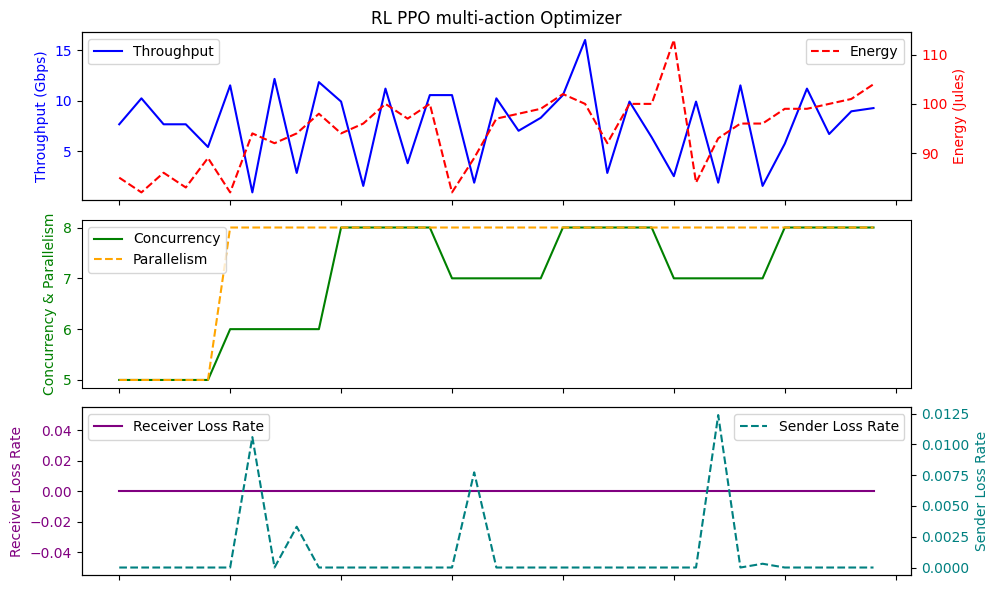

Average Throughput: 7.670857142857142
Total Energy: 3316.0
Total loss rate: 0.03430410098533096
                                Time  Throughput  LossRate     Score  \
count                             40    40.00000      40.0  40.00000   
mean   2024-02-19 03:49:58.704997376     7.09600       0.0   2.37500   
min       2024-02-18 00:33:45.380346     0.32000       0.0  -1.00000   
25%    2024-02-18 20:44:11.430487040     3.68000       0.0   1.00000   
50%    2024-02-19 11:14:24.977264896     7.36000       0.0   3.00000   
75%    2024-02-19 16:41:59.890139136    10.00000       0.0   3.00000   
max       2024-02-19 17:34:55.088675    13.76000       0.0   5.00000   
std                              NaN     3.63767       0.0   1.54733   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.662500   94.750000   0.002502  
min    32.600000   49.000000   0.000000  
25%    32.800000   92.000000   0.000000  
50%    33.000000   97.000000   0.000000  
75%

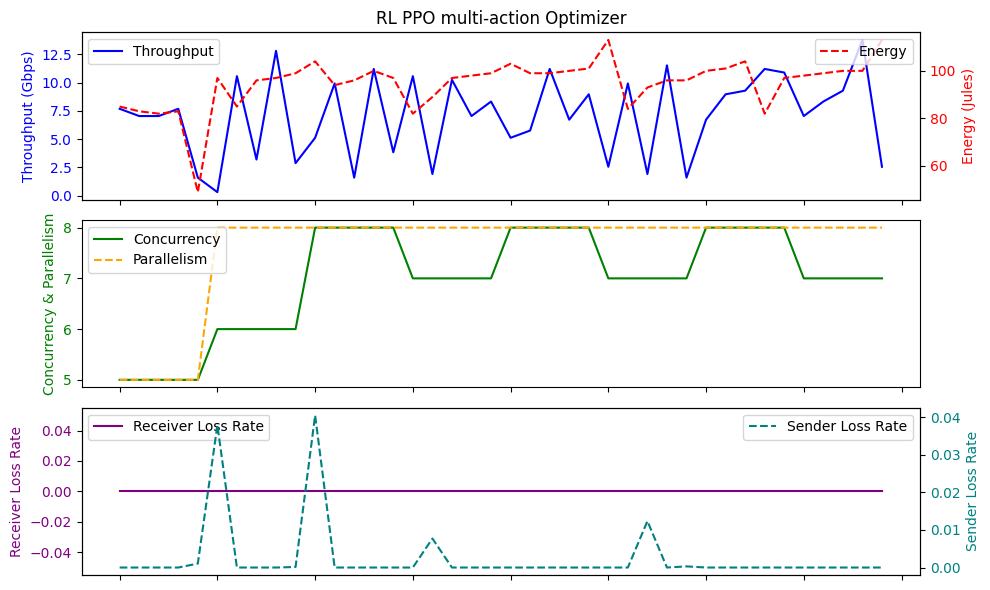

Average Throughput: 7.096000000000001
Total Energy: 3790.0
Total loss rate: 0.10007703521326551
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:10:48.741956864    8.228571       0.0   2.885714   
min       2024-02-18 00:33:48.384962    0.960000       0.0   0.000000   
25%    2024-02-19 05:34:07.753171200    6.400000       0.0   2.000000   
50%    2024-02-19 16:41:41.035406080    8.320000       0.0   3.000000   
75%    2024-02-19 16:42:00.631854080   10.720000       0.0   4.000000   
max       2024-02-19 17:34:50.087739   13.760000       0.0   7.000000   
std                              NaN    3.361184       0.0   1.622841   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.634286   96.657143   0.001473  
min    32.600000   82.000000   0.000000  
25%    32.800000   93.000000   0.000000  
50%    33.000000   99.000000   0.000

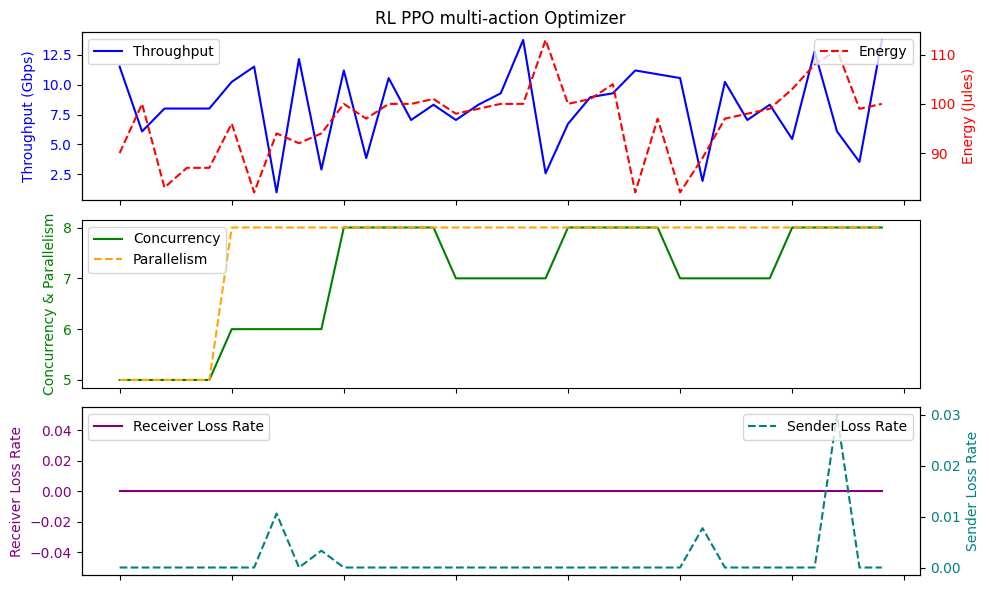

Average Throughput: 8.228571428571428
Total Energy: 3383.0
Total loss rate: 0.05154632910305519
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:33:33.014866688    7.926857       0.0   2.742857   
min       2024-02-18 00:33:49.371526    0.960000       0.0  -0.000000   
25%    2024-02-19 05:43:19.736998656    4.480000       0.0   2.000000   
50%    2024-02-19 16:41:43.039059968    8.320000       0.0   3.000000   
75%    2024-02-19 17:08:12.368090880   10.720000       0.0   4.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    4.010404       0.0   1.559466   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   35.331429   94.628571   0.001479  
min    32.600000   58.000000   0.000000  
25%    32.850000   90.500000   0.000000  
50%    33.200000   98.000000   0.000

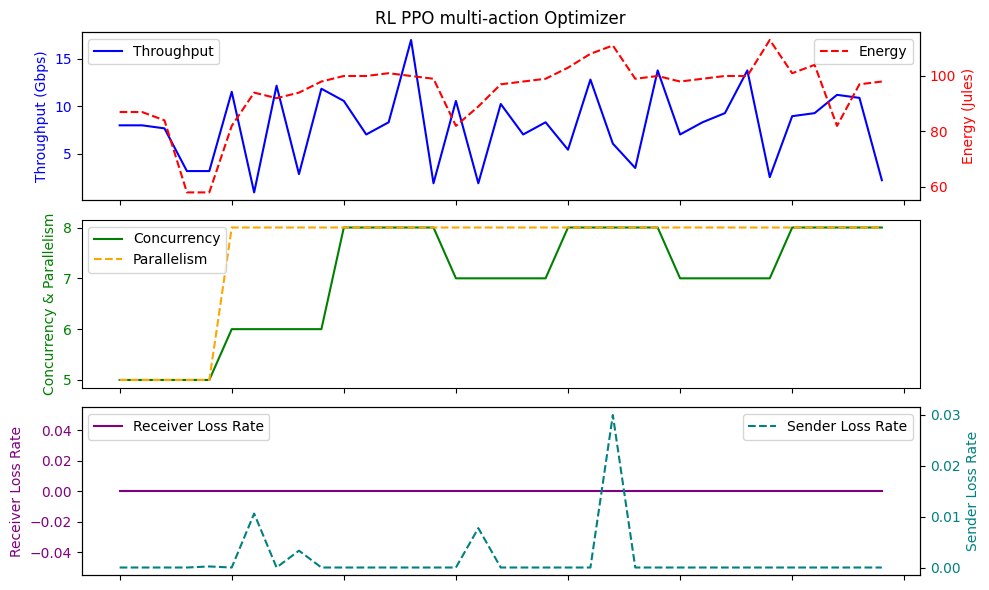

Average Throughput: 7.926857142857143
Total Energy: 3312.0
Total loss rate: 0.05175302341508609
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 03:39:49.115523072    8.100571       0.0   2.771429   
min       2024-02-18 00:33:47.346358    0.960000       0.0   0.000000   
25%    2024-02-18 03:54:06.331294464    5.920000       0.0   2.000000   
50%    2024-02-19 16:41:43.039059968    8.320000       0.0   3.000000   
75%    2024-02-19 17:21:28.499252480   11.360000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   5.000000   
std                              NaN    4.212356       0.0   1.591997   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.688571   96.314286   0.000971  
min    32.500000   82.000000   0.000000  
25%    32.750000   92.500000   0.000000  
50%    33.000000   99.000000   0.000

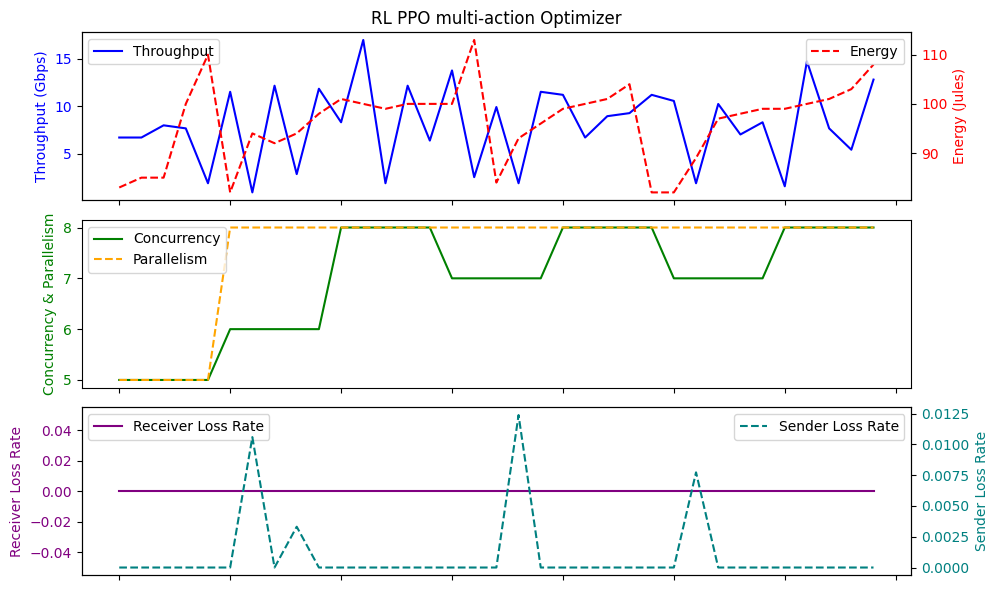

Average Throughput: 8.10057142857143
Total Energy: 3371.0
Total loss rate: 0.03399793522440467
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:08:34.027749632    8.128000       0.0   2.800000   
min       2024-02-18 00:33:50.347230    0.320000       0.0   0.000000   
25%    2024-02-18 00:44:42.817366016    5.440000       0.0   1.500000   
50%    2024-02-19 05:47:11.915856896    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   11.040000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   14.720000       0.0   5.000000   
std                              NaN    4.141279       0.0   1.605139   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.640000   95.057143   0.001650  
min    32.500000   82.000000   0.000000  
25%    32.700000   89.000000   0.000000  
50%    33.000000   97.000000   0.0000

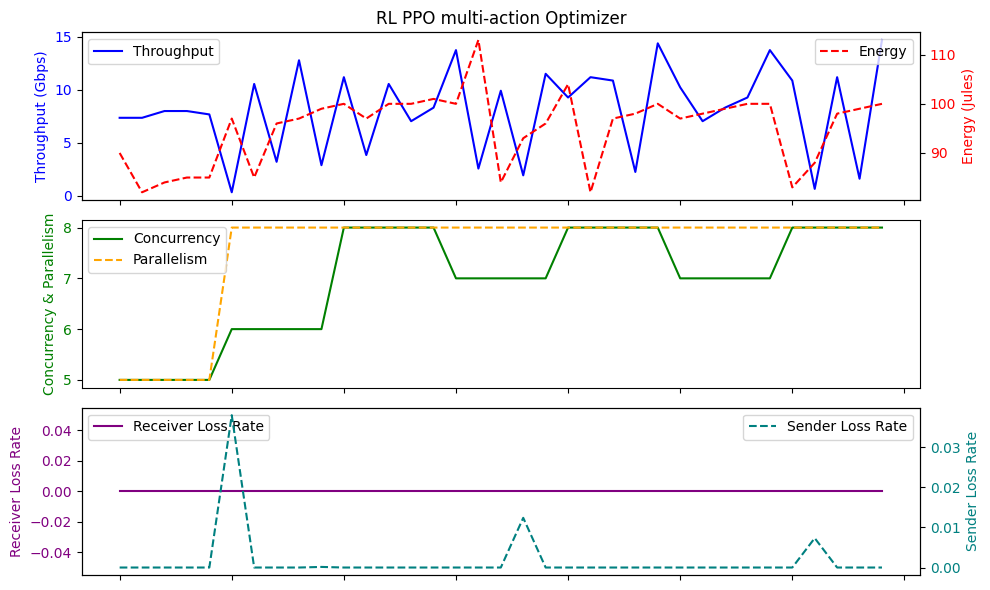

Average Throughput: 8.128000000000002
Total Energy: 3327.0
Total loss rate: 0.057766908348297785
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 15:19:05.724214528    7.853714       0.0   2.714286   
min       2024-02-19 05:27:27.557583    0.960000       0.0   0.000000   
25%    2024-02-19 16:30:59.190130688    3.680000       0.0   1.000000   
50%    2024-02-19 16:41:58.623934976    8.000000       0.0   3.000000   
75%    2024-02-19 17:08:25.192359168   10.560000       0.0   4.000000   
max       2024-02-19 17:34:53.091833   16.000000       0.0   5.000000   
std                              NaN    4.067269       0.0   1.724758   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.702857   95.571429   0.001829  
min    32.600000   82.000000   0.000000  
25%    32.900000   90.500000   0.000000  
50%    33.100000   97.000000   0.00

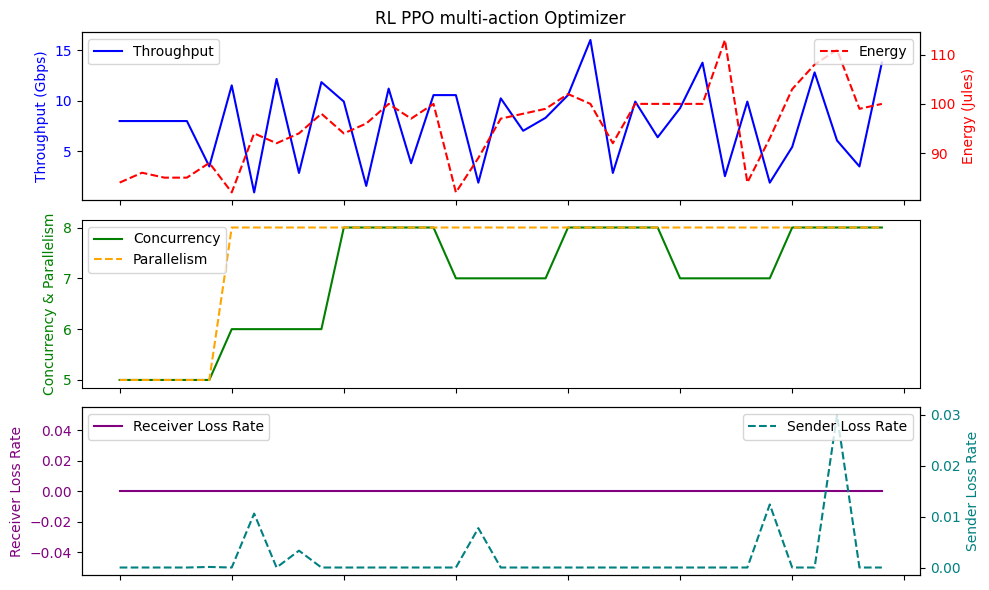

Average Throughput: 7.853714285714284
Total Energy: 3345.0
Total loss rate: 0.0640322413107505
                                Time  Throughput  LossRate      Score  \
count                             35    35.00000      35.0  35.000000   
mean   2024-02-19 03:55:06.893848832     8.06400       0.0   2.742857   
min       2024-02-18 00:33:48.384962     0.64000       0.0   0.000000   
25%    2024-02-18 15:08:35.538693120     4.64000       0.0   1.500000   
50%    2024-02-19 05:47:16.912542976     8.32000       0.0   3.000000   
75%    2024-02-19 17:34:49.080550912    11.36000       0.0   4.000000   
max       2024-02-19 17:34:54.087974    16.96000       0.0   5.000000   
std                              NaN     4.30222       0.0   1.651076   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.740000   94.542857   0.002117  
min    32.500000   64.000000   0.000000  
25%    32.750000   86.500000   0.000000  
50%    33.000000   99.000000   0.0000

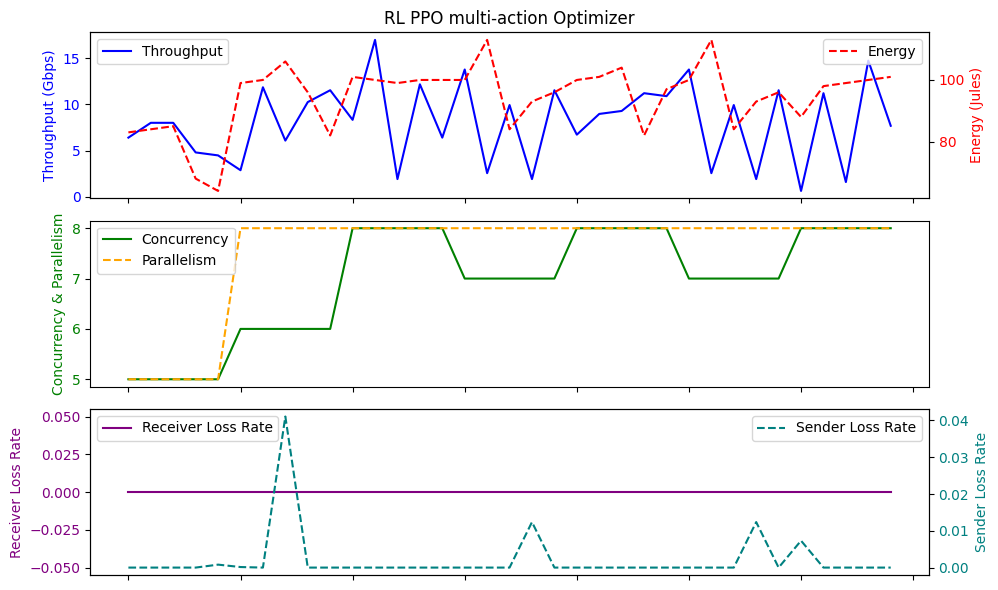

Average Throughput: 8.064000000000002
Total Energy: 3309.0
Total loss rate: 0.07407958459318006
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:04:48.102738944    8.402286       0.0   2.971429   
min       2024-02-18 00:44:39.305043    0.640000       0.0  -0.000000   
25%    2024-02-19 05:22:56.951966976    6.720000       0.0   2.000000   
50%    2024-02-19 16:41:43.039059968    8.320000       0.0   3.000000   
75%    2024-02-19 17:08:35.013478912   10.720000       0.0   5.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    4.148649       0.0   1.671310   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.305714   97.342857   0.001387  
min    32.600000   83.000000   0.000000  
25%    32.800000   96.500000   0.000000  
50%    33.100000   99.000000   0.000

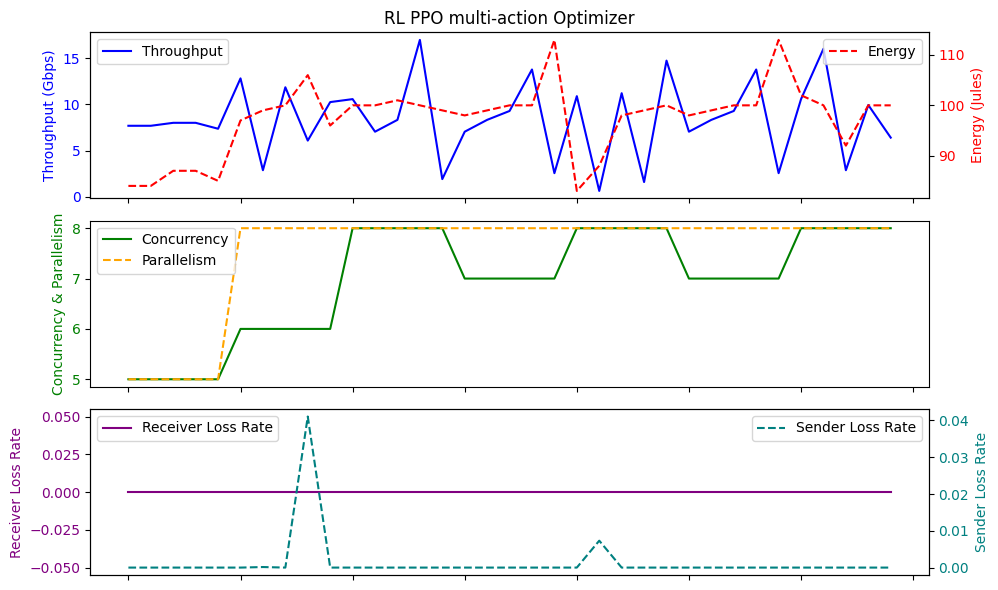

Average Throughput: 8.402285714285714
Total Energy: 3407.0
Total loss rate: 0.04852791584787627
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 04:15:39.975432960    6.992000       0.0   2.400000   
min       2024-02-18 00:33:50.347230    0.320000       0.0  -1.000000   
25%    2024-02-18 22:23:59.986749184    2.480000       0.0   1.000000   
50%    2024-02-19 11:14:24.977264896    8.000000       0.0   3.000000   
75%    2024-02-19 17:34:50.588867584   10.880000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.400000       0.0   5.000000   
std                              NaN    4.451514       0.0   1.794579   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   34.155000   94.850000   0.003092  
min    32.600000   82.000000   0.000000  
25%    32.900000   86.750000   0.000000  
50%    33.200000   96.000000   0.000

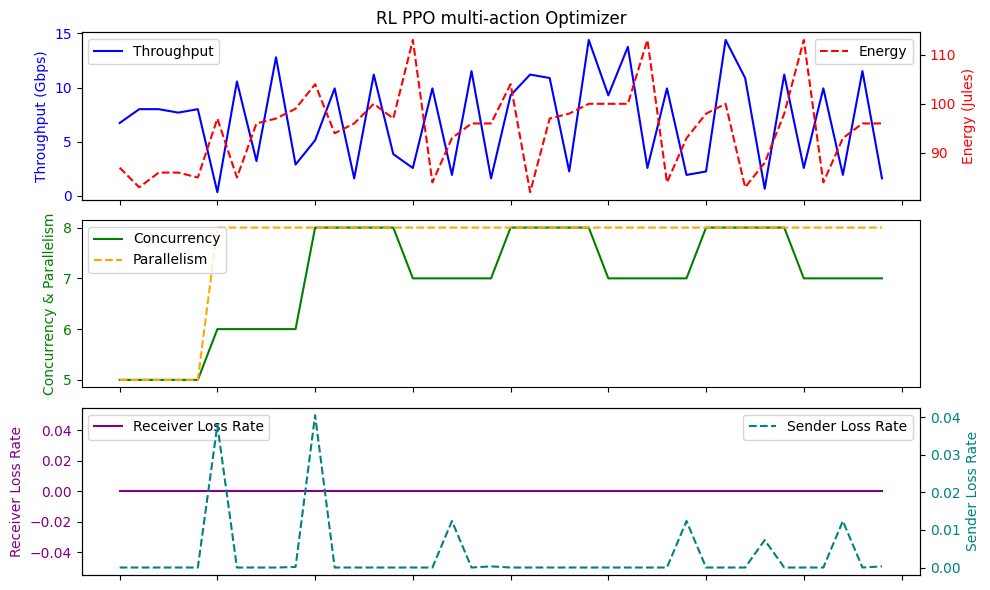

Average Throughput: 6.991999999999999
Total Energy: 3794.0
Total loss rate: 0.12366641134383527
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-18 22:47:14.808222208    7.817143       0.0   2.628571   
min       2024-02-18 00:33:47.346358    1.280000       0.0   0.000000   
25%    2024-02-18 00:34:03.641153792    6.240000       0.0   1.500000   
50%    2024-02-19 05:47:13.916332032    8.960000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.560000       0.0   3.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    3.784927       0.0   1.476994   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.931429   94.828571   0.001840  
min    32.500000   52.000000   0.000000  
25%    32.800000   89.500000   0.000000  
50%    33.100000   98.000000   0.000

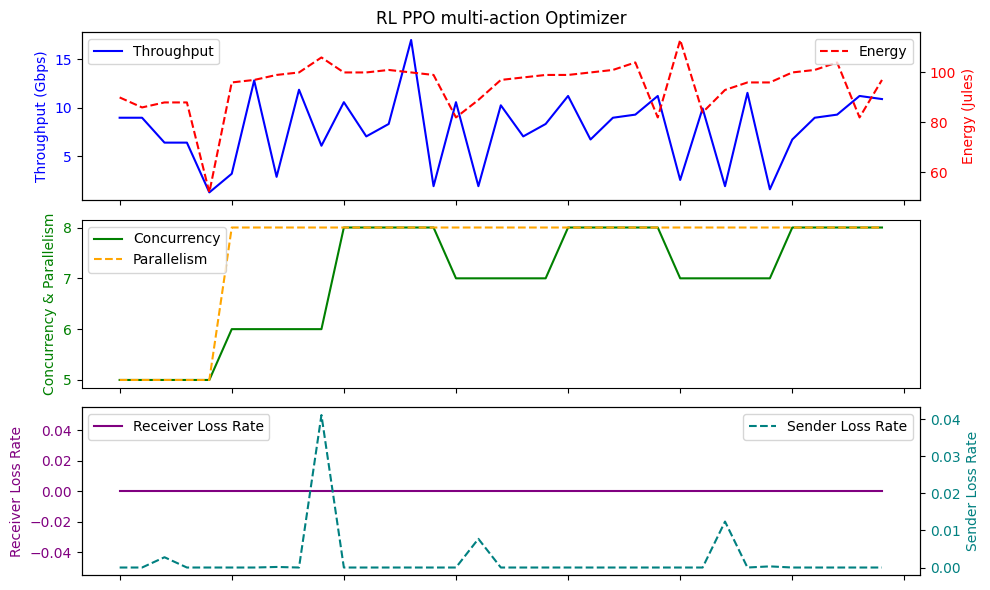

Average Throughput: 7.817142857142858
Total Energy: 3319.0
Total loss rate: 0.06438801294318437
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:54:33.070739200    8.018286       0.0   2.657143   
min       2024-02-18 00:44:39.305043    0.640000       0.0  -1.000000   
25%    2024-02-19 16:30:41.439589888    5.280000       0.0   1.500000   
50%    2024-02-19 16:41:38.032880896    8.320000       0.0   3.000000   
75%    2024-02-19 16:42:00.137377536   11.040000       0.0   4.000000   
max       2024-02-19 17:34:49.080551   14.720000       0.0   6.000000   
std                              NaN    4.075111       0.0   1.846186   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.545714   95.885714   0.002840  
min    32.600000   82.000000   0.000000  
25%    32.700000   93.000000   0.000000  
50%    33.000000   98.000000   0.000

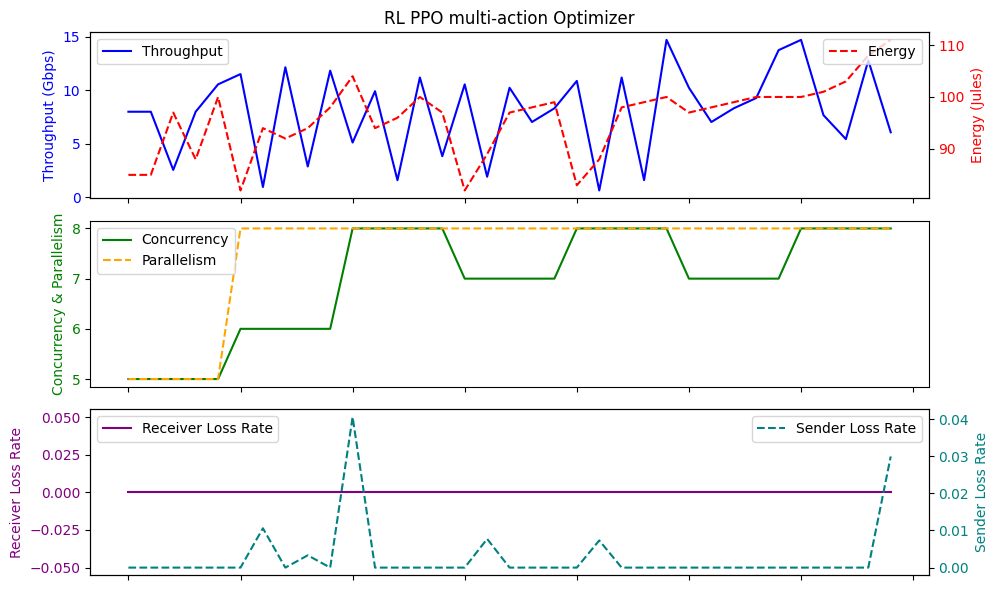

Average Throughput: 8.018285714285714
Total Energy: 3356.0
Total loss rate: 0.09939896593778656
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 03:56:52.200731136    7.341714       0.0   2.600000   
min       2024-02-18 00:33:45.380346    0.320000       0.0   0.000000   
25%    2024-02-18 00:33:49.371525888    3.520000       0.0   1.000000   
50%    2024-02-19 16:30:41.941071872    8.000000       0.0   2.000000   
75%    2024-02-19 17:34:49.584144896   10.560000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   6.000000   
std                              NaN    4.043951       0.0   1.683833   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.071429   97.485714   0.001804  
min    32.500000   84.000000   0.000000  
25%    32.800000   96.000000   0.000000  
50%    33.000000   99.000000   0.000

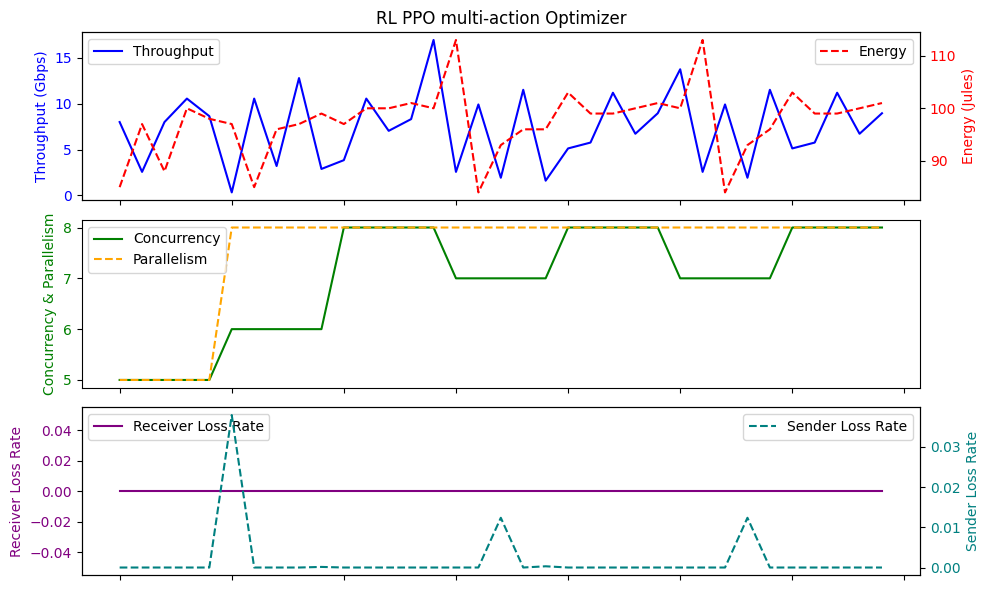

Average Throughput: 7.341714285714285
Total Energy: 3412.0
Total loss rate: 0.06313289531623674
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 00:23:20.390800128    7.515429       0.0   2.514286   
min       2024-02-18 00:33:45.380346    0.960000       0.0  -1.000000   
25%    2024-02-18 00:34:03.641153792    5.120000       0.0   1.500000   
50%    2024-02-19 16:30:57.684354048    7.680000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.400000       0.0   3.000000   
max       2024-02-19 17:34:50.087739   13.760000       0.0   5.000000   
std                              NaN    3.496281       0.0   1.521830   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.574286   94.342857   0.001782  
min    32.600000   48.000000   0.000000  
25%    32.750000   90.500000   0.000000  
50%    33.000000   98.000000   0.000

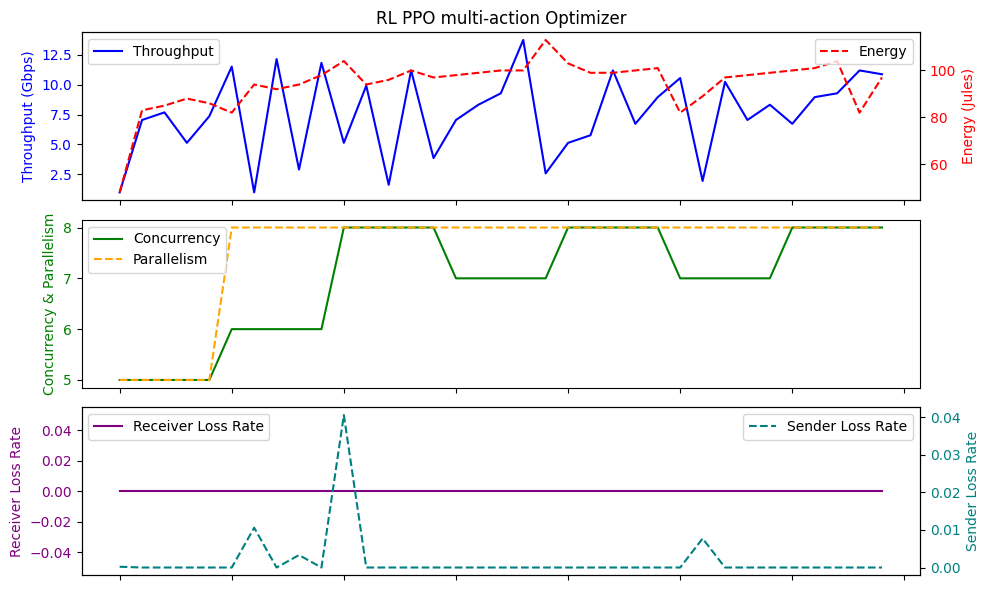

Average Throughput: 7.515428571428572
Total Energy: 3302.0
Total loss rate: 0.06236653062307259
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:40:06.722873600    8.146286       0.0   2.828571   
min       2024-02-18 00:44:42.324378    1.600000       0.0   0.000000   
25%    2024-02-19 05:47:12.413795584    4.480000       0.0   1.500000   
50%    2024-02-19 17:08:11.855192064    7.680000       0.0   3.000000   
75%    2024-02-19 17:34:45.622372864   12.000000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   6.000000   
std                              NaN    4.354783       0.0   1.671310   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.882857   98.514286   0.001213  
min    32.600000   84.000000   0.000000  
25%    32.700000   96.500000   0.000000  
50%    33.200000  100.000000   0.000

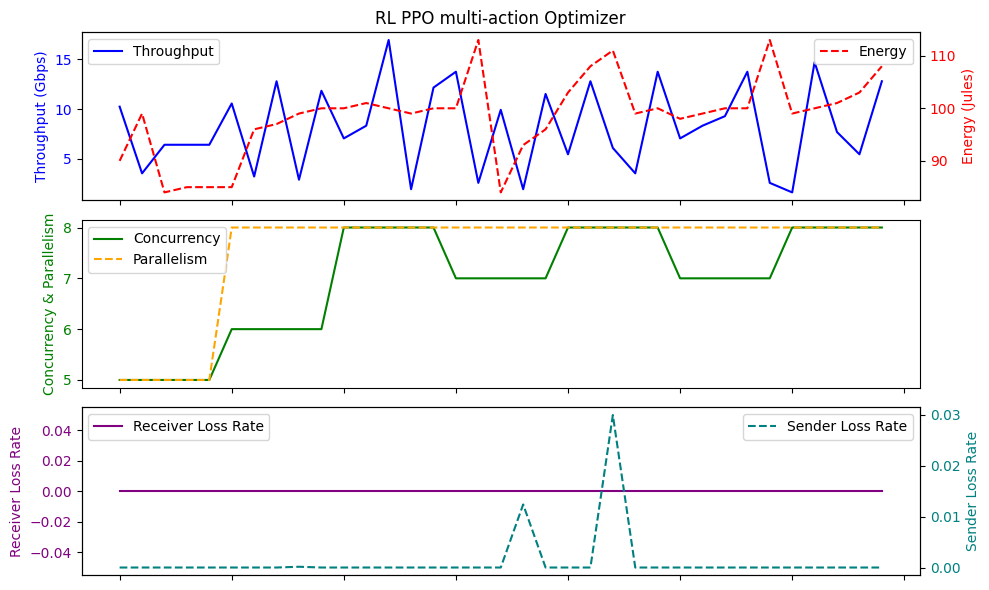

Average Throughput: 8.146285714285716
Total Energy: 3448.0
Total loss rate: 0.042447095532882985
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:54:47.039201280    7.451429       0.0   2.514286   
min       2024-02-18 00:33:45.380346    0.320000       0.0   0.000000   
25%    2024-02-19 15:12:03.692331008    4.480000       0.0   1.000000   
50%    2024-02-19 16:41:39.042042880    7.680000       0.0   3.000000   
75%    2024-02-19 17:08:12.368090880   10.560000       0.0   3.500000   
max       2024-02-19 17:34:53.091833   13.760000       0.0   5.000000   
std                              NaN    3.916548       0.0   1.686825   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.534286   96.314286   0.001981  
min    32.600000   82.000000   0.000000  
25%    32.800000   93.000000   0.000000  
50%    33.100000   98.000000   0.00

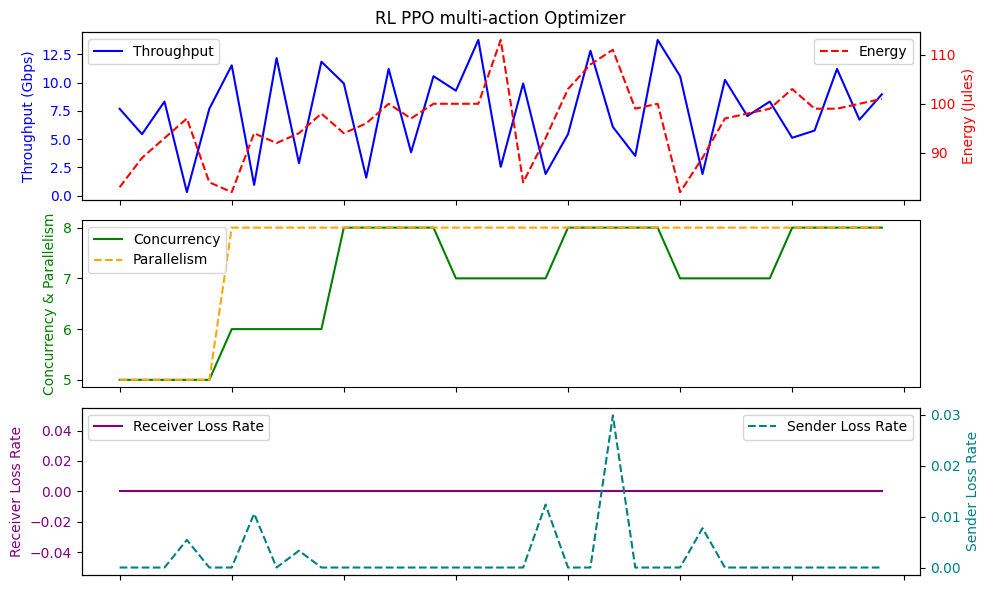

Average Throughput: 7.45142857142857
Total Energy: 3371.0
Total loss rate: 0.06934221727599714
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 05:17:32.263290880    7.232000       0.0   2.425000   
min       2024-02-18 00:34:04.652752    0.320000       0.0   0.000000   
25%    2024-02-18 22:31:32.776942080    2.480000       0.0   1.000000   
50%    2024-02-19 15:43:52.898877952    8.320000       0.0   3.000000   
75%    2024-02-19 16:55:12.744028416   10.880000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.400000       0.0   5.000000   
std                              NaN    4.489835       0.0   1.708013   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.950000   94.325000   0.002137  
min    32.600000   82.000000   0.000000  
25%    32.800000   88.750000   0.000000  
50%    33.150000   96.500000   0.0000

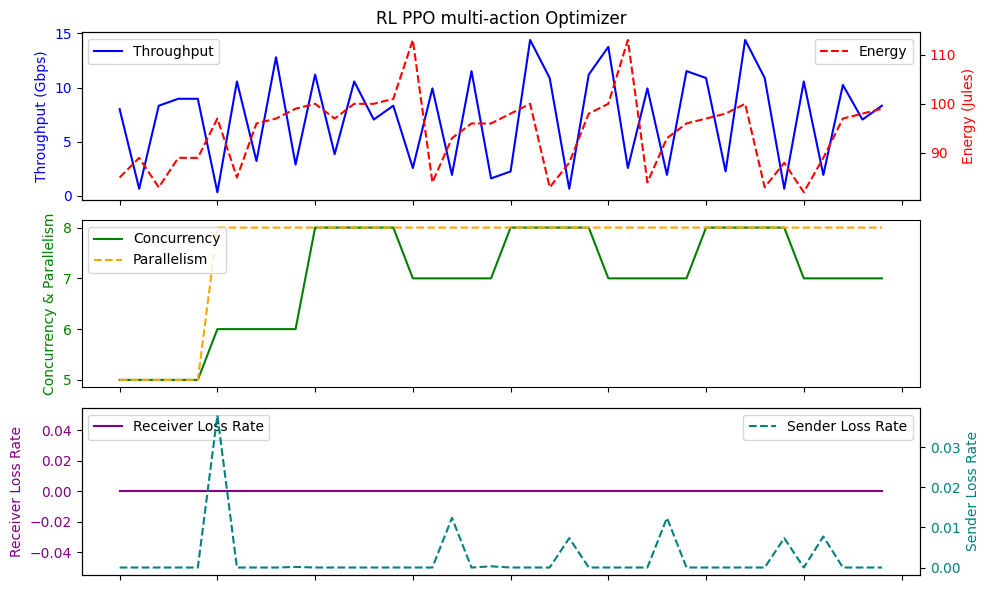

Average Throughput: 7.232000000000001
Total Energy: 3773.0
Total loss rate: 0.085487917844497
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 01:13:40.525043968    7.469714       0.0   2.628571   
min       2024-02-18 00:33:45.380346    0.960000       0.0  -1.000000   
25%    2024-02-18 00:34:06.139406336    4.480000       0.0   1.000000   
50%    2024-02-19 16:30:57.684354048    8.000000       0.0   3.000000   
75%    2024-02-19 16:42:00.137377536   11.040000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.400000       0.0   5.000000   
std                              NaN    3.864972       0.0   1.699234   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.228571   95.885714   0.001918  
min    32.500000   77.000000   0.000000  
25%    32.750000   93.500000   0.000000  
50%    33.000000   97.000000   0.00000

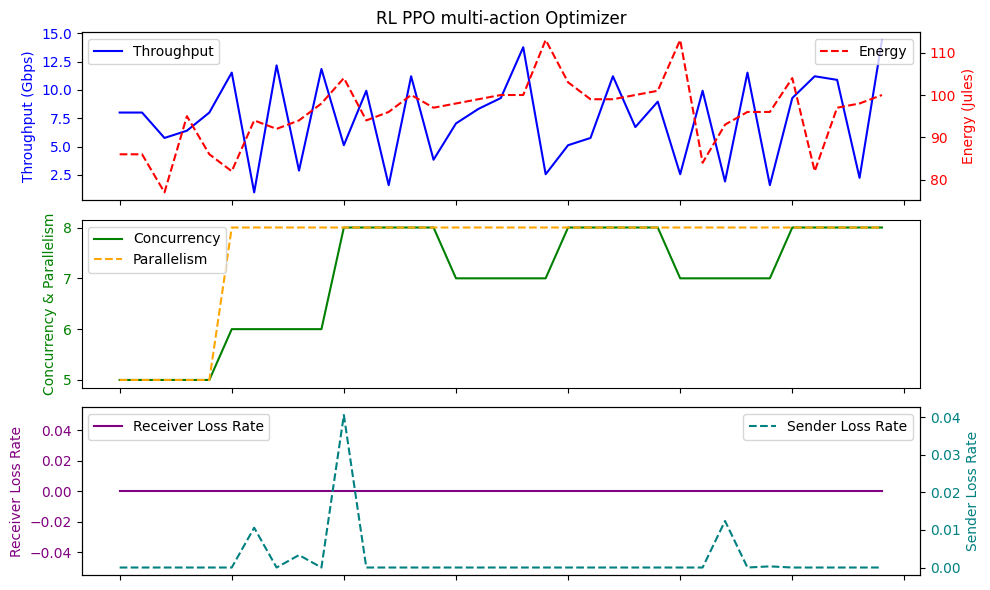

Average Throughput: 7.469714285714286
Total Energy: 3356.0
Total loss rate: 0.06711660751673028
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 03:16:16.436367104    7.396571       0.0   2.514286   
min       2024-02-18 00:33:47.346358    0.640000       0.0  -1.000000   
25%    2024-02-18 14:31:51.513622016    3.520000       0.0   1.000000   
50%    2024-02-19 05:47:13.916332032    8.000000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.400000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.720000       0.0   5.000000   
std                              NaN    3.857038       0.0   1.721344   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.340000   95.171429   0.001955  
min    32.500000   82.000000   0.000000  
25%    32.700000   89.500000   0.000000  
50%    32.900000   97.000000   0.000

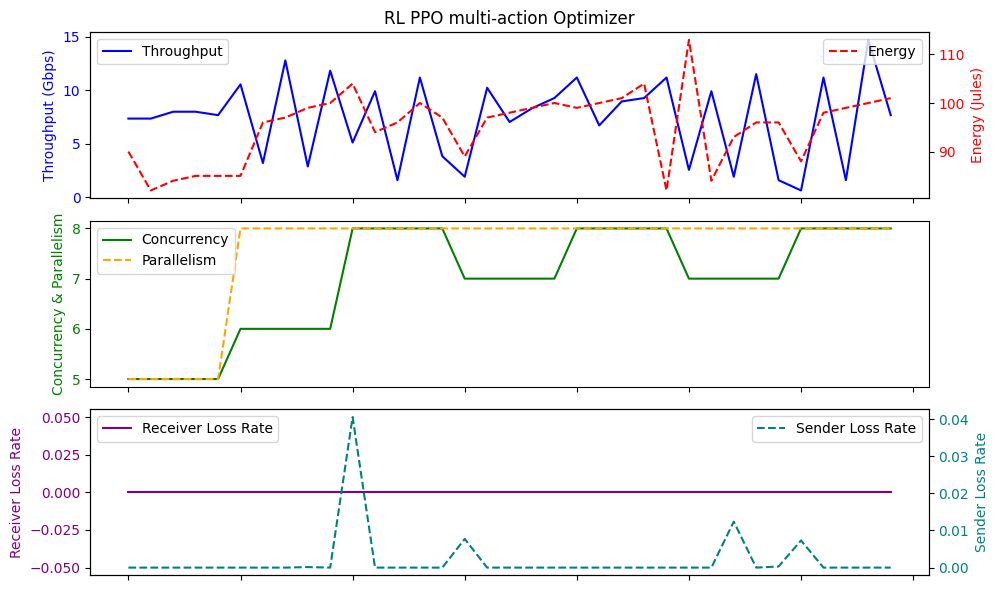

Average Throughput: 7.396571428571429
Total Energy: 3331.0
Total loss rate: 0.0684080288963531
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:18:43.706429440    7.670857       0.0   2.628571   
min       2024-02-18 00:33:45.380346    0.640000       0.0   0.000000   
25%    2024-02-18 00:44:41.838843648    5.120000       0.0   1.000000   
50%    2024-02-19 05:47:14.912572928    8.000000       0.0   3.000000   
75%    2024-02-19 17:08:22.374684416   10.720000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    4.088792       0.0   1.681836   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.068571   95.314286   0.002111  
min    32.600000   82.000000   0.000000  
25%    32.800000   88.500000   0.000000  
50%    33.100000   98.000000   0.0000

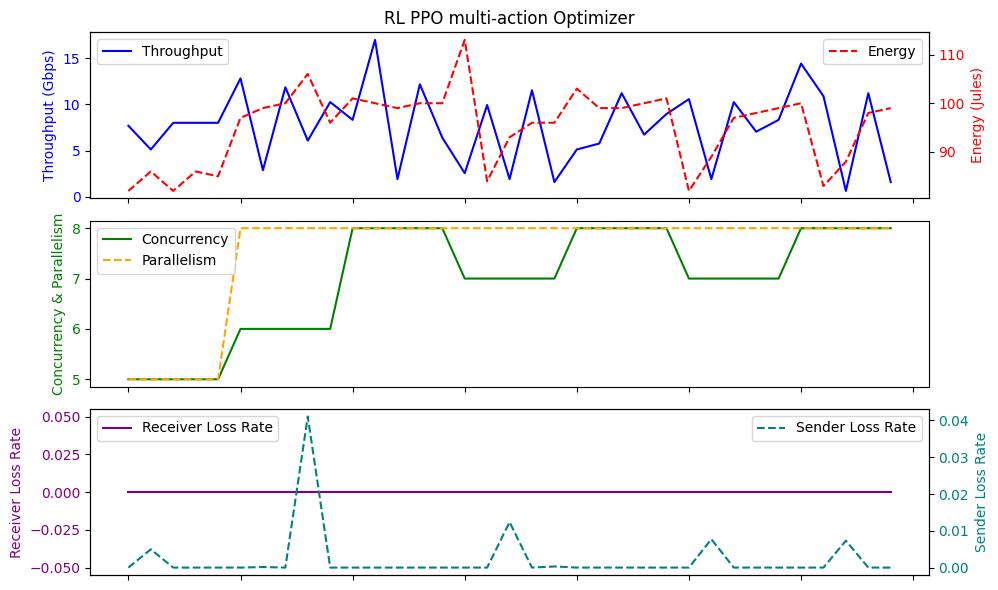

Average Throughput: 7.670857142857144
Total Energy: 3336.0
Total loss rate: 0.07389732311796506
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 05:38:18.982742016    8.283429       0.0   2.857143   
min       2024-02-18 00:33:48.384962    1.600000       0.0   0.000000   
25%    2024-02-19 05:41:28.173526016    6.880000       0.0   2.000000   
50%    2024-02-19 16:41:37.048397056    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.560000       0.0   4.000000   
max       2024-02-19 17:34:49.080551   14.720000       0.0   5.000000   
std                              NaN    3.411170       0.0   1.593052   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.357143   96.171429   0.001398  
min    32.600000   82.000000   0.000000  
25%    32.800000   95.000000   0.000000  
50%    33.200000   98.000000   0.000

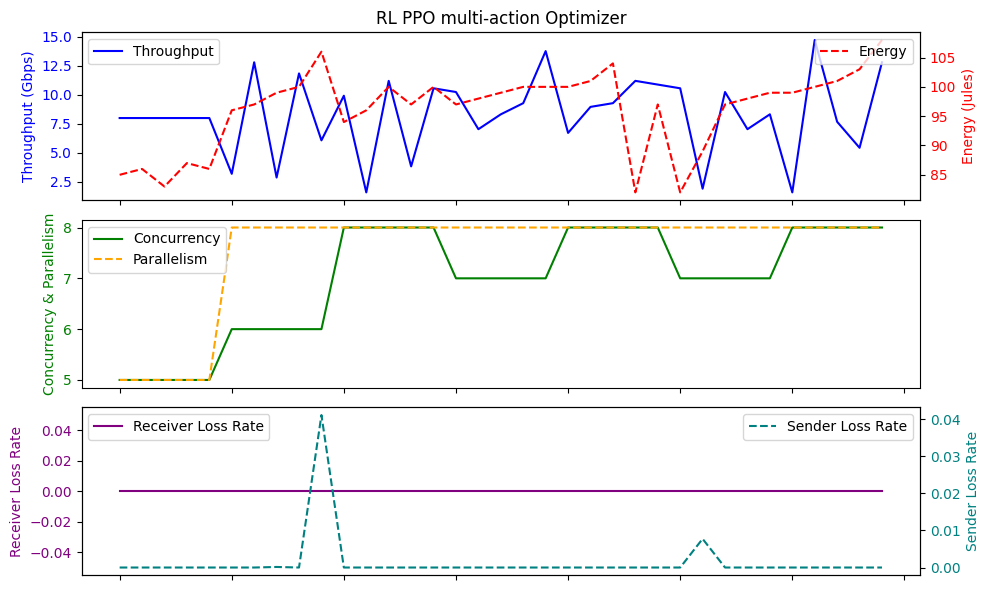

Average Throughput: 8.283428571428573
Total Energy: 3366.0
Total loss rate: 0.0489382617013519
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 13:33:45.268841984    7.780571       0.0   2.628571   
min       2024-02-19 03:27:35.694217    0.320000       0.0   0.000000   
25%    2024-02-19 05:47:13.414033152    3.040000       0.0   1.000000   
50%    2024-02-19 16:41:59.642900992    7.680000       0.0   3.000000   
75%    2024-02-19 17:08:33.557771008   10.560000       0.0   4.000000   
max       2024-02-19 17:34:53.091833   16.960000       0.0   5.000000   
std                              NaN    4.592058       0.0   1.628527   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.520000   93.257143   0.001692  
min    32.600000   49.000000   0.000000  
25%    32.750000   90.500000   0.000000  
50%    33.000000   98.000000   0.0000

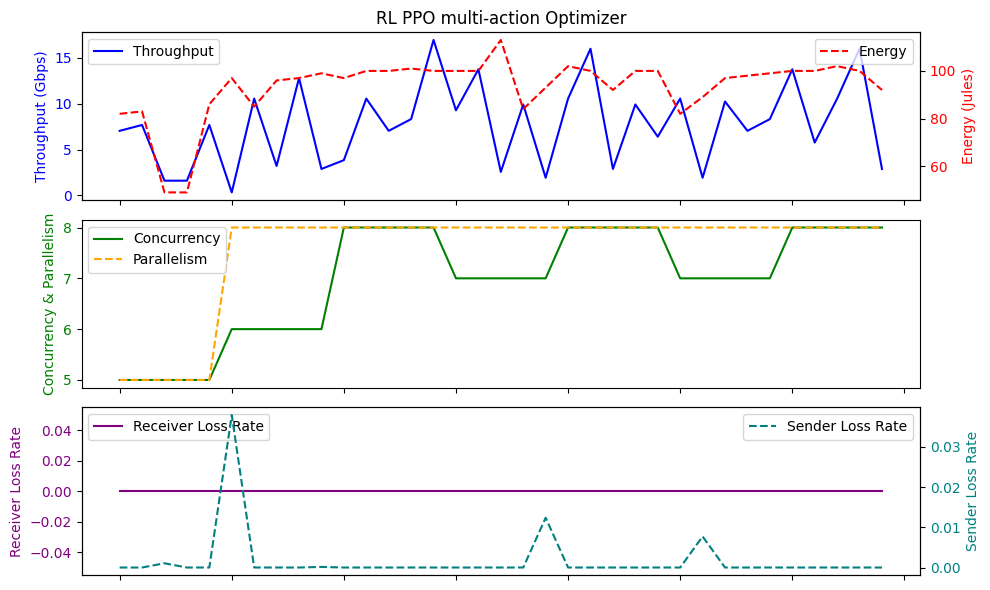

Average Throughput: 7.780571428571428
Total Energy: 3264.0
Total loss rate: 0.05923312484253606
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 05:24:12.392342784    7.689143       0.0   2.485714   
min       2024-02-18 00:33:49.371526    0.960000       0.0  -0.000000   
25%    2024-02-18 13:21:10.404120064    4.640000       0.0   1.500000   
50%    2024-02-19 16:41:38.032880896    8.320000       0.0   3.000000   
75%    2024-02-19 16:42:00.137377536   10.560000       0.0   3.000000   
max       2024-02-19 17:34:50.087739   14.720000       0.0   5.000000   
std                              NaN    3.800967       0.0   1.462702   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.517143   93.171429   0.002551  
min    32.500000   52.000000   0.000000  
25%    32.700000   90.500000   0.000000  
50%    33.000000   98.000000   0.000

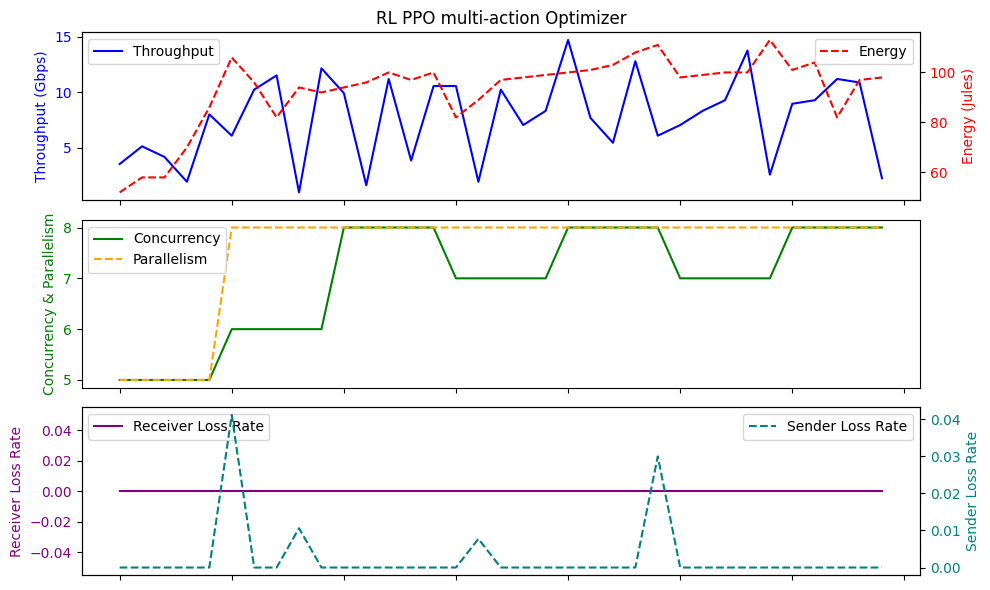

Average Throughput: 7.6891428571428575
Total Energy: 3261.0
Total loss rate: 0.08929811849327879
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 05:48:15.671111168    7.643429       0.0   2.714286   
min       2024-02-18 00:33:45.380346    1.600000       0.0   0.000000   
25%    2024-02-18 12:55:40.471860480    3.040000       0.0   1.000000   
50%    2024-02-19 16:41:43.039059968    8.000000       0.0   3.000000   
75%    2024-02-19 17:34:49.584144896   10.560000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    4.300800       0.0   1.619212   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.314286   96.828571   0.000720  
min    32.600000   83.000000   0.000000  
25%    32.850000   93.000000   0.000000  
50%    33.100000   99.000000   0.00

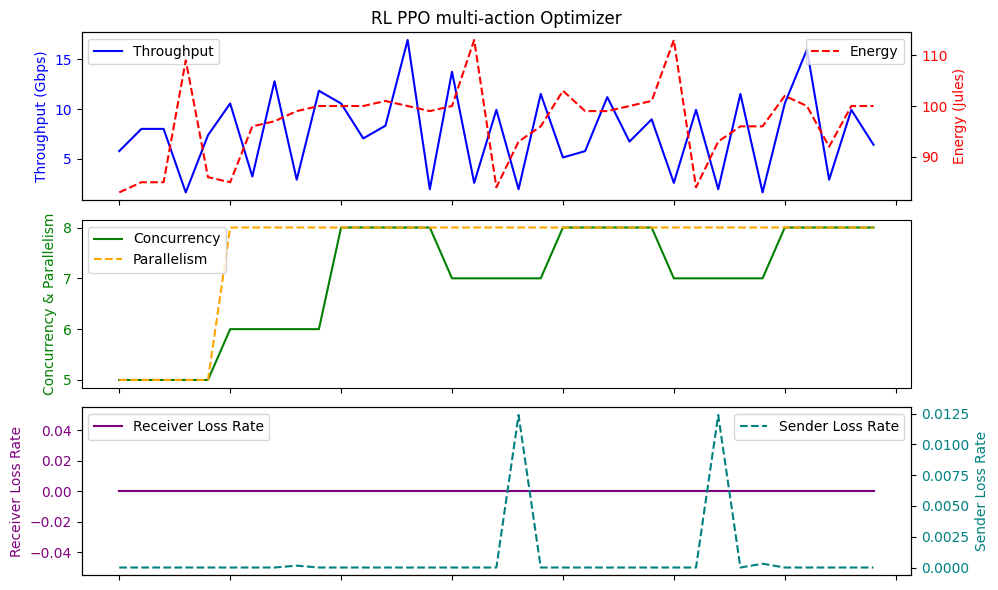

Average Throughput: 7.643428571428571
Total Energy: 3389.0
Total loss rate: 0.025204867415158747
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 04:04:13.366860544    7.451429       0.0   2.457143   
min       2024-02-18 00:33:49.371526    0.640000       0.0  -1.000000   
25%    2024-02-18 00:44:42.817366016    3.360000       0.0   1.000000   
50%    2024-02-19 16:30:57.684354048    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.720000       0.0   3.000000   
max       2024-02-19 17:34:48.081663   14.720000       0.0   5.000000   
std                              NaN    3.982888       0.0   1.720856   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.760000   93.800000   0.002206  
min    32.600000   82.000000   0.000000  
25%    32.700000   88.500000   0.000000  
50%    33.000000   97.000000   0.00

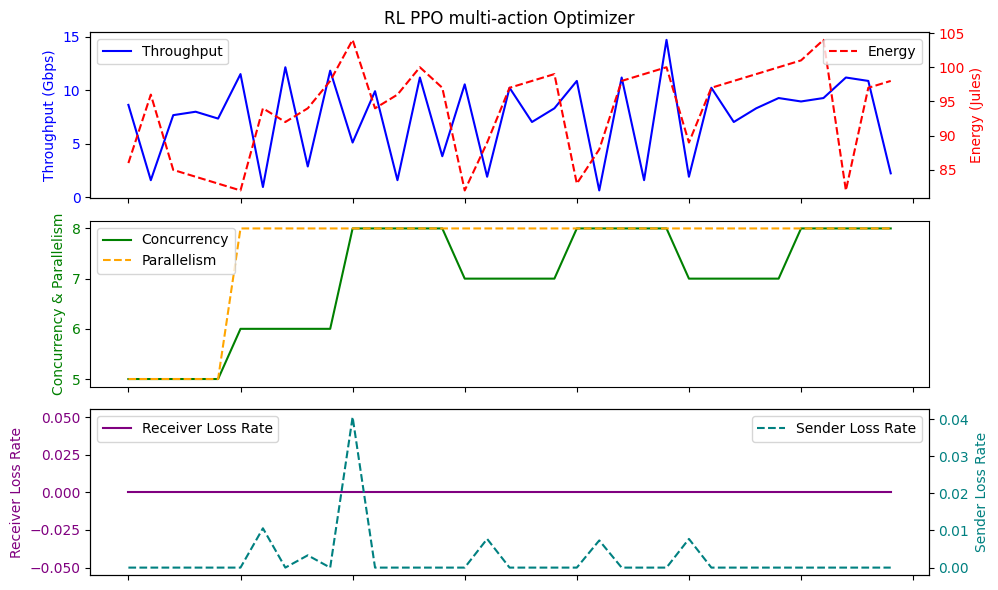

Average Throughput: 7.451428571428572
Total Energy: 3283.0
Total loss rate: 0.077201096705599
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:15:41.530638080    7.899429       0.0   2.771429   
min       2024-02-18 00:33:45.380346    0.320000       0.0   0.000000   
25%    2024-02-18 00:33:56.488392960    6.240000       0.0   2.000000   
50%    2024-02-19 05:47:11.915856896    8.000000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.560000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   5.000000   
std                              NaN    3.753353       0.0   1.554608   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.040000   95.457143   0.001662  
min    32.600000   82.000000   0.000000  
25%    32.800000   88.000000   0.000000  
50%    33.100000   99.000000   0.00000

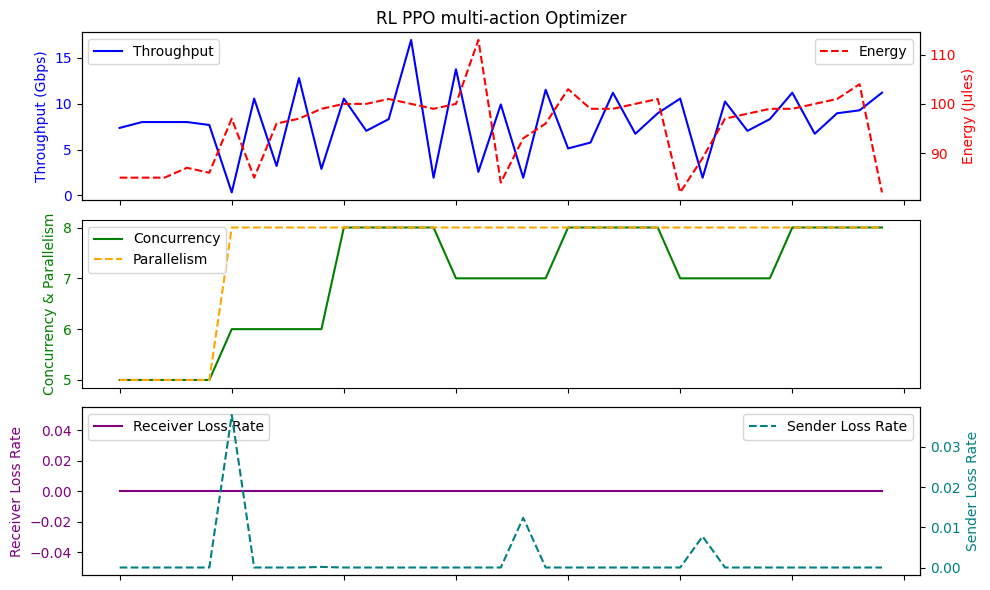

Average Throughput: 7.899428571428571
Total Energy: 3341.0
Total loss rate: 0.05817725420177342
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 11:23:17.334135808    8.228571       0.0   2.885714   
min       2024-02-18 11:37:08.787269    1.920000       0.0   0.000000   
25%    2024-02-19 05:47:14.414452480    5.760000       0.0   1.000000   
50%    2024-02-19 17:08:14.854258944    8.000000       0.0   3.000000   
75%    2024-02-19 17:34:45.622372864   11.680000       0.0   4.500000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   5.000000   
std                              NaN    4.075575       0.0   1.728165   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.231429   98.314286   0.002068  
min    32.500000   84.000000   0.000000  
25%    32.800000   96.000000   0.000000  
50%    33.000000  100.000000   0.000

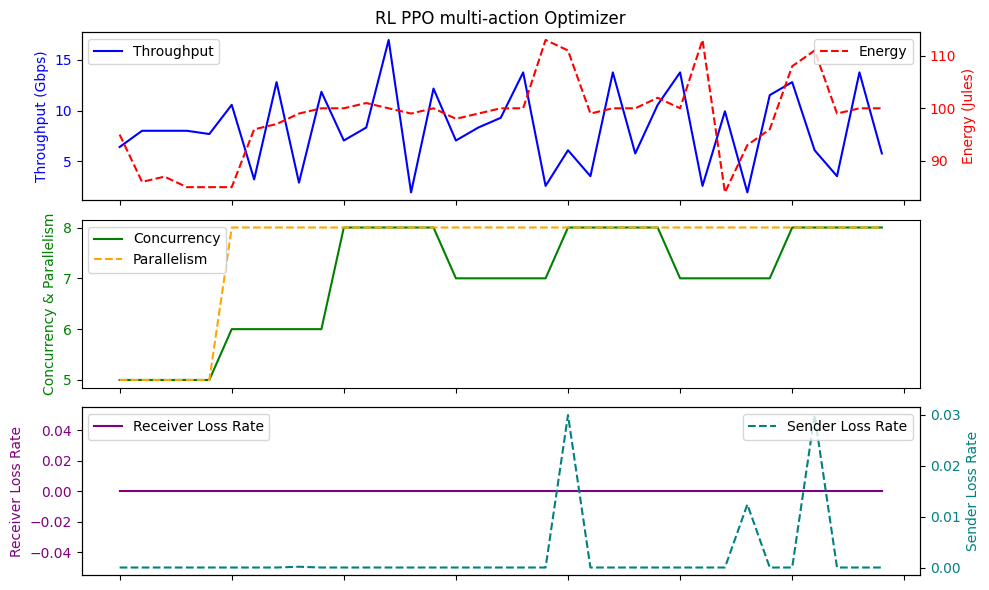

Average Throughput: 8.228571428571428
Total Energy: 3441.0
Total loss rate: 0.0723702028434744
                                Time  Throughput  LossRate      Score  \
count                             35    35.00000      35.0  35.000000   
mean   2024-02-19 09:14:06.021152256     8.25600       0.0   2.857143   
min       2024-02-18 00:34:05.644234     0.64000       0.0   0.000000   
25%    2024-02-19 05:39:58.009146880     6.08000       0.0   2.000000   
50%    2024-02-19 16:41:42.047324928     8.32000       0.0   3.000000   
75%    2024-02-19 16:55:07.743056384    10.72000       0.0   4.000000   
max       2024-02-19 17:34:50.087739    16.96000       0.0   5.000000   
std                              NaN     4.23306       0.0   1.574481   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.302857   95.000000   0.001091  
min    32.500000   82.000000   0.000000  
25%    32.700000   88.500000   0.000000  
50%    33.000000   98.000000   0.0000

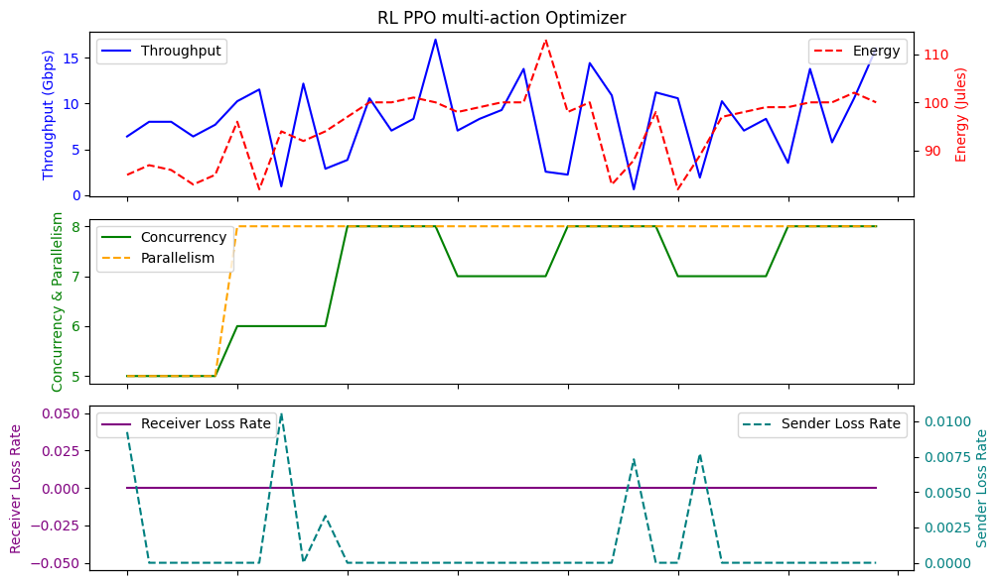

Average Throughput: 8.256
Total Energy: 3325.0
Total loss rate: 0.038178679322563615
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 04:43:31.492053760    7.917714       0.0   2.657143   
min       2024-02-18 00:33:45.380346    1.600000       0.0   0.000000   
25%    2024-02-19 05:34:59.726711296    6.400000       0.0   2.000000   
50%    2024-02-19 16:30:55.685808896    8.000000       0.0   3.000000   
75%    2024-02-19 16:41:57.636368896   10.400000       0.0   3.500000   
max       2024-02-19 17:08:11.855192   14.720000       0.0   5.000000   
std                              NaN    3.095073       0.0   1.493965   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.771429   95.457143   0.001619  
min    32.600000   82.000000   0.000000  
25%    32.800000   89.000000   0.000000  
50%    33.100000   99.000000   0.000000  
75%  

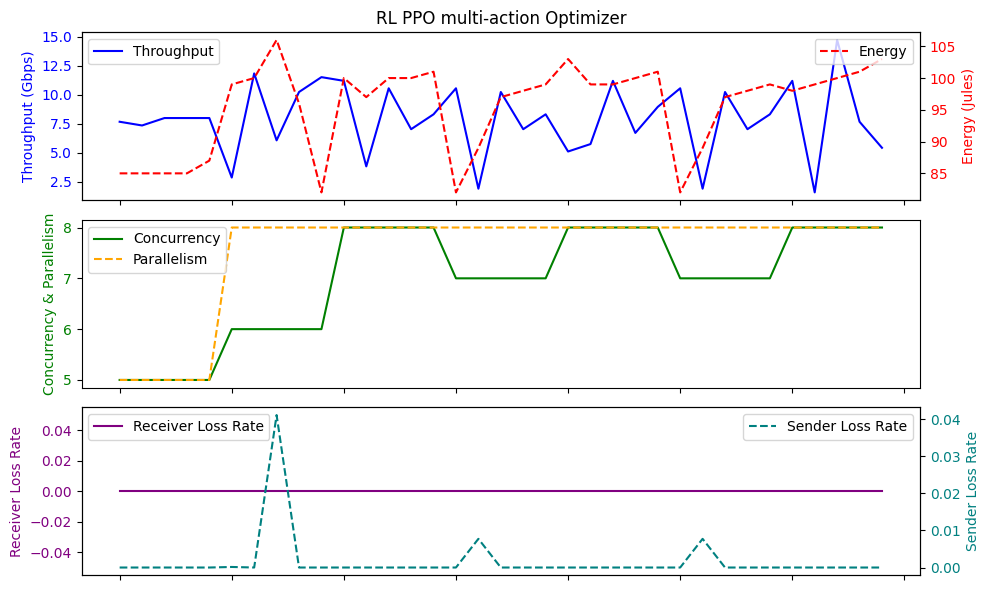

Average Throughput: 7.917714285714286
Total Energy: 3341.0
Total loss rate: 0.056663499779755745
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 15:09:24.943283200    8.365714       0.0   2.800000   
min       2024-02-19 05:47:14.912573    0.960000       0.0   0.000000   
25%    2024-02-19 16:30:56.189563904    6.240000       0.0   2.000000   
50%    2024-02-19 16:42:00.631854080    8.320000       0.0   3.000000   
75%    2024-02-19 17:08:33.041009920   10.560000       0.0   4.000000   
max       2024-02-19 17:34:49.080551   16.960000       0.0   5.000000   
std                              NaN    3.993137       0.0   1.623359   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.002857   95.428571   0.002788  
min    32.500000   53.000000   0.000000  
25%    32.750000   93.000000   0.000000  
50%    33.000000   99.000000   0.00

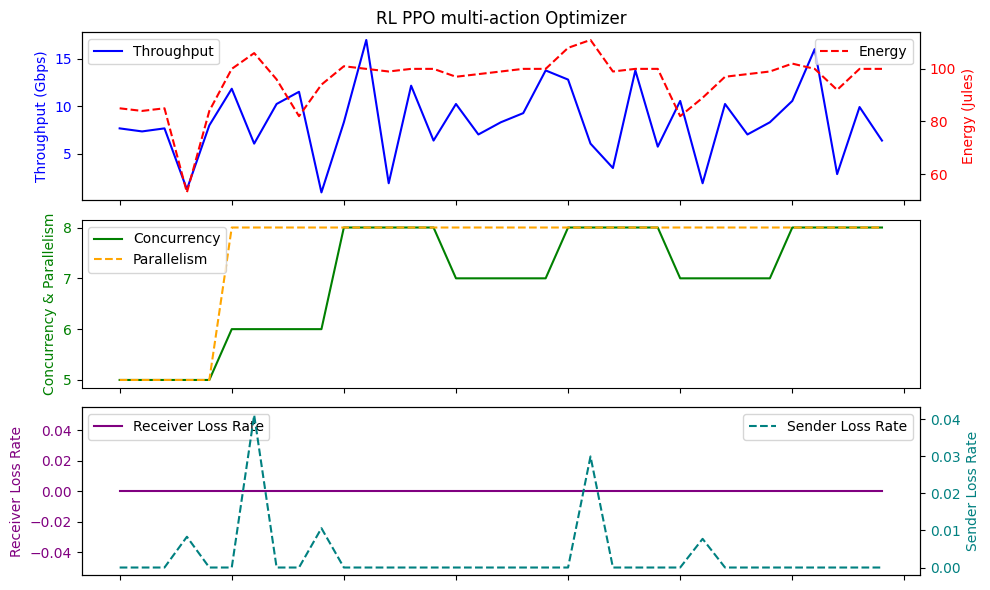

Average Throughput: 8.365714285714287
Total Energy: 3340.0
Total loss rate: 0.09757937005074815
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:14:33.660646912    7.616000       0.0   2.742857   
min       2024-02-18 00:33:49.371526    0.640000       0.0   0.000000   
25%    2024-02-18 00:44:42.817366016    2.720000       0.0   1.000000   
50%    2024-02-19 05:47:12.911734016    8.960000       0.0   3.000000   
75%    2024-02-19 17:34:49.584144896   11.040000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.720000       0.0   5.000000   
std                              NaN    4.269897       0.0   1.771388   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.711429   94.400000   0.000929  
min    32.600000   82.000000   0.000000  
25%    32.800000   85.000000   0.000000  
50%    33.100000   96.000000   0.000

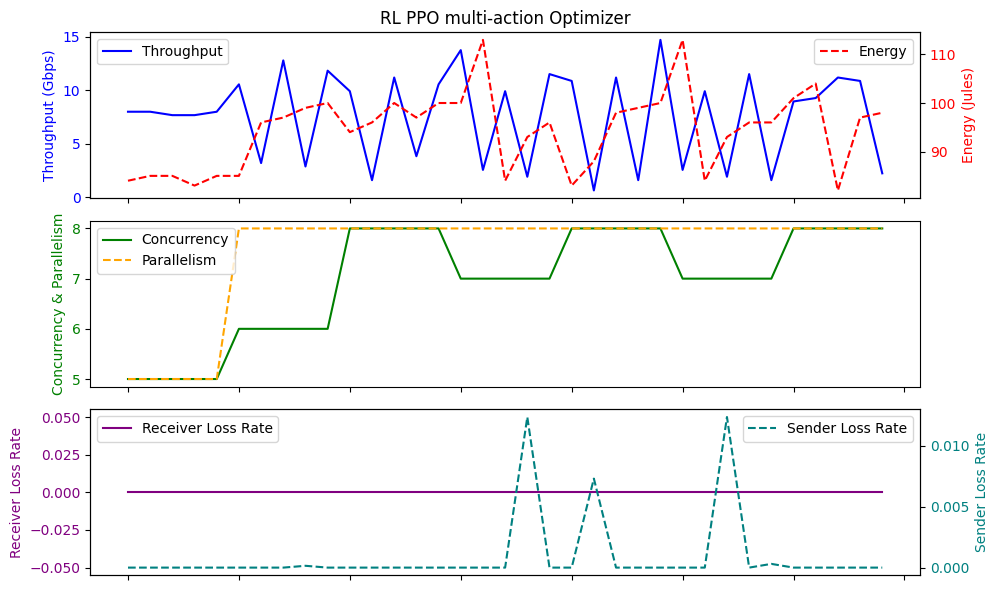

Average Throughput: 7.616000000000001
Total Energy: 3304.0
Total loss rate: 0.03251975964008696
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:10:36.018343936    7.981714       0.0   2.742857   
min       2024-02-18 00:33:50.347230    0.640000       0.0   0.000000   
25%    2024-02-18 00:44:40.849679872    4.000000       0.0   1.000000   
50%    2024-02-19 05:47:13.916332032    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.880000       0.0   3.500000   
max       2024-02-19 17:34:52.092254   14.400000       0.0   5.000000   
std                              NaN    3.996756       0.0   1.615055   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.594286   94.857143   0.001613  
min    32.600000   82.000000   0.000000  
25%    32.900000   87.500000   0.000000  
50%    33.300000   97.000000   0.000

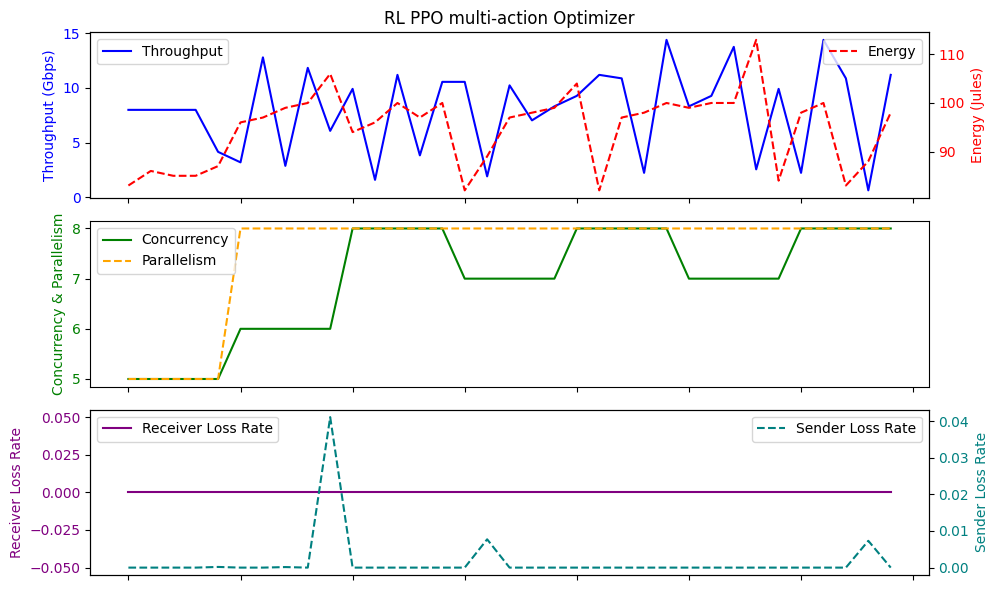

Average Throughput: 7.981714285714284
Total Energy: 3320.0
Total loss rate: 0.05643767165843417
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 07:16:35.986227456    7.762286       0.0   2.628571   
min       2024-02-18 00:44:39.305043    0.640000       0.0   0.000000   
25%    2024-02-18 12:03:24.325506816    2.560000       0.0   1.000000   
50%    2024-02-19 17:08:32.524249088    8.320000       0.0   3.000000   
75%    2024-02-19 17:34:49.080550912   11.520000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   5.000000   
std                              NaN    5.019210       0.0   1.816359   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.214286   95.771429   0.001340  
min    32.600000   82.000000   0.000000  
25%    32.750000   92.500000   0.000000  
50%    33.000000   98.000000   0.000

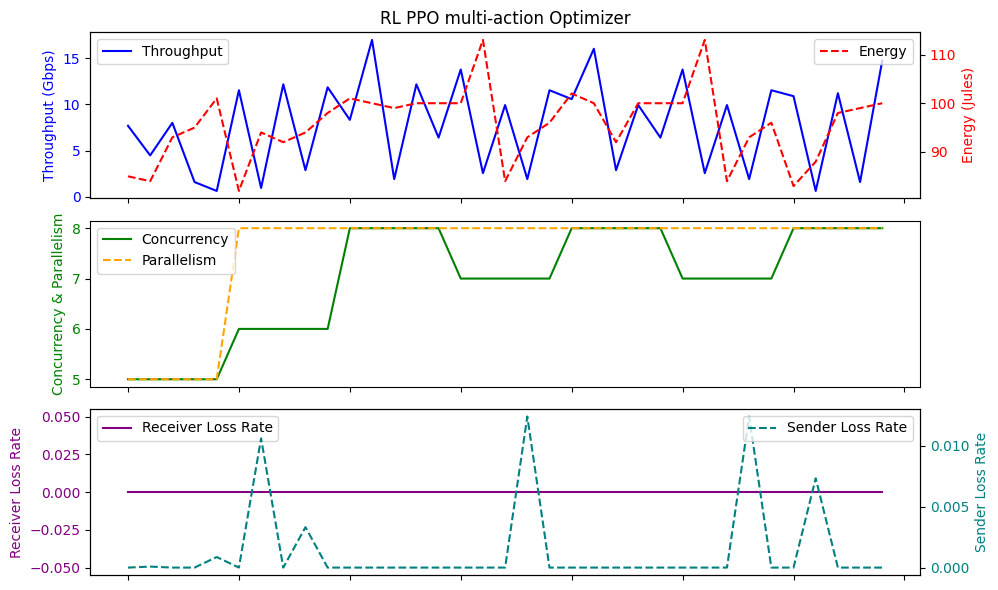

Average Throughput: 7.762285714285716
Total Energy: 3352.0
Total loss rate: 0.04691010425641448
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-18 22:45:12.411363584    8.365714       0.0   2.914286   
min       2024-02-18 00:33:50.347230    0.640000       0.0   0.000000   
25%    2024-02-18 00:44:40.849679872    5.760000       0.0   2.000000   
50%    2024-02-19 05:47:12.911734016    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:59.642900992   11.040000       0.0   4.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    4.118631       0.0   1.379928   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.880000   94.714286   0.000225  
min    32.600000   52.000000   0.000000  
25%    32.850000   96.000000   0.000000  
50%    33.200000   98.000000   0.000

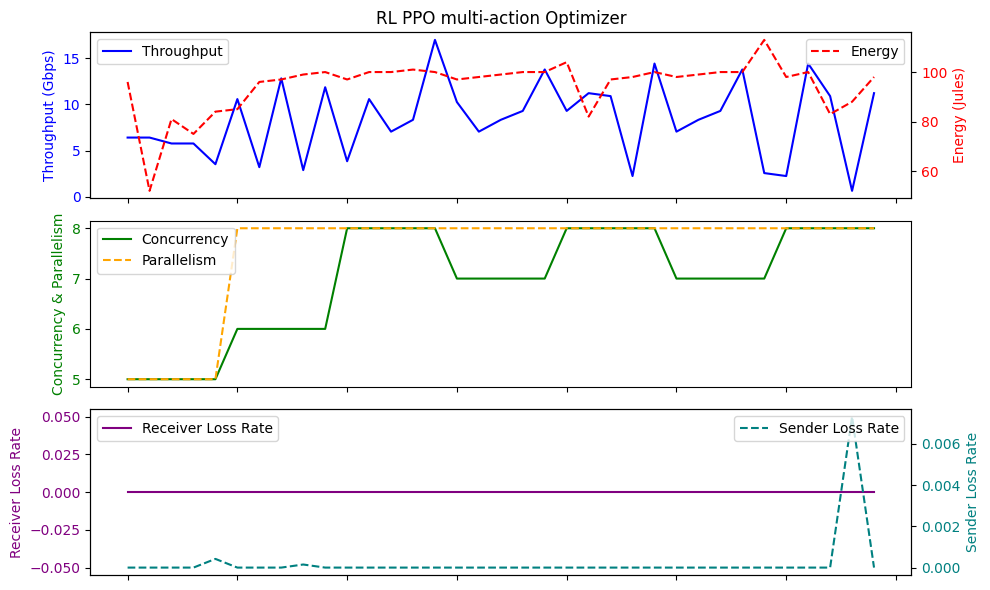

Average Throughput: 8.365714285714287
Total Energy: 3315.0
Total loss rate: 0.007885080080946624
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:33:06.797564416    7.835429       0.0   2.657143   
min       2024-02-18 00:33:50.347230    1.600000       0.0  -0.000000   
25%       2024-02-19 05:39:47.055264    4.480000       0.0   1.000000   
50%    2024-02-19 17:08:11.855192064    8.000000       0.0   3.000000   
75%    2024-02-19 17:34:49.584144896   11.360000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    4.176886       0.0   1.643935   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.362857   96.571429   0.003012  
min    32.500000   82.000000   0.000000  
25%    32.800000   90.000000   0.000000  
50%    33.200000   99.000000   0.00

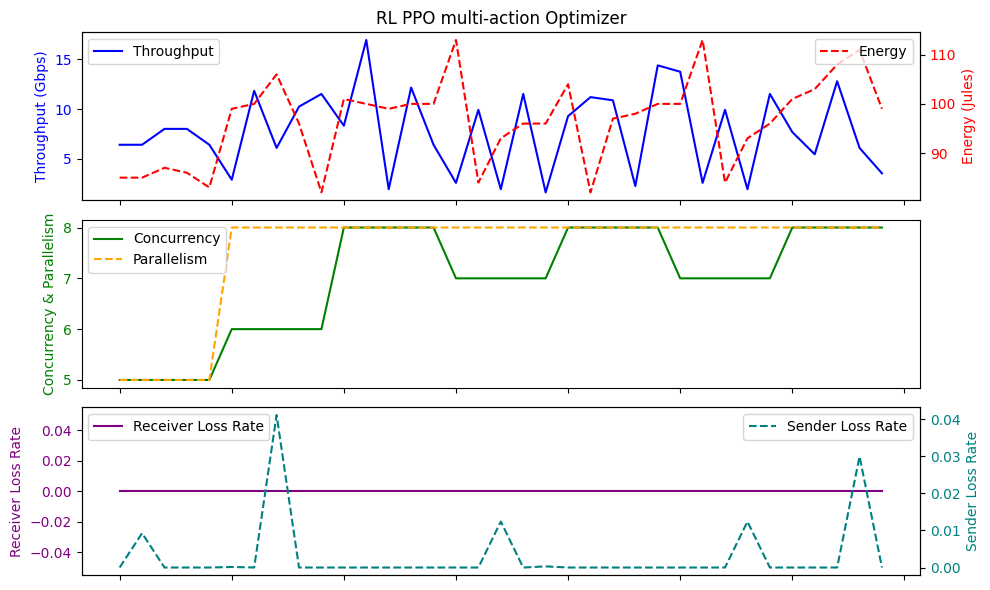

Average Throughput: 7.83542857142857
Total Energy: 3380.0
Total loss rate: 0.1054322888635191
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 09:11:01.542262016    7.232000       0.0   2.375000   
min       2024-02-18 00:33:48.384962    1.600000       0.0  -1.000000   
25%    2024-02-19 05:41:50.869134848    3.760000       0.0   1.000000   
50%    2024-02-19 16:41:48.333663488    7.360000       0.0   3.000000   
75%    2024-02-19 17:14:53.161110016   10.000000       0.0   3.250000   
max       2024-02-19 17:34:55.088675   13.760000       0.0   5.000000   
std                              NaN    3.615161       0.0   1.689902   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.762500   96.225000   0.003686  
min    32.500000   82.000000   0.000000  
25%    32.600000   92.000000   0.000000  
50%    33.050000   97.000000   0.00000

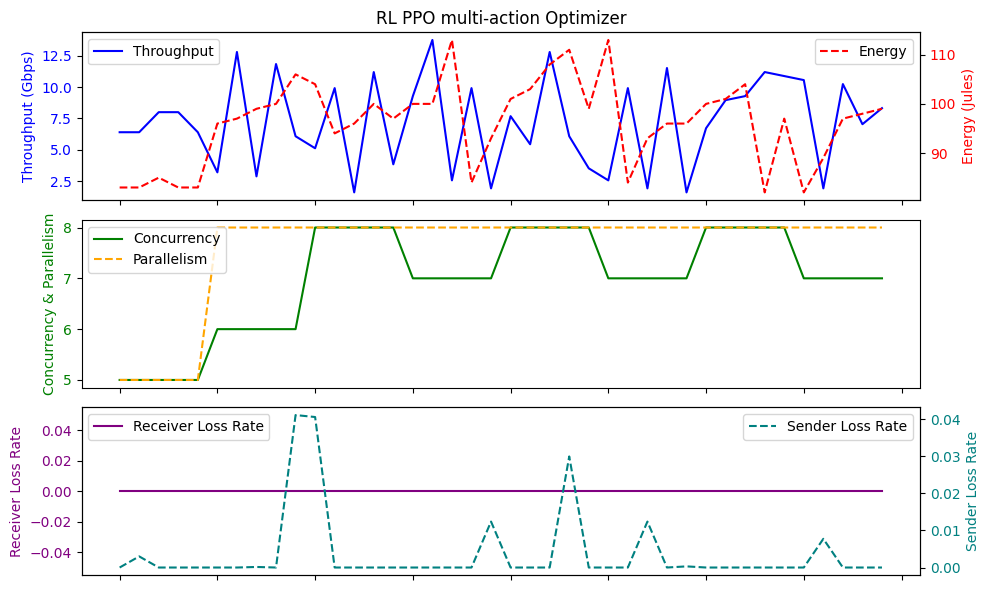

Average Throughput: 7.231999999999999
Total Energy: 3849.0
Total loss rate: 0.14744731823570628
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:29:57.732895744    8.018286       0.0   2.742857   
min       2024-02-18 00:44:41.353309    0.960000       0.0   0.000000   
25%    2024-02-19 05:39:09.190464512    5.440000       0.0   2.000000   
50%    2024-02-19 16:41:43.039059968    8.000000       0.0   3.000000   
75%    2024-02-19 16:42:00.137377536   10.560000       0.0   4.000000   
max       2024-02-19 17:34:45.127022   16.960000       0.0   6.000000   
std                              NaN    4.140365       0.0   1.686327   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   35.031429   95.742857   0.000839  
min    32.600000   82.000000   0.000000  
25%    32.700000   92.000000   0.000000  
50%    33.000000   98.000000   0.000

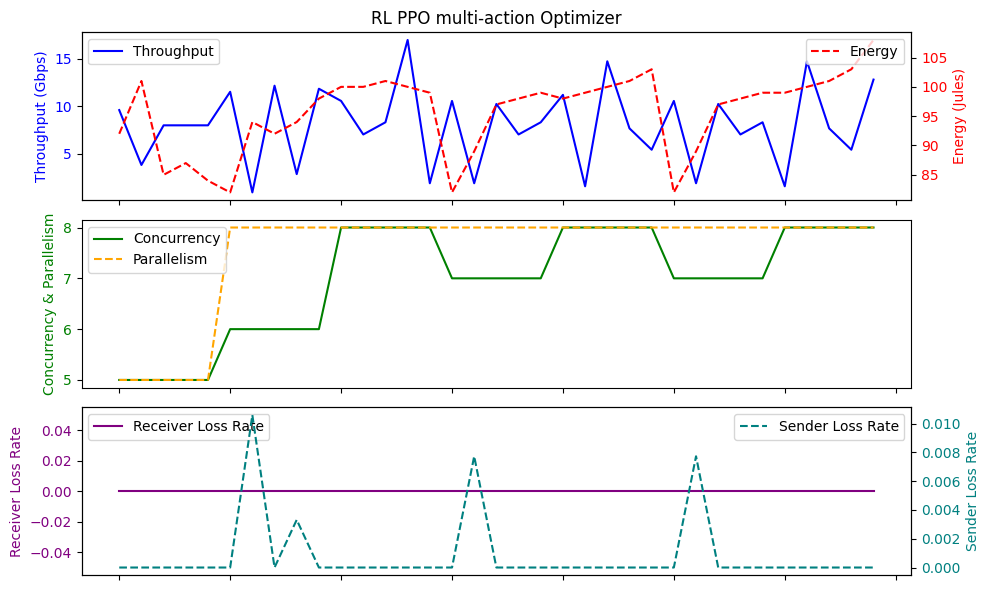

Average Throughput: 8.018285714285716
Total Energy: 3351.0
Total loss rate: 0.02934845987086764
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:24:35.204383488    8.009143       0.0   2.714286   
min       2024-02-18 00:33:45.380346    0.640000       0.0   0.000000   
25%    2024-02-18 00:39:22.969810944    6.080000       0.0   2.000000   
50%    2024-02-19 06:56:14.123749120    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:59.133417984   10.720000       0.0   3.500000   
max       2024-02-19 17:34:48.081663   16.960000       0.0   5.000000   
std                              NaN    3.868510       0.0   1.506289   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.168571   95.428571   0.000446  
min    32.500000   82.000000   0.000000  
25%    32.800000   92.500000   0.000000  
50%    33.100000   98.000000   0.000

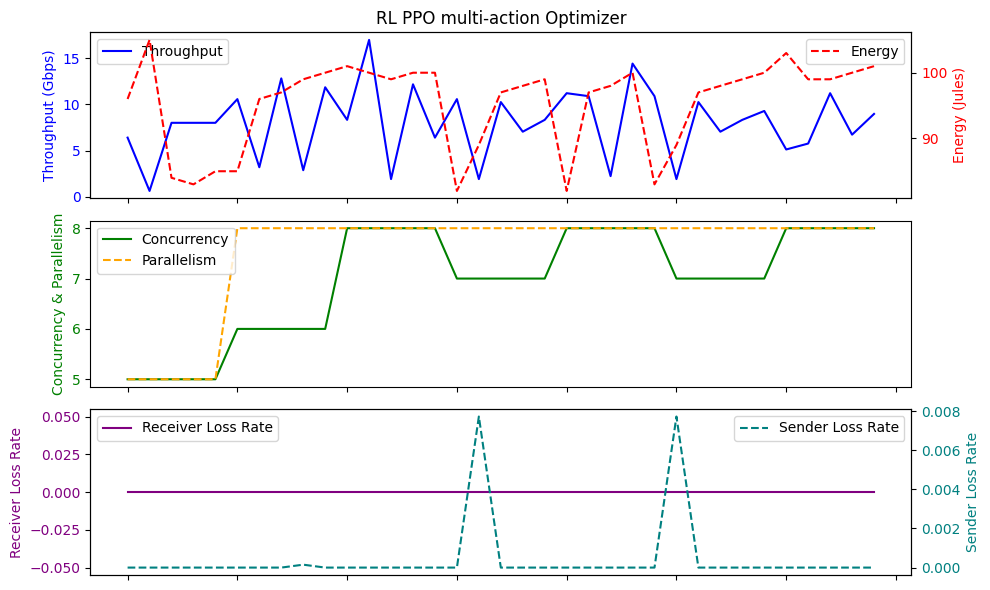

Average Throughput: 8.009142857142857
Total Energy: 3340.0
Total loss rate: 0.015599750947158403
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:14:01.850182144    7.689143       0.0   2.628571   
min       2024-02-18 00:33:47.346358    1.600000       0.0  -1.000000   
25%    2024-02-18 00:34:06.139406336    4.480000       0.0   1.000000   
50%    2024-02-19 05:47:12.911734016    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.720000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.400000       0.0   5.000000   
std                              NaN    3.720077       0.0   1.591997   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.651429   94.457143   0.001746  
min    32.600000   82.000000   0.000000  
25%    32.800000   85.000000   0.000000  
50%    33.100000   97.000000   0.00

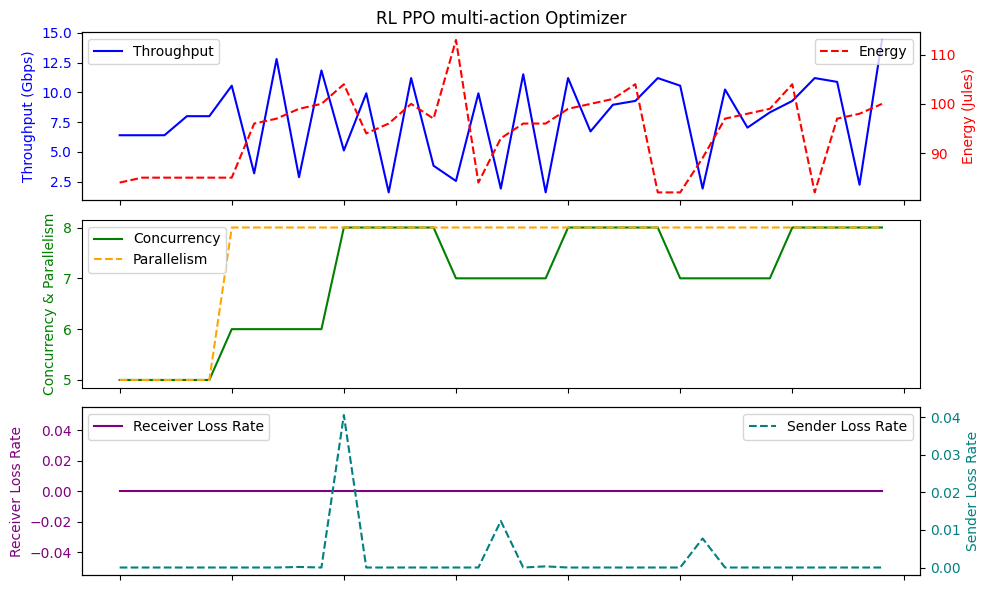

Average Throughput: 7.6891428571428575
Total Energy: 3306.0
Total loss rate: 0.06109313667142488
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:09:42.631687424    7.661714       0.0   2.657143   
min       2024-02-18 00:33:48.384962    0.320000       0.0   0.000000   
25%    2024-02-18 00:44:42.817366016    4.000000       0.0   1.500000   
50%    2024-02-19 05:47:11.915856896    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.560000       0.0   3.000000   
max       2024-02-19 17:34:50.087739   14.720000       0.0   5.000000   
std                              NaN    3.925283       0.0   1.589355   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.902857   94.685714   0.001523  
min    32.600000   82.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.200000   97.000000   0.00

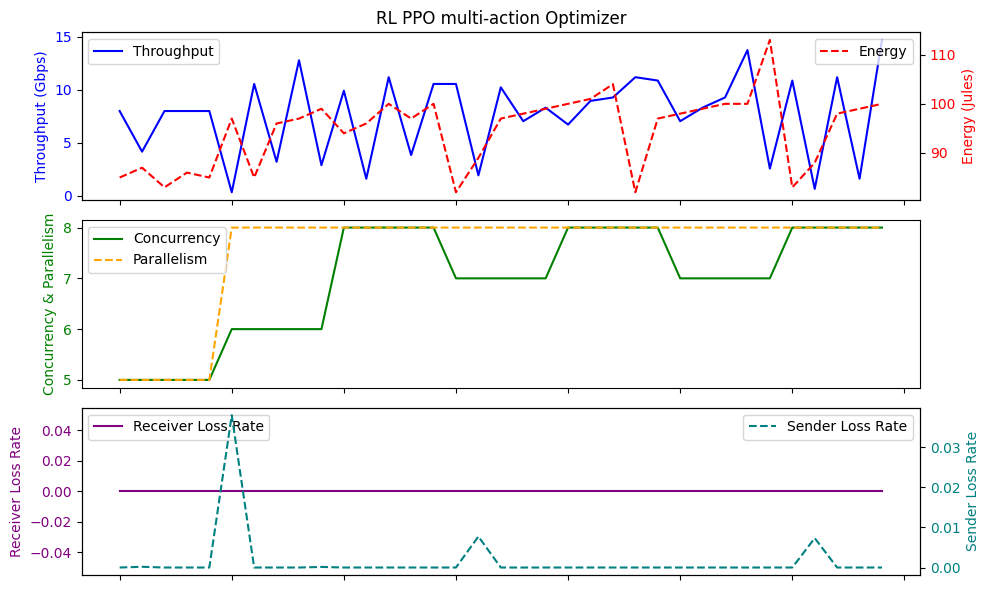

Average Throughput: 7.661714285714285
Total Energy: 3314.0
Total loss rate: 0.05330195072691482
                                Time  Throughput  LossRate      Score  \
count                             30   30.000000      30.0  30.000000   
mean   2024-02-19 13:21:26.876339968    8.672000       0.0   3.100000   
min       2024-02-19 05:42:53.519773    1.920000       0.0   0.000000   
25%    2024-02-19 05:47:15.162614784    6.320000       0.0   2.000000   
50%    2024-02-19 16:41:59.133417984    8.160000       0.0   3.000000   
75%    2024-02-19 17:28:07.055395840   11.280000       0.0   5.000000   
max       2024-02-19 17:34:54.087974   16.960000       0.0   5.000000   
std                              NaN    3.749132       0.0   1.768498   

             RTT      Energy   SenderLR  
count  30.000000   30.000000  30.000000  
mean   33.803333   97.533333   0.002784  
min    32.600000   84.000000   0.000000  
25%    32.825000   96.000000   0.000000  
50%    33.200000   99.000000   0.000

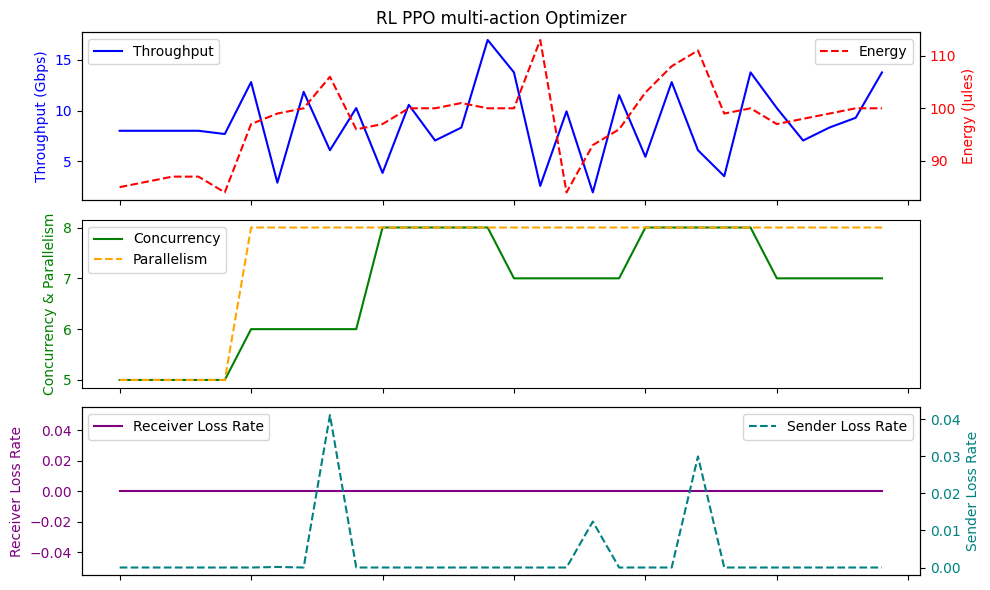

Average Throughput: 8.672
Total Energy: 2926.0
Total loss rate: 0.08351084436548033
                                Time  Throughput  LossRate      Score  \
count                             35     35.0000      35.0  35.000000   
mean   2024-02-19 06:44:32.649672192      8.1920       0.0   2.742857   
min       2024-02-18 00:44:41.353309      1.6000       0.0  -1.000000   
25%    2024-02-19 05:47:13.414033152      5.7600       0.0   2.000000   
50%    2024-02-19 16:41:40.039819008      8.0000       0.0   3.000000   
75%    2024-02-19 16:55:05.755586048     10.5600       0.0   4.000000   
max       2024-02-19 17:34:49.080551     16.0000       0.0   5.000000   
std                              NaN      3.7745       0.0   1.686327   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.705714   95.771429   0.002556  
min    32.600000   52.000000   0.000000  
25%    32.900000   96.000000   0.000000  
50%    33.100000   99.000000   0.000000  
75%   

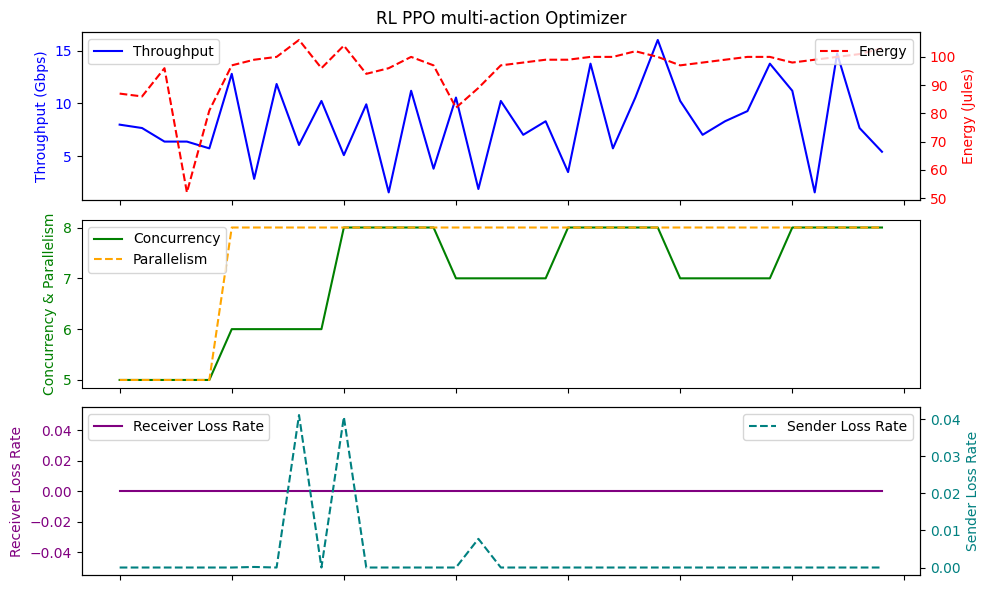

Average Throughput: 8.192
Total Energy: 3352.0
Total loss rate: 0.08947600631115506
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 07:57:28.679171328    8.493714       0.0   2.857143   
min       2024-02-18 00:33:50.347230    1.600000       0.0  -1.000000   
25%    2024-02-19 05:46:04.119568128    6.400000       0.0   2.000000   
50%    2024-02-19 16:41:38.032880896    8.320000       0.0   3.000000   
75%    2024-02-19 16:42:00.137377536   10.720000       0.0   4.000000   
max       2024-02-19 17:34:49.080551   16.000000       0.0   5.000000   
std                              NaN    3.703733       0.0   1.665266   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.234286   95.771429   0.002556  
min    32.600000   82.000000   0.000000  
25%    32.900000   93.000000   0.000000  
50%    33.100000   98.000000   0.000000  
75%   

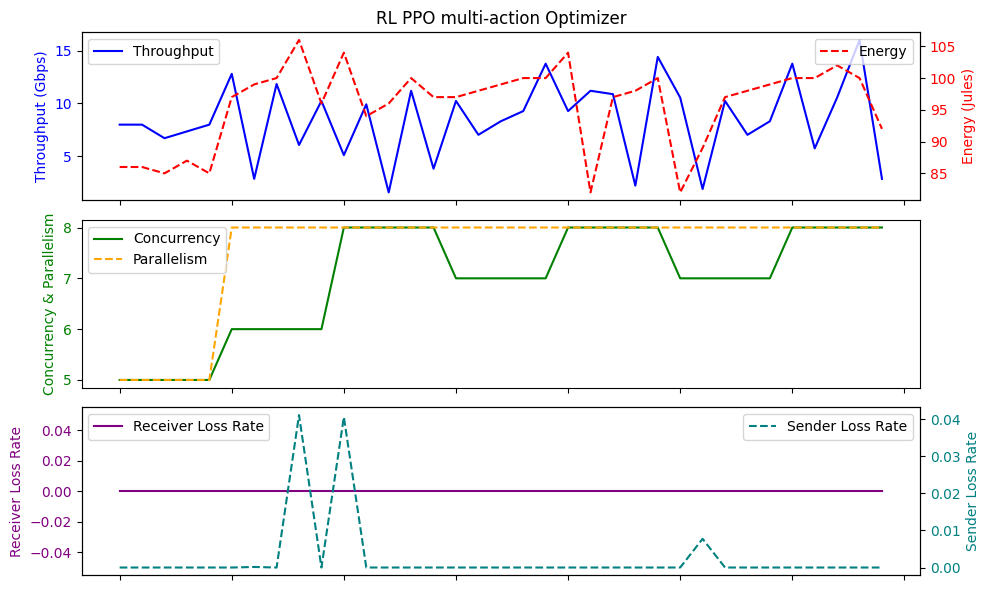

Average Throughput: 8.493714285714287
Total Energy: 3352.0
Total loss rate: 0.08947600631115506
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:39:29.477012736    8.027429       0.0   2.714286   
min       2024-02-18 00:33:50.347230    0.960000       0.0   0.000000   
25%    2024-02-19 06:29:44.314925568    3.680000       0.0   1.500000   
50%    2024-02-19 16:41:43.039059968    8.320000       0.0   3.000000   
75%    2024-02-19 17:08:16.383972864   11.040000       0.0   4.000000   
max       2024-02-19 17:34:50.087739   16.960000       0.0   5.000000   
std                              NaN    4.501710       0.0   1.466718   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.762857   97.028571   0.000671  
min    32.500000   82.000000   0.000000  
25%    32.800000   94.000000   0.000000  
50%    33.000000   99.000000   0.000

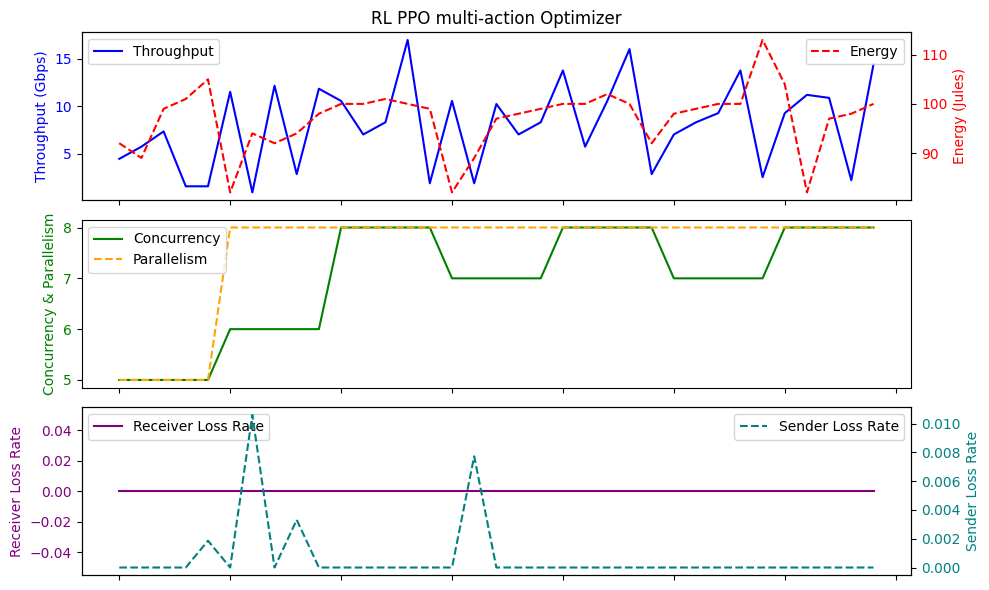

Average Throughput: 8.02742857142857
Total Energy: 3396.0
Total loss rate: 0.023483320578791232
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 10:56:41.035159040    7.954286       0.0   2.685714   
min       2024-02-18 04:45:06.850857    0.960000       0.0  -0.000000   
25%    2024-02-19 16:30:56.189563904    5.120000       0.0   1.500000   
50%    2024-02-19 17:08:10.879318016    7.680000       0.0   3.000000   
75%    2024-02-19 17:08:33.041009920   10.560000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   16.960000       0.0   5.000000   
std                              NaN    4.133230       0.0   1.622841   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.925714   96.028571   0.002693  
min    32.600000   61.000000   0.000000  
25%    32.900000   93.500000   0.000000  
50%    33.200000   99.000000   0.000

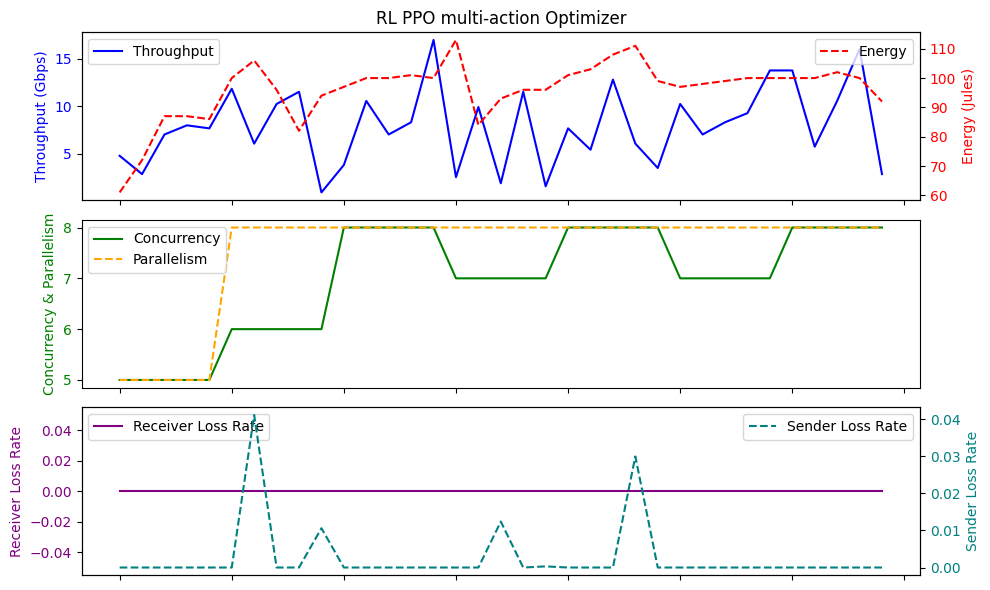

Average Throughput: 7.954285714285714
Total Energy: 3361.0
Total loss rate: 0.0942537596077421
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 02:14:05.960600320    7.625143       0.0   2.628571   
min       2024-02-18 00:33:45.380346    0.640000       0.0  -1.000000   
25%    2024-02-18 00:44:41.838843648    4.480000       0.0   1.000000   
50%    2024-02-19 05:47:12.911734016    8.000000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.720000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   14.400000       0.0   5.000000   
std                              NaN    3.893344       0.0   1.832480   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.717143   94.714286   0.001946  
min    32.600000   82.000000   0.000000  
25%    32.800000   87.500000   0.000000  
50%    33.000000   97.000000   0.0000

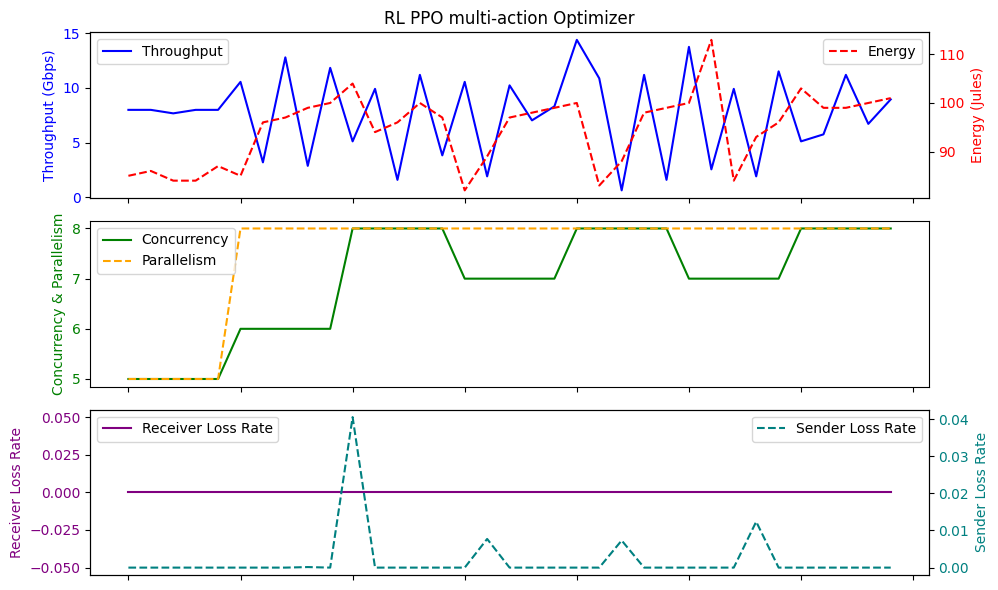

Average Throughput: 7.6251428571428574
Total Energy: 3315.0
Total loss rate: 0.06810186313542681
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 09:09:58.191878144    7.606857       0.0   2.628571   
min       2024-02-18 00:44:40.346051    0.320000       0.0   0.000000   
25%    2024-02-19 05:36:53.462328832    3.040000       0.0   1.000000   
50%    2024-02-19 16:41:40.039819008    8.000000       0.0   3.000000   
75%    2024-02-19 17:08:16.383972864   10.560000       0.0   4.000000   
max       2024-02-19 17:34:54.087974   16.000000       0.0   5.000000   
std                              NaN    4.440895       0.0   1.750390   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.965714   94.628571   0.002013  
min    32.600000   82.000000   0.000000  
25%    32.750000   88.500000   0.000000  
50%    33.000000   97.000000   0.00

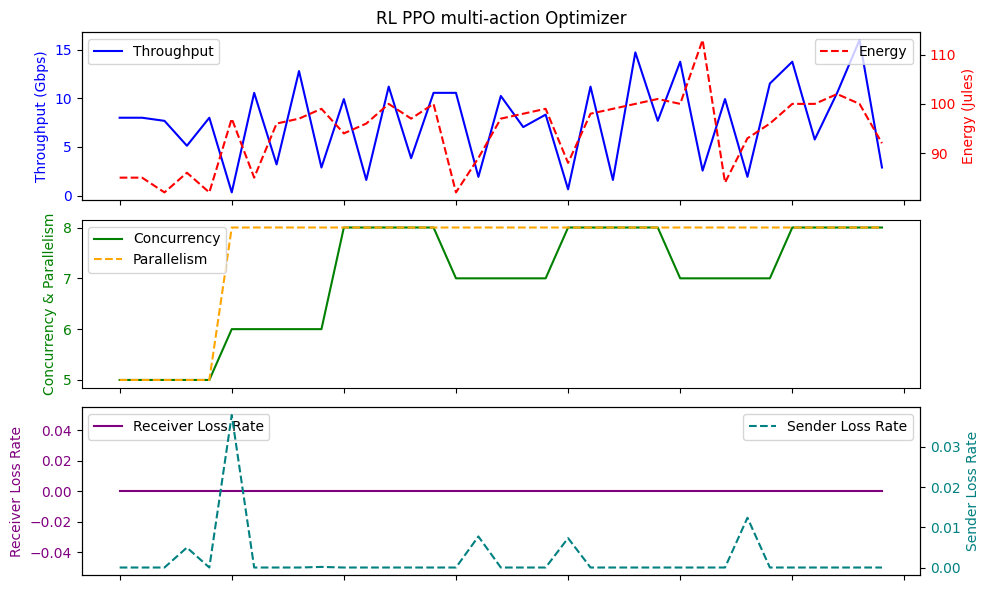

Average Throughput: 7.606857142857143
Total Energy: 3312.0
Total loss rate: 0.07045543642551941
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 08:29:24.184691200    7.360000       0.0   2.400000   
min       2024-02-18 00:44:39.305043    0.640000       0.0   0.000000   
25%    2024-02-19 05:45:28.505729280    3.360000       0.0   1.000000   
50%    2024-02-19 16:41:41.035406080    7.040000       0.0   3.000000   
75%    2024-02-19 17:34:49.584144896   11.040000       0.0   4.000000   
max       2024-02-19 17:34:55.088675   14.720000       0.0   5.000000   
std                              NaN    4.188859       0.0   1.612452   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   33.768571   95.342857   0.002957  
min    32.600000   71.000000   0.000000  
25%    32.850000   92.500000   0.000000  
50%    33.100000   98.000000   0.000

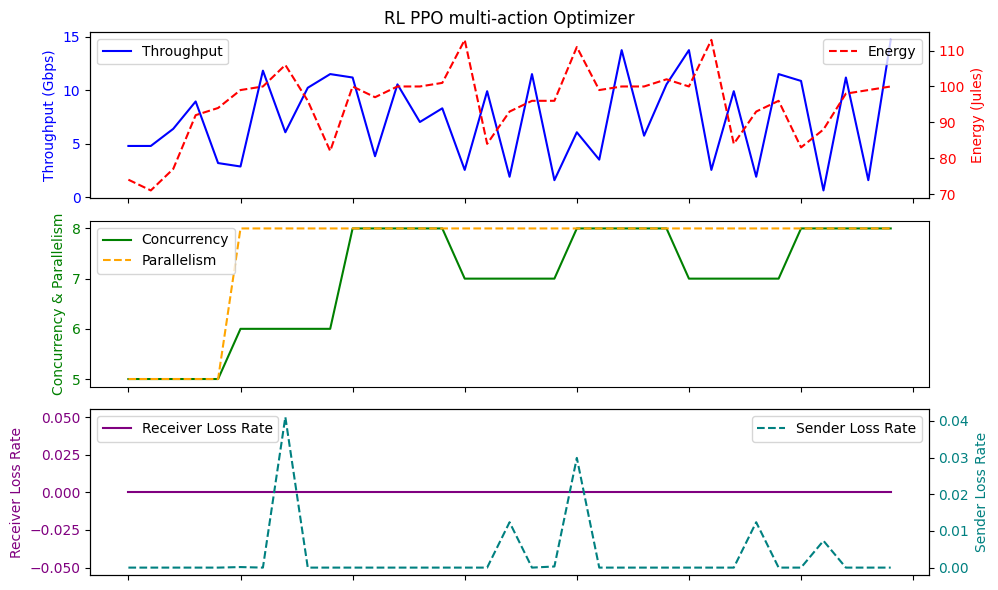

Average Throughput: 7.36
Total Energy: 3337.0
Total loss rate: 0.1035066157832757
                                Time  Throughput  LossRate      Score  \
count                             40   40.000000      40.0  40.000000   
mean   2024-02-19 03:31:26.027246336    6.720000       0.0   2.500000   
min       2024-02-18 00:34:05.644234    0.320000       0.0   0.000000   
25%    2024-02-18 22:18:57.899775744    2.480000       0.0   1.000000   
50%    2024-02-19 12:42:59.493280512    8.000000       0.0   3.000000   
75%    2024-02-19 14:55:55.439439616   10.000000       0.0   4.000000   
max       2024-02-19 17:34:53.091833   14.400000       0.0   5.000000   
std                              NaN    4.421003       0.0   1.519109   

             RTT      Energy   SenderLR  
count  40.000000   40.000000  40.000000  
mean   33.995000   87.000000   0.001029  
min    32.500000   46.000000   0.000000  
25%    32.675000   82.750000   0.000000  
50%    33.000000   93.000000   0.000000  
75%    3

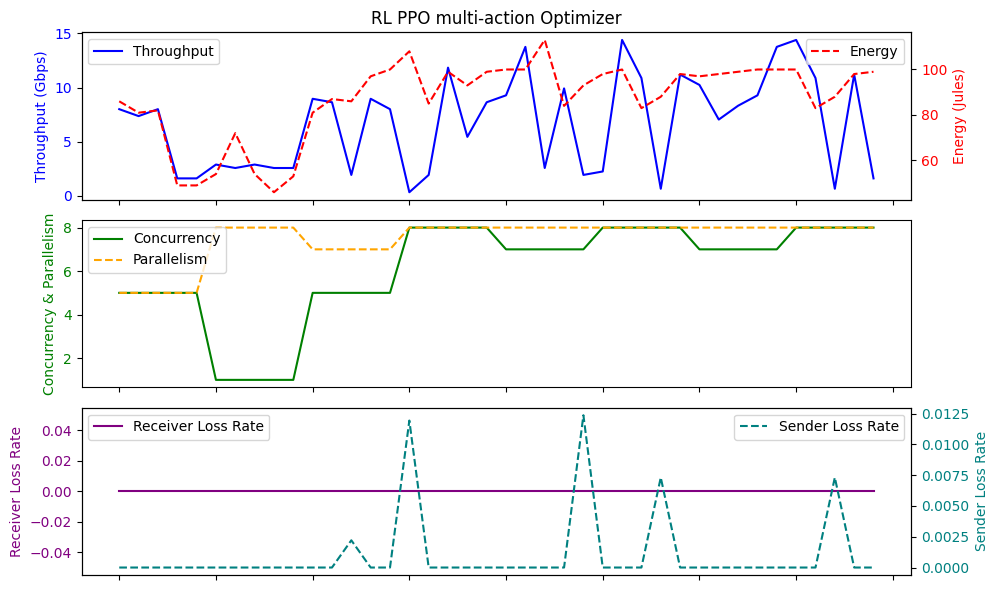

Average Throughput: 6.720000000000001
Total Energy: 3480.0
Total loss rate: 0.04115844430050214
                                Time  Throughput  LossRate      Score  \
count                             35   35.000000      35.0  35.000000   
mean   2024-02-19 03:17:30.964983808    7.771429       0.0   2.657143   
min       2024-02-18 00:34:05.644234    0.320000       0.0   0.000000   
25%    2024-02-18 00:44:41.353308928    3.520000       0.0   1.000000   
50%       2024-02-19 13:27:42.114304    8.320000       0.0   3.000000   
75%    2024-02-19 16:41:57.131938304   10.720000       0.0   4.000000   
max       2024-02-19 17:34:44.117515   16.960000       0.0   8.000000   
std                              NaN    4.429681       0.0   1.781322   

             RTT      Energy   SenderLR  
count  35.000000   35.000000  35.000000  
mean   34.457143   94.028571   0.001947  
min    32.500000   82.000000   0.000000  
25%    32.800000   88.000000   0.000000  
50%    33.200000   97.000000   0.000

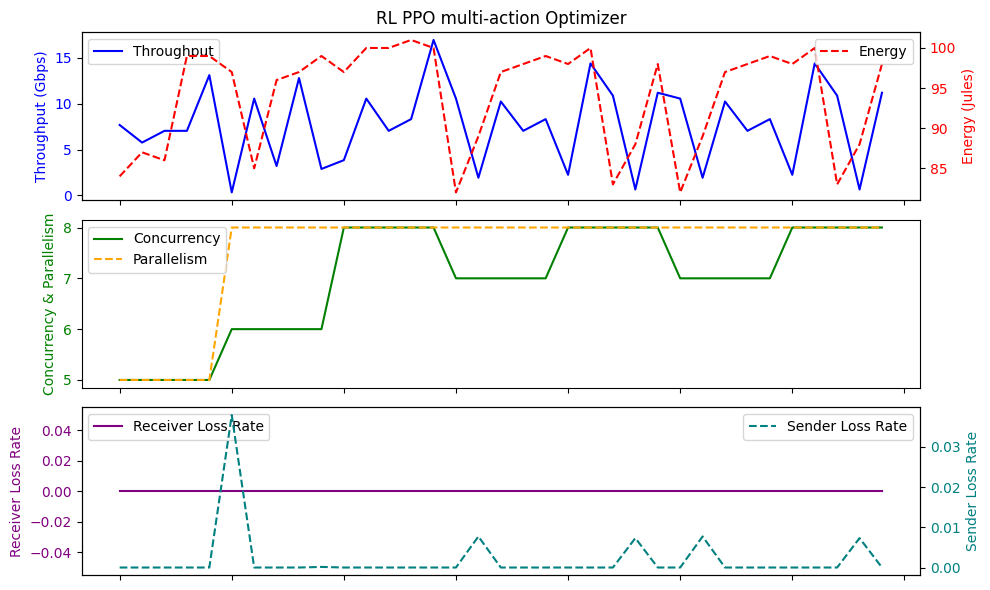

Average Throughput: 7.771428571428571
Total Energy: 3291.0
Total loss rate: 0.06815756329809282


In [17]:
num_of_run=50

rl_energy_efficient_sla_throughput_list=[]
rl_energy_efficient_sla_energy_list=[]
rl_energy_efficient_sla_plr_list=[]


model = PPO.load("./ppo_multi_action_in_de_energyEfficiencySLA/ppo_best_model/best_model.zip")
for i in range(0,num_of_run):
    done = False
    episode_reward = 0
    env=transferClass_multi_action_increase_decrease_energyEfficiency_SLA(cluster_dictionary,initial_value_cluster_dictionary,'energyEfficiencySLA')
    action_list=[]
    reward_list=[]
    obs = env.reset()
    while not done:
        action, _ = model.predict(obs, deterministic=True)
        action_list.append(action)
    #     print("action: ",action)
        obs, reward, done, info = env.step(action)
    #     obs = obs.astype(np.float32)
    #     print("obs: ", obs,".... reward: ",reward)
        reward_list.append(reward)
        episode_reward += reward

    accumulator_df = pd.concat(env.obs_df)  # Add more DataFrames in the list if needed
    env.close()
    print(accumulator_df.describe())
    print(f"Episode reward: {episode_reward}")
    print(f"actions {action_list},   {len(action_list)}")
    print(f"rewards {reward_list},  {len(reward_list)}")
    rl_energy_efficient_sla_throughput_list.append(accumulator_df['Throughput'].mean())
    rl_energy_efficient_sla_energy_list.append(accumulator_df['Energy'].sum())
    rl_energy_efficient_sla_plr_list.append(accumulator_df['SenderLR'].sum())
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 6), sharex=True)

    df=accumulator_df.reset_index()
    # Top plot with Throughput and Energy
    ax1.plot( df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL PPO multi-action Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')


    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot( df['LossRate'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot( df['SenderLR'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
#     ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = accumulator_df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = accumulator_df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = accumulator_df['SenderLR'].sum()
    print("Total loss rate:", total_plr)

**Comparision Plot**

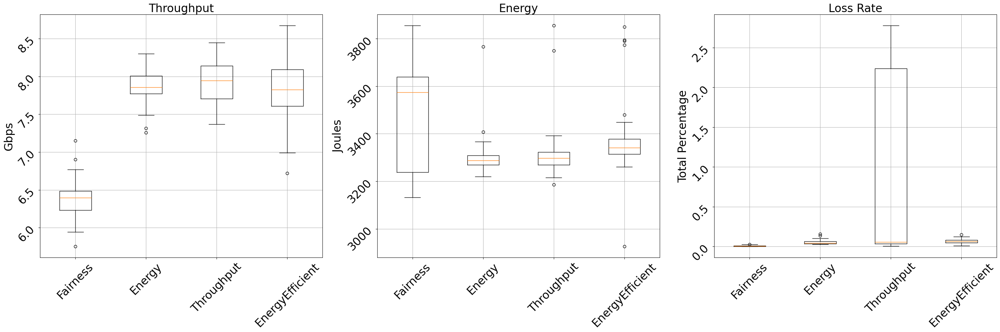

In [24]:
result_dictionary={"Throughput":[rl_score_sla_throughput_list,rl_energy_sla_throughput_list,rl_throughput_sla_throughput_list,rl_energy_efficient_sla_throughput_list],"Energy":[rl_score_sla_energy_list,rl_energy_sla_energy_list,rl_throughput_sla_energy_list,rl_energy_efficient_sla_energy_list],"lossRate":[rl_score_sla_plr_list,rl_energy_sla_plr_list,rl_throughput_sla_plr_list,rl_energy_efficient_sla_plr_list]}
import matplotlib.pyplot as plt

labels = ['Fairness','Energy','Throughput','EnergyEfficient']

# Assuming result_dictionary is already defined with the relevant data
# result_dictionary = {...}

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(30, 10))

# Font size for the ticks
tick_font_size = 24  # You can change this value as needed

# Plotting Throughput
axes[0].boxplot(result_dictionary['Throughput'], labels=labels)
axes[0].set_title('Throughput',fontsize=24)
axes[0].set_ylabel('Gbps',fontsize=24)
axes[0].tick_params(axis='both', which='major', labelsize=tick_font_size,labelrotation=45)  # Set tick font size
axes[0].grid(True)  # Adding grid

# Plotting Energy
axes[1].boxplot(result_dictionary['Energy'], labels=labels)
axes[1].set_title('Energy',fontsize=24)
axes[1].set_ylabel('Joules',fontsize=24)
axes[1].tick_params(axis='both', which='major', labelsize=tick_font_size,labelrotation=45)  # Set tick font size
axes[1].grid(True)  # Adding grid

# Plotting Loss Rate
axes[2].boxplot(result_dictionary['lossRate'], labels=labels)
axes[2].set_title('Loss Rate',fontsize=24)
axes[2].set_ylabel('Total Percentage',fontsize=24)
axes[2].tick_params(axis='both', which='major', labelsize=tick_font_size,labelrotation=45)  # Set tick font size
axes[2].grid(True)  # Adding grid

plt.tight_layout()
plt.show()
